# Task 2
- Train Q-Learning on Env
- Optimise Parameters
- Test Performance on Env

# Train Q-Learning on Env

In [ ]:
import pandas as pd
import numpy as np
import random 
import gym
from trd_env import trading_env
import itertools as it

In [153]:
train = pd.read_csv("btc_6H_(2016-2018).csv")
env = trading_env(train)
env.reset()

array([0.45, 0.5 , 0.  , 0.5 ])

In [154]:
# To reverse key/value in dictionary for indexing state
def reverse(t):
    return t[1],t[0]

# Finding unique observation values
ret_norm = set(train["3D_return_norm"])
macd = set(train["MACD_status"])
rsi = set(train["RSI_status"])
ema = set(train['EMA_status'])

# Creating indexing by combining unique state values
state = [(a,b,c,d) for a in ret_norm
       for b in macd
       for c in rsi
       for d in ema]
state1 = map(reverse,enumerate(state))
state2 = dict(state1)

# Creating empty Q table
ob_space = len(state)   # Length of observation space is number of states
action_space = 3        # Actions = Buy/Sell/Hold
Q = np.zeros([ob_space, action_space])

In [194]:
# Q-learning parameters
epsilon = 0.98
max_epsilon = 1
min_epsilon = 0.1
decay_rate = 0.01

# List of parameters for grid searching
l_r = np.arange(0.1,0.9,0.1)
gamma_ = np.arange(0.9,0.99,0.01) 

total_episodes = 1000
max_steps = len(train)-1
parameter_list = []
total_reward = []
total_reward_perc =[]
total_bought = []
total_sold = []

In [195]:
# Training loop

for lr, gamma in it.product(l_r, gamma_, repeat=1): # Grid Search
    print(f"lr={lr}, gamma={gamma}" ) 
    
    for ep in range(total_episodes):
        env.reset()
        current_state = tuple(env.observation())
        print(f"Current Episode: {ep}")
        total_steps = 0
        current_reward = []
        
        for step in range(max_steps):
            exp = random.uniform(0,1)
            if exp > epsilon:
                action = np.argmax(Q[state2[current_state]])
            else:
                action = np.random.choice([0,1,2])

            new_state, reward, done = env.step(action)
            new_state = tuple(new_state)
            temp = Q[state2[current_state]][action]
            temp1 = lr * (reward + gamma * np.argmax(Q[state2[new_state]]))
            temp2 = Q[state2[current_state]][action]

            Q[state2[current_state]][action] = (1 - lr) * temp + temp1

            current_state = new_state
            total_steps+= 1
            
            if done == True:
                break
            epsilon = min_epsilon + (max_epsilon - min_epsilon) * np.exp(-decay_rate*ep)

        print(env.render())
        parameter_list.append((lr, gamma))
        return_perc,return_value,bought,sold = env.reward_output()
        total_reward.append(return_value)
        total_reward_perc.append(return_perc)
        total_bought.append(bought)
        total_sold.append(sold)

lr=0.1, gamma=0.9
Current Episode: 0
Current Porfolio Value:20742.370711056476; Available Capital: 13283.777595615582; Current Stocks Held: 2.1085412990854078
No. Stocks Bought:265.47342753659774; No. Stocks Sold:263.3648873275124; Average Cost:3621.439488150879 
Return:207.42370711056478%; 10742.370711056476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1
Current Porfolio Value:25390.39479180226; Available Capital: 11027.489862863282; Current Stocks Held: 4.064162326783505
No. Stocks Bought:292.6093982023246; No. Stocks Sold:288.5452369655409; Average Cost:3580.7371270237245 
Return:253.9039479180226%; 15390.39479180226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:39676.22807749368; Available Capital: 22621.013704733305; Current Stocks Held: 4.798805575316907
No. Stocks Bought:320.3520185507878; No. Stocks Sold:315.55321406547085; Average Cost:3811.359362739618 
Return:396.7622807749368%; 29676.22807749368
Termination date: 2018-12

Current Porfolio Value:26931.903898777127; Available Capital: 18429.860301019788; Current Stocks Held: 2.4073151268246695
No. Stocks Bought:290.69120582539585; No. Stocks Sold:288.2838917885714; Average Cost:3664.4979839868297 
Return:269.31903898777125%; 16931.903898777127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:22300.362014168764; Available Capital: 479.155474182381; Current Stocks Held: 6.1466629342030075
No. Stocks Bought:278.28683995574545; No. Stocks Sold:272.1401781115422; Average Cost:3820.4190393002095 
Return:223.00362014168766%; 12300.362014168764
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:24137.86741689855; Available Capital: 14479.05695936407; Current Stocks Held: 2.7305650155591703
No. Stocks Bought:324.1123773961958; No. Stocks Sold:321.3818134706363; Average Cost:3529.9148769712674 
Return:241.3786741689855%; 14137.867416898549
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24198.680549785553; Available Capital: 8964.720721783622; Current Stocks Held: 4.300824334873785
No. Stocks Bought:316.01994605504063; No. Stocks Sold:311.71912281016677; Average Cost:3540.4684900615007 
Return:241.98680549785553%; 14198.680549785553
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:17679.993069786255; Available Capital: 10697.132672470167; Current Stocks Held: 1.966745212217746
No. Stocks Bought:265.51067034549845; No. Stocks Sold:263.5439262232805; Average Cost:3541.5233051778273 
Return:176.79993069786255%; 7679.993069786255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:25941.259929617772; Available Capital: 12741.301286907892; Current Stocks Held: 3.72745686094377
No. Stocks Bought:306.3836075928881; No. Stocks Sold:302.65615182194426; Average Cost:3560.912230802619 
Return:259.41259929617775%; 15941.259929617772
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28436.513447925558; Available Capital: 7484.755243276262; Current Stocks Held: 5.918108416826187
No. Stocks Bought:311.46106992478065; No. Stocks Sold:305.5429625979544; Average Cost:3692.894076700769 
Return:284.3651344792556%; 18436.513447925558
Termination date: 2018-12-09 18:00:00
None
Current Episode: 85
Current Porfolio Value:30662.96190612473; Available Capital: 20972.087046007913; Current Stocks Held: 2.734161404413224
No. Stocks Bought:309.1917233176779; No. Stocks Sold:306.45756300326474; Average Cost:3779.873870007047 
Return:306.6296190612473%; 20662.96190612473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 86
Current Porfolio Value:26600.450809706777; Available Capital: 14632.430151196528; Current Stocks Held: 3.3700745813968704
No. Stocks Bought:305.4698726509928; No. Stocks Sold:302.0997991595959; Average Cost:3607.8779426876717 
Return:266.0045080970678%; 16600.450809706777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22492.969703416973; Available Capital: 7254.65734437326; Current Stocks Held: 4.304862787759587
No. Stocks Bought:305.57157677536463; No. Stocks Sold:301.2667150776051; Average Cost:3501.3821809751685 
Return:224.92969703416975%; 12492.969703416973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:26037.48727015908; Available Capital: 16357.874580900976; Current Stocks Held: 2.7338915676687354
No. Stocks Bought:345.82762351413965; No. Stocks Sold:343.0937330364709; Average Cost:3550.3732533152865 
Return:260.3748727015908%; 16037.48727015908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:49267.39846708266; Available Capital: 44342.405577166166; Current Stocks Held: 1.3891190122804664
No. Stocks Bought:405.34651668162456; No. Stocks Sold:403.95739875934447; Average Cost:3451.687007952992 
Return:492.6739846708266%; 39267.39846708266
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20056.145376814035; Available Capital: 11452.982132532272; Current Stocks Held: 2.4246477294041298
No. Stocks Bought:275.7048506412499; No. Stocks Sold:273.2802040018459; Average Cost:3747.106869593654 
Return:200.56145376814035%; 10056.145376814035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 146
Current Porfolio Value:41691.87036902023; Available Capital: 35534.136785411065; Current Stocks Held: 1.7387057934611008
No. Stocks Bought:353.6013400822465; No. Stocks Sold:351.8626353787856; Average Cost:3528.8888898886 
Return:416.9187036902023%; 31691.87036902023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:43634.62534523172; Available Capital: 17315.98488656464; Current Stocks Held: 7.406280147083191
No. Stocks Bought:361.8917865699084; No. Stocks Sold:354.4855075128251; Average Cost:3505.2720619812576 
Return:436.34625345231717%; 33634.62534523172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:43976.42910155505; Available Capital: 18731.118946757102; Current Stocks Held: 7.105476526282088
No. Stocks Bought:447.05253457962124; No. Stocks Sold:439.9470591433397; Average Cost:3556.6839122589054 
Return:439.7642910155505%; 33976.42910155505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 180
Current Porfolio Value:28099.424263196397; Available Capital: 17178.691377867995; Current Stocks Held: 3.083145502975395
No. Stocks Bought:357.5179981193333; No. Stocks Sold:354.43485370635847; Average Cost:3658.9637758273348 
Return:280.99424263196397%; 18099.424263196397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 181
Current Porfolio Value:31527.408108625445; Available Capital: 16444.573055736488; Current Stocks Held: 4.253260972950102
No. Stocks Bought:356.43433795867065; No. Stocks Sold:352.1810780757216; Average Cost:3542.668706244534 
Return:315.27408108625445%; 21527.408108625445
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25365.457388477123; Available Capital: 22894.273813547257; Current Stocks Held: 0.6956095005778029
No. Stocks Bought:285.8390121505917; No. Stocks Sold:285.14340374001404; Average Cost:3866.8181733123647 
Return:253.65457388477122%; 15365.457388477123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:39557.8868478166; Available Capital: 21856.69173464646; Current Stocks Held: 5.004419613738265
No. Stocks Bought:427.2583465073674; No. Stocks Sold:422.2539279836286; Average Cost:3830.987988106094 
Return:395.578868478166%; 29557.886847816597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:37242.80899994944; Available Capital: 28739.09974585394; Current Stocks Held: 2.399847423970858
No. Stocks Bought:289.9800981233083; No. Stocks Sold:287.5802517893375; Average Cost:4121.046699879838 
Return:372.42808999949443%; 27242.80899994944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Episode: 235
Current Porfolio Value:34814.94071119298; Available Capital: 12505.44503863661; Current Stocks Held: 6.290944676656548
No. Stocks Bought:431.0245256679831; No. Stocks Sold:424.7335820813263; Average Cost:3638.3422241327735 
Return:348.1494071119298%; 24814.940711192983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 236
Current Porfolio Value:35952.2111126031; Available Capital: 31420.631038249823; Current Stocks Held: 1.2837912963058464
No. Stocks Bought:380.62502548235466; No. Stocks Sold:379.3412352760489; Average Cost:3634.557146203389 
Return:359.522111126031%; 25952.2111126031
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:26857.44858088215; Available Capital: 19559.760028551398; Current Stocks Held: 2.0585730143491516
No. Stocks Bought:333.93299153460106; No. Stocks Sold:331.87441961025223; Average Cost:3759.0838002938685 
Return:268.57448580882146%; 16857.44858088215
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:38209.30324144859; Available Capital: 33087.31350541853; Current Stocks Held: 1.4491678545021882
No. Stocks Bought:358.88408863557146; No. Stocks Sold:357.43492187106915; Average Cost:3616.6871558906796 
Return:382.0930324144859%; 28209.303241448593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:28758.566133102715; Available Capital: 12933.685078108903; Current Stocks Held: 4.462711681761425
No. Stocks Bought:361.5093590879983; No. Stocks Sold:357.04664849623686; Average Cost:3721.8176691074477 
Return:287.58566133102715%; 18758.566133102715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 261
Current Porfolio Value:34235.27832169688; Available Capital: 18785.760200817676; Current Stocks Held: 4.354788215061385
No. Stocks Bought:380.5537290770518; No. Stocks Sold:376.1989419519899; Average Cost:3517.420062553614 
Return:342.3527832169688%; 24235.278321696882
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27824.587287368602; Available Capital: 12747.675615373875; Current Stocks Held: 4.2663057637067325
No. Stocks Bought:375.6057607936741; No. Stocks Sold:371.3394561199667; Average Cost:3828.0819016356004 
Return:278.24587287368604%; 17824.587287368602
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:31624.871103172867; Available Capital: 22472.797348833716; Current Stocks Held: 2.580978159964175
No. Stocks Bought:363.58075681400766; No. Stocks Sold:360.99977974404317; Average Cost:3776.510069632486 
Return:316.2487110317287%; 21624.871103172867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 290
Current Porfolio Value:27137.98378863956; Available Capital: 13886.994504420421; Current Stocks Held: 3.7364865653719983
No. Stocks Bought:354.43465464205156; No. Stocks Sold:350.6981691666796; Average Cost:3913.524128674243 
Return:271.37983788639565%; 17137.98378863956
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:15616.499117573818; Available Capital: 4100.316590628166; Current Stocks Held: 3.2519423274768773
No. Stocks Bought:336.17332853886745; No. Stocks Sold:332.9213873013902; Average Cost:3865.693818393122 
Return:156.16499117573818%; 5616.499117573818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:16365.952362334008; Available Capital: 6083.025318069915; Current Stocks Held: 2.898611031208941
No. Stocks Bought:312.99400906477905; No. Stocks Sold:310.09539912356934; Average Cost:3564.0909832750667 
Return:163.65952362334008%; 6365.952362334008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 319
Current Porfolio Value:23639.223292302086; Available Capital: 14847.826636990507; Current Stocks Held: 2.4789522754436684
No. Stocks Bought:289.3048125066899; No. Stocks Sold:286.8258613212466; Average Cost:3454.706792720947 
Return:236.39223292302086%; 13639.223292302086
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:37991.25642165636; Available Capital: 29566.746069397377; Current Stocks Held: 2.3793878591012665
No. Stocks Bought:401.5721494755335; No. Stocks Sold:399.19276270643235; Average Cost:3538.53988936536 
Return:379.9125642165636%; 27991.256421656362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:21452.72402372124; Available Capital: 12384.442253015326; Current Stocks Held: 2.5570616932562302
No. Stocks Bought:285.8739539903772; No. Stocks Sold:283.316893387121; Average Cost:3584.6882344657915 
Return:214.5272402372124%; 11452.724023721239
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:36260.94367075137; Available Capital: 32853.24817751575; Current Stocks Held: 0.9621294598285084
No. Stocks Bought:341.46827511800336; No. Stocks Sold:340.5061467481754; Average Cost:3486.6103112794203 
Return:362.6094367075137%; 26260.9436707

Current Porfolio Value:30526.363538621135; Available Capital: 7790.496306342881; Current Stocks Held: 6.4329636069385705
No. Stocks Bought:357.65609096271294; No. Stocks Sold:351.22312844577436; Average Cost:3545.3366702238873 
Return:305.2636353862114%; 20526.363538621135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 370
Current Porfolio Value:29195.243932566034; Available Capital: 13345.962829080412; Current Stocks Held: 4.4817036134466814
No. Stocks Bought:372.4994948312497; No. Stocks Sold:368.01779230780335; Average Cost:3545.660536976102 
Return:291.95243932566035%; 19195.243932566034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 371
Current Porfolio Value:18816.307850196477; Available Capital: 6058.747703136153; Current Stocks Held: 3.5897220281110997
No. Stocks Bought:294.9826196997709; No. Stocks Sold:291.39289876165986; Average Cost:3763.4215450534216 
Return:188.16307850196478%; 8816.307850196477
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:26364.085161102357; Available Capital: 14178.412182243657; Current Stocks Held: 3.4492697943743704
No. Stocks Bought:338.008700508459; No. Stocks Sold:334.5594318040855; Average Cost:3606.7332385215695 
Return:263.64085161102355%; 16364.085161102357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:21931.521208707687; Available Capital: 11536.184906585593; Current Stocks Held: 2.938842973680476
No. Stocks Bought:325.8014723492561; No. Stocks Sold:322.8626304655759; Average Cost:3452.027161688949 
Return:219.31521208707684%; 11931.521208707687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:32151.125682534082; Available Capital: 15386.714895487941; Current Stocks Held: 4.748838091846979
No. Stocks Bought:390.7244338527563; No. Stocks Sold:385.9755968509094; Average Cost:3731.589147589511 
Return:321.5112568253408%; 22151.125682534082
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:390.0749929051505; No. Stocks Sold:386.6571644416081; Average Cost:3525.792564257197 
Return:286.4893708707574%; 18648.937087075738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:19755.911648732734; Available Capital: 12079.061362592856; Current Stocks Held: 2.164116225103057
No. Stocks Bought:294.71163957150833; No. Stocks Sold:292.5475244364053; Average Cost:3586.87937202117 
Return:197.55911648732734%; 9755.911648732734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:32625.123328292502; Available Capital: 9533.075920981391; Current Stocks Held: 6.512232984272728
No. Stocks Bought:444.13681821464485; No. Stocks Sold:437.62458632037226; Average Cost:3816.218507414909 
Return:326.251233282925%; 22625.123328292502
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:34656.746358030774; Available Capital: 15136.807061422598; Current Stocks Held: 5.51463040960

Current Episode: 462
Current Porfolio Value:26240.06165964007; Available Capital: 18278.696593230587; Current Stocks Held: 2.2541314894244993
No. Stocks Bought:321.0645174981585; No. Stocks Sold:318.8103870987338; Average Cost:3607.090768588915 
Return:262.4006165964007%; 16240.061659640069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:31061.11667951436; Available Capital: 8551.266222997838; Current Stocks Held: 6.343764238041612
No. Stocks Bought:373.92078815383786; No. Stocks Sold:367.57702500579563; Average Cost:3481.629106755956 
Return:310.6111667951436%; 21061.11667951436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:35037.358801487215; Available Capital: 23842.534125596554; Current Stocks Held: 3.1533552665679743
No. Stocks Bought:358.5892563277356; No. Stocks Sold:355.4359021511671; Average Cost:3469.5768309157665 
Return:350.37358801487215%; 25037.358801487215
Termination date: 2018-12-09 18:00:0

Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:27485.3509375101; Available Capital: 7175.417749541137; Current Stocks Held: 5.7435681162831145
No. Stocks Bought:390.6536453844986; No. Stocks Sold:384.9100783582151; Average Cost:3535.3087436828982 
Return:274.853509375101%; 17485.3509375101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:28899.771476112328; Available Capital: 14250.223191959714; Current Stocks Held: 4.121279438526151
No. Stocks Bought:367.55318011444894; No. Stocks Sold:363.43190176592225; Average Cost:3601.4179684397905 
Return:288.99771476112323%; 18899.771476112328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:38322.74117368308; Available Capital: 18605.466194374167; Current Stocks Held: 5.56155095658718
No. Stocks Bought:390.3396678092359; No. Stocks Sold:384.7781179426488; Average Cost:3505.339413283579 
Return:383.22741173683085%; 28322.741173683

No. Stocks Bought:381.41220726510875; No. Stocks Sold:378.1614843181621; Average Cost:3531.882272148456 
Return:378.6468678764312%; 27864.68678764312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 512
Current Porfolio Value:27070.19437440341; Available Capital: 6978.370280276763; Current Stocks Held: 5.663545205609989
No. Stocks Bought:394.65740370241156; No. Stocks Sold:388.9938595868013; Average Cost:3634.698126672005 
Return:270.7019437440341%; 17070.19437440341
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:24864.647440683686; Available Capital: 5599.598206876645; Current Stocks Held: 5.452001620484699
No. Stocks Bought:404.44303891386704; No. Stocks Sold:398.9910383833822; Average Cost:3543.487576218609 
Return:248.64647440683686%; 14864.647440683686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 514
Current Porfolio Value:36232.887865499826; Available Capital: 21295.72416994827; Current Stocks Held: 4.2158817930892

Current Episode: 539
Current Porfolio Value:23410.130804953653; Available Capital: 4219.134065369696; Current Stocks Held: 5.430424599163211
No. Stocks Bought:334.8993707959498; No. Stocks Sold:329.4689472867872; Average Cost:3491.2709061809887 
Return:234.10130804953653%; 13410.130804953653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 540
Current Porfolio Value:23971.4934454084; Available Capital: 7844.193905660997; Current Stocks Held: 4.5552988762452475
No. Stocks Bought:308.6637875359585; No. Stocks Sold:304.10848974971356; Average Cost:3784.8903932651847 
Return:239.71493445408402%; 13971.4934454084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:26577.839696789255; Available Capital: 10186.386409376253; Current Stocks Held: 4.643541363969436
No. Stocks Bought:314.1586991919063; No. Stocks Sold:309.51515891793684; Average Cost:3673.07734359126 
Return:265.77839696789255%; 16577.839696789255
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:28061.32408316637; Available Capital: 6985.591003971562; Current Stocks Held: 5.964469436784474
No. Stocks Bought:437.5881567918546; No. Stocks Sold:431.62368844506994; Average Cost:3523.777629348724 
Return:280.61324083166375%; 18061.32408316637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:22349.6640269255; Available Capital: 9812.88746726212; Current Stocks Held: 3.5359655402570866
No. Stocks Bought:369.13297299687287; No. Stocks Sold:365.5970085466164; Average Cost:3570.5431181981917 
Return:223.496640269255%; 12349.6640269255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:34876.5147033561; Available Capital: 29916.247760236558; Current Stocks Held: 1.396868102426272
No. Stocks Bought:364.71838354096184; No. Stocks Sold:363.32151652853565; Average Cost:3618.607566233858 
Return:348.765147033561%; 24876.5147033561
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Cur

Current Porfolio Value:22562.304875215006; Available Capital: 18906.17903870702; Current Stocks Held: 1.0329768347249777
No. Stocks Bought:266.5854573523365; No. Stocks Sold:265.5524816076116; Average Cost:3486.2353430114376 
Return:225.62304875215005%; 12562.304875215006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 597
Current Porfolio Value:22482.10327278883; Available Capital: 18104.654548466664; Current Stocks Held: 1.2366258953424714
No. Stocks Bought:263.3930768877888; No. Stocks Sold:262.15645208244655; Average Cost:4101.020021987323 
Return:224.82103272788828%; 12482.10327278883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598
Current Porfolio Value:28503.820586565205; Available Capital: 18728.702398840236; Current Stocks Held: 2.7561291566048305
No. Stocks Bought:360.89617743372395; No. Stocks Sold:358.1400493671187; Average Cost:3514.2280031739683 
Return:285.03820586565206%; 18503.820586565205
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:21238.542094370234; Available Capital: 2218.1950374383764; Current Stocks Held: 5.358245427647364
No. Stocks Bought:303.49078689381514; No. Stocks Sold:298.13254255616783; Average Cost:3495.8129528959917 
Return:212.38542094370234%; 11238.542094370234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 628
Current Porfolio Value:27215.085947454732; Available Capital: 17119.397252963005; Current Stocks Held: 2.8528780979815296
No. Stocks Bought:274.4826745715187; No. Stocks Sold:271.6297975635372; Average Cost:3527.6199947220575 
Return:272.15085947454736%; 17215.085947454732
Termination date: 2018-12-09 18:00:00
None
Current Episode: 629
Current Porfolio Value:25550.385641606586; Available Capital: 10247.95794619399; Current Stocks Held: 4.304948947424649
No. Stocks Bought:301.27505326229203; No. Stocks Sold:296.9701054048676; Average Cost:3431.4468670252477 
Return:255.50385641606587%; 15550.385641606586
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:41051.5038739369; Available Capital: 18943.754398639176; Current Stocks Held: 6.218147697410284
No. Stocks Bought:397.1049399062207; No. Stocks Sold:390.88679329881023; Average Cost:3420.7192287033895 
Return:410.51503873936895%; 31051.503873936897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 654
Current Porfolio Value:47815.73673281555; Available Capital: 30472.294198157673; Current Stocks Held: 4.908169505575813
No. Stocks Bought:372.884534063276; No. Stocks Sold:367.9763656477; Average Cost:3586.974659074382 
Return:478.1573673281555%; 37815.73673281555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 655
Current Porfolio Value:42510.97220712791; Available Capital: 26403.079356579907; Current Stocks Held: 4.543580533785424
No. Stocks Bought:405.46024976498796; No. Stocks Sold:400.9166703212029; Average Cost:3494.2829690107806 
Return:425.10972207127907%; 32510.97220712791
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656

Current Porfolio Value:14000.853506582114; Available Capital: 3137.3817299508864; Current Stocks Held: 3.0721919787952094
No. Stocks Bought:245.83309225419714; No. Stocks Sold:242.76090136540188; Average Cost:3593.345840155891 
Return:140.00853506582115%; 4000.8535065821143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:27316.446962034493; Available Capital: 7845.108981523245; Current Stocks Held: 5.498332763816313
No. Stocks Bought:315.91457558663126; No. Stocks Sold:310.41624391281465; Average Cost:3475.1302417800266 
Return:273.1644696203449%; 17316.446962034493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:21737.757316385745; Available Capital: 15311.664779899544; Current Stocks Held: 1.8128651818040575
No. Stocks Bought:246.32779860040614; No. Stocks Sold:244.51493450860218; Average Cost:3503.370499714017 
Return:217.37757316385745%; 11737.757316385745
Termination date: 2018-12-09 18:00:00
None
Curren

Current Episode: 712
Current Porfolio Value:39046.18001162455; Available Capital: 13229.405709691702; Current Stocks Held: 7.284266504816812
No. Stocks Bought:477.0682744764517; No. Stocks Sold:469.784009061635; Average Cost:3459.1580077490094 
Return:390.4618001162455%; 29046.18001162455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:40345.77666946774; Available Capital: 18731.92593384056; Current Stocks Held: 6.121203557810006
No. Stocks Bought:463.02521399769233; No. Stocks Sold:456.90401152988204; Average Cost:3599.847842632775 
Return:403.4577666946774%; 30345.77666946774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:43488.09610524925; Available Capital: 21482.80059445941; Current Stocks Held: 6.222222473807205
No. Stocks Bought:502.9335025076296; No. Stocks Sold:496.71128112382235; Average Cost:3586.8594714912006 
Return:434.8809610524925%; 33488.09610524925
Termination date: 2018-12-09 18:00:00
None

Current Porfolio Value:45116.1660579633; Available Capital: 19395.017759243798; Current Stocks Held: 7.239606177743284
No. Stocks Bought:380.1469585227242; No. Stocks Sold:372.9073534349814; Average Cost:3466.660812239606 
Return:451.16166057963306%; 35116.1660579633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:18063.846327681666; Available Capital: 2789.885364863666; Current Stocks Held: 4.3214699481817584
No. Stocks Bought:297.5038571877114; No. Stocks Sold:293.1823883295294; Average Cost:3711.1072965872363 
Return:180.63846327681665%; 8063.846327681666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:29570.685322099445; Available Capital: 3812.914662871758; Current Stocks Held: 7.287473169728778
No. Stocks Bought:369.93224498560926; No. Stocks Sold:362.64477290588064; Average Cost:3545.249724480741 
Return:295.70685322099445%; 19570.685322099445
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:26412.758268139496; Available Capital: 6359.2678644925545; Current Stocks Held: 5.662012560724948
No. Stocks Bought:340.7466766109307; No. Stocks Sold:335.0846651402052; Average Cost:3437.756255907847 
Return:264.127582681395%; 16412.758268139496
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:32442.367491169494; Available Capital: 9867.661813477083; Current Stocks Held: 6.3790254156022845
No. Stocks Bought:369.67379526629355; No. Stocks Sold:363.2947709406914; Average Cost:3538.0964609765715 
Return:324.42367491169495%; 22442.367491169494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:20681.790663997275; Available Capital: 6598.5970022164465; Current Stocks Held: 3.986933573866589
No. Stocks Bought:264.2696644086238; No. Stocks Sold:260.2827319247575; Average Cost:3403.9101064154374 
Return:206.81790663997276%; 10681.7906

Current Porfolio Value:35454.936166888605; Available Capital: 19330.085964334143; Current Stocks Held: 4.55519885019225
No. Stocks Bought:360.79686540927435; No. Stocks Sold:356.2416676490823; Average Cost:3567.882091593705 
Return:354.54936166888604%; 25454.936166888605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:41289.53330312454; Available Capital: 33689.91499770878; Current Stocks Held: 2.1485308064045645
No. Stocks Bought:295.90271423713045; No. Stocks Sold:293.7541845207256; Average Cost:3415.3400787221212 
Return:412.8953330312454%; 31289.53330312454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:17114.162458160034; Available Capital: 7114.773222926608; Current Stocks Held: 2.8261608247517933
No. Stocks Bought:224.51702213067728; No. Stocks Sold:221.6908623959256; Average Cost:3717.1386700036846 
Return:171.14162458160033%; 7114.162458160034
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:37691.966696839; Available Capital: 21235.30609264926; Current Stocks Held: 4.6403163382787085
No. Stocks Bought:371.56452561248017; No. Stocks Sold:366.92421036420154; Average Cost:3631.2955018509842 
Return:376.91966696839006%; 27691.966696839
Termination date: 2018-12-09 18:00:00
None
Current Episode: 831
Current Porfolio Value:44610.485263024384; Available Capital: 15765.471975127775; Current Stocks Held: 8.135169461220816
No. Stocks Bought:448.56981237303444; No. Stocks Sold:440.43464400181347; Average Cost:3805.971298366733 
Return:446.1048526302438%; 34610.485263024384
Termination date: 2018-12-09 18:00:00
None
Current Episode: 832
Current Porfolio Value:58860.28112349931; Available Capital: 21819.28787960399; Current Stocks Held: 10.43573063821393
No. Stocks Bought:532.7123192892749; No. Stocks Sold:522.2765897410609; Average Cost:3597.4222124687644 
Return:588.6028112349932%; 48860.28112349931
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:24567.305036087055; Available Capital: 6388.208904185072; Current Stocks Held: 5.145951311917526
No. Stocks Bought:281.1079902240652; No. Stocks Sold:275.9620400021476; Average Cost:3522.4096786226874 
Return:245.67305036087052%; 14567.305036087055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 863
Current Porfolio Value:14932.169270855498; Available Capital: 1923.4385697669504; Current Stocks Held: 3.659937019506908
No. Stocks Bought:236.01354145295727; No. Stocks Sold:232.35360552345045; Average Cost:4106.5771638798815 
Return:149.32169270855496%; 4932.169270855498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:29944.004956568893; Available Capital: 13091.817505242467; Current Stocks Held: 4.747537321341918
No. Stocks Bought:385.3598061329753; No. Stocks Sold:380.612269901634; Average Cost:3680.686228574116 
Return:299.4400495656889%; 19944.004956568893
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32357.710980679563; Available Capital: 23068.701479925214; Current Stocks Held: 2.6126047789590263
No. Stocks Bought:337.0838989514551; No. Stocks Sold:334.4712952624956; Average Cost:3538.087600488021 
Return:323.5771098067956%; 22357.710980679563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 890
Current Porfolio Value:24177.621890013426; Available Capital: 12645.363283024333; Current Stocks Held: 3.2548054206641126
No. Stocks Bought:318.0056660414726; No. Stocks Sold:314.7508617108089; Average Cost:3563.619004796416 
Return:241.77621890013427%; 14177.621890013426
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:34310.617520519874; Available Capital: 11607.73246128345; Current Stocks Held: 6.404273751590346
No. Stocks Bought:428.0186895129795; No. Stocks Sold:421.6144168513889; Average Cost:3653.701394991077 
Return:343.1061752051987%; 24310.617520519874
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:19298.208783087568; Available Capital: 7990.263978912197; Current Stocks Held: 3.197746762282856
No. Stocks Bought:250.32915884343277; No. Stocks Sold:247.13141317114975; Average Cost:3619.7007527617766 
Return:192.98208783087568%; 9298.208783087568
Termination date: 2018-12-09 18:00:00
None
Current Episode: 919
Current Porfolio Value:13439.234597788436; Available Capital: 7972.5968969042015; Current Stocks Held: 1.5443803548235275
No. Stocks Bought:236.73130559821732; No. Stocks Sold:235.18692633339344; Average Cost:3623.135382845783 
Return:134.39234597788436%; 3439.234597788436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 920
Current Porfolio Value:19627.88678749819; Available Capital: 3653.828203538388; Current Stocks Held: 4.524730185460921
No. Stocks Bought:263.75542418232396; No. Stocks Sold:259.23069508686314; Average Cost:3478.11007373688 
Return:196.27886787498193%; 9627.886787498192
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:40051.1658236283; Available Capital: 24396.56890051778; Current Stocks Held: 4.432976491529319
No. Stocks Bought:409.61637572569794; No. Stocks Sold:405.18340032416836; Average Cost:3475.4487095337595 
Return:400.511658236283%; 30051.165823628296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:15452.44309253922; Available Capital: 4034.6475812167578; Current Stocks Held: 3.2315095761609136
No. Stocks Bought:261.81041584073955; No. Stocks Sold:258.57890735457846; Average Cost:3753.679534061642 
Return:154.5244309253922%; 5452.443092539221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:24878.232407675976; Available Capital: 15809.107384676876; Current Stocks Held: 2.5669928480799284
No. Stocks Bought:262.0590998126736; No. Stocks Sold:259.49210805459313; Average Cost:3551.5628388536807 
Return:248.78232407675975%; 14878.232407675976
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19175.74369948417; Available Capital: 9549.859378133147; Current Stocks Held: 2.722642490957906
No. Stocks Bought:297.75858131630014; No. Stocks Sold:295.035939915342; Average Cost:3781.297298532629 
Return:191.7574369948417%; 9175.74369948417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:22305.07294240537; Available Capital: 12023.055420702862; Current Stocks Held: 2.9092330482929705
No. Stocks Bought:355.93865123604945; No. Stocks Sold:353.0294192777568; Average Cost:3575.266213919708 
Return:223.0507294240537%; 12305.072942405372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:20141.849596391563; Available Capital: 8032.575086683495; Current Stocks Held: 3.4148640598364413
No. Stocks Bought:276.3467733886882; No. Stocks Sold:272.9319104188518; Average Cost:3454.3705008955653 
Return:201.41849596391563%; 10141.849596391563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:42817.37086479262; Available Capital: 36789.40318030707; Current Stocks Held: 1.7027807292080286
No. Stocks Bought:376.7116673790704; No. Stocks Sold:375.00888773986287; Average Cost:3853.1086281872795 
Return:428.17370864792616%; 32817.37086479262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:33243.002822592585; Available Capital: 18289.990242164917; Current Stocks Held: 4.2209857737498195
No. Stocks Bought:345.5589952063474; No. Stocks Sold:341.3380105225974; Average Cost:3556.391931123428 
Return:332.43002822592587%; 23243.002822592585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:25486.539480899475; Available Capital: 10841.090321283866; Current Stocks Held: 4.128734153652601
No. Stocks Bought:269.5241164128496; No. Stocks Sold:265.3953833491971; Average Cost:3472.3363493689913 
Return:254.86539480899478%; 15486.539480899475
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:19068.286203307336; Available Capital: 3908.8376488142; Current Stocks Held: 4.2881053648284935
No. Stocks Bought:267.0598738750084; No. Stocks Sold:262.7717696001799; Average Cost:3576.83289717861 
Return:190.68286203307338%; 9068.286203307336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:36166.831596798685; Available Capital: 25286.22780509039; Current Stocks Held: 3.0665154192393267
No. Stocks Bought:317.34623061342774; No. Stocks Sold:314.27971628418834; Average Cost:3839.788386013237 
Return:361.66831596798687%; 26166.831596798685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 37
Current Porfolio Value:38176.22677625646; Available Capital: 27261.641819929533; Current Stocks Held: 3.0821795418163997
No. Stocks Bought:348.33565548275214; No. Stocks Sold:345.25347703093564; Average Cost:3606.740775139197 
Return:381.7622677625646%; 28176.22677625646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:43556.86253701695; Available Capital: 33819.1154040894; Current Stocks Held: 2.743489881535372
No. Stocks Bought:397.61721620228025; No. Stocks Sold:394.87372741074535; Average Cost:3537.19058121902 
Return:435.56862537016946%; 33556.86253701695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:27871.92767187095; Available Capital: 11484.858093416195; Current Stocks Held: 4.631273711071547
No. Stocks Bought:321.10849705631574; No. Stocks Sold:316.47722443524424; Average Cost:3792.8858088676056 
Return:278.7192767187095%; 17871.92767187095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:23796.046266201654; Available Capital: 16840.066679947635; Current Stocks Held: 1.9579271243427971
No. Stocks Bought:277.4025993675684; No. Stocks Sold:275.4446733332251; Average Cost:3684.655924918279 
Return:237.96046266201657%; 13796.046266201654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18493.400128969308; Available Capital: 5480.0514693384075; Current Stocks Held: 3.685899662142175
No. Stocks Bought:289.6610227293071; No. Stocks Sold:285.9751241571649; Average Cost:3562.6764803303117 
Return:184.93400128969307%; 8493.400128969308
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:37449.71151160833; Available Capital: 28597.402242990145; Current Stocks Held: 2.505135468158872
No. Stocks Bought:353.33136806479; No. Stocks Sold:350.8262336866312; Average Cost:3694.775335860083 
Return:374.49711511608325%; 27449.71151160833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:22337.715242180773; Available Capital: 5337.501665150162; Current Stocks Held: 4.7816554042563935
No. Stocks Bought:303.7376503320131; No. Stocks Sold:298.95599601775695; Average Cost:3668.651564379333 
Return:223.37715242180772%; 12337.715242180773
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:27703.839063201056; Available Capital: 14364.9338221482; Current Stocks Held: 3.7735552170366553
No. Stocks Bought:344.9609783522696; No. Stocks Sold:341.187424225234; Average Cost:3649.1955490427285 
Return:277.03839063201053%; 17703.839063201056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 118
Current Porfolio Value:18906.84881910053; Available Capital: 3971.9424620023674; Current Stocks Held: 4.227917837051029
No. Stocks Bought:321.9425979481875; No. Stocks Sold:317.71468120113644; Average Cost:3840.9948979484425 
Return:189.06848819100532%; 8906.84881910053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 119
Current Porfolio Value:38584.65700715238; Available Capital: 21646.62120769129; Current Stocks Held: 4.769184105448219
No. Stocks Bought:383.4643227384912; No. Stocks Sold:378.69513972304344; Average Cost:3704.174752982853 
Return:385.8465700715238%; 28584.657007152382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:33457.1173430107; Available Capital: 13599.734602643519; Current Stocks Held: 5.615281672704972
No. Stocks Bought:337.58973879506993; No. Stocks Sold:331.9744582123648; Average Cost:3674.267001837607 
Return:334.571173430107%; 23457.1173430107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:46039.429547651576; Available Capital: 24519.835404910995; Current Stocks Held: 6.087159282000637
No. Stocks Bought:440.66781941947136; No. Stocks Sold:434.5806612274704; Average Cost:3559.0398404380294 
Return:460.39429547651577%; 36039.429547651576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 144
Current Porfolio Value:35296.92005842204; Available Capital: 14647.554038231496; Current Stocks Held: 5.821013239529636
No. Stocks Bought:367.90751738302725; No. Stocks Sold:362.08650523349735; Average Cost:3613.5576147106644 
Return:352.9692005842204%; 25296.920058422038
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33334.92414907887; Available Capital: 15423.541486541206; Current Stocks Held: 5.040517064958765
No. Stocks Bought:336.00056522786446; No. Stocks Sold:330.9600492529058; Average Cost:3591.2857233535497 
Return:333.3492414907887%; 23334.92414907887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:22130.02884187139; Available Capital: 15608.08053145325; Current Stocks Held: 1.8431424472627094
No. Stocks Bought:317.25757193607774; No. Stocks Sold:315.4144305788153; Average Cost:3487.7937254084245 
Return:221.3002884187139%; 12130.02884187139
Termination date: 2018-12-09 18:00:00
None
Current Episode: 175
Current Porfolio Value:20655.885579327667; Available Capital: 9535.907679423291; Current Stocks Held: 3.1377999906187917
No. Stocks Bought:259.5611618844219; No. Stocks Sold:256.4233629838029; Average Cost:3869.838522302035 
Return:206.55885579327668%; 10655.885579327667
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17427.27726645248; Available Capital: 1862.3533105048032; Current Stocks Held: 4.3786568105296855
No. Stocks Bought:262.31398229931193; No. Stocks Sold:257.93532657878217; Average Cost:3631.364656633845 
Return:174.27277266452478%; 7427.277266452478
Termination date: 2018-12-09 18:00:00
None
Current Episode: 202
Current Porfolio Value:25998.25292525054; Available Capital: 10412.070723245695; Current Stocks Held: 4.40352585203526
No. Stocks Bought:333.0973658196343; No. Stocks Sold:328.6938410575988; Average Cost:3648.2734018716164 
Return:259.9825292525054%; 15998.252925250541
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:32176.03387207827; Available Capital: 3052.142232540541; Current Stocks Held: 8.242985582207934
No. Stocks Bought:362.57179940474487; No. Stocks Sold:354.3288149125375; Average Cost:3636.726551109283 
Return:321.7603387207827%; 22176.03387207827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:34603.497971789504; Available Capital: 20709.333665519167; Current Stocks Held: 3.908208897488695
No. Stocks Bought:362.97383122922656; No. Stocks Sold:359.06562342173766; Average Cost:3531.878267532119 
Return:346.03497971789506%; 24603.497971789504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:28927.61679290825; Available Capital: 15557.217881643459; Current Stocks Held: 3.7823024308270865
No. Stocks Bought:319.3298194864858; No. Stocks Sold:315.54751814565816; Average Cost:3682.10654661654 
Return:289.27616792908253%; 18927.61679290825
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:24598.610646959074; Available Capital: 13894.704084963494; Current Stocks Held: 3.018708406524599
No. Stocks Bought:363.86715445810177; No. Stocks Sold:360.8484471415764; Average Cost:3477.0732513688918 
Return:245.98610646959074%; 14598.610646959074
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:32854.30602750959; Available Capital: 13967.741767833038; Current Stocks Held: 5.327678245383626
No. Stocks Bought:358.80123439277105; No. Stocks Sold:353.4735572373876; Average Cost:3554.7180394744605 
Return:328.5430602750959%; 22854.306027509592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:32677.357935578464; Available Capital: 18957.322656004508; Current Stocks Held: 3.8811252599415447
No. Stocks Bought:394.3823243563876; No. Stocks Sold:390.5012001864454; Average Cost:3660.307203697896 
Return:326.77357935578465%; 22677.357935578464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:24110.009247557253; Available Capital: 19423.726728774913; Current Stocks Held: 1.3218995686669757
No. Stocks Bought:351.41028090436055; No. Stocks Sold:350.08838242569317; Average Cost:3702.147161579823 
Return:241.10009247557252%; 14110.009247557253
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:49694.0397589668; Available Capital: 39598.886174300904; Current Stocks Held: 2.8488092310710256
No. Stocks Bought:435.41392268889956; No. Stocks Sold:432.56511454782833; Average Cost:3493.065996486837 
Return:496.94039758966795%; 39694.0397589668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 281
Current Porfolio Value:26666.311625916685; Available Capital: 22767.859816193442; Current Stocks Held: 1.0987249774461696
No. Stocks Bought:308.8847329275084; No. Stocks Sold:307.78600904006237; Average Cost:3524.0048353886104 
Return:266.6631162591668%; 16666.311625916685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 282
Current Porfolio Value:30056.782349595698; Available Capital: 27300.574787707537; Current Stocks Held: 0.7764464068404291
No. Stocks Bought:314.87690107206834; No. Stocks Sold:314.100455755228; Average Cost:3560.8461759956085 
Return:300.567823495957%; 20056.782349595698
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30410.357633108535; Available Capital: 10784.181157933832; Current Stocks Held: 5.558933301300848
No. Stocks Bought:365.72051810263395; No. Stocks Sold:360.16158589133295; Average Cost:3507.878672179865 
Return:304.1035763310854%; 20410.357633108535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 308
Current Porfolio Value:38855.331668856525; Available Capital: 22439.021271414982; Current Stocks Held: 4.631954045811723
No. Stocks Bought:374.5439510413344; No. Stocks Sold:369.91199808552295; Average Cost:3475.1762916855128 
Return:388.55331668856525%; 28855.331668856525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 309
Current Porfolio Value:26841.033889889834; Available Capital: 16885.330503181485; Current Stocks Held: 2.810585275280994
No. Stocks Bought:321.9507500509322; No. Stocks Sold:319.14016586565094; Average Cost:3494.0315031133796 
Return:268.4103388988983%; 16841.033889889834
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:22117.843830217455; Available Capital: 17950.414676787717; Current Stocks Held: 1.1799061063294507
No. Stocks Bought:313.9402088285993; No. Stocks Sold:312.7603038122701; Average Cost:3409.720730800654 
Return:221.17843830217456%; 12117.843830217455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 334
Current Porfolio Value:35601.12416318291; Available Capital: 20186.4755758637; Current Stocks Held: 4.351699029643617
No. Stocks Bought:351.0112675483159; No. Stocks Sold:346.6595696086727; Average Cost:3581.6635476431243 
Return:356.01124163182914%; 25601.12416318291
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:31626.649055580332; Available Capital: 18415.253923284017; Current Stocks Held: 3.7219585203210714
No. Stocks Bought:383.39314263992856; No. Stocks Sold:379.67118520960764; Average Cost:3655.5155044260287 
Return:316.26649055580333%; 21626.649055580332
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 367
Current Porfolio Value:34590.03605073548; Available Capital: 26708.58775534955; Current Stocks Held: 2.2250389730113276
No. Stocks Bought:391.3942178503869; No. Stocks Sold:389.169179967375; Average Cost:3729.981855551024 
Return:345.9003605073548%; 24590.036050735478
Termination date: 2018-12-09 18:00:00
None
Current Episode: 368
Current Porfolio Value:38451.61762281915; Available Capital: 28982.549766382108; Current Stocks Held: 2.6809328079618515
No. Stocks Bought:394.5081798926425; No. Stocks Sold:391.82724817468073; Average Cost:3630.007733740387 
Return:384.51617622819145%; 28451.617622819147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 369
Current Porfolio Value:31484.748107206728; Available Capital: 25534.690463979987; Current Stocks Held: 1.676646822990521
No. Stocks Bought:322.4901619773923; No. Stocks Sold:320.8135162444014; Average Cost:3429.8291286976523 
Return:314.84748107206724%; 21484.748107206728
Termination date: 2018-12-09 18:00:0

Return:227.6505005240154%; 12765.05005240154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 394
Current Porfolio Value:44388.19146639938; Available Capital: 14315.319221558595; Current Stocks Held: 8.46028695131454
No. Stocks Bought:497.86770624340096; No. Stocks Sold:489.407420382087; Average Cost:3524.1531601068104 
Return:443.8819146639938%; 34388.19146639938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 395
Current Porfolio Value:30025.898415080086; Available Capital: 4293.426944891967; Current Stocks Held: 7.278752045921781
No. Stocks Bought:393.21373191883976; No. Stocks Sold:385.9349809629173; Average Cost:3908.359165359973 
Return:300.25898415080087%; 20025.898415080086
Termination date: 2018-12-09 18:00:00
None
Current Episode: 396
Current Porfolio Value:34012.38754441982; Available Capital: 12776.67728027335; Current Stocks Held: 5.974386558679227
No. Stocks Bought:377.5993103928614; No. Stocks Sold:371.62492492418187; Average Cost:3500.317291969154

Current Porfolio Value:38821.65363931485; Available Capital: 20871.94028571216; Current Stocks Held: 5.066664322308794
No. Stocks Bought:431.16851142521585; No. Stocks Sold:426.1018481929065; Average Cost:3704.5691549857943 
Return:388.2165363931485%; 28821.65363931485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:38419.84548158328; Available Capital: 18175.642186232257; Current Stocks Held: 5.730082935287017
No. Stocks Bought:464.3744753476555; No. Stocks Sold:458.64439350236836; Average Cost:3545.2579215924 
Return:384.1984548158328%; 28419.84548158328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 426
Current Porfolio Value:45072.77012143651; Available Capital: 25561.57261658646; Current Stocks Held: 5.516083537099403
No. Stocks Bought:446.61630138210325; No. Stocks Sold:441.1002189350042; Average Cost:3508.8374017737456 
Return:450.7277012143651%; 35072.77012143651
Termination date: 2018-12-09 18:00:00
None
Current Episode: 427


No. Stocks Bought:385.9508606083763; No. Stocks Sold:382.1267886868952; Average Cost:3588.4588626429277 
Return:241.203034699926%; 14120.303469992603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 451
Current Porfolio Value:30833.741802938537; Available Capital: 24023.045150384674; Current Stocks Held: 1.9156103496005596
No. Stocks Bought:359.61023112615385; No. Stocks Sold:357.69462186655346; Average Cost:3487.273496667922 
Return:308.3374180293854%; 20833.741802938537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 452
Current Porfolio Value:34564.488288122586; Available Capital: 28535.796378273626; Current Stocks Held: 1.7065659167531197
No. Stocks Bought:372.7653678178896; No. Stocks Sold:371.0588029911364; Average Cost:3609.347322603636 
Return:345.6448828812259%; 24564.488288122586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 453
Current Porfolio Value:24569.64651543328; Available Capital: 23095.394377420238; Current Stocks Held: 0.41571877

No. Stocks Bought:273.40901101405746; No. Stocks Sold:271.1552926237567; Average Cost:3489.6409621255216 
Return:172.69683608607062%; 7269.683608607062
Termination date: 2018-12-09 18:00:00
None
Current Episode: 482
Current Porfolio Value:27012.30835782799; Available Capital: 22381.99440132101; Current Stocks Held: 1.3030243189830137
No. Stocks Bought:346.1227687706449; No. Stocks Sold:344.8197455416614; Average Cost:3490.507356847291 
Return:270.12308357827993%; 17012.30835782799
Termination date: 2018-12-09 18:00:00
None
Current Episode: 483
Current Porfolio Value:39625.3810750779; Available Capital: 21442.40265513606; Current Stocks Held: 5.133487619619277
No. Stocks Bought:408.02524400335875; No. Stocks Sold:402.8917574737398; Average Cost:3535.663710802663 
Return:396.253810750779%; 29625.3810750779
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:32890.01533819885; Available Capital: 20223.261344030325; Current Stocks Held: 3.5845682929363774

Current Porfolio Value:34883.27239553939; Available Capital: 20981.719620724052; Current Stocks Held: 3.9121549266146793
No. Stocks Bought:317.41250412388786; No. Stocks Sold:313.50035028727336; Average Cost:3457.870650420583 
Return:348.8327239553939%; 24883.27239553939
Termination date: 2018-12-09 18:00:00
None
Current Episode: 507
Current Porfolio Value:17664.42179948523; Available Capital: 2063.522937186534; Current Stocks Held: 4.400295272555689
No. Stocks Bought:255.05901495863333; No. Stocks Sold:250.65872077607784; Average Cost:3719.4522240795286 
Return:176.6442179948523%; 7664.42179948523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 508
Current Porfolio Value:27799.39619067505; Available Capital: 5107.324168375444; Current Stocks Held: 6.4186052902421435
No. Stocks Bought:378.1803928456537; No. Stocks Sold:371.76178864541225; Average Cost:3538.745185343879 
Return:277.9939619067505%; 17799.39619067505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24176.342110645048; Available Capital: 9860.753913537463; Current Stocks Held: 4.049077897134681
No. Stocks Bought:329.1663614458716; No. Stocks Sold:325.1172846387375; Average Cost:3677.305699144096 
Return:241.76342110645047%; 14176.342110645048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 536
Current Porfolio Value:26865.275226178004; Available Capital: 17347.623852732013; Current Stocks Held: 2.678648933551341
No. Stocks Bought:319.1137288141599; No. Stocks Sold:316.43508097060874; Average Cost:3429.601631610624 
Return:268.65275226178005%; 16865.275226178004
Termination date: 2018-12-09 18:00:00
None
Current Episode: 537
Current Porfolio Value:20742.384906026193; Available Capital: 5244.70017333103; Current Stocks Held: 4.359869175577435
No. Stocks Bought:316.2029046372957; No. Stocks Sold:311.84303655171846; Average Cost:3537.399358221179 
Return:207.42384906026192%; 10742.384906026193
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:14193.850689438554; Available Capital: 7365.833190935962; Current Stocks Held: 1.9221079628583886
No. Stocks Bought:276.3173919918237; No. Stocks Sold:274.3952851189656; Average Cost:3720.4960804616476 
Return:141.93850689438554%; 4193.850689438554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 561
Current Porfolio Value:15258.170023260227; Available Capital: 6819.309387530746; Current Stocks Held: 2.3745866414569137
No. Stocks Bought:273.79332751547616; No. Stocks Sold:271.4187419640191; Average Cost:3696.9966293839134 
Return:152.58170023260226%; 5258.170023260227
Termination date: 2018-12-09 18:00:00
None
Current Episode: 562
Current Porfolio Value:24863.580693027092; Available Capital: 9966.002372940005; Current Stocks Held: 4.1991074762546114
No. Stocks Bought:338.3051905195207; No. Stocks Sold:334.1060841332662; Average Cost:3646.9828270776557 
Return:248.6358069302709%; 14863.580693027092
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:40842.43924836139; Available Capital: 21773.762920023335; Current Stocks Held: 5.363252818593048
No. Stocks Bought:350.33311571656; No. Stocks Sold:344.969863987967; Average Cost:3412.732859998955 
Return:408.42439248361393%; 30842.439248361392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:27283.044295031446; Available Capital: 15646.038432596075; Current Stocks Held: 3.28799312277323
No. Stocks Bought:290.20919463533113; No. Stocks Sold:286.9212026025575; Average Cost:3527.3257818630423 
Return:272.8304429503145%; 17283.044295031446
Termination date: 2018-12-09 18:00:00
None
Current Episode: 591
Current Porfolio Value:21634.35718388854; Available Capital: 4562.389792440732; Current Stocks Held: 4.81241739131924
No. Stocks Bought:297.5621708506472; No. Stocks Sold:292.74975454932775; Average Cost:3470.1418572069233 
Return:216.3435718388854%; 11634.35718388854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 592

Current Porfolio Value:19811.97693524807; Available Capital: 10272.213828574959; Current Stocks Held: 2.694747839442471
No. Stocks Bought:325.055414820264; No. Stocks Sold:322.36066807082176; Average Cost:3461.9123304015193 
Return:198.1197693524807%; 9811.976935248069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:18942.19682860479; Available Capital: 16509.367551194064; Current Stocks Held: 0.6845962766913672
No. Stocks Bought:283.7719053300324; No. Stocks Sold:283.0873101433413; Average Cost:3694.457071891319 
Return:189.4219682860479%; 8942.196828604789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:26955.959386982773; Available Capital: 13824.244116745534; Current Stocks Held: 3.6928249258977965
No. Stocks Bought:363.2848731255976; No. Stocks Sold:359.59204928970007; Average Cost:3409.6455640175072 
Return:269.5595938698277%; 16955.959386982773
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23349.96553452466; Available Capital: 11350.071907063892; Current Stocks Held: 3.394390766235885
No. Stocks Bought:329.81695351617293; No. Stocks Sold:326.42256383993754; Average Cost:3429.887842887977 
Return:233.4996553452466%; 13349.965534524661
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:24216.8059223045; Available Capital: 10348.548131799264; Current Stocks Held: 3.9185948242646402
No. Stocks Bought:299.6654974584288; No. Stocks Sold:295.74690372416416; Average Cost:3468.7384809316923 
Return:242.168059223045%; 14216.805922304498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:22662.425847359827; Available Capital: 3945.6441609578615; Current Stocks Held: 5.284365425268395
No. Stocks Bought:286.621949314208; No. Stocks Sold:281.33758497893996; Average Cost:3726.022677501144 
Return:226.62425847359827%; 12662.425847359827
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23630.176920368052; Available Capital: 5043.0519150169475; Current Stocks Held: 5.255126856560438
No. Stocks Bought:332.4843354870385; No. Stocks Sold:327.22920972047785; Average Cost:3645.56902647306 
Return:236.30176920368052%; 13630.176920368052
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:21457.21391867397; Available Capital: 9344.693266326814; Current Stocks Held: 3.4222468693906922
No. Stocks Bought:274.80665774419765; No. Stocks Sold:271.38441196480693; Average Cost:3660.7935679608145 
Return:214.57213918673966%; 11457.21391867397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:27718.28752023384; Available Capital: 15627.725671570119; Current Stocks Held: 3.4243243114286925
No. Stocks Bought:344.8446658916999; No. Stocks Sold:341.42034267027117; Average Cost:3532.297215863367 
Return:277.18287520233844%; 17718.28752023384
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41139.88325314764; Available Capital: 22763.560624942984; Current Stocks Held: 5.189685857157414
No. Stocks Bought:403.25935280985465; No. Stocks Sold:398.06966804269683; Average Cost:3570.8586862604807 
Return:411.39883253147633%; 31139.883253147636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:58368.24079490712; Available Capital: 33596.8725224731; Current Stocks Held: 6.992614758094948
No. Stocks Bought:553.9999609398825; No. Stocks Sold:547.0073472717874; Average Cost:3572.7032349903593 
Return:583.6824079490711%; 48368.24079490712
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:48946.87793335371; Available Capital: 39049.131598664964; Current Stocks Held: 2.800633632192281
No. Stocks Bought:342.79634329274967; No. Stocks Sold:339.9957107505576; Average Cost:3418.7161587441065 
Return:489.4687793335371%; 38946.87793335371
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23846.303247424905; Available Capital: 9085.739863417142; Current Stocks Held: 4.1668213910251435
No. Stocks Bought:321.57226009526636; No. Stocks Sold:317.40543979424126; Average Cost:3529.5834462952835 
Return:238.46303247424908%; 13846.303247424905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:31639.21487363333; Available Capital: 14528.779746497887; Current Stocks Held: 4.827398509569941
No. Stocks Bought:411.1200560313872; No. Stocks Sold:406.292658611817; Average Cost:3524.7039631166117 
Return:316.3921487363333%; 21639.21487363333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:46329.149978225236; Available Capital: 22850.80584451103; Current Stocks Held: 6.634835754979891
No. Stocks Bought:416.2285785880301; No. Stocks Sold:409.59374392305057; Average Cost:3430.1978005930146 
Return:463.29149978225234%; 36329.149978225236
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28787.230235564464; Available Capital: 22526.26914727308; Current Stocks Held: 1.77064220312918
No. Stocks Bought:282.9642955148558; No. Stocks Sold:281.19365440172646; Average Cost:3420.126381606283 
Return:287.87230235564465%; 18787.230235564464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:25173.040418733264; Available Capital: 16505.34266927572; Current Stocks Held: 2.4425987789735704
No. Stocks Bought:268.5929683871181; No. Stocks Sold:266.1503706981447; Average Cost:3523.821159926227 
Return:251.73040418733262%; 15173.040418733264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:32124.75116225043; Available Capital: 20105.339829006974; Current Stocks Held: 3.3844899953641865
No. Stocks Bought:308.3014480295761; No. Stocks Sold:304.91695912421176; Average Cost:3532.632988563181 
Return:321.24751162250436%; 22124.75116225043
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18074.90273691896; Available Capital: 4795.754063496012; Current Stocks Held: 3.7536513549898345
No. Stocks Bought:286.89139161832895; No. Stocks Sold:283.13774135333904; Average Cost:3646.8157280939668 
Return:180.7490273691896%; 8074.902736918961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:20450.583255566868; Available Capital: 8287.446089422818; Current Stocks Held: 3.4306095824204563
No. Stocks Bought:317.8153226571181; No. Stocks Sold:314.3847141646979; Average Cost:3518.634642972537 
Return:204.50583255566866%; 10450.583255566868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:28232.93373701981; Available Capital: 10568.313603762675; Current Stocks Held: 4.971493808365897
No. Stocks Bought:384.5530183912851; No. Stocks Sold:379.5815256729196; Average Cost:3608.07007889528 
Return:282.3293373701981%; 18232.93373701981
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:16527.22257594024; Available Capital: 5310.101068888421; Current Stocks Held: 3.1671071993714186
No. Stocks Bought:306.77999938690135; No. Stocks Sold:303.61289327753036; Average Cost:3748.576104351416 
Return:165.2722257594024%; 6527.222575940239
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:26615.868274667286; Available Capital: 13898.494947807281; Current Stocks Held: 3.5847068588652586
No. Stocks Bought:331.498141851693; No. Stocks Sold:327.91343608282733; Average Cost:3499.6755437725205 
Return:266.15868274667287%; 16615.868274667286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:20538.761370904016; Available Capital: 9815.920847236532; Current Stocks Held: 3.016978435356825
No. Stocks Bought:284.5456753990156; No. Stocks Sold:281.52869805365845; Average Cost:3687.439730035736 
Return:205.38761370904015%; 10538.761370904016
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:40558.973329983884; Available Capital: 20427.87028064746; Current Stocks Held: 5.685773291327928
No. Stocks Bought:399.04724156061513; No. Stocks Sold:393.36146935928736; Average Cost:3413.2740835823415 
Return:405.5897332998389%; 30558.973329983884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:27060.920332297304; Available Capital: 7711.835098417583; Current Stocks Held: 5.450748785322903
No. Stocks Bought:350.2986280218792; No. Stocks Sold:344.84788032655695; Average Cost:3605.5869453172886 
Return:270.60920332297303%; 17060.920332297304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:40877.194518674696; Available Capital: 34452.96453791907; Current Stocks Held: 1.8116659702004783
No. Stocks Bought:437.01918371265725; No. Stocks Sold:435.2075188324573; Average Cost:3525.195303741016 
Return:408.77194518674696%; 30877.194518674696
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25249.778429062535; Available Capital: 10633.129615717691; Current Stocks Held: 4.1264477024115305
No. Stocks Bought:308.90001708921915; No. Stocks Sold:304.77357047680766; Average Cost:3635.4050989552215 
Return:252.49778429062536%; 15249.778429062535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:38571.035043890464; Available Capital: 24238.458541422573; Current Stocks Held: 4.0394046031937885
No. Stocks Bought:383.1290673112836; No. Stocks Sold:379.0896637980902; Average Cost:3709.83476513471 
Return:385.71035043890464%; 28571.035043890464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:29103.65565863322; Available Capital: 18967.792277123248; Current Stocks Held: 2.8701787417826363
No. Stocks Bought:319.5796023489828; No. Stocks Sold:316.7094246972004; Average Cost:3561.6077168501806 
Return:291.0365565863322%; 19103.65565863322
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:47002.768467728616; Available Capital: 40849.049244955044; Current Stocks Held: 1.7395305873032894
No. Stocks Bought:414.86435494616734; No. Stocks Sold:413.1248254488646; Average Cost:3467.36280057569 
Return:470.0276846772861%; 37002.768467728616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:30496.803374760653; Available Capital: 20451.032202327297; Current Stocks Held: 2.8426192132717514
No. Stocks Bought:365.11807051515154; No. Stocks Sold:362.2754523918796; Average Cost:3757.398744356911 
Return:304.9680337476065%; 20496.803374760653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:22707.172983887387; Available Capital: 11343.896092552306; Current Stocks Held: 3.2073461551887794
No. Stocks Bought:356.5705950555111; No. Stocks Sold:353.363249990322; Average Cost:3639.605730651966 
Return:227.0717298388739%; 12707.172983887387
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25485.2677995074; Available Capital: 9089.75847359771; Current Stocks Held: 4.639807067129847
No. Stocks Bought:335.8579408207923; No. Stocks Sold:331.2181348436626; Average Cost:3527.2283143692744 
Return:254.85267799507403%; 15485.267799507401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 902
Current Porfolio Value:27716.320237930457; Available Capital: 8802.973548021568; Current Stocks Held: 5.3333740506054435
No. Stocks Bought:370.29245045844317; No. Stocks Sold:364.9590774978379; Average Cost:3640.274310210798 
Return:277.16320237930455%; 17716.320237930457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:24225.40351100749; Available Capital: 8384.247455742241; Current Stocks Held: 4.47878870825161
No. Stocks Bought:331.12208195134895; No. Stocks Sold:326.6432943330966; Average Cost:3615.9459037755746 
Return:242.2540351100749%; 14225.403511007491
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:46877.158445098976; Available Capital: 22348.600468301905; Current Stocks Held: 6.934304986945191
No. Stocks Bought:422.4655194433416; No. Stocks Sold:415.5312155463967; Average Cost:3557.0106889953163 
Return:468.77158445098974%; 36877.158445098976
Termination date: 2018-12-09 18:00:00
None
Current Episode: 927
Current Porfolio Value:35439.185079959905; Available Capital: 8969.584603698939; Current Stocks Held: 7.481488074436558
No. Stocks Bought:367.5013870057898; No. Stocks Sold:360.019900021353; Average Cost:3507.1774423183874 
Return:354.39185079959907%; 25439.185079959905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 928
Current Porfolio Value:30378.224866273784; Available Capital: 3924.8306986493426; Current Stocks Held: 7.463148725634502
No. Stocks Bought:384.6538118320719; No. Stocks Sold:377.1906641964375; Average Cost:3572.5173951287884 
Return:303.7822486627378%; 20378.224866273784
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21403.223332289428; Available Capital: 10783.428060711636; Current Stocks Held: 3.0034156445324176
No. Stocks Bought:279.166298033916; No. Stocks Sold:276.162883479384; Average Cost:3758.41309722973 
Return:214.03223332289429%; 11403.223332289428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:35429.849654740305; Available Capital: 18836.66635238141; Current Stocks Held: 4.672112552759757
No. Stocks Bought:347.4960493096825; No. Stocks Sold:342.8239378469231; Average Cost:3448.3816530492704 
Return:354.2984965474031%; 25429.849654740305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:30947.926764645712; Available Capital: 12762.897165098053; Current Stocks Held: 5.135423427101326
No. Stocks Bought:355.64228297180637; No. Stocks Sold:350.50686063470533; Average Cost:3585.941708491753 
Return:309.4792676464571%; 20947.926764645712
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36646.06993546947; Available Capital: 29531.51521452993; Current Stocks Held: 2.0048659992026603
No. Stocks Bought:408.0902927670344; No. Stocks Sold:406.08542785783135; Average Cost:3770.8111933458836 
Return:366.4606993546947%; 26646.069935469473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:18274.858216720888; Available Capital: 8409.366536735408; Current Stocks Held: 2.7860699240256226
No. Stocks Bought:314.5632995893383; No. Stocks Sold:311.77723075531236; Average Cost:3766.1866091149586 
Return:182.7485821672089%; 8274.858216720888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:32725.341422863683; Available Capital: 22657.332706372057; Current Stocks Held: 2.8361922874565075
No. Stocks Bought:442.7059201934655; No. Stocks Sold:439.8697289960087; Average Cost:3716.719130499602 
Return:327.2534142286368%; 22725.341422863683
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21001.46638358573; Available Capital: 5426.826320542589; Current Stocks Held: 4.402952104826433
No. Stocks Bought:260.446171484883; No. Stocks Sold:256.0432204700567; Average Cost:3669.8302460505033 
Return:210.01466383585728%; 11001.466383585728
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:22050.68613791791; Available Capital: 13754.86185320229; Current Stocks Held: 2.3383397896158744
No. Stocks Bought:271.3035899229248; No. Stocks Sold:268.9652512233093; Average Cost:3538.2103570365816 
Return:220.5068613791791%; 12050.68613791791
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:46881.34431850069; Available Capital: 7929.984545379788; Current Stocks Held: 10.977945159538578
No. Stocks Bought:358.30619402720527; No. Stocks Sold:347.3282499576673; Average Cost:3553.276687408131 
Return:468.8134431850069%; 36881.34431850069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Curr

Current Porfolio Value:29224.77450213952; Available Capital: 12073.814340201618; Current Stocks Held: 4.854375353778876
No. Stocks Bought:316.0021513821348; No. Stocks Sold:311.14777711835677; Average Cost:3613.6016171600395 
Return:292.2477450213952%; 19224.77450213952
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:25420.495861850508; Available Capital: 13332.319936273536; Current Stocks Held: 3.408819985002484
No. Stocks Bought:299.8300848657504; No. Stocks Sold:296.4212659707484; Average Cost:3705.1107906947777 
Return:254.20495861850506%; 15420.495861850508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:28660.549304011598; Available Capital: 20121.665007577576; Current Stocks Held: 2.4079849286468242
No. Stocks Bought:307.7378831599311; No. Stocks Sold:305.32989932128424; Average Cost:3850.356707814271 
Return:286.60549304011596%; 18660.549304011598
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27224.24358099311; Available Capital: 22808.802627088793; Current Stocks Held: 1.2434123456287471
No. Stocks Bought:304.21690190830327; No. Stocks Sold:302.97349065267485; Average Cost:3600.394596883911 
Return:272.24243580993107%; 17224.24358099311
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:26043.497932380425; Available Capital: 14339.027963045248; Current Stocks Held: 3.314787302642949
No. Stocks Bought:290.45225889627596; No. Stocks Sold:287.13747268363255; Average Cost:3463.303496916149 
Return:260.4349793238042%; 16043.497932380425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:30822.07723369684; Available Capital: 10855.00657698153; Current Stocks Held: 5.651454603171665
No. Stocks Bought:341.0427752720497; No. Stocks Sold:335.39132175887784; Average Cost:3534.4633665710444 
Return:308.2207723369684%; 20822.07723369684
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31276.4542781843; Available Capital: 24373.88842344503; Current Stocks Held: 1.9415954348939644
No. Stocks Bought:300.78338678795745; No. Stocks Sold:298.8417924430644; Average Cost:3466.309616874198 
Return:312.76454278184303%; 21276.4542781843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 83
Current Porfolio Value:37314.41307574413; Available Capital: 30239.95842478829; Current Stocks Held: 1.9914229383953397
No. Stocks Bought:386.37261506508094; No. Stocks Sold:384.3811932166854; Average Cost:3646.8778502220453 
Return:373.1441307574413%; 27314.41307574413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 84
Current Porfolio Value:23517.918642092132; Available Capital: 14903.157114603815; Current Stocks Held: 2.4368201208629046
No. Stocks Bought:319.56365375087637; No. Stocks Sold:317.12683472001294; Average Cost:3768.9996699246512 
Return:235.1791864209213%; 13517.918642092132
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24369.935924433194; Available Capital: 16513.95696192223; Current Stocks Held: 2.2249130403135746
No. Stocks Bought:292.5671001448622; No. Stocks Sold:290.3421881945487; Average Cost:3655.0749582919 
Return:243.69935924433196%; 14369.935924433194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 108
Current Porfolio Value:22023.834882721425; Available Capital: 4420.105440939428; Current Stocks Held: 4.985709301377899
No. Stocks Bought:288.41883126538056; No. Stocks Sold:283.43312305400246; Average Cost:3700.071393494946 
Return:220.23834882721425%; 12023.834882721425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 109
Current Porfolio Value:30173.703646511567; Available Capital: 8077.057765044514; Current Stocks Held: 6.2309072987078356
No. Stocks Bought:364.29563865002774; No. Stocks Sold:358.06473244132025; Average Cost:3581.800774135197 
Return:301.73703646511564%; 20173.703646511567
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28465.51760777626; Available Capital: 16086.901846569564; Current Stocks Held: 3.4827511770267687
No. Stocks Bought:375.6554950654139; No. Stocks Sold:372.1727449783866; Average Cost:3642.8939535707 
Return:284.65517607776263%; 18465.51760777626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133
Current Porfolio Value:27636.91968552244; Available Capital: 13504.863033749116; Current Stocks Held: 3.9766075770672558
No. Stocks Bought:341.7775553667975; No. Stocks Sold:337.80094887973036; Average Cost:3591.633102923865 
Return:276.3691968552244%; 17636.91968552244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 134
Current Porfolio Value:16360.960911389524; Available Capital: 9380.438407834768; Current Stocks Held: 1.9713023167703534
No. Stocks Bought:259.4901428273608; No. Stocks Sold:257.5188416005905; Average Cost:3539.3189604857507 
Return:163.60960911389523%; 6360.960911389524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26047.47508269676; Available Capital: 13314.501092935132; Current Stocks Held: 3.5848701956991755
No. Stocks Bought:310.9334676442442; No. Stocks Sold:307.34859853854505; Average Cost:3634.268457947668 
Return:260.47475082696764%; 16047.475082696761
Termination date: 2018-12-09 18:00:00
None
Current Episode: 160
Current Porfolio Value:28907.93390681722; Available Capital: 19327.49327070162; Current Stocks Held: 2.7104568198510615
No. Stocks Bought:372.3351955673865; No. Stocks Sold:369.62473983753557; Average Cost:3469.3480048135475 
Return:289.0793390681722%; 18907.93390681722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 161
Current Porfolio Value:30513.830859195026; Available Capital: 9793.878173687348; Current Stocks Held: 5.8294881646146175
No. Stocks Bought:367.45744893355953; No. Stocks Sold:361.62796185894456; Average Cost:3610.059940491228 
Return:305.13830859195025%; 20513.830859195026
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:20154.558207505826; Available Capital: 13975.259359020261; Current Stocks Held: 1.744847513570853
No. Stocks Bought:285.9163245129791; No. Stocks Sold:284.1714780894083; Average Cost:3537.571329959068 
Return:201.5455820750583%; 10154.558207505826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:27531.78182793918; Available Capital: 6047.562119105711; Current Stocks Held: 6.068303759419795
No. Stocks Bought:335.0722934406967; No. Stocks Sold:329.0039907712775; Average Cost:3837.305381049444 
Return:275.3178182793918%; 17531.78182793918
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186
Current Porfolio Value:24997.542444436498; Available Capital: 13889.634711921082; Current Stocks Held: 3.1246129048007276
No. Stocks Bought:358.3039501678592; No. Stocks Sold:355.1793383530588; Average Cost:3594.1843347804797 
Return:249.975424444365%; 14997.542444436498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:37532.97483033299; Available Capital: 22820.735998771932; Current Stocks Held: 4.141776930662215
No. Stocks Bought:338.3546715399225; No. Stocks Sold:334.21289569925955; Average Cost:3519.2878355258517 
Return:375.3297483033299%; 27532.97483033299
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:8720.309227101036; Available Capital: 1252.9437100566008; Current Stocks Held: 2.112664255188784
No. Stocks Bought:187.9420121644023; No. Stocks Sold:185.8293489992136; Average Cost:3699.9941776680726 
Return:87.20309227101035%; -1279.6907728989645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:24730.313016619737; Available Capital: 9424.892896745523; Current Stocks Held: 4.328845758183015
No. Stocks Bought:340.3852081491326; No. Stocks Sold:336.0563634809493; Average Cost:3521.8607141552593 
Return:247.30313016619738%; 14730.313016619737
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:34693.99513265946; Available Capital: 19373.538071432144; Current Stocks Held: 4.310407089613406
No. Stocks Bought:387.73130606161004; No. Stocks Sold:383.4209000619962; Average Cost:3545.9940439367438 
Return:346.9399513265946%; 24693.99513265946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:15486.36950961714; Available Capital: 4576.490063153425; Current Stocks Held: 3.085528112596929
No. Stocks Bought:294.6262717474397; No. Stocks Sold:291.5407447248424; Average Cost:3669.0099781450886 
Return:154.8636950961714%; 5486.36950961714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 238
Current Porfolio Value:25802.187283857063; Available Capital: 7567.15177813465; Current Stocks Held: 5.1549882283726856
No. Stocks Bought:352.2867439092898; No. Stocks Sold:347.13175677091675; Average Cost:3534.8343759560407 
Return:258.02187283857063%; 15802.187283857063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22066.16572616988; Available Capital: 12424.507797644752; Current Stocks Held: 2.714993075571219
No. Stocks Bought:258.06862940912123; No. Stocks Sold:255.35363742354997; Average Cost:3536.3161130125427 
Return:220.6616572616988%; 12066.165726169878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 262
Current Porfolio Value:23397.029221168592; Available Capital: 4403.663336812714; Current Stocks Held: 5.3442514653438655
No. Stocks Bought:265.2749638379768; No. Stocks Sold:259.93071346263264; Average Cost:3782.879158266879 
Return:233.97029221168592%; 13397.029221168592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 263
Current Porfolio Value:47758.02968863603; Available Capital: 15675.899032389723; Current Stocks Held: 9.052464510093895
No. Stocks Bought:499.65105019650065; No. Stocks Sold:490.598586776407; Average Cost:3495.2724667186844 
Return:477.5802968863603%; 37758.02968863603
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32353.431837604236; Available Capital: 20816.264506171337; Current Stocks Held: 3.2613597006505444
No. Stocks Bought:321.9727312037772; No. Stocks Sold:318.71137259312667; Average Cost:3591.8124038224178 
Return:323.53431837604234%; 22353.431837604236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:19460.92741611199; Available Capital: 9293.222735221887; Current Stocks Held: 2.870234394602038
No. Stocks Bought:248.40558723849566; No. Stocks Sold:245.53535393389393; Average Cost:3555.373153328579 
Return:194.6092741611199%; 9460.92741611199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 288
Current Porfolio Value:33653.84305915505; Available Capital: 5908.38368112679; Current Stocks Held: 7.830821155294171
No. Stocks Bought:329.4685139260978; No. Stocks Sold:321.63769386080315; Average Cost:3595.259919262333 
Return:336.53843059155054%; 23653.84305915505
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39872.15774648028; Available Capital: 12704.85370598224; Current Stocks Held: 7.651530228241348
No. Stocks Bought:417.84405057852547; No. Stocks Sold:410.19252144028474; Average Cost:3780.933180504962 
Return:398.72157746480286%; 29872.157746480283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 312
Current Porfolio Value:22775.19623184931; Available Capital: 16054.190601360468; Current Stocks Held: 1.8988789078486288
No. Stocks Bought:302.92417328693386; No. Stocks Sold:301.02529546908517; Average Cost:3477.2199794998455 
Return:227.7519623184931%; 12775.19623184931
Termination date: 2018-12-09 18:00:00
None
Current Episode: 313
Current Porfolio Value:34666.20282003095; Available Capital: 15416.685116117878; Current Stocks Held: 5.435012571138531
No. Stocks Bought:380.18160105501124; No. Stocks Sold:374.74658957387254; Average Cost:3543.1448668377466 
Return:346.66202820030946%; 24666.20282003095
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:20683.95190498044; Available Capital: 3620.3253578806657; Current Stocks Held: 4.808852273675826
No. Stocks Bought:275.68546828166194; No. Stocks Sold:270.876617097986; Average Cost:3766.3988905111314 
Return:206.8395190498044%; 10683.95190498044
Termination date: 2018-12-09 18:00:00
None
Current Episode: 337
Current Porfolio Value:33278.81226624282; Available Capital: 10671.860691727868; Current Stocks Held: 6.379797908974634
No. Stocks Bought:396.32723374817465; No. Stocks Sold:389.9474369292002; Average Cost:3781.220389693463 
Return:332.78812266242824%; 23278.81226624282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 338
Current Porfolio Value:39758.73964839107; Available Capital: 14943.152916264251; Current Stocks Held: 6.994858622303197
No. Stocks Bought:391.75511842932127; No. Stocks Sold:384.7602608970174; Average Cost:3478.9480219785223 
Return:397.5873964839107%; 29758.73964839107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:48086.096300657366; Available Capital: 30085.178616943907; Current Stocks Held: 5.064066487773264
No. Stocks Bought:478.73775214954355; No. Stocks Sold:473.67368675177; Average Cost:3641.9326126351366 
Return:480.8609630065736%; 38086.096300657366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 362
Current Porfolio Value:28786.492007362252; Available Capital: 5084.990268825762; Current Stocks Held: 6.685451597360495
No. Stocks Bought:335.228584873141; No. Stocks Sold:328.54313436578025; Average Cost:3510.8532454457436 
Return:287.8649200736225%; 18786.492007362252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 363
Current Porfolio Value:39633.81205044886; Available Capital: 24476.299122248514; Current Stocks Held: 4.289434065608045
No. Stocks Bought:363.76674902765825; No. Stocks Sold:359.47731605205087; Average Cost:3446.673967352239 
Return:396.3381205044886%; 29633.81205044886
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24689.37305547073; Available Capital: 15296.699088120033; Current Stocks Held: 2.647475195017659
No. Stocks Bought:394.933441164865; No. Stocks Sold:392.2859670598476; Average Cost:3687.85864430725 
Return:246.8937305547073%; 14689.373055470729
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:28071.53094164473; Available Capital: 22956.33237983393; Current Stocks Held: 1.4483895471266086
No. Stocks Bought:335.0121929087378; No. Stocks Sold:333.5638044516108; Average Cost:3524.9652025984656 
Return:280.7153094164473%; 18071.53094164473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:14650.493600885373; Available Capital: 2825.5881246334993; Current Stocks Held: 3.3492182881360546
No. Stocks Bought:267.55764410860576; No. Stocks Sold:264.2084269104695; Average Cost:3636.7542744607263 
Return:146.50493600885372%; 4650.493600885373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:16992.70027393794; Available Capital: 1238.9636714314406; Current Stocks Held: 4.451387194592202
No. Stocks Bought:276.76837991202666; No. Stocks Sold:272.31699380743413; Average Cost:3613.6608331739662 
Return:169.9270027393794%; 6992.700273937939
Termination date: 2018-12-09 18:00:00
None
Current Episode: 413
Current Porfolio Value:29289.91219906605; Available Capital: 11060.65482660952; Current Stocks Held: 5.156583190059972
No. Stocks Bought:336.83975334084374; No. Stocks Sold:331.6831712407832; Average Cost:3418.2299443664892 
Return:292.8991219906605%; 19289.91219906605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:27190.511103729288; Available Capital: 10902.928922953286; Current Stocks Held: 4.611541918305035
No. Stocks Bought:381.12693189368815; No. Stocks Sold:376.51539106538354; Average Cost:3594.7069821304635 
Return:271.9051110372929%; 17190.511103729288
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25088.287772745898; Available Capital: 17752.129844142473; Current Stocks Held: 2.0759653685731023
No. Stocks Bought:311.79888419983496; No. Stocks Sold:309.7229199212615; Average Cost:3655.8464224989666 
Return:250.88287772745898%; 15088.287772745898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 438
Current Porfolio Value:16489.912322650976; Available Capital: 5026.3122859385685; Current Stocks Held: 3.2456471816040082
No. Stocks Bought:288.31565448059274; No. Stocks Sold:285.07000838898875; Average Cost:3457.375500547903 
Return:164.89912322650977%; 6489.912322650976
Termination date: 2018-12-09 18:00:00
None
Current Episode: 439
Current Porfolio Value:20540.165850851823; Available Capital: 10951.298702913462; Current Stocks Held: 2.7107704736234424
No. Stocks Bought:332.2015351798623; No. Stocks Sold:329.4907657962389; Average Cost:3799.8527601332235 
Return:205.40165850851824%; 10540.165850851823
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:36342.45303127625; Available Capital: 15816.873103207894; Current Stocks Held: 5.795891933686006
No. Stocks Bought:450.1502008133235; No. Stocks Sold:444.354309969638; Average Cost:3723.9245508822173 
Return:363.4245303127625%; 26342.45303127625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:48434.529246608174; Available Capital: 32181.232058306097; Current Stocks Held: 4.571504919837666
No. Stocks Bought:495.6364466576085; No. Stocks Sold:491.06494282777055; Average Cost:3408.6804717866025 
Return:484.34529246608173%; 38434.529246608174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 467
Current Porfolio Value:34357.507420665104; Available Capital: 17115.219911001375; Current Stocks Held: 4.879475663504142
No. Stocks Bought:457.82588276561916; No. Stocks Sold:452.9464081921143; Average Cost:3578.4860313508084 
Return:343.57507420665104%; 24357.507420665104
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30452.13559645971; Available Capital: 13303.229029044025; Current Stocks Held: 4.8313327337092
No. Stocks Bought:336.1554141637864; No. Stocks Sold:331.3240825200774; Average Cost:3581.7195677203167 
Return:304.5213559645971%; 20452.13559645971
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:31301.68807188067; Available Capital: 17512.826497508948; Current Stocks Held: 3.9017221444772057
No. Stocks Bought:392.11419236740267; No. Stocks Sold:388.21247131292546; Average Cost:3827.480179824314 
Return:313.01688071880676%; 21301.68807188067
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:25272.46043079936; Available Capital: 12544.019007941642; Current Stocks Held: 3.5878841907363945
No. Stocks Bought:323.7738914507759; No. Stocks Sold:320.1860083500398; Average Cost:3617.5797558219415 
Return:252.7246043079936%; 15272.460430799361
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:63171.74015225991; Available Capital: 32156.576975495096; Current Stocks Held: 8.783771368015437
No. Stocks Bought:483.2504157369545; No. Stocks Sold:474.4666454589393; Average Cost:3391.1479305216667 
Return:631.7174015225991%; 53171.74015225991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:49325.51911464057; Available Capital: 11452.846340461376; Current Stocks Held: 10.663231383273818
No. Stocks Bought:362.47988109350615; No. Stocks Sold:351.81665080023254; Average Cost:3401.2678424792257 
Return:493.2551911464057%; 39325.51911464057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:32719.38795914016; Available Capital: 20412.72602843016; Current Stocks Held: 3.4833564072015406
No. Stocks Bought:357.09836127412; No. Stocks Sold:353.61500595691876; Average Cost:3420.559808526915 
Return:327.1938795914016%; 22719.38795914016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:34501.326268346354; Available Capital: 25323.694648299945; Current Stocks Held: 2.5840044835150433
No. Stocks Bought:337.1302035292176; No. Stocks Sold:334.54620013570263; Average Cost:3451.735509807988 
Return:345.01326268346355%; 24501.326268346354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:26997.69209334479; Available Capital: 12652.071152001134; Current Stocks Held: 4.044013042241573
No. Stocks Bought:327.54348448437685; No. Stocks Sold:323.4994725321348; Average Cost:3480.459458373194 
Return:269.9769209334479%; 16997.69209334479
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:21209.30070767933; Available Capital: 5553.329523478463; Current Stocks Held: 4.411767275405362
No. Stocks Bought:318.74364755353275; No. Stocks Sold:314.3318813681266; Average Cost:3529.387952519442 
Return:212.09300707679327%; 11209.30070767933
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29845.12091765053; Available Capital: 18384.823614622765; Current Stocks Held: 3.241741488795743
No. Stocks Bought:320.3667710164924; No. Stocks Sold:317.1250306176967; Average Cost:3426.0455983644056 
Return:298.4512091765053%; 19845.12091765053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 568
Current Porfolio Value:18933.795406543322; Available Capital: 8945.938521619555; Current Stocks Held: 2.811979465058509
No. Stocks Bought:254.82940431330562; No. Stocks Sold:252.01742593824687; Average Cost:3411.330086418349 
Return:189.33795406543322%; 8933.795406543322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:18570.09082131328; Available Capital: 5765.740869523204; Current Stocks Held: 3.619885676946529
No. Stocks Bought:292.45964353610407; No. Stocks Sold:288.8397589491573; Average Cost:3824.5975775638344 
Return:185.70090821313278%; 8570.090821313279
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:27652.061346255778; Available Capital: 18052.195129293854; Current Stocks Held: 2.7057408447873152
No. Stocks Bought:361.61049881514106; No. Stocks Sold:358.9047590603531; Average Cost:3481.652900458147 
Return:276.5206134625578%; 17652.061346255778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593
Current Porfolio Value:15827.836290904841; Available Capital: 4599.086341138428; Current Stocks Held: 3.17618774134365
No. Stocks Bought:299.597670300736; No. Stocks Sold:296.4214836493921; Average Cost:3477.791849522029 
Return:158.2783629090484%; 5827.836290904841
Termination date: 2018-12-09 18:00:00
None
Current Episode: 594
Current Porfolio Value:19598.752838478616; Available Capital: 14258.24475752682; Current Stocks Held: 1.5090953692188167
No. Stocks Bought:328.5490788042718; No. Stocks Sold:327.039984525053; Average Cost:3747.5420635196547 
Return:195.98752838478617%; 9598.752838478616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:45023.493100933134; Available Capital: 30641.821690421835; Current Stocks Held: 4.0633336246013
No. Stocks Bought:360.4796430787025; No. Stocks Sold:356.4163105441013; Average Cost:3386.189673255692 
Return:450.2349310093313%; 35023.493100933134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:47602.47818773332; Available Capital: 43577.8386402827; Current Stocks Held: 1.1391260238426715
No. Stocks Bought:375.0019602929752; No. Stocks Sold:373.86283535913225; Average Cost:3692.523273301637 
Return:476.0247818773332%; 37602.47818773332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619
Current Porfolio Value:45496.632102477684; Available Capital: 38179.36105400981; Current Stocks Held: 2.069561691388815
No. Stocks Bought:340.36999814988326; No. Stocks Sold:338.30043754849464; Average Cost:3442.478748659842 
Return:454.96632102477685%; 35496.632102477684
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:36489.804697879736; Available Capital: 12856.637598804435; Current Stocks Held: 6.669964153415816
No. Stocks Bought:350.7096797817396; No. Stocks Sold:344.0397167183237; Average Cost:3665.277312928171 
Return:364.89804697879737%; 26489.804697879736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 645
Current Porfolio Value:49142.612355457226; Available Capital: 21003.930515593034; Current Stocks Held: 7.9502365377489195
No. Stocks Bought:448.53261490452377; No. Stocks Sold:440.5823794567751; Average Cost:3605.3202871466237 
Return:491.4261235545722%; 39142.612355457226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 646
Current Porfolio Value:35568.06279133493; Available Capital: 19312.09715282385; Current Stocks Held: 4.589567875436581
No. Stocks Bought:413.3702271166258; No. Stocks Sold:408.7806603311891; Average Cost:3540.991281586287 
Return:355.6806279133493%; 25568.06279133493
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22607.400142501745; Available Capital: 17721.35834903417; Current Stocks Held: 1.382094546758005
No. Stocks Bought:282.71177270958333; No. Stocks Sold:281.3296792528251; Average Cost:3455.251965533832 
Return:226.07400142501746%; 12607.400142501745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
Current Porfolio Value:23980.06440875979; Available Capital: 15585.062940926135; Current Stocks Held: 2.378089855808139
No. Stocks Bought:307.40088224714736; No. Stocks Sold:305.02279348133993; Average Cost:3806.965558547544 
Return:239.8006440875979%; 13980.06440875979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 671
Current Porfolio Value:18590.19092304522; Available Capital: 8868.274038603586; Current Stocks Held: 2.754025001645598
No. Stocks Bought:293.0306272142614; No. Stocks Sold:290.27660330261546; Average Cost:3493.358770388459 
Return:185.9019092304522%; 8590.190923045218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:21510.588547472908; Available Capital: 2065.9482227860462; Current Stocks Held: 5.473889862789202
No. Stocks Bought:313.75944070099956; No. Stocks Sold:308.2855519282098; Average Cost:3597.416056154268 
Return:215.10588547472906%; 11510.588547472908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:34573.051274441255; Available Capital: 18714.67616192157; Current Stocks Held: 4.487332552214929
No. Stocks Bought:355.09356641206836; No. Stocks Sold:350.6062349498533; Average Cost:3553.922243045557 
Return:345.7305127444125%; 24573.051274441255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:32179.09885818958; Available Capital: 15592.149063403314; Current Stocks Held: 4.665781142494234
No. Stocks Bought:360.5691189518866; No. Stocks Sold:355.90333889939205; Average Cost:3366.8711431737984 
Return:321.79098858189576%; 22179.09885818958
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22071.601957107752; Available Capital: 5586.911049034687; Current Stocks Held: 4.6504561664412245
No. Stocks Bought:323.77407250300064; No. Stocks Sold:319.12361742655963; Average Cost:3487.82009870286 
Return:220.7160195710775%; 12071.601957107752
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:38051.302017471244; Available Capital: 23384.755036884802; Current Stocks Held: 4.144554634078114
No. Stocks Bought:374.6890264581005; No. Stocks Sold:370.5444729140229; Average Cost:3424.7110897059356 
Return:380.51302017471244%; 28051.302017471244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:24752.19327577715; Available Capital: 9553.627106311595; Current Stocks Held: 4.274623522033192
No. Stocks Bought:298.31737340756115; No. Stocks Sold:294.0427509755278; Average Cost:3600.3454548384475 
Return:247.52193275777154%; 14752.19327577715
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:35974.487953875; Available Capital: 19378.6950604925; Current Stocks Held: 4.689488112076421
No. Stocks Bought:394.79030546212135; No. Stocks Sold:390.1008184400447; Average Cost:3553.440172908686 
Return:359.74487953875%; 25974.487953875003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:30765.723807928083; Available Capital: 12757.833046218795; Current Stocks Held: 5.087316250582035
No. Stocks Bought:380.0260835112618; No. Stocks Sold:374.9387683506798; Average Cost:3500.9819114188504 
Return:307.65723807928083%; 20765.723807928083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 747
Current Porfolio Value:24537.89834569527; Available Capital: 10978.145635779118; Current Stocks Held: 3.833050092230897
No. Stocks Bought:270.08766000556585; No. Stocks Sold:266.25461100333456; Average Cost:3494.667185792799 
Return:245.37898345695268%; 14537.89834569527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74

Current Porfolio Value:31987.329917153234; Available Capital: 23393.769159878197; Current Stocks Held: 2.419266453341674
No. Stocks Bought:364.41686578344996; No. Stocks Sold:361.9976004201082; Average Cost:3727.3924738843075 
Return:319.8732991715323%; 21987.329917153234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:31754.171100481894; Available Capital: 20833.10937092022; Current Stocks Held: 3.0723728483099815
No. Stocks Bought:367.2381395353294; No. Stocks Sold:364.16576777701937; Average Cost:3888.5802679426583 
Return:317.5417110048189%; 21754.171100481894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:48848.56611031024; Available Capital: 34240.995639068744; Current Stocks Held: 4.123589461760944
No. Stocks Bought:465.0712793473024; No. Stocks Sold:460.94769097554166; Average Cost:3612.8305564736274 
Return:488.4856611031024%; 38848.56611031024
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20238.563248158407; Available Capital: 8512.99684006028; Current Stocks Held: 3.309293725078088
No. Stocks Bought:297.4385668257211; No. Stocks Sold:294.1292741906431; Average Cost:3612.030474954769 
Return:202.38563248158408%; 10238.563248158407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:37546.65911025802; Available Capital: 22889.039901931454; Current Stocks Held: 4.1389560892594295
No. Stocks Bought:389.47729248542674; No. Stocks Sold:385.3383374861669; Average Cost:3634.458500181096 
Return:375.4665911025802%; 27546.65911025802
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:22737.372234797498; Available Capital: 10894.33897756636; Current Stocks Held: 3.3468221760266954
No. Stocks Bought:285.3041895724653; No. Stocks Sold:281.9573684864384; Average Cost:3633.32166794728 
Return:227.373722347975%; 12737.372234797498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 79

Current Porfolio Value:27310.833859616298; Available Capital: 22451.756680439314; Current Stocks Held: 1.371373175667368
No. Stocks Bought:281.0739730102426; No. Stocks Sold:279.70260092457534; Average Cost:3591.1432546698757 
Return:273.108338596163%; 17310.833859616298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:60759.67718226749; Available Capital: 43715.580237990376; Current Stocks Held: 4.801788603339249
No. Stocks Bought:446.67736121693036; No. Stocks Sold:441.8755737035907; Average Cost:3757.6561403531314 
Return:607.596771822675%; 50759.67718226749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:50134.22523963335; Available Capital: 23346.062121596668; Current Stocks Held: 7.5682752096043595
No. Stocks Bought:436.5367668167196; No. Stocks Sold:428.9684926971154; Average Cost:3645.9372525560207 
Return:501.3422523963335%; 40134.22523963335
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:35773.36167155576; Available Capital: 13957.018230504436; Current Stocks Held: 6.169431497106134
No. Stocks Bought:401.216099434542; No. Stocks Sold:395.04666902743645; Average Cost:3470.2277149003467 
Return:357.7336167155576%; 25773.36167155576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:28688.626776673904; Available Capital: 20528.974032154532; Current Stocks Held: 2.3023168583778024
No. Stocks Bought:328.21039893107604; No. Stocks Sold:325.90808316269823; Average Cost:3641.7187436486724 
Return:286.886267766739%; 18688.626776673904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:25473.40961769993; Available Capital: 7319.153970211113; Current Stocks Held: 5.1377192798332345
No. Stocks Bought:340.063599079783; No. Stocks Sold:334.92588088994904; Average Cost:3682.8119793488577 
Return:254.73409617699932%; 15473.40961769993
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:37064.77502056727; Available Capital: 23359.505370291023; Current Stocks Held: 3.880269956465523
No. Stocks Bought:405.023581203125; No. Stocks Sold:401.1433123366593; Average Cost:3760.3571761716757 
Return:370.6477502056727%; 27064.77502056727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:52906.71160300735; Available Capital: 36650.34099987305; Current Stocks Held: 4.590173153551819
No. Stocks Bought:480.08697133087435; No. Stocks Sold:475.49679926732244; Average Cost:3767.5435045663044 
Return:529.0671160300735%; 42906.71160300735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:20694.647814036; Available Capital: 5987.5312992659465; Current Stocks Held: 4.165797135839318
No. Stocks Bought:341.38419099651566; No. Stocks Sold:337.21839495067644; Average Cost:3671.895207762776 
Return:206.94647814036%; 10694.647814036001
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880


Current Porfolio Value:29864.195814209063; Available Capital: 24403.299352942384; Current Stocks Held: 1.5430013871667643
No. Stocks Bought:300.2727490382134; No. Stocks Sold:298.729748741047; Average Cost:3483.213176654474 
Return:298.64195814209063%; 19864.195814209063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:22931.527292638722; Available Capital: 13387.224945057671; Current Stocks Held: 2.690530297249175
No. Stocks Bought:283.3476045648337; No. Stocks Sold:280.6570753575845; Average Cost:3551.7389019339207 
Return:229.3152729263872%; 12931.527292638722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 911
Current Porfolio Value:17975.405295811586; Available Capital: 8713.85027549804; Current Stocks Held: 2.6230357511251436
No. Stocks Bought:264.31876302616917; No. Stocks Sold:261.69572836504386; Average Cost:3634.5376568172123 
Return:179.75405295811586%; 7975.405295811586
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:32553.87243602806; Available Capital: 25145.95967709921; Current Stocks Held: 2.0883905294859546
No. Stocks Bought:372.6693818625314; No. Stocks Sold:370.5809924230447; Average Cost:3476.2661255226967 
Return:325.53872436028064%; 22553.87243602806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:37003.32824665556; Available Capital: 14472.47753655093; Current Stocks Held: 6.3585156390923325
No. Stocks Bought:430.0837533323905; No. Stocks Sold:423.7252387832982; Average Cost:3554.910781508401 
Return:370.03328246655565%; 27003.32824665556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:27278.40745916382; Available Capital: 12263.991623256461; Current Stocks Held: 4.247986923925041
No. Stocks Bought:410.791210847335; No. Stocks Sold:406.5432250134099; Average Cost:3492.8436905172543 
Return:272.7840745916382%; 17278.40745916382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93

Current Porfolio Value:36654.184341787535; Available Capital: 19395.16003027096; Current Stocks Held: 4.863626547907792
No. Stocks Bought:416.274735316049; No. Stocks Sold:411.41110985814123; Average Cost:3721.1047875547224 
Return:366.5418434178754%; 26654.184341787535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:47237.04804997153; Available Capital: 44381.82719954112; Current Stocks Held: 0.8075875291992778
No. Stocks Bought:375.9984137200351; No. Stocks Sold:375.1908272808365; Average Cost:3682.802629787556 
Return:472.3704804997153%; 37237.04804997153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:20300.709556655278; Available Capital: 8079.592826896364; Current Stocks Held: 3.450297189436728
No. Stocks Bought:294.4478001608136; No. Stocks Sold:290.9975040613766; Average Cost:3594.5128021997175 
Return:203.00709556655278%; 10300.709556655278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23716.78629339341; Available Capital: 8329.872016684023; Current Stocks Held: 4.337041389182254
No. Stocks Bought:324.1678990914606; No. Stocks Sold:319.8308587922783; Average Cost:3471.9329967699864 
Return:237.1678629339341%; 13716.786293393408
Termination date: 2018-12-09 18:00:00
None
Current Episode: 991
Current Porfolio Value:27288.946326703088; Available Capital: 14951.828947594779; Current Stocks Held: 3.489906117305907
No. Stocks Bought:360.88390257633836; No. Stocks Sold:357.39399754903246; Average Cost:3542.5797606108217 
Return:272.8894632670309%; 17288.946326703088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:21931.179332096803; Available Capital: 11080.743011367627; Current Stocks Held: 3.056211155844307
No. Stocks Bought:314.1592719903912; No. Stocks Sold:311.10306192454675; Average Cost:3407.9629771601835 
Return:219.311793320968%; 11931.179332096803
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24400.86359567757; Available Capital: 10378.59802545757; Current Stocks Held: 3.952179187178793
No. Stocks Bought:274.2949311297392; No. Stocks Sold:270.34275303256055; Average Cost:3712.9536018458425 
Return:244.0086359567757%; 14400.863595677569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:23791.792534899854; Available Capital: 12846.541390509417; Current Stocks Held: 3.098183002202078
No. Stocks Bought:259.6163956142614; No. Stocks Sold:256.5182137020597; Average Cost:3574.897380870918 
Return:237.91792534899855%; 13791.792534899854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19
Current Porfolio Value:22395.51916010942; Available Capital: 19020.647440150282; Current Stocks Held: 0.9538132023005371
No. Stocks Bought:288.3233193953302; No. Stocks Sold:287.3695072830301; Average Cost:3837.6097321979464 
Return:223.95519160109419%; 12395.51916010942
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19349.618354486156; Available Capital: 10517.722604103861; Current Stocks Held: 2.4854461340294183
No. Stocks Bought:265.20974555742134; No. Stocks Sold:262.724300513392; Average Cost:3683.4425465643026 
Return:193.49618354486157%; 9349.618354486156
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:26243.707331469206; Available Capital: 8085.319092531659; Current Stocks Held: 5.1357975903220865
No. Stocks Bought:281.42398592974666; No. Stocks Sold:276.28818942942524; Average Cost:3505.968203723198 
Return:262.4370733146921%; 16243.707331469206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45
Current Porfolio Value:28934.633306467633; Available Capital: 22284.873150952597; Current Stocks Held: 1.8824026390319073
No. Stocks Bought:335.0617306551439; No. Stocks Sold:333.179329106112; Average Cost:3809.805204583861 
Return:289.34633306467634%; 18934.633306467633
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22911.901366600847; Available Capital: 8635.853014475519; Current Stocks Held: 4.024323292215037
No. Stocks Bought:279.99918497977404; No. Stocks Sold:275.9748627775587; Average Cost:3718.3136500599944 
Return:229.1190136660085%; 12911.901366600847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:30171.804608198865; Available Capital: 14462.772044235204; Current Stocks Held: 4.446871788046024
No. Stocks Bought:366.540923641892; No. Stocks Sold:362.09405294384635; Average Cost:3555.942731312085 
Return:301.71804608198863%; 20171.804608198865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:48301.82302035339; Available Capital: 21852.404135433942; Current Stocks Held: 7.482627439141691
No. Stocks Bought:429.15373200628324; No. Stocks Sold:421.6711056571411; Average Cost:3514.9607412390305 
Return:483.01823020353385%; 38301.82302035339
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21974.070480061615; Available Capital: 5559.729294138886; Current Stocks Held: 4.630320472795097
No. Stocks Bought:311.97945880661246; No. Stocks Sold:307.3491394238169; Average Cost:3512.6552693658764 
Return:219.74070480061613%; 11974.070480061615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:17913.474491279077; Available Capital: 7996.8496745045995; Current Stocks Held: 2.7917184715671644
No. Stocks Bought:282.9843010195226; No. Stocks Sold:280.19258363795586; Average Cost:3473.614967291588 
Return:179.13474491279078%; 7913.4744912790775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:19549.066330311456; Available Capital: 6368.264196599286; Current Stocks Held: 3.7088692785793986
No. Stocks Bought:278.0005496156052; No. Stocks Sold:274.2916814270256; Average Cost:3649.0308848040368 
Return:195.49066330311456%; 9549.066330311456
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18122.1714961204; Available Capital: 9986.56354365152; Current Stocks Held: 2.3031694089156867
No. Stocks Bought:276.41840581805724; No. Stocks Sold:274.11523749914176; Average Cost:3873.664182510262 
Return:181.22171496120401%; 8122.171496120402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:22078.061956972066; Available Capital: 10031.486720865403; Current Stocks Held: 3.3961269633436575
No. Stocks Bought:332.7793960778767; No. Stocks Sold:329.38327020453283; Average Cost:3708.800764389054 
Return:220.78061956972067%; 12078.061956972066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:28201.904272719017; Available Capital: 8509.672263420234; Current Stocks Held: 5.560180804606603
No. Stocks Bought:306.8815461638908; No. Stocks Sold:301.32136644928386; Average Cost:3425.836593323012 
Return:282.01904272719014%; 18201.904272719017
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25256.44360755641; Available Capital: 14721.04239335304; Current Stocks Held: 2.9698440590424378
No. Stocks Bought:338.18279033251576; No. Stocks Sold:335.21294736347346; Average Cost:3563.2728077261777 
Return:252.56443607556412%; 15256.443607556412
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:18440.54479943794; Available Capital: 6135.896723873476; Current Stocks Held: 3.4803627238452135
No. Stocks Bought:286.9000881251649; No. Stocks Sold:283.41972649132; Average Cost:3582.095142321668 
Return:184.4054479943794%; 8440.54479943794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:24391.501648336343; Available Capital: 15687.622832932195; Current Stocks Held: 2.46395560964305
No. Stocks Bought:342.4655380667809; No. Stocks Sold:340.0015835471375; Average Cost:3829.5329734479424 
Return:243.91501648336344%; 14391.501648336343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:32331.16399151061; Available Capital: 29906.68764310244; Current Stocks Held: 0.6819373138786217
No. Stocks Bought:288.6132692014551; No. Stocks Sold:287.93133297757663; Average Cost:3844.996435314931 
Return:323.31163991510607%; 22331.16399151061
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:22881.610207429654; Available Capital: 16567.864813956927; Current Stocks Held: 1.7844752424835602
No. Stocks Bought:306.38336894424776; No. Stocks Sold:304.59889479176456; Average Cost:3619.1853006940514 
Return:228.8161020742965%; 12881.610207429654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:25983.52431339519; Available Capital: 18074.93753869408; Current Stocks Held: 2.2351081870213676
No. Stocks Bought:299.765894032428; No. Stocks Sold:297.5307869354068; Average Cost:3684.9187892310533 
Return:259.8352431339519%; 15983.524313395192
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:49268.70161917723; Available Capital: 7005.988019948025; Current Stocks Held: 11.915732108639713
No. Stocks Bought:440.21237615151915; No. Stocks Sold:428.29664513287963; Average Cost:3864.212501307541 
Return:492.6870161917723%; 39268.70161917723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:44257.68428696801; Available Capital: 14990.683390125125; Current Stocks Held: 8.237602380863436
No. Stocks Bought:435.3920748123441; No. Stocks Sold:427.154473521481; Average Cost:3509.9180702696417 
Return:442.57684286968015%; 34257.68428696801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:45626.31905425766; Available Capital: 16837.579380897143; Current Stocks Held: 8.097112428999527
No. Stocks Bought:431.24033121188; No. Stocks Sold:423.14321987288025; Average Cost:3449.4501554457897 
Return:456.2631905425766%; 35626.31905425766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 21

Current Porfolio Value:29117.039302580644; Available Capital: 8166.284279432588; Current Stocks Held: 5.915715626725482
No. Stocks Bought:357.73862604730397; No. Stocks Sold:351.82291151057854; Average Cost:3496.711120344296 
Return:291.17039302580645%; 19117.039302580644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:34520.21200565668; Available Capital: 22137.918904598646; Current Stocks Held: 3.4931004987850387
No. Stocks Bought:355.61938492071323; No. Stocks Sold:352.12628551192785; Average Cost:3568.5104643142363 
Return:345.2021200565668%; 24520.21200565668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:22203.186080311192; Available Capital: 7610.799241972555; Current Stocks Held: 4.103992548816189
No. Stocks Bought:317.9507688461492; No. Stocks Sold:313.8467773873324; Average Cost:3602.736863218504 
Return:222.0318608031119%; 12203.186080311192
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 268
Current Porfolio Value:28314.800864584424; Available Capital: 4976.403630297644; Current Stocks Held: 6.605952427423086
No. Stocks Bought:359.530628734462; No. Stocks Sold:352.9246773970388; Average Cost:3721.9371873275686 
Return:283.14800864584424%; 18314.800864584424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:21481.464718637017; Available Capital: 2401.203604909839; Current Stocks Held: 5.381537433385263
No. Stocks Bought:328.6319215140625; No. Stocks Sold:323.2503851706771; Average Cost:3640.3333264506277 
Return:214.81464718637017%; 11481.464718637017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:24580.150194434686; Available Capital: 16171.443800912375; Current Stocks Held: 2.3654282549128607
No. Stocks Bought:347.4741074223533; No. Stocks Sold:345.10868025744014; Average Cost:3570.386893922729 
Return:245.80150194434685%; 14580.150194434686
Termination date: 2018-12-09 18:00

None
Current Episode: 296
Current Porfolio Value:32221.51446334851; Available Capital: 4892.070800016576; Current Stocks Held: 7.7155874491386225
No. Stocks Bought:378.42262572056967; No. Stocks Sold:370.70703936143013; Average Cost:3521.8742704810643 
Return:322.2151446334851%; 22221.51446334851
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:20452.669232440552; Available Capital: 4987.832273715866; Current Stocks Held: 4.349360250290412
No. Stocks Bought:323.4510800337449; No. Stocks Sold:319.10172087345484; Average Cost:3492.5180300079405 
Return:204.52669232440553%; 10452.669232440552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:26052.946953668477; Available Capital: 10058.4698149584; Current Stocks Held: 4.504737742381774
No. Stocks Bought:336.828259789361; No. Stocks Sold:332.3235231369797; Average Cost:3469.8591283277306 
Return:260.5294695366848%; 16052.946953668477
Termination date: 2018-12-09 18:

Current Porfolio Value:20462.126846844403; Available Capital: 6039.381828030329; Current Stocks Held: 4.08004297608639
No. Stocks Bought:271.9074853658121; No. Stocks Sold:267.82744347972516; Average Cost:3506.622022599983 
Return:204.62126846844404%; 10462.126846844403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:23288.210383192418; Available Capital: 8593.777193363798; Current Stocks Held: 4.142982409549088
No. Stocks Bought:313.8526812668965; No. Stocks Sold:309.70969994734725; Average Cost:3741.11497632506 
Return:232.88210383192416%; 13288.210383192418
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:33711.81417476657; Available Capital: 21666.340872714354; Current Stocks Held: 3.3996271816422174
No. Stocks Bought:405.4138956072114; No. Stocks Sold:402.0142695155688; Average Cost:3581.058776400637 
Return:337.11814174766573%; 23711.814174766572
Termination date: 2018-12-09 18:00:00
None
Current Episode

Return:174.64267663770548%; 7464.267663770548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 347
Current Porfolio Value:20343.91915487496; Available Capital: 5023.080982371448; Current Stocks Held: 4.312987545775584
No. Stocks Bought:342.8397136091998; No. Stocks Sold:338.52672715342453; Average Cost:3577.5987517463027 
Return:203.4391915487496%; 10343.919154874959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 348
Current Porfolio Value:24923.30722986999; Available Capital: 6940.066972673712; Current Stocks Held: 5.075404680695056
No. Stocks Bought:348.02855455921303; No. Stocks Sold:342.95315096851783; Average Cost:3759.6672560435823 
Return:249.2330722986999%; 14923.307229869992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 349
Current Porfolio Value:27498.54469010524; Available Capital: 4610.999376060546; Current Stocks Held: 6.469960896996503
No. Stocks Bought:409.0288083184095; No. Stocks Sold:402.55884851141406; Average Cost:3508.645560135

Current Porfolio Value:19442.687020617504; Available Capital: 4937.419159877367; Current Stocks Held: 4.108806025701529
No. Stocks Bought:307.2339154002798; No. Stocks Sold:303.1251104645784; Average Cost:3613.6050598134566 
Return:194.42687020617504%; 9442.687020617504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:22337.15577310838; Available Capital: 13070.867030141133; Current Stocks Held: 2.623248182165686
No. Stocks Bought:357.1204217830874; No. Stocks Sold:354.497174690922; Average Cost:3505.435444442471 
Return:223.37155773108378%; 12337.155773108381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:27565.281295596884; Available Capital: 15962.49134179932; Current Stocks Held: 3.2793276443679034
No. Stocks Bought:350.8748292181838; No. Stocks Sold:347.59550266381564; Average Cost:3567.6102962016325 
Return:275.65281295596884%; 17565.281295596884
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24536.078870977057; Available Capital: 14782.420731382985; Current Stocks Held: 2.7522786468906224
No. Stocks Bought:350.8475668248029; No. Stocks Sold:348.0952892679127; Average Cost:3512.723043516078 
Return:245.3607887097706%; 14536.078870977057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:22123.57816948786; Available Capital: 16203.526762092326; Current Stocks Held: 1.6736524172742426
No. Stocks Bought:316.74659433291663; No. Stocks Sold:315.072943005642; Average Cost:3824.006534806547 
Return:221.2357816948786%; 12123.57816948786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 402
Current Porfolio Value:28745.171696602232; Available Capital: 23859.798342978665; Current Stocks Held: 1.3743681858134615
No. Stocks Bought:360.7532876354549; No. Stocks Sold:359.378920539641; Average Cost:3667.7037092881756 
Return:287.45171696602233%; 18745.171696602232
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31820.573779239287; Available Capital: 30777.613841346683; Current Stocks Held: 0.29482968946259147
No. Stocks Bought:329.92645205665013; No. Stocks Sold:329.631623457188; Average Cost:3926.3046352155684 
Return:318.2057377923928%; 21820.573779239287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428
Current Porfolio Value:14381.123578897394; Available Capital: 7438.83074753563; Current Stocks Held: 1.9648716432575544
No. Stocks Bought:240.0544332020608; No. Stocks Sold:238.08956264880362; Average Cost:3770.013776429153 
Return:143.81123578897393%; 4381.123578897394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:11469.334815788538; Available Capital: 4831.275775199141; Current Stocks Held: 1.8686115708458197
No. Stocks Bought:239.3445124355473; No. Stocks Sold:237.47590195470156; Average Cost:3551.21426576571 
Return:114.69334815788537%; 1469.3348157885375
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:395.46416015864486; No. Stocks Sold:385.69140116068814; Average Cost:3865.5766667665407 
Return:374.72253396843536%; 27472.25339684354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:32519.428976283074; Available Capital: 6972.683125457153; Current Stocks Held: 7.218061136421548
No. Stocks Bought:359.7946901239827; No. Stocks Sold:352.57663007756116; Average Cost:3642.110456841602 
Return:325.19428976283075%; 22519.428976283074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:33852.737884249094; Available Capital: 16157.190126720543; Current Stocks Held: 4.993367719427588
No. Stocks Bought:389.76208786830745; No. Stocks Sold:384.7687212388797; Average Cost:3593.5533294166707 
Return:338.527378842491%; 23852.737884249094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 458
Current Porfolio Value:32018.838569505144; Available Capital: 1716.819387461412; Current Stocks Held: 8.5445126

Current Porfolio Value:33450.474514555404; Available Capital: 14222.206684176228; Current Stocks Held: 5.438811639446085
No. Stocks Bought:401.29423190053006; No. Stocks Sold:395.85542135108375; Average Cost:3614.926887688861 
Return:334.50474514555407%; 23450.474514555404
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:43997.95709850537; Available Capital: 26425.095285345404; Current Stocks Held: 4.969372693076698
No. Stocks Bought:481.4253509564079; No. Stocks Sold:476.4559793533312; Average Cost:3412.9612066228506 
Return:439.9795709850538%; 33997.95709850537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:44213.57080968595; Available Capital: 29973.950748739226; Current Stocks Held: 4.007639838983324
No. Stocks Bought:333.1554562711738; No. Stocks Sold:329.1478175221908; Average Cost:3445.384494003679 
Return:442.1357080968595%; 34213.57080968595
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21169.233144423495; Available Capital: 4741.589621862713; Current Stocks Held: 4.632920545096688
No. Stocks Bought:283.3776692929052; No. Stocks Sold:278.74474983780874; Average Cost:3679.3243600511905 
Return:211.69233144423492%; 11169.233144423495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:20285.13952156913; Available Capital: 1592.1439574639103; Current Stocks Held: 5.276111496311014
No. Stocks Bought:295.8797526487869; No. Stocks Sold:290.6036422424754; Average Cost:3645.837944905985 
Return:202.8513952156913%; 10285.13952156913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:34952.01549789587; Available Capital: 9746.2140527719; Current Stocks Held: 7.106170359311811
No. Stocks Bought:383.95093676136054; No. Stocks Sold:376.8447674920485; Average Cost:3489.594362760464 
Return:349.52015497895866%; 24952.015497895867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:34580.538513195774; Available Capital: 17025.087452864365; Current Stocks Held: 4.938039236725661
No. Stocks Bought:424.7944641379586; No. Stocks Sold:419.85642599123315; Average Cost:3543.3098792864494 
Return:345.80538513195773%; 24580.538513195774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 552
Current Porfolio Value:38008.64516998257; Available Capital: 22498.32420157663; Current Stocks Held: 4.3657707991024655
No. Stocks Bought:416.9409772027512; No. Stocks Sold:412.5752074936489; Average Cost:3768.359309602733 
Return:380.0864516998257%; 28008.64516998257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 553
Current Porfolio Value:42941.55274623731; Available Capital: 29666.354338162175; Current Stocks Held: 3.7552104891780598
No. Stocks Bought:446.7164244845179; No. Stocks Sold:442.96121508533986; Average Cost:3527.2643546605727 
Return:429.41552746237306%; 32941.55274623731
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:47120.46777094569; Available Capital: 30180.333924255247; Current Stocks Held: 4.798968859104759
No. Stocks Bought:491.6513917196826; No. Stocks Sold:486.85242395057776; Average Cost:3575.457661989756 
Return:471.2046777094569%; 37120.46777094569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:41194.88419487717; Available Capital: 27528.484852738984; Current Stocks Held: 3.8455862350097534
No. Stocks Bought:351.82133727473575; No. Stocks Sold:347.97575212972595; Average Cost:3536.927710045654 
Return:411.9488419487717%; 31194.884194877173
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:45825.85102219344; Available Capital: 42393.17611428995; Current Stocks Held: 0.9688942026689377
No. Stocks Bought:353.75621547626605; No. Stocks Sold:352.7873223635972; Average Cost:3432.718009444136 
Return:458.2585102219344%; 35825.85102219344
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19696.487878846532; Available Capital: 8924.24516110752; Current Stocks Held: 3.042204511361046
No. Stocks Bought:302.066724583102; No. Stocks Sold:299.0245211617408; Average Cost:3670.195979192929 
Return:196.9648787884653%; 9696.487878846532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:30555.535101996975; Available Capital: 6653.933491256188; Current Stocks Held: 6.763538781100963
No. Stocks Bought:391.70974714667824; No. Stocks Sold:384.9462094555766; Average Cost:3695.05888775804 
Return:305.55535101996975%; 20555.535101996975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 613
Current Porfolio Value:32645.814876467048; Available Capital: 5839.958447796349; Current Stocks Held: 7.577095565923966
No. Stocks Bought:375.96181934800865; No. Stocks Sold:368.3847248720837; Average Cost:3733.2559691625793 
Return:326.4581487646705%; 22645.814876467048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61

Current Porfolio Value:27506.205515632875; Available Capital: 11378.472997030438; Current Stocks Held: 4.55158231883312
No. Stocks Bought:351.0651027623553; No. Stocks Sold:346.51352153352207; Average Cost:3522.6109259258587 
Return:275.06205515632877%; 17506.205515632875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:28567.13129904413; Available Capital: 10279.480613472975; Current Stocks Held: 5.150870222130152
No. Stocks Bought:336.588262546362; No. Stocks Sold:331.437393414232; Average Cost:4047.863575041729 
Return:285.6713129904413%; 18567.13129904413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:23876.14085056899; Available Capital: 13505.544826468502; Current Stocks Held: 2.932217239283949
No. Stocks Bought:300.0753595246796; No. Stocks Sold:297.1431433753952; Average Cost:4434.759017316156 
Return:238.7614085056899%; 13876.14085056899
Termination date: 2018-12-09 18:00:00
None
Current Episode: 644

Current Porfolio Value:34012.22224989701; Available Capital: 12669.253699004945; Current Stocks Held: 6.003984632432543
No. Stocks Bought:408.88718735716446; No. Stocks Sold:402.8832038147316; Average Cost:3802.6776197232302 
Return:340.1222224989701%; 24012.222249897008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:43777.67796265604; Available Capital: 22175.83565088806; Current Stocks Held: 6.104746879354318
No. Stocks Bought:460.51668346726416; No. Stocks Sold:454.4119376779096; Average Cost:3565.402259621751 
Return:437.7767796265604%; 33777.67796265604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:36703.561523577104; Available Capital: 10450.600391724814; Current Stocks Held: 7.395272964890813
No. Stocks Bought:409.34320116903297; No. Stocks Sold:401.94792929414234; Average Cost:3927.3882725529293 
Return:367.03561523577105%; 26703.561523577104
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:13954.71184644405; Available Capital: 2221.2358033887476; Current Stocks Held: 3.314083627831267
No. Stocks Bought:262.507473681651; No. Stocks Sold:259.19339114381955; Average Cost:3800.6120751441604 
Return:139.5471184644405%; 3954.71184644405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:20449.059484430647; Available Capital: 6086.162626219933; Current Stocks Held: 4.053528155351592
No. Stocks Bought:287.0425362715361; No. Stocks Sold:282.98900920618433; Average Cost:3704.192379346223 
Return:204.49059484430646%; 10449.059484430647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 698
Current Porfolio Value:25900.571585198777; Available Capital: 12210.23415184648; Current Stocks Held: 3.8540860192889963
No. Stocks Bought:318.9985316307977; No. Stocks Sold:315.1444467015088; Average Cost:3733.844889012992 
Return:259.00571585198776%; 15900.571585198777
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23091.350350484507; Available Capital: 14434.033484417614; Current Stocks Held: 2.4414014587627255
No. Stocks Bought:317.0571706062333; No. Stocks Sold:314.6157702374701; Average Cost:3493.523157152975 
Return:230.91350350484507%; 13091.350350484507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 725
Current Porfolio Value:26678.683893228645; Available Capital: 17640.22646857022; Current Stocks Held: 2.5479371247540445
No. Stocks Bought:367.8608362427871; No. Stocks Sold:365.3129002080335; Average Cost:3376.477403209746 
Return:266.78683893228646%; 16678.683893228645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 726
Current Porfolio Value:39154.06582202001; Available Capital: 23675.836937535085; Current Stocks Held: 4.364335117714597
No. Stocks Bought:327.5896801418882; No. Stocks Sold:323.22534611417365; Average Cost:3477.253091396217 
Return:391.5406582202001%; 29154.065822020013
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 751
Current Porfolio Value:20259.110903253484; Available Capital: 8493.960967324534; Current Stocks Held: 3.3141371129424213
No. Stocks Bought:351.8452879046562; No. Stocks Sold:348.53115188171375; Average Cost:3555.0918481769545 
Return:202.59110903253483%; 10259.110903253484
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:35907.59298318556; Available Capital: 30805.1424254254; Current Stocks Held: 1.4417580824830012
No. Stocks Bought:371.77987198473636; No. Stocks Sold:370.3381149922529; Average Cost:4078.5311190982598 
Return:359.0759298318556%; 25907.59298318556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:43942.798260684984; Available Capital: 35559.75805634502; Current Stocks Held: 2.3745610332371423
No. Stocks Bought:410.421717227089; No. Stocks Sold:408.0471572838518; Average Cost:3550.5552272245654 
Return:439.4279826068498%; 33942.798260

Current Porfolio Value:30677.376008563624; Available Capital: 19625.55908991835; Current Stocks Held: 3.1257221047902566
No. Stocks Bought:309.3325798211745; No. Stocks Sold:306.2068588063845; Average Cost:3455.894148464117 
Return:306.77376008563624%; 20677.376008563624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:19758.475570025243; Available Capital: 7681.633383062002; Current Stocks Held: 3.412858957294355
No. Stocks Bought:254.31589428066994; No. Stocks Sold:250.90303641337562; Average Cost:3474.1832343818987 
Return:197.58475570025243%; 9758.475570025243
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780
Current Porfolio Value:10283.371400096341; Available Capital: 5199.435331109145; Current Stocks Held: 1.4379850826977205
No. Stocks Bought:198.12028336413724; No. Stocks Sold:196.68229937143963; Average Cost:3780.013599235653 
Return:102.83371400096341%; 283.37140009634095
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:41066.79943071096; Available Capital: 33653.19029111016; Current Stocks Held: 2.089623179525099
No. Stocks Bought:447.4030026486105; No. Stocks Sold:445.3133805590848; Average Cost:3428.7504468191373 
Return:410.66799430710967%; 31066.799430710962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:29703.411215136526; Available Capital: 9601.440735027949; Current Stocks Held: 5.656480968358183
No. Stocks Bought:392.6151388092236; No. Stocks Sold:386.95865893086585; Average Cost:3669.1681266200285 
Return:297.03411215136526%; 19703.411215136526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 806
Current Porfolio Value:25334.968150867175; Available Capital: 18096.730798616736; Current Stocks Held: 2.0355988566926375
No. Stocks Bought:338.437089638511; No. Stocks Sold:336.401491871819; Average Cost:3442.496469410534 
Return:253.34968150867178%; 15334.968150867175
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:367.7803060524584; No. Stocks Sold:365.33441723361886; Average Cost:3810.118882179432 
Return:291.56601076939603%; 19156.6010769396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:39036.90244785364; Available Capital: 15045.74044340334; Current Stocks Held: 6.780733751305242
No. Stocks Bought:421.87677851352635; No. Stocks Sold:415.09604585222087; Average Cost:3560.163845432288 
Return:390.36902447853635%; 29036.902447853638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:31434.54048000229; Available Capital: 18024.65488377924; Current Stocks Held: 3.787937425333096
No. Stocks Bought:296.403296804703; No. Stocks Sold:292.6153604693703; Average Cost:3456.0059007603704 
Return:314.34540480002295%; 21434.54048000229
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:29932.96229942383; Available Capital: 15668.505149795446; Current Stocks Held: 4.0411979433670

Current Porfolio Value:23089.126439755695; Available Capital: 16376.543103167201; Current Stocks Held: 1.8988808036380367
No. Stocks Bought:323.32739855867106; No. Stocks Sold:321.4285188450334; Average Cost:3539.7032965705207 
Return:230.89126439755697%; 13089.126439755695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:34959.84797961287; Available Capital: 17603.153685256388; Current Stocks Held: 4.914374442193703
No. Stocks Bought:412.0570159127558; No. Stocks Sold:407.14264256056254; Average Cost:3439.7929128939186 
Return:349.5984797961287%; 24959.847979612867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:23610.075686721495; Available Capital: 9564.698876744544; Current Stocks Held: 3.9769622072295165
No. Stocks Bought:344.69786279449704; No. Stocks Sold:340.72090167726714; Average Cost:3807.837289306988 
Return:236.10075686721495%; 13610.075686721495
Termination date: 2018-12-09 18:00:00
None
Current 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:33703.25974414957; Available Capital: 30090.005577932334; Current Stocks Held: 1.023491806255641
No. Stocks Bought:385.2745484635723; No. Stocks Sold:384.2510577473171; Average Cost:3694.9251240775834 
Return:337.0325974414956%; 23703.259744149567
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:31106.03011965492; Available Capital: 15388.107935018317; Current Stocks Held: 4.424542344711542
No. Stocks Bought:337.9651998838196; No. Stocks Sold:333.5406586291077; Average Cost:3488.9871998128087 
Return:311.0603011965492%; 21106.03011965492
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:25850.786583082212; Available Capital: 16225.952585044155; Current Stocks Held: 2.718209262498854
No. Stocks Bought:319.61313566002156; No. Stocks Sold:316.89492748752264; Average Cost:3611.702464949637 
Return:258.5078658308221%; 15850.7865830

Current Porfolio Value:19484.942912599377; Available Capital: 15984.175735342502; Current Stocks Held: 0.9874044632902828
No. Stocks Bought:302.11137066612844; No. Stocks Sold:301.1239672928385; Average Cost:3730.555301351892 
Return:194.84942912599377%; 9484.942912599377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:31706.182668388286; Available Capital: 16341.29669143684; Current Stocks Held: 4.326044830363935
No. Stocks Bought:375.7904067260712; No. Stocks Sold:371.46436298570717; Average Cost:3778.809247672422 
Return:317.0618266838828%; 21706.182668388286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:39386.528663584744; Available Capital: 10362.17897832668; Current Stocks Held: 8.173883394868447
No. Stocks Bought:459.6474494004052; No. Stocks Sold:451.4735670955369; Average Cost:3554.23425030623 
Return:393.86528663584744%; 29386.528663584744
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 948
Current Porfolio Value:46017.22912953772; Available Capital: 42778.81703580739; Current Stocks Held: 0.9115787783860171
No. Stocks Bought:338.2038957994595; No. Stocks Sold:337.29231811107366; Average Cost:3615.075403852479 
Return:460.1722912953772%; 36017.22912953772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:69150.43378856864; Available Capital: 63814.05435542145; Current Stocks Held: 1.5035943346380622
No. Stocks Bought:458.82526484032326; No. Stocks Sold:457.32167159568587; Average Cost:3442.44972597148 
Return:691.5043378856864%; 59150.43378856864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:43189.61887151712; Available Capital: 29176.829939067444; Current Stocks Held: 3.968385683988094
No. Stocks Bought:401.65038994082863; No. Stocks Sold:397.68200534684075; Average Cost:3532.8737849041836 
Return:431.8961887151712%; 33189.61887151712
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:44581.92316134432; Available Capital: 35759.221105355435; Current Stocks Held: 2.491701739495385
No. Stocks Bought:432.79080383231945; No. Stocks Sold:430.2991031828241; Average Cost:3507.7692109704276 
Return:445.8192316134432%; 34581.92316134432
Termination date: 2018-12-09 18:00:00
None
Current Episode: 974
Current Porfolio Value:39413.64356947923; Available Capital: 33741.84196302936; Current Stocks Held: 1.6017305438187717
No. Stocks Bought:371.6092405146832; No. Stocks Sold:370.00751106086415; Average Cost:3433.7256562011053 
Return:394.1364356947923%; 29413.64356947923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:26401.287779530605; Available Capital: 6452.711665197909; Current Stocks Held: 5.641136117364166
No. Stocks Bought:311.5535427902906; No. Stocks Sold:305.9124077629263; Average Cost:3712.7781771022737 
Return:264.01287779530605%; 16401.287779530605
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
lr=0.1, gamma=0.9400000000000001
Current Episode: 0
Current Porfolio Value:26991.910558563643; Available Capital: 14715.832945032107; Current Stocks Held: 3.4715978931617384
No. Stocks Bought:297.1525780181206; No. Stocks Sold:293.68098121495905; Average Cost:3529.4895895196514 
Return:269.91910558563643%; 16991.910558563643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1
Current Porfolio Value:14979.979205091353; Available Capital: 9789.313999126818; Current Stocks Held: 1.4608284669032183
No. Stocks Bought:191.1453442042166; No. Stocks Sold:189.6845168273134; Average Cost:3686.4409159810994 
Return:149.79979205091354%; 4979.979205091353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:25324.7310671165; Available Capital: 12406.489609790298; Current Stocks Held: 3.643169086755992
No. Stocks Bought:301.0736294181244; No. Stocks Sold:297.43046142136853; Average Cost:3688.945444983187 
Return:253

Current Porfolio Value:23170.324466853053; Available Capital: 15649.410492829948; Current Stocks Held: 2.120342509399764
No. Stocks Bought:279.59749905895336; No. Stocks Sold:277.4771576395532; Average Cost:3739.226796807609 
Return:231.70324466853054%; 13170.324466853053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:36758.66441814636; Available Capital: 18557.87236695762; Current Stocks Held: 5.147498948155459
No. Stocks Bought:375.4585768225587; No. Stocks Sold:370.31107896440284; Average Cost:3627.6976612021344 
Return:367.58664418146367%; 26758.664418146363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:44453.65885431708; Available Capital: 20321.554562489728; Current Stocks Held: 6.804527081606427
No. Stocks Bought:420.8198238142237; No. Stocks Sold:414.0152978226179; Average Cost:3809.1976417170376 
Return:444.5365885431708%; 34453.65885431708
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:285.58828395216625; No. Stocks Sold:283.10975069769586; Average Cost:3602.9699375040836 
Return:226.37258010764754%; 12637.258010764752
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:34230.49840272896; Available Capital: 11982.981194227348; Current Stocks Held: 6.269758639822813
No. Stocks Bought:388.19252270508537; No. Stocks Sold:381.9227651552627; Average Cost:3820.830114228772 
Return:342.3049840272896%; 24230.49840272896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 59
Current Porfolio Value:16206.315345697252; Available Capital: 4660.65909598412; Current Stocks Held: 3.2482302559717855
No. Stocks Bought:282.80148028603287; No. Stocks Sold:279.55325112006113; Average Cost:3599.6545005510707 
Return:162.06315345697254%; 6206.315345697252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:22359.668868943943; Available Capital: 9779.817266301752; Current Stocks Held: 3.5433972373

Current Porfolio Value:34375.76089079575; Available Capital: 22183.72456885332; Current Stocks Held: 3.4525698079586924
No. Stocks Bought:300.93913060886814; No. Stocks Sold:297.4865618909095; Average Cost:3576.223616635581 
Return:343.7576089079575%; 24375.760890795747
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:32323.025788880317; Available Capital: 12793.482990521488; Current Stocks Held: 5.49497479795446
No. Stocks Bought:323.8238494459931; No. Stocks Sold:318.328875738039; Average Cost:3561.3765753618186 
Return:323.2302578888032%; 22323.025788880317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:29049.109953698087; Available Capital: 19532.63300278067; Current Stocks Held: 2.683209197549382
No. Stocks Bought:275.9947296666942; No. Stocks Sold:273.3115215591449; Average Cost:3476.307497163303 
Return:290.49109953698087%; 19049.109953698087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91

Current Porfolio Value:27752.274686486206; Available Capital: 16306.265423044444; Current Stocks Held: 3.229521703005258
No. Stocks Bought:300.784855951848; No. Stocks Sold:297.5553353388429; Average Cost:3465.56497529866 
Return:277.52274686486203%; 17752.274686486206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:42203.874650637634; Available Capital: 30588.675837889565; Current Stocks Held: 3.285417600402252
No. Stocks Bought:345.47532604305604; No. Stocks Sold:342.1899095326544; Average Cost:3564.3612780186927 
Return:422.0387465063763%; 32203.874650637634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122
Current Porfolio Value:25968.56066148376; Available Capital: 14129.202672245217; Current Stocks Held: 3.3510126336644825
No. Stocks Bought:302.5138246020098; No. Stocks Sold:299.162813058345; Average Cost:3588.5655803420436 
Return:259.6856066148376%; 15968.56066148376
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:15214.436948242223; Available Capital: 3898.774763916933; Current Stocks Held: 3.1945875614995316
No. Stocks Bought:282.82377564178415; No. Stocks Sold:279.6291891702851; Average Cost:3800.301751991446 
Return:152.14436948242223%; 5214.436948242223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:33954.93501880483; Available Capital: 17916.90341799395; Current Stocks Held: 4.543017925502418
No. Stocks Bought:366.4107321642595; No. Stocks Sold:361.86771532875713; Average Cost:3529.060725704223 
Return:339.54935018804827%; 23954.935018804827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:38663.248125116486; Available Capital: 18424.07994828536; Current Stocks Held: 5.7019337135115125
No. Stocks Bought:358.42448956508395; No. Stocks Sold:352.7225569415728; Average Cost:3590.5100821435904 
Return:386.63248125116485%; 28663.248125116486
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25789.843523687683; Available Capital: 15935.145895727956; Current Stocks Held: 2.784890050665106
No. Stocks Bought:328.3771412301241; No. Stocks Sold:325.59225226945847; Average Cost:3616.573960059179 
Return:257.8984352368768%; 15789.843523687683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:24544.35280212364; Available Capital: 16724.903975699723; Current Stocks Held: 2.2013484288131533
No. Stocks Bought:296.9120614778427; No. Stocks Sold:294.71071413902894; Average Cost:3555.82037696529 
Return:245.4435280212364%; 14544.352802123642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:14737.40294340198; Available Capital: 13555.159172713942; Current Stocks Held: 0.3347980077939133
No. Stocks Bought:239.03079145308305; No. Stocks Sold:238.695994535289; Average Cost:3701.7155597743767 
Return:147.3740294340198%; 4737.402943401979
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:16534.659428543153; Available Capital: 919.127605278826; Current Stocks Held: 4.407032038179139
No. Stocks Bought:263.90123712133743; No. Stocks Sold:259.4942061731585; Average Cost:3879.502366672326 
Return:165.34659428543154%; 6534.659428543153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 200
Current Porfolio Value:23644.17817219186; Available Capital: 9700.239749946544; Current Stocks Held: 3.9319356201611626
No. Stocks Bought:257.72497481724884; No. Stocks Sold:253.79304028708768; Average Cost:3435.7721218606703 
Return:236.4417817219186%; 13644.17817219186
Termination date: 2018-12-09 18:00:00
None
Current Episode: 201
Current Porfolio Value:67154.01644653949; Available Capital: 34377.43459324776; Current Stocks Held: 9.237884803593653
No. Stocks Bought:457.88134504993064; No. Stocks Sold:448.64346133633734; Average Cost:3415.200430593333 
Return:671.5401644653949%; 57154.01644653949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:31156.426483749656; Available Capital: 12452.908231040223; Current Stocks Held: 5.28194643771496
No. Stocks Bought:315.05202663593957; No. Stocks Sold:309.77008128822484; Average Cost:3459.1690623566797 
Return:311.5642648374966%; 21156.426483749656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:36486.627194027285; Available Capital: 22125.004106713666; Current Stocks Held: 4.061231737010947
No. Stocks Bought:435.76735976603317; No. Stocks Sold:431.706129119022; Average Cost:3666.9948551655402 
Return:364.86627194027284%; 26486.627194027285
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:15626.753919071209; Available Capital: 6090.876630329766; Current Stocks Held: 2.6843459500371
No. Stocks Bought:308.4865470773969; No. Stocks Sold:305.8022022173599; Average Cost:3547.5094314325233 
Return:156.26753919071209%; 5626.753919071209
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17819.029232692; Available Capital: 2097.752551044423; Current Stocks Held: 4.453418144100364
No. Stocks Bought:328.7814954189633; No. Stocks Sold:324.32807836486256; Average Cost:3661.4239911763984 
Return:178.19029232691997%; 7819.029232691999
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:33532.13356408962; Available Capital: 21500.682600054868; Current Stocks Held: 3.40390833566037
No. Stocks Bought:324.3085668315214; No. Stocks Sold:320.90465958586043; Average Cost:3506.929957971565 
Return:335.3213356408962%; 23532.13356408962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 258
Current Porfolio Value:28293.635755883945; Available Capital: 17495.710713890196; Current Stocks Held: 3.0389179410518046
No. Stocks Bought:331.27376110117484; No. Stocks Sold:328.2348442501221; Average Cost:3445.9863793674253 
Return:282.93635755883946%; 18293.635755883945
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36792.51829156118; Available Capital: 21717.01117686815; Current Stocks Held: 4.253078495664845
No. Stocks Bought:387.7610665855002; No. Stocks Sold:383.5079891798353; Average Cost:3817.652856288724 
Return:367.9251829156118%; 26792.51829156118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 290
Current Porfolio Value:26060.693332444687; Available Capital: 14086.124708241532; Current Stocks Held: 3.3870693098227678
No. Stocks Bought:309.6934889712913; No. Stocks Sold:306.30642075146784; Average Cost:3702.787176084143 
Return:260.60693332444686%; 16060.693332444687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 291
Current Porfolio Value:24507.316679370244; Available Capital: 13430.073632110598; Current Stocks Held: 3.135640316573152
No. Stocks Bought:332.5519903508313; No. Stocks Sold:329.41635112425786; Average Cost:3651.7636820026305 
Return:245.07316679370246%; 14507.316679370244
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:34739.0263279196; Available Capital: 27070.63154762679; Current Stocks Held: 2.1583579189907427
No. Stocks Bought:316.77017706841076; No. Stocks Sold:314.6118202394204; Average Cost:3425.3130829163692 
Return:347.390263279196%; 24739.0263279196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 320
Current Porfolio Value:19589.75487744494; Available Capital: 12008.840081338007; Current Stocks Held: 2.137682917142075
No. Stocks Bought:234.02208258922772; No. Stocks Sold:231.88440076208573; Average Cost:3497.7145148935956 
Return:195.89754877444938%; 9589.754877444939
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:31676.927358561326; Available Capital: 4152.588359818995; Current Stocks Held: 7.754554917670651
No. Stocks Bought:350.99466731065024; No. Stocks Sold:343.24011348297967; Average Cost:3953.6074974385974 
Return:316.7692735856133%; 21676.927358561326
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:38619.26881416147; Available Capital: 8555.172335705502; Current Stocks Held: 8.476256345320419
No. Stocks Bought:390.9173299120802; No. Stocks Sold:382.4410746567599; Average Cost:3600.7042178475153 
Return:386.1926881416147%; 28619.26881416147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:22185.778517136554; Available Capital: 4398.31422908389; Current Stocks Held: 5.029448345155015
No. Stocks Bought:337.59638990639604; No. Stocks Sold:332.56694265124065; Average Cost:3712.092562401981 
Return:221.85778517136555%; 12185.778517136554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:28865.045207636384; Available Capital: 11297.394367835972; Current Stocks Held: 4.941041400440239
No. Stocks Bought:381.0763740844928; No. Stocks Sold:376.1353337740528; Average Cost:3498.5641426158086 
Return:288.6504520763638%; 18865.045207636384
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22068.20217747372; Available Capital: 8910.611526339873; Current Stocks Held: 3.709321519992542
No. Stocks Bought:292.57770020359294; No. Stocks Sold:288.8683797736002; Average Cost:3736.593796256394 
Return:220.68202177473717%; 12068.202177473719
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376
Current Porfolio Value:23288.084591717823; Available Capital: 12222.357781180559; Current Stocks Held: 3.126134696422594
No. Stocks Bought:337.142950760534; No. Stocks Sold:334.01681715411155; Average Cost:3536.827460369943 
Return:232.88084591717825%; 13288.084591717823
Termination date: 2018-12-09 18:00:00
None
Current Episode: 377
Current Porfolio Value:28185.690348139957; Available Capital: 15957.79820352231; Current Stocks Held: 3.449031567215178
No. Stocks Bought:321.6738573618861; No. Stocks Sold:318.22482688467085; Average Cost:3563.2729203184836 
Return:281.85690348139957%; 18185.690348139957
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 402
Current Porfolio Value:23120.06401186029; Available Capital: 4724.844605648551; Current Stocks Held: 5.206959185352023
No. Stocks Bought:307.16285946573123; No. Stocks Sold:301.95590137037914; Average Cost:3828.916886161271 
Return:231.2006401186029%; 13120.06401186029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 403
Current Porfolio Value:21918.33313533671; Available Capital: 5608.503689046752; Current Stocks Held: 4.603210656318886
No. Stocks Bought:297.48573865345634; No. Stocks Sold:292.88252908713775; Average Cost:3454.339553117069 
Return:219.1833313533671%; 11918.33313533671
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:26014.27499889564; Available Capital: 11692.279438608211; Current Stocks Held: 4.044632832844023
No. Stocks Bought:349.38576872176674; No. Stocks Sold:345.34113697892224; Average Cost:3598.2457348233384 
Return:260.1427499889564%; 16014.274998895638
Termination date: 2018-12-09 18:00:00


Current Porfolio Value:26184.912855692888; Available Capital: 7018.030434666392; Current Stocks Held: 5.4126888946747505
No. Stocks Bought:317.30862697912977; No. Stocks Sold:311.8959391744545; Average Cost:3453.4000142964846 
Return:261.84912855692886%; 16184.912855692888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:30760.672405631783; Available Capital: 22760.304663689145; Current Stocks Held: 2.2617956189659716
No. Stocks Bought:279.65461028276025; No. Stocks Sold:277.39281575379385; Average Cost:3484.5730598163623 
Return:307.60672405631783%; 20760.672405631783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:26041.196006877188; Available Capital: 7781.079036901225; Current Stocks Held: 5.135990150929096
No. Stocks Bought:349.3345903117559; No. Stocks Sold:344.1986012508267; Average Cost:3517.3141338135365 
Return:260.4119600687719%; 16041.196006877188
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:49571.42853531342; Available Capital: 24767.498877874048; Current Stocks Held: 6.986510865695192
No. Stocks Bought:441.50815680604427; No. Stocks Sold:434.52164703034884; Average Cost:3831.1942135362247 
Return:495.7142853531342%; 39571.42853531342
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:43363.0346511246; Available Capital: 17464.646366122513; Current Stocks Held: 7.307881206032649
No. Stocks Bought:470.9971730482747; No. Stocks Sold:463.6892929322423; Average Cost:3684.3245479239163 
Return:433.63034651124605%; 33363.0346511246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:30753.12933048459; Available Capital: 11268.291444239101; Current Stocks Held: 5.501110121921063
No. Stocks Bought:339.9039740290217; No. Stocks Sold:334.40286499710083; Average Cost:3839.6835522484544 
Return:307.53129330484586%; 20753.12933048459
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:372.897928641077; No. Stocks Sold:366.95070741186163; Average Cost:3685.5674349533765 
Return:340.6666692033211%; 24066.666920332107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:24130.585851342526; Available Capital: 16767.79815994906; Current Stocks Held: 2.0854665088505335
No. Stocks Bought:312.8405588096669; No. Stocks Sold:310.75509339081606; Average Cost:3624.5593353107633 
Return:241.30585851342525%; 14130.585851342526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:27062.243936290837; Available Capital: 3372.148383433173; Current Stocks Held: 6.668678284552624
No. Stocks Bought:355.1162303153221; No. Stocks Sold:348.447553120769; Average Cost:3640.6288389622127 
Return:270.6224393629084%; 17062.243936290837
Termination date: 2018-12-09 18:00:00
None
Current Episode: 496
Current Porfolio Value:56923.87752689819; Available Capital: 42014.59799888085; Current Stocks Held: 4.1954042826

Current Porfolio Value:17730.957751151982; Available Capital: 9444.534202704588; Current Stocks Held: 2.3418388772901038
No. Stocks Bought:272.7503742413612; No. Stocks Sold:270.4085364540712; Average Cost:3442.0101550745085 
Return:177.30957751151982%; 7730.957751151982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:15561.213878870556; Available Capital: 519.2024711336619; Current Stocks Held: 4.234040895525636
No. Stocks Bought:284.5147061260509; No. Stocks Sold:280.2806663205251; Average Cost:3917.071248103536 
Return:155.61213878870558%; 5561.213878870556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:43436.85250625352; Available Capital: 33956.043661520656; Current Stocks Held: 2.673772177969262
No. Stocks Bought:404.6382125983624; No. Stocks Sold:401.96444151039253; Average Cost:3613.9997294040436 
Return:434.36852506253524%; 33436.85250625352
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:455.4342456594434; No. Stocks Sold:450.88157704704804; Average Cost:3633.78431864097 
Return:516.3057094541598%; 41630.57094541598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 556
Current Porfolio Value:28252.56856007548; Available Capital: 20488.517481550116; Current Stocks Held: 2.184195296087605
No. Stocks Bought:338.3507903771645; No. Stocks Sold:336.1665961710769; Average Cost:3739.938663065859 
Return:282.5256856007548%; 18252.56856007548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:19252.011036774424; Available Capital: 12380.255604077372; Current Stocks Held: 1.936596374508966
No. Stocks Bought:302.7691880257267; No. Stocks Sold:300.832592741217; Average Cost:3645.95070453172 
Return:192.52011036774422%; 9252.011036774424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:21357.61751326099; Available Capital: 9073.867176020554; Current Stocks Held: 3.4570836813632284
N

Current Porfolio Value:16368.080278758021; Available Capital: 5197.212503531407; Current Stocks Held: 3.1528174967539107
No. Stocks Bought:294.73681938846534; No. Stocks Sold:291.58400298171136; Average Cost:3608.3188793406034 
Return:163.6808027875802%; 6368.080278758021
Termination date: 2018-12-09 18:00:00
None
Current Episode: 588
Current Porfolio Value:26410.768873035784; Available Capital: 8735.400234310619; Current Stocks Held: 4.983606595606387
No. Stocks Bought:399.23027705826615; No. Stocks Sold:394.2466715526603; Average Cost:3561.1816651523573 
Return:264.10768873035784%; 16410.768873035784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 589
Current Porfolio Value:23906.674280387826; Available Capital: 6601.405659150631; Current Stocks Held: 4.881902754486843
No. Stocks Bought:359.0414618278914; No. Stocks Sold:354.1595601634054; Average Cost:3597.4539726425796 
Return:239.06674280387827%; 13906.674280387826
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:38188.591487779304; Available Capital: 18584.776687683214; Current Stocks Held: 5.5193832003369785
No. Stocks Bought:431.13079382674545; No. Stocks Sold:425.61141171640804; Average Cost:3554.0571903805994 
Return:381.885914877793%; 28188.591487779304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:29892.236854853873; Available Capital: 8018.395831844946; Current Stocks Held: 6.178840701465952
No. Stocks Bought:366.0753469277229; No. Stocks Sold:359.8965073162572; Average Cost:3584.9639305318274 
Return:298.9223685485387%; 19892.236854853873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:25684.419928161777; Available Capital: 9917.323342536321; Current Stocks Held: 4.464394362285714
No. Stocks Bought:367.14861823113165; No. Stocks Sold:362.6842249588457; Average Cost:3690.1022250681194 
Return:256.84419928161776%; 15684.419928161777
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24986.092752781376; Available Capital: 9632.400150701767; Current Stocks Held: 4.339975916366205
No. Stocks Bought:317.9558876566316; No. Stocks Sold:313.6159128302653; Average Cost:3567.0656752243344 
Return:249.86092752781377%; 14986.092752781376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:25024.09231161354; Available Capital: 10178.960281950795; Current Stocks Held: 4.181993110147096
No. Stocks Bought:346.9586689808699; No. Stocks Sold:342.77667696072217; Average Cost:3879.599997703881 
Return:250.24092311613538%; 15024.092311613538
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:38213.91451692093; Available Capital: 29580.010291168463; Current Stocks Held: 2.4400941736500465
No. Stocks Bought:400.3628735626715; No. Stocks Sold:397.9227804790218; Average Cost:3455.623864368769 
Return:382.13914516920926%; 28213.91451692093
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28027.25165133949; Available Capital: 15321.11988930402; Current Stocks Held: 3.598212417982505
No. Stocks Bought:357.3495859830175; No. Stocks Sold:353.7513746550355; Average Cost:3526.027735130321 
Return:280.2725165133949%; 18027.25165133949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:54362.60125139254; Available Capital: 25138.488929035982; Current Stocks Held: 8.226276847206979
No. Stocks Bought:477.8448158618531; No. Stocks Sold:469.6185401046459; Average Cost:3637.3666829443027 
Return:543.6260125139254%; 44362.60125139254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 669
Current Porfolio Value:38504.07250941085; Available Capital: 18656.2815779226; Current Stocks Held: 5.603681388507373
No. Stocks Bought:384.40223402686007; No. Stocks Sold:378.7985537283524; Average Cost:3448.9872664794675 
Return:385.0407250941085%; 28504.07250941085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
C

No. Stocks Bought:382.4766059374376; No. Stocks Sold:378.0022280929878; Average Cost:3583.7380155694973 
Return:311.43982095968585%; 21143.982095968586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 699
Current Porfolio Value:36105.03715913172; Available Capital: 12399.327009667424; Current Stocks Held: 6.6688584974273954
No. Stocks Bought:434.4109716266008; No. Stocks Sold:427.7421142191733; Average Cost:3571.9211851557734 
Return:361.05037159131723%; 26105.037159131723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 700
Current Porfolio Value:30074.30955761116; Available Capital: 16266.658546494316; Current Stocks Held: 3.893168634791385
No. Stocks Bought:371.1330016313888; No. Stocks Sold:367.2398340865983; Average Cost:3471.231320565803 
Return:300.7430955761116%; 20074.30955761116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:39528.9095686908; Available Capital: 25599.03495834049; Current Stocks Held: 3.939971764092

Current Porfolio Value:34554.087759966795; Available Capital: 27316.918699824324; Current Stocks Held: 2.0385138984165714
No. Stocks Bought:338.14230976697354; No. Stocks Sold:336.1037969585566; Average Cost:3573.3867662382295 
Return:345.54087759966797%; 24554.087759966795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 732
Current Porfolio Value:24219.944609779955; Available Capital: 8921.70432812579; Current Stocks Held: 4.318180725620663
No. Stocks Bought:276.7697157366881; No. Stocks Sold:272.45153610106803; Average Cost:3513.8712543941924 
Return:242.19944609779955%; 14219.944609779955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 733
Current Porfolio Value:27405.366675547615; Available Capital: 19762.527279508904; Current Stocks Held: 2.1581564736354104
No. Stocks Bought:318.30941736313304; No. Stocks Sold:316.1512619794975; Average Cost:3595.3121433166934 
Return:274.0536667554761%; 17405.366675547615
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:24246.332586135584; Available Capital: 5521.9875075655345; Current Stocks Held: 5.2870203047412545
No. Stocks Bought:331.65954627356473; No. Stocks Sold:326.37252705882366; Average Cost:3700.6180327471247 
Return:242.46332586135586%; 14246.332586135584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:23338.283929648438; Available Capital: 9436.383884632056; Current Stocks Held: 3.9298971920198835
No. Stocks Bought:330.16379950026027; No. Stocks Sold:326.23390339824056; Average Cost:3751.505412062181 
Return:233.38283929648438%; 13338.283929648438
Termination date: 2018-12-09 18:00:00
None
Current Episode: 763
Current Porfolio Value:36295.089651902366; Available Capital: 29636.707863788557; Current Stocks Held: 1.8736710705524313
No. Stocks Bought:319.7591755472679; No. Stocks Sold:317.88550556671544; Average Cost:3556.0483277528456 
Return:362.9508965190237%; 26295.089651902366
Termination date: 2018-12-09 18:00:00
None
Curre

Current Porfolio Value:30255.91248997338; Available Capital: 13899.919194992624; Current Stocks Held: 4.6328557900676675
No. Stocks Bought:364.62834391921217; No. Stocks Sold:359.99548921914385; Average Cost:3620.8611542300205 
Return:302.5591248997338%; 20255.91248997338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:28920.839045765268; Available Capital: 22064.376388530833; Current Stocks Held: 1.938464430724703
No. Stocks Bought:323.70461006891657; No. Stocks Sold:321.7661467281922; Average Cost:3537.633948087031 
Return:289.2083904576527%; 18920.839045765268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 790
Current Porfolio Value:26586.47130539534; Available Capital: 16090.43070116132; Current Stocks Held: 2.9551014875935864
No. Stocks Bought:321.69040524058124; No. Stocks Sold:318.7353048429879; Average Cost:3491.132592744736 
Return:265.8647130539534%; 16586.47130539534
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:19847.568193831637; Available Capital: 6677.121681055087; Current Stocks Held: 3.706052120044823
No. Stocks Bought:285.09265908301853; No. Stocks Sold:281.38660805297445; Average Cost:3632.791036665091 
Return:198.47568193831637%; 9847.568193831637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 818
Current Porfolio Value:45346.620963018235; Available Capital: 27497.71604455854; Current Stocks Held: 5.034791042146448
No. Stocks Bought:455.7614101527146; No. Stocks Sold:450.7266202005681; Average Cost:3613.0880487953496 
Return:453.46620963018233%; 35346.620963018235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 819
Current Porfolio Value:34981.33685369527; Available Capital: 13736.467405266392; Current Stocks Held: 5.987869029377029
No. Stocks Bought:340.49841352915456; No. Stocks Sold:334.51054558977745; Average Cost:3803.6673745387384 
Return:349.8133685369527%; 24981.33685369527
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31061.281918055734; Available Capital: 6755.601064605487; Current Stocks Held: 6.847113091189071
No. Stocks Bought:392.98191749257785; No. Stocks Sold:386.1348054913888; Average Cost:3605.2886235924716 
Return:310.6128191805574%; 21061.281918055734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 843
Current Porfolio Value:39301.860856987936; Available Capital: 17833.67837104549; Current Stocks Held: 6.071342914426927
No. Stocks Bought:426.01735588820867; No. Stocks Sold:419.9460140637818; Average Cost:3605.8394365885765 
Return:393.0186085698794%; 29301.860856987936
Termination date: 2018-12-09 18:00:00
None
Current Episode: 844
Current Porfolio Value:28272.384107057624; Available Capital: 4743.044968049848; Current Stocks Held: 6.629600740574868
No. Stocks Bought:390.56875303307606; No. Stocks Sold:383.9391533825018; Average Cost:3734.381363980925 
Return:282.7238410705762%; 18272.384107057624
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:41693.0941601784; Available Capital: 28307.35133289918; Current Stocks Held: 3.7913770950597794
No. Stocks Bought:397.28599481376006; No. Stocks Sold:393.49461880870064; Average Cost:3756.639625776446 
Return:416.930941601784%; 31693.0941601784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:28511.09480979673; Available Capital: 4137.4850814549645; Current Stocks Held: 6.902694957232809
No. Stocks Bought:345.14376614365256; No. Stocks Sold:338.2410722764197; Average Cost:3740.2714696763637 
Return:285.1109480979673%; 18511.09480979673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 875
Current Porfolio Value:25526.288490168034; Available Capital: 6767.069041624607; Current Stocks Held: 5.2829654585311125
No. Stocks Bought:333.80967091969643; No. Stocks Sold:328.52670655116515; Average Cost:3589.2752862972507 
Return:255.26288490168034%; 15526.288490168034
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27551.61505273135; Available Capital: 22188.829557229183; Current Stocks Held: 1.5091518515576308
No. Stocks Bought:342.5188308342238; No. Stocks Sold:341.00968007266573; Average Cost:3685.6358585643034 
Return:275.5161505273135%; 17551.61505273135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:20706.641732319917; Available Capital: 14888.997323059872; Current Stocks Held: 1.6367899600809448
No. Stocks Bought:282.9989425609775; No. Stocks Sold:281.36215369089643; Average Cost:3703.2947651070112 
Return:207.06641732319918%; 10706.641732319917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:22295.6425151754; Available Capital: 14193.626487427187; Current Stocks Held: 2.2930676361236726
No. Stocks Bought:301.57434734923174; No. Stocks Sold:299.2812808031079; Average Cost:3649.1618519090075 
Return:222.956425151754%; 12295.642515175401
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:35215.0179617206; Available Capital: 19023.663651090286; Current Stocks Held: 4.576393816400822
No. Stocks Bought:403.8294849380518; No. Stocks Sold:399.2530922116513; Average Cost:3587.6057620829306 
Return:352.150179617206%; 25215.0179617206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:27741.77186476984; Available Capital: 10657.946265906314; Current Stocks Held: 4.808812824495768
No. Stocks Bought:406.13855431533733; No. Stocks Sold:401.329742580842; Average Cost:3725.4905081038605 
Return:277.4177186476984%; 17741.77186476984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:36590.37843947769; Available Capital: 21660.02139278652; Current Stocks Held: 4.227921863584962
No. Stocks Bought:377.573272972665; No. Stocks Sold:373.34535219908014; Average Cost:3437.097058159211 
Return:365.9037843947769%; 26590.37843947769
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Cur

Current Porfolio Value:23600.66197612982; Available Capital: 5620.254284008071; Current Stocks Held: 5.088143517883817
No. Stocks Bought:351.81830778547834; No. Stocks Sold:346.730165357595; Average Cost:3538.440111858262 
Return:236.00661976129823%; 13600.66197612982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:37157.8265402323; Available Capital: 10310.821134055132; Current Stocks Held: 7.5846254151664345
No. Stocks Bought:402.1875177109868; No. Stocks Sold:394.6028933858203; Average Cost:3523.3858549812294 
Return:371.57826540232304%; 27157.8265402323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:32001.106935219897; Available Capital: 20810.31945402598; Current Stocks Held: 3.1538883993225078
No. Stocks Bought:362.13830097431384; No. Stocks Sold:358.9844136649914; Average Cost:3549.765435561843 
Return:320.01106935219894%; 22001.106935219897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18924.731381122245; Available Capital: 6789.942175818648; Current Stocks Held: 3.4266386416931502
No. Stocks Bought:286.1820936525036; No. Stocks Sold:282.75545610081093; Average Cost:3583.724897614481 
Return:189.24731381122243%; 8924.731381122245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 997
Current Porfolio Value:33717.933491151525; Available Capital: 12507.782274401205; Current Stocks Held: 5.9886733765940665
No. Stocks Bought:383.72876902324157; No. Stocks Sold:377.7400967366473; Average Cost:3480.8749068181264 
Return:337.17933491151524%; 23717.933491151525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 998
Current Porfolio Value:39200.95748919394; Available Capital: 23406.781000573996; Current Stocks Held: 4.46615202250354
No. Stocks Bought:482.4536200435045; No. Stocks Sold:477.9874691110013; Average Cost:3666.6136212403003 
Return:392.0095748919394%; 29200.95748919394
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27645.14977925409; Available Capital: 17198.903504487196; Current Stocks Held: 2.9402170686368954
No. Stocks Bought:297.3384643868778; No. Stocks Sold:294.3982484082408; Average Cost:3518.912961508511 
Return:276.4514977925409%; 17645.14977925409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 22
Current Porfolio Value:31742.834869041762; Available Capital: 25664.572193200074; Current Stocks Held: 1.7159965059612243
No. Stocks Bought:324.49443172741167; No. Stocks Sold:322.7784363114504; Average Cost:3649.9218520065856 
Return:317.4283486904176%; 21742.834869041762
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:27781.53962979572; Available Capital: 13866.816763023564; Current Stocks Held: 3.920355349302918
No. Stocks Bought:304.55107623068585; No. Stocks Sold:300.6307219713828; Average Cost:3632.5492252574854 
Return:277.8153962979572%; 17781.53962979572
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30033.153661928372; Available Capital: 12387.421748620272; Current Stocks Held: 4.988755883965646
No. Stocks Bought:338.52427463093505; No. Stocks Sold:333.53551983696923; Average Cost:3531.179901160375 
Return:300.3315366192837%; 20033.153661928372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47
Current Porfolio Value:36684.34250402097; Available Capital: 19768.920727893976; Current Stocks Held: 4.776674560053289
No. Stocks Bought:378.69479503056385; No. Stocks Sold:373.9181215605105; Average Cost:3610.3133372174034 
Return:366.8434250402097%; 26684.34250402097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:28429.50218200983; Available Capital: 16719.65085087302; Current Stocks Held: 3.3053988555046656
No. Stocks Bought:312.7268946034596; No. Stocks Sold:309.42149683795503; Average Cost:3628.617657669641 
Return:284.2950218200983%; 18429.50218200983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20997.69903974343; Available Capital: 19781.6862894683; Current Stocks Held: 0.34392689400650345
No. Stocks Bought:280.58837421284846; No. Stocks Sold:280.2444484088419; Average Cost:3587.5028961107473 
Return:209.97699039743432%; 10997.699039743431
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:31857.308202713208; Available Capital: 14335.41156481676; Current Stocks Held: 4.940754788852258
No. Stocks Bought:339.173789028161; No. Stocks Sold:334.23303532930834; Average Cost:3585.9887420725586 
Return:318.57308202713205%; 21857.308202713208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:33911.7965622895; Available Capital: 24189.64222905363; Current Stocks Held: 2.7526588980677653
No. Stocks Bought:283.818306582447; No. Stocks Sold:281.06564877437904; Average Cost:3644.647056705831 
Return:339.117965622895%; 23911.7965622895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76


Current Porfolio Value:40605.78076730767; Available Capital: 23538.343607154406; Current Stocks Held: 4.8203934729188616
No. Stocks Bought:358.5271948331845; No. Stocks Sold:353.70680245026546; Average Cost:3744.504101484182 
Return:406.0578076730767%; 30605.780767307668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:62361.477729748716; Available Capital: 48819.83148234368; Current Stocks Held: 3.8127139854032843
No. Stocks Bought:445.9071585243067; No. Stocks Sold:442.0944456289033; Average Cost:3523.262124012452 
Return:623.6147772974872%; 52361.477729748716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:29446.16265063013; Available Capital: 16449.993513509282; Current Stocks Held: 3.666513814853967
No. Stocks Bought:323.06381328013816; No. Stocks Sold:319.39730055528446; Average Cost:3698.555067753898 
Return:294.4616265063013%; 19446.16265063013
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28389.298044225314; Available Capital: 13429.83621915926; Current Stocks Held: 4.21168471984458
No. Stocks Bought:377.58591641852826; No. Stocks Sold:373.3742327886841; Average Cost:3534.2499706555964 
Return:283.89298044225313%; 18389.298044225314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 134
Current Porfolio Value:27204.0772453547; Available Capital: 13968.106426543198; Current Stocks Held: 3.722687592297763
No. Stocks Bought:295.15603338155734; No. Stocks Sold:291.4333468792598; Average Cost:3536.9927081623805 
Return:272.040772453547%; 17204.0772453547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 135
Current Porfolio Value:39176.93228840387; Available Capital: 9414.194671928128; Current Stocks Held: 8.381371904133
No. Stocks Bought:377.3346847475744; No. Stocks Sold:368.9533139334417; Average Cost:3549.843708883802 
Return:391.7693228840387%; 29176.93228840387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 136
Cur

Current Porfolio Value:15926.772005993107; Available Capital: 5351.759187846892; Current Stocks Held: 2.9745244936768795
No. Stocks Bought:277.7872828328302; No. Stocks Sold:274.8127594291536; Average Cost:3562.7141116322828 
Return:159.26772005993107%; 5926.772005993107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 164
Current Porfolio Value:26189.371075636736; Available Capital: 4380.049878553886; Current Stocks Held: 6.165426374918133
No. Stocks Bought:344.2961509899904; No. Stocks Sold:338.1307257050731; Average Cost:3668.7776131967216 
Return:261.8937107563674%; 16189.371075636736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 165
Current Porfolio Value:14005.943541777562; Available Capital: 10820.392174827368; Current Stocks Held: 0.9009069905814701
No. Stocks Bought:273.7428197300282; No. Stocks Sold:272.84191382944624; Average Cost:3706.5661882435047 
Return:140.0594354177756%; 4005.943541777562
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36369.59234694581; Available Capital: 22916.63366720574; Current Stocks Held: 3.793698361482618
No. Stocks Bought:313.34469308245843; No. Stocks Sold:309.5509958109761; Average Cost:3469.3351306114496 
Return:363.6959234694581%; 26369.592346945807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:22822.32113079296; Available Capital: 11100.171921466477; Current Stocks Held: 3.310527485806155
No. Stocks Bought:305.39225522630636; No. Stocks Sold:302.08172883050025; Average Cost:3609.412870555332 
Return:228.22321130792957%; 12822.32113079296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:14483.780189658806; Available Capital: 1181.0755530729054; Current Stocks Held: 3.765441068864985
No. Stocks Bought:274.44378022088705; No. Stocks Sold:270.6783402420216; Average Cost:3970.1406487043787 
Return:144.83780189658805%; 4483.780189658806
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32137.509220592878; Available Capital: 13022.445010191288; Current Stocks Held: 5.380767736653588
No. Stocks Bought:352.83809720773746; No. Stocks Sold:347.4573305610838; Average Cost:3725.771346679498 
Return:321.37509220592875%; 22137.509220592878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 220
Current Porfolio Value:40144.439553531396; Available Capital: 29186.35716571592; Current Stocks Held: 3.0827495106389744
No. Stocks Bought:380.03740407087554; No. Stocks Sold:376.9546556502364; Average Cost:3534.266594410838 
Return:401.44439553531396%; 30144.439553531396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 221
Current Porfolio Value:27603.24588098899; Available Capital: 8994.208822578577; Current Stocks Held: 5.238867499106644
No. Stocks Bought:337.7331710734582; No. Stocks Sold:332.4943046643517; Average Cost:3878.7440519679158 
Return:276.03245880988993%; 17603.24588098899
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36812.0061777247; Available Capital: 14516.311161553596; Current Stocks Held: 6.315072070197555
No. Stocks Bought:431.10090081353786; No. Stocks Sold:424.78582983334064; Average Cost:3618.3152324492467 
Return:368.12006177724703%; 26812.006177724703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:40340.00109794589; Available Capital: 19363.51119862678; Current Stocks Held: 5.901318912264281
No. Stocks Bought:394.31922734977314; No. Stocks Sold:388.4179095275091; Average Cost:3614.282276469545 
Return:403.4000109794589%; 30340.00109794589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:31020.71748261053; Available Capital: 9143.409992287321; Current Stocks Held: 6.152335089575022
No. Stocks Bought:338.78879093731075; No. Stocks Sold:332.6364569377355; Average Cost:3633.3005477061142 
Return:310.2071748261053%; 21020.71748261053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18337.274232336298; Available Capital: 4112.395852576066; Current Stocks Held: 4.024611097826278
No. Stocks Bought:316.3650594497635; No. Stocks Sold:312.3404494419374; Average Cost:3658.65691179161 
Return:183.37274232336298%; 8337.274232336298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:25210.99680804337; Available Capital: 9523.013034719885; Current Stocks Held: 4.416632155639172
No. Stocks Bought:253.932082937986; No. Stocks Sold:249.51545187234697; Average Cost:3433.3099346765216 
Return:252.1099680804337%; 15210.996808043368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:21842.397965013064; Available Capital: 11098.581294622812; Current Stocks Held: 3.041190627366544
No. Stocks Bought:258.7714893558285; No. Stocks Sold:255.73029981846165; Average Cost:3448.3205168568334 
Return:218.42397965013066%; 11842.397965013064
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28024.13652307449; Available Capital: 21680.60595483687; Current Stocks Held: 1.7943140212440123
No. Stocks Bought:333.116266535853; No. Stocks Sold:331.3219536046092; Average Cost:3563.6389432576057 
Return:280.2413652307449%; 18024.13652307449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 310
Current Porfolio Value:21664.553551466124; Available Capital: 7252.947916157264; Current Stocks Held: 4.064447728141647
No. Stocks Bought:286.87499798579967; No. Stocks Sold:282.810551347658; Average Cost:3466.821774477551 
Return:216.64553551466125%; 11664.553551466124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 311
Current Porfolio Value:27855.706099952906; Available Capital: 20289.817714907633; Current Stocks Held: 2.1425130255411293
No. Stocks Bought:378.39412896867157; No. Stocks Sold:376.25161703313023; Average Cost:3519.052114469614 
Return:278.5570609995291%; 17855.706099952906
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23989.4814649264; Available Capital: 10244.11820210822; Current Stocks Held: 3.886048334793062
No. Stocks Bought:301.1475478434362; No. Stocks Sold:297.2615005986438; Average Cost:3903.7339643374285 
Return:239.89481464926402%; 13989.4814649264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:43514.518255925475; Available Capital: 35189.822618156075; Current Stocks Held: 2.357210854495833
No. Stocks Bought:411.3011563712452; No. Stocks Sold:408.94394660674897; Average Cost:3729.477774344174 
Return:435.1451825592547%; 33514.518255925475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:28140.091819224872; Available Capital: 16675.17392706712; Current Stocks Held: 3.2378848001952587
No. Stocks Bought:314.3418716042648; No. Stocks Sold:311.10398789407; Average Cost:3762.4342310870884 
Return:281.40091819224875%; 18140.091819224872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Episode: 370
Current Porfolio Value:27247.40617312505; Available Capital: 6523.202128480097; Current Stocks Held: 5.865512639042499
No. Stocks Bought:360.3902339182703; No. Stocks Sold:354.52472236922785; Average Cost:3659.4887210479924 
Return:272.4740617312505%; 17247.40617312505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 371
Current Porfolio Value:31468.81483113531; Available Capital: 14621.766900715713; Current Stocks Held: 4.740208857502362
No. Stocks Bought:385.3117678110039; No. Stocks Sold:380.5715600435018; Average Cost:3511.3524118632067 
Return:314.6881483113531%; 21468.81483113531
Termination date: 2018-12-09 18:00:00
None
Current Episode: 372
Current Porfolio Value:28152.101498799562; Available Capital: 20257.6893236944; Current Stocks Held: 2.2292313180806653
No. Stocks Bought:339.9084523193191; No. Stocks Sold:337.6792220912387; Average Cost:3769.11207841613 
Return:281.52101498799567%; 18152.101498799562
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:24591.48793927028; Available Capital: 7740.393959602185; Current Stocks Held: 4.7433499550098706
No. Stocks Bought:327.6912935085352; No. Stocks Sold:322.94794464352543; Average Cost:3883.225994652591 
Return:245.9148793927028%; 14591.487939270279
Termination date: 2018-12-09 18:00:00
None
Current Episode: 397
Current Porfolio Value:42770.18098920083; Available Capital: 10860.315998497672; Current Stocks Held: 9.001203662053447
No. Stocks Bought:478.67027135919903; No. Stocks Sold:469.6690687871461; Average Cost:3546.5548908291917 
Return:427.70180989200827%; 32770.18098920083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:40482.207333394515; Available Capital: 15529.350078540054; Current Stocks Held: 7.067413392005365
No. Stocks Bought:458.59721244360827; No. Stocks Sold:451.52980014160255; Average Cost:3505.7222139154164 
Return:404.8220733339452%; 30482.207333394515
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:348.43388186876086; No. Stocks Sold:343.843712987755; Average Cost:3595.176996782932 
Return:306.66643667855027%; 20666.643667855027
Termination date: 2018-12-09 18:00:00
None
Current Episode: 426
Current Porfolio Value:49419.717893904075; Available Capital: 35696.499566096194; Current Stocks Held: 3.873908223126076
No. Stocks Bought:436.9772782627182; No. Stocks Sold:433.1033711295924; Average Cost:3459.0611119975297 
Return:494.1971789390408%; 39419.717893904075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 427
Current Porfolio Value:23807.445950322908; Available Capital: 12190.783195639513; Current Stocks Held: 3.280107295902541
No. Stocks Bought:317.1833719692609; No. Stocks Sold:313.90326576335843; Average Cost:3630.0275878330062 
Return:238.0744595032291%; 13807.445950322908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428
Current Porfolio Value:30337.577124235802; Available Capital: 14479.083783630485; Current Stocks Held: 4.4870865

Current Porfolio Value:20500.61302374539; Available Capital: 9000.997225792304; Current Stocks Held: 3.23669140587592
No. Stocks Bought:319.870815120095; No. Stocks Sold:316.6341248042184; Average Cost:3726.171934496282 
Return:205.0061302374539%; 10500.61302374539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 453
Current Porfolio Value:32138.81972064799; Available Capital: 21923.14553564335; Current Stocks Held: 2.8785483619048033
No. Stocks Bought:396.22510016626114; No. Stocks Sold:393.346552894357; Average Cost:3656.969833551635 
Return:321.3881972064799%; 22138.81972064799
Termination date: 2018-12-09 18:00:00
None
Current Episode: 454
Current Porfolio Value:28784.881277337936; Available Capital: 15692.815655235014; Current Stocks Held: 3.6962180176176265
No. Stocks Bought:316.96509561583235; No. Stocks Sold:313.26887868821467; Average Cost:3506.188735065662 
Return:287.8488127733794%; 18784.881277337936
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455

No. Stocks Bought:420.5256917413315; No. Stocks Sold:416.8254987778031; Average Cost:3489.287597526986 
Return:673.692757038933%; 57369.275703893305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 477
Current Porfolio Value:23889.173537308387; Available Capital: 8376.74939833044; Current Stocks Held: 4.388523754720291
No. Stocks Bought:258.4441398590762; No. Stocks Sold:254.05561719435582; Average Cost:3646.0196765189726 
Return:238.89173537308386%; 13889.173537308387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 478
Current Porfolio Value:38225.98307615989; Available Capital: 28695.113687738005; Current Stocks Held: 2.6818450271857603
No. Stocks Bought:352.9350479480563; No. Stocks Sold:350.2532040108704; Average Cost:3636.1420270908807 
Return:382.25983076159895%; 28225.983076159893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 479
Current Porfolio Value:27256.23546740945; Available Capital: 5666.316701754225; Current Stocks Held: 6.10544284879

Current Porfolio Value:43535.23377952011; Available Capital: 30778.034321130734; Current Stocks Held: 3.599292792477808
No. Stocks Bought:376.0686419718106; No. Stocks Sold:372.46935026933295; Average Cost:3450.8651108406093 
Return:435.3523377952011%; 33535.23377952011
Termination date: 2018-12-09 18:00:00
None
Current Episode: 509
Current Porfolio Value:69493.79985421352; Available Capital: 48457.01750838998; Current Stocks Held: 5.95731176761692
No. Stocks Bought:483.5691508610058; No. Stocks Sold:477.6118401833896; Average Cost:3577.4385132264583 
Return:694.9379985421352%; 59493.79985421352
Termination date: 2018-12-09 18:00:00
None
Current Episode: 510
Current Porfolio Value:30850.073394123167; Available Capital: 10917.903980680736; Current Stocks Held: 5.625993497713404
No. Stocks Bought:333.12822407060327; No. Stocks Sold:327.50223166289004; Average Cost:3472.664449978269 
Return:308.50073394123166%; 20850.073394123167
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32808.9775602711; Available Capital: 8961.061628825417; Current Stocks Held: 6.715846232075174
No. Stocks Bought:331.32942348838765; No. Stocks Sold:324.6135783463122; Average Cost:3395.3259249119915 
Return:328.08977560271103%; 22808.9775602711
Termination date: 2018-12-09 18:00:00
None
Current Episode: 537
Current Porfolio Value:25253.736929454666; Available Capital: 12868.969996349995; Current Stocks Held: 3.4928028788005037
No. Stocks Bought:351.5322377769191; No. Stocks Sold:348.0394359881188; Average Cost:3653.6496601937533 
Return:252.53736929454664%; 15253.736929454666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 538
Current Porfolio Value:34725.255399650865; Available Capital: 25267.47037611796; Current Stocks Held: 2.6767664338991244
No. Stocks Bought:350.13025391997473; No. Stocks Sold:347.4534885760758; Average Cost:3414.3670624198235 
Return:347.25255399650865%; 24725.255399650865
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33935.07797804775; Available Capital: 15398.18141534234; Current Stocks Held: 5.215743081262473
No. Stocks Bought:361.9830354540438; No. Stocks Sold:356.76729346278114; Average Cost:3506.473528320079 
Return:339.3507797804775%; 23935.077978047753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 563
Current Porfolio Value:35319.544323222566; Available Capital: 6981.640679746255; Current Stocks Held: 7.9975294984193335
No. Stocks Bought:396.30746982267226; No. Stocks Sold:388.30994141425276; Average Cost:3488.4180704311516 
Return:353.19544323222567%; 25319.544323222566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 564
Current Porfolio Value:32302.009351323897; Available Capital: 1582.0714769245446; Current Stocks Held: 8.645455285217968
No. Stocks Bought:394.98344272682573; No. Stocks Sold:386.33798853160727; Average Cost:3754.754828515239 
Return:323.020093513239%; 22302.009351323897
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20509.03469660498; Available Capital: 16713.235059721326; Current Stocks Held: 1.0751307558419543
No. Stocks Bought:295.18271790933943; No. Stocks Sold:294.1075882434974; Average Cost:3766.262272067534 
Return:205.0903469660498%; 10509.03469660498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:39145.75877812307; Available Capital: 29579.831522287284; Current Stocks Held: 2.7087975298742784
No. Stocks Bought:252.49099307530497; No. Stocks Sold:249.78219663543035; Average Cost:3428.1578747826184 
Return:391.4575877812307%; 29145.75877812307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 591
Current Porfolio Value:18480.562273381867; Available Capital: 7388.233662864777; Current Stocks Held: 3.125997986196006
No. Stocks Bought:205.33924362086887; No. Stocks Sold:202.21324672467284; Average Cost:3613.9447152719385 
Return:184.80562273381867%; 8480.562273381867
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28293.587494704865; Available Capital: 8680.536117421081; Current Stocks Held: 5.5389661295088075
No. Stocks Bought:388.8919980616089; No. Stocks Sold:383.35303302209996; Average Cost:3638.5456568663235 
Return:282.93587494704866%; 18293.587494704865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:39153.286044945824; Available Capital: 30778.414306037383; Current Stocks Held: 2.355534464080359
No. Stocks Bought:426.0886020500592; No. Stocks Sold:423.73306867597887; Average Cost:3543.6951043561257 
Return:391.53286044945827%; 29153.286044945824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:26085.325137100972; Available Capital: 9497.046965026864; Current Stocks Held: 4.685968939197719
No. Stocks Bought:328.64618852327396; No. Stocks Sold:323.96022067407586; Average Cost:3453.182259663603 
Return:260.8532513710097%; 16085.325137100972
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:38160.11436069572; Available Capital: 6972.427614568469; Current Stocks Held: 8.83406496635325
No. Stocks Bought:382.51487737115565; No. Stocks Sold:373.68081349480235; Average Cost:3689.6255160087735 
Return:381.6011436069572%; 28160.11436069572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:32354.68345818294; Available Capital: 6454.574060271166; Current Stocks Held: 7.3205620329924
No. Stocks Bought:379.6148707082935; No. Stocks Sold:372.29430976530114; Average Cost:3583.3442861233334 
Return:323.5468345818294%; 22354.68345818294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 644
Current Porfolio Value:26955.781794417264; Available Capital: 3305.8564667953906; Current Stocks Held: 6.696632698369353
No. Stocks Bought:396.0083188940287; No. Stocks Sold:389.3116872856595; Average Cost:3677.3089920169004 
Return:269.5578179441726%; 16955.781794417264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 64

Current Porfolio Value:27648.578414708925; Available Capital: 14782.858933529249; Current Stocks Held: 3.6203006372613773
No. Stocks Bought:313.7796891036184; No. Stocks Sold:310.1593895563568; Average Cost:3447.0068267261545 
Return:276.48578414708925%; 17648.578414708925
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:22078.146188536677; Available Capital: 14096.462552229912; Current Stocks Held: 2.2559011442284325
No. Stocks Bought:250.9763466408423; No. Stocks Sold:248.72044658661406; Average Cost:3573.9334923404285 
Return:220.78146188536678%; 12078.146188536677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 669
Current Porfolio Value:23497.375105842333; Available Capital: 16647.652546019173; Current Stocks Held: 1.9352688660850186
No. Stocks Bought:301.48193138910744; No. Stocks Sold:299.546663613022; Average Cost:3609.191912314293 
Return:234.97375105842332%; 13497.375105842333
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:38391.58037442379; Available Capital: 31081.29745775563; Current Stocks Held: 2.0611549844835935
No. Stocks Bought:334.2770655841849; No. Stocks Sold:332.21591168970133; Average Cost:3523.4253826279323 
Return:383.9158037442379%; 28391.580374423793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:19217.485840801965; Available Capital: 7391.668209265594; Current Stocks Held: 3.3396288515154158
No. Stocks Bought:245.13337965986503; No. Stocks Sold:241.7937518983494; Average Cost:3546.8815615013914 
Return:192.17485840801965%; 9217.485840801965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:24082.63933320765; Available Capital: 7908.4289136542175; Current Stocks Held: 4.5578256978842
No. Stocks Bought:356.4769342692469; No. Stocks Sold:351.9191096613625; Average Cost:3808.6456825069317 
Return:240.8263933320765%; 14082.639333207651
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20747.152278719863; Available Capital: 12057.006521694382; Current Stocks Held: 2.4559552502225417
No. Stocks Bought:268.1940816500935; No. Stocks Sold:265.7381274898712; Average Cost:3684.4674429573233 
Return:207.47152278719864%; 10747.152278719863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:30579.085779272296; Available Capital: 12706.96583573797; Current Stocks Held: 5.061903237870257
No. Stocks Bought:407.494690793249; No. Stocks Sold:402.43278864537865; Average Cost:3605.521491699116 
Return:305.79085779272293%; 20579.085779272296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:14620.968085126136; Available Capital: 4949.679258938054; Current Stocks Held: 2.735895166682032
No. Stocks Bought:257.381928002528; No. Stocks Sold:254.6460339258455; Average Cost:3783.5935474759076 
Return:146.20968085126137%; 4620.968085126136
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:53662.84302177695; Available Capital: 31643.88342922853; Current Stocks Held: 6.207582089156352
No. Stocks Bought:587.00720679025; No. Stocks Sold:580.7996257910931; Average Cost:3613.99551509663 
Return:536.6284302177695%; 43662.84302177695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:45608.938726919674; Available Capital: 22932.02000714772; Current Stocks Held: 6.408352992465785
No. Stocks Bought:493.9390217981621; No. Stocks Sold:487.53066989569675; Average Cost:3531.443995348951 
Return:456.0893872691968%; 35608.938726919674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:42443.76953068502; Available Capital: 22637.03714914013; Current Stocks Held: 5.600724421968684
No. Stocks Bought:423.2674492118849; No. Stocks Sold:417.66672587991604; Average Cost:3620.3537135133115 
Return:424.43769530685023%; 32443.769530685022
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754


Current Porfolio Value:30152.356638733876; Available Capital: 29133.643479705883; Current Stocks Held: 0.28741480521121876
No. Stocks Bought:321.5309038616712; No. Stocks Sold:321.243490146459; Average Cost:3886.0559477224447 
Return:301.52356638733875%; 20152.356638733876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:22636.147618805677; Available Capital: 9258.020046831047; Current Stocks Held: 3.784866459055202
No. Stocks Bought:332.8130863984141; No. Stocks Sold:329.02822102935806; Average Cost:3695.8777873293484 
Return:226.36147618805674%; 12636.147618805677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:25166.96966661689; Available Capital: 8716.76770846863; Current Stocks Held: 4.643166200427776
No. Stocks Bought:401.4154673555653; No. Stocks Sold:396.7723022451381; Average Cost:3562.615209105177 
Return:251.6696966661689%; 15166.96966661689
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:299.01871668281115; No. Stocks Sold:297.5977176170315; Average Cost:3787.730602806807 
Return:231.96025278375726%; 13196.025278375724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:54818.99187019623; Available Capital: 39437.986244350664; Current Stocks Held: 4.3361820621187865
No. Stocks Bought:497.023512100453; No. Stocks Sold:492.6873311283344; Average Cost:3694.282920898067 
Return:548.1899187019624%; 44818.99187019623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:39192.14407091505; Available Capital: 33765.625699463744; Current Stocks Held: 1.5344382964248422
No. Stocks Bought:403.1205294555082; No. Stocks Sold:401.5860922490832; Average Cost:3571.84478561446 
Return:391.9214407091505%; 29192.14407091505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 812
Current Porfolio Value:32126.808862776306; Available Capital: 17571.333462470884; Current Stocks Held: 4.0954564730275

Current Porfolio Value:31027.577079806106; Available Capital: 28803.48606257469; Current Stocks Held: 0.6298621116537169
No. Stocks Bought:343.5140846597931; No. Stocks Sold:342.88422363813976; Average Cost:3632.527083231614 
Return:310.27577079806105%; 21027.577079806106
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:21903.421154989017; Available Capital: 10367.878601100225; Current Stocks Held: 3.257596693953376
No. Stocks Bought:308.8282752766318; No. Stocks Sold:305.570679672679; Average Cost:3563.7927021619275 
Return:219.0342115498902%; 11903.421154989017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:43925.70975342041; Available Capital: 39528.56956263202; Current Stocks Held: 1.243039628574609
No. Stocks Bought:308.4374729637607; No. Stocks Sold:307.1944344251863; Average Cost:3610.190035345078 
Return:439.2570975342041%; 33925.70975342041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22488.539971228944; Available Capital: 7027.2405705558895; Current Stocks Held: 4.37871310680665
No. Stocks Bought:318.4061461936972; No. Stocks Sold:314.0274341768907; Average Cost:3488.2449793858973 
Return:224.88539971228946%; 12488.539971228944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:18844.578171621593; Available Capital: 11706.800538408013; Current Stocks Held: 2.0158874550915793
No. Stocks Bought:262.3882589326997; No. Stocks Sold:260.37237256760807; Average Cost:3526.6515687015913 
Return:188.44578171621592%; 8844.578171621593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:33939.981635381446; Available Capital: 26518.026194191192; Current Stocks Held: 2.0877460076388763
No. Stocks Bought:313.97115539076003; No. Stocks Sold:311.88341047312093; Average Cost:3678.724390838359 
Return:339.39981635381446%; 23939.981635381446
Termination date: 2018-12-09 18:00:00
None
Current 

Current Episode: 892
Current Porfolio Value:30129.558437119857; Available Capital: 16267.999864330526; Current Stocks Held: 3.9256996392487262
No. Stocks Bought:411.1087504952216; No. Stocks Sold:407.1830519459731; Average Cost:3531.3665182195664 
Return:301.2955843711985%; 20129.558437119857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:33433.634432496656; Available Capital: 15897.020462241702; Current Stocks Held: 4.933408303272694
No. Stocks Bought:395.0270611092196; No. Stocks Sold:390.0936538959468; Average Cost:3540.3825936406415 
Return:334.33634432496655%; 23433.634432496656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:44297.14921355077; Available Capital: 27430.868900324203; Current Stocks Held: 4.743967343779342
No. Stocks Bought:449.55083033398887; No. Stocks Sold:444.8068640802095; Average Cost:3459.9271695772436 
Return:442.97149213550773%; 34297.14921355077
Termination date: 2018-12-09 18:0

Current Porfolio Value:35912.25479087353; Available Capital: 25323.28186537434; Current Stocks Held: 2.9924311505162
No. Stocks Bought:437.452910939585; No. Stocks Sold:434.46048087906837; Average Cost:3741.8063634912905 
Return:359.1225479087353%; 25912.25479087353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 920
Current Porfolio Value:35784.98419825053; Available Capital: 22285.173644357816; Current Stocks Held: 3.812343423170789
No. Stocks Bought:475.3914292913343; No. Stocks Sold:471.5790869581634; Average Cost:3587.977076342115 
Return:357.8498419825053%; 25784.98419825053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:28507.62412512191; Available Capital: 21280.515047388126; Current Stocks Held: 2.042458879024311
No. Stocks Bought:355.0509318677293; No. Stocks Sold:353.0084740787055; Average Cost:3762.9409455683317 
Return:285.07624125121913%; 18507.62412512191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
C

No. Stocks Bought:331.28093812687894; No. Stocks Sold:324.78421605234314; Average Cost:3657.678627089489 
Return:309.7353797991741%; 20973.53797991741
Termination date: 2018-12-09 18:00:00
None
Current Episode: 946
Current Porfolio Value:41643.99913186866; Available Capital: 31997.800745159908; Current Stocks Held: 2.723833157146858
No. Stocks Bought:417.6860955609876; No. Stocks Sold:414.9622634938407; Average Cost:4078.0269967065583 
Return:416.4399913186866%; 31643.99913186866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:31574.23657030923; Available Capital: 24776.36872787611; Current Stocks Held: 1.9156008989110398
No. Stocks Bought:402.1093456726531; No. Stocks Sold:400.1937458637414; Average Cost:3651.6914259526407 
Return:315.74236570309233%; 21574.23657030923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:25798.8535631946; Available Capital: 11411.020594025817; Current Stocks Held: 4.0657672537434

Current Porfolio Value:31741.60780842899; Available Capital: 7309.732168631088; Current Stocks Held: 6.890337174966198
No. Stocks Bought:353.48440020402813; No. Stocks Sold:346.59406411906167; Average Cost:3527.7791451776325 
Return:317.41607808428995%; 21741.60780842899
Termination date: 2018-12-09 18:00:00
None
Current Episode: 974
Current Porfolio Value:44243.05532272376; Available Capital: 32674.532204557458; Current Stocks Held: 3.2743551495234415
No. Stocks Bought:421.8232682722591; No. Stocks Sold:418.54891421273555; Average Cost:3462.075075361469 
Return:442.43055322723757%; 34243.05532272376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:32720.94969670198; Available Capital: 12320.285937545601; Current Stocks Held: 5.769785207737178
No. Stocks Bought:356.55301825505313; No. Stocks Sold:350.7832341373162; Average Cost:3685.6239512061074 
Return:327.2094969670198%; 22720.94969670198
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:237.5676154728735; No. Stocks Sold:234.70750575246072; Average Cost:3581.7895977985518 
Return:216.11187141486076%; 11611.187141486073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4
Current Porfolio Value:27169.84246751501; Available Capital: 10791.809897760962; Current Stocks Held: 4.62710394405149
No. Stocks Bought:295.185905932955; No. Stocks Sold:290.5588030789034; Average Cost:3856.600103021321 
Return:271.69842467515014%; 17169.84246751501
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:29252.727017716687; Available Capital: 9922.2880087768; Current Stocks Held: 5.472969642552448
No. Stocks Bought:269.91442222144707; No. Stocks Sold:264.4414536688941; Average Cost:3634.9618716179584 
Return:292.5272701771669%; 19252.727017716687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:33788.30658345483; Available Capital: 17389.187573174044; Current Stocks Held: 4.622295398664918
No.

Current Porfolio Value:21895.61718971102; Available Capital: 15805.282219929519; Current Stocks Held: 1.7172620090045534
No. Stocks Bought:279.31654956375166; No. Stocks Sold:277.59928864474693; Average Cost:3571.022269587215 
Return:218.9561718971102%; 11895.617189711022
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:22638.857741768064; Available Capital: 14924.87721931367; Current Stocks Held: 2.183046307901963
No. Stocks Bought:281.8445527687062; No. Stocks Sold:279.66150755080423; Average Cost:3584.7420676718048 
Return:226.38857741768064%; 12638.857741768064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:30852.429725524496; Available Capital: 9836.47682234517; Current Stocks Held: 5.91850212677162
No. Stocks Bought:338.6046744792693; No. Stocks Sold:332.68617344249736; Average Cost:3630.734423977615 
Return:308.52429725524496%; 20852.429725524496
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31154.678693841095; Available Capital: 18566.00375942139; Current Stocks Held: 3.5521868887203825
No. Stocks Bought:348.6177068801738; No. Stocks Sold:345.0655210814533; Average Cost:3393.5660802080165 
Return:311.54678693841095%; 21154.678693841095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:12648.795784847262; Available Capital: 3661.1735520038064; Current Stocks Held: 2.543868888093188
No. Stocks Bought:237.67160550464254; No. Stocks Sold:235.12773770654937; Average Cost:3797.151565327857 
Return:126.48795784847262%; 2648.7957848472615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:23636.82490912614; Available Capital: 13748.190780009289; Current Stocks Held: 2.7854054855307817
No. Stocks Bought:292.6136145465504; No. Stocks Sold:289.8282101510194; Average Cost:3602.5258068871753 
Return:236.3682490912614%; 13636.824909126139
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41809.03924453761; Available Capital: 10631.071788450656; Current Stocks Held: 8.821853253794561
No. Stocks Bought:376.07797590240216; No. Stocks Sold:367.25612373860827; Average Cost:3482.288515516385 
Return:418.09039244537615%; 31809.039244537613
Termination date: 2018-12-09 18:00:00
None
Current Episode: 86
Current Porfolio Value:34237.683790761956; Available Capital: 9288.631105066741; Current Stocks Held: 7.027187601996682
No. Stocks Bought:356.41464563451706; No. Stocks Sold:349.3874591225208; Average Cost:3438.569564246148 
Return:342.3768379076196%; 24237.683790761956
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:16848.297577783713; Available Capital: 11207.273068167808; Current Stocks Held: 1.5888228298904434
No. Stocks Bought:246.46522530937642; No. Stocks Sold:244.87640356948592; Average Cost:3513.04773595557 
Return:168.48297577783714%; 6848.297577783713
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30271.46315155137; Available Capital: 13297.096242996655; Current Stocks Held: 4.79234871814235
No. Stocks Bought:378.28199694173725; No. Stocks Sold:373.48964931359484; Average Cost:3508.5365271046617 
Return:302.7146315155137%; 20271.46315155137
Termination date: 2018-12-09 18:00:00
None
Current Episode: 114
Current Porfolio Value:20230.533867015598; Available Capital: 15672.554650144333; Current Stocks Held: 1.2831637190049738
No. Stocks Bought:275.35332363747864; No. Stocks Sold:274.0701610084737; Average Cost:3587.6891907687677 
Return:202.30533867015598%; 10230.533867015598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 115
Current Porfolio Value:28879.808296649542; Available Capital: 16399.461717412156; Current Stocks Held: 3.514456617230377
No. Stocks Bought:317.678535857802; No. Stocks Sold:314.16408033057127; Average Cost:3450.079108490605 
Return:288.79808296649543%; 18879.808296649542
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24354.221133633586; Available Capital: 13321.744260725362; Current Stocks Held: 3.116004830780342
No. Stocks Bought:261.217859727225; No. Stocks Sold:258.1018559864445; Average Cost:3453.0850082779853 
Return:243.54221133633587%; 14354.221133633586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 145
Current Porfolio Value:18758.19832261964; Available Capital: 5487.885797008852; Current Stocks Held: 3.739048901783379
No. Stocks Bought:264.11702877144575; No. Stocks Sold:260.37798095966207; Average Cost:3694.2655944934554 
Return:187.5819832261964%; 8758.198322619639
Termination date: 2018-12-09 18:00:00
None
Current Episode: 146
Current Porfolio Value:29549.213297906063; Available Capital: 9540.029509636706; Current Stocks Held: 5.635861575060178
No. Stocks Bought:361.9572854444416; No. Stocks Sold:356.32142495938047; Average Cost:3505.1913218026584 
Return:295.4921329790606%; 19549.213297906063
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:47992.00474757074; Available Capital: 25883.79837833648; Current Stocks Held: 6.236966904634972
No. Stocks Bought:401.05272764302396; No. Stocks Sold:394.81576182838995; Average Cost:3590.2587710625185 
Return:479.92004747570735%; 37992.00474757074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 171
Current Porfolio Value:40032.510906945594; Available Capital: 27173.497919073052; Current Stocks Held: 3.636852759298816
No. Stocks Bought:354.01676645914426; No. Stocks Sold:350.37991478984486; Average Cost:3471.9798902394955 
Return:400.3251090694559%; 30032.510906945594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 172
Current Porfolio Value:24403.314629840774; Available Capital: 8104.06862429473; Current Stocks Held: 4.586275527093642
No. Stocks Bought:310.16797137343895; No. Stocks Sold:305.58169693634517; Average Cost:3481.367275254841 
Return:244.03314629840773%; 14403.314629840774
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:288.4964478772791; No. Stocks Sold:284.1568491315581; Average Cost:3509.4481000873698 
Return:284.44154116445947%; 18444.154116445945
Termination date: 2018-12-09 18:00:00
None
Current Episode: 196
Current Porfolio Value:37712.0718711603; Available Capital: 14812.469585918861; Current Stocks Held: 6.451644736515103
No. Stocks Bought:415.25970388145936; No. Stocks Sold:408.80806023494426; Average Cost:3435.831112760038 
Return:377.120718711603%; 27712.071871160297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 197
Current Porfolio Value:27501.05923396464; Available Capital: 25089.98047873903; Current Stocks Held: 0.6798379328452967
No. Stocks Bought:356.76847478951635; No. Stocks Sold:356.08863794667104; Average Cost:3940.972122611122 
Return:275.0105923396464%; 17501.05923396464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:29025.33333982611; Available Capital: 21277.229577169102; Current Stocks Held: 2.18904190435

Current Porfolio Value:21880.137124239427; Available Capital: 5038.234317838782; Current Stocks Held: 4.755038935944785
No. Stocks Bought:304.2829968245558; No. Stocks Sold:299.52795897861097; Average Cost:3522.102459042189 
Return:218.80137124239428%; 11880.137124239427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:44922.914017839095; Available Capital: 29219.882831042152; Current Stocks Held: 4.421702687266812
No. Stocks Bought:416.8995316932937; No. Stocks Sold:412.4778300960271; Average Cost:3493.547075707138 
Return:449.229140178391%; 34922.914017839095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:30435.857124593687; Available Capital: 16179.416245146707; Current Stocks Held: 4.018932973358985
No. Stocks Bought:365.7984400934288; No. Stocks Sold:361.77950821006925; Average Cost:3497.583227290097 
Return:304.35857124593684%; 20435.857124593687
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24760.44337559401; Available Capital: 9508.887879838381; Current Stocks Held: 4.319179879777929
No. Stocks Bought:327.75535950382476; No. Stocks Sold:323.43618071404717; Average Cost:3512.2074952730286 
Return:247.60443375594014%; 14760.443375594012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:31067.60881173073; Available Capital: 17657.57148390565; Current Stocks Held: 3.771105388563565
No. Stocks Bought:314.6347250430322; No. Stocks Sold:310.8636207444682; Average Cost:3407.800095664708 
Return:310.6760881173073%; 21067.60881173073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:35973.34858612155; Available Capital: 15414.85843574004; Current Stocks Held: 5.814245663093942
No. Stocks Bought:378.4619680758693; No. Stocks Sold:372.64772350277576; Average Cost:3491.714621603476 
Return:359.7334858612155%; 25973.348586121552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

No. Stocks Bought:402.63505295525; No. Stocks Sold:396.9479302010278; Average Cost:3595.0993126182934 
Return:357.27237416697426%; 25727.237416697426
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:18407.21987230404; Available Capital: 1677.0715422941678; Current Stocks Held: 4.7229231104687575
No. Stocks Bought:280.1328961146045; No. Stocks Sold:275.4099740941354; Average Cost:3710.9358394212604 
Return:184.0721987230404%; 8407.219872304038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 280
Current Porfolio Value:29327.555468072904; Available Capital: 2557.46951058516; Current Stocks Held: 7.574373821837483
No. Stocks Bought:347.38119800106676; No. Stocks Sold:339.80682526922925; Average Cost:3931.8047341728275 
Return:293.27555468072904%; 19327.555468072904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 281
Current Porfolio Value:23058.24355976555; Available Capital: 1347.681771626845; Current Stocks Held: 6.13228089501

None
Current Episode: 304
Current Porfolio Value:33503.63589032986; Available Capital: 20684.309666577123; Current Stocks Held: 3.6184060061089913
No. Stocks Bought:369.0110967256696; No. Stocks Sold:365.39269180956023; Average Cost:3585.7721965461124 
Return:335.0363589032986%; 23503.63589032986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 305
Current Porfolio Value:28768.42823209996; Available Capital: 7003.125674602267; Current Stocks Held: 6.131259735580192
No. Stocks Bought:360.5077145918238; No. Stocks Sold:354.37645594624394; Average Cost:3590.042809697147 
Return:287.6842823209996%; 18768.42823209996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 306
Current Porfolio Value:16171.910127670082; Available Capital: 3452.528692987332; Current Stocks Held: 3.602873680946769
No. Stocks Bought:301.0277478528432; No. Stocks Sold:297.4248752618968; Average Cost:3721.2606413612325 
Return:161.71910127670083%; 6171.910127670082
Termination date: 2018-12-09 18:00

Current Episode: 334
Current Porfolio Value:20068.691719052156; Available Capital: 13474.751219307976; Current Stocks Held: 1.865917027268814
No. Stocks Bought:304.2869691168455; No. Stocks Sold:302.4210531795769; Average Cost:3549.343297280453 
Return:200.68691719052154%; 10068.691719052156
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:27693.725961353768; Available Capital: 14842.431549018198; Current Stocks Held: 3.6349741383974834
No. Stocks Bought:368.4007675657292; No. Stocks Sold:364.7657945173316; Average Cost:3583.609881171891 
Return:276.93725961353766%; 17693.725961353768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:18884.979156372006; Available Capital: 14944.756283878825; Current Stocks Held: 1.1100442472429883
No. Stocks Bought:299.750480437708; No. Stocks Sold:298.64043728046533; Average Cost:3888.0646502190384 
Return:188.84979156372006%; 8884.979156372006
Termination date: 2018-12-09 18:0

Current Porfolio Value:48564.81554096949; Available Capital: 23889.476889620528; Current Stocks Held: 6.983072144952059
No. Stocks Bought:529.2157671419992; No. Stocks Sold:522.2326960870471; Average Cost:3485.9844262578044 
Return:485.64815540969494%; 38564.81554096949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 363
Current Porfolio Value:42090.710690655585; Available Capital: 34477.721065286656; Current Stocks Held: 2.1510425866179346
No. Stocks Bought:435.67613011932804; No. Stocks Sold:433.5250886227102; Average Cost:3734.302443377119 
Return:420.90710690655584%; 32090.710690655585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 364
Current Porfolio Value:48642.12298666372; Available Capital: 40788.64288645042; Current Stocks Held: 2.2185575312760673
No. Stocks Bought:478.97666929426066; No. Stocks Sold:476.7581128529849; Average Cost:3704.9880883148153 
Return:486.4212298666372%; 38642.12298666372
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:28100.148117238004; Available Capital: 4364.706474554798; Current Stocks Held: 6.715346881525738
No. Stocks Bought:376.01193412497304; No. Stocks Sold:369.2965883334466; Average Cost:3590.352507110879 
Return:281.00148117238007%; 18100.148117238004
Termination date: 2018-12-09 18:00:00
None
Current Episode: 392
Current Porfolio Value:23029.189635966915; Available Capital: 10841.953936573811; Current Stocks Held: 3.4480595935614935
No. Stocks Bought:353.18070954840323; No. Stocks Sold:349.7326510448414; Average Cost:3749.5716781922947 
Return:230.29189635966912%; 13029.189635966915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 393
Current Porfolio Value:25001.76656837872; Available Capital: 16842.802391190653; Current Stocks Held: 2.3012684214677948
No. Stocks Bought:351.1217169235247; No. Stocks Sold:348.8204495920565; Average Cost:3662.7765705730376 
Return:250.0176656837872%; 15001.76656837872
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18620.29916221304; Available Capital: 3666.9979482657027; Current Stocks Held: 4.205718781774103
No. Stocks Bought:284.33378913890505; No. Stocks Sold:280.128071447131; Average Cost:3685.326872029236 
Return:186.20299162213038%; 8620.29916221304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 418
Current Porfolio Value:44178.92052268079; Available Capital: 38099.520240182435; Current Stocks Held: 1.7214842009757072
No. Stocks Bought:449.68275212886545; No. Stocks Sold:447.9612690178898; Average Cost:3740.2118606469367 
Return:441.7892052268079%; 34178.92052268079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 419
Current Porfolio Value:35889.31412508428; Available Capital: 30967.94757226198; Current Stocks Held: 1.3871286298900651
No. Stocks Bought:356.7259888148677; No. Stocks Sold:355.3388612749778; Average Cost:3614.6405578791064 
Return:358.89314125084286%; 25889.314125084282
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32137.468307333973; Available Capital: 13915.541242883635; Current Stocks Held: 5.133019431355773
No. Stocks Bought:386.73310289853254; No. Stocks Sold:381.6000845571769; Average Cost:3887.233384094343 
Return:321.3746830733397%; 22137.468307333973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:40322.73640138398; Available Capital: 28303.230960211822; Current Stocks Held: 3.3899191156355313
No. Stocks Bought:460.5762450954335; No. Stocks Sold:457.18632706979827; Average Cost:3706.0057493615013 
Return:403.2273640138398%; 30322.736401383983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:23502.584476044554; Available Capital: 14907.841898686138; Current Stocks Held: 2.4221648884225777
No. Stocks Bought:348.2460697859563; No. Stocks Sold:345.82390598753386; Average Cost:3695.64427203754 
Return:235.02584476044555%; 13502.584476044554
Termination date: 2018-12-09 18:00:00
None
Current Epi

Return:326.60404772062594%; 22660.404772062597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:45698.2537369458; Available Capital: 23061.95466434655; Current Stocks Held: 6.403398340106276
No. Stocks Bought:401.76257301224405; No. Stocks Sold:395.3591757621381; Average Cost:3510.7271687888647 
Return:456.982537369458%; 35698.2537369458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 476
Current Porfolio Value:31442.01933777427; Available Capital: 19309.770461023276; Current Stocks Held: 3.4239852204566357
No. Stocks Bought:338.79275754296714; No. Stocks Sold:335.3687734125103; Average Cost:3680.972870690033 
Return:314.4201933777427%; 21442.01933777427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 477
Current Porfolio Value:57375.11207175097; Available Capital: 38017.08187040557; Current Stocks Held: 5.463145007819405
No. Stocks Bought:443.58262001893183; No. Stocks Sold:438.11947610111275; Average Cost:3547.581652483175

Current Porfolio Value:25880.278635707495; Available Capital: 12802.09298274192; Current Stocks Held: 3.6814153847946036
No. Stocks Bought:332.8780797594057; No. Stocks Sold:329.19666546461065; Average Cost:3534.0415765601056 
Return:258.8027863570749%; 15880.278635707495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:22154.040725582356; Available Capital: 11305.169136372388; Current Stocks Held: 3.0569446469983905
No. Stocks Bought:321.72738770038075; No. Stocks Sold:318.67044414338267; Average Cost:3575.9452368509687 
Return:221.54040725582354%; 12154.040725582356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 502
Current Porfolio Value:19335.55217195701; Available Capital: 6328.852119412887; Current Stocks Held: 3.6783568479842037
No. Stocks Bought:302.5610659739098; No. Stocks Sold:298.8827102159258; Average Cost:3411.440974177646 
Return:193.35552171957008%; 9335.55217195701
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:21930.657158041267; Available Capital: 3177.5093827367245; Current Stocks Held: 5.299565950313585
No. Stocks Bought:312.1007369695251; No. Stocks Sold:306.8011721092123; Average Cost:3563.465232291371 
Return:219.30657158041268%; 11930.657158041267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:27336.84657084324; Available Capital: 9181.038468712652; Current Stocks Held: 5.123686528284932
No. Stocks Bought:371.58850766001535; No. Stocks Sold:366.46482222173097; Average Cost:3618.6044258562674 
Return:273.3684657084324%; 17336.84657084324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 532
Current Porfolio Value:24297.124464837412; Available Capital: 4787.522851865477; Current Stocks Held: 5.525147201176357
No. Stocks Bought:350.0491325079175; No. Stocks Sold:344.5239863967407; Average Cost:3644.354296816551 
Return:242.97124464837415%; 14297.124464837412
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19241.105418135223; Available Capital: 13181.941073862874; Current Stocks Held: 1.7157235786402485
No. Stocks Bought:275.80270843431026; No. Stocks Sold:274.08698594566965; Average Cost:3631.0917768754953 
Return:192.41105418135223%; 9241.105418135223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:20955.291587014148; Available Capital: 10859.832057615935; Current Stocks Held: 2.845635286938916
No. Stocks Bought:260.01983702639706; No. Stocks Sold:257.17420282945824; Average Cost:3445.680118635661 
Return:209.55291587014148%; 10955.291587014148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 560
Current Porfolio Value:34557.4946013789; Available Capital: 27240.572258428496; Current Stocks Held: 2.069791108593061
No. Stocks Bought:357.0315742274242; No. Stocks Sold:354.9617842088313; Average Cost:3658.43767886606 
Return:345.574946013789%; 24557.4946013789
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27452.772021446282; Available Capital: 2169.276836698997; Current Stocks Held: 7.127134332186746
No. Stocks Bought:328.379158110238; No. Stocks Sold:321.25202486805074; Average Cost:3642.1807804023547 
Return:274.5277202144628%; 17452.772021446282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 585
Current Porfolio Value:34061.92096322031; Available Capital: 15197.59319203615; Current Stocks Held: 5.321930381000392
No. Stocks Bought:367.92098582459187; No. Stocks Sold:362.59905653359084; Average Cost:3765.8077471948277 
Return:340.61920963220314%; 24061.920963220313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 586
Current Porfolio Value:22429.452580226236; Available Capital: 13154.995884383148; Current Stocks Held: 2.6263255401045127
No. Stocks Bought:308.2317817121316; No. Stocks Sold:305.6054572620273; Average Cost:3869.4581309279856 
Return:224.29452580226234%; 12429.452580226236
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:19660.171872403793; Available Capital: 11334.701079354196; Current Stocks Held: 2.3427257279283933
No. Stocks Bought:275.86938634567696; No. Stocks Sold:273.5266617077489; Average Cost:3471.7913963872443 
Return:196.60171872403794%; 9660.171872403793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:13216.32642767542; Available Capital: 4654.93252642807; Current Stocks Held: 2.413696629889998
No. Stocks Bought:264.4717184643075; No. Stocks Sold:262.05802292441774; Average Cost:3693.291412356953 
Return:132.1632642767542%; 3216.32642767542
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:25956.23835535341; Available Capital: 8125.698137216359; Current Stocks Held: 5.033826577765055
No. Stocks Bought:367.4818742037364; No. Stocks Sold:362.44804871597205; Average Cost:3631.6049437998845 
Return:259.56238355353406%; 15956.23835535341
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:29793.42364855751; Available Capital: 6870.09131301542; Current Stocks Held: 6.488190793214407
No. Stocks Bought:338.95241869283916; No. Stocks Sold:332.4642289896246; Average Cost:3499.3321441469893 
Return:297.93423648557507%; 19793.42364855751
Termination date: 2018-12-09 18:00:00
None
Current Episode: 647
Current Porfolio Value:24068.339068958107; Available Capital: 3582.839804089477; Current Stocks Held: 5.762790391975364
No. Stocks Bought:363.00768691530567; No. Stocks Sold:357.2448976133304; Average Cost:3586.1853876633304 
Return:240.68339068958107%; 14068.339068958107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:19575.538466362435; Available Capital: 4691.330377819906; Current Stocks Held: 4.205883543414971
No. Stocks Bought:317.10562673940086; No. Stocks Sold:312.89974428598595; Average Cost:3522.064683400351 
Return:195.75538466362434%; 9575.538466362435
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:15931.135642193407; Available Capital: 1388.354620159777; Current Stocks Held: 4.107083518744196
No. Stocks Bought:298.7166333042941; No. Stocks Sold:294.60955087555; Average Cost:3722.9423150225766 
Return:159.31135642193408%; 5931.135642193407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:28066.011834731937; Available Capital: 9723.701312693962; Current Stocks Held: 5.158217618350384
No. Stocks Bought:361.058754041086; No. Stocks Sold:355.90053751273524; Average Cost:3702.9234652460636 
Return:280.6601183473194%; 18066.011834731937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 678
Current Porfolio Value:26302.31262428966; Available Capital: 6749.761927058729; Current Stocks Held: 5.536266206826394
No. Stocks Bought:301.6072118253124; No. Stocks Sold:296.0709467084858; Average Cost:3496.8665710596024 
Return:263.02312624289664%; 16302.312624289661
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:29216.102111574306; Available Capital: 18976.71377991424; Current Stocks Held: 2.8923301686447425
No. Stocks Bought:374.3013775865253; No. Stocks Sold:371.4090485078805; Average Cost:3649.6649940537386 
Return:292.16102111574304%; 19216.102111574306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708
Current Porfolio Value:22545.927357964865; Available Capital: 8051.2564103754; Current Stocks Held: 4.089786561064106
No. Stocks Bought:330.3084718674854; No. Stocks Sold:326.2186863964215; Average Cost:3563.8804279962255 
Return:225.45927357964865%; 12545.927357964865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 709
Current Porfolio Value:22544.085291441104; Available Capital: 6849.962598596571; Current Stocks Held: 4.425935988275668
No. Stocks Bought:302.2796190960693; No. Stocks Sold:297.8536841977937; Average Cost:3504.0803076547822 
Return:225.44085291441104%; 12544.085291441104
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22083.29009396686; Available Capital: 8183.72151422703; Current Stocks Held: 3.926936531224501
No. Stocks Bought:304.7455258506216; No. Stocks Sold:300.8185904093972; Average Cost:3566.4170156152322 
Return:220.8329009396686%; 12083.290093966862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 733
Current Porfolio Value:25707.29823019456; Available Capital: 11017.19477929519; Current Stocks Held: 4.143936853952264
No. Stocks Bought:330.8339300819238; No. Stocks Sold:326.6899943179713; Average Cost:3714.3084715571777 
Return:257.07298230194556%; 15707.29823019456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 734
Current Porfolio Value:25489.073325305526; Available Capital: 15565.827835853604; Current Stocks Held: 2.8016710777166365
No. Stocks Bought:335.8510470364738; No. Stocks Sold:333.04937704875755; Average Cost:3509.3060864812624 
Return:254.89073325305526%; 15489.073325305526
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:335.8724639245118; No. Stocks Sold:332.0532171720949; Average Cost:3605.4474770310544 
Return:287.81843318119746%; 18781.84331811975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:30647.37231553482; Available Capital: 24918.565227076953; Current Stocks Held: 1.6197905917871955
No. Stocks Bought:349.8923765002498; No. Stocks Sold:348.27258699846254; Average Cost:3607.063918064199 
Return:306.4737231553482%; 20647.37231553482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 763
Current Porfolio Value:33813.655453910214; Available Capital: 12769.919700747447; Current Stocks Held: 5.930687137381188
No. Stocks Bought:397.18474134741604; No. Stocks Sold:391.2540553000349; Average Cost:3602.268589161931 
Return:338.1365545391021%; 23813.655453910214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 764
Current Porfolio Value:51623.56737831083; Available Capital: 27830.169221066193; Current Stocks Held: 6.7400558398

Current Porfolio Value:28333.34756534871; Available Capital: 13360.16696373576; Current Stocks Held: 4.233031820846968
No. Stocks Bought:377.1559571623712; No. Stocks Sold:372.9229264315238; Average Cost:3770.271073822232 
Return:283.3334756534871%; 18333.34756534871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 792
Current Porfolio Value:22537.566064957784; Available Capital: 10741.078296853568; Current Stocks Held: 3.3345288890138955
No. Stocks Bought:310.49840060024155; No. Stocks Sold:307.1638728012284; Average Cost:3465.9320662103373 
Return:225.37566064957787%; 12537.566064957784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:13887.295916501225; Available Capital: 2646.156662088215; Current Stocks Held: 3.169722009960368
No. Stocks Bought:269.24888476613376; No. Stocks Sold:266.0791638461732; Average Cost:3678.8083147223697 
Return:138.87295916501225%; 3887.2959165012253
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 824
Current Porfolio Value:34333.717513480486; Available Capital: 25993.883294346884; Current Stocks Held: 2.3492900101625978
No. Stocks Bought:346.8107072400613; No. Stocks Sold:344.46141831989826; Average Cost:3478.418937333722 
Return:343.33717513480485%; 24333.717513480486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:61130.7078258068; Available Capital: 34914.48426978615; Current Stocks Held: 7.415369277894898
No. Stocks Bought:467.22398575137265; No. Stocks Sold:459.80861756347764; Average Cost:3429.065605823256 
Return:611.307078258068%; 51130.7078258068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:22291.94088120488; Available Capital: 9604.412474405997; Current Stocks Held: 3.593465519707326
No. Stocks Bought:311.0743822855642; No. Stocks Sold:307.4809178558566; Average Cost:3537.105032789077 
Return:222.9194088120488%; 12291.940881204879
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:26264.499066350447; Available Capital: 16395.13099182603; Current Stocks Held: 2.786255963897932
No. Stocks Bought:344.5299515328969; No. Stocks Sold:341.7436966589991; Average Cost:3416.756288258597 
Return:262.6449906635045%; 16264.499066350447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:23268.26312642632; Available Capital: 9643.325407201579; Current Stocks Held: 3.8395264895317784
No. Stocks Bought:323.88553564776834; No. Stocks Sold:320.0460102482367; Average Cost:3789.132569475296 
Return:232.6826312642632%; 13268.263126426318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:21563.749390104273; Available Capital: 4060.948138841449; Current Stocks Held: 4.950090119531352
No. Stocks Bought:389.5074951268642; No. Stocks Sold:384.55740609733317; Average Cost:3780.4772160580774 
Return:215.63749390104272%; 11563.749390104273
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 886
Current Porfolio Value:20815.440959025556; Available Capital: 7371.964930288563; Current Stocks Held: 3.801807413317788
No. Stocks Bought:346.00781282095477; No. Stocks Sold:342.2060064976367; Average Cost:3573.4096821494563 
Return:208.15440959025557%; 10815.440959025556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 887
Current Porfolio Value:25328.200933875716; Available Capital: 4368.171509462528; Current Stocks Held: 5.916956015521853
No. Stocks Bought:356.26217455823496; No. Stocks Sold:350.34521963271357; Average Cost:3589.699611054729 
Return:253.28200933875715%; 15328.200933875716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 888
Current Porfolio Value:55417.46758728621; Available Capital: 30808.79355636789; Current Stocks Held: 6.944421026213697
No. Stocks Bought:493.6147373635067; No. Stocks Sold:486.67031742729284; Average Cost:3407.2436108406905 
Return:554.174675872862%; 45417.46758

Current Porfolio Value:58899.18378507324; Available Capital: 34682.45027765011; Current Stocks Held: 6.838428858327331
No. Stocks Bought:537.5217999816035; No. Stocks Sold:530.6833722132765; Average Cost:3550.544831836324 
Return:588.9918378507324%; 48899.18378507324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 914
Current Porfolio Value:47557.33772819505; Available Capital: 16601.57292427098; Current Stocks Held: 8.712214995066939
No. Stocks Bought:504.08377625511645; No. Stocks Sold:495.37156235004846; Average Cost:3623.9201197087227 
Return:475.57337728195057%; 37557.33772819505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:29059.604703732002; Available Capital: 5562.000390722171; Current Stocks Held: 6.63511905514705
No. Stocks Bought:330.4743236388837; No. Stocks Sold:323.83920567373684; Average Cost:3603.4285183860407 
Return:290.59604703732003%; 19059.604703732002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:310.80481819767783; No. Stocks Sold:306.6213971049705; Average Cost:3598.2461584471766 
Return:273.16152052500865%; 17316.152052500867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 946
Current Porfolio Value:25807.978793757757; Available Capital: 4745.389119641453; Current Stocks Held: 5.938382145320363
No. Stocks Bought:312.3617511907928; No. Stocks Sold:306.42337013547285; Average Cost:3439.140106950057 
Return:258.0797879375776%; 15807.978793757757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:33261.94610335592; Available Capital: 15168.591166049466; Current Stocks Held: 5.121370090772923
No. Stocks Bought:363.0996193700965; No. Stocks Sold:357.9782503693234; Average Cost:3531.515589544931 
Return:332.6194610335592%; 23261.94610335592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:39316.740019866265; Available Capital: 16728.34718027037; Current Stocks Held: 6.39543790475

Current Porfolio Value:48250.43417958761; Available Capital: 22573.93255708569; Current Stocks Held: 7.265702195952422
No. Stocks Bought:364.756152191376; No. Stocks Sold:357.4904510854237; Average Cost:3449.8638515778985 
Return:482.5043417958761%; 38250.43417958761
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:29061.914113059036; Available Capital: 10672.442670323375; Current Stocks Held: 5.175270915152069
No. Stocks Bought:347.80104144935353; No. Stocks Sold:342.62577162420166; Average Cost:3516.8254828317527 
Return:290.6191411305904%; 19061.914113059036
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:41429.59401924635; Available Capital: 26217.027592795428; Current Stocks Held: 4.298470230560472
No. Stocks Bought:399.1194787684993; No. Stocks Sold:394.8210096279397; Average Cost:3642.4096942247816 
Return:414.2959401924635%; 31429.594019246353
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21261.77806171486; Available Capital: 9852.505706571164; Current Stocks Held: 3.229255590919615
No. Stocks Bought:274.6540521265127; No. Stocks Sold:271.424797625593; Average Cost:3625.6787676656986 
Return:212.6177806171486%; 11261.77806171486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:28822.590398473694; Available Capital: 8761.283468440908; Current Stocks Held: 5.670002795778831
No. Stocks Bought:289.3470409176877; No. Stocks Sold:283.67703921190895; Average Cost:3776.8817919362277 
Return:288.22590398473693%; 18822.590398473694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:25817.79465551355; Available Capital: 15845.6649602386; Current Stocks Held: 2.8250055421074816
No. Stocks Bought:309.74403016909326; No. Stocks Sold:306.9190257169854; Average Cost:3671.0239503292655 
Return:258.17794655513546%; 15817.79465551355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Cu

Current Porfolio Value:17375.964859392225; Available Capital: 8070.658737427269; Current Stocks Held: 2.634550598474966
No. Stocks Bought:245.52423319174235; No. Stocks Sold:242.88968368326735; Average Cost:3499.2096561628205 
Return:173.75964859392226%; 7375.964859392225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:23571.911256200117; Available Capital: 14560.969806143075; Current Stocks Held: 2.5497496975359546
No. Stocks Bought:285.1917519800567; No. Stocks Sold:282.6420033725208; Average Cost:3483.2060905536555 
Return:235.71911256200116%; 13571.911256200117
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:25002.14087745775; Available Capital: 8475.965216604602; Current Stocks Held: 4.6503980380477214
No. Stocks Bought:257.1477874103298; No. Stocks Sold:252.49739046228206; Average Cost:3713.903313105283 
Return:250.02140877457754%; 15002.14087745775
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38012.363464603775; Available Capital: 22902.795702621348; Current Stocks Held: 4.255912033339499
No. Stocks Bought:376.88555230688775; No. Stocks Sold:372.62964136354765; Average Cost:3601.3650365042063 
Return:380.1236346460378%; 28012.363464603775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 64
Current Porfolio Value:36436.707722109575; Available Capital: 8772.1881594387; Current Stocks Held: 7.807456349005283
No. Stocks Bought:376.23301009736065; No. Stocks Sold:368.4255548383555; Average Cost:3546.8054819718477 
Return:364.36707722109577%; 26436.707722109575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 65
Current Porfolio Value:24352.308007579835; Available Capital: 6699.557146075359; Current Stocks Held: 4.969243619613491
No. Stocks Bought:317.5135245476992; No. Stocks Sold:312.54428201808514; Average Cost:3692.9684425438827 
Return:243.52308007579836%; 14352.308007579835
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:33138.40467970293; Available Capital: 28696.02495808988; Current Stocks Held: 1.2573468866178397
No. Stocks Bought:308.48674792023195; No. Stocks Sold:307.22940212361465; Average Cost:3397.3940430562625 
Return:331.3840467970293%; 23138.40467970293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 94
Current Porfolio Value:24467.171200096433; Available Capital: 18668.369305594788; Current Stocks Held: 1.6400946154055278
No. Stocks Bought:274.9168084103417; No. Stocks Sold:273.27671488493553; Average Cost:3639.5688174149477 
Return:244.6717120009643%; 14467.171200096433
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:24653.420686353835; Available Capital: 19180.122911460523; Current Stocks Held: 1.542150812300733
No. Stocks Bought:313.3929055802041; No. Stocks Sold:311.8507558579038; Average Cost:3949.168061654513 
Return:246.53420686353832%; 14653.420686

Current Porfolio Value:27037.27348185706; Available Capital: 12187.915142072252; Current Stocks Held: 4.18961087661746
No. Stocks Bought:354.97611525008415; No. Stocks Sold:350.78650546346694; Average Cost:3722.249410159339 
Return:270.3727348185706%; 17037.27348185706
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122
Current Porfolio Value:32186.928778642017; Available Capital: 21671.866362116372; Current Stocks Held: 2.9743760875047514
No. Stocks Bought:331.38272936493007; No. Stocks Sold:328.40835436742515; Average Cost:3497.067812966282 
Return:321.86928778642016%; 22186.928778642017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 123
Current Porfolio Value:36642.94788073217; Available Capital: 13846.218943814674; Current Stocks Held: 6.439267727384155
No. Stocks Bought:387.6989835549308; No. Stocks Sold:381.2597169175464; Average Cost:3593.696573094306 
Return:366.42947880732174%; 26642.947880732172
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21776.879785198867; Available Capital: 11937.685322910525; Current Stocks Held: 2.785775995707048
No. Stocks Bought:267.4369298482698; No. Stocks Sold:264.6511549425628; Average Cost:3630.5957430662265 
Return:217.76879785198867%; 11776.879785198867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 151
Current Porfolio Value:17443.380109295635; Available Capital: 8832.35996235091; Current Stocks Held: 2.436191314699958
No. Stocks Bought:267.505121396253; No. Stocks Sold:265.06893117155306; Average Cost:3604.651665875526 
Return:174.43380109295634%; 7443.380109295635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:19746.764317293997; Available Capital: 6223.524682327969; Current Stocks Held: 3.8211383237174563
No. Stocks Bought:274.32842305838034; No. Stocks Sold:270.5072858246628; Average Cost:3551.2346885157044 
Return:197.46764317293997%; 9746.764317293997
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:16922.914412098322; Available Capital: 5547.351578163577; Current Stocks Held: 3.2113399802514144
No. Stocks Bought:276.25703956095794; No. Stocks Sold:273.04570067070654; Average Cost:3582.9476194288286 
Return:169.22914412098322%; 6922.914412098322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 177
Current Porfolio Value:32504.1149392077; Available Capital: 23531.142717536724; Current Stocks Held: 2.53593105653862
No. Stocks Bought:388.431618701249; No. Stocks Sold:385.8956887347107; Average Cost:3689.9343256159736 
Return:325.041149392077%; 22504.1149392077
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:27383.59985118175; Available Capital: 13070.566688141844; Current Stocks Held: 4.031102056088509
No. Stocks Bought:357.69026402702565; No. Stocks Sold:353.65916306093754; Average Cost:3455.7726467326015 
Return:273.8359985118175%; 17383.59985118175
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:22580.779345623225; Available Capital: 7697.811532632099; Current Stocks Held: 4.189082579700564
No. Stocks Bought:332.58699217186984; No. Stocks Sold:328.3979106821691; Average Cost:3783.856709499444 
Return:225.80779345623222%; 12580.779345623225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:18230.60743614653; Available Capital: 7132.613564296498; Current Stocks Held: 3.135778492013907
No. Stocks Bought:332.303083188539; No. Stocks Sold:329.1673057865254; Average Cost:3656.6647214679706 
Return:182.30607436146528%; 8230.607436146529
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:20342.62041980424; Available Capital: 10096.177539715241; Current Stocks Held: 2.8899220006035593
No. Stocks Bought:283.392236529933; No. Stocks Sold:280.5023156193294; Average Cost:3844.116494965303 
Return:203.4262041980424%; 10342.62041980424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 20

Current Porfolio Value:29151.393752500262; Available Capital: 21604.535197014553; Current Stocks Held: 2.1277950336486606
No. Stocks Bought:335.058592234986; No. Stocks Sold:332.9307982913366; Average Cost:4004.2822152496283 
Return:291.51393752500263%; 19151.393752500262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 236
Current Porfolio Value:36010.413399012425; Available Capital: 29848.929124133974; Current Stocks Held: 1.7392953330356111
No. Stocks Bought:449.76421670542817; No. Stocks Sold:448.0249224623917; Average Cost:3871.510425390483 
Return:360.10413399012424%; 26010.413399012425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:26751.826108911097; Available Capital: 18019.68553935976; Current Stocks Held: 2.4727083139430865
No. Stocks Bought:355.1451918835394; No. Stocks Sold:352.672484659596; Average Cost:3460.6104897002187 
Return:267.518261089111%; 16751.826108911097
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:37875.073047225145; Available Capital: 16819.529133597807; Current Stocks Held: 5.9309458804846305
No. Stocks Bought:356.43641737898525; No. Stocks Sold:350.505472588501; Average Cost:3759.2635324565713 
Return:378.75073047225146%; 27875.073047225145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:44023.97959047787; Available Capital: 37861.95730981719; Current Stocks Held: 1.740631491194497
No. Stocks Bought:383.3397989773044; No. Stocks Sold:381.5991685761101; Average Cost:3908.362370405962 
Return:440.23979590477876%; 34023.97959047787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:26664.389196433098; Available Capital: 13945.543723224488; Current Stocks Held: 3.5921037872889876
No. Stocks Bought:325.6573147608673; No. Stocks Sold:322.06521206357843; Average Cost:3918.0907045352496 
Return:266.643891964331%; 16664.389196433098
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22843.28066819212; Available Capital: 8469.660582476916; Current Stocks Held: 4.065088914647079
No. Stocks Bought:320.0872450202633; No. Stocks Sold:316.0221571956164; Average Cost:3723.186226253386 
Return:228.43280668192122%; 12843.280668192121
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:26764.35534959604; Available Capital: 13814.303761700277; Current Stocks Held: 3.6421986620138425
No. Stocks Bought:353.1994490236098; No. Stocks Sold:349.55725145159585; Average Cost:3668.3077094559517 
Return:267.64355349596036%; 16764.35534959604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 299
Current Porfolio Value:31477.23724691347; Available Capital: 20887.460101536417; Current Stocks Held: 2.9813932638036027
No. Stocks Bought:336.9040197246076; No. Stocks Sold:333.9226275508043; Average Cost:3564.0286673056435 
Return:314.7723724691347%; 21477.23724691347
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:22450.7640250384; Available Capital: 12873.409858054374; Current Stocks Held: 2.7058563973388794
No. Stocks Bought:312.90560155036536; No. Stocks Sold:310.1997462430267; Average Cost:3466.771177928563 
Return:224.50764025038401%; 12450.7640250384
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:20511.887351313097; Available Capital: 10520.151254366807; Current Stocks Held: 2.8149594562477054
No. Stocks Bought:290.5645787925112; No. Stocks Sold:287.7496204262635; Average Cost:3442.704255666301 
Return:205.11887351313098%; 10511.887351313097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:28822.54129764383; Available Capital: 20595.21262582152; Current Stocks Held: 2.3222124772247605
No. Stocks Bought:310.6942382575622; No. Stocks Sold:308.37202687033704; Average Cost:3460.853663561918 
Return:288.2254129764383%; 18822.5412976

Current Porfolio Value:45081.4133593517; Available Capital: 26207.367582818915; Current Stocks Held: 5.34293449042234
No. Stocks Bought:388.3191563774984; No. Stocks Sold:382.97622297707534; Average Cost:3889.2856147746584 
Return:450.81413359351706%; 35081.4133593517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351
Current Porfolio Value:45893.48523863034; Available Capital: 31386.100953893158; Current Stocks Held: 4.083127089791759
No. Stocks Bought:340.8001616370371; No. Stocks Sold:336.7170356372454; Average Cost:3550.4739719708937 
Return:458.9348523863034%; 35893.48523863034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:36336.29083923367; Available Capital: 27533.775954362794; Current Stocks Held: 2.4795426455170197
No. Stocks Bought:306.0763428105624; No. Stocks Sold:303.5968012550456; Average Cost:3504.9941842638823 
Return:363.3629083923367%; 26336.29083923367
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35

Current Porfolio Value:18711.272233531105; Available Capital: 14100.418331604946; Current Stocks Held: 1.301161229949351
No. Stocks Bought:285.8977008915216; No. Stocks Sold:284.5965407515724; Average Cost:3572.0664241837244 
Return:187.11272233531105%; 8711.272233531105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:22310.783599670485; Available Capital: 5966.50501724794; Current Stocks Held: 4.615462127549713
No. Stocks Bought:337.69176572910004; No. Stocks Sold:333.07630469155015; Average Cost:3917.09986790048 
Return:223.10783599670486%; 12310.783599670485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:35298.48384013887; Available Capital: 16076.960780003283; Current Stocks Held: 5.434765831021791
No. Stocks Bought:339.5896064141931; No. Stocks Sold:334.15484167317123; Average Cost:3409.0540978190606 
Return:352.9848384013887%; 25298.48384013887
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25401.98044443743; Available Capital: 3372.5354730532645; Current Stocks Held: 6.229522629020498
No. Stocks Bought:312.2885009345058; No. Stocks Sold:306.05897939548566; Average Cost:3657.2962002505133 
Return:254.0198044443743%; 15401.980444437431
Termination date: 2018-12-09 18:00:00
None
Current Episode: 411
Current Porfolio Value:23483.292310252553; Available Capital: 2078.690788681027; Current Stocks Held: 6.053081332344868
No. Stocks Bought:347.0828374484051; No. Stocks Sold:341.0297572060597; Average Cost:3442.022831742901 
Return:234.83292310252554%; 13483.292310252553
Termination date: 2018-12-09 18:00:00
None
Current Episode: 412
Current Porfolio Value:32591.310514238427; Available Capital: 7326.073423020677; Current Stocks Held: 7.128995625787984
No. Stocks Bought:415.78775741383305; No. Stocks Sold:408.658762878045; Average Cost:3558.8402678280677 
Return:325.91310514238427%; 22591.310514238427
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31714.237914344187; Available Capital: 14382.542514119537; Current Stocks Held: 4.881809670764973
No. Stocks Bought:379.3766470464771; No. Stocks Sold:374.4948384657127; Average Cost:3716.2574396601503 
Return:317.1423791434419%; 21714.237914344187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 439
Current Porfolio Value:24604.070517957134; Available Capital: 4391.795736162054; Current Stocks Held: 5.722787000165438
No. Stocks Bought:331.7180516004245; No. Stocks Sold:325.99526569025903; Average Cost:3923.9842216078096 
Return:246.04070517957135%; 14604.070517957134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:30792.771903586126; Available Capital: 13886.004232875464; Current Stocks Held: 4.755227526112416
No. Stocks Bought:446.6915491463156; No. Stocks Sold:441.9363227102031; Average Cost:3557.550173941874 
Return:307.9277190358613%; 20792.771903586126
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 469
Current Porfolio Value:39121.29655214977; Available Capital: 28064.66040181509; Current Stocks Held: 3.1277124794995776
No. Stocks Bought:359.46503709088876; No. Stocks Sold:356.3373257013889; Average Cost:3717.03349896237 
Return:391.21296552149767%; 29121.296552149768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:36474.9489310632; Available Capital: 25079.407269756553; Current Stocks Held: 3.216308429220977
No. Stocks Bought:419.2643339241461; No. Stocks Sold:416.0480265849248; Average Cost:3512.5972350866386 
Return:364.74948931063193%; 26474.948931063198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:46757.213271290464; Available Capital: 38373.20249970296; Current Stocks Held: 2.375093169371803
No. Stocks Bought:454.5082377471752; No. Stocks Sold:452.13314566780343; Average Cost:3485.287769117884 
Return:467.5721327129047%; 36757.213271290464
Termination date: 2018-12-09 18:00:00


Current Porfolio Value:24281.719105498236; Available Capital: 20107.98616227055; Current Stocks Held: 1.1810568763525082
No. Stocks Bought:281.30637079427567; No. Stocks Sold:280.1253150079223; Average Cost:3475.14235349668 
Return:242.81719105498235%; 14281.719105498236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:45926.66455845938; Available Capital: 41291.36729195931; Current Stocks Held: 1.31313356097561
No. Stocks Bought:344.7871169654012; No. Stocks Sold:343.47398449442585; Average Cost:3469.581687904491 
Return:459.26664558459385%; 35926.66455845938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 496
Current Porfolio Value:35538.88653881583; Available Capital: 25062.95103779816; Current Stocks Held: 2.9662113182394707
No. Stocks Bought:361.0537368029536; No. Stocks Sold:358.08752657471456; Average Cost:3722.938122350203 
Return:355.3888653881583%; 25538.88653881583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:25619.497160455292; Available Capital: 10424.664780718787; Current Stocks Held: 4.304775832709263
No. Stocks Bought:336.7452055279975; No. Stocks Sold:332.44043078528796; Average Cost:3716.490525282459 
Return:256.19497160455296%; 15619.497160455292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:36735.29973378483; Available Capital: 15295.499232196937; Current Stocks Held: 6.069702327774131
No. Stocks Bought:436.42524406781587; No. Stocks Sold:430.35554283004194; Average Cost:3808.94643252196 
Return:367.3529973378483%; 26735.29973378483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Current Porfolio Value:25287.018039873496; Available Capital: 8095.801178081484; Current Stocks Held: 4.849845318892103
No. Stocks Bought:348.5755942798588; No. Stocks Sold:343.72575005096655; Average Cost:3647.5196144734855 
Return:252.87018039873493%; 15287.01803

Current Porfolio Value:20067.35936506356; Available Capital: 8975.55994106946; Current Stocks Held: 3.1246237835883024
No. Stocks Bought:293.91189598217227; No. Stocks Sold:290.78727328858406; Average Cost:3707.603075481942 
Return:200.6735936506356%; 10067.35936506356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:19723.6505520213; Available Capital: 13534.261147207448; Current Stocks Held: 1.7480128466442806
No. Stocks Bought:270.7549730815982; No. Stocks Sold:269.00696132495386; Average Cost:3461.640667081107 
Return:197.236505520213%; 9723.6505520213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:28797.352721897092; Available Capital: 12969.716734670388; Current Stocks Held: 4.464133418577858
No. Stocks Bought:350.2019778898924; No. Stocks Sold:345.7378455613146; Average Cost:3505.7779796609257 
Return:287.9735272189709%; 18797.352721897092
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551

Current Porfolio Value:27064.455184304177; Available Capital: 12603.253613922076; Current Stocks Held: 4.088545652815093
No. Stocks Bought:370.49432025259233; No. Stocks Sold:366.4057756897776; Average Cost:3584.0140868888857 
Return:270.64455184304177%; 17064.455184304177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:19233.801776549248; Available Capital: 3845.4466145784195; Current Stocks Held: 4.346233801058342
No. Stocks Bought:333.7927007538015; No. Stocks Sold:329.4464680427431; Average Cost:3655.6316624412934 
Return:192.33801776549248%; 9233.801776549248
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:28828.654472521717; Available Capital: 11965.098657858152; Current Stocks Held: 4.773465994439402
No. Stocks Bought:340.67204197181786; No. Stocks Sold:335.89857706737826; Average Cost:3425.247908153093 
Return:288.28654472521714%; 18828.654472521717
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:31543.243535405978; Available Capital: 10606.665407884511; Current Stocks Held: 5.922035349029007
No. Stocks Bought:379.23626338635825; No. Stocks Sold:373.3142291273289; Average Cost:3728.121821228291 
Return:315.43243535405975%; 21543.243535405978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 605
Current Porfolio Value:35068.14448895265; Available Capital: 11798.99134473778; Current Stocks Held: 6.563042971057639
No. Stocks Bought:382.4131600803273; No. Stocks Sold:375.8501181992693; Average Cost:3402.909577120687 
Return:350.68144488952646%; 25068.144488952646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:27482.41541833031; Available Capital: 6910.489319951399; Current Stocks Held: 5.8087715582602435
No. Stocks Bought:326.7012534039021; No. Stocks Sold:320.89248293564197; Average Cost:3493.7020289125644 
Return:274.8241541833031%; 17482.41541833031
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28905.386246053637; Available Capital: 5303.301531904027; Current Stocks Held: 6.65077803821052
No. Stocks Bought:348.3625728058195; No. Stocks Sold:341.7117958576091; Average Cost:3555.1125902106896 
Return:289.0538624605364%; 18905.386246053637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633
Current Porfolio Value:43715.707254344175; Available Capital: 19996.30417957415; Current Stocks Held: 6.718032621892472
No. Stocks Bought:406.88226828714556; No. Stocks Sold:400.16423675525397; Average Cost:3644.949361577633 
Return:437.15707254344176%; 33715.707254344175
Termination date: 2018-12-09 18:00:00
None
Current Episode: 634
Current Porfolio Value:35415.622406653725; Available Capital: 19131.924600975868; Current Stocks Held: 4.588648532481349
No. Stocks Bought:367.91775060928785; No. Stocks Sold:363.32910316680665; Average Cost:3544.5748937510602 
Return:354.1562240665372%; 25415.622406653725
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27280.00206545059; Available Capital: 2388.7408366252976; Current Stocks Held: 7.041223991915235
No. Stocks Bought:305.3597636707586; No. Stocks Sold:298.3185407688431; Average Cost:3854.1653059085875 
Return:272.8000206545059%; 17280.00206545059
Termination date: 2018-12-09 18:00:00
None
Current Episode: 658
Current Porfolio Value:25964.578545110977; Available Capital: 13513.252016836555; Current Stocks Held: 3.5027977452136536
No. Stocks Bought:338.5489947761973; No. Stocks Sold:335.04619812098395; Average Cost:3814.9554220716955 
Return:259.6457854511098%; 15964.578545110977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:30198.695755889836; Available Capital: 17693.92535277832; Current Stocks Held: 3.5275170609573454
No. Stocks Bought:309.2728150244023; No. Stocks Sold:305.7452990534447; Average Cost:3517.1610088954217 
Return:301.9869575588983%; 20198.695755889836
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:37242.366576022716; Available Capital: 20837.03260762389; Current Stocks Held: 4.64219697090925
No. Stocks Bought:368.2219663626793; No. Stocks Sold:363.579770481771; Average Cost:3428.1570238924364 
Return:372.42366576022715%; 27242.366576022716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 687
Current Porfolio Value:29175.409907611654; Available Capital: 13080.00489529147; Current Stocks Held: 4.551124900133242
No. Stocks Bought:335.45256215437007; No. Stocks Sold:330.90143834423696; Average Cost:3663.72035850808 
Return:291.7540990761165%; 19175.409907611654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 688
Current Porfolio Value:39654.02107948142; Available Capital: 26731.083331199123; Current Stocks Held: 3.6609109163802342
No. Stocks Bought:356.7980218862031; No. Stocks Sold:353.1371120598226; Average Cost:3604.9487041211764 
Return:396.5402107948142%; 29654.02107948142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26059.51292322245; Available Capital: 3317.797642458201; Current Stocks Held: 6.420259626881865
No. Stocks Bought:303.55518497036087; No. Stocks Sold:297.1349264334791; Average Cost:3955.1806985486755 
Return:260.5951292322245%; 16059.51292322245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:47096.07955762217; Available Capital: 19029.054910187187; Current Stocks Held: 7.925336024933126
No. Stocks Bought:496.28512840141735; No. Stocks Sold:488.35979346648406; Average Cost:3544.226624736056 
Return:470.9607955762217%; 37096.07955762217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 720
Current Porfolio Value:29341.39109432585; Available Capital: 6401.521128654222; Current Stocks Held: 6.47689728520804
No. Stocks Bought:356.1747735316544; No. Stocks Sold:349.69787733644637; Average Cost:3482.2927243386025 
Return:293.4139109432585%; 19341.39109432585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72

Current Porfolio Value:21971.774000603833; Available Capital: 7152.3490799287965; Current Stocks Held: 4.190103563920298
No. Stocks Bought:295.4200720779692; No. Stocks Sold:291.2299696040493; Average Cost:3567.6219024017005 
Return:219.71774000603835%; 11971.774000603833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:22403.670199004155; Available Capital: 8012.797979475588; Current Stocks Held: 4.059624264133237
No. Stocks Bought:317.552641786601; No. Stocks Sold:313.49301861246784; Average Cost:3754.6288769810944 
Return:224.03670199004156%; 12403.670199004155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 749
Current Porfolio Value:20062.08561968951; Available Capital: 7104.897143992463; Current Stocks Held: 3.6557400639458426
No. Stocks Bought:321.78959574024384; No. Stocks Sold:318.13385676629775; Average Cost:3514.425884408043 
Return:200.6208561968951%; 10062.085619689511
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:16189.253409739642; Available Capital: 2669.295265397336; Current Stocks Held: 3.8147192691049776
No. Stocks Bought:270.24555712349246; No. Stocks Sold:266.4308389443876; Average Cost:3743.7387762163444 
Return:161.8925340973964%; 6189.253409739642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780
Current Porfolio Value:40378.53859043484; Available Capital: 24233.86503257969; Current Stocks Held: 4.540657105601708
No. Stocks Bought:432.37340422820756; No. Stocks Sold:427.8327482126061; Average Cost:3642.85385103893 
Return:403.78538590434835%; 30378.538590434837
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:23172.383705166278; Available Capital: 15293.920422762574; Current Stocks Held: 2.221378413473742
No. Stocks Bought:262.2927759018913; No. Stocks Sold:260.07139857841753; Average Cost:3520.6748371209333 
Return:231.72383705166277%; 13172.383705166278
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:35274.55852935807; Available Capital: 20229.734995065777; Current Stocks Held: 4.2465933698877265
No. Stocks Bought:380.06225698150274; No. Stocks Sold:375.8156647016148; Average Cost:3511.0844755031285 
Return:352.74558529358075%; 25274.558529358073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 808
Current Porfolio Value:33308.904788578715; Available Capital: 12690.137366620935; Current Stocks Held: 5.838853758705791
No. Stocks Bought:318.1640411317491; No. Stocks Sold:312.3251884630435; Average Cost:3575.1414634603098 
Return:333.0890478857872%; 23308.904788578715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:25872.07431510673; Available Capital: 6632.0701334746855; Current Stocks Held: 5.449738620218946
No. Stocks Bought:354.43375162898576; No. Stocks Sold:348.98401409876703; Average Cost:3757.9178650744047 
Return:258.72074315106727%; 15872.074315106729
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:18144.221107624933; Available Capital: 10854.133496975877; Current Stocks Held: 2.055689808685156
No. Stocks Bought:306.8581199611407; No. Stocks Sold:304.80243124245584; Average Cost:3629.4332003999684 
Return:181.44221107624935%; 8144.221107624933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:25662.697551409794; Available Capital: 10729.778563204884; Current Stocks Held: 4.21973417703472
No. Stocks Bought:318.0998268719982; No. Stocks Sold:313.8800937849637; Average Cost:3568.066134491588 
Return:256.6269755140979%; 15662.697551409794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:15406.47206903878; Available Capital: 3446.1674692719694; Current Stocks Held: 3.3808932047382667
No. Stocks Bought:280.79301460157666; No. Stocks Sold:277.4121224868387; Average Cost:3690.420620232349 
Return:154.06472069038782%; 5406.47206903878
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22096.055505213168; Available Capital: 4011.915054822675; Current Stocks Held: 5.091912155823842
No. Stocks Bought:296.8607348231591; No. Stocks Sold:291.7688237573352; Average Cost:3715.514167710866 
Return:220.96055505213167%; 12096.055505213168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 863
Current Porfolio Value:31206.682463135272; Available Capital: 3462.044460678879; Current Stocks Held: 7.839247049406486
No. Stocks Bought:444.2666785038908; No. Stocks Sold:436.42743254448436; Average Cost:3649.2553282617955 
Return:312.0668246313527%; 21206.682463135272
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:26013.792086129823; Available Capital: 14456.959638112501; Current Stocks Held: 3.2535331691142875
No. Stocks Bought:328.2445353299716; No. Stocks Sold:324.9910032508578; Average Cost:3540.5945939822404 
Return:260.1379208612982%; 16013.792086129823
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:33627.750001167195; Available Capital: 6627.828789366378; Current Stocks Held: 7.596982251692853
No. Stocks Bought:377.0391925502677; No. Stocks Sold:369.4422113885748; Average Cost:3638.1679197379153 
Return:336.277500011672%; 23627.750001167195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 890
Current Porfolio Value:24505.985547332213; Available Capital: 4321.267360604198; Current Stocks Held: 5.6775251634494515
No. Stocks Bought:364.49250160953636; No. Stocks Sold:358.8149775360869; Average Cost:3842.2884764017263 
Return:245.05985547332213%; 14505.985547332213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:37923.52322780392; Available Capital: 18462.488335336755; Current Stocks Held: 5.473112648245297
No. Stocks Bought:441.0028560725704; No. Stocks Sold:435.52974451432436; Average Cost:3697.009272662147 
Return:379.2352322780392%; 27923.52322780392
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27750.136408302133; Available Capital: 19359.250614514498; Current Stocks Held: 2.3640169506127418
No. Stocks Bought:272.2977770064262; No. Stocks Sold:269.93376114581366; Average Cost:3692.412396699086 
Return:277.5013640830213%; 17750.136408302133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:30806.19356490021; Available Capital: 17179.693549305128; Current Stocks Held: 3.8591431780783587
No. Stocks Bought:335.6374557721367; No. Stocks Sold:331.77831368405833; Average Cost:3662.5358098657407 
Return:308.0619356490021%; 20806.19356490021
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:42891.40445670349; Available Capital: 24677.318549332027; Current Stocks Held: 5.133762537381043
No. Stocks Bought:483.07932678388755; No. Stocks Sold:477.9455653365073; Average Cost:3845.774874309921 
Return:428.9140445670348%; 32891.40445670349
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:43239.30996692301; Available Capital: 10710.99824238739; Current Stocks Held: 9.156320229579054
No. Stocks Bought:521.0815420515876; No. Stocks Sold:511.92522291200856; Average Cost:3572.9296200970866 
Return:432.3930996692301%; 33239.30996692301
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:43073.8302320614; Available Capital: 21354.473855254313; Current Stocks Held: 6.139445452168667
No. Stocks Bought:449.5138568416105; No. Stocks Sold:443.3744124794423; Average Cost:3554.2628502790917 
Return:430.73830232061397%; 33073.8302320614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:53516.8521847831; Available Capital: 27548.341567044088; Current Stocks Held: 7.349471323399703
No. Stocks Bought:527.4887045814665; No. Stocks Sold:520.1392343480679; Average Cost:3551.088644199115 
Return:535.168521847831%; 43516.8521847831
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Cur

Current Porfolio Value:32782.6414812889; Available Capital: 13688.608501576477; Current Stocks Held: 5.373881396401621
No. Stocks Bought:415.63910308680823; No. Stocks Sold:410.26522278040625; Average Cost:3489.7076005625904 
Return:327.82641481288897%; 22782.641481288898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:25896.127168245865; Available Capital: 5141.267369314634; Current Stocks Held: 5.8471223147850555
No. Stocks Bought:352.4747331785854; No. Stocks Sold:346.62761195380034; Average Cost:3610.1963517607555 
Return:258.9612716824587%; 15896.127168245865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 978
Current Porfolio Value:29847.991469921795; Available Capital: 8904.433003992308; Current Stocks Held: 5.91797654094826
No. Stocks Bought:419.3915554609525; No. Stocks Sold:413.4735800100044; Average Cost:3665.257891325824 
Return:298.47991469921794%; 19847.991469921795
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20437.424111311928; Available Capital: 8721.029775331259; Current Stocks Held: 3.312300645337224
No. Stocks Bought:240.82311086575103; No. Stocks Sold:237.51081131041371; Average Cost:3655.871433276486 
Return:204.37424111311927%; 10437.424111311928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:32828.40352717296; Available Capital: 25894.02081864618; Current Stocks Held: 1.9539782307912705
No. Stocks Bought:280.8099305277196; No. Stocks Sold:278.855953386928; Average Cost:3581.610821481945 
Return:328.2840352717296%; 22828.40352717296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:31564.58662879753; Available Capital: 18755.468365611905; Current Stocks Held: 3.6031027793918917
No. Stocks Bought:314.2936777359556; No. Stocks Sold:310.6905760465637; Average Cost:3751.90091389065 
Return:315.6458662879753%; 21564.58662879753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Curr

Current Porfolio Value:29645.150584792253; Available Capital: 18233.23606214903; Current Stocks Held: 3.221400933315759
No. Stocks Bought:291.17570591174524; No. Stocks Sold:287.95430606842933; Average Cost:3737.208587620109 
Return:296.45150584792253%; 19645.150584792253
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:27472.842739576005; Available Capital: 9263.07429456777; Current Stocks Held: 5.129788848219784
No. Stocks Bought:295.1583856927892; No. Stocks Sold:290.0285979345693; Average Cost:3495.024849503339 
Return:274.7284273957601%; 17472.842739576005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:35534.226568889375; Available Capital: 9056.157406264649; Current Stocks Held: 7.470212592367835
No. Stocks Bought:364.1968075753646; No. Stocks Sold:356.72659607299664; Average Cost:3451.2245766827004 
Return:355.34226568889375%; 25534.226568889375
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:25280.268262790723; Available Capital: 9654.341008384807; Current Stocks Held: 4.412052916489995
No. Stocks Bought:323.37015006416357; No. Stocks Sold:318.9580982376741; Average Cost:3538.1603227947367 
Return:252.80268262790725%; 15280.268262790723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:44344.52074408289; Available Capital: 30201.56468277417; Current Stocks Held: 3.9994728991634436
No. Stocks Bought:389.2113814886587; No. Stocks Sold:385.21190967949497; Average Cost:3683.543172042047 
Return:443.4452074408289%; 34344.52074408289
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:32204.095981275022; Available Capital: 17549.365467161148; Current Stocks Held: 4.149004531791038
No. Stocks Bought:331.7755934325782; No. Stocks Sold:327.6265899907871; Average Cost:3477.5890742949273 
Return:322.0409598127502%; 22204.095981275022
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:30819.540330368167; Available Capital: 15304.062545311968; Current Stocks Held: 4.392551787268732
No. Stocks Bought:336.54611594140584; No. Stocks Sold:332.1535652441371; Average Cost:3469.181923878245 
Return:308.19540330368164%; 20819.540330368167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:23525.823051543295; Available Capital: 4947.666868161614; Current Stocks Held: 5.227806491481762
No. Stocks Bought:286.04650195475415; No. Stocks Sold:280.81869655327216; Average Cost:3534.858919007803 
Return:235.25823051543293%; 13525.823051543295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:19547.886320918275; Available Capital: 4554.330041891286; Current Stocks Held: 4.229100648846681
No. Stocks Bought:275.5192400411257; No. Stocks Sold:271.2901404822792; Average Cost:3595.3751189370073 
Return:195.47886320918275%; 9547.8863209

Current Porfolio Value:23335.989943210458; Available Capital: 16914.77064093266; Current Stocks Held: 1.8185545829253535
No. Stocks Bought:305.37719169346906; No. Stocks Sold:303.5586382005434; Average Cost:3560.0651029728847 
Return:233.35989943210458%; 13335.989943210458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:28262.524551159302; Available Capital: 4204.144002448289; Current Stocks Held: 6.804549001265999
No. Stocks Bought:308.2784632136425; No. Stocks Sold:301.47391530237627; Average Cost:3454.9320207794535 
Return:282.625245511593%; 18262.524551159302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:32451.48873331261; Available Capital: 14344.578398471405; Current Stocks Held: 5.128695639520265
No. Stocks Bought:317.27736759378104; No. Stocks Sold:312.14867304426105; Average Cost:3461.044693859649 
Return:324.5148873331261%; 22451.48873331261
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22750.7270354014; Available Capital: 7286.5241506026; Current Stocks Held: 4.378328163590776
No. Stocks Bought:302.9513809241552; No. Stocks Sold:298.5730538505641; Average Cost:3587.7411701851743 
Return:227.50727035401403%; 12750.7270354014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 149
Current Porfolio Value:26123.575975578522; Available Capital: 21045.796889817848; Current Stocks Held: 1.4375040761068454
No. Stocks Bought:298.8564303750981; No. Stocks Sold:297.41892738899116; Average Cost:3710.7515649207558 
Return:261.23575975578524%; 16123.575975578522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 150
Current Porfolio Value:29972.810139819023; Available Capital: 17943.08128324111; Current Stocks Held: 3.3898753013827205
No. Stocks Bought:370.2424145245734; No. Stocks Sold:366.8525403131909; Average Cost:3639.1724208380733 
Return:299.72810139819023%; 19972.810139819023
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:40112.14284428155; Available Capital: 28368.537528451503; Current Stocks Held: 3.3077627139719437
No. Stocks Bought:348.17635809726437; No. Stocks Sold:344.8685964732925; Average Cost:3356.2955078278187 
Return:401.12142844281556%; 30112.142844281552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:30459.037986287447; Available Capital: 10002.977686746699; Current Stocks Held: 5.777084932378813
No. Stocks Bought:339.24504955643494; No. Stocks Sold:333.46796571405594; Average Cost:3442.1588030668354 
Return:304.59037986287444%; 20459.037986287447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 175
Current Porfolio Value:42933.715279316275; Available Capital: 40889.478356082924; Current Stocks Held: 0.5759880425089974
No. Stocks Bought:374.1071818690451; No. Stocks Sold:373.53119491653604; Average Cost:3525.391209296314 
Return:429.3371527931628%; 32933.715279316275
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:25381.460743439096; Available Capital: 21634.76646254465; Current Stocks Held: 1.0612015807396578
No. Stocks Bought:250.65750578327516; No. Stocks Sold:249.59630529253585; Average Cost:3468.4716885205157 
Return:253.81460743439095%; 15381.460743439096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 201
Current Porfolio Value:21080.764621749368; Available Capital: 12326.264686425093; Current Stocks Held: 2.4766386035749592
No. Stocks Bought:277.8045850508045; No. Stocks Sold:275.3279475372295; Average Cost:3598.861510478129 
Return:210.80764621749367%; 11080.764621749368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 202
Current Porfolio Value:33570.455401535764; Available Capital: 15168.666765891756; Current Stocks Held: 5.205707850218767
No. Stocks Bought:384.1587592612765; No. Stocks Sold:378.9530525010579; Average Cost:3583.792783024745 
Return:335.70455401535764%; 23570.455401535764
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:45212.67147607356; Available Capital: 41414.726314990374; Current Stocks Held: 1.0740349720168256
No. Stocks Bought:368.62404397271007; No. Stocks Sold:367.5500100906931; Average Cost:3504.5367604511634 
Return:452.12671476073564%; 35212.67147607356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 232
Current Porfolio Value:21160.176561627188; Available Capital: 8802.473426508648; Current Stocks Held: 3.4994256900076532
No. Stocks Bought:276.2769876482641; No. Stocks Sold:272.7775630482564; Average Cost:3515.4669379206784 
Return:211.60176561627188%; 11160.176561627188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 233
Current Porfolio Value:32345.511788570155; Available Capital: 18127.592216850924; Current Stocks Held: 4.005426976035807
No. Stocks Bought:282.0328511243347; No. Stocks Sold:278.0274252382991; Average Cost:3433.7022285547864 
Return:323.45511788570155%; 22345.511788570155
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:26119.90332592833; Available Capital: 17781.153374676498; Current Stocks Held: 2.351650241760278
No. Stocks Bought:313.04609153708094; No. Stocks Sold:310.6944423853209; Average Cost:3862.09129118536 
Return:261.19903325928334%; 16119.903325928331
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:21803.386506975097; Available Capital: 7475.490807007534; Current Stocks Held: 4.03327063958519
No. Stocks Bought:325.6988853685757; No. Stocks Sold:321.66561581899015; Average Cost:3677.527207580967 
Return:218.03386506975096%; 11803.386506975097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 258
Current Porfolio Value:30202.092750899224; Available Capital: 24538.41050027159; Current Stocks Held: 1.6009129574216245
No. Stocks Bought:338.8556309289954; No. Stocks Sold:337.2547190615737; Average Cost:3822.5473749455336 
Return:302.02092750899226%; 20202.092750899224
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:44153.62875700389; Available Capital: 35159.7410682301; Current Stocks Held: 2.539715566423224
No. Stocks Bought:427.0301370385041; No. Stocks Sold:424.49042256208065; Average Cost:3409.068756220476 
Return:441.53628757003895%; 34153.62875700389
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:28884.359299173575; Available Capital: 19947.04061900764; Current Stocks Held: 2.527781355252737
No. Stocks Bought:324.1768503617525; No. Stocks Sold:321.6490700964995; Average Cost:3543.1330884781382 
Return:288.84359299173576%; 18884.359299173575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 288
Current Porfolio Value:25548.958210458462; Available Capital: 10509.349424006865; Current Stocks Held: 4.25728618178987
No. Stocks Bought:359.30383954047784; No. Stocks Sold:355.046554448688; Average Cost:3578.8246972094757 
Return:255.4895821045846%; 15548.958210458462
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:64976.073464960464; Available Capital: 46855.665468147694; Current Stocks Held: 5.113237008327307
No. Stocks Bought:588.9649685639243; No. Stocks Sold:583.8517326455967; Average Cost:3709.7850331927657 
Return:649.7607346496046%; 54976.073464960464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 316
Current Porfolio Value:50628.58698661522; Available Capital: 23062.630565286672; Current Stocks Held: 7.793465491075848
No. Stocks Bought:494.2372256656313; No. Stocks Sold:486.44376126455586; Average Cost:3532.4832964153125 
Return:506.2858698661522%; 40628.58698661522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:28294.678474849345; Available Capital: 16875.98446228472; Current Stocks Held: 3.2294905702298973
No. Stocks Bought:307.2691454272924; No. Stocks Sold:304.03965594706233; Average Cost:3584.0791103783977 
Return:282.9467847484934%; 18294.678474849345
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26549.72384344165; Available Capital: 18129.282624035906; Current Stocks Held: 2.375362239409968
No. Stocks Bought:344.0471318647007; No. Stocks Sold:341.6717707152909; Average Cost:3601.7314516564934 
Return:265.4972384344165%; 16549.72384344165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 342
Current Porfolio Value:23702.04604658448; Available Capital: 19390.19337512276; Current Stocks Held: 1.2176550206121595
No. Stocks Bought:327.139770293153; No. Stocks Sold:325.9221163625409; Average Cost:3425.788843215274 
Return:237.0204604658448%; 13702.04604658448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:18127.399978143076; Available Capital: 3252.4842607835476; Current Stocks Held: 4.197240582065503
No. Stocks Bought:260.0327285708356; No. Stocks Sold:255.8354890787701; Average Cost:3782.0438285800733 
Return:181.27399978143075%; 8127.399978143076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34

Current Porfolio Value:21133.597245299323; Available Capital: 18960.52424821759; Current Stocks Held: 0.6124000483360992
No. Stocks Bought:274.52259396180693; No. Stocks Sold:273.9101950034709; Average Cost:3860.69680650975 
Return:211.33597245299325%; 11133.597245299323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 370
Current Porfolio Value:26342.263711855143; Available Capital: 21961.41000507346; Current Stocks Held: 1.2359590447273594
No. Stocks Bought:316.452356168536; No. Stocks Sold:315.21639821380825; Average Cost:3540.6299435582396 
Return:263.42263711855145%; 16342.263711855143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 371
Current Porfolio Value:16883.91261241636; Available Capital: 5344.814186623962; Current Stocks Held: 3.260452594598452
No. Stocks Bought:288.347176156238; No. Stocks Sold:285.0867246516391; Average Cost:3620.8140435697405 
Return:168.83912612416358%; 6883.9126124163595
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:34334.27672042501; Available Capital: 30047.582765023784; Current Stocks Held: 1.2135416888379749
No. Stocks Bought:344.99697789487965; No. Stocks Sold:343.78343729604137; Average Cost:3457.4440170052017 
Return:343.3427672042501%; 24334.276720425012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 402
Current Porfolio Value:46198.7812905327; Available Capital: 31804.073780216888; Current Stocks Held: 4.055920529185431
No. Stocks Bought:390.78518376663595; No. Stocks Sold:386.72926432745055; Average Cost:3701.2610910184335 
Return:461.987812905327%; 36198.7812905327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 403
Current Porfolio Value:42321.419453105584; Available Capital: 27855.052369861; Current Stocks Held: 4.098350843574393
No. Stocks Bought:436.1965536991917; No. Stocks Sold:432.09820394561666; Average Cost:3727.9590538261446 
Return:423.2141945310558%; 32321.419453105584
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:49023.94638235365; Available Capital: 37683.10287979128; Current Stocks Held: 3.210538781102745
No. Stocks Bought:407.56819532459826; No. Stocks Sold:404.35765763349576; Average Cost:3521.6302440868158 
Return:490.23946382353654%; 39023.94638235365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428
Current Porfolio Value:36439.67067744872; Available Capital: 14167.40703099798; Current Stocks Held: 6.300824782857661
No. Stocks Bought:370.57350547994145; No. Stocks Sold:364.27268178708414; Average Cost:3500.4032812853316 
Return:364.3967067744872%; 26439.670677448717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:27809.554136332343; Available Capital: 8418.111161198407; Current Stocks Held: 5.4901105903954095
No. Stocks Bought:315.72060853261195; No. Stocks Sold:310.2304990322171; Average Cost:3501.059085097315 
Return:278.09554136332343%; 17809.554136332343
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27917.38647082323; Available Capital: 19361.466372402574; Current Stocks Held: 2.4217679632528157
No. Stocks Bought:357.66203937124556; No. Stocks Sold:355.2402724979924; Average Cost:3526.0353914261646 
Return:279.1738647082323%; 17917.38647082323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 458
Current Porfolio Value:17601.633122027084; Available Capital: 6010.279666265213; Current Stocks Held: 3.2644939501815378
No. Stocks Bought:271.3024409535989; No. Stocks Sold:268.0379480934174; Average Cost:3926.560397534605 
Return:176.01633122027084%; 7601.633122027084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 459
Current Porfolio Value:33931.30993584085; Available Capital: 23673.94044573166; Current Stocks Held: 2.904505897794094
No. Stocks Bought:417.92806285084356; No. Stocks Sold:415.0235580430502; Average Cost:3602.8986946384257 
Return:339.3130993584085%; 23931.30993584085
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28957.75360349444; Available Capital: 25873.59706018352; Current Stocks Held: 0.8689922722461881
No. Stocks Bought:378.99188206733555; No. Stocks Sold:378.1228908850895; Average Cost:3562.47600465472 
Return:289.5775360349444%; 18957.75360349444
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:30725.427158510254; Available Capital: 17198.323285753555; Current Stocks Held: 3.8107031566684495
No. Stocks Bought:372.92978394566967; No. Stocks Sold:369.11908187900116; Average Cost:3407.16261270306 
Return:307.2542715851026%; 20725.427158510254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:33168.10227089793; Available Capital: 18610.54719660367; Current Stocks Held: 4.098992365872469
No. Stocks Bought:383.3907380836009; No. Stocks Sold:379.291746807729; Average Cost:3539.8368647630905 
Return:331.6810227089793%; 23168.10227089793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49

Current Episode: 520
Current Porfolio Value:19683.561719583264; Available Capital: 16913.546663444227; Current Stocks Held: 0.7799068787967994
No. Stocks Bought:290.4675984998113; No. Stocks Sold:289.68769271101445; Average Cost:3699.891488131381 
Return:196.83561719583264%; 9683.561719583264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 521
Current Porfolio Value:13358.2165540553; Available Capital: 3238.5763576590953; Current Stocks Held: 2.8493699501257734
No. Stocks Bought:269.8238965200953; No. Stocks Sold:266.9745276599697; Average Cost:3834.323744483396 
Return:133.582165540553%; 3358.2165540552996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:16435.18060692453; Available Capital: 4193.796417308376; Current Stocks Held: 3.4534778837684192
No. Stocks Bought:266.9235224371531; No. Stocks Sold:263.47004564338505; Average Cost:3743.16252273609 
Return:164.3518060692453%; 6435.180606924529
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:30867.054215538228; Available Capital: 26543.207615616895; Current Stocks Held: 1.2166987418219402
No. Stocks Bought:365.8063797661365; No. Stocks Sold:364.58968211431454; Average Cost:3824.607373551834 
Return:308.6705421553823%; 20867.054215538228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:22211.47472947848; Available Capital: 12499.935465219914; Current Stocks Held: 2.738169758003118
No. Stocks Bought:326.56300154107294; No. Stocks Sold:323.82483287306985; Average Cost:3466.412406940976 
Return:222.11474729478476%; 12211.47472947848
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:18276.544838231846; Available Capital: 11346.599513949044; Current Stocks Held: 1.9600552402897111
No. Stocks Bought:297.67371434670054; No. Stocks Sold:295.71366019641096; Average Cost:3549.222775324927 
Return:182.76544838231848%; 8276.544838231846
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:54203.91158267074; Available Capital: 34783.1114467115; Current Stocks Held: 5.488087474392794
No. Stocks Bought:432.97686429088907; No. Stocks Sold:427.4887779064961; Average Cost:3409.1656822399173 
Return:542.0391158267074%; 44203.91158267074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:34144.18853466381; Available Capital: 22700.853872210824; Current Stocks Held: 3.2375598296091055
No. Stocks Bought:370.3559812118828; No. Stocks Sold:367.11842247227383; Average Cost:3473.958802658902 
Return:341.44188534663806%; 24144.18853466381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:21902.69581154632; Available Capital: 5567.485783605402; Current Stocks Held: 4.611534665562451
No. Stocks Bought:267.26314338437663; No. Stocks Sold:262.6516098088144; Average Cost:3467.2470755853087 
Return:219.02695811546323%; 11902.69581154632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:19917.20721518331; Available Capital: 8415.771938415499; Current Stocks Held: 3.2541809663875902
No. Stocks Bought:233.61007748688905; No. Stocks Sold:230.35589761050124; Average Cost:3437.7211560752144 
Return:199.17207215183308%; 9917.207215183309
Termination date: 2018-12-09 18:00:00
None
Current Episode: 603
Current Porfolio Value:16685.494690155465; Available Capital: 3578.309999030355; Current Stocks Held: 3.706387608941172
No. Stocks Bought:280.3487897508022; No. Stocks Sold:276.6424032318613; Average Cost:3509.8670727645977 
Return:166.85494690155465%; 6685.494690155465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 604
Current Porfolio Value:21241.944791786627; Available Capital: 4607.767802881392; Current Stocks Held: 4.698469269355669
No. Stocks Bought:263.4644605729965; No. Stocks Sold:258.7659923936403; Average Cost:3538.8251138245614 
Return:212.41944791786628%; 11241.944791786627
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:58265.27173090449; Available Capital: 18115.2152641036; Current Stocks Held: 11.337804882404875
No. Stocks Bought:520.5919604798745; No. Stocks Sold:509.25415668747; Average Cost:3543.8711446596462 
Return:582.6527173090449%; 48265.27173090449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:41827.51223616107; Available Capital: 8935.281013062197; Current Stocks Held: 9.311734862948613
No. Stocks Bought:429.54880333043513; No. Stocks Sold:420.237069557486; Average Cost:3515.2727399440932 
Return:418.27512236161067%; 31827.51223616107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:40140.76968181228; Available Capital: 27187.342183235607; Current Stocks Held: 3.650672243864804
No. Stocks Bought:412.609638517878; No. Stocks Sold:408.95896736401403; Average Cost:3549.9856469914844 
Return:401.40769681812276%; 30140.76968181228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633


Termination date: 2018-12-09 18:00:00
None
Current Episode: 662
Current Porfolio Value:38818.76066655248; Available Capital: 21144.09681184934; Current Stocks Held: 4.986406872753872
No. Stocks Bought:404.2488469253389; No. Stocks Sold:399.26244114258503; Average Cost:3445.170732316911 
Return:388.1876066655248%; 28818.76066655248
Termination date: 2018-12-09 18:00:00
None
Current Episode: 663
Current Porfolio Value:26407.215411782126; Available Capital: 6690.375744668632; Current Stocks Held: 5.58307294475298
No. Stocks Bought:339.4268541385894; No. Stocks Sold:333.8437822838365; Average Cost:3591.188717436124 
Return:264.07215411782124%; 16407.215411782126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:28833.285092002734; Available Capital: 14874.018320634388; Current Stocks Held: 3.9506432425972804
No. Stocks Bought:361.14471613730666; No. Stocks Sold:357.19407398470895; Average Cost:3577.7763627569066 
Return:288.33285092002734%; 18833.285092

Current Porfolio Value:18078.068730676023; Available Capital: 10840.131746757048; Current Stocks Held: 2.03721494549375
No. Stocks Bought:237.8597848791312; No. Stocks Sold:235.82257102363738; Average Cost:3575.6176179538406 
Return:180.78068730676023%; 8078.068730676023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:30433.77594236372; Available Capital: 10003.668603481747; Current Stocks Held: 5.787714405933376
No. Stocks Bought:380.28332138139797; No. Stocks Sold:374.49560806546447; Average Cost:3495.0451702097726 
Return:304.33775942363724%; 20433.77594236372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:38251.785141532455; Available Capital: 30116.66269098957; Current Stocks Held: 2.289233731728433
No. Stocks Bought:352.67773442367843; No. Stocks Sold:350.3885017819504; Average Cost:3441.3731792357307 
Return:382.51785141532457%; 28251.785141532455
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15500.18708703692; Available Capital: 4535.9768884617815; Current Stocks Held: 3.0990829789493657
No. Stocks Bought:242.2273288680603; No. Stocks Sold:239.12824697911105; Average Cost:3830.7796194823763 
Return:155.0018708703692%; 5500.18708703692
Termination date: 2018-12-09 18:00:00
None
Current Episode: 726
Current Porfolio Value:34702.615801243046; Available Capital: 17576.620546400663; Current Stocks Held: 4.846324923530921
No. Stocks Bought:441.54948851491633; No. Stocks Sold:436.7031646813849; Average Cost:3600.151702355305 
Return:347.0261580124304%; 24702.615801243046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 727
Current Porfolio Value:34208.78930729562; Available Capital: 27251.8049850855; Current Stocks Held: 1.9684792744718091
No. Stocks Bought:420.7550763891259; No. Stocks Sold:418.78659820465333; Average Cost:3874.8218053163437 
Return:342.0878930729562%; 24208.78930729562
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22653.59428870182; Available Capital: 8352.622918908588; Current Stocks Held: 4.0456243066635516
No. Stocks Bought:328.13778892432424; No. Stocks Sold:324.0921657076603; Average Cost:3719.5033519900726 
Return:226.53594288701822%; 12653.594288701821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:35273.531985328125; Available Capital: 23074.458994270237; Current Stocks Held: 3.4326930292166042
No. Stocks Bought:406.1698199142462; No. Stocks Sold:402.7371279750293; Average Cost:3553.39094155517 
Return:352.7353198532813%; 25273.531985328125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:20207.91838702372; Available Capital: 8196.599397444952; Current Stocks Held: 3.3797795040218315
No. Stocks Bought:304.6760148793215; No. Stocks Sold:301.29623646529933; Average Cost:3723.6070130037706 
Return:202.0791838702372%; 10207.918387023721
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:49245.94099794596; Available Capital: 33494.207948674964; Current Stocks Held: 4.430914741035265
No. Stocks Bought:345.29440361779336; No. Stocks Sold:340.8634899667579; Average Cost:3413.4234987371838 
Return:492.45940997945956%; 39245.94099794596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:34860.7804202862; Available Capital: 18818.687545761895; Current Stocks Held: 4.539077319607264
No. Stocks Bought:327.677207307956; No. Stocks Sold:323.1381310783487; Average Cost:3847.5310718778674 
Return:348.60780420286204%; 24860.780420286203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:45588.39049886871; Available Capital: 19670.78975301081; Current Stocks Held: 7.2950578492290425
No. Stocks Bought:463.75758990299755; No. Stocks Sold:456.46253314376867; Average Cost:3556.570014445811 
Return:455.88390498868716%; 35588.39049886871
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:50173.56979961979; Available Capital: 22026.686979729908; Current Stocks Held: 7.927566723113534
No. Stocks Bought:538.2463062823917; No. Stocks Sold:530.3187406492783; Average Cost:3531.224816745748 
Return:501.7356979961979%; 40173.56979961979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 806
Current Porfolio Value:30929.103647156488; Available Capital: 5205.638250035191; Current Stocks Held: 7.255787060580341
No. Stocks Bought:415.3622637584273; No. Stocks Sold:408.10647778784687; Average Cost:3750.6231232830974 
Return:309.29103647156484%; 20929.103647156488
Termination date: 2018-12-09 18:00:00
None
Current Episode: 807
Current Porfolio Value:38034.96559641595; Available Capital: 25194.32806304824; Current Stocks Held: 3.6218026074300136
No. Stocks Bought:407.77891318072494; No. Stocks Sold:404.1571116632951; Average Cost:3528.887193072581 
Return:380.34965596415947%; 28034.965596415946
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:41264.262311732586; Available Capital: 33111.60286886546; Current Stocks Held: 2.3082910329804065
No. Stocks Bought:372.0698344232095; No. Stocks Sold:369.7615444802291; Average Cost:3937.878969662282 
Return:412.64262311732585%; 31264.262311732586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:36396.62166180646; Available Capital: 21563.089291857796; Current Stocks Held: 4.191040332428941
No. Stocks Bought:389.16910797999464; No. Stocks Sold:384.97806873756565; Average Cost:3909.657699810661 
Return:363.96621661806455%; 26396.621661806457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:38523.84767283787; Available Capital: 10728.604965246546; Current Stocks Held: 7.844486370420159
No. Stocks Bought:476.73129614461453; No. Stocks Sold:468.88681086419433; Average Cost:3406.1343760156096 
Return:385.23847672837866%; 28523.847672837866
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:26988.05548405782; Available Capital: 20534.335226057956; Current Stocks Held: 1.8246876649928339
No. Stocks Bought:278.8248636916156; No. Stocks Sold:277.00017711662264; Average Cost:3408.991859022183 
Return:269.88055484057816%; 16988.05548405782
Termination date: 2018-12-09 18:00:00
None
Current Episode: 869
Current Porfolio Value:33754.486594489375; Available Capital: 17802.731621347208; Current Stocks Held: 4.500689673163008
No. Stocks Bought:344.6403891486299; No. Stocks Sold:340.1397005654666; Average Cost:3572.1869867272994 
Return:337.5448659448938%; 23754.486594489375
Termination date: 2018-12-09 18:00:00
None
Current Episode: 870
Current Porfolio Value:21867.81116300493; Available Capital: 14865.159705135791; Current Stocks Held: 1.982463841221406
No. Stocks Bought:255.21177045089323; No. Stocks Sold:253.22930769967178; Average Cost:3448.3986582138778 
Return:218.6781116300493%; 11867.811163004932
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27052.850816665014; Available Capital: 16018.053327987363; Current Stocks Held: 3.1057961289406624
No. Stocks Bought:271.9881102085909; No. Stocks Sold:268.88231516965055; Average Cost:3539.27502138233 
Return:270.52850816665017%; 17052.850816665014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 902
Current Porfolio Value:20295.840112393966; Available Capital: 2587.590232925009; Current Stocks Held: 5.0154503391912035
No. Stocks Bought:309.1695974976793; No. Stocks Sold:304.15414824848784; Average Cost:3875.5902489802065 
Return:202.95840112393964%; 10295.840112393966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:43167.60823336497; Available Capital: 29904.85972411658; Current Stocks Held: 3.7525927641371335
No. Stocks Bought:461.15715418071835; No. Stocks Sold:457.4045625065815; Average Cost:3639.3929592900768 
Return:431.67608233364973%; 33167.60823336497
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:34768.82902464281; Available Capital: 17495.909810430574; Current Stocks Held: 4.87806323290156
No. Stocks Bought:329.19076452329637; No. Stocks Sold:324.31270238039457; Average Cost:3703.609405733022 
Return:347.6882902464281%; 24768.829024642808
Termination date: 2018-12-09 18:00:00
None
Current Episode: 930
Current Porfolio Value:27119.56220928236; Available Capital: 7224.803925610311; Current Stocks Held: 5.616213132305668
No. Stocks Bought:333.52583999291033; No. Stocks Sold:327.90962795060494; Average Cost:3583.7674057813924 
Return:271.1956220928236%; 17119.56220928236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931
Current Porfolio Value:36683.45170722578; Available Capital: 28223.988766539303; Current Stocks Held: 2.3945801838288983
No. Stocks Bought:324.5394942381656; No. Stocks Sold:322.14491514433644; Average Cost:3610.285693938187 
Return:366.83451707225777%; 26683.45170722578
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23971.43619546988; Available Capital: 14411.178750261775; Current Stocks Held: 2.694178520009368
No. Stocks Bought:280.8298445023618; No. Stocks Sold:278.1356670723528; Average Cost:3460.832971816507 
Return:239.71436195469883%; 13971.43619546988
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:27838.228154178476; Available Capital: 11702.768852481615; Current Stocks Held: 4.5490221367700965
No. Stocks Bought:333.07750480359226; No. Stocks Sold:328.52848375682134; Average Cost:3419.5968577580347 
Return:278.3822815417848%; 17838.228154178476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 962
Current Porfolio Value:13795.967775266481; Available Capital: 4556.196290156871; Current Stocks Held: 2.6146017841079403
No. Stocks Bought:241.63929140759814; No. Stocks Sold:239.02469071349003; Average Cost:3532.7843157320176 
Return:137.95967775266482%; 3795.967775266481
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:17029.610300170843; Available Capital: 9762.286496208368; Current Stocks Held: 2.0526706647428252
No. Stocks Bought:271.062258837237; No. Stocks Sold:269.0095892624942; Average Cost:3727.314394774597 
Return:170.29610300170845%; 7029.610300170843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 991
Current Porfolio Value:27467.567308793943; Available Capital: 17973.41245607499; Current Stocks Held: 2.687122669220041
No. Stocks Bought:367.5286812294029; No. Stocks Sold:364.8415596501827; Average Cost:3542.0079995358824 
Return:274.67567308793946%; 17467.567308793943
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:33218.01989865217; Available Capital: 20260.94988183183; Current Stocks Held: 3.6560583577532832
No. Stocks Bought:402.077927739301; No. Stocks Sold:398.42187047154795; Average Cost:3516.2797498543846 
Return:332.1801989865217%; 23218.019898652172
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21025.97393682375; Available Capital: 15074.947105302626; Current Stocks Held: 1.678696037296896
No. Stocks Bought:244.5859863638943; No. Stocks Sold:242.90729141659753; Average Cost:3572.9987086915726 
Return:210.2597393682375%; 11025.97393682375
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:29881.108809084028; Available Capital: 3909.2311291886535; Current Stocks Held: 7.333958871598996
No. Stocks Bought:287.67816619175727; No. Stocks Sold:280.3442084101587; Average Cost:3625.9503417462006 
Return:298.8110880908403%; 19881.108809084028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:27908.487748645508; Available Capital: 7957.3369457883055; Current Stocks Held: 5.616182133565358
No. Stocks Bought:319.05206337778264; No. Stocks Sold:313.43588233421735; Average Cost:3584.1951007668717 
Return:279.08487748645507%; 17908.487748645508
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27543.795903668477; Available Capital: 6632.166288667631; Current Stocks Held: 5.910815013785737
No. Stocks Bought:324.5636682392606; No. Stocks Sold:318.65285431547494; Average Cost:3671.0370339218684 
Return:275.43795903668473%; 17543.795903668477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:29267.224650017743; Available Capital: 15795.117483401558; Current Stocks Held: 3.811456424458801
No. Stocks Bought:291.20686623145446; No. Stocks Sold:287.39541089699566; Average Cost:3587.175985675253 
Return:292.67224650017744%; 19267.224650017743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:20515.381238770275; Available Capital: 12650.295042027346; Current Stocks Held: 2.219190942699714
No. Stocks Bought:255.9469087911378; No. Stocks Sold:253.72771893843836; Average Cost:3717.8202330441454 
Return:205.15381238770277%; 10515.381238770275
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:17682.025780251428; Available Capital: 9379.786974164708; Current Stocks Held: 2.3357232556408887
No. Stocks Bought:274.71001222787544; No. Stocks Sold:272.37429006223454; Average Cost:3629.6773849705714 
Return:176.82025780251428%; 7682.025780251428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76
Current Porfolio Value:22425.99379137086; Available Capital: 17542.868053375736; Current Stocks Held: 1.3832636902858493
No. Stocks Bought:281.00370532242135; No. Stocks Sold:279.62044272213575; Average Cost:3604.4899729520944 
Return:224.2599379137086%; 12425.99379137086
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:28601.207196129802; Available Capital: 7408.444472325148; Current Stocks Held: 5.991489550403952
No. Stocks Bought:321.68628135316465; No. Stocks Sold:315.694792892761; Average Cost:3697.344931184868 
Return:286.01207196129803%; 18601.207196129802
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:29397.294105782967; Available Capital: 16620.624220823127; Current Stocks Held: 3.5950371103970467
No. Stocks Bought:325.0013590351671; No. Stocks Sold:321.4063230147699; Average Cost:3644.985423171367 
Return:293.97294105782964%; 19397.294105782967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:23180.663907122114; Available Capital: 11012.882025230661; Current Stocks Held: 3.4410276970707576
No. Stocks Bought:305.45538197924753; No. Stocks Sold:302.01435537217645; Average Cost:3441.1002890207033 
Return:231.80663907122116%; 13180.663907122114
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:35404.20211239377; Available Capital: 30820.56132374445; Current Stocks Held: 1.2953867581667864
No. Stocks Bought:337.1237800578013; No. Stocks Sold:335.82839438963515; Average Cost:3445.5924845122654 
Return:354.0420211239377%; 25404.202112393767
Termination date: 2018-12-09 18:00:00
None
Current 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:29942.50746234463; Available Capital: 15773.708136616915; Current Stocks Held: 3.9851160966485093
No. Stocks Bought:287.05854291945803; No. Stocks Sold:283.0734279128095; Average Cost:3435.8924774076513 
Return:299.42507462344633%; 19942.50746234463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 132
Current Porfolio Value:27874.305122020123; Available Capital: 7563.489989921094; Current Stocks Held: 5.749892232463341
No. Stocks Bought:330.34799025268507; No. Stocks Sold:324.5980991102221; Average Cost:3559.5763177755807 
Return:278.74305122020127%; 17874.305122020123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133
Current Porfolio Value:21548.934557993372; Available Capital: 7747.673767123562; Current Stocks Held: 3.8901255512297492
No. Stocks Bought:289.438356455978; No. Stocks Sold:285.54823199474896; Average Cost:3562.447002369853 
Return:215.48934557993374%; 11548.934

Current Porfolio Value:40772.57627651924; Available Capital: 36662.55610546274; Current Stocks Held: 1.159979636730795
No. Stocks Bought:349.21391981248667; No. Stocks Sold:348.05394126575567; Average Cost:3563.8906608345355 
Return:407.7257627651925%; 30772.57627651924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:44738.99391664488; Available Capital: 23323.795042118367; Current Stocks Held: 6.06148607996299
No. Stocks Bought:422.426947552331; No. Stocks Sold:416.36546256236755; Average Cost:3468.252955412102 
Return:447.38993916644876%; 34738.99391664488
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:24483.31712476945; Available Capital: 15460.963132880228; Current Stocks Held: 2.5495008712090708
No. Stocks Bought:301.6847399256255; No. Stocks Sold:299.1352401444167; Average Cost:3567.0412879007968 
Return:244.8331712476945%; 14483.317124769452
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:270.97201696916227; No. Stocks Sold:269.36327519111785; Average Cost:3579.6853802449027 
Return:224.8439838173848%; 12484.39838173848
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:28276.544671283897; Available Capital: 13281.092444692695; Current Stocks Held: 4.241028754207369
No. Stocks Bought:350.82159799524266; No. Stocks Sold:346.58057033103574; Average Cost:3493.9630609326573 
Return:282.765446712839%; 18276.544671283897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:29245.420080212993; Available Capital: 15442.734032558468; Current Stocks Held: 3.8978167422045282
No. Stocks Bought:335.0004779073258; No. Stocks Sold:331.1026622551215; Average Cost:3520.2422086155375 
Return:292.45420080212995%; 19245.420080212993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:27852.494731250765; Available Capital: 7948.835711183796; Current Stocks Held: 5.59823

Current Porfolio Value:34131.35845084146; Available Capital: 21856.801430422867; Current Stocks Held: 3.4737656807800517
No. Stocks Bought:345.23766705945724; No. Stocks Sold:341.7639024686773; Average Cost:3403.286133612014 
Return:341.3135845084146%; 24131.358450841457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:16471.70883696219; Available Capital: 9791.284778075275; Current Stocks Held: 1.8791630562393495
No. Stocks Bought:243.6717785410912; No. Stocks Sold:241.79261657485173; Average Cost:3729.4058900255563 
Return:164.71708836962188%; 6471.708836962189
Termination date: 2018-12-09 18:00:00
None
Current Episode: 215
Current Porfolio Value:20502.487018084616; Available Capital: 4434.160543121915; Current Stocks Held: 4.5393714567885315
No. Stocks Bought:290.7188394973008; No. Stocks Sold:286.1794691305124; Average Cost:3700.8027198459818 
Return:205.02487018084614%; 10502.487018084616
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:42538.60674056178; Available Capital: 30868.77298415923; Current Stocks Held: 3.2879768322946936
No. Stocks Bought:384.71795740523044; No. Stocks Sold:381.4299816629362; Average Cost:3464.5564815056414 
Return:425.3860674056177%; 32538.60674056178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:28562.362574939598; Available Capital: 21229.482498961792; Current Stocks Held: 2.0641596381151612
No. Stocks Bought:296.3802812894254; No. Stocks Sold:294.3161227413104; Average Cost:3668.6084890963593 
Return:285.623625749396%; 18562.362574939598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:36342.50218953795; Available Capital: 21866.74216801204; Current Stocks Held: 4.0921688771660625
No. Stocks Bought:348.4945059122944; No. Stocks Sold:344.4023381251278; Average Cost:3641.8273949133145 
Return:363.4250218953795%; 26342.502189537947
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:51804.430208370904; Available Capital: 31262.25404780652; Current Stocks Held: 5.81333089189372
No. Stocks Bought:490.5545669885716; No. Stocks Sold:484.7412371866777; Average Cost:3582.99946050371 
Return:518.0443020837091%; 41804.430208370904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:50236.38409497938; Available Capital: 43918.411839717846; Current Stocks Held: 1.786366050467525
No. Stocks Bought:480.4060247443511; No. Stocks Sold:478.61965978388344; Average Cost:3946.919167165387 
Return:502.36384094979377%; 40236.38409497938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:27102.149537810772; Available Capital: 6164.1050686814; Current Stocks Held: 5.897320212624329
No. Stocks Bought:353.19332977043103; No. Stocks Sold:347.29601064780616; Average Cost:3682.0692036610117 
Return:271.0214953781077%; 17102.149537810772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 27

Current Porfolio Value:13675.055174359213; Available Capital: 808.7553178306564; Current Stocks Held: 3.6192845223315646
No. Stocks Bought:228.64903055900308; No. Stocks Sold:225.02974712667148; Average Cost:3840.869150589207 
Return:136.75055174359215%; 3675.055174359213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:21773.130760647917; Available Capital: 14183.681975607054; Current Stocks Held: 2.1466969899470327
No. Stocks Bought:332.97103693005965; No. Stocks Sold:330.8243410301122; Average Cost:3779.835897743531 
Return:217.73130760647916%; 11773.130760647917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 299
Current Porfolio Value:33726.707027995624; Available Capital: 33193.48657249676; Current Stocks Held: 0.15052117933161022
No. Stocks Bought:311.9027460618608; No. Stocks Sold:311.7522259725287; Average Cost:3984.2132528218813 
Return:337.2670702799562%; 23726.707027995624
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:24773.342457551167; Available Capital: 4244.651643058964; Current Stocks Held: 5.812718620622937
No. Stocks Bought:403.9969658331932; No. Stocks Sold:398.1842483025705; Average Cost:3615.7664052122313 
Return:247.73342457551166%; 14773.342457551167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:26354.54516268736; Available Capital: 4095.6944824077705; Current Stocks Held: 6.2935988653792805
No. Stocks Bought:344.6736789780217; No. Stocks Sold:338.3800812026426; Average Cost:3495.209727959051 
Return:263.5454516268736%; 16354.545162687358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:32512.78957555606; Available Capital: 7266.984245759941; Current Stocks Held: 7.124939826968117
No. Stocks Bought:363.0318840074358; No. Stocks Sold:355.90694527046804; Average Cost:3541.9958811463403 
Return:325.1278957555606%; 22512.78957555606
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:41178.43097259742; Available Capital: 36114.16954954835; Current Stocks Held: 1.4310306701636977
No. Stocks Bought:409.6229422709091; No. Stocks Sold:408.191912690745; Average Cost:3498.3558576176774 
Return:411.7843097259742%; 31178.430972597424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:20364.172663210258; Available Capital: 3452.8331341817448; Current Stocks Held: 4.787835310965696
No. Stocks Bought:292.3518522753281; No. Stocks Sold:287.56401805436235; Average Cost:3517.1344763892544 
Return:203.64172663210257%; 10364.172663210258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:33228.89769557887; Available Capital: 28254.336539327887; Current Stocks Held: 1.4066461244216737
No. Stocks Bought:359.64774314081234; No. Stocks Sold:358.2410981063904; Average Cost:3426.8141076587913 
Return:332.28897695578866%; 23228.897695578868
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:52179.22395046401; Available Capital: 29916.61062540381; Current Stocks Held: 6.283909922912022
No. Stocks Bought:365.5862850621405; No. Stocks Sold:359.30237622922897; Average Cost:3500.526429441043 
Return:521.7922395046401%; 42179.22395046401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:32889.7731523014; Available Capital: 22118.043869451707; Current Stocks Held: 3.0465278494344226
No. Stocks Bought:371.02578667705615; No. Stocks Sold:367.9792599176218; Average Cost:3641.240012518276 
Return:328.89773152301404%; 22889.7731523014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:23643.070376147138; Available Capital: 10095.091379462247; Current Stocks Held: 3.8238454835876814
No. Stocks Bought:329.79262981890105; No. Stocks Sold:325.9687854253131; Average Cost:3595.194472171477 
Return:236.43070376147136%; 13643.070376147138
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:38396.6928999602; Available Capital: 36292.00310804544; Current Stocks Held: 0.5942154124657193
No. Stocks Bought:355.03903102287774; No. Stocks Sold:354.44481670041176; Average Cost:3895.352046505076 
Return:383.96692899960203%; 28396.692899960202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 420
Current Porfolio Value:37449.80854502689; Available Capital: 27116.17587255189; Current Stocks Held: 2.90845246926319
No. Stocks Bought:333.7805471996372; No. Stocks Sold:330.8720958203739; Average Cost:3488.860342932955 
Return:374.4980854502689%; 27449.80854502689
Termination date: 2018-12-09 18:00:00
None
Current Episode: 421
Current Porfolio Value:30145.1693492963; Available Capital: 10300.771714603681; Current Stocks Held: 5.616793707911933
No. Stocks Bought:281.78587217717467; No. Stocks Sold:276.16907955926246; Average Cost:3677.9396610784397 
Return:301.451693492963%; 20145.1693492963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 422


Current Porfolio Value:28017.60979588014; Available Capital: 10408.74581672329; Current Stocks Held: 4.9538003177570005
No. Stocks Bought:339.6975362254287; No. Stocks Sold:334.7437369976717; Average Cost:3492.4275228358133 
Return:280.1760979588014%; 18017.60979588014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 446
Current Porfolio Value:28126.709960607466; Available Capital: 16976.319784578947; Current Stocks Held: 3.1561795126758545
No. Stocks Bought:342.3418837260675; No. Stocks Sold:339.1857053033922; Average Cost:3632.0856266372134 
Return:281.2670996060747%; 18126.709960607466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 447
Current Porfolio Value:17984.669630492364; Available Capital: 5527.043858753284; Current Stocks Held: 3.5205662919331973
No. Stocks Bought:269.18736918146664; No. Stocks Sold:265.6668039795328; Average Cost:3473.23041598836 
Return:179.84669630492365%; 7984.669630492364
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:40873.63740239888; Available Capital: 28183.41263336011; Current Stocks Held: 3.586337862142026
No. Stocks Bought:358.99768110034864; No. Stocks Sold:355.4113443282069; Average Cost:3465.8400315071544 
Return:408.7363740239888%; 30873.637402398883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:38861.23107171513; Available Capital: 35913.286811573475; Current Stocks Held: 0.8351590329658323
No. Stocks Bought:323.0129924189655; No. Stocks Sold:322.17783447600004; Average Cost:3385.0830859375205 
Return:388.6123107171513%; 28861.231071715127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 472
Current Porfolio Value:32030.524113217056; Available Capital: 29541.99923557816; Current Stocks Held: 0.7040810375718067
No. Stocks Bought:368.8695459127035; No. Stocks Sold:368.16546596513155; Average Cost:3776.1883539870123 
Return:320.3052411321706%; 22030.524113217056
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33545.16383276826; Available Capital: 23240.886783126556; Current Stocks Held: 2.900531964254326
No. Stocks Bought:354.60597460486144; No. Stocks Sold:351.70544373060727; Average Cost:3377.6599702168623 
Return:335.4516383276826%; 23545.16383276826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:14543.532514351587; Available Capital: 3629.819804283652; Current Stocks Held: 3.072082608995307
No. Stocks Bought:260.45535480851845; No. Stocks Sold:257.38327328952295; Average Cost:3683.110219300382 
Return:145.43532514351588%; 4543.532514351587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 502
Current Porfolio Value:26722.946754390832; Available Capital: 24080.480892354703; Current Stocks Held: 0.7480021167334387
No. Stocks Bought:278.6946858934797; No. Stocks Sold:277.9466848667463; Average Cost:3302.248257989125 
Return:267.2294675439083%; 16722.946754390832
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30488.8863438303; Available Capital: 21663.453749901582; Current Stocks Held: 2.4849005238047437
No. Stocks Bought:337.28092760502386; No. Stocks Sold:334.7960281712195; Average Cost:3474.1963192997896 
Return:304.888863438303%; 20488.8863438303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 535
Current Porfolio Value:24371.547781084708; Available Capital: 7713.7803448838; Current Stocks Held: 4.696204255696082
No. Stocks Bought:332.18545045866665; No. Stocks Sold:327.4892472929702; Average Cost:3774.0122830695786 
Return:243.71547781084706%; 14371.547781084708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 536
Current Porfolio Value:19925.048503733706; Available Capital: 6212.313387561786; Current Stocks Held: 3.8760059544974537
No. Stocks Bought:292.27576386050833; No. Stocks Sold:288.39975899601075; Average Cost:3885.522821372851 
Return:199.25048503733706%; 9925.048503733706
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33134.202294914256; Available Capital: 24261.38127307405; Current Stocks Held: 2.501450228291554
No. Stocks Bought:372.2148780194307; No. Stocks Sold:369.71342888113867; Average Cost:3475.44467817545 
Return:331.3420229491426%; 23134.202294914256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 568
Current Porfolio Value:43855.63382527157; Available Capital: 38494.34391484027; Current Stocks Held: 1.5082131653668531
No. Stocks Bought:400.9877291113212; No. Stocks Sold:399.4795170359541; Average Cost:3873.0147799526894 
Return:438.5563382527157%; 33855.63382527157
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:22662.71528695378; Available Capital: 17148.99170579107; Current Stocks Held: 1.5542301433064527
No. Stocks Bought:292.95596520114276; No. Stocks Sold:291.4017361478363; Average Cost:3603.5363105368183 
Return:226.62715286953778%; 12662.715286953779
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:391.611770793962; No. Stocks Sold:390.1089103675757; Average Cost:3551.642389084436 
Return:396.48415978274846%; 29648.415978274847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 594
Current Porfolio Value:29915.24008662213; Available Capital: 16697.139393819274; Current Stocks Held: 3.7320399047928468
No. Stocks Bought:329.4876232397211; No. Stocks Sold:325.75558442492786; Average Cost:4029.79426465933 
Return:299.1524008662213%; 19915.24008662213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:33679.37167569226; Available Capital: 25619.48197167355; Current Stocks Held: 2.273965668100687
No. Stocks Bought:350.67703931182587; No. Stocks Sold:348.40307473372536; Average Cost:3579.835204872101 
Return:336.7937167569226%; 23679.37167569226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:22315.311417560228; Available Capital: 15719.91860714137; Current Stocks Held: 1.86086506952649

Current Porfolio Value:20122.108815331045; Available Capital: 14362.412229144495; Current Stocks Held: 1.6240904717661842
No. Stocks Bought:286.59066007762084; No. Stocks Sold:284.9665706958551; Average Cost:3483.502179425803 
Return:201.22108815331043%; 10122.108815331045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:24247.591479850795; Available Capital: 13252.738321354807; Current Stocks Held: 3.1062320488218114
No. Stocks Bought:311.7358488323182; No. Stocks Sold:308.62961787349593; Average Cost:3488.5240099790826 
Return:242.47591479850797%; 14247.591479850795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:26582.147674356616; Available Capital: 15836.20918019077; Current Stocks Held: 3.0383896394515078
No. Stocks Bought:370.51179353459116; No. Stocks Sold:367.4734049851393; Average Cost:3578.991546938513 
Return:265.82147674356617%; 16582.147674356616
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:43451.13807018456; Available Capital: 28712.710220979934; Current Stocks Held: 4.167873999894174
No. Stocks Bought:395.7735576642821; No. Stocks Sold:391.60568475438834; Average Cost:3535.8666168720333 
Return:434.5113807018456%; 33451.13807018456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:42588.1029003824; Available Capital: 31355.33850891706; Current Stocks Held: 3.1632786462623432
No. Stocks Bought:378.359108160459; No. Stocks Sold:375.1958306041968; Average Cost:3583.355854543964 
Return:425.881029003824%; 32588.1029003824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:51400.696262926795; Available Capital: 29336.084226999217; Current Stocks Held: 6.247938488228148
No. Stocks Bought:431.2733068795921; No. Stocks Sold:425.02536948136446; Average Cost:3561.888440447604 
Return:514.006962629268%; 41400.696262926795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 658
C

Current Porfolio Value:26092.980331084742; Available Capital: 13206.518198697166; Current Stocks Held: 3.6277763544934123
No. Stocks Bought:313.77469064370973; No. Stocks Sold:310.14691537921595; Average Cost:3558.424650878433 
Return:260.92980331084743%; 16092.980331084742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:33091.39345570718; Available Capital: 24072.275018969784; Current Stocks Held: 2.5485913767496644
No. Stocks Bought:354.0529116713062; No. Stocks Sold:351.5043213845565; Average Cost:3614.30572602726 
Return:330.9139345570718%; 23091.393455707177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:19436.772463697456; Available Capital: 17038.427997628693; Current Stocks Held: 0.6753672770476593
No. Stocks Bought:264.231660680541; No. Stocks Sold:263.55629449349357; Average Cost:3690.8879393300226 
Return:194.36772463697457%; 9436.772463697456
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:34862.951026188864; Available Capital: 22015.960082877365; Current Stocks Held: 3.6291582061012475
No. Stocks Bought:261.6343643211243; No. Stocks Sold:258.0052072050233; Average Cost:3410.5023584242053 
Return:348.62951026188864%; 24862.951026188864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:21918.884761289373; Available Capital: 5946.574585792799; Current Stocks Held: 4.517413215485852
No. Stocks Bought:279.07655034336557; No. Stocks Sold:274.55913821787976; Average Cost:4072.2088317873067 
Return:219.1888476128937%; 11918.884761289373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 715
Current Porfolio Value:21716.341131423986; Available Capital: 4228.984100034044; Current Stocks Held: 4.9321875056924025
No. Stocks Bought:335.832642926136; No. Stocks Sold:330.90045651044335; Average Cost:3782.0120979142675 
Return:217.16341131423985%; 11716.341131423986
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:31498.41636611434; Available Capital: 16237.713972477644; Current Stocks Held: 4.318500815603631
No. Stocks Bought:354.90837325366516; No. Stocks Sold:350.589873528061; Average Cost:3572.637655097459 
Return:314.9841636611434%; 21498.41636611434
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:39295.95204180233; Available Capital: 22235.24842563763; Current Stocks Held: 4.820160061545238
No. Stocks Bought:377.26181829525876; No. Stocks Sold:372.4416593237141; Average Cost:3446.5949119711936 
Return:392.9595204180233%; 29295.95204180233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:29299.057301268185; Available Capital: 17092.7336313997; Current Stocks Held: 3.444802845635758
No. Stocks Bought:359.4287907880545; No. Stocks Sold:355.98398903241855; Average Cost:3654.0290566107465 
Return:292.9905730126818%; 19299.057301268185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74

No. Stocks Bought:395.8388196024293; No. Stocks Sold:390.8514168965773; Average Cost:3611.88308815544 
Return:389.37750511578537%; 28937.75051157854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:37105.344240719656; Available Capital: 22601.976089524804; Current Stocks Held: 4.084887698706124
No. Stocks Bought:366.1174399280702; No. Stocks Sold:362.0325533193637; Average Cost:3709.987121592693 
Return:371.05344240719654%; 27105.344240719656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:33170.782695149595; Available Capital: 9338.574957639543; Current Stocks Held: 6.705213467340053
No. Stocks Bought:428.6272545753107; No. Stocks Sold:421.92204219797134; Average Cost:3450.2379872898164 
Return:331.707826951496%; 23170.782695149595
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:48257.211279687945; Available Capital: 27697.551977706942; Current Stocks Held: 5.79101949189

Current Porfolio Value:30349.63701047868; Available Capital: 11792.056734841059; Current Stocks Held: 5.222821903542688
No. Stocks Bought:330.5480694788898; No. Stocks Sold:325.32524866534715; Average Cost:3532.291534525593 
Return:303.4963701047868%; 20349.63701047868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 802
Current Porfolio Value:33645.208606767694; Available Capital: 23309.39952958641; Current Stocks Held: 2.927410249534624
No. Stocks Bought:352.91477835843557; No. Stocks Sold:349.9873691989012; Average Cost:3472.6191809070283 
Return:336.452086067677%; 23645.208606767694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:26050.230060709735; Available Capital: 16208.21515721779; Current Stocks Held: 2.786876322399376
No. Stocks Bought:398.29797726853235; No. Stocks Sold:395.51110203613285; Average Cost:3544.1085603264087 
Return:260.50230060709737%; 16050.230060709735
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25433.31133490255; Available Capital: 7105.114933158241; Current Stocks Held: 5.1898897666736845
No. Stocks Bought:370.496118629671; No. Stocks Sold:365.30622995299746; Average Cost:3553.607357726636 
Return:254.3331133490255%; 15433.311334902552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:37002.04316172059; Available Capital: 25104.288760696865; Current Stocks Held: 3.3681048794553257
No. Stocks Bought:390.60570859525467; No. Stocks Sold:387.2376048057989; Average Cost:3554.1127710245473 
Return:370.02043161720593%; 27002.04316172059
Termination date: 2018-12-09 18:00:00
None
Current Episode: 830
Current Porfolio Value:31440.889253044465; Available Capital: 7310.753577161922; Current Stocks Held: 6.811797842277316
No. Stocks Bought:324.88348385228335; No. Stocks Sold:318.0716871000057; Average Cost:3500.4172777625317 
Return:314.40889253044463%; 21440.889253044465
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23104.337425198028; Available Capital: 11803.139042947216; Current Stocks Held: 3.2010731873745515
No. Stocks Bought:346.6669706123096; No. Stocks Sold:343.46589851493525; Average Cost:3633.106518917024 
Return:231.04337425198028%; 13104.337425198028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 861
Current Porfolio Value:35637.87442961105; Available Capital: 27820.473158178196; Current Stocks Held: 2.2004007687552862
No. Stocks Bought:342.82687971544095; No. Stocks Sold:340.62648003668556; Average Cost:3669.3734380212445 
Return:356.37874429611054%; 25637.874429611053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 862
Current Porfolio Value:23594.72771842206; Available Capital: 18803.072627671194; Current Stocks Held: 1.3496353186243117
No. Stocks Bought:304.4524039458251; No. Stocks Sold:303.10276971720066; Average Cost:3543.4417206998987 
Return:235.94727718422058%; 13594.727718422058
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:32836.70487177375; Available Capital: 24780.184308825177; Current Stocks Held: 2.2686580405158456
No. Stocks Bought:309.8967548058493; No. Stocks Sold:307.6280978553338; Average Cost:3468.60406561211 
Return:328.3670487177375%; 22836.70487177375
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:32090.834311328592; Available Capital: 13070.499453735363; Current Stocks Held: 5.374009036749224
No. Stocks Bought:293.19315047886056; No. Stocks Sold:287.81914253211113; Average Cost:3469.710449035846 
Return:320.9083431132859%; 22090.834311328592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:21315.008469133398; Available Capital: 6820.70354560634; Current Stocks Held: 4.085222521098122
No. Stocks Bought:264.3268523503878; No. Stocks Sold:260.2416309192897; Average Cost:3484.582272540298 
Return:213.15008469133397%; 11315.008469133398
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:38693.41082642853; Available Capital: 28918.710393207657; Current Stocks Held: 2.7634549063261904
No. Stocks Bought:428.41486157818144; No. Stocks Sold:425.6514077618556; Average Cost:3776.9956533736995 
Return:386.93410826428527%; 28693.41082642853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:35100.836244003454; Available Capital: 21782.585844561167; Current Stocks Held: 3.757214904357936
No. Stocks Bought:400.75732425171776; No. Stocks Sold:397.00011043736004; Average Cost:3577.20360924627 
Return:351.00836244003455%; 25100.836244003454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:27002.142624287502; Available Capital: 20230.96141458871; Current Stocks Held: 1.9114361736076886
No. Stocks Bought:337.63893006083777; No. Stocks Sold:335.7274949772303; Average Cost:3894.220154501915 
Return:270.021426242875%; 17002.142624287502
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:29876.25859372376; Available Capital: 18190.689067272488; Current Stocks Held: 3.302001427856551
No. Stocks Bought:365.3334092645812; No. Stocks Sold:362.03140892672445; Average Cost:3416.2426334438424 
Return:298.7625859372376%; 19876.25859372376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 952
Current Porfolio Value:33493.291542935796; Available Capital: 21693.08662307148; Current Stocks Held: 3.3402391541835947
No. Stocks Bought:375.7638568076809; No. Stocks Sold:372.4236187434974; Average Cost:3586.673332577343 
Return:334.932915429358%; 23493.291542935796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:26236.29958155439; Available Capital: 12537.513328657114; Current Stocks Held: 3.8598020736193988
No. Stocks Bought:330.7822949467951; No. Stocks Sold:326.9224939631759; Average Cost:3413.124430261511 
Return:262.3629958155439%; 16236.29958155439
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:30589.627940123886; Available Capital: 14842.03292343265; Current Stocks Held: 4.443496440002837
No. Stocks Bought:338.6152963309645; No. Stocks Sold:334.171800980962; Average Cost:3513.8776993351034 
Return:305.89627940123887%; 20589.627940123886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 981
Current Porfolio Value:60312.18206806431; Available Capital: 55029.47654588644; Current Stocks Held: 1.4930757512941915
No. Stocks Bought:481.0573056497228; No. Stocks Sold:479.5642309884284; Average Cost:3585.252173148322 
Return:603.121820680643%; 50312.18206806431
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:20204.23445999738; Available Capital: 7829.92029064258; Current Stocks Held: 3.497409354758978
No. Stocks Bought:297.7728626169825; No. Stocks Sold:294.2754543522231; Average Cost:3715.7715775967695 
Return:202.0423445999738%; 10204.23445999738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
C

Current Porfolio Value:25550.82869920668; Available Capital: 9865.204369440069; Current Stocks Held: 4.413836421087903
No. Stocks Bought:291.64271257846485; No. Stocks Sold:287.2288772473766; Average Cost:3724.820543622389 
Return:255.50828699206681%; 15550.828699206679
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:25072.092122093152; Available Capital: 9637.558370834004; Current Stocks Held: 4.350861797705827
No. Stocks Bought:273.30205657565836; No. Stocks Sold:268.9511958679522; Average Cost:3734.0523633209436 
Return:250.7209212209315%; 15072.092122093152
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:26688.55538953007; Available Capital: 11711.694685238408; Current Stocks Held: 4.219120670148102
No. Stocks Bought:285.5205938944288; No. Stocks Sold:281.301474314281; Average Cost:3549.156772828214 
Return:266.8855538953007%; 16688.55538953007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Cur

Current Porfolio Value:30964.42681884918; Available Capital: 3778.3434108948886; Current Stocks Held: 7.683302624000752
No. Stocks Bought:309.9598797762597; No. Stocks Sold:302.27657824225906; Average Cost:3688.67435660744 
Return:309.6442681884918%; 20964.42681884918
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:40508.93276425527; Available Capital: 17807.615605715633; Current Stocks Held: 6.38483517770192
No. Stocks Bought:358.44721886710647; No. Stocks Sold:352.0623847794042; Average Cost:3659.1377491461003 
Return:405.08932764255263%; 30508.932764255267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:18980.151244292876; Available Capital: 6307.475769404173; Current Stocks Held: 3.5849763802159944
No. Stocks Bought:236.53989209740232; No. Stocks Sold:232.95491680718604; Average Cost:3637.2899465951054 
Return:189.80151244292875%; 8980.151244292876
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32336.496659066957; Available Capital: 16656.410880748444; Current Stocks Held: 4.420083827752108
No. Stocks Bought:300.9051268356758; No. Stocks Sold:296.4850440979241; Average Cost:3480.032868198318 
Return:323.36496659066955%; 22336.496659066957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:23818.06003538086; Available Capital: 13757.353629489813; Current Stocks Held: 2.8319451030128757
No. Stocks Bought:297.03863228423967; No. Stocks Sold:294.2066882712269; Average Cost:3613.800395889563 
Return:238.1806003538086%; 13818.060035380859
Termination date: 2018-12-09 18:00:00
None
Current Episode: 59
Current Porfolio Value:14562.437632997102; Available Capital: 4022.0923263130962; Current Stocks Held: 2.983205779100989
No. Stocks Bought:227.74814700632365; No. Stocks Sold:224.7649423172227; Average Cost:3591.2792730797973 
Return:145.62437632997103%; 4562.437632997102
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26558.53864084645; Available Capital: 24960.014307393758; Current Stocks Held: 0.4502499770422539
No. Stocks Bought:305.5468793287476; No. Stocks Sold:305.09663044170503; Average Cost:3847.8951450880645 
Return:265.5853864084645%; 16558.53864084645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 83
Current Porfolio Value:38406.84258740598; Available Capital: 30999.959113019802; Current Stocks Held: 2.096177561330064
No. Stocks Bought:337.38619549416796; No. Stocks Sold:335.29001902283767; Average Cost:3801.4726678218967 
Return:384.0684258740598%; 28406.842587405983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 84
Current Porfolio Value:44054.781655374776; Available Capital: 31625.40123309797; Current Stocks Held: 3.495487115479264
No. Stocks Bought:392.72035951361704; No. Stocks Sold:389.22487348813746; Average Cost:3568.034465041648 
Return:440.54781655374774%; 34054.781655374776
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27252.969103353986; Available Capital: 11350.824619501374; Current Stocks Held: 4.479405626283153
No. Stocks Bought:303.86564657552543; No. Stocks Sold:299.38624203924235; Average Cost:3445.713886316786 
Return:272.5296910335399%; 17252.969103353986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 109
Current Porfolio Value:15738.426917867197; Available Capital: 9922.570274297774; Current Stocks Held: 1.6374397347888694
No. Stocks Bought:279.68860445241114; No. Stocks Sold:278.0511658076221; Average Cost:3514.4038933936667 
Return:157.38426917867196%; 5738.426917867197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 110
Current Porfolio Value:25079.11845275138; Available Capital: 18412.616899211647; Current Stocks Held: 1.8839856544453017
No. Stocks Bought:308.49093849511996; No. Stocks Sold:306.60695393067465; Average Cost:3679.6886850012593 
Return:250.7911845275138%; 15079.11845275138
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:19176.94676329477; Available Capital: 9935.28063969385; Current Stocks Held: 2.600852356788465
No. Stocks Bought:274.81539848656934; No. Stocks Sold:272.2145472197807; Average Cost:3637.8960776651866 
Return:191.7694676329477%; 9176.94676329477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 134
Current Porfolio Value:25110.761962804063; Available Capital: 19244.4314382469; Current Stocks Held: 1.6546155464815395
No. Stocks Bought:265.69008656425694; No. Stocks Sold:264.0354721077756; Average Cost:3620.7625551062215 
Return:251.10761962804062%; 15110.761962804063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 135
Current Porfolio Value:20153.71953866636; Available Capital: 10399.09773524389; Current Stocks Held: 2.75848153801128
No. Stocks Bought:282.7989265885108; No. Stocks Sold:280.0404461404996; Average Cost:3547.3464842005455 
Return:201.5371953866636%; 10153.719538666359
Termination date: 2018-12-09 18:00:00
None
Current Episode: 13

Current Porfolio Value:30282.703012235772; Available Capital: 14728.799859422255; Current Stocks Held: 4.379894552903272
No. Stocks Bought:381.51204891902984; No. Stocks Sold:377.13215545612655; Average Cost:3574.183146109547 
Return:302.8270301223577%; 20282.703012235772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 160
Current Porfolio Value:46867.1317291542; Available Capital: 44072.52104647727; Current Stocks Held: 0.7914802205652202
No. Stocks Bought:453.31166062065927; No. Stocks Sold:452.5201814900935; Average Cost:3711.769291313482 
Return:468.671317291542%; 36867.1317291542
Termination date: 2018-12-09 18:00:00
None
Current Episode: 161
Current Porfolio Value:24501.38152298874; Available Capital: 8508.64727847471; Current Stocks Held: 4.508819091751123
No. Stocks Bought:327.5851605448671; No. Stocks Sold:323.07634254311563; Average Cost:3535.348792668662 
Return:245.0138152298874%; 14501.38152298874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162


Current Porfolio Value:29845.657136115384; Available Capital: 11981.278946344188; Current Stocks Held: 5.026849017214036
No. Stocks Bought:323.1628863817721; No. Stocks Sold:318.13603845455856; Average Cost:3676.156096958794 
Return:298.4565713611538%; 19845.657136115384
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:35998.927089410165; Available Capital: 14629.893022144275; Current Stocks Held: 6.014822787791198
No. Stocks Bought:386.88755889273807; No. Stocks Sold:380.87273719494704; Average Cost:3546.3953704564083 
Return:359.98927089410165%; 25998.927089410165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:29960.373934844683; Available Capital: 18683.75054468272; Current Stocks Held: 3.1800972987392107
No. Stocks Bought:379.00889775571756; No. Stocks Sold:375.8288015469783; Average Cost:3560.2662378242853 
Return:299.6037393484468%; 19960.373934844683
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:16281.814345440604; Available Capital: 14747.19305208134; Current Stocks Held: 0.4331390162695418
No. Stocks Bought:248.14062536012617; No. Stocks Sold:247.70748743385676; Average Cost:3895.832483432472 
Return:162.81814345440603%; 6281.814345440604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 215
Current Porfolio Value:45753.126191307834; Available Capital: 24694.05370882958; Current Stocks Held: 5.927050830672722
No. Stocks Bought:443.8352615908662; No. Stocks Sold:437.9082118501936; Average Cost:3501.2652548975834 
Return:457.5312619130783%; 35753.126191307834
Termination date: 2018-12-09 18:00:00
None
Current Episode: 216
Current Porfolio Value:20039.201128216537; Available Capital: 8489.969703620178; Current Stocks Held: 3.2603402258002836
No. Stocks Bought:319.7917504075866; No. Stocks Sold:316.5314112717864; Average Cost:3562.6786407792765 
Return:200.39201128216538%; 10039.201128216537
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27325.94074598277; Available Capital: 10089.879929634053; Current Stocks Held: 4.861484392666318
No. Stocks Bought:301.16482191744973; No. Stocks Sold:296.3033386147831; Average Cost:3413.608062354068 
Return:273.2594074598277%; 17325.94074598277
Termination date: 2018-12-09 18:00:00
None
Current Episode: 247
Current Porfolio Value:33018.50185336826; Available Capital: 22818.359642259795; Current Stocks Held: 2.8725862482866735
No. Stocks Bought:344.18075504990884; No. Stocks Sold:341.30816989162213; Average Cost:3540.066799424803 
Return:330.1850185336826%; 23018.50185336826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 248
Current Porfolio Value:26626.727630241956; Available Capital: 10799.463139930633; Current Stocks Held: 4.482397777804213
No. Stocks Bought:313.14538913914294; No. Stocks Sold:308.6629924513387; Average Cost:3648.486753424347 
Return:266.26727630241953%; 16626.727630241956
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:49732.82758146948; Available Capital: 9696.883562111068; Current Stocks Held: 11.265609291149115
No. Stocks Bought:422.27059517317224; No. Stocks Sold:411.00498697202363; Average Cost:3570.626148706991 
Return:497.3282758146948%; 39732.82758146948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 277
Current Porfolio Value:18896.115896750875; Available Capital: 3437.7283413559085; Current Stocks Held: 4.369182384469882
No. Stocks Bought:294.26302613516316; No. Stocks Sold:289.89384484069376; Average Cost:3592.002996608918 
Return:188.96115896750874%; 8896.115896750875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:34670.82537476512; Available Capital: 7340.485497562923; Current Stocks Held: 7.731537209038625
No. Stocks Bought:415.67725835399; No. Stocks Sold:407.94572223495084; Average Cost:3612.1387395794613 
Return:346.70825374765116%; 24670.825374765118
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36506.56958477353; Available Capital: 32295.074760102278; Current Stocks Held: 1.1898919492324864
No. Stocks Bought:402.3413570476467; No. Stocks Sold:401.1514661884141; Average Cost:3937.937991315958 
Return:365.0656958477353%; 26506.569584773533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:28527.214104906998; Available Capital: 10482.623032169407; Current Stocks Held: 5.0879061142501705
No. Stocks Bought:363.24220545534473; No. Stocks Sold:358.154300431095; Average Cost:3680.8625832016774 
Return:285.27214104907%; 18527.214104906998
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:24035.784954649134; Available Capital: 9394.432294114235; Current Stocks Held: 4.142624128870972
No. Stocks Bought:321.07251798669347; No. Stocks Sold:316.9298949478227; Average Cost:3535.9221364221476 
Return:240.35784954649137%; 14035.784954649134
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23806.65714973142; Available Capital: 13579.813126787016; Current Stocks Held: 2.888134861555005
No. Stocks Bought:356.5292188241057; No. Stocks Sold:353.6410850525505; Average Cost:3941.548082473956 
Return:238.06657149731421%; 13806.657149731422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:18259.856230732992; Available Capital: 8231.35987705221; Current Stocks Held: 2.8341220908643443
No. Stocks Bought:303.4771097503945; No. Stocks Sold:300.6429887495302; Average Cost:3594.202595165295 
Return:182.59856230732993%; 8259.856230732992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 330
Current Porfolio Value:34818.72240971877; Available Capital: 17628.076570431098; Current Stocks Held: 4.854852336507958
No. Stocks Bought:376.61368177733647; No. Stocks Sold:371.75883053082873; Average Cost:3584.270206773337 
Return:348.1872240971877%; 24818.72240971877
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30248.804288954783; Available Capital: 14878.866595596286; Current Stocks Held: 4.331509789479033
No. Stocks Bought:306.04801966881837; No. Stocks Sold:301.7165109693395; Average Cost:3490.819945846627 
Return:302.48804288954784%; 20248.804288954783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:37107.0931685129; Available Capital: 27403.739513511417; Current Stocks Held: 2.746263396722431
No. Stocks Bought:306.1990188567329; No. Stocks Sold:303.4527565500099; Average Cost:3503.5762821511566 
Return:371.07093168512904%; 27107.093168512904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:32604.3393197029; Available Capital: 15165.188654942562; Current Stocks Held: 4.9055435622523085
No. Stocks Bought:316.4028303420134; No. Stocks Sold:311.4972878697608; Average Cost:3500.4350036536903 
Return:326.043393197029%; 22604.3393197029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 384
Current Porfolio Value:13703.272293472937; Available Capital: 977.5910449225564; Current Stocks Held: 3.602937707643308
No. Stocks Bought:278.4807132400663; No. Stocks Sold:274.87777662242297; Average Cost:4158.472559759793 
Return:137.03272293472938%; 3703.2722934729372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 385
Current Porfolio Value:30750.15026593586; Available Capital: 17151.16956805817; Current Stocks Held: 3.8350287771325844
No. Stocks Bought:301.3847316010891; No. Stocks Sold:297.54970391395665; Average Cost:3532.0972700520715 
Return:307.5015026593586%; 20750.15026593586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 386
Current Porfolio Value:23982.55938891486; Available Capital: 6605.99622246083; Current Stocks Held: 4.887792019160094
No. Stocks Bought:380.082607874631; No. Stocks Sold:375.19481694547085; Average Cost:3428.1291520230875 
Return:239.82559388914856%; 13982.559388914859
Termination date: 2018-12-09 18:00:00


Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:26335.355193006104; Available Capital: 13556.624409365384; Current Stocks Held: 3.618149680408733
No. Stocks Bought:340.7135689628126; No. Stocks Sold:337.09542037240413; Average Cost:3652.9715937681926 
Return:263.35355193006103%; 16335.355193006104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:68914.63161775436; Available Capital: 29176.1563346825; Current Stocks Held: 11.188125714584622
No. Stocks Bought:556.2374021568204; No. Stocks Sold:545.0492775322364; Average Cost:3454.50365515564 
Return:689.1463161775437%; 58914.63161775436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 416
Current Porfolio Value:29177.835011187362; Available Capital: 11884.672889729369; Current Stocks Held: 4.892957162987537
No. Stocks Bought:323.2004210805426; No. Stocks Sold:318.3074650075553; Average Cost:3699.229673985906 
Return:291.77835011187364%; 19177.83501118

Current Porfolio Value:42742.169981878695; Available Capital: 19006.754654899152; Current Stocks Held: 6.719468072596504
No. Stocks Bought:451.5276616193705; No. Stocks Sold:444.80819463677386; Average Cost:3739.8205006929984 
Return:427.4216998187869%; 32742.169981878695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 442
Current Porfolio Value:55533.95205825634; Available Capital: 30772.182810884213; Current Stocks Held: 6.971554284911141
No. Stocks Bought:420.34148587071536; No. Stocks Sold:413.36993267580385; Average Cost:3477.886534940071 
Return:555.3395205825634%; 45533.95205825634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:49100.11876761117; Available Capital: 19350.696649129764; Current Stocks Held: 8.393054409759888
No. Stocks Bought:458.46014774987015; No. Stocks Sold:450.0670944301105; Average Cost:3686.647815278951 
Return:491.00118767611167%; 39100.11876761117
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30235.55818583009; Available Capital: 17245.31580502704; Current Stocks Held: 3.654584829512148
No. Stocks Bought:339.3200408126445; No. Stocks Sold:335.6654570731316; Average Cost:3620.586944279975 
Return:302.35558185830087%; 20235.55818583009
Termination date: 2018-12-09 18:00:00
None
Current Episode: 468
Current Porfolio Value:26003.265588495247; Available Capital: 5549.502283700379; Current Stocks Held: 5.77207951904521
No. Stocks Bought:338.29277347263707; No. Stocks Sold:332.52069504359116; Average Cost:3696.4578378882843 
Return:260.0326558849525%; 16003.265588495247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:39547.70588636938; Available Capital: 23754.01687971159; Current Stocks Held: 4.469069348482709
No. Stocks Bought:408.01788488089596; No. Stocks Sold:403.5488166224139; Average Cost:3568.6390143826056 
Return:395.4770588636938%; 29547.705886369382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18429.58374116942; Available Capital: 7010.902283713092; Current Stocks Held: 3.2310680736294635
No. Stocks Bought:289.73407659376653; No. Stocks Sold:286.50300961013727; Average Cost:3483.141458676871 
Return:184.2958374116942%; 8429.58374116942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:30696.63187043655; Available Capital: 22307.194531784207; Current Stocks Held: 2.372408594179661
No. Stocks Bought:295.8713558916662; No. Stocks Sold:293.4989483874864; Average Cost:3513.4262062836574 
Return:306.9663187043655%; 20696.63187043655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:18510.293896135136; Available Capital: 5770.214854705003; Current Stocks Held: 3.5866481108145263
No. Stocks Bought:276.4379078850763; No. Stocks Sold:272.85126086426186; Average Cost:3540.892857976131 
Return:185.10293896135136%; 8510.293896135136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:32201.729097910043; Available Capital: 28306.164015196202; Current Stocks Held: 1.1011311738099403
No. Stocks Bought:340.5054037186424; No. Stocks Sold:339.4042736348328; Average Cost:3717.1540107377086 
Return:322.01729097910044%; 22201.729097910043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:28766.115757309104; Available Capital: 19928.82785259042; Current Stocks Held: 2.49827831995958
No. Stocks Bought:317.6082958149542; No. Stocks Sold:315.1100185849944; Average Cost:3722.3412867538636 
Return:287.66115757309103%; 18766.115757309104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:32486.149336766677; Available Capital: 24071.454284869404; Current Stocks Held: 2.3710793650520285
No. Stocks Bought:366.97056937241246; No. Stocks Sold:364.5994910973605; Average Cost:3826.4286388878304 
Return:324.8614933676668%; 22486.149336766677
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25960.160176256744; Available Capital: 16855.46161750165; Current Stocks Held: 2.5633201248007884
No. Stocks Bought:259.6402713137662; No. Stocks Sold:257.07695227896534; Average Cost:3558.294729805053 
Return:259.60160176256744%; 15960.160176256744
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
Current Porfolio Value:14509.729943148875; Available Capital: 3830.0020015391756; Current Stocks Held: 3.0249454745085744
No. Stocks Bought:259.7455984181065; No. Stocks Sold:256.72065403359807; Average Cost:3610.517183526445 
Return:145.09729943148875%; 4509.7299431488755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 552
Current Porfolio Value:23726.157314421584; Available Capital: 13133.542727025506; Current Stocks Held: 2.9832793197967864
No. Stocks Bought:317.33873813264086; No. Stocks Sold:314.355459902844; Average Cost:3486.380222933567 
Return:237.26157314421584%; 13726.157314421584
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:25463.225081711356; Available Capital: 18260.60569871582; Current Stocks Held: 2.0370286080426103
No. Stocks Bought:272.2458353741394; No. Stocks Sold:270.20880785609694; Average Cost:3661.352471434633 
Return:254.63225081711357%; 15463.225081711356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:19779.118274353805; Available Capital: 7003.8609215842425; Current Stocks Held: 3.6011977514386135
No. Stocks Bought:304.51726025533225; No. Stocks Sold:300.91606359389374; Average Cost:3665.0227758382503 
Return:197.79118274353803%; 9779.118274353805
Termination date: 2018-12-09 18:00:00
None
Current Episode: 583
Current Porfolio Value:15784.582540151481; Available Capital: 1370.0117334699057; Current Stocks Held: 4.0550702380305905
No. Stocks Bought:269.7171486039531; No. Stocks Sold:265.6620794559228; Average Cost:3854.0835765649563 
Return:157.84582540151482%; 5784.582540151481
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:25555.638387438208; Available Capital: 12069.167963980693; Current Stocks Held: 3.815219503990172
No. Stocks Bought:351.1540617719907; No. Stocks Sold:347.3388433580012; Average Cost:3413.4703355064185 
Return:255.55638387438208%; 15555.638387438208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:29535.951760160904; Available Capital: 12594.039577236817; Current Stocks Held: 4.767013299777031
No. Stocks Bought:361.0274854759292; No. Stocks Sold:356.26047326615253; Average Cost:3661.1507714193876 
Return:295.35951760160907%; 19535.951760160904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 613
Current Porfolio Value:20285.625581003842; Available Capital: 6762.976726561101; Current Stocks Held: 3.8125518789392876
No. Stocks Bought:337.71870876895497; No. Stocks Sold:333.90615798001545; Average Cost:3703.8940356964413 
Return:202.85625581003842%; 10285.625581003842
Termination date: 2018-12-09 18:00:00
None
Current

None
Current Episode: 636
Current Porfolio Value:21479.718796440517; Available Capital: 5931.610586717756; Current Stocks Held: 4.381956373902515
No. Stocks Bought:290.9921575644742; No. Stocks Sold:286.61020228057237; Average Cost:3598.7794528841937 
Return:214.79718796440514%; 11479.718796440517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:35933.93083542419; Available Capital: 21311.513696412225; Current Stocks Held: 4.124557893442912
No. Stocks Bought:409.2950750790292; No. Stocks Sold:405.17051827558674; Average Cost:3509.1100623485872 
Return:359.33930835424184%; 25933.930835424188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 638
Current Porfolio Value:56690.33479912676; Available Capital: 39671.6280190017; Current Stocks Held: 4.817114109589135
No. Stocks Bought:554.9747301871107; No. Stocks Sold:550.1576171675213; Average Cost:3577.5556900100996 
Return:566.9033479912675%; 46690.33479912676
Termination date: 2018-12-09 18:

Current Porfolio Value:33690.76941533533; Available Capital: 21048.391192926236; Current Stocks Held: 3.5767930584093817
No. Stocks Bought:352.74762040843945; No. Stocks Sold:349.17082844003005; Average Cost:3493.1086978858493 
Return:336.9076941533533%; 23690.76941533533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:29594.34963775742; Available Capital: 12419.904215788692; Current Stocks Held: 4.844012612114082
No. Stocks Bought:372.9050376892171; No. Stocks Sold:368.0610261671032; Average Cost:3649.3443253147093 
Return:295.9434963775742%; 19594.34963775742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:29030.75949586041; Available Capital: 6234.234353370981; Current Stocks Held: 6.455566806956501
No. Stocks Bought:333.6090053685046; No. Stocks Sold:327.1534396515483; Average Cost:3850.200111617647 
Return:290.30759495860406%; 19030.75949586041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:44425.79798128363; Available Capital: 16921.27618600115; Current Stocks Held: 7.764339114474378
No. Stocks Bought:440.2008034215559; No. Stocks Sold:432.43646539708186; Average Cost:3470.331639606536 
Return:444.25797981283625%; 34425.79798128363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 691
Current Porfolio Value:29295.355508834313; Available Capital: 6755.426800947968; Current Stocks Held: 6.360525433384927
No. Stocks Bought:357.9672459917704; No. Stocks Sold:351.6067216483856; Average Cost:3478.849432371394 
Return:292.95355508834314%; 19295.355508834313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:25351.627164431717; Available Capital: 3653.4740146910626; Current Stocks Held: 6.140477954836583
No. Stocks Bought:304.75997661681896; No. Stocks Sold:298.6194997519825; Average Cost:3522.974135162424 
Return:253.51627164431716%; 15351.627164431717
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28360.31021084993; Available Capital: 14108.546301801549; Current Stocks Held: 4.027999160936416
No. Stocks Bought:372.2932396976736; No. Stocks Sold:368.26524162673724; Average Cost:3576.168977282299 
Return:283.6031021084993%; 18360.31021084993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 716
Current Porfolio Value:32977.48834287262; Available Capital: 15087.568878339385; Current Stocks Held: 5.041807559907875
No. Stocks Bought:443.1125829463958; No. Stocks Sold:438.07077647648794; Average Cost:3574.6522528184464 
Return:329.7748834287262%; 22977.488342872617
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:36454.24485306149; Available Capital: 29741.697356213957; Current Stocks Held: 1.8968169877767322
No. Stocks Bought:439.98283853365973; No. Stocks Sold:438.0860226358832; Average Cost:3547.3787017590234 
Return:364.54244853061493%; 26454.244853061493
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18829.70344943677; Available Capital: 8795.966807095843; Current Stocks Held: 2.8338693890860864
No. Stocks Bought:260.0645285887637; No. Stocks Sold:257.2306602896778; Average Cost:3836.4185934765483 
Return:188.2970344943677%; 8829.703449436769
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:15091.057930638774; Available Capital: 7369.027204529584; Current Stocks Held: 2.175517372968799
No. Stocks Bought:251.64440454009346; No. Stocks Sold:249.46888825712466; Average Cost:3662.542802106463 
Return:150.91057930638775%; 5091.0579306387735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:32880.680768867096; Available Capital: 23173.053067080677; Current Stocks Held: 2.7415816014483134
No. Stocks Bought:406.53055897012456; No. Stocks Sold:403.788978458676; Average Cost:3773.1325596312327 
Return:328.8068076886709%; 22880.680768867096
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26433.603261486616; Available Capital: 18449.16257438413; Current Stocks Held: 2.246906286507342
No. Stocks Bought:326.9908140412044; No. Stocks Sold:324.7439088446978; Average Cost:3376.8921999994045 
Return:264.33603261486616%; 16433.603261486616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 768
Current Porfolio Value:30436.809091840936; Available Capital: 18128.780003966953; Current Stocks Held: 3.4723093631398205
No. Stocks Bought:354.79478408932874; No. Stocks Sold:351.32247581618833; Average Cost:3471.0675991871535 
Return:304.36809091840934%; 20436.809091840936
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:20108.03489191435; Available Capital: 15071.578028289898; Current Stocks Held: 1.4247984106167253
No. Stocks Bought:223.25269817850028; No. Stocks Sold:221.82790085788346; Average Cost:3446.804458558497 
Return:201.0803489191435%; 10108.03489191435
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:36642.886478620174; Available Capital: 10362.467183670069; Current Stocks Held: 7.394021651755026
No. Stocks Bought:463.18450372206695; No. Stocks Sold:455.79048316031225; Average Cost:3744.23770930657 
Return:366.42886478620176%; 26642.886478620174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 794
Current Porfolio Value:29292.901131459937; Available Capital: 5994.702186591953; Current Stocks Held: 6.593496907531268
No. Stocks Bought:407.4717388973626; No. Stocks Sold:400.87824307983186; Average Cost:3581.8545074908557 
Return:292.9290113145994%; 19292.901131459937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:30763.80267611936; Available Capital: 13771.947163613302; Current Stocks Held: 4.7970310391355255
No. Stocks Bought:324.7040609910587; No. Stocks Sold:319.9070310419227; Average Cost:3447.4399157906964 
Return:307.6380267611936%; 20763.80267611936
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36309.95129387859; Available Capital: 27914.61880860348; Current Stocks Held: 2.3653228798842143
No. Stocks Bought:337.5906017046787; No. Stocks Sold:335.2252799147941; Average Cost:3420.9925367520377 
Return:363.0995129387859%; 26309.951293878592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:16123.92593477049; Available Capital: 9149.773257744795; Current Stocks Held: 1.9694707268792213
No. Stocks Bought:239.2192228342402; No. Stocks Sold:237.24975319736117; Average Cost:3519.848421088676 
Return:161.23925934770492%; 6123.92593477049
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:19907.181760111464; Available Capital: 8923.877565526727; Current Stocks Held: 3.08950709820383
No. Stocks Bought:327.50023630997424; No. Stocks Sold:324.4107303017707; Average Cost:3557.1752671449585 
Return:199.07181760111462%; 9907.181760111464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26525.12351891262; Available Capital: 6323.145709778677; Current Stocks Held: 5.708348761542911
No. Stocks Bought:279.1930190682111; No. Stocks Sold:273.4846713966686; Average Cost:3490.3238272283065 
Return:265.2512351891262%; 16525.12351891262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 855
Current Porfolio Value:42031.0310175525; Available Capital: 13631.781337014752; Current Stocks Held: 7.993178422638233
No. Stocks Bought:440.32752560303186; No. Stocks Sold:432.33434827039355; Average Cost:3614.3127559247273 
Return:420.310310175525%; 32031.0310175525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 856
Current Porfolio Value:23017.68836446545; Available Capital: 7510.851990217162; Current Stocks Held: 4.363533065996288
No. Stocks Bought:309.1332373091456; No. Stocks Sold:304.7697053331498; Average Cost:3839.2038992801404 
Return:230.17688364465448%; 13017.688364465452
Termination date: 2018-12-09 18:00:00
None
Current Episode: 857

Current Porfolio Value:24347.984428949523; Available Capital: 3474.597296485451; Current Stocks Held: 5.90236386087378
No. Stocks Bought:376.91341073014854; No. Stocks Sold:371.0110479592749; Average Cost:3887.206436630183 
Return:243.47984428949525%; 14347.984428949523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 883
Current Porfolio Value:22991.65977086159; Available Capital: 10874.522129535166; Current Stocks Held: 3.4180790597775026
No. Stocks Bought:298.5110635354411; No. Stocks Sold:295.0929855656634; Average Cost:3452.6540392239885 
Return:229.9165977086159%; 12991.659770861588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 884
Current Porfolio Value:28138.153251756758; Available Capital: 13188.897720772284; Current Stocks Held: 4.2346746895596015
No. Stocks Bought:381.15894610083666; No. Stocks Sold:376.92427250127787; Average Cost:3985.6955190729977 
Return:281.38153251756756%; 18138.153251756758
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 914
Current Porfolio Value:42534.72732332611; Available Capital: 38234.5208885877; Current Stocks Held: 1.2127164935376424
No. Stocks Bought:369.0403643228786; No. Stocks Sold:367.82764891934; Average Cost:3956.0957380136965 
Return:425.3472732332611%; 32534.727323326108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:35378.52676167379; Available Capital: 19692.588261851528; Current Stocks Held: 4.4169554420809565
No. Stocks Bought:404.1407954969164; No. Stocks Sold:399.7238411448347; Average Cost:3515.8253187413675 
Return:353.7852676167379%; 25378.52676167379
Termination date: 2018-12-09 18:00:00
None
Current Episode: 916
Current Porfolio Value:45799.90618696487; Available Capital: 26998.970077643415; Current Stocks Held: 5.298628991705065
No. Stocks Bought:450.09320604730874; No. Stocks Sold:444.7945781456038; Average Cost:3604.201182054707 
Return:457.99906186964876%; 35799.90618696487
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:21053.002054175842; Available Capital: 15231.725874055952; Current Stocks Held: 1.6481146417252068
No. Stocks Bought:354.24747122369433; No. Stocks Sold:352.5993576719701; Average Cost:3586.2656236869875 
Return:210.5300205417584%; 11053.002054175842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:29437.571920057577; Available Capital: 19063.16509718124; Current Stocks Held: 2.9369127665590695
No. Stocks Bought:327.6275747380974; No. Stocks Sold:324.6906630615381; Average Cost:3540.42920891716 
Return:294.37571920057576%; 19437.571920057577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:41900.67632966909; Available Capital: 31419.385280197937; Current Stocks Held: 2.949918856665363
No. Stocks Bought:359.8086008626512; No. Stocks Sold:356.8586830959861; Average Cost:3431.675168459361 
Return:419.0067632966909%; 31900.67632966909
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 976
Current Porfolio Value:39061.57983884028; Available Capital: 31885.878994283237; Current Stocks Held: 2.0240018842952607
No. Stocks Bought:331.9289889755294; No. Stocks Sold:329.90498818123433; Average Cost:3426.2822786483894 
Return:390.6157983884028%; 29061.579838840284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:36016.17636527347; Available Capital: 26488.788231821498; Current Stocks Held: 2.68991393307689
No. Stocks Bought:316.3153034525521; No. Stocks Sold:313.6253906094753; Average Cost:3517.290033356924 
Return:360.16176365273475%; 26016.176365273473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 978
Current Porfolio Value:39240.65540766461; Available Capital: 27745.21845705169; Current Stocks Held: 3.2512556333848663
No. Stocks Bought:395.5887799949873; No. Stocks Sold:392.3375254516029; Average Cost:3645.9017508453594 
Return:392.40655407664616%; 29240.655407664613
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:24098.724582044917; Available Capital: 8469.669342936983; Current Stocks Held: 4.40332694986533
No. Stocks Bought:282.4161317906485; No. Stocks Sold:278.01280593078326; Average Cost:3684.8659588639775 
Return:240.98724582044917%; 14098.724582044917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:30398.450490859643; Available Capital: 14059.918431387505; Current Stocks Held: 4.605143805942958
No. Stocks Bought:294.20707609200525; No. Stocks Sold:289.60193337606216; Average Cost:3635.6496678829503 
Return:303.9845049085964%; 20398.450490859643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Current Porfolio Value:37493.36481972757; Available Capital: 25378.524799027382; Current Stocks Held: 3.420398573512096
No. Stocks Bought:317.6280140691631; No. Stocks Sold:314.2076165856507; Average Cost:3617.598376355316 
Return:374.93364819727566%; 27493.36481972757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Return:282.58772775561226%; 18258.77277556123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:33557.84200522309; Available Capital: 13142.565215954173; Current Stocks Held: 5.7795426710662525
No. Stocks Bought:346.11536691327416; No. Stocks Sold:340.3358253322081; Average Cost:3545.5491690230288 
Return:335.5784200522309%; 23557.842005223087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:20886.988850885286; Available Capital: 11447.457502236697; Current Stocks Held: 2.663457231930942
No. Stocks Bought:266.57314968597717; No. Stocks Sold:263.9096935440463; Average Cost:3586.939523244858 
Return:208.86988850885285%; 10886.988850885286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:35486.22347525399; Available Capital: 15341.635628085489; Current Stocks Held: 5.698478972730586
No. Stocks Bought:340.60136163700014; No. Stocks Sold:334.9028837542695; Average Cost:3499.48664826

No. Stocks Bought:359.2717454643501; No. Stocks Sold:351.91221973413155; Average Cost:3749.73433563128 
Return:355.71003824866494%; 25571.003824866493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:34641.83103837629; Available Capital: 7327.607949647477; Current Stocks Held: 7.702165398850382
No. Stocks Bought:340.8757855412669; No. Stocks Sold:333.1736212324162; Average Cost:3484.2155292513917 
Return:346.4183103837629%; 24641.831038376287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:33007.698033194145; Available Capital: 4201.109206370913; Current Stocks Held: 8.128492931922004
No. Stocks Bought:289.72920667530656; No. Stocks Sold:281.60071483338504; Average Cost:3487.48885442449 
Return:330.07698033194146%; 23007.698033194145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63
Current Porfolio Value:26520.623994688074; Available Capital: 6731.965488802798; Current Stocks Held: 5.59410482328419

No. Stocks Bought:318.17770896806724; No. Stocks Sold:316.9431651604297; Average Cost:3588.1306165519927 
Return:262.31890967063833%; 16231.890967063831
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:45127.393587088925; Available Capital: 20839.34752392129; Current Stocks Held: 6.832792945849121
No. Stocks Bought:451.13887614769715; No. Stocks Sold:444.3060842918484; Average Cost:3493.051589939654 
Return:451.27393587088926%; 35127.393587088925
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:32579.49929078724; Available Capital: 11150.330062928573; Current Stocks Held: 6.059227150010895
No. Stocks Bought:344.102929817564; No. Stocks Sold:338.0437037575533; Average Cost:3621.89124788084 
Return:325.7949929078724%; 22579.49929078724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:35066.481881127096; Available Capital: 20921.73048046277; Current Stocks Held: 4.000579380454918

Current Porfolio Value:22116.466376907338; Available Capital: 2909.4182244633757; Current Stocks Held: 5.409291427686638
No. Stocks Bought:302.375663798879; No. Stocks Sold:296.9663734611919; Average Cost:3518.9050729279484 
Return:221.16466376907334%; 12116.466376907338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:23315.189394555182; Available Capital: 2550.0004694919453; Current Stocks Held: 5.867394283244243
No. Stocks Bought:292.28139097716365; No. Stocks Sold:286.4139977839198; Average Cost:3679.453500368682 
Return:233.15189394555182%; 13315.189394555182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122
Current Porfolio Value:32299.44794426608; Available Capital: 14131.583441310759; Current Stocks Held: 5.141050706424875
No. Stocks Bought:323.44993280908534; No. Stocks Sold:318.3088831926602; Average Cost:3433.560573774201 
Return:322.9944794426608%; 22299.44794426608
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:369.0148302654856; No. Stocks Sold:362.68747222481824; Average Cost:3710.036797819774 
Return:343.73756731309214%; 24373.756731309215
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:36993.16302946279; Available Capital: 31430.36393483285; Current Stocks Held: 1.5704388294826503
No. Stocks Bought:400.01557668851166; No. Stocks Sold:398.44513894902843; Average Cost:3784.637347049071 
Return:369.9316302946279%; 26993.16302946279
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:34108.70043920222; Available Capital: 31980.108001020395; Current Stocks Held: 0.6013873074723971
No. Stocks Bought:349.54478296241473; No. Stocks Sold:348.9433967449418; Average Cost:3465.816273111386 
Return:341.0870043920222%; 24108.70043920222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:34288.30318848317; Available Capital: 9819.583796282252; Current Stocks Held: 6.89091060122

Current Porfolio Value:31280.28052489474; Available Capital: 21129.44590780943; Current Stocks Held: 2.861385114899966
No. Stocks Bought:312.17243097911313; No. Stocks Sold:309.31104695421277; Average Cost:3490.762890937129 
Return:312.80280524894744%; 21280.28052489474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:27420.777492435573; Available Capital: 12930.891581376678; Current Stocks Held: 4.104381985738387
No. Stocks Bought:329.62724670484647; No. Stocks Sold:325.5228658091084; Average Cost:3442.8684906637372 
Return:274.2077749243557%; 17420.777492435573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:29873.557972283106; Available Capital: 18837.181576812494; Current Stocks Held: 3.118022020240897
No. Stocks Bought:407.2608898467776; No. Stocks Sold:404.1428689165363; Average Cost:3550.5322886070676 
Return:298.73557972283106%; 19873.557972283106
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:13554.318834327318; Available Capital: 3765.3760848587635; Current Stocks Held: 2.772358095034023
No. Stocks Bought:257.2957925989065; No. Stocks Sold:254.52343559387256; Average Cost:3844.7871153792785 
Return:135.54318834327316%; 3554.3188343273177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:27182.63419676357; Available Capital: 17298.048614343126; Current Stocks Held: 2.785563199535482
No. Stocks Bought:321.02091739508364; No. Stocks Sold:318.235355285548; Average Cost:3519.8942486856154 
Return:271.8263419676357%; 17182.63419676357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:24455.133494640722; Available Capital: 5865.507735519597; Current Stocks Held: 5.230899822829354
No. Stocks Bought:277.8323168674137; No. Stocks Sold:272.60141813458455; Average Cost:3531.697427469611 
Return:244.55133494640725%; 14455.133494640722
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36760.99675535425; Available Capital: 16538.031166934838; Current Stocks Held: 5.702777285639937
No. Stocks Bought:402.7260743156462; No. Stocks Sold:397.02329812000636; Average Cost:3472.5670876586823 
Return:367.6099675535425%; 26760.996755354252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:27117.389518577475; Available Capital: 12023.879090957453; Current Stocks Held: 4.273060903532573
No. Stocks Bought:322.25226853985316; No. Stocks Sold:317.97920872632034; Average Cost:3424.885674446739 
Return:271.1738951857747%; 17117.389518577475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:21436.790355936046; Available Capital: 5553.820619203928; Current Stocks Held: 4.49141163635095
No. Stocks Bought:346.6753105835191; No. Stocks Sold:342.18390003716866; Average Cost:3527.4490036995326 
Return:214.36790355936046%; 11436.790355936046
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 272
Current Porfolio Value:41029.76270406366; Available Capital: 23533.342566143994; Current Stocks Held: 4.931585111135577
No. Stocks Bought:486.7505060070645; No. Stocks Sold:481.81892198592766; Average Cost:3601.480201802569 
Return:410.2976270406366%; 31029.762704063658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 273
Current Porfolio Value:34673.89191998815; Available Capital: 8506.077238031921; Current Stocks Held: 7.400771081361615
No. Stocks Bought:410.94282657678355; No. Stocks Sold:403.5420565854214; Average Cost:3572.5739071103935 
Return:346.7389191998815%; 24673.89191998815
Termination date: 2018-12-09 18:00:00
None
Current Episode: 274
Current Porfolio Value:24789.24476903338; Available Capital: 4743.426798092319; Current Stocks Held: 5.66514782975463
No. Stocks Bought:317.3679493210473; No. Stocks Sold:311.7028025812919; Average Cost:3464.0305035606093 
Return:247.8924476903338%; 14789.24476903338
Termination date: 2018-12-09 18:00:00
None

Current Episode: 299
Current Porfolio Value:19377.98111626399; Available Capital: 5668.263439159529; Current Stocks Held: 3.8596815593560785
No. Stocks Bought:304.09915232765394; No. Stocks Sold:300.2394718582979; Average Cost:3475.0916562056764 
Return:193.7798111626399%; 9377.981116263989
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:25250.445023912864; Available Capital: 13972.228653689113; Current Stocks Held: 3.1803064249153907
No. Stocks Bought:317.28662183544293; No. Stocks Sold:314.10631650052693; Average Cost:3534.9387480195123 
Return:252.50445023912863%; 15250.445023912864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:28959.650788729457; Available Capital: 9969.82284289065; Current Stocks Held: 5.358848097121697
No. Stocks Bought:287.59802762441564; No. Stocks Sold:282.23918061729404; Average Cost:3840.860297329114 
Return:289.5965078872946%; 18959.650788729457
Termination date: 2018-12-09 18:0

Current Porfolio Value:36160.20942398704; Available Capital: 12584.598851905039; Current Stocks Held: 6.675153468099307
No. Stocks Bought:418.39797957015224; No. Stocks Sold:411.7228271920529; Average Cost:3501.381616946551 
Return:361.60209423987044%; 26160.209423987042
Termination date: 2018-12-09 18:00:00
None
Current Episode: 331
Current Porfolio Value:36526.47739616047; Available Capital: 22609.592073625572; Current Stocks Held: 3.930024579834296
No. Stocks Bought:369.73273463225786; No. Stocks Sold:365.8027111424231; Average Cost:3457.5523651013245 
Return:365.26477396160476%; 26526.477396160473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 332
Current Porfolio Value:27428.100714084743; Available Capital: 19012.7906030819; Current Stocks Held: 2.3824940320262433
No. Stocks Bought:309.5248623378001; No. Stocks Sold:307.1423693957739; Average Cost:3606.6786407590985 
Return:274.2810071408474%; 17428.100714084743
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 362
Current Porfolio Value:17446.137146895875; Available Capital: 4900.52038214495; Current Stocks Held: 3.548772590300113
No. Stocks Bought:290.8587515941043; No. Stocks Sold:287.3099800938044; Average Cost:3589.140487877501 
Return:174.46137146895876%; 7446.137146895875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 363
Current Porfolio Value:39563.2965848515; Available Capital: 27619.85893486507; Current Stocks Held: 3.3777050070655754
No. Stocks Bought:431.0583162514797; No. Stocks Sold:427.6806123344152; Average Cost:3467.2891146880766 
Return:395.632965848515%; 29563.2965848515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 364
Current Porfolio Value:22629.72653996491; Available Capital: 10087.109241793187; Current Stocks Held: 3.5515489056340734
No. Stocks Bought:302.6437623418866; No. Stocks Sold:299.0922145262523; Average Cost:3528.952695980559 
Return:226.29726539964912%; 12629.726539964911


Current Porfolio Value:39270.61391426319; Available Capital: 10643.318152107979; Current Stocks Held: 8.103461047966709
No. Stocks Bought:387.80878758172054; No. Stocks Sold:379.70532762375336; Average Cost:3539.860532736623 
Return:392.70613914263186%; 29270.613914263187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 393
Current Porfolio Value:27081.684266717788; Available Capital: 10783.801949807825; Current Stocks Held: 4.608106592892041
No. Stocks Bought:384.9898219337267; No. Stocks Sold:380.3817164308353; Average Cost:3758.8954096771195 
Return:270.81684266717787%; 17081.684266717788
Termination date: 2018-12-09 18:00:00
None
Current Episode: 394
Current Porfolio Value:40042.843981121376; Available Capital: 15701.988692076571; Current Stocks Held: 6.869282918496116
No. Stocks Bought:506.2224700107294; No. Stocks Sold:499.3531881822339; Average Cost:3632.182646302262 
Return:400.4284398112137%; 30042.843981121376
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21567.90916550948; Available Capital: 4648.537591317395; Current Stocks Held: 4.762689544155069
No. Stocks Bought:335.15907725128176; No. Stocks Sold:330.3963887971261; Average Cost:3587.836468859269 
Return:215.6790916550948%; 11567.909165509482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:62984.144109811416; Available Capital: 43835.34289365349; Current Stocks Held: 5.419272800452783
No. Stocks Bought:435.19822956891903; No. Stocks Sold:429.77895785846596; Average Cost:3466.3837378804956 
Return:629.8414410981142%; 52984.144109811416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 426
Current Porfolio Value:20761.974649746662; Available Capital: 9865.754569102952; Current Stocks Held: 3.068975645485744
No. Stocks Bought:254.86907179732555; No. Stocks Sold:251.80009724183975; Average Cost:3647.265887694947 
Return:207.61974649746665%; 10761.974649746662
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30281.556024531645; Available Capital: 15888.584553960529; Current Stocks Held: 4.0695924267716395
No. Stocks Bought:348.472978630336; No. Stocks Sold:344.40338729356444; Average Cost:3453.81242268014 
Return:302.8155602453165%; 20281.556024531645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 458
Current Porfolio Value:31665.97332338499; Available Capital: 8480.388050797375; Current Stocks Held: 6.559748818860973
No. Stocks Bought:426.2912686299634; No. Stocks Sold:419.73152090110307; Average Cost:3537.915651392171 
Return:316.6597332338499%; 21665.97332338499
Termination date: 2018-12-09 18:00:00
None
Current Episode: 459
Current Porfolio Value:28614.31080813633; Available Capital: 10377.236188208466; Current Stocks Held: 5.164757833519461
No. Stocks Bought:395.5975973410259; No. Stocks Sold:390.43284059750647; Average Cost:3560.2238904662177 
Return:286.1431080813633%; 18614.31080813633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:18231.901837812547; Available Capital: 8051.794325033563; Current Stocks Held: 2.8649889133745616
No. Stocks Bought:272.5225163168232; No. Stocks Sold:269.65752849344864; Average Cost:3445.25148078133 
Return:182.31901837812546%; 8231.901837812547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:26588.99811056687; Available Capital: 16475.46931692504; Current Stocks Held: 2.864445562967328
No. Stocks Bought:227.50426751305758; No. Stocks Sold:224.6398230400904; Average Cost:3383.128740844675 
Return:265.8899811056687%; 16588.99811056687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:28863.596790833348; Available Capital: 24533.758576821157; Current Stocks Held: 1.2192990996442363
No. Stocks Bought:312.9341111026284; No. Stocks Sold:311.7148130929841; Average Cost:3584.538209470111 
Return:288.63596790833344%; 18863.596790833348
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:59103.9264474818; Available Capital: 55892.30098940733; Current Stocks Held: 0.9073550859978848
No. Stocks Bought:322.57671747375394; No. Stocks Sold:321.66936347775663; Average Cost:3269.748733791648 
Return:591.039264474818%; 49103.9264474818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:44427.545091816704; Available Capital: 38057.219109674115; Current Stocks Held: 1.7997478652259895
No. Stocks Bought:322.84783396826094; No. Stocks Sold:321.04808719303486; Average Cost:3342.9595003709683 
Return:444.275450918167%; 34427.545091816704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:18724.245824752034; Available Capital: 10115.791350944482; Current Stocks Held: 2.4324451268312135
No. Stocks Bought:255.7803228111051; No. Stocks Sold:253.3478787742736; Average Cost:3495.0377889685565 
Return:187.24245824752032%; 8724.245824752034
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32110.151838492646; Available Capital: 22191.031338079985; Current Stocks Held: 2.8084029190150543
No. Stocks Bought:370.4450239646229; No. Stocks Sold:367.6366221356083; Average Cost:3529.121605788248 
Return:321.10151838492646%; 22110.151838492646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:35279.988033989765; Available Capital: 17719.866653658963; Current Stocks Held: 4.939728401077182
No. Stocks Bought:394.6806219702826; No. Stocks Sold:389.7408946592056; Average Cost:3833.918938766375 
Return:352.79988033989764%; 25279.988033989765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:42465.53675336587; Available Capital: 34025.01643765024; Current Stocks Held: 2.383807053965132
No. Stocks Bought:421.46690627625446; No. Stocks Sold:419.08310031229; Average Cost:3809.4457963832187 
Return:424.6553675336587%; 32465.536753365872
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33248.557818194895; Available Capital: 15769.731181703632; Current Stocks Held: 4.9163881209008276
No. Stocks Bought:365.2005572051292; No. Stocks Sold:360.28417017422805; Average Cost:3508.1263448280524 
Return:332.48557818194894%; 23248.557818194895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:18802.21174399809; Available Capital: 6088.666343153265; Current Stocks Held: 3.578504389026833
No. Stocks Bought:272.5881803414556; No. Stocks Sold:269.0096770424292; Average Cost:3583.5021547587694 
Return:188.0221174399809%; 8802.21174399809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:35911.56575439186; Available Capital: 28536.205240891122; Current Stocks Held: 2.0819178139323613
No. Stocks Bought:362.94460321384673; No. Stocks Sold:360.86268648991427; Average Cost:3431.6557072740006 
Return:359.1156575439186%; 25911.565754391857
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21420.29798957617; Available Capital: 12188.543497227327; Current Stocks Held: 2.5995465476523423
No. Stocks Bought:296.765634686731; No. Stocks Sold:294.16608922907864; Average Cost:3663.3866045263903 
Return:214.2029798957617%; 11420.297989576171
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:25114.85721624185; Available Capital: 14086.548597914993; Current Stocks Held: 3.106619374696735
No. Stocks Bought:299.9051582438693; No. Stocks Sold:296.79853995917324; Average Cost:3398.7934143386406 
Return:251.14857216241847%; 15114.85721624185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602
Current Porfolio Value:28193.971671818603; Available Capital: 12569.381090083913; Current Stocks Held: 4.418192593476763
No. Stocks Bought:318.7679759211053; No. Stocks Sold:314.3497844176281; Average Cost:3606.5157121722646 
Return:281.93971671818605%; 18193.971671818603
Termination date: 2018-12-09 18:00:00
None
Current Epis

Termination date: 2018-12-09 18:00:00
None
Current Episode: 629
Current Porfolio Value:41334.95809464826; Available Capital: 29783.588509021225; Current Stocks Held: 3.261206034101633
No. Stocks Bought:456.97877792815063; No. Stocks Sold:453.71757298404884; Average Cost:3617.5412426117064 
Return:413.34958094648255%; 31334.95809464826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 630
Current Porfolio Value:25579.367621951846; Available Capital: 8176.161626765634; Current Stocks Held: 4.92512486630825
No. Stocks Bought:366.98230802561136; No. Stocks Sold:362.05718424930336; Average Cost:3545.572703431333 
Return:255.79367621951846%; 15579.367621951846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:18690.467351121268; Available Capital: 5273.385922057648; Current Stocks Held: 3.7770207282014208
No. Stocks Bought:305.62315028483874; No. Stocks Sold:301.8461306466368; Average Cost:3708.4097784490427 
Return:186.90467351121268%; 8690.467

Current Episode: 659
Current Porfolio Value:17667.851069203713; Available Capital: 905.7960023253041; Current Stocks Held: 4.717764672489688
No. Stocks Bought:287.7393448636877; No. Stocks Sold:283.0215812811976; Average Cost:3743.649102969594 
Return:176.67851069203712%; 7667.8510692037125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 660
Current Porfolio Value:22704.391124815218; Available Capital: 17282.815966098693; Current Stocks Held: 1.5271141135677062
No. Stocks Bought:262.9476024081334; No. Stocks Sold:261.4204893845657; Average Cost:3552.1323203235124 
Return:227.0439112481522%; 12704.391124815218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:19978.213127519546; Available Capital: 16479.941805574144; Current Stocks Held: 0.9899973077939281
No. Stocks Bought:267.9173912942492; No. Stocks Sold:266.9273950764552; Average Cost:3479.361602623846 
Return:199.78213127519547%; 9978.213127519546
Termination date: 2018-12-09 18:00:

Current Porfolio Value:21546.88067920974; Available Capital: 10588.439340540968; Current Stocks Held: 3.102722861298298
No. Stocks Bought:315.020711895123; No. Stocks Sold:311.9179901238249; Average Cost:3707.0189554557164 
Return:215.46880679209738%; 11546.880679209738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 690
Current Porfolio Value:18294.12037793016; Available Capital: 7223.027326179037; Current Stocks Held: 3.1230281051686117
No. Stocks Bought:288.7848856375396; No. Stocks Sold:285.661858622371; Average Cost:3554.886549950382 
Return:182.94120377930162%; 8294.120377930161
Termination date: 2018-12-09 18:00:00
None
Current Episode: 691
Current Porfolio Value:24175.841152102385; Available Capital: 13267.293194616073; Current Stocks Held: 3.0677402843488526
No. Stocks Bought:339.4522074261558; No. Stocks Sold:336.38446823180686; Average Cost:3576.8738712346058 
Return:241.75841152102385%; 14175.841152102385
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:29425.43696744579; Available Capital: 14868.122653217732; Current Stocks Held: 4.102149299919788
No. Stocks Bought:357.21663248836387; No. Stocks Sold:353.11448427844357; Average Cost:3645.3367429603736 
Return:294.2543696744579%; 19425.43696744579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 716
Current Porfolio Value:29320.39904301274; Available Capital: 9721.540573715363; Current Stocks Held: 5.552099594255955
No. Stocks Bought:378.9450450875277; No. Stocks Sold:373.3929465832715; Average Cost:3779.8623581007023 
Return:293.2039904301274%; 19320.39904301274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:34770.754328331706; Available Capital: 18404.216472893975; Current Stocks Held: 4.606592174407397
No. Stocks Bought:383.16783978273196; No. Stocks Sold:378.5612486983239; Average Cost:3719.031909076866 
Return:347.7075432833171%; 24770.754328331706
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36231.45842938089; Available Capital: 11078.701626674061; Current Stocks Held: 7.080780183692559
No. Stocks Bought:351.1768711190856; No. Stocks Sold:344.09609202539315; Average Cost:3433.1779594692525 
Return:362.3145842938089%; 26231.458429380888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:35625.70865628516; Available Capital: 15201.239266316801; Current Stocks Held: 5.771582169695513
No. Stocks Bought:375.00841807164136; No. Stocks Sold:369.2368369919462; Average Cost:3509.823258782343 
Return:356.2570865628516%; 25625.708656285162
Termination date: 2018-12-09 18:00:00
None
Current Episode: 747
Current Porfolio Value:24347.559183723213; Available Capital: 7649.545885336296; Current Stocks Held: 4.7152383406452945
No. Stocks Bought:342.14580034845534; No. Stocks Sold:337.43056309781105; Average Cost:3695.4118738322386 
Return:243.47559183723212%; 14347.559183723213
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:353.9996008974914; No. Stocks Sold:349.0323114266324; Average Cost:3614.886267059321 
Return:313.41326052870346%; 21341.32605287035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:33939.777438431236; Available Capital: 14665.556543235241; Current Stocks Held: 5.445472185988249
No. Stocks Bought:377.6378505732593; No. Stocks Sold:372.19237947727106; Average Cost:3604.923955076224 
Return:339.39777438431236%; 23939.777438431236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:27499.628335759153; Available Capital: 16292.688451373815; Current Stocks Held: 3.171417096828245
No. Stocks Bought:371.45824831950733; No. Stocks Sold:368.28683231267854; Average Cost:3546.921278547288 
Return:274.99628335759155%; 17499.628335759153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 774
Current Porfolio Value:30667.7079480428; Available Capital: 8594.128221453813; Current Stocks Held: 6.207426155

Return:277.3858803749191%; 17738.588037491907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:22386.16823987459; Available Capital: 7267.457967539626; Current Stocks Held: 4.268866123521693
No. Stocks Bought:347.4726052033502; No. Stocks Sold:343.2037401698285; Average Cost:3607.1145514273244 
Return:223.8616823987459%; 12386.16823987459
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:29551.8578709652; Available Capital: 21720.25445876511; Current Stocks Held: 2.2142336780609733
No. Stocks Bought:342.98849892489903; No. Stocks Sold:340.77426633683814; Average Cost:3421.6078183353397 
Return:295.518578709652%; 19551.8578709652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 799
Current Porfolio Value:39857.81845435974; Available Capital: 29676.531624803356; Current Stocks Held: 2.872638135524002
No. Stocks Bought:440.1559891337817; No. Stocks Sold:437.2833520882581; Average Cost:3651.6143393360217 

Current Porfolio Value:17883.571788597652; Available Capital: 9720.626607899347; Current Stocks Held: 2.3066946298625064
No. Stocks Bought:302.2857683472191; No. Stocks Sold:299.97907480735665; Average Cost:3806.7578579821325 
Return:178.83571788597652%; 7883.571788597652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:13923.946757819223; Available Capital: 3589.2205386997202; Current Stocks Held: 2.92262208047694
No. Stocks Bought:225.66192984143112; No. Stocks Sold:222.73930885095405; Average Cost:3779.181470102592 
Return:139.23946757819223%; 3923.9467578192234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 830
Current Porfolio Value:22411.67882759578; Available Capital: 2125.954543484554; Current Stocks Held: 5.740705731186863
No. Stocks Bought:313.37139282810233; No. Stocks Sold:307.6306881869157; Average Cost:3981.8463222423693 
Return:224.11678827595782%; 12411.67882759578
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19651.188310879217; Available Capital: 7524.404004337901; Current Stocks Held: 3.424863197175974
No. Stocks Bought:260.1026770612894; No. Stocks Sold:256.6778149541134; Average Cost:3556.0883590657195 
Return:196.51188310879218%; 9651.188310879217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 857
Current Porfolio Value:19405.51653802681; Available Capital: 14549.056417302816; Current Stocks Held: 1.375299086569747
No. Stocks Bought:310.4145672828641; No. Stocks Sold:309.0392692862944; Average Cost:3517.589103728225 
Return:194.05516538026814%; 9405.516538026812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 858
Current Porfolio Value:28498.53824343958; Available Capital: 5277.168406104929; Current Stocks Held: 6.577016043172497
No. Stocks Bought:359.95449045362903; No. Stocks Sold:353.37747550045674; Average Cost:3844.558377497649 
Return:284.9853824343958%; 18498.53824343958
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:20390.697530380377; Available Capital: 7525.502659133606; Current Stocks Held: 3.621722038545176
No. Stocks Bought:302.05170873982314; No. Stocks Sold:298.42998779127805; Average Cost:3538.874939718384 
Return:203.90697530380376%; 10390.697530380377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:30812.979002337954; Available Capital: 20090.902823036653; Current Stocks Held: 3.0364896743561838
No. Stocks Bought:332.61711541757205; No. Stocks Sold:329.58062683321634; Average Cost:3521.9041660120824 
Return:308.12979002337954%; 20812.979002337954
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:31055.522713282633; Available Capital: 18990.01304939764; Current Stocks Held: 3.3981984999605412
No. Stocks Bought:323.29186842788266; No. Stocks Sold:319.8936710179219; Average Cost:3645.1875372069726 
Return:310.5552271328263%; 21055.522713282633
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:30855.310972462103; Available Capital: 11716.675958171476; Current Stocks Held: 5.384796975154529
No. Stocks Bought:376.53561550746235; No. Stocks Sold:371.150819622307; Average Cost:3467.461134472493 
Return:308.55310972462104%; 20855.310972462103
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:25438.980175819604; Available Capital: 14744.647919855335; Current Stocks Held: 3.0139017475810563
No. Stocks Bought:354.50888924557654; No. Stocks Sold:351.4949885879955; Average Cost:3644.844996771081 
Return:254.38980175819603%; 15438.980175819604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:20921.58869791399; Available Capital: 9647.291582904814; Current Stocks Held: 3.1757418848085024
No. Stocks Bought:343.1290359245115; No. Stocks Sold:339.953295129703; Average Cost:3516.630388472221 
Return:209.2158869791399%; 10921.58869791399
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23606.487576970445; Available Capital: 11400.823734935238; Current Stocks Held: 3.4375307681178304
No. Stocks Bought:337.7193895943234; No. Stocks Sold:334.2818599162056; Average Cost:3636.261357869083 
Return:236.06487576970446%; 13606.487576970445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:12071.09533937218; Available Capital: 7204.1859298337395; Current Stocks Held: 1.3788043304760929
No. Stocks Bought:264.5480917676525; No. Stocks Sold:263.1692885271764; Average Cost:3584.141043449314 
Return:120.7109533937218%; 2071.0953393721793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:11494.527387648834; Available Capital: 4097.298182405215; Current Stocks Held: 2.0876849035350173
No. Stocks Bought:265.90593378530673; No. Stocks Sold:263.8182499717717; Average Cost:3458.0003075075433 
Return:114.94527387648834%; 1494.5273876488336
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22119.30445396659; Available Capital: 18404.046673481043; Current Stocks Held: 1.0499921920120598
No. Stocks Bought:363.3810845451841; No. Stocks Sold:362.3310934431716; Average Cost:3852.605611212941 
Return:221.1930445396659%; 12119.30445396659
Termination date: 2018-12-09 18:00:00
None
Current Episode: 974
Current Porfolio Value:19951.16471796163; Available Capital: 9674.427247919673; Current Stocks Held: 2.911185773129821
No. Stocks Bought:306.5541239703412; No. Stocks Sold:303.64293928721105; Average Cost:3561.726517385083 
Return:199.5116471796163%; 9951.16471796163
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:23557.83736144951; Available Capital: 8238.798944120232; Current Stocks Held: 4.314660170852214
No. Stocks Bought:270.3674317405794; No. Stocks Sold:266.052772659727; Average Cost:3642.434518753441 
Return:235.5783736144951%; 13557.83736144951
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Cur

Current Porfolio Value:32000.158171182724; Available Capital: 22878.379836335233; Current Stocks Held: 2.5804619503902266
No. Stocks Bought:382.9755941966077; No. Stocks Sold:380.3951333362177; Average Cost:3779.5639215119063 
Return:320.0015817118272%; 22000.158171182724
Termination date: 2018-12-09 18:00:00
None
lr=0.2, gamma=0.93
Current Episode: 0
Current Porfolio Value:26681.025798549075; Available Capital: 22615.14834926405; Current Stocks Held: 1.1500829356197044
No. Stocks Bought:283.05822389523956; No. Stocks Sold:281.90814204962; Average Cost:3650.3381232379606 
Return:266.81025798549075%; 16681.025798549075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1
Current Porfolio Value:36008.022911263586; Available Capital: 16389.625990327037; Current Stocks Held: 5.521925415458579
No. Stocks Bought:327.2578695041502; No. Stocks Sold:321.735945178692; Average Cost:3502.177012019784 
Return:360.08022911263583%; 26008.022911263586
Termination date: 2018-12-09 18:00:00
Non

No. Stocks Bought:237.03130245260908; No. Stocks Sold:235.84457638784681; Average Cost:3600.7177044096115 
Return:178.89669036200357%; 7889.669036200357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 30
Current Porfolio Value:22671.309891915098; Available Capital: 7311.561079597507; Current Stocks Held: 4.324593068568355
No. Stocks Bought:277.328136260111; No. Stocks Sold:273.00354428154304; Average Cost:3523.055667650906 
Return:226.71309891915098%; 12671.309891915098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:25934.934963568532; Available Capital: 17229.827844280553; Current Stocks Held: 2.4501954840033364
No. Stocks Bought:298.06540809276; No. Stocks Sold:295.61521369875646; Average Cost:3571.4204323269746 
Return:259.3493496356853%; 15934.934963568532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:25476.34863321848; Available Capital: 21920.415371602885; Current Stocks Held: 1.00164891374

No. Stocks Bought:345.45480128662626; No. Stocks Sold:343.04158481905876; Average Cost:3618.371646959591 
Return:303.28528183414886%; 20328.528183414885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 55
Current Porfolio Value:37934.85905824562; Available Capital: 13051.299216130035; Current Stocks Held: 7.016916592305544
No. Stocks Bought:336.50343671590747; No. Stocks Sold:329.4865212136022; Average Cost:3492.1261601194 
Return:379.34859058245627%; 27934.859058245624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 56
Current Porfolio Value:37067.42431220613; Available Capital: 21204.713615111617; Current Stocks Held: 4.4730915102201045
No. Stocks Bought:389.8900609793476; No. Stocks Sold:385.41697055912755; Average Cost:3708.4411282367123 
Return:370.67424312206134%; 27067.42431220613
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:32676.13733187782; Available Capital: 20817.837916035496; Current Stocks Held: 3.35292217477

Current Porfolio Value:20716.077996737837; Available Capital: 17686.1953225777; Current Stocks Held: 0.8534464911427068
No. Stocks Bought:285.1762719558972; No. Stocks Sold:284.3228265547544; Average Cost:4002.7590720222465 
Return:207.16077996737837%; 10716.077996737837
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:26523.804699862165; Available Capital: 11935.48896955145; Current Stocks Held: 4.121154550395385
No. Stocks Bought:359.51476409968177; No. Stocks Sold:355.3936106392862; Average Cost:3660.7064014953253 
Return:265.23804699862166%; 16523.804699862165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:28549.99623119158; Available Capital: 8077.287100295149; Current Stocks Held: 5.765024642363919
No. Stocks Bought:351.2909989282695; No. Stocks Sold:345.5259753759056; Average Cost:3712.7768463274047 
Return:285.4999623119158%; 18549.99623119158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:19455.300864140885; Available Capital: 5685.081330790791; Current Stocks Held: 3.8995387206175303
No. Stocks Bought:268.85296539152404; No. Stocks Sold:264.9534277609064; Average Cost:3503.1830870099516 
Return:194.55300864140887%; 9455.300864140885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:50174.64643602137; Available Capital: 30928.588933852767; Current Stocks Held: 5.428006638617358
No. Stocks Bought:455.9248553257157; No. Stocks Sold:450.4968497770984; Average Cost:3713.9552871920287 
Return:501.74646436021374%; 40174.64643602137
Termination date: 2018-12-09 18:00:00
None
Current Episode: 118
Current Porfolio Value:30541.225483980255; Available Capital: 11069.847102491553; Current Stocks Held: 5.504990613549946
No. Stocks Bought:342.6246531900873; No. Stocks Sold:337.1196636665371; Average Cost:3823.7538043016025 
Return:305.4122548398026%; 20541.225483980255
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:34633.186363474786; Available Capital: 21306.049765768705; Current Stocks Held: 3.760251361317849
No. Stocks Bought:291.83148882494635; No. Stocks Sold:288.07123855362863; Average Cost:3428.0438970567047 
Return:346.33186363474783%; 24633.186363474786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:34374.94829726679; Available Capital: 15945.237664726526; Current Stocks Held: 5.212724418800615
No. Stocks Bought:324.5843098215685; No. Stocks Sold:319.3715864927678; Average Cost:3405.0393055946465 
Return:343.7494829726679%; 24374.94829726679
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:22794.287747426006; Available Capital: 12568.625277350207; Current Stocks Held: 2.8833134312178155
No. Stocks Bought:289.90910014515856; No. Stocks Sold:287.0257878039409; Average Cost:3755.9154593244257 
Return:227.94287747426006%; 12794.287747426006
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33822.64436129166; Available Capital: 31593.45909966731; Current Stocks Held: 0.630621900708528
No. Stocks Bought:328.5615990195643; No. Stocks Sold:327.93097820885646; Average Cost:3916.7098734570063 
Return:338.2264436129166%; 23822.644361291663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:26701.109094495798; Available Capital: 12279.536812551334; Current Stocks Held: 4.0556846163653155
No. Stocks Bought:315.48065805892566; No. Stocks Sold:311.42497453256016; Average Cost:3491.3361424961636 
Return:267.01109094495797%; 16701.109094495798
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:28826.828995820222; Available Capital: 24092.42969091651; Current Stocks Held: 1.332408892218478
No. Stocks Bought:323.4589750193506; No. Stocks Sold:322.1265672171321; Average Cost:3749.093631641164 
Return:288.2682899582022%; 18826.828995820222
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:35770.336961971625; Available Capital: 22157.421509893666; Current Stocks Held: 3.8360208524163273
No. Stocks Bought:344.0480511254918; No. Stocks Sold:340.2120313630754; Average Cost:3767.9230630106217 
Return:357.7033696197163%; 25770.336961971625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 201
Current Porfolio Value:39957.81604529712; Available Capital: 23735.38743378111; Current Stocks Held: 4.57056431758908
No. Stocks Bought:381.73594564250607; No. Stocks Sold:377.16538241491696; Average Cost:3446.6101456198826 
Return:399.5781604529712%; 29957.81604529712
Termination date: 2018-12-09 18:00:00
None
Current Episode: 202
Current Porfolio Value:23530.658574557885; Available Capital: 13285.013254628144; Current Stocks Held: 2.89702384310944
No. Stocks Bought:298.7219579482664; No. Stocks Sold:295.8249351951565; Average Cost:3774.0294345363973 
Return:235.30658574557884%; 13530.658574557885
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22767.960149728155; Available Capital: 3041.4065791211046; Current Stocks Held: 5.587465722931501
No. Stocks Bought:275.0022576443248; No. Stocks Sold:269.4147930113931; Average Cost:3590.4414395179365 
Return:227.67960149728154%; 12767.960149728155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:24926.72082535561; Available Capital: 1982.8521634551687; Current Stocks Held: 6.484350928054581
No. Stocks Bought:309.94062076384114; No. Stocks Sold:303.4562709257867; Average Cost:3982.1698412197215 
Return:249.26720825355608%; 14926.72082535561
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:50420.913497364716; Available Capital: 19538.32600917673; Current Stocks Held: 8.730937758307707
No. Stocks Bought:491.5585277286332; No. Stocks Sold:482.82759106032523; Average Cost:3540.897073561713 
Return:504.20913497364717%; 40420.913497364716
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26189.40261353943; Available Capital: 5752.164452218474; Current Stocks Held: 5.784593197367183
No. Stocks Bought:376.4911983667705; No. Stocks Sold:370.7066062594033; Average Cost:3530.371473055803 
Return:261.8940261353943%; 16189.40261353943
Termination date: 2018-12-09 18:00:00
None
Current Episode: 262
Current Porfolio Value:24680.594007655774; Available Capital: 11741.864002961587; Current Stocks Held: 3.655398062423269
No. Stocks Bought:256.9837458322701; No. Stocks Sold:253.3283488598466; Average Cost:3381.8147275725414 
Return:246.80594007655773%; 14680.594007655774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 263
Current Porfolio Value:24422.375776103207; Available Capital: 7485.767999861353; Current Stocks Held: 4.7958582509195775
No. Stocks Bought:309.34687244810465; No. Stocks Sold:304.55101528718575; Average Cost:3567.6178525063315 
Return:244.22375776103203%; 14422.375776103207
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20722.38788810561; Available Capital: 6793.965256013192; Current Stocks Held: 3.9420530916944396
No. Stocks Bought:316.53145397380143; No. Stocks Sold:312.5894019721074; Average Cost:3449.150636483015 
Return:207.22387888105612%; 10722.387888105612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:25277.06821538625; Available Capital: 2804.7041877635147; Current Stocks Held: 6.345831078418284
No. Stocks Bought:325.28359202509; No. Stocks Sold:318.9377620366722; Average Cost:3734.343540965544 
Return:252.77068215386248%; 15277.06821538625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:27047.424748365764; Available Capital: 18924.457416092104; Current Stocks Held: 2.290445988031232
No. Stocks Bought:285.2188405553546; No. Stocks Sold:282.9283956573236; Average Cost:3405.0646468802024 
Return:270.4742474836576%; 17047.424748365764
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 321
Current Porfolio Value:35251.63707716207; Available Capital: 14363.059556917175; Current Stocks Held: 5.898199518817895
No. Stocks Bought:417.8096137783491; No. Stocks Sold:411.911415349531; Average Cost:3478.229028788401 
Return:352.5163707716207%; 25251.63707716207
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:31175.698097247056; Available Capital: 9900.814633888225; Current Stocks Held: 6.002021568255966
No. Stocks Bought:359.75834352444366; No. Stocks Sold:353.7563230461877; Average Cost:3674.118249998373 
Return:311.75698097247056%; 21175.698097247056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:23709.254033722944; Available Capital: 8201.862241448624; Current Stocks Held: 4.38948109112021
No. Stocks Bought:338.3234813561371; No. Stocks Sold:333.9340013550168; Average Cost:3598.815239944422 
Return:237.09254033722945%; 13709.254033722944
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:23500.353415102603; Available Capital: 11970.250057878133; Current Stocks Held: 3.246512285516326
No. Stocks Bought:335.68738985808926; No. Stocks Sold:332.44087866257314; Average Cost:3485.4787252863466 
Return:235.00353415102603%; 13500.353415102603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 355
Current Porfolio Value:14466.716370803397; Available Capital: 5267.077676307301; Current Stocks Held: 2.5974986886166342
No. Stocks Bought:249.8427446749114; No. Stocks Sold:247.2452470762945; Average Cost:3618.6456340076984 
Return:144.66716370803397%; 4466.716370803397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:30926.731114234703; Available Capital: 8984.671055779248; Current Stocks Held: 6.189631739732819
No. Stocks Bought:338.3765814182525; No. Stocks Sold:332.18695076851986; Average Cost:3743.75829236832 
Return:309.26731114234707%; 20926.731114234703
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26156.721619545235; Available Capital: 17403.2541887817; Current Stocks Held: 2.477148264738309
No. Stocks Bought:304.1822671443933; No. Stocks Sold:301.70511996965485; Average Cost:3516.258635015376 
Return:261.5672161954524%; 16156.721619545235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 386
Current Porfolio Value:21232.376179138497; Available Capital: 12228.38422063866; Current Stocks Held: 2.5449652663614444
No. Stocks Bought:318.5256726164606; No. Stocks Sold:315.9807084400991; Average Cost:3504.715200030296 
Return:212.32376179138495%; 11232.376179138497
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:20898.618708937727; Available Capital: 9381.524652491062; Current Stocks Held: 3.2590760871780655
No. Stocks Bought:300.55196809008197; No. Stocks Sold:297.29289309290385; Average Cost:3624.7414561183887 
Return:208.98618708937727%; 10898.618708937727
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:439.7111964684871; No. Stocks Sold:434.8953952296431; Average Cost:3539.609238543904 
Return:406.5531891839293%; 30655.318918392928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 417
Current Porfolio Value:27314.40932579796; Available Capital: 17117.431568861986; Current Stocks Held: 2.8880292876299407
No. Stocks Bought:271.31432787902594; No. Stocks Sold:268.42629968139624; Average Cost:3450.8712249421806 
Return:273.1440932579796%; 17314.40932579796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 418
Current Porfolio Value:12225.408974832244; Available Capital: 4139.69737538369; Current Stocks Held: 2.2749180772095072
No. Stocks Bought:248.76214523498325; No. Stocks Sold:246.48722824777383; Average Cost:3537.8281635015524 
Return:122.25408974832244%; 2225.408974832244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 419
Current Porfolio Value:25114.58721774671; Available Capital: 7286.381200835259; Current Stocks Held: 5.019239741

Current Episode: 450
Current Porfolio Value:16742.532342332714; Available Capital: 2915.138311901381; Current Stocks Held: 3.891125789197363
No. Stocks Bought:275.2725891406044; No. Stocks Sold:271.38146444140716; Average Cost:3618.6150031738307 
Return:167.42532342332714%; 6742.532342332714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 451
Current Porfolio Value:22202.885019692912; Available Capital: 6891.485509199185; Current Stocks Held: 4.324408929734274
No. Stocks Bought:327.02958195352534; No. Stocks Sold:322.70517411379063; Average Cost:3659.974007302447 
Return:222.0288501969291%; 12202.885019692912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 452
Current Porfolio Value:18701.147041900833; Available Capital: 3263.1005930053852; Current Stocks Held: 4.346148293853753
No. Stocks Bought:302.6386600467651; No. Stocks Sold:298.29251284291166; Average Cost:3439.0416490781195 
Return:187.01147041900833%; 8701.147041900833
Termination date: 2018-12-09 18:00

Current Porfolio Value:25469.084859325034; Available Capital: 10709.518320797151; Current Stocks Held: 4.160090710504558
No. Stocks Bought:361.8402441496947; No. Stocks Sold:357.6801545291898; Average Cost:3599.800547991633 
Return:254.69084859325034%; 15469.084859325034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:20910.163332040127; Available Capital: 12137.47221625498; Current Stocks Held: 2.478864205477736
No. Stocks Bought:318.9754495904744; No. Stocks Sold:316.4965864749966; Average Cost:3643.869559196948 
Return:209.10163332040125%; 10910.163332040127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 476
Current Porfolio Value:29569.425947652395; Available Capital: 13931.653446903802; Current Stocks Held: 4.406163728310236
No. Stocks Bought:362.9485779827064; No. Stocks Sold:358.54241534439586; Average Cost:3583.618457876819 
Return:295.69425947652394%; 19569.425947652395
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26275.84521541483; Available Capital: 12461.78358495054; Current Stocks Held: 3.8885758314799657
No. Stocks Bought:330.8649571381431; No. Stocks Sold:326.97638239666315; Average Cost:3567.4088825233925 
Return:262.7584521541483%; 16275.845215414829
Termination date: 2018-12-09 18:00:00
None
Current Episode: 505
Current Porfolio Value:16436.488967743826; Available Capital: 7153.206380884756; Current Stocks Held: 2.6193761045294655
No. Stocks Bought:264.5119174471501; No. Stocks Sold:261.89254243262036; Average Cost:3539.9361344797535 
Return:164.36488967743824%; 6436.488967743826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 506
Current Porfolio Value:31262.976266667865; Available Capital: 21756.175133408822; Current Stocks Held: 2.674323909518436
No. Stocks Bought:359.10824616701336; No. Stocks Sold:356.4339233474951; Average Cost:3543.473816551822 
Return:312.62976266667863%; 21262.976266667865
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 532
Current Porfolio Value:22657.11395546125; Available Capital: 5056.349015692954; Current Stocks Held: 4.955345035264637
No. Stocks Bought:312.88134762779276; No. Stocks Sold:307.9260036825286; Average Cost:3694.6203788005246 
Return:226.57113955461247%; 12657.11395546125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 533
Current Porfolio Value:29367.841533253202; Available Capital: 15984.381383826563; Current Stocks Held: 3.7839877091646734
No. Stocks Bought:294.3518380716329; No. Stocks Sold:290.5678514524685; Average Cost:3410.6311569983804 
Return:293.67841533253204%; 19367.841533253202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 534
Current Porfolio Value:23191.937662094067; Available Capital: 5050.976221254859; Current Stocks Held: 5.119471376866547
No. Stocks Bought:304.759487711383; No. Stocks Sold:299.64001742451643; Average Cost:3763.9823817254623 
Return:231.91937662094068%; 13191.937662094067
Termination date: 2018-12-09 18:00

Current Episode: 562
Current Porfolio Value:30872.858829135435; Available Capital: 26773.472214168167; Current Stocks Held: 1.155587748913455
No. Stocks Bought:331.80554343575346; No. Stocks Sold:330.6499567768398; Average Cost:3496.6766005886734 
Return:308.72858829135436%; 20872.858829135435
Termination date: 2018-12-09 18:00:00
None
Current Episode: 563
Current Porfolio Value:24501.609844409377; Available Capital: 12611.47704579717; Current Stocks Held: 3.34691979588028
No. Stocks Bought:329.6031016008224; No. Stocks Sold:326.2561828949434; Average Cost:3388.9879465953336 
Return:245.01609844409376%; 14501.609844409377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 564
Current Porfolio Value:25524.67183936559; Available Capital: 6328.368572810449; Current Stocks Held: 5.427385386641
No. Stocks Bought:340.08902640844656; No. Stocks Sold:334.6616421118057; Average Cost:3470.959458434138 
Return:255.2467183936559%; 15524.67183936559
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:28810.518389448436; Available Capital: 16504.323455395792; Current Stocks Held: 3.4737550155349872
No. Stocks Bought:326.30277937585834; No. Stocks Sold:322.82902545032346; Average Cost:3591.8240372981145 
Return:288.10518389448436%; 18810.518389448436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 589
Current Porfolio Value:34848.09951980913; Available Capital: 15030.293100658218; Current Stocks Held: 5.598539497166263
No. Stocks Bought:411.3337750628188; No. Stocks Sold:405.73523665565233; Average Cost:3576.9379506766963 
Return:348.48099519809136%; 24848.099519809133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:58474.54402608037; Available Capital: 35819.99250628251; Current Stocks Held: 6.382181633199245
No. Stocks Bought:490.93369196335306; No. Stocks Sold:484.55151142015393; Average Cost:3445.339688227856 
Return:584.7454402608038%; 48474.54402608037
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:28895.770395039977; Available Capital: 22058.171536776466; Current Stocks Held: 1.9370862750754352
No. Stocks Bought:370.83516499792165; No. Stocks Sold:368.8980798128468; Average Cost:3501.591341611669 
Return:288.9577039503998%; 18895.770395039977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:20971.516736066955; Available Capital: 13184.820407801031; Current Stocks Held: 2.2047715411637907
No. Stocks Bought:320.4799386709444; No. Stocks Sold:318.27516821978054; Average Cost:3605.164249455929 
Return:209.71516736066954%; 10971.516736066955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:38195.51598400246; Available Capital: 19880.197634274642; Current Stocks Held: 5.152231499651329
No. Stocks Bought:405.32960867756594; No. Stocks Sold:400.1773782679145; Average Cost:3417.1391347842196 
Return:381.9551598400245%; 28195.515984002457
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:24353.969947712256; Available Capital: 10791.344644097284; Current Stocks Held: 3.8202003343254476
No. Stocks Bought:260.6378788421471; No. Stocks Sold:256.8176795978216; Average Cost:3456.659483758004 
Return:243.53969947712258%; 14353.969947712256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 647
Current Porfolio Value:29242.373070153804; Available Capital: 9266.41979533133; Current Stocks Held: 5.634360640146228
No. Stocks Bought:326.45160514538503; No. Stocks Sold:320.8172455952392; Average Cost:3577.3943424347194 
Return:292.42373070153803%; 19242.373070153804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:34339.823195080615; Available Capital: 13556.891747902477; Current Stocks Held: 5.875872107884414
No. Stocks Bought:409.95451520846615; No. Stocks Sold:404.07864419058143; Average Cost:3594.487285606926 
Return:343.3982319508062%; 24339.823195080615
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:27840.48538024527; Available Capital: 15665.243749771622; Current Stocks Held: 3.439062713986647
No. Stocks Bought:305.65412095770216; No. Stocks Sold:302.21505933371503; Average Cost:3551.772338923161 
Return:278.4048538024527%; 17840.48538024527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 679
Current Porfolio Value:29632.49802957742; Available Capital: 22364.54855237599; Current Stocks Held: 2.0440378888465114
No. Stocks Bought:296.12364587560825; No. Stocks Sold:294.07960907676187; Average Cost:3474.449410765453 
Return:296.3249802957742%; 19632.49802957742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 680
Current Porfolio Value:26137.067847624305; Available Capital: 12729.471068767247; Current Stocks Held: 3.792850113836809
No. Stocks Bought:350.6908371416249; No. Stocks Sold:346.8979881177886; Average Cost:3515.832918782574 
Return:261.3706784762431%; 16137.067847624305
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26143.074927219866; Available Capital: 11724.80185077247; Current Stocks Held: 4.077584571427478
No. Stocks Bought:308.6847345382229; No. Stocks Sold:304.6071510567952; Average Cost:3428.9984079276987 
Return:261.4307492721986%; 16143.074927219866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:14732.711572842629; Available Capital: 7090.861209653059; Current Stocks Held: 2.151732700083412
No. Stocks Bought:259.37288774293864; No. Stocks Sold:257.221156132855; Average Cost:3640.018123693967 
Return:147.3271157284263%; 4732.711572842629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 705
Current Porfolio Value:40454.70937707355; Available Capital: 18255.58184464038; Current Stocks Held: 6.273951433607152
No. Stocks Bought:383.0937914954337; No. Stocks Sold:376.8198411518264; Average Cost:3464.2480756987143 
Return:404.5470937707355%; 30454.709377073552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70

Current Porfolio Value:29066.349414152875; Available Capital: 21797.987691956027; Current Stocks Held: 2.0565058719655758
No. Stocks Bought:335.23389972275805; No. Stocks Sold:333.1773949407927; Average Cost:3638.44959991194 
Return:290.66349414152876%; 19066.349414152875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:9750.127043965083; Available Capital: 1337.3605111526635; Current Stocks Held: 2.3760252119679097
No. Stocks Bought:229.6039159500201; No. Stocks Sold:227.2278918280527; Average Cost:3893.316209673391 
Return:97.50127043965084%; -249.87295603491657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:20529.68900449676; Available Capital: 10459.872807193731; Current Stocks Held: 2.842636914097801
No. Stocks Bought:296.5314320177892; No. Stocks Sold:293.6887961936916; Average Cost:3942.833618463552 
Return:205.2968900449676%; 10529.689004496759
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:346.79731172568626; No. Stocks Sold:342.22834178027927; Average Cost:3750.9211535348695 
Return:226.99491123122408%; 12699.491123122407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:31352.5081583302; Available Capital: 21691.038437266132; Current Stocks Held: 2.7343030824491352
No. Stocks Bought:324.51742951201817; No. Stocks Sold:321.78312751956867; Average Cost:3525.524844096304 
Return:313.52508158330204%; 21352.5081583302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 757
Current Porfolio Value:40933.3234151944; Available Capital: 29630.359816695156; Current Stocks Held: 3.200922793841907
No. Stocks Bought:407.5997558566259; No. Stocks Sold:404.3988341527844; Average Cost:3778.4781286195034 
Return:409.33323415194394%; 30933.323415194398
Termination date: 2018-12-09 18:00:00
None
Current Episode: 758
Current Porfolio Value:29945.255025143742; Available Capital: 15205.964943122159; Current Stocks Held: 4.1638204

Current Porfolio Value:14570.943482121638; Available Capital: 8226.075637042846; Current Stocks Held: 1.7897707558327673
No. Stocks Bought:236.66451305926498; No. Stocks Sold:234.87474339343208; Average Cost:3573.1149979131146 
Return:145.70943482121638%; 4570.943482121638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 785
Current Porfolio Value:29341.44122284778; Available Capital: 15426.47265193247; Current Stocks Held: 3.9385800608361152
No. Stocks Bought:341.03912375320454; No. Stocks Sold:337.10054478236816; Average Cost:3499.180219262783 
Return:293.41441222847783%; 19341.44122284778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 786
Current Porfolio Value:27079.725924114835; Available Capital: 14777.382647571172; Current Stocks Held: 3.480051949277704
No. Stocks Bought:283.90260218194226; No. Stocks Sold:280.42255132266445; Average Cost:3729.9366169614727 
Return:270.79725924114837%; 17079.725924114835
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:37139.62746015373; Available Capital: 15491.020059784481; Current Stocks Held: 6.129919129943943
No. Stocks Bought:413.6808345012091; No. Stocks Sold:407.55091646126505; Average Cost:3514.5913194205414 
Return:371.3962746015373%; 27139.62746015373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:36681.53348712322; Available Capital: 22602.210304030483; Current Stocks Held: 3.9651170220212215
No. Stocks Bought:357.5023784413772; No. Stocks Sold:353.5372625093561; Average Cost:3516.240763518725 
Return:366.8153348712322%; 26681.53348712322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:33356.68360396633; Available Capital: 6807.599467181001; Current Stocks Held: 7.512319421157896
No. Stocks Bought:373.19348922670923; No. Stocks Sold:365.6811708955513; Average Cost:3645.4920305905616 
Return:333.5668360396633%; 23356.683603966332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:33579.40528815126; Available Capital: 18140.3183437321; Current Stocks Held: 4.352676097737964
No. Stocks Bought:349.37396681970944; No. Stocks Sold:345.02129181197165; Average Cost:3535.6009699376687 
Return:335.7940528815126%; 23579.40528815126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:27946.627742922232; Available Capital: 11272.420731842321; Current Stocks Held: 4.719792378497582
No. Stocks Bought:309.9767792551973; No. Stocks Sold:305.2569879666999; Average Cost:3488.847468238331 
Return:279.4662774292223%; 17946.627742922232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:20127.238002304584; Available Capital: 10680.170663500512; Current Stocks Held: 2.670175018837568
No. Stocks Bought:289.5563989161369; No. Stocks Sold:286.886224987299; Average Cost:3539.808202051619 
Return:201.27238002304586%; 10127.238002304584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18716.65943153546; Available Capital: 6895.895814593105; Current Stocks Held: 3.3376586492888722
No. Stocks Bought:267.5659426441924; No. Stocks Sold:264.2282850849037; Average Cost:3748.5555966968673 
Return:187.16659431535462%; 8716.65943153546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 861
Current Porfolio Value:30676.707371621542; Available Capital: 6499.155355442723; Current Stocks Held: 6.814132585208541
No. Stocks Bought:319.8214043786054; No. Stocks Sold:313.007272883397; Average Cost:3585.0424252179555 
Return:306.7670737162154%; 20676.707371621542
Termination date: 2018-12-09 18:00:00
None
Current Episode: 862
Current Porfolio Value:26383.558486033286; Available Capital: 11127.98196541463; Current Stocks Held: 4.313948191395342
No. Stocks Bought:365.1987437143612; No. Stocks Sold:360.88479661296554; Average Cost:3520.9496057768047 
Return:263.83558486033286%; 16383.558486033286
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:17410.712008740385; Available Capital: 2994.5730579459514; Current Stocks Held: 4.061907933524457
No. Stocks Bought:275.6388315080733; No. Stocks Sold:271.5769246645485; Average Cost:3797.073130187398 
Return:174.10712008740384%; 7410.7120087403855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:19031.015996271057; Available Capital: 5231.8604556651235; Current Stocks Held: 3.889331270434164
No. Stocks Bought:312.2479555403288; No. Stocks Sold:308.35862535989486; Average Cost:3512.4810600380765 
Return:190.31015996271057%; 9031.015996271057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:26566.65517453621; Available Capital: 10676.405071467081; Current Stocks Held: 4.469873977270163
No. Stocks Bought:357.1113973697917; No. Stocks Sold:352.64152448252173; Average Cost:3823.655113878564 
Return:265.6665517453621%; 16566.65517453621
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28151.417136916745; Available Capital: 1623.6377528298756; Current Stocks Held: 7.509946994974561
No. Stocks Bought:337.6820798273179; No. Stocks Sold:330.17213392234413; Average Cost:3751.5545728740776 
Return:281.51417136916746%; 18151.417136916745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 924
Current Porfolio Value:33129.40479118278; Available Capital: 18059.76715933514; Current Stocks Held: 4.263346072833274
No. Stocks Bought:393.93109408456417; No. Stocks Sold:389.66774910173046; Average Cost:3565.3677592551903 
Return:331.2940479118278%; 23129.40479118278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 925
Current Porfolio Value:50574.894868622934; Available Capital: 6330.852718241646; Current Stocks Held: 12.449586800314659
No. Stocks Bought:531.1206329965352; No. Stocks Sold:518.6710472862198; Average Cost:3686.525303872647 
Return:505.7489486862293%; 40574.894868622934
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25777.731576966118; Available Capital: 6505.149511933499; Current Stocks Held: 5.453621328496691
No. Stocks Bought:344.5277708267292; No. Stocks Sold:339.07415058823244; Average Cost:3513.7139489766346 
Return:257.7773157696612%; 15777.731576966118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Current Porfolio Value:28841.342731763638; Available Capital: 15937.956904621667; Current Stocks Held: 3.640636251806114
No. Stocks Bought:332.0652640323809; No. Stocks Sold:328.4246288705747; Average Cost:3774.6617369395344 
Return:288.4134273176364%; 18841.342731763638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 952
Current Porfolio Value:46328.81396204797; Available Capital: 15425.049633376198; Current Stocks Held: 8.746970322175384
No. Stocks Bought:482.895036661274; No. Stocks Sold:474.1480674290987; Average Cost:3514.466748846838 
Return:463.28813962047974%; 36328.81396204797
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:31027.098952930523; Available Capital: 12825.207193039902; Current Stocks Held: 5.141514252375486
No. Stocks Bought:385.34517044320853; No. Stocks Sold:380.2036572808336; Average Cost:3515.497856924152 
Return:310.2709895293052%; 21027.098952930523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:25098.94215094571; Available Capital: 12292.285497846096; Current Stocks Held: 3.618623738879758
No. Stocks Bought:343.9714440065994; No. Stocks Sold:340.3528213577195; Average Cost:3560.3953878642924 
Return:250.98942150945712%; 15098.94215094571
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:19615.106067856366; Available Capital: 2124.3516312661004; Current Stocks Held: 4.929598897044444
No. Stocks Bought:294.24808101886293; No. Stocks Sold:289.3184832118188; Average Cost:3678.2441317661833 
Return:196.15106067856368%; 9615.106067856366
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20485.56243226978; Available Capital: 13804.266607803542; Current Stocks Held: 1.8903387227090818
No. Stocks Bought:247.10055717832432; No. Stocks Sold:245.21021954561533; Average Cost:3740.0134149343294 
Return:204.85562432269782%; 10485.56243226978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:23992.799811216464; Available Capital: 9721.68086032334; Current Stocks Held: 4.017552198951867
No. Stocks Bought:272.22262384513795; No. Stocks Sold:268.20507273618614; Average Cost:3547.018276041099 
Return:239.92799811216466%; 13992.799811216464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:32507.57090798331; Available Capital: 7002.647003023687; Current Stocks Held: 7.21040834127466
No. Stocks Bought:319.08495888639453; No. Stocks Sold:311.87455163512; Average Cost:3597.9689170319903 
Return:325.07570907983313%; 22507.57090798331
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7


No. Stocks Bought:333.3443492201129; No. Stocks Sold:329.47500165351715; Average Cost:3580.9107598226037 
Return:343.0597296991399%; 24305.972969913993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:26174.93511830054; Available Capital: 5265.328813217806; Current Stocks Held: 5.913425082807181
No. Stocks Bought:290.7867854249112; No. Stocks Sold:284.8733614321041; Average Cost:3751.5875751764866 
Return:261.7493511830054%; 16174.935118300538
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:28596.273864724033; Available Capital: 10380.224779139498; Current Stocks Held: 5.122937933873086
No. Stocks Bought:309.9424709139493; No. Stocks Sold:304.81953407007643; Average Cost:3699.9795282457203 
Return:285.9627386472403%; 18596.273864724033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:21687.493345476963; Available Capital: 7479.556968734716; Current Stocks Held: 4.020791637150

Current Porfolio Value:21984.08732136732; Available Capital: 4650.344288446614; Current Stocks Held: 4.904793309488177
No. Stocks Bought:295.9378921433277; No. Stocks Sold:291.0330999238394; Average Cost:3548.2101543832346 
Return:219.84087321367318%; 11984.087321367319
Termination date: 2018-12-09 18:00:00
None
Current Episode: 64
Current Porfolio Value:39899.461195680895; Available Capital: 16864.59398950744; Current Stocks Held: 6.497668974982671
No. Stocks Bought:372.7930678820936; No. Stocks Sold:366.29539999711096; Average Cost:3447.75430435018 
Return:398.99461195680897%; 29899.461195680895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 65
Current Porfolio Value:26003.2182794087; Available Capital: 11925.032724303359; Current Stocks Held: 3.9878255873974355
No. Stocks Bought:306.9128166699662; No. Stocks Sold:302.9249921725689; Average Cost:3671.621766844065 
Return:260.03218279408696%; 16003.218279408698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:39373.055194382425; Available Capital: 22070.122347299646; Current Stocks Held: 4.890689741761715
No. Stocks Bought:418.0839492004919; No. Stocks Sold:413.1932605487303; Average Cost:3457.7424420926845 
Return:393.73055194382425%; 29373.055194382425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:19391.665763305053; Available Capital: 11497.881503031138; Current Stocks Held: 2.2302388122035346
No. Stocks Bought:299.90890320117745; No. Stocks Sold:297.6786654789741; Average Cost:3671.8487423374186 
Return:193.91665763305053%; 9391.665763305053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:25921.077173072877; Available Capital: 15687.005498814937; Current Stocks Held: 2.8967055672407396
No. Stocks Bought:304.03477066621815; No. Stocks Sold:301.13806618897775; Average Cost:3491.9107039164483 
Return:259.21077173072877%; 15921.077173072877
Termination date: 2018-12-09 18:00:00
None
Current 

Current Episode: 115
Current Porfolio Value:44191.08272292592; Available Capital: 43732.07506381043; Current Stocks Held: 0.12920734444554333
No. Stocks Bought:382.18050601795926; No. Stocks Sold:382.0512997635135; Average Cost:3890.091051832807 
Return:441.91082722925927%; 34191.08272292592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:25510.012914473213; Available Capital: 8946.882425465104; Current Stocks Held: 4.678605331269191
No. Stocks Bought:320.36611721584256; No. Stocks Sold:315.6875129745737; Average Cost:3643.427661253246 
Return:255.10012914473214%; 15510.012914473213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:29865.409432912384; Available Capital: 7946.598784258815; Current Stocks Held: 6.183221136401487
No. Stocks Bought:320.12652203050845; No. Stocks Sold:313.9433019841065; Average Cost:3782.924697501021 
Return:298.65409432912384%; 19865.409432912384
Termination date: 2018-12-09 18:00:

Current Porfolio Value:23917.5540492025; Available Capital: 11465.22944739767; Current Stocks Held: 3.5092198235382637
No. Stocks Bought:323.4307138336308; No. Stocks Sold:319.92149510009233; Average Cost:3502.1042568738744 
Return:239.175540492025%; 13917.5540492025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 140
Current Porfolio Value:34565.73154041125; Available Capital: 28970.159295985566; Current Stocks Held: 1.5749502090062169
No. Stocks Bought:383.3861864183719; No. Stocks Sold:381.81123729936616; Average Cost:3873.602426429588 
Return:345.6573154041125%; 24565.731540411252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 141
Current Porfolio Value:24782.975161286133; Available Capital: 18330.902582794566; Current Stocks Held: 1.8264981130138418
No. Stocks Bought:270.2086772166801; No. Stocks Sold:268.3821801936664; Average Cost:3429.283179995314 
Return:247.82975161286132%; 14782.975161286133
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29091.304542772283; Available Capital: 25912.73481849007; Current Stocks Held: 0.8965573675261489
No. Stocks Bought:323.09769378338336; No. Stocks Sold:322.20113750585824; Average Cost:3671.378870407499 
Return:290.91304542772286%; 19091.304542772283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:17553.019578352178; Available Capital: 8851.210013914859; Current Stocks Held: 2.459407122797946
No. Stocks Bought:263.3841671310398; No. Stocks Sold:260.9247610982417; Average Cost:3515.17044031532 
Return:175.53019578352178%; 7553.019578352178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:25207.416055885093; Available Capital: 10689.16293355221; Current Stocks Held: 4.094701250552514
No. Stocks Bought:318.67191852926385; No. Stocks Sold:314.57721836871156; Average Cost:3498.551432761573 
Return:252.07416055885093%; 15207.416055885093
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18290.969070455238; Available Capital: 1068.6014326272157; Current Stocks Held: 4.859882159697063
No. Stocks Bought:281.62767297328907; No. Stocks Sold:276.76779190359156; Average Cost:3605.3734253687267 
Return:182.9096907045524%; 8290.969070455238
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:21792.32133228766; Available Capital: 14937.668397731575; Current Stocks Held: 1.9355183619457157
No. Stocks Bought:287.32542984006795; No. Stocks Sold:285.3899125681223; Average Cost:3589.10878976152 
Return:217.92321332287662%; 11792.321332287662
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Current Porfolio Value:26359.8574339113; Available Capital: 10217.42891289984; Current Stocks Held: 4.542404496538319
No. Stocks Bought:327.48319877544645; No. Stocks Sold:322.9407953689084; Average Cost:3682.321813908704 
Return:263.59857433911304%; 16359.8574339113
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:14135.460253112951; Available Capital: 6620.399647602797; Current Stocks Held: 2.1267652685197476
No. Stocks Bought:244.6085563232049; No. Stocks Sold:242.48179214468513; Average Cost:3640.725820250419 
Return:141.3546025311295%; 4135.460253112951
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:28565.01499339362; Available Capital: 10439.311452528003; Current Stocks Held: 5.131014683010478
No. Stocks Bought:338.40384230020044; No. Stocks Sold:333.27282870718983; Average Cost:3517.879504238888 
Return:285.6501499339362%; 18565.01499339362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 219
Current Porfolio Value:37190.8643773591; Available Capital: 10142.82855609816; Current Stocks Held: 7.621547549684258
No. Stocks Bought:368.8205870442641; No. Stocks Sold:361.19904058457996; Average Cost:3503.7862916505155 
Return:371.908643773591%; 27190.864377359103
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Porfolio Value:21931.55991612866; Available Capital: 5403.154251614695; Current Stocks Held: 4.679076359851709
No. Stocks Bought:333.70651765338414; No. Stocks Sold:329.0274423835325; Average Cost:3661.554022368538 
Return:219.3155991612866%; 11931.55991612866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 252
Current Porfolio Value:45956.78587166124; Available Capital: 25488.740039173535; Current Stocks Held: 5.7690851203585
No. Stocks Bought:483.2766849863502; No. Stocks Sold:477.5076009559917; Average Cost:3641.5807087212224 
Return:459.5678587166124%; 35956.78587166124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 253
Current Porfolio Value:46132.053521831476; Available Capital: 14737.894760727988; Current Stocks Held: 8.871140388966941
No. Stocks Bought:408.83897677045604; No. Stocks Sold:399.9678374714893; Average Cost:3716.799044076615 
Return:461.3205352183147%; 36132.053521831476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254

Current Porfolio Value:33440.97086293097; Available Capital: 13639.460315275799; Current Stocks Held: 5.570624266943923
No. Stocks Bought:360.2735796722844; No. Stocks Sold:354.70295649534023; Average Cost:3527.694582056951 
Return:334.40970862930965%; 23440.970862930968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:32425.85079729755; Available Capital: 5867.67871150599; Current Stocks Held: 7.498477024369788
No. Stocks Bought:351.06634435731195; No. Stocks Sold:343.5678684229423; Average Cost:3952.752062232649 
Return:324.2585079729755%; 22425.85079729755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:30206.55376878804; Available Capital: 2933.8226774194786; Current Stocks Held: 7.677856248067842
No. Stocks Bought:365.083380851654; No. Stocks Sold:357.4055256935857; Average Cost:3891.976527212074 
Return:302.0655376878804%; 20206.55376878804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287


Current Porfolio Value:47946.26612020208; Available Capital: 20591.574488170627; Current Stocks Held: 7.7117897102923125
No. Stocks Bought:438.8318864671032; No. Stocks Sold:431.12009784681095; Average Cost:3637.8548253484573 
Return:479.4626612020208%; 37946.26612020208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 315
Current Porfolio Value:27729.285338088506; Available Capital: 12313.85699308441; Current Stocks Held: 4.348589470759767
No. Stocks Bought:339.39900681903003; No. Stocks Sold:335.0504184382706; Average Cost:3797.5732471130564 
Return:277.29285338088505%; 17729.285338088506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 316
Current Porfolio Value:32945.32749035466; Available Capital: 19885.61168136417; Current Stocks Held: 3.6930341050140876
No. Stocks Bought:332.2644331141303; No. Stocks Sold:328.5714000991165; Average Cost:3761.8962468058685 
Return:329.4532749035466%; 22945.327490354663
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32562.152032541322; Available Capital: 18540.967990893838; Current Stocks Held: 3.967842238744875
No. Stocks Bought:391.7852009436515; No. Stocks Sold:387.81735979490594; Average Cost:3553.9845623939195 
Return:325.6215203254132%; 22562.152032541322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:33119.899537321166; Available Capital: 12290.55641128713; Current Stocks Held: 5.868056035328856
No. Stocks Bought:384.91626762453177; No. Stocks Sold:379.0482126792029; Average Cost:3541.642704164479 
Return:331.19899537321163%; 23119.899537321166
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:18859.94802849642; Available Capital: 5074.366419622323; Current Stocks Held: 3.881535304144702
No. Stocks Bought:257.4694991426689; No. Stocks Sold:253.58796492852426; Average Cost:3844.4815059974258 
Return:188.5994802849642%; 8859.94802849642
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22989.550175401946; Available Capital: 8253.929690918498; Current Stocks Held: 4.143977492529008
No. Stocks Bought:324.70481155655017; No. Stocks Sold:320.5608351540212; Average Cost:3591.770331688412 
Return:229.89550175401945%; 12989.550175401946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376
Current Porfolio Value:33979.913186005724; Available Capital: 22160.74388710786; Current Stocks Held: 3.347594805543628
No. Stocks Bought:387.77546914389217; No. Stocks Sold:384.4278754283488; Average Cost:3532.06947792434 
Return:339.79913186005723%; 23979.913186005724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 377
Current Porfolio Value:45190.994177094224; Available Capital: 22491.842717723033; Current Stocks Held: 6.394897133765592
No. Stocks Bought:407.1800180292504; No. Stocks Sold:400.78512198548447; Average Cost:3466.3246214064147 
Return:451.9099417709422%; 35190.994177094224
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31852.4782996445; Available Capital: 15799.21738687687; Current Stocks Held: 4.5161307744701125
No. Stocks Bought:378.61867036108083; No. Stocks Sold:374.10254067661117; Average Cost:3574.886897933297 
Return:318.524782996445%; 21852.4782996445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:36505.22382458074; Available Capital: 13848.193297294296; Current Stocks Held: 6.381050135930812
No. Stocks Bought:361.48904863462457; No. Stocks Sold:355.1079995886939; Average Cost:3686.494627948916 
Return:365.05223824580736%; 26505.22382458074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 402
Current Porfolio Value:46564.25928274149; Available Capital: 21104.318551022763; Current Stocks Held: 7.186868437607524
No. Stocks Bought:459.31664443400035; No. Stocks Sold:452.1297770863928; Average Cost:3604.9235076408318 
Return:465.64259282741494%; 36564.25928274149
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:32938.898653289754; Available Capital: 15836.627924849477; Current Stocks Held: 4.832639106899885
No. Stocks Bought:393.32483101868115; No. Stocks Sold:388.4921930017811; Average Cost:3690.771996231446 
Return:329.38898653289755%; 22938.898653289754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:23178.291362644948; Available Capital: 9442.621578427585; Current Stocks Held: 3.878612008917097
No. Stocks Bought:386.9306631614902; No. Stocks Sold:383.0520522425732; Average Cost:3538.7970375824157 
Return:231.7829136264495%; 13178.291362644948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:17542.459248581305; Available Capital: 6074.710920450069; Current Stocks Held: 3.246448275972146
No. Stocks Bought:306.70013902740806; No. Stocks Sold:303.45369184143607; Average Cost:3426.7422227853613 
Return:175.42459248581304%; 7542.459248581305
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26420.95913211698; Available Capital: 18051.288015819857; Current Stocks Held: 2.354486236699374
No. Stocks Bought:325.6691556422206; No. Stocks Sold:323.31467049552174; Average Cost:3413.9789011081148 
Return:264.2095913211698%; 16420.95913211698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:30513.380288533946; Available Capital: 5343.8534022149925; Current Stocks Held: 7.115091991171168
No. Stocks Bought:399.45978744413765; No. Stocks Sold:392.3446965429662; Average Cost:3560.263673296019 
Return:305.1338028853395%; 20513.380288533946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:16073.886310024733; Available Capital: 4824.762078205579; Current Stocks Held: 3.1762161497021637
No. Stocks Bought:289.8216338396268; No. Stocks Sold:286.64541877992485; Average Cost:3596.9804686238476 
Return:160.73886310024733%; 6073.886310024733
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19687.81744722215; Available Capital: 4331.685099391134; Current Stocks Held: 4.333148403364799
No. Stocks Bought:280.83882931970686; No. Stocks Sold:276.5056820063421; Average Cost:3528.493405849103 
Return:196.8781744722215%; 9687.81744722215
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:26094.84494675866; Available Capital: 8737.27032659136; Current Stocks Held: 4.899058676524779
No. Stocks Bought:345.19125963540813; No. Stocks Sold:340.29220204888287; Average Cost:3533.2396678321506 
Return:260.9484494675866%; 16094.844946758662
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:28034.75708291102; Available Capital: 15150.583492772637; Current Stocks Held: 3.6359388957965084
No. Stocks Bought:350.7605385009229; No. Stocks Sold:347.12460069512633; Average Cost:3565.3745383861155 
Return:280.34757082911017%; 18034.75708291102
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:21207.60337527794; Available Capital: 8611.958598712721; Current Stocks Held: 3.5532183480201325
No. Stocks Bought:287.49084236152606; No. Stocks Sold:283.937625103506; Average Cost:3553.812454549714 
Return:212.07603375277938%; 11207.60337527794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:20845.21727496088; Available Capital: 13563.348326119583; Current Stocks Held: 2.0577156578775067
No. Stocks Bought:291.88135813586564; No. Stocks Sold:289.82364356798854; Average Cost:3561.3278217330753 
Return:208.4521727496088%; 10845.21727496088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:23146.608382834027; Available Capital: 4194.2759296932945; Current Stocks Held: 5.346119180785995
No. Stocks Bought:357.8307911806419; No. Stocks Sold:352.4846730898558; Average Cost:3686.0408410943433 
Return:231.46608382834026%; 13146.608382834027
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:29274.259892616323; Available Capital: 8681.186523816388; Current Stocks Held: 5.814976538016603
No. Stocks Bought:361.817012317064; No. Stocks Sold:356.002036869047; Average Cost:3676.2018608904013 
Return:292.7425989261632%; 19274.259892616323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:37310.34960817808; Available Capital: 13755.386978190712; Current Stocks Held: 6.657340233844861
No. Stocks Bought:418.98954408165605; No. Stocks Sold:412.3322049378108; Average Cost:3627.518453168767 
Return:373.1034960817808%; 27310.349608178083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 560
Current Porfolio Value:43194.50169090928; Available Capital: 40240.977275127974; Current Stocks Held: 0.8309344554018574
No. Stocks Bought:382.06734907220044; No. Stocks Sold:381.23641570679814; Average Cost:3585.854884660038 
Return:431.9450169090928%; 33194.50169090928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20565.32410917394; Available Capital: 14810.881520745519; Current Stocks Held: 1.6291515352043802
No. Stocks Bought:274.29591706620994; No. Stocks Sold:272.6667666210056; Average Cost:3656.7030451893156 
Return:205.6532410917394%; 10565.32410917394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 589
Current Porfolio Value:27879.503229772774; Available Capital: 18543.184821173818; Current Stocks Held: 2.6350742098595896
No. Stocks Bought:379.14253190666665; No. Stocks Sold:376.507458786807; Average Cost:3607.3008999033045 
Return:278.79503229772774%; 17879.503229772774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:46054.48507406735; Available Capital: 34440.16038395345; Current Stocks Held: 3.2709632959514647
No. Stocks Bought:398.3218436200111; No. Stocks Sold:395.0508814140596; Average Cost:3552.8772240368717 
Return:460.54485074067355%; 36054.48507406735
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21485.47139055095; Available Capital: 10655.585292794698; Current Stocks Held: 3.04901190795945
No. Stocks Bought:258.8480189993688; No. Stocks Sold:255.79900818140945; Average Cost:3483.460974176265 
Return:214.85471390550947%; 11485.471390550949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 621
Current Porfolio Value:41858.432324275695; Available Capital: 37693.74202338607; Current Stocks Held: 1.174055795848233
No. Stocks Bought:387.2666667200526; No. Stocks Sold:386.0926120142047; Average Cost:3613.500396619988 
Return:418.58432324275697%; 31858.432324275695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 622
Current Porfolio Value:25098.708886536355; Available Capital: 13690.999980544162; Current Stocks Held: 3.2155827792337393
No. Stocks Bought:349.13415403707484; No. Stocks Sold:345.9185723478405; Average Cost:3724.989681808453 
Return:250.98708886536355%; 15098.708886536355
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:55032.566238047206; Available Capital: 49929.81425152198; Current Stocks Held: 1.4385438672256958
No. Stocks Bought:364.3436793932342; No. Stocks Sold:362.90513661600846; Average Cost:3373.0508274159297 
Return:550.3256623804721%; 45032.566238047206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 647
Current Porfolio Value:19475.856286356153; Available Capital: 13482.08462481435; Current Stocks Held: 1.6925998803886921
No. Stocks Bought:285.46552107363897; No. Stocks Sold:283.7729222832503; Average Cost:3818.247333953406 
Return:194.75856286356154%; 9475.856286356153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:31048.601773665574; Available Capital: 19692.224692550342; Current Stocks Held: 3.1983545199921792
No. Stocks Bought:304.66731946674923; No. Stocks Sold:301.4689660367569; Average Cost:3469.324142612505 
Return:310.48601773665575%; 21048.601773665574
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30144.85893569842; Available Capital: 10932.176723277305; Current Stocks Held: 5.4356635494237056
No. Stocks Bought:335.1674450045301; No. Stocks Sold:329.73178254510606; Average Cost:3970.3418979729836 
Return:301.4485893569842%; 20144.85893569842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:61047.791219126666; Available Capital: 50035.38290876302; Current Stocks Held: 3.1103230756058533
No. Stocks Bought:399.9282006335526; No. Stocks Sold:396.81787864794745; Average Cost:3566.59215693672 
Return:610.4779121912667%; 51047.791219126666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:54045.14715180038; Available Capital: 29398.404516449842; Current Stocks Held: 6.973702878932441
No. Stocks Bought:411.9931178596157; No. Stocks Sold:405.0194160706836; Average Cost:3553.2514953872983 
Return:540.4514715180038%; 44045.14715180038
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:25625.413167799736; Available Capital: 11066.902198142543; Current Stocks Held: 4.117017290975258
No. Stocks Bought:342.91365831078775; No. Stocks Sold:338.79664210981196; Average Cost:3396.261911626018 
Return:256.25413167799735%; 15625.413167799736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:41447.8763043629; Available Capital: 26321.022189634146; Current Stocks Held: 4.2724863529556965
No. Stocks Bought:328.7398814948311; No. Stocks Sold:324.4673962318755; Average Cost:3391.5744128199617 
Return:414.478763043629%; 31447.8763043629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 702
Current Porfolio Value:27946.952509342012; Available Capital: 9288.977489335419; Current Stocks Held: 5.270514389854975
No. Stocks Bought:384.5372676919969; No. Stocks Sold:379.2667543921419; Average Cost:3524.9297330877534 
Return:279.46952509342015%; 17946.952509342012
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 727
Current Porfolio Value:35462.81901025763; Available Capital: 1441.123672271222; Current Stocks Held: 9.583680984257647
No. Stocks Bought:401.7098602719248; No. Stocks Sold:392.12618037766623; Average Cost:3905.533951910613 
Return:354.62819010257635%; 25462.819010257634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 728
Current Porfolio Value:29537.537039985567; Available Capital: 8367.417884469103; Current Stocks Held: 5.989549056045288
No. Stocks Bought:374.4027420846466; No. Stocks Sold:368.4131941186014; Average Cost:3686.4615669875693 
Return:295.3753703998557%; 19537.537039985567
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:31259.535904825927; Available Capital: 14484.425493958037; Current Stocks Held: 4.752040483392244
No. Stocks Bought:389.34742544298354; No. Stocks Sold:384.5953860495924; Average Cost:3662.878459525868 
Return:312.59535904825924%; 21259.535904825927
Termination date: 2018-12-09 18:00:0

Current Episode: 754
Current Porfolio Value:39303.33428459032; Available Capital: 20125.152917958996; Current Stocks Held: 5.405987642283911
No. Stocks Bought:473.8507513943389; No. Stocks Sold:468.44476484205524; Average Cost:3664.055423950262 
Return:393.0333428459032%; 29303.334284590317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:37970.47734453111; Available Capital: 29420.56257137744; Current Stocks Held: 2.414577119288935
No. Stocks Bought:394.1759093561017; No. Stocks Sold:391.76133332681366; Average Cost:3466.9306005148724 
Return:379.7047734453111%; 27970.477344531108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:15868.712392219084; Available Capital: 3259.564484531113; Current Stocks Held: 3.5613511761179497
No. Stocks Bought:260.4890185908176; No. Stocks Sold:256.9276685046992; Average Cost:3649.9945555958416 
Return:158.68712392219084%; 5868.712392219084
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:18241.897528046655; Available Capital: 2787.597806682171; Current Stocks Held: 4.353384036201269
No. Stocks Bought:320.3177389360645; No. Stocks Sold:315.96435598986295; Average Cost:3677.657964096192 
Return:182.41897528046655%; 8241.897528046655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:49408.18415228394; Available Capital: 25343.356560480963; Current Stocks Held: 6.7864726946849085
No. Stocks Bought:481.9014082588042; No. Stocks Sold:475.1149366541196; Average Cost:3494.2113229150846 
Return:494.0818415228394%; 39408.18415228394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:37162.1751085607; Available Capital: 9264.412878692223; Current Stocks Held: 7.876533338290495
No. Stocks Bought:347.8448187777325; No. Stocks Sold:339.96828652944197; Average Cost:3407.9310424104247 
Return:371.621751085607%; 27162.175108560703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

No. Stocks Bought:327.3396114012359; No. Stocks Sold:323.11948474172874; Average Cost:3848.558202271642 
Return:256.7658167075084%; 15676.581670750842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:12621.025289956655; Available Capital: 1662.1478435311726; Current Stocks Held: 3.0999038542977853
No. Stocks Bought:268.93754881559954; No. Stocks Sold:265.8376460513009; Average Cost:3556.239234654481 
Return:126.21025289956656%; 2621.025289956655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:31507.602680027485; Available Capital: 19013.911203321208; Current Stocks Held: 3.523840732342218
No. Stocks Bought:369.9877165400071; No. Stocks Sold:366.4638768976648; Average Cost:3537.161010807053 
Return:315.07602680027486%; 21507.602680027485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815
Current Porfolio Value:20317.592907342383; Available Capital: 2968.438042751329; Current Stocks Held: 4.90856421

Current Porfolio Value:23291.505421699447; Available Capital: 10322.570149288895; Current Stocks Held: 3.666287402762743
No. Stocks Bought:324.7354573190254; No. Stocks Sold:321.0691710062624; Average Cost:3582.9923952811055 
Return:232.91505421699446%; 13291.505421699447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:21387.64710563983; Available Capital: 6113.8119411720245; Current Stocks Held: 4.307647100997423
No. Stocks Bought:305.2144740834216; No. Stocks Sold:300.9068280724243; Average Cost:3520.2120376670646 
Return:213.8764710563983%; 11387.64710563983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 841
Current Porfolio Value:26666.955236994054; Available Capital: 5893.11626275911; Current Stocks Held: 5.843895131333144
No. Stocks Bought:326.29886580705596; No. Stocks Sold:320.4549717657228; Average Cost:3659.040242001038 
Return:266.66955236994056%; 16666.955236994054
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:431.8269340173073; No. Stocks Sold:425.1231271043509; Average Cost:3543.7838937814863 
Return:404.4368887113473%; 30443.688871134727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:35328.79273398549; Available Capital: 16246.501688665083; Current Stocks Held: 5.386908194463035
No. Stocks Bought:318.0750366170397; No. Stocks Sold:312.6881295125767; Average Cost:3799.5090602903347 
Return:353.28792733985483%; 25328.792733985487
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:17565.941159658996; Available Capital: 4646.183516696799; Current Stocks Held: 3.646500805482856
No. Stocks Bought:288.0586920141764; No. Stocks Sold:284.4121922986933; Average Cost:3510.5867693764153 
Return:175.65941159658996%; 7565.941159658996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:58026.830253192646; Available Capital: 44760.311304290895; Current Stocks Held: 3.740301311

Current Episode: 894
Current Porfolio Value:39949.59847601819; Available Capital: 16937.711610850427; Current Stocks Held: 6.491183022620321
No. Stocks Bought:422.46620975106646; No. Stocks Sold:415.97502781844577; Average Cost:3489.0646164049895 
Return:399.4959847601819%; 29949.59847601819
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:26404.95838635412; Available Capital: 3643.507385308555; Current Stocks Held: 6.4374593032443475
No. Stocks Bought:368.5540122096838; No. Stocks Sold:362.11655399643905; Average Cost:3511.0396121202957 
Return:264.04958386354116%; 16404.95838635412
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:40303.276618775; Available Capital: 24243.19734183997; Current Stocks Held: 4.5421215409264395
No. Stocks Bought:412.6522566546258; No. Stocks Sold:408.1101362036989; Average Cost:3446.322819415662 
Return:403.03276618775%; 30303.276618775002
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:30130.238474914106; Available Capital: 15582.579925391765; Current Stocks Held: 4.100398718431234
No. Stocks Bought:333.1905430577528; No. Stocks Sold:329.0901454293215; Average Cost:3781.9344324457693 
Return:301.302384749141%; 20130.238474914106
Termination date: 2018-12-09 18:00:00
None
Current Episode: 929
Current Porfolio Value:50315.1329891539; Available Capital: 24900.546432837215; Current Stocks Held: 7.178654297684336
No. Stocks Bought:488.7552577837123; No. Stocks Sold:481.5766045760274; Average Cost:3674.916215558311 
Return:503.151329891539%; 40315.1329891539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 930
Current Porfolio Value:24688.500492604893; Available Capital: 14888.10078941394; Current Stocks Held: 2.769838026494969
No. Stocks Bought:300.7702000142201; No. Stocks Sold:298.00036307772524; Average Cost:3528.361477377796 
Return:246.88500492604894%; 14688.500492604893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931

Current Porfolio Value:22732.39563801969; Available Capital: 8623.294398475024; Current Stocks Held: 3.9922293322419495
No. Stocks Bought:336.91356934685604; No. Stocks Sold:332.92134110461353; Average Cost:3789.3784746082747 
Return:227.32395638019688%; 12732.39563801969
Termination date: 2018-12-09 18:00:00
None
Current Episode: 963
Current Porfolio Value:22058.901595699623; Available Capital: 6754.545098801509; Current Stocks Held: 4.3070494944640725
No. Stocks Bought:338.5648398656045; No. Stocks Sold:334.25779146114013; Average Cost:3798.0535435667775 
Return:220.58901595699623%; 12058.901595699623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 964
Current Porfolio Value:25259.77404107905; Available Capital: 6122.402680516077; Current Stocks Held: 5.421648726662928
No. Stocks Bought:342.621765639681; No. Stocks Sold:337.2001180030182; Average Cost:3584.729725073261 
Return:252.5977404107905%; 15259.77404107905
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:41955.73497362605; Available Capital: 21676.092017493967; Current Stocks Held: 5.736084457713245
No. Stocks Bought:367.9515854528371; No. Stocks Sold:362.215502085124; Average Cost:3453.6424002737062 
Return:419.5573497362605%; 31955.73497362605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 991
Current Porfolio Value:25822.671410829207; Available Capital: 16036.819453211596; Current Stocks Held: 2.76781999481146
No. Stocks Bought:321.255509806255; No. Stocks Sold:318.48769090144305; Average Cost:3520.9256973061006 
Return:258.2267141082921%; 15822.671410829207
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:26522.04744643596; Available Capital: 13282.730140217875; Current Stocks Held: 3.7500545112271304
No. Stocks Bought:317.85651931719985; No. Stocks Sold:314.10646589597314; Average Cost:3445.5418908120723 
Return:265.22047446435965%; 16522.04744643596
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27222.993174315652; Available Capital: 5082.029210370661; Current Stocks Held: 6.255076709712617
No. Stocks Bought:325.55493225704294; No. Stocks Sold:319.2998566373301; Average Cost:3529.3566189618136 
Return:272.2299317431565%; 17222.993174315652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:22291.6957678304; Available Capital: 15651.641664203999; Current Stocks Held: 1.8788733933805268
No. Stocks Bought:255.926534655746; No. Stocks Sold:254.0476623523653; Average Cost:3479.2739081945347 
Return:222.91695767830396%; 12291.695767830399
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Current Porfolio Value:23411.418110861698; Available Capital: 6243.762107096782; Current Stocks Held: 4.83884414391767
No. Stocks Bought:256.06758423520756; No. Stocks Sold:251.22874118128988; Average Cost:3644.2096816224957 
Return:234.11418110861698%; 13411.418110861698
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21586.293605625724; Available Capital: 12573.387359251852; Current Stocks Held: 2.53784043819181
No. Stocks Bought:266.6603285905319; No. Stocks Sold:264.12248924234007; Average Cost:3627.3013235385224 
Return:215.86293605625727%; 11586.293605625724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:23910.525393648146; Available Capital: 8487.379338928842; Current Stocks Held: 4.360256310357167
No. Stocks Bought:285.536954420549; No. Stocks Sold:281.17669920019165; Average Cost:3719.471729689703 
Return:239.1052539364815%; 13910.525393648146
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:34453.99895523046; Available Capital: 9567.943247413888; Current Stocks Held: 7.024256099855391
No. Stocks Bought:356.27634597371195; No. Stocks Sold:349.2520909638569; Average Cost:3580.6929507539317 
Return:344.53998955230463%; 24453.99895523046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:19187.087570375246; Available Capital: 9947.39165018178; Current Stocks Held: 2.6017653042429605
No. Stocks Bought:277.51523323124974; No. Stocks Sold:274.9134690170066; Average Cost:3445.1897635979485 
Return:191.87087570375246%; 9187.087570375246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76
Current Porfolio Value:29198.686596951607; Available Capital: 20252.14840962584; Current Stocks Held: 2.5188174012907725
No. Stocks Bought:293.2397288633169; No. Stocks Sold:290.7209125520262; Average Cost:3511.6967730187257 
Return:291.9868659695161%; 19198.686596951607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:38460.44554399459; Available Capital: 7417.943722666065; Current Stocks Held: 8.769801912961643
No. Stocks Bought:330.7703110699576; No. Stocks Sold:322.00051024699604; Average Cost:3494.476178944135 
Return:384.60445543994587%; 28460.44554399459
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22916.419279328205; Available Capital: 14231.44563532914; Current Stocks Held: 2.4429133930058207
No. Stocks Bought:299.1915497528066; No. Stocks Sold:296.7486374498006; Average Cost:3671.5350048459727 
Return:229.16419279328207%; 12916.419279328205
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:23347.4377355853; Available Capital: 11546.572916470326; Current Stocks Held: 3.3299715153848863
No. Stocks Bought:281.78121044588744; No. Stocks Sold:278.45124002050255; Average Cost:3541.9310473087735 
Return:233.47437735585302%; 13347.4377355853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:39745.86440368465; Available Capital: 17920.750902227024; Current Stocks Held: 6.156654921683941
No. Stocks Bought:360.64464406074006; No. Stocks Sold:354.4879902290555; Average Cost:3480.738882906292 
Return:397.4586440368465%; 29745.864403684653
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22839.36509498328; Available Capital: 10887.105540510982; Current Stocks Held: 3.3816074588888974
No. Stocks Bought:305.424838367825; No. Stocks Sold:302.0432319989363; Average Cost:3718.9247899996144 
Return:228.39365094983282%; 12839.36509498328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:28099.09002307102; Available Capital: 12039.831141201468; Current Stocks Held: 4.520175965889885
No. Stocks Bought:367.35524970760014; No. Stocks Sold:362.8350748317101; Average Cost:3552.843887697799 
Return:280.9909002307102%; 18099.09002307102
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:24484.364175165465; Available Capital: 6715.530367915249; Current Stocks Held: 5.004649425254615
No. Stocks Bought:272.9773596060064; No. Stocks Sold:267.97271127075186; Average Cost:3461.9182844942106 
Return:244.84364175165462%; 14484.364175165465
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27780.191406820028; Available Capital: 24412.140023255542; Current Stocks Held: 0.9488540683800065
No. Stocks Bought:294.46625121863855; No. Stocks Sold:293.51739824025816; Average Cost:3563.3972117019734 
Return:277.8019140682003%; 17780.191406820028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 168
Current Porfolio Value:35911.74213400735; Available Capital: 24804.94532332315; Current Stocks Held: 3.1440282494332865
No. Stocks Bought:351.37556476228065; No. Stocks Sold:348.231537602847; Average Cost:3607.2835441096254 
Return:359.1174213400735%; 25911.74213400735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 169
Current Porfolio Value:22233.56404599379; Available Capital: 6122.245039755356; Current Stocks Held: 4.535678544372051
No. Stocks Bought:303.5544229786471; No. Stocks Sold:299.0187455242752; Average Cost:3513.7093564599877 
Return:222.33564045993788%; 12233.56404599379
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:43262.2558712038; Available Capital: 20132.450050159776; Current Stocks Held: 6.521017511646935
No. Stocks Bought:434.0093824347373; No. Stocks Sold:427.48836601309034; Average Cost:3593.424122949243 
Return:432.62255871203797%; 33262.2558712038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 197
Current Porfolio Value:20013.61019150277; Available Capital: 12315.949234852395; Current Stocks Held: 2.1684392549081672
No. Stocks Bought:316.0501503221279; No. Stocks Sold:313.88171215721974; Average Cost:3668.6532311761207 
Return:200.13610191502767%; 10013.610191502768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:24401.903179642475; Available Capital: 2642.393112156209; Current Stocks Held: 6.1204802870397526
No. Stocks Bought:338.35531137035383; No. Stocks Sold:332.23483217331466; Average Cost:3615.9967499407408 
Return:244.01903179642477%; 14401.903179642475
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:43044.930626504676; Available Capital: 24299.79462299765; Current Stocks Held: 5.280594053713709
No. Stocks Bought:398.82437847700055; No. Stocks Sold:393.543785513287; Average Cost:3512.301028560413 
Return:430.4493062650468%; 33044.930626504676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:24119.16740052375; Available Capital: 9688.853631420727; Current Stocks Held: 4.0874035893715535
No. Stocks Bought:270.131457379694; No. Stocks Sold:266.04405488032256; Average Cost:3474.5941227320486 
Return:241.1916740052375%; 14119.167400523751
Termination date: 2018-12-09 18:00:00
None
Current Episode: 231
Current Porfolio Value:28211.738026141116; Available Capital: 10557.30791803924; Current Stocks Held: 4.99581156358777
No. Stocks Bought:329.1858939165256; No. Stocks Sold:324.19008344293735; Average Cost:3529.943862911223 
Return:282.11738026141114%; 18211.738026141116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23328.429595937065; Available Capital: 1966.848433640427; Current Stocks Held: 6.034590831141941
No. Stocks Bought:337.0007584823395; No. Stocks Sold:330.9661687411969; Average Cost:3816.4090282658926 
Return:233.28429595937067%; 13328.429595937065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:27687.79928279609; Available Capital: 7284.174385937744; Current Stocks Held: 5.7612632593616135
No. Stocks Bought:356.4897947257801; No. Stocks Sold:350.72853255641843; Average Cost:3678.2829933849675 
Return:276.8779928279609%; 17687.79928279609
Termination date: 2018-12-09 18:00:00
None
Current Episode: 258
Current Porfolio Value:26368.69949378765; Available Capital: 11990.313049936727; Current Stocks Held: 4.0689261881826075
No. Stocks Bought:365.8118047047169; No. Stocks Sold:361.74287960653425; Average Cost:3530.2625459219057 
Return:263.68699493787653%; 16368.699493787652
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:40852.538810265396; Available Capital: 8258.772462399917; Current Stocks Held: 9.214912735306328
No. Stocks Bought:416.77250732659763; No. Stocks Sold:407.5575956812916; Average Cost:3719.874037234945 
Return:408.52538810265395%; 30852.538810265396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:41026.525711244525; Available Capital: 16831.316337822624; Current Stocks Held: 6.8368476828015865
No. Stocks Bought:358.40636708789026; No. Stocks Sold:351.56952049508936; Average Cost:3464.789721828488 
Return:410.2652571124453%; 31026.525711244525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 290
Current Porfolio Value:32275.38624031299; Available Capital: 7976.461484150173; Current Stocks Held: 6.860132049818659
No. Stocks Bought:365.61927736682003; No. Stocks Sold:358.759146407002; Average Cost:3397.0217801357194 
Return:322.7538624031299%; 22275.38624031299
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23475.688828786704; Available Capital: 12348.854179655746; Current Stocks Held: 3.133384478923403
No. Stocks Bought:283.96680620329226; No. Stocks Sold:280.83342281436916; Average Cost:3484.8351779488607 
Return:234.75688828786704%; 13475.688828786704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:23594.142173148182; Available Capital: 8706.606007858394; Current Stocks Held: 4.212063252185989
No. Stocks Bought:326.74008935113204; No. Stocks Sold:322.5280271889461; Average Cost:3832.32678264157 
Return:235.94142173148182%; 13594.142173148182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:27148.641716075697; Available Capital: 13311.856114444463; Current Stocks Held: 3.9162389906789477
No. Stocks Bought:328.0146506389566; No. Stocks Sold:324.09841273827726; Average Cost:3470.0261359682017 
Return:271.486417160757%; 17148.641716075697
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30927.25976862796; Available Capital: 19903.177541529316; Current Stocks Held: 3.1066393809077217
No. Stocks Bought:330.8112052054745; No. Stocks Sold:327.7045669145666; Average Cost:3785.9532547119065 
Return:309.2725976862796%; 20927.25976862796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:34921.45019115011; Available Capital: 26779.651069470907; Current Stocks Held: 2.294397011999411
No. Stocks Bought:362.8739071226252; No. Stocks Sold:360.57951120062654; Average Cost:3493.6979435417666 
Return:349.2145019115011%; 24921.450191150107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:28148.985152489528; Available Capital: 19214.57593705615; Current Stocks Held: 2.520484398331318
No. Stocks Bought:306.0237052325012; No. Stocks Sold:303.50322192416996; Average Cost:3509.0368307412864 
Return:281.4898515248953%; 18148.985152489528
Termination date: 2018-12-09 18:00:00
None
Current Episod

Return:416.0355408659962%; 31603.554086599623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 371
Current Porfolio Value:30999.699093042123; Available Capital: 14088.616324656065; Current Stocks Held: 4.756811935471639
No. Stocks Bought:347.24665762044896; No. Stocks Sold:342.4898467749778; Average Cost:3701.518581694808 
Return:309.9969909304212%; 20999.699093042123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 372
Current Porfolio Value:34783.85065854006; Available Capital: 13731.55203690326; Current Stocks Held: 5.933394699014868
No. Stocks Bought:401.8286238979207; No. Stocks Sold:395.8952302889062; Average Cost:3669.502875418691 
Return:347.83850658540064%; 24783.85065854006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:17659.713669058285; Available Capital: 12251.373214852296; Current Stocks Held: 1.524324108938718
No. Stocks Bought:266.39833291894524; No. Stocks Sold:264.87400990000674; Average Cost:3707.37896855

Current Porfolio Value:28143.676367279942; Available Capital: 18603.61248557395; Current Stocks Held: 2.692695928510741
No. Stocks Bought:338.9654772055786; No. Stocks Sold:336.27278236706815; Average Cost:3446.0695948138077 
Return:281.43676367279943%; 18143.676367279942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:26690.759269671886; Available Capital: 11333.26075283119; Current Stocks Held: 4.332014681183043
No. Stocks Bought:338.462179748486; No. Stocks Sold:334.130166157303; Average Cost:3484.5101824503868 
Return:266.9075926967189%; 16690.759269671886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:14312.095181016994; Available Capital: 4944.016663299649; Current Stocks Held: 2.6444467853581153
No. Stocks Bought:222.94573410678572; No. Stocks Sold:220.30128841142746; Average Cost:3794.9715741461773 
Return:143.1209518101699%; 4312.095181016994
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:49391.36829865432; Available Capital: 36826.318724904675; Current Stocks Held: 3.555604934190394
No. Stocks Bought:337.97173235319417; No. Stocks Sold:334.41612850900333; Average Cost:3391.3895186125196 
Return:493.91368298654317%; 39391.36829865432
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:54097.9801776089; Available Capital: 35717.000611041; Current Stocks Held: 5.1881131383919
No. Stocks Bought:459.14395463434425; No. Stocks Sold:453.95584258595215; Average Cost:3497.782391375572 
Return:540.979801776089%; 44097.9801776089
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:37504.02810563853; Available Capital: 24160.19272029133; Current Stocks Held: 3.768349528602646
No. Stocks Bought:457.0126096550894; No. Stocks Sold:453.2442612164867; Average Cost:3576.917499422359 
Return:375.04028105638525%; 27504.02810563853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Cur

Current Porfolio Value:22602.578225887697; Available Capital: 4334.37457637184; Current Stocks Held: 5.17503864061462
No. Stocks Bought:306.5597327438343; No. Stocks Sold:301.3846951932198; Average Cost:3533.8373214768253 
Return:226.02578225887697%; 12602.578225887697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 460
Current Porfolio Value:25053.821969740515; Available Capital: 12357.193199694751; Current Stocks Held: 3.5810741408179814
No. Stocks Bought:286.84618393961546; No. Stocks Sold:283.26511088879755; Average Cost:3502.481252905247 
Return:250.53821969740514%; 15053.821969740515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:41292.34914877322; Available Capital: 36830.32665730095; Current Stocks Held: 1.2638405002956552
No. Stocks Bought:318.97336249288566; No. Stocks Sold:317.7095230825905; Average Cost:3828.6678820299417 
Return:412.9234914877322%; 31292.349148773217
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19269.444997851693; Available Capital: 4926.987271846233; Current Stocks Held: 4.060309268040539
No. Stocks Bought:280.0594556537907; No. Stocks Sold:275.99914747575; Average Cost:3615.87387284411 
Return:192.69444997851693%; 9269.444997851693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:30593.126161686905; Available Capital: 27951.97228142412; Current Stocks Held: 0.7464392887006387
No. Stocks Bought:300.9267150381078; No. Stocks Sold:300.18027683940693; Average Cost:3648.3272287419886 
Return:305.93126161686905%; 20593.126161686905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:19460.84164242736; Available Capital: 8062.707575568316; Current Stocks Held: 3.2115401947705884
No. Stocks Bought:265.6923099764043; No. Stocks Sold:262.4807708716336; Average Cost:3861.1459763745756 
Return:194.6084164242736%; 9460.84164242736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48

No. Stocks Bought:273.1244895077888; No. Stocks Sold:268.36530228661167; Average Cost:3898.057199426392 
Return:217.8022553569049%; 11780.22553569049
Termination date: 2018-12-09 18:00:00
None
Current Episode: 512
Current Porfolio Value:25349.653003082043; Available Capital: 9872.122291177548; Current Stocks Held: 4.355660099614594
No. Stocks Bought:335.80540989470995; No. Stocks Sold:331.4497508850956; Average Cost:3542.123151924432 
Return:253.49653003082042%; 15349.653003082043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:19586.64239043026; Available Capital: 6847.636209729069; Current Stocks Held: 3.587555001558209
No. Stocks Bought:279.30922459706926; No. Stocks Sold:275.72167068551124; Average Cost:3594.717677921874 
Return:195.8664239043026%; 9586.642390430261
Termination date: 2018-12-09 18:00:00
None
Current Episode: 514
Current Porfolio Value:33284.670122780284; Available Capital: 5270.4822558976375; Current Stocks Held: 7.91015071041

Current Porfolio Value:19861.617489740907; Available Capital: 3536.5953006881073; Current Stocks Held: 4.605063702089311
No. Stocks Bought:287.4362377472795; No. Stocks Sold:282.83117513519005; Average Cost:3684.923947421808 
Return:198.61617489740908%; 9861.617489740907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:34154.78094453139; Available Capital: 17894.329466431045; Current Stocks Held: 4.588987129915299
No. Stocks Bought:346.06178056682324; No. Stocks Sold:341.47279452690736; Average Cost:3578.9555566055215 
Return:341.5478094453139%; 24154.78094453139
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:24037.896648381; Available Capital: 2502.2566501760634; Current Stocks Held: 6.0935115278956165
No. Stocks Bought:305.09338372643657; No. Stocks Sold:298.99987328854087; Average Cost:3568.3165123937947 
Return:240.37896648381%; 14037.896648381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:17894.599262819298; Available Capital: 11034.86035745163; Current Stocks Held: 1.9351354918070722
No. Stocks Bought:287.00216442970105; No. Stocks Sold:285.067030027894; Average Cost:3600.582020077573 
Return:178.94599262819298%; 7894.599262819298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:27053.00547561322; Available Capital: 25584.573362282183; Current Stocks Held: 0.4154414720016959
No. Stocks Bought:351.3327486401893; No. Stocks Sold:350.91730825818803; Average Cost:3921.921529038824 
Return:270.5300547561322%; 17053.00547561322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:21670.77002848359; Available Capital: 9790.413074814545; Current Stocks Held: 3.350312073513838
No. Stocks Bought:280.1716685762599; No. Stocks Sold:276.8213575927462; Average Cost:3583.8013288042434 
Return:216.70770028483588%; 11670.770028483588
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29815.51715294632; Available Capital: 15906.731984255708; Current Stocks Held: 3.926778994339693
No. Stocks Bought:325.29977787669816; No. Stocks Sold:321.3729999723587; Average Cost:3454.5448039785297 
Return:298.1551715294632%; 19815.51715294632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 599
Current Porfolio Value:38160.395195811405; Available Capital: 25857.40747073249; Current Stocks Held: 3.4749707801941376
No. Stocks Bought:389.51772637464; No. Stocks Sold:386.04275668444524; Average Cost:3823.4071809266543 
Return:381.603951958114%; 28160.395195811405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:52923.91300558287; Available Capital: 52523.20055382816; Current Stocks Held: 0.11324395453866712
No. Stocks Bought:352.2596242486482; No. Stocks Sold:352.14638138410965; Average Cost:4095.355780154037 
Return:529.2391300558287%; 42923.91300558287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27846.882159751538; Available Capital: 23812.50687185383; Current Stocks Held: 1.1378096025225606
No. Stocks Bought:309.5126687177647; No. Stocks Sold:308.374860205242; Average Cost:3483.118361299878 
Return:278.4688215975154%; 17846.882159751538
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:31539.540822375213; Available Capital: 12781.520865748931; Current Stocks Held: 5.293333718450254
No. Stocks Bought:338.3441801162706; No. Stocks Sold:333.05084748781985; Average Cost:3649.586609722903 
Return:315.39540822375216%; 21539.540822375213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:24087.586895449167; Available Capital: 9711.222545453624; Current Stocks Held: 4.047078947332819
No. Stocks Bought:320.72027575782914; No. Stocks Sold:316.67319790049646; Average Cost:3479.8571843817367 
Return:240.8758689544917%; 14087.586895449167
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:17000.258830026585; Available Capital: 10546.212989612768; Current Stocks Held: 1.8281925056546888
No. Stocks Bought:262.8254187381838; No. Stocks Sold:260.9972273225292; Average Cost:3550.4024023461284 
Return:170.00258830026584%; 7000.258830026585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 654
Current Porfolio Value:22730.79988138075; Available Capital: 12401.879709921574; Current Stocks Held: 2.9222210923731087
No. Stocks Bought:342.14057038657023; No. Stocks Sold:339.21835038419664; Average Cost:3604.7572538812747 
Return:227.3079988138075%; 12730.79988138075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 655
Current Porfolio Value:24496.259540345098; Available Capital: 11498.85075957853; Current Stocks Held: 3.663947194941903
No. Stocks Bought:309.73645740930743; No. Stocks Sold:306.07251130436526; Average Cost:3411.318613436723 
Return:244.962595403451%; 14496.259540345098
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41691.23863520235; Available Capital: 18530.69976194009; Current Stocks Held: 6.544755027014204
No. Stocks Bought:403.17957054587885; No. Stocks Sold:396.63481660886464; Average Cost:3625.2566954341546 
Return:416.9123863520236%; 31691.238635202353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 679
Current Porfolio Value:31608.368775891686; Available Capital: 12148.915409832167; Current Stocks Held: 5.497289391619404
No. Stocks Bought:360.01751864724525; No. Stocks Sold:354.5202303456262; Average Cost:3499.9165680293436 
Return:316.0836877589169%; 21608.368775891686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 680
Current Porfolio Value:27165.794458974902; Available Capital: 20783.928341007817; Current Stocks Held: 1.80446597896311
No. Stocks Bought:320.02163022690013; No. Stocks Sold:318.21716533793693; Average Cost:3702.5536906075504 
Return:271.65794458974904%; 17165.794458974902
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:36685.69624529178; Available Capital: 35794.132355889575; Current Stocks Held: 0.25122897721352816
No. Stocks Bought:389.2158610724845; No. Stocks Sold:388.9646331852707; Average Cost:3772.6830784490708 
Return:366.8569624529178%; 26685.69624529178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 706
Current Porfolio Value:22619.974616350853; Available Capital: 8871.92819729142; Current Stocks Held: 3.892031683602789
No. Stocks Bought:292.2909494040333; No. Stocks Sold:288.3989188104308; Average Cost:3505.3296400234244 
Return:226.19974616350854%; 12619.974616350853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:12177.718780723331; Available Capital: 7179.216504007248; Current Stocks Held: 1.4060510868908347
No. Stocks Bought:243.45081189141823; No. Stocks Sold:242.04476189452802; Average Cost:3571.038141057934 
Return:121.77718780723332%; 2177.7187807233313
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21014.43767476825; Available Capital: 13511.077177924946; Current Stocks Held: 2.116322538436804
No. Stocks Bought:276.1510114789517; No. Stocks Sold:274.03469003051543; Average Cost:3505.055734978641 
Return:210.1443767476825%; 11014.43767476825
Termination date: 2018-12-09 18:00:00
None
Current Episode: 734
Current Porfolio Value:33482.75726106709; Available Capital: 9712.422971629378; Current Stocks Held: 6.729634979689167
No. Stocks Bought:404.5967277113313; No. Stocks Sold:397.8670938216431; Average Cost:3592.6063073404393 
Return:334.8275726106709%; 23482.75726106709
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:25458.823840071535; Available Capital: 19434.504121303664; Current Stocks Held: 1.6974351551642708
No. Stocks Bought:325.1243555793654; No. Stocks Sold:323.42692151420107; Average Cost:3511.5159281238357 
Return:254.58823840071534%; 15458.823840071535
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17900.82667536848; Available Capital: 9536.304314121215; Current Stocks Held: 2.3651380804140922
No. Stocks Bought:256.1188424064843; No. Stocks Sold:253.75370541607035; Average Cost:3488.8442897454993 
Return:179.0082667536848%; 7900.82667536848
Termination date: 2018-12-09 18:00:00
None
Current Episode: 766
Current Porfolio Value:24792.500459383842; Available Capital: 12493.22634164469; Current Stocks Held: 3.4637114069592783
No. Stocks Bought:307.7278100368279; No. Stocks Sold:304.2640997198685; Average Cost:3555.9454167066856 
Return:247.92500459383842%; 14792.500459383842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 767
Current Porfolio Value:30402.36680881364; Available Capital: 9754.783183900983; Current Stocks Held: 5.811150535265705
No. Stocks Bought:352.1962050247379; No. Stocks Sold:346.38505557947184; Average Cost:3518.091524522398 
Return:304.0236680881364%; 20402.36680881364
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22502.415776897305; Available Capital: 15387.321312713284; Current Stocks Held: 2.0092586263775667
No. Stocks Bought:314.873404060385; No. Stocks Sold:312.8641465240073; Average Cost:3613.028499749814 
Return:225.02415776897305%; 12502.415776897305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 800
Current Porfolio Value:40267.80388043532; Available Capital: 34083.69573680796; Current Stocks Held: 1.7407148553238176
No. Stocks Bought:375.5871145729614; No. Stocks Sold:373.8464008076379; Average Cost:3861.908206353575 
Return:402.6780388043532%; 30267.80388043532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 801
Current Porfolio Value:24175.319243407757; Available Capital: 21113.80525587363; Current Stocks Held: 0.8642278681832035
No. Stocks Bought:285.57998255353317; No. Stocks Sold:284.71575577535015; Average Cost:3597.5653078230657 
Return:241.7531924340776%; 14175.319243407757
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:367.5961295388524; No. Stocks Sold:363.9585695837125; Average Cost:3736.1087554730716 
Return:365.48671727396413%; 26548.671727396417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:32797.35635260782; Available Capital: 9590.93513537969; Current Stocks Held: 6.569859802989541
No. Stocks Bought:349.5846135743817; No. Stocks Sold:343.0147548613925; Average Cost:3747.9871158249985 
Return:327.97356352607824%; 22797.35635260782
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:31913.827208895018; Available Capital: 26504.8801277174; Current Stocks Held: 1.5300817059306577
No. Stocks Bought:296.5597039442618; No. Stocks Sold:295.0296233283309; Average Cost:3609.908464866494 
Return:319.1382720889502%; 21913.827208895018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:26641.546711028914; Available Capital: 11719.082352025935; Current Stocks Held: 4.212476371215

Current Porfolio Value:20367.751645544016; Available Capital: 7046.084071646188; Current Stocks Held: 3.7558214546622684
No. Stocks Bought:335.58886310491573; No. Stocks Sold:331.83304274025403; Average Cost:3610.1766556433668 
Return:203.67751645544016%; 10367.751645544016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 855
Current Porfolio Value:17972.2249194544; Available Capital: 14815.586693804064; Current Stocks Held: 0.893206538969574
No. Stocks Bought:290.92138698005783; No. Stocks Sold:290.0281815310878; Average Cost:3725.0162306223124 
Return:179.722249194544%; 7972.224919454398
Termination date: 2018-12-09 18:00:00
None
Current Episode: 856
Current Porfolio Value:23916.19161962947; Available Capital: 10010.374526983242; Current Stocks Held: 3.937320951467832
No. Stocks Bought:315.29157154620066; No. Stocks Sold:311.35425168473336; Average Cost:3576.770068558156 
Return:239.1619161962947%; 13916.19161962947
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:44509.014056171545; Available Capital: 37174.68842668907; Current Stocks Held: 2.063151613018308
No. Stocks Bought:434.26214465015596; No. Stocks Sold:432.19899412713704; Average Cost:3696.437823523092 
Return:445.09014056171543%; 34509.014056171545
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:27692.407454976506; Available Capital: 23492.695216213433; Current Stocks Held: 1.1834354464399137
No. Stocks Bought:357.9744446735129; No. Stocks Sold:356.79101031707324; Average Cost:4004.067649566222 
Return:276.92407454976507%; 17692.407454976506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 883
Current Porfolio Value:25541.314795516257; Available Capital: 17283.574705454794; Current Stocks Held: 2.3273565023780995
No. Stocks Bought:316.4256294991367; No. Stocks Sold:314.098274086759; Average Cost:3665.1144231764 
Return:255.41314795516254%; 15541.314795516257
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25189.9425778862; Available Capital: 10842.595405830603; Current Stocks Held: 4.061840607515818
No. Stocks Bought:346.719137468386; No. Stocks Sold:342.65729795087015; Average Cost:3692.1276243852762 
Return:251.899425778862%; 15189.942577886199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:52292.00606001275; Available Capital: 27079.798063642862; Current Stocks Held: 7.108288866898732
No. Stocks Bought:429.7497001238615; No. Stocks Sold:422.64141234696234; Average Cost:3469.5315695123177 
Return:522.9200606001275%; 42292.00606001275
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:27663.15733445165; Available Capital: 5430.269522002845; Current Stocks Held: 6.26824093889601
No. Stocks Bought:295.22254397242796; No. Stocks Sold:288.95430412353187; Average Cost:3651.737165239875 
Return:276.63157334451654%; 17663.15733445165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90

Current Episode: 936
Current Porfolio Value:29161.612956434623; Available Capital: 15485.385595778856; Current Stocks Held: 3.8621621503160615
No. Stocks Bought:340.0378552077243; No. Stocks Sold:336.17569414740746; Average Cost:3507.6080031565243 
Return:291.61612956434624%; 19161.612956434623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:28391.242011249193; Available Capital: 3341.436629929801; Current Stocks Held: 7.069347277510166
No. Stocks Bought:283.43136351582854; No. Stocks Sold:276.3620173283186; Average Cost:3849.143345930016 
Return:283.91242011249193%; 18391.242011249193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 938
Current Porfolio Value:48628.692435208635; Available Capital: 12670.08465938126; Current Stocks Held: 10.123626497397908
No. Stocks Bought:385.32397686600075; No. Stocks Sold:375.2003514586026; Average Cost:3440.911838352011 
Return:486.2869243520864%; 38628.692435208635
Termination date: 2018-12-09 18:

Current Porfolio Value:30882.18934009322; Available Capital: 3833.624095121538; Current Stocks Held: 7.632701071112759
No. Stocks Bought:290.7449134635949; No. Stocks Sold:283.1122134824822; Average Cost:3570.943291224035 
Return:308.8218934009322%; 20882.18934009322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 964
Current Porfolio Value:27611.351796896284; Available Capital: 6422.456749832246; Current Stocks Held: 5.975139195979247
No. Stocks Bought:294.2625662299754; No. Stocks Sold:288.2874281239965; Average Cost:3651.779126047699 
Return:276.11351796896287%; 17611.351796896284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:31971.239310388093; Available Capital: 4068.9631318922775; Current Stocks Held: 7.849037603847033
No. Stocks Bought:361.65995194501505; No. Stocks Sold:353.81091543116855; Average Cost:3480.9859956551322 
Return:319.7123931038809%; 21971.239310388093
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:20734.199181037155; Available Capital: 2195.297565681871; Current Stocks Held: 5.217469497521158
No. Stocks Bought:309.8860564831766; No. Stocks Sold:304.66858807565563; Average Cost:3510.941604491886 
Return:207.34199181037155%; 10734.199181037155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 993
Current Porfolio Value:19583.23115883322; Available Capital: 6356.337674582174; Current Stocks Held: 3.7448598175057137
No. Stocks Bought:296.11260022266276; No. Stocks Sold:292.3677414951572; Average Cost:3561.4367059520414 
Return:195.83231158833217%; 9583.23115883322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 994
Current Porfolio Value:19620.47700041799; Available Capital: 11031.462288379844; Current Stocks Held: 2.4168535343522093
No. Stocks Bought:282.00826346483365; No. Stocks Sold:279.5914110204812; Average Cost:3621.2853603933277 
Return:196.20477000417992%; 9620.477000417992
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20010.469393280127; Available Capital: 15764.10152817783; Current Stocks Held: 1.1989653115539247
No. Stocks Bought:272.1394681136612; No. Stocks Sold:270.9405038921075; Average Cost:3634.971457220349 
Return:200.10469393280127%; 10010.469393280127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:31272.51195716644; Available Capital: 20319.493807651932; Current Stocks Held: 3.099656951041296
No. Stocks Bought:308.7738327630011; No. Stocks Sold:305.6741769019599; Average Cost:3481.0838931467974 
Return:312.7251195716644%; 21272.51195716644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Current Porfolio Value:44061.41013617582; Available Capital: 19115.154391571203; Current Stocks Held: 7.03038833402973
No. Stocks Bought:375.1872351323072; No. Stocks Sold:368.1568478882772; Average Cost:3569.636228818131 
Return:440.61410136175823%; 34061.41013617582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 26


Current Porfolio Value:48787.80855657707; Available Capital: 32481.411814987776; Current Stocks Held: 4.614197226445254
No. Stocks Bought:360.60669602481846; No. Stocks Sold:355.99249988837323; Average Cost:3563.3193554282507 
Return:487.8780855657706%; 38787.80855657707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:36317.17991213372; Available Capital: 15599.931126033707; Current Stocks Held: 5.868430023619945
No. Stocks Bought:349.2459081934544; No. Stocks Sold:343.37747925983433; Average Cost:3522.3949600611727 
Return:363.1717991213372%; 26317.179912133717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:17618.723187976495; Available Capital: 11568.799517455858; Current Stocks Held: 1.7045057581899248
No. Stocks Bought:232.4451889147296; No. Stocks Sold:230.74068424653973; Average Cost:3592.4128817027254 
Return:176.18723187976494%; 7618.723187976495
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20259.280026424523; Available Capital: 15658.08769318342; Current Stocks Held: 1.2985940244177556
No. Stocks Bought:284.8255624571182; No. Stocks Sold:283.5269695227003; Average Cost:3693.132025801037 
Return:202.59280026424526%; 10259.280026424523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82
Current Porfolio Value:24554.444727193233; Available Capital: 8828.32794598329; Current Stocks Held: 4.453839526386943
No. Stocks Bought:306.15082980797877; No. Stocks Sold:301.6969913715918; Average Cost:3506.3062316786345 
Return:245.5444472719323%; 14554.444727193233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 83
Current Porfolio Value:26657.893661072005; Available Capital: 16572.800140091742; Current Stocks Held: 2.845284594558547
No. Stocks Bought:312.59355572169676; No. Stocks Sold:309.74827221713844; Average Cost:3583.2707672386987 
Return:266.57893661072%; 16657.893661072005
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:37757.4408778941; Available Capital: 30686.53094576072; Current Stocks Held: 1.990758041154234
No. Stocks Bought:341.8223204568403; No. Stocks Sold:339.83156350568646; Average Cost:3447.2742371548343 
Return:377.574408778941%; 27757.4408778941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 112
Current Porfolio Value:33616.1284552267; Available Capital: 21694.689367778436; Current Stocks Held: 3.3548207304789965
No. Stocks Bought:335.28178850324093; No. Stocks Sold:331.9269688627621; Average Cost:3515.3282062371363 
Return:336.16128455226703%; 23616.128455226702
Termination date: 2018-12-09 18:00:00
None
Current Episode: 113
Current Porfolio Value:23174.046600088892; Available Capital: 7564.330749383003; Current Stocks Held: 4.389735578257351
No. Stocks Bought:277.0303420144351; No. Stocks Sold:272.640607526178; Average Cost:3548.718737309642 
Return:231.74046600088892%; 13174.046600088892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11

Current Porfolio Value:22138.212029755443; Available Capital: 11573.211787053264; Current Stocks Held: 2.984709472008812
No. Stocks Bought:301.91940213579585; No. Stocks Sold:298.934693753787; Average Cost:3696.0841383611705 
Return:221.38212029755442%; 12138.212029755443
Termination date: 2018-12-09 18:00:00
None
Current Episode: 142
Current Porfolio Value:23786.314515450264; Available Capital: 5914.65159032911; Current Stocks Held: 5.034092366284305
No. Stocks Bought:336.5415752276794; No. Stocks Sold:331.5074839513948; Average Cost:3604.269687143093 
Return:237.86314515450263%; 13786.314515450264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:21339.808085831537; Available Capital: 9578.770413972972; Current Stocks Held: 3.3164018331506355
No. Stocks Bought:289.2379324003514; No. Stocks Sold:285.92153165720134; Average Cost:3546.0284280154397 
Return:213.39808085831535%; 11339.808085831537
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25311.54448672313; Available Capital: 14086.12380046018; Current Stocks Held: 3.1788893898475843
No. Stocks Bought:352.6734283206118; No. Stocks Sold:349.49454002076396; Average Cost:3546.0045367990383 
Return:253.1154448672313%; 15311.54448672313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:20106.992833849024; Available Capital: 14527.687015809708; Current Stocks Held: 1.58046079850891
No. Stocks Bought:291.757656665967; No. Stocks Sold:290.1771969574581; Average Cost:3639.6257269594157 
Return:201.06992833849026%; 10106.992833849024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 168
Current Porfolio Value:29085.96891819806; Available Capital: 17868.607134040394; Current Stocks Held: 3.163164432527859
No. Stocks Bought:350.2340461384548; No. Stocks Sold:347.07088279592637; Average Cost:3635.7966912675215 
Return:290.8596891819806%; 19085.96891819806
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28580.299695305097; Available Capital: 3746.2504843212755; Current Stocks Held: 7.0127845041443155
No. Stocks Bought:323.6533490213184; No. Stocks Sold:316.6405656071746; Average Cost:3533.4802928061554 
Return:285.802996953051%; 18580.299695305097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 195
Current Porfolio Value:36054.030021563485; Available Capital: 26970.661495272387; Current Stocks Held: 2.568913870676654
No. Stocks Bought:348.09856604131454; No. Stocks Sold:345.52965326063827; Average Cost:3652.2816647490567 
Return:360.54030021563483%; 26054.030021563485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 196
Current Porfolio Value:25810.63500982103; Available Capital: 13629.375749431303; Current Stocks Held: 3.443597944547561
No. Stocks Bought:297.2246712030367; No. Stocks Sold:293.7810743484891; Average Cost:3724.225521635065 
Return:258.1063500982103%; 15810.635009821031
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20368.800587754347; Available Capital: 10568.523365309395; Current Stocks Held: 2.7611288184698712
No. Stocks Bought:301.426465105767; No. Stocks Sold:298.66533737729713; Average Cost:3480.2797507440787 
Return:203.68800587754347%; 10368.800587754347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 227
Current Porfolio Value:12268.419554317437; Available Capital: 1596.8608908439408; Current Stocks Held: 3.0124540554861112
No. Stocks Bought:248.35940238646225; No. Stocks Sold:245.3469494209763; Average Cost:3726.9250073820845 
Return:122.68419554317438%; 2268.4195543174374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:24899.963436785707; Available Capital: 16965.758974980723; Current Stocks Held: 2.231266574274128
No. Stocks Bought:311.54704695061497; No. Stocks Sold:309.31578146634143; Average Cost:3459.6811731282096 
Return:248.99963436785706%; 14899.963436785707
Termination date: 2018-12-09 18:00:00
None
Curre

Current Porfolio Value:26079.153782660476; Available Capital: 19387.61662957529; Current Stocks Held: 1.8895450452531195
No. Stocks Bought:303.15009456376515; No. Stocks Sold:301.2605506085126; Average Cost:3870.476309031383 
Return:260.7915378266048%; 16079.153782660476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 258
Current Porfolio Value:24277.773183524423; Available Capital: 20343.682238264035; Current Stocks Held: 1.1125681899070519
No. Stocks Bought:298.97752868050446; No. Stocks Sold:297.8649615805975; Average Cost:3846.65389675841 
Return:242.77773183524425%; 14277.773183524423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259
Current Porfolio Value:33790.93704922654; Available Capital: 11822.626559209171; Current Stocks Held: 6.195048283000016
No. Stocks Bought:409.746273610625; No. Stocks Sold:403.551226417625; Average Cost:3627.425198287313 
Return:337.9093704922654%; 23790.937049226537
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 284
Current Porfolio Value:45216.14761114719; Available Capital: 16626.979990754982; Current Stocks Held: 8.08920476743426
No. Stocks Bought:403.028854763719; No. Stocks Sold:394.93965108628447; Average Cost:3581.15890614594 
Return:452.1614761114719%; 35216.14761114719
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:52034.712275289494; Available Capital: 37157.90674720489; Current Stocks Held: 4.209075187714705
No. Stocks Bought:502.32213777093006; No. Stocks Sold:498.1130636732161; Average Cost:3669.722533568319 
Return:520.3471227528948%; 42034.712275289494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:38182.72822202539; Available Capital: 25417.860176153205; Current Stocks Held: 3.6057933482789046
No. Stocks Bought:321.4562101120333; No. Stocks Sold:317.8504178537547; Average Cost:3683.9199544085072 
Return:381.82728222025395%; 28182.7282220253

Current Episode: 310
Current Porfolio Value:24084.248526627172; Available Capital: 9528.447744906061; Current Stocks Held: 4.104439592293831
No. Stocks Bought:327.3198255232736; No. Stocks Sold:323.21538702097985; Average Cost:3619.418720868889 
Return:240.84248526627175%; 14084.248526627172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 311
Current Porfolio Value:29430.672679484524; Available Capital: 10640.156225280962; Current Stocks Held: 5.310365466427258
No. Stocks Bought:370.0530802320662; No. Stocks Sold:364.74271585563827; Average Cost:3844.3530406946993 
Return:294.30672679484525%; 19430.672679484524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 312
Current Porfolio Value:38784.30574407118; Available Capital: 17747.94789212623; Current Stocks Held: 5.945532747552516
No. Stocks Bought:438.15066006611187; No. Stocks Sold:432.20512840855923; Average Cost:3561.1595761887365 
Return:387.8430574407118%; 28784.30574407118
Termination date: 2018-12-09 18:00

Current Porfolio Value:28349.600335209376; Available Capital: 16747.139959389933; Current Stocks Held: 3.265058365422005
No. Stocks Bought:326.0611750487298; No. Stocks Sold:322.79611777330825; Average Cost:3545.3888044848254 
Return:283.4960033520938%; 18349.600335209376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:26508.088698703323; Available Capital: 14782.425127255594; Current Stocks Held: 3.309781684151035
No. Stocks Bought:347.47623194648867; No. Stocks Sold:344.16645135233705; Average Cost:3785.7397423702687 
Return:265.08088698703324%; 16508.088698703323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 337
Current Porfolio Value:31414.82055295837; Available Capital: 6402.706726378845; Current Stocks Held: 7.079027229025951
No. Stocks Bought:347.4745871119812; No. Stocks Sold:340.39556097295537; Average Cost:3729.623871592565 
Return:314.14820552958366%; 21414.82055295837
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23146.636285809567; Available Capital: 10755.40850693946; Current Stocks Held: 3.492511128004552
No. Stocks Bought:319.92757079432437; No. Stocks Sold:316.43506075632047; Average Cost:3516.908411028925 
Return:231.46636285809566%; 13146.636285809567
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361
Current Porfolio Value:23251.37810322945; Available Capital: 10838.198232806337; Current Stocks Held: 3.504717638599801
No. Stocks Bought:299.64294330479777; No. Stocks Sold:296.138226756198; Average Cost:3420.025287302348 
Return:232.5137810322945%; 13251.37810322945
Termination date: 2018-12-09 18:00:00
None
Current Episode: 362
Current Porfolio Value:27173.658758916506; Available Capital: 22927.540315781585; Current Stocks Held: 1.2023675996842833
No. Stocks Bought:299.7178269043935; No. Stocks Sold:298.51546039470895; Average Cost:3793.511890017493 
Return:271.7365875891651%; 17173.658758916506
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25881.0556871381; Available Capital: 11426.210640482874; Current Stocks Held: 4.069419828547874
No. Stocks Bought:302.39036872945616; No. Stocks Sold:298.3209499909079; Average Cost:3502.6427358489555 
Return:258.810556871381%; 15881.055687138101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 394
Current Porfolio Value:18468.72054398928; Available Capital: 12420.811444472069; Current Stocks Held: 1.709456399121013
No. Stocks Bought:289.64308934948247; No. Stocks Sold:287.93363404036137; Average Cost:3824.4767104504986 
Return:184.68720543989278%; 8468.720543989279
Termination date: 2018-12-09 18:00:00
None
Current Episode: 395
Current Porfolio Value:25791.084089536824; Available Capital: 18634.207504788366; Current Stocks Held: 2.023231717971399
No. Stocks Bought:263.11101604599907; No. Stocks Sold:261.0877854180273; Average Cost:3353.646784726003 
Return:257.9108408953682%; 15791.084089536824
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:16354.29389953552; Available Capital: 3258.3306398850077; Current Stocks Held: 3.708593991454152
No. Stocks Bought:281.3731282836739; No. Stocks Sold:277.6645353822192; Average Cost:3658.7658758995526 
Return:163.5429389953552%; 6354.29389953552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 421
Current Porfolio Value:37101.51016957409; Available Capital: 34673.98905947318; Current Stocks Held: 0.6852906211576909
No. Stocks Bought:321.83308771413977; No. Stocks Sold:321.1477981829823; Average Cost:3743.941981859207 
Return:371.0151016957409%; 27101.51016957409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 422
Current Porfolio Value:38826.734604612495; Available Capital: 13947.23340902455; Current Stocks Held: 7.026006806452684
No. Stocks Bought:391.31061999645556; No. Stocks Sold:384.28461428000315; Average Cost:3531.2620513669 
Return:388.26734604612494%; 28826.734604612495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42

Current Porfolio Value:27400.469167983094; Available Capital: 16606.071925755234; Current Stocks Held: 3.0387486147373286
No. Stocks Bought:283.87475420452506; No. Stocks Sold:280.83600667978754; Average Cost:3946.1972172346823 
Return:274.0046916798309%; 17400.469167983094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 449
Current Porfolio Value:43112.31085958252; Available Capital: 20303.017982674082; Current Stocks Held: 6.457543657183157
No. Stocks Bought:428.9655210011377; No. Stocks Sold:422.507978433955; Average Cost:3692.532702249743 
Return:431.12310859582516%; 33112.31085958252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 450
Current Porfolio Value:34259.00376193652; Available Capital: 18587.72422738047; Current Stocks Held: 4.419912209113038
No. Stocks Bought:363.09941206605237; No. Stocks Sold:358.67950094693873; Average Cost:3486.1515322911955 
Return:342.59003761936515%; 24259.003761936518
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28439.4183493581; Available Capital: 10707.986356042207; Current Stocks Held: 5.0019839793160354
No. Stocks Bought:377.7391986801692; No. Stocks Sold:372.7372157908531; Average Cost:3849.7114265224745 
Return:284.394183493581%; 18439.4183493581
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:44552.60612872717; Available Capital: 38648.29833163552; Current Stocks Held: 1.666431336158538
No. Stocks Bought:359.13709143173696; No. Stocks Sold:357.4706611855788; Average Cost:3825.3308753808037 
Return:445.5260612872717%; 34552.60612872717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 476
Current Porfolio Value:22041.16116827008; Available Capital: 8265.343784667562; Current Stocks Held: 3.8777299498493454
No. Stocks Bought:287.25461010119943; No. Stocks Sold:283.37688124134996; Average Cost:3540.937082594486 
Return:220.4116116827008%; 12041.161168270079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47

Current Porfolio Value:41141.4838007159; Available Capital: 23636.731858366154; Current Stocks Held: 4.9552804675572775
No. Stocks Bought:368.56421841971; No. Stocks Sold:363.60893904215305; Average Cost:3559.262954881306 
Return:411.41483800715895%; 31141.483800715898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 504
Current Porfolio Value:24895.862695071766; Available Capital: 10254.945682122216; Current Stocks Held: 4.144681025924091
No. Stocks Bought:300.1175114576298; No. Stocks Sold:295.97283152170604; Average Cost:3777.2346821762667 
Return:248.95862695071767%; 14895.862695071766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 505
Current Porfolio Value:34965.80725309458; Available Capital: 20607.91595454342; Current Stocks Held: 4.048056763410099
No. Stocks Bought:431.5277235978193; No. Stocks Sold:427.479667924409; Average Cost:3666.7869475986904 
Return:349.6580725309458%; 24965.80725309458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:31503.82477458167; Available Capital: 11469.908923227073; Current Stocks Held: 5.665282891483977
No. Stocks Bought:384.6473823083067; No. Stocks Sold:378.98210050682343; Average Cost:3672.016176387219 
Return:315.0382477458167%; 21503.82477458167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 530
Current Porfolio Value:29484.225195508872; Available Capital: 18571.550197413126; Current Stocks Held: 3.083467879201061
No. Stocks Bought:347.5812476374003; No. Stocks Sold:344.49778084819917; Average Cost:3505.91661809326 
Return:294.8422519550887%; 19484.225195508872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:30462.71298110232; Available Capital: 11446.472279063904; Current Stocks Held: 5.3550696209698625
No. Stocks Bought:365.1996736598492; No. Stocks Sold:359.844605128879; Average Cost:3505.0415792232857 
Return:304.6271298110232%; 20462.71298110232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

None
Current Episode: 556
Current Porfolio Value:45273.1761735822; Available Capital: 35933.44506589667; Current Stocks Held: 2.639149272662746
No. Stocks Bought:364.4913606540384; No. Stocks Sold:361.8522124713754; Average Cost:3370.92578570799 
Return:452.731761735822%; 35273.1761735822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:29992.830200637167; Available Capital: 21441.583611086568; Current Stocks Held: 2.4082000916255257
No. Stocks Bought:324.70762344275636; No. Stocks Sold:322.2994244411307; Average Cost:3484.1540907441563 
Return:299.92830200637167%; 19992.830200637167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:37603.08413125623; Available Capital: 29888.158731329597; Current Stocks Held: 2.1851087670952336
No. Stocks Bought:403.5905010293346; No. Stocks Sold:401.4053933522388; Average Cost:3492.7287060591857 
Return:376.0308413125623%; 27603.084131256233
Termination date: 2018-12-09 18:00:

Current Porfolio Value:19750.249970523262; Available Capital: 6511.330811283944; Current Stocks Held: 3.741755523471918
No. Stocks Bought:252.72484696439025; No. Stocks Sold:248.9830925309185; Average Cost:3733.932798333581 
Return:197.50249970523262%; 9750.249970523262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:27563.951198513794; Available Capital: 18229.11330504572; Current Stocks Held: 2.6317816954132156
No. Stocks Bought:319.54877766773694; No. Stocks Sold:316.9169970623235; Average Cost:3499.9473346374066 
Return:275.6395119851379%; 17563.951198513794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 583
Current Porfolio Value:15414.50528645498; Available Capital: 4780.273380690939; Current Stocks Held: 3.0104175022837896
No. Stocks Bought:273.6146989960285; No. Stocks Sold:270.6042825837456; Average Cost:3748.8995798930173 
Return:154.1450528645498%; 5414.50528645498
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:52735.375828761695; Available Capital: 39448.91324443159; Current Stocks Held: 3.746096495327455
No. Stocks Bought:460.5479809263971; No. Stocks Sold:456.8018855210697; Average Cost:3613.126070023614 
Return:527.353758287617%; 42735.375828761695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:30988.409682260026; Available Capital: 6396.895865884884; Current Stocks Held: 6.93453689953469
No. Stocks Bought:368.9847490264192; No. Stocks Sold:362.050213216885; Average Cost:3556.594489271111 
Return:309.88409682260027%; 20988.409682260026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:25227.272959800153; Available Capital: 14992.909481226361; Current Stocks Held: 2.8945290950227736
No. Stocks Bought:351.7142575457053; No. Stocks Sold:348.8197295406822; Average Cost:3678.4266906265866 
Return:252.27272959800155%; 15227.272959800153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20212.685853835424; Available Capital: 9116.279071966892; Current Stocks Held: 3.1421076318209105
No. Stocks Bought:317.2942311037071; No. Stocks Sold:314.1521245618862; Average Cost:3455.2748658247715 
Return:202.12685853835427%; 10212.685853835424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:23159.773289987133; Available Capital: 7212.920398863462; Current Stocks Held: 4.506141496826141
No. Stocks Bought:382.6216552562015; No. Stocks Sold:378.11551484937524; Average Cost:3679.977971062763 
Return:231.59773289987135%; 13159.773289987133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:31258.410087227006; Available Capital: 18708.110414939434; Current Stocks Held: 3.5327355720062217
No. Stocks Bought:376.74352955678114; No. Stocks Sold:373.21079507477515; Average Cost:3687.666425366825 
Return:312.5841008722701%; 21258.410087227006
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:16672.895518926172; Available Capital: 8242.56035376668; Current Stocks Held: 2.371808846837078
No. Stocks Bought:299.5952222881537; No. Stocks Sold:297.2234145313166; Average Cost:3558.7005196278546 
Return:166.7289551892617%; 6672.895518926172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:24786.93338481338; Available Capital: 15135.362450360839; Current Stocks Held: 2.7340636783588446
No. Stocks Bought:329.0217216434437; No. Stocks Sold:326.28765905508527; Average Cost:3463.7572854718114 
Return:247.86933384813378%; 14786.93338481338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:25304.659822400015; Available Capital: 10628.830859599513; Current Stocks Held: 4.1419545308185395
No. Stocks Bought:354.4834044728845; No. Stocks Sold:350.34145103206544; Average Cost:3737.229124814638 
Return:253.04659822400018%; 15304.659822400015
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24083.2984790965; Available Capital: 6569.633187338977; Current Stocks Held: 4.941441011288704
No. Stocks Bought:319.02600189431473; No. Stocks Sold:314.0845619730264; Average Cost:3551.2313434481316 
Return:240.83298479096499%; 14083.298479096498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 691
Current Porfolio Value:18918.020916496833; Available Capital: 1787.6900628283295; Current Stocks Held: 4.840042483719175
No. Stocks Bought:304.4320420094579; No. Stocks Sold:299.5920006157394; Average Cost:3539.680674078538 
Return:189.18020916496835%; 8918.020916496833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:32594.546009907714; Available Capital: 14316.938403186821; Current Stocks Held: 5.1506322595357386
No. Stocks Bought:323.31389102409815; No. Stocks Sold:318.16325985456234; Average Cost:3430.7304622034476 
Return:325.94546009907714%; 22594.546009907714
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23568.435086471178; Available Capital: 6331.049338715554; Current Stocks Held: 4.855073336357472
No. Stocks Bought:345.1547313722957; No. Stocks Sold:340.29965912593735; Average Cost:3654.34383226979 
Return:235.68435086471177%; 13568.435086471178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:19341.103751592065; Available Capital: 8701.142355008305; Current Stocks Held: 2.99368280348283
No. Stocks Bought:290.41492805404823; No. Stocks Sold:287.4212463405653; Average Cost:3578.7310171297595 
Return:193.41103751592067%; 9341.103751592065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:27651.443973015073; Available Capital: 11105.071813024068; Current Stocks Held: 4.675021066233158
No. Stocks Bought:298.2055402851638; No. Stocks Sold:293.5305203089301; Average Cost:3430.0620726725615 
Return:276.51443973015074%; 17651.443973015073
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:15782.601818090967; Available Capital: 2848.904033071095; Current Stocks Held: 3.6391192008497475
No. Stocks Bought:257.0333396247554; No. Stocks Sold:253.39422151390576; Average Cost:3526.6300141521633 
Return:157.82601818090967%; 5782.601818090967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 747
Current Porfolio Value:28228.29841044131; Available Capital: 20030.981484819324; Current Stocks Held: 2.318275442842157
No. Stocks Bought:336.83453570596794; No. Stocks Sold:334.5162613531259; Average Cost:3638.9908598017437 
Return:282.2829841044131%; 18228.29841044131
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:20654.372560590753; Available Capital: 7863.700535911101; Current Stocks Held: 3.6159719232954046
No. Stocks Bought:305.72313471540537; No. Stocks Sold:302.1071638821095; Average Cost:3639.3069732395898 
Return:206.54372560590755%; 10654.372560590753
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:278.92748213083576; No. Stocks Sold:274.092529565967; Average Cost:3574.0005473779343 
Return:225.41789913222422%; 12541.78991322242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:20548.033151643125; Available Capital: 6024.092958522888; Current Stocks Held: 4.104701412498801
No. Stocks Bought:288.21365223114384; No. Stocks Sold:284.1089519086452; Average Cost:3470.919231644284 
Return:205.48033151643125%; 10548.033151643125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:19545.918962017582; Available Capital: 7937.118884256537; Current Stocks Held: 3.2866360065710274
No. Stocks Bought:315.05401736114044; No. Stocks Sold:311.7673824445689; Average Cost:3543.434190208637 
Return:195.4591896201758%; 9545.918962017582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 774
Current Porfolio Value:36330.71777205382; Available Capital: 18746.10730375204; Current Stocks Held: 4.95116025437

Current Porfolio Value:14868.716143363163; Available Capital: 3984.2806214691036; Current Stocks Held: 3.077719559142345
No. Stocks Bought:279.87191147047855; No. Stocks Sold:276.7941930013365; Average Cost:3651.729562442866 
Return:148.68716143363164%; 4868.716143363163
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:27408.329646681832; Available Capital: 7251.715781529827; Current Stocks Held: 5.683696952307626
No. Stocks Bought:321.2831783828124; No. Stocks Sold:315.59948252050515; Average Cost:3502.820920760415 
Return:274.08329646681835%; 17408.329646681832
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:14847.102068401437; Available Capital: 3968.052236565364; Current Stocks Held: 3.081183797642622
No. Stocks Bought:253.58590272440023; No. Stocks Sold:250.50472001675746; Average Cost:3483.0238428057023 
Return:148.47102068401438%; 4847.102068401437
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26629.18383861038; Available Capital: 12763.996838518506; Current Stocks Held: 3.899948147670811
No. Stocks Bought:302.4813266955685; No. Stocks Sold:298.5813796378979; Average Cost:3523.495503926514 
Return:266.2918383861038%; 16629.18383861038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:26598.04866505883; Available Capital: 4419.524748357728; Current Stocks Held: 6.239487524401832
No. Stocks Bought:353.07915405233604; No. Stocks Sold:346.8396676179344; Average Cost:3440.518407953841 
Return:265.98048665058826%; 16598.04866505883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:39186.237384156324; Available Capital: 26351.68204300619; Current Stocks Held: 3.621730087815962
No. Stocks Bought:333.0858912064793; No. Stocks Sold:329.4641622086631; Average Cost:3474.8514601254287 
Return:391.8623738415632%; 29186.237384156324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82

Current Porfolio Value:34227.35602082287; Available Capital: 8923.339648799692; Current Stocks Held: 7.135126704728487
No. Stocks Bought:354.2493643559309; No. Stocks Sold:347.11423874120277; Average Cost:3471.373684754826 
Return:342.2735602082287%; 24227.356020822866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:35962.83862436262; Available Capital: 14210.323702627202; Current Stocks Held: 6.1478128650533215
No. Stocks Bought:380.83074188697174; No. Stocks Sold:374.68293011191884; Average Cost:3394.4856390154664 
Return:359.6283862436262%; 25962.838624362623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:38507.00507149976; Available Capital: 7364.4976245964035; Current Stocks Held: 8.806554268244945
No. Stocks Bought:400.438144772142; No. Stocks Sold:391.63159159389676; Average Cost:3668.802028951248 
Return:385.07005071499765%; 28507.005071499763
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:363.62188705146536; No. Stocks Sold:358.24477678646343; Average Cost:3691.978530527801 
Return:308.81477630038984%; 20881.477630038986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:35690.81271219884; Available Capital: 9215.688116760894; Current Stocks Held: 7.500346067726749
No. Stocks Bought:380.6148818358712; No. Stocks Sold:373.11453685814456; Average Cost:3511.302481556449 
Return:356.90812712198834%; 25690.812712198836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:37170.97425487479; Available Capital: 24149.744547867413; Current Stocks Held: 3.66921511556934
No. Stocks Bought:385.0853096011329; No. Stocks Sold:381.4160955755636; Average Cost:3487.1701662071 
Return:371.7097425487479%; 27170.97425487479
Termination date: 2018-12-09 18:00:00
None
Current Episode: 881
Current Porfolio Value:22749.24830567377; Available Capital: 4331.94164711241; Current Stocks Held: 5.200486290037983


No. Stocks Bought:426.1452265468876; No. Stocks Sold:419.11106203230946; Average Cost:3439.564017884092 
Return:406.6449046839253%; 30664.490468392527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:34265.63721023419; Available Capital: 13621.85781609207; Current Stocks Held: 5.808885107327621
No. Stocks Bought:350.0168053459096; No. Stocks Sold:344.2079213285825; Average Cost:3513.152780671794 
Return:342.6563721023419%; 24265.637210234192
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:28476.620633760223; Available Capital: 4136.54317586655; Current Stocks Held: 6.886612360468397
No. Stocks Bought:318.6994048410678; No. Stocks Sold:311.812793570599; Average Cost:3657.5791409094836 
Return:284.7662063376022%; 18476.620633760223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:37868.52699378329; Available Capital: 10644.326243011084; Current Stocks Held: 7.684167593666422

Current Porfolio Value:21566.284238843436; Available Capital: 15578.419699475216; Current Stocks Held: 1.686489997143048
No. Stocks Bought:300.171988876418; No. Stocks Sold:298.48549996927505; Average Cost:3564.281812063133 
Return:215.66284238843437%; 11566.284238843436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:26735.012745444157; Available Capital: 19506.232601357184; Current Stocks Held: 2.0376889004260037
No. Stocks Bought:354.0206771840687; No. Stocks Sold:351.9829893736427; Average Cost:3843.5151838937068 
Return:267.3501274544416%; 16735.012745444157
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:13483.366667432281; Available Capital: 7333.915466165967; Current Stocks Held: 1.7308453923696767
No. Stocks Bought:271.19223203308485; No. Stocks Sold:269.46138773071516; Average Cost:3465.266620808922 
Return:134.8336666743228%; 3483.3666674322812
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:40112.65340722039; Available Capital: 26310.78655112559; Current Stocks Held: 3.884113376934057
No. Stocks Bought:465.0413982967547; No. Stocks Sold:461.1572860098211; Average Cost:3668.6311535268123 
Return:401.12653407220387%; 30112.653407220387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:34447.2763796649; Available Capital: 18697.957522357156; Current Stocks Held: 4.436583840474241
No. Stocks Bought:383.8780505070911; No. Stocks Sold:379.4414677566168; Average Cost:3546.8616281890277 
Return:344.472763796649%; 24447.2763796649
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:25180.78575417342; Available Capital: 13513.485343234457; Current Stocks Held: 3.283705856542747
No. Stocks Bought:344.08383896370935; No. Stocks Sold:340.8001341971669; Average Cost:3497.5607518823454 
Return:251.8078575417342%; 15180.78575417342
Termination date: 2018-12-09 18:00:00
None
Current Episode: 967

Current Porfolio Value:29091.134596441396; Available Capital: 18738.7978700757; Current Stocks Held: 2.923014618545025
No. Stocks Bought:366.46631159560917; No. Stocks Sold:363.5432980670641; Average Cost:3525.3580952194566 
Return:290.91134596441395%; 19091.134596441396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 995
Current Porfolio Value:27822.456682715732; Available Capital: 19836.888208381864; Current Stocks Held: 2.260133030735351
No. Stocks Bought:347.47359108235935; No. Stocks Sold:345.213459141624; Average Cost:3618.8495798414965 
Return:278.22456682715733%; 17822.456682715732
Termination date: 2018-12-09 18:00:00
None
Current Episode: 996
Current Porfolio Value:18377.992247566606; Available Capital: 12132.405050325251; Current Stocks Held: 1.7665323647221989
No. Stocks Bought:266.17891353341895; No. Stocks Sold:264.4123822586967; Average Cost:3706.997902017307 
Return:183.77992247566607%; 8377.992247566606
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:34038.35237419032; Available Capital: 20605.1453509575; Current Stocks Held: 3.798272197504689
No. Stocks Bought:321.17577365478223; No. Stocks Sold:317.37750254727723; Average Cost:3500.7480180010425 
Return:340.3835237419032%; 24038.35237419032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:22649.64160748237; Available Capital: 15742.771681631442; Current Stocks Held: 1.9542331078598536
No. Stocks Bought:247.9452377996351; No. Stocks Sold:245.9910057817755; Average Cost:3591.08896987989 
Return:226.49641607482368%; 12649.641607482368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:31241.1398866287; Available Capital: 20634.582582667725; Current Stocks Held: 3.004351674096032
No. Stocks Bought:289.23561337077354; No. Stocks Sold:286.2312627866767; Average Cost:3509.1934847476364 
Return:312.411398866287%; 21241.1398866287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Cu

Current Porfolio Value:35964.277669360046; Available Capital: 16576.404320246453; Current Stocks Held: 5.46722763001106
No. Stocks Bought:394.9981309851115; No. Stocks Sold:389.53090444510013; Average Cost:3599.631219765586 
Return:359.64277669360047%; 25964.277669360046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:20608.74078749655; Available Capital: 6485.015322255234; Current Stocks Held: 4.000549834980358
No. Stocks Bought:248.1657829496081; No. Stocks Sold:244.1652342046277; Average Cost:3461.55201415545 
Return:206.0874078749655%; 10608.74078749655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:36618.45060036201; Available Capital: 14073.120396598191; Current Stocks Held: 6.371766461233043
No. Stocks Bought:336.06723814361806; No. Stocks Sold:329.6954727723853; Average Cost:3617.661824528296 
Return:366.18450600362013%; 26618.45060036201
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
C

No. Stocks Bought:341.5856147457436; No. Stocks Sold:338.0509815439082; Average Cost:3656.6799845751198 
Return:275.166437486453%; 17516.6437486453
Termination date: 2018-12-09 18:00:00
None
Current Episode: 80
Current Porfolio Value:41782.97848645721; Available Capital: 39641.935168703196; Current Stocks Held: 0.6060614383745228
No. Stocks Bought:353.8568224026844; No. Stocks Sold:353.25076205430986; Average Cost:3824.2518519045884 
Return:417.82978486457205%; 31782.978486457207
Termination date: 2018-12-09 18:00:00
None
Current Episode: 81
Current Porfolio Value:26137.95399344261; Available Capital: 10689.603406439088; Current Stocks Held: 4.375738259965692
No. Stocks Bought:326.1771002878765; No. Stocks Sold:321.8013631179108; Average Cost:3615.7174035568673 
Return:261.3795399344261%; 16137.95399344261
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82
Current Porfolio Value:47746.35099902128; Available Capital: 39186.0141757191; Current Stocks Held: 2.4219848837253406


Current Porfolio Value:20533.702530391136; Available Capital: 10591.503136821202; Current Stocks Held: 2.799812184173841
No. Stocks Bought:286.05120272061544; No. Stocks Sold:283.25139162644166; Average Cost:3493.007183174653 
Return:205.3370253039114%; 10533.702530391136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 108
Current Porfolio Value:21022.649312035395; Available Capital: 1498.7651027745014; Current Stocks Held: 5.496918201684675
No. Stocks Bought:331.2404574650721; No. Stocks Sold:325.74354035338735; Average Cost:3631.2794808389067 
Return:210.22649312035395%; 11022.649312035395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 109
Current Porfolio Value:41359.48467389783; Available Capital: 21208.696486727305; Current Stocks Held: 5.705602199909811
No. Stocks Bought:386.2940712725849; No. Stocks Sold:380.5884701626749; Average Cost:3646.4821859090753 
Return:413.5948467389783%; 31359.48467389783
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21645.005806676698; Available Capital: 4745.726526733556; Current Stocks Held: 4.761922517635337
No. Stocks Bought:279.1431528925463; No. Stocks Sold:274.3812314649111; Average Cost:3593.3054881747257 
Return:216.45005806676699%; 11645.005806676698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 139
Current Porfolio Value:31784.796008076686; Available Capital: 6511.483387341286; Current Stocks Held: 7.155519201392546
No. Stocks Bought:365.51701667775086; No. Stocks Sold:358.36149856635825; Average Cost:3676.1993812663595 
Return:317.8479600807669%; 21784.796008076686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 140
Current Porfolio Value:33963.673793171314; Available Capital: 17025.204886839256; Current Stocks Held: 4.783261724113981
No. Stocks Bought:372.6769643450992; No. Stocks Sold:367.8937037109849; Average Cost:3703.708151315985 
Return:339.6367379317132%; 23963.673793171314
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:51521.760121239524; Available Capital: 23857.167217141945; Current Stocks Held: 7.797897654740412
No. Stocks Bought:479.0479126417921; No. Stocks Sold:471.25001607705144; Average Cost:3511.118366945806 
Return:515.2176012123953%; 41521.760121239524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 170
Current Porfolio Value:29658.276653247165; Available Capital: 6818.320681058043; Current Stocks Held: 6.459435415353134
No. Stocks Bought:328.85335777831125; No. Stocks Sold:322.39392345295823; Average Cost:3426.6154572471128 
Return:296.5827665324717%; 19658.276653247165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 171
Current Porfolio Value:32178.136821424087; Available Capital: 8822.633040601997; Current Stocks Held: 6.589993211146668
No. Stocks Bought:413.2474224973263; No. Stocks Sold:406.65743037617943; Average Cost:3612.381372260588 
Return:321.7813682142409%; 22178.136821424087
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:34357.04111153971; Available Capital: 26965.891893292188; Current Stocks Held: 2.0855223466338537
No. Stocks Bought:326.139951055917; No. Stocks Sold:324.054429799283; Average Cost:3553.2774495517365 
Return:343.57041111539706%; 24357.041111539707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:32766.488235067434; Available Capital: 19550.60031848323; Current Stocks Held: 3.737611059674469
No. Stocks Bought:302.6187883581976; No. Stocks Sold:298.8811783885231; Average Cost:3491.8955871405738 
Return:327.66488235067436%; 22766.488235067434
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:23076.25978101259; Available Capital: 15984.871489943744; Current Stocks Held: 2.006035941593412
No. Stocks Bought:258.8250902397662; No. Stocks Sold:256.81905538817267; Average Cost:3475.574645240095 
Return:230.76259781012592%; 13076.259781012592
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17423.475483530132; Available Capital: 4208.488096484359; Current Stocks Held: 3.7429696371953796
No. Stocks Bought:325.28281277589764; No. Stocks Sold:321.53984422870167; Average Cost:3636.203385816956 
Return:174.23475483530132%; 7423.475483530132
Termination date: 2018-12-09 18:00:00
None
Current Episode: 226
Current Porfolio Value:28023.777462359845; Available Capital: 6781.31379619604; Current Stocks Held: 6.012572531270416
No. Stocks Bought:362.7828733413763; No. Stocks Sold:356.77030190010606; Average Cost:3636.7654466350664 
Return:280.23777462359845%; 18023.777462359845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 227
Current Porfolio Value:27333.677847398463; Available Capital: 8102.61845981915; Current Stocks Held: 5.432757277210207
No. Stocks Bought:382.3672939105463; No. Stocks Sold:376.93453772333663; Average Cost:3583.7587811156254 
Return:273.3367784739846%; 17333.677847398463
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27856.811462252208; Available Capital: 22959.283861462278; Current Stocks Held: 1.3848172270036863
No. Stocks Bought:320.4718051162062; No. Stocks Sold:319.0869889792027; Average Cost:3572.5310232089505 
Return:278.56811462252205%; 17856.811462252208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259
Current Porfolio Value:31540.33105976731; Available Capital: 6773.000573209902; Current Stocks Held: 7.01530584004059
No. Stocks Bought:306.4881132623531; No. Stocks Sold:299.4728085123122; Average Cost:3457.267048066045 
Return:315.4033105976731%; 21540.33105976731
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:24939.311615631348; Available Capital: 12630.581166017666; Current Stocks Held: 3.4845796375688227
No. Stocks Bought:294.43293357208097; No. Stocks Sold:290.94835502451195; Average Cost:3561.3487419077105 
Return:249.39311615631348%; 14939.311615631348
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 283
Current Porfolio Value:25518.44981864863; Available Capital: 11636.62021490663; Current Stocks Held: 3.920659475700157
No. Stocks Bought:312.7708139730508; No. Stocks Sold:308.8501555873504; Average Cost:3679.9531368881453 
Return:255.1844981864863%; 15518.44981864863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 284
Current Porfolio Value:26830.310195207676; Available Capital: 17071.121463950305; Current Stocks Held: 2.762921114695025
No. Stocks Bought:329.49610813540534; No. Stocks Sold:326.7331881107105; Average Cost:3613.8196628857722 
Return:268.30310195207676%; 16830.310195207676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:38556.42251578604; Available Capital: 32286.37816566072; Current Stocks Held: 1.764256217285198
No. Stocks Bought:360.2861792822632; No. Stocks Sold:358.5219241549781; Average Cost:3466.317819411415 
Return:385.5642251578604%; 28556.422515786042
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:30630.475041852307; Available Capital: 18601.56148878993; Current Stocks Held: 3.3910057411366177
No. Stocks Bought:343.8545145293141; No. Stocks Sold:340.46350987817743; Average Cost:3526.708956728953 
Return:306.30475041852304%; 20630.475041852307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 313
Current Porfolio Value:26429.579947109887; Available Capital: 4428.725594001304; Current Stocks Held: 6.230456194279708
No. Stocks Bought:347.0784523010953; No. Stocks Sold:340.8479971968155; Average Cost:3778.5214930957777 
Return:264.29579947109886%; 16429.579947109887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 314
Current Porfolio Value:28359.807834578176; Available Capital: 7306.193346061092; Current Stocks Held: 5.964492493080921
No. Stocks Bought:337.51542388758253; No. Stocks Sold:331.5509324845016; Average Cost:3651.5987321811294 
Return:283.59807834578174%; 18359.807834578176
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:41810.02753996414; Available Capital: 26917.359011506294; Current Stocks Held: 4.2096052041435605
No. Stocks Bought:455.1619787964093; No. Stocks Sold:450.9523746822661; Average Cost:3396.3540536209484 
Return:418.1002753996414%; 31810.02753996414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 339
Current Porfolio Value:42448.11257223549; Available Capital: 34304.39657568702; Current Stocks Held: 2.293159608383854
No. Stocks Bought:391.4734556892482; No. Stocks Sold:389.18029717086415; Average Cost:3513.9362769994327 
Return:424.48112572235493%; 32448.112572235492
Termination date: 2018-12-09 18:00:00
None
Current Episode: 340
Current Porfolio Value:36242.098668537925; Available Capital: 24586.774458332813; Current Stocks Held: 3.2954032057563585
No. Stocks Bought:470.1714941467792; No. Stocks Sold:466.8760920310227; Average Cost:3759.598485992863 
Return:362.4209866853792%; 26242.098668537925
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 372
Current Porfolio Value:30883.23829799214; Available Capital: 24624.46800320147; Current Stocks Held: 1.764467222610434
No. Stocks Bought:349.3551113573859; No. Stocks Sold:347.59064522477547; Average Cost:3514.4377340146802 
Return:308.83238297992136%; 20883.23829799214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:19295.758885782554; Available Capital: 7721.376717658961; Current Stocks Held: 3.261217416333849
No. Stocks Bought:281.4896999703866; No. Stocks Sold:278.22848364405303; Average Cost:3924.1492944448833 
Return:192.95758885782556%; 9295.758885782554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:26132.50798606942; Available Capital: 18134.040672830695; Current Stocks Held: 2.249829669301608
No. Stocks Bought:317.4766111034763; No. Stocks Sold:315.2267825241747; Average Cost:3527.7730796080577 
Return:261.32507986069425%; 16132.50798606942
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:33916.31848623902; Available Capital: 28386.51332224027; Current Stocks Held: 1.5660934038434213
No. Stocks Bought:365.6050285840026; No. Stocks Sold:364.0389362701585; Average Cost:3413.059733429487 
Return:339.1631848623902%; 23916.31848623902
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:37910.74332618443; Available Capital: 19700.62334688297; Current Stocks Held: 5.144820493582758
No. Stocks Bought:402.0207870655668; No. Stocks Sold:396.87596766198385; Average Cost:3474.852591182564 
Return:379.1074332618443%; 27910.743326184427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:26117.49113919102; Available Capital: 18225.148165647544; Current Stocks Held: 2.231328935323582
No. Stocks Bought:358.41093512517403; No. Stocks Sold:356.1796072798505; Average Cost:3540.9223610108543 
Return:261.1749113919102%; 16117.491139191021
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:43090.14053608318; Available Capital: 23768.392900829465; Current Stocks Held: 5.465106451359358
No. Stocks Bought:335.31125161052177; No. Stocks Sold:329.8461462491624; Average Cost:3435.9922907970467 
Return:430.9014053608318%; 33090.14053608318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:44866.25552865392; Available Capital: 14945.050066812562; Current Stocks Held: 8.443017681997246
No. Stocks Bought:473.5016706644836; No. Stocks Sold:465.05865407248626; Average Cost:3518.610414715352 
Return:448.6625552865392%; 34866.25552865392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:44359.04569422944; Available Capital: 16221.391900884104; Current Stocks Held: 7.944733589822031
No. Stocks Bought:470.0102699976237; No. Stocks Sold:462.06553749780204; Average Cost:3476.336926003378 
Return:443.5904569422944%; 34359.04569422944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:20938.493406505957; Available Capital: 86.60317468277741; Current Stocks Held: 5.869184483417736
No. Stocks Bought:331.40088532448686; No. Stocks Sold:325.5317019310687; Average Cost:4107.822868583436 
Return:209.38493406505958%; 10938.493406505957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 454
Current Porfolio Value:37081.526228996576; Available Capital: 19417.860045004494; Current Stocks Held: 4.973632696710674
No. Stocks Bought:392.44334845131624; No. Stocks Sold:387.4697168446054; Average Cost:3526.0429578562416 
Return:370.8152622899658%; 27081.526228996576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:27189.986869796565; Available Capital: 10721.126176825039; Current Stocks Held: 4.647396881542414
No. Stocks Bought:328.0803424008611; No. Stocks Sold:323.43294660931866; Average Cost:3745.950335531815 
Return:271.89986869796564%; 17189.986869796565
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:33619.59638136378; Available Capital: 13983.720155836247; Current Stocks Held: 5.5314337801191025
No. Stocks Bought:318.28796773492184; No. Stocks Sold:312.756535044803; Average Cost:3389.614263964729 
Return:336.19596381363783%; 23619.59638136378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 483
Current Porfolio Value:39146.47123869612; Available Capital: 20251.917557236793; Current Stocks Held: 5.322432227308489
No. Stocks Bought:285.43348537566095; No. Stocks Sold:280.1110542383521; Average Cost:3480.3940507749485 
Return:391.4647123869612%; 29146.47123869612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:22329.583763494054; Available Capital: 9494.604861167965; Current Stocks Held: 3.6312749386746224
No. Stocks Bought:276.35994708766145; No. Stocks Sold:272.72867323898646; Average Cost:3442.9889711531714 
Return:223.29583763494054%; 12329.583763494054
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41877.86047130835; Available Capital: 21474.75500326028; Current Stocks Held: 5.762860034303282
No. Stocks Bought:439.12132198009533; No. Stocks Sold:433.35846303579194; Average Cost:3502.801071834941 
Return:418.77860471308344%; 31877.860471308348
Termination date: 2018-12-09 18:00:00
None
Current Episode: 508
Current Porfolio Value:31785.05588095017; Available Capital: 15118.281415936453; Current Stocks Held: 4.697682442129214
No. Stocks Bought:382.50022650468605; No. Stocks Sold:377.802545152557; Average Cost:3477.303808107312 
Return:317.8505588095017%; 21785.05588095017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 509
Current Porfolio Value:30523.86686107592; Available Capital: 14927.820868905961; Current Stocks Held: 4.408141999842294
No. Stocks Bought:330.8334507832629; No. Stocks Sold:326.42530987342064; Average Cost:3519.7171189676824 
Return:305.2386686107592%; 20523.86686107592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25092.228230723915; Available Capital: 9534.28239923912; Current Stocks Held: 4.380467919439677
No. Stocks Bought:332.7164879774681; No. Stocks Sold:328.33602114802846; Average Cost:3724.3418273176576 
Return:250.92228230723913%; 15092.228230723915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 533
Current Porfolio Value:23053.188272500433; Available Capital: 3217.4087569505054; Current Stocks Held: 5.603967162457225
No. Stocks Bought:332.40100751279624; No. Stocks Sold:326.797041440339; Average Cost:3771.302037329931 
Return:230.53188272500432%; 13053.188272500433
Termination date: 2018-12-09 18:00:00
None
Current Episode: 534
Current Porfolio Value:27974.859012399695; Available Capital: 10476.530025191962; Current Stocks Held: 4.933854377249019
No. Stocks Bought:335.95858717386153; No. Stocks Sold:331.0247338866128; Average Cost:3542.5932446022985 
Return:279.7485901239969%; 17974.859012399695
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25175.77927837248; Available Capital: 11130.021682313438; Current Stocks Held: 3.955212613417767
No. Stocks Bought:329.38491602009816; No. Stocks Sold:325.4297044966799; Average Cost:3543.4931271813816 
Return:251.75779278372482%; 15175.77927837248
Termination date: 2018-12-09 18:00:00
None
Current Episode: 566
Current Porfolio Value:29649.746080249886; Available Capital: 11281.612489360785; Current Stocks Held: 5.187986186457174
No. Stocks Bought:387.05586351530076; No. Stocks Sold:381.8678784188435; Average Cost:3494.5622691266085 
Return:296.4974608024989%; 19649.746080249886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 567
Current Porfolio Value:21318.667702353825; Available Capital: 9953.596548028992; Current Stocks Held: 3.218869849465637
No. Stocks Bought:314.56485944556425; No. Stocks Sold:311.34599068609845; Average Cost:3620.3427711667987 
Return:213.18667702353827%; 11318.667702353825
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:17721.55220253373; Available Capital: 970.4041404275306; Current Stocks Held: 4.738204191353011
No. Stocks Bought:298.29150329145335; No. Stocks Sold:293.5533001901006; Average Cost:3679.499245768929 
Return:177.2155220253373%; 7721.55220253373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598
Current Porfolio Value:19818.63586290007; Available Capital: 8423.005589279697; Current Stocks Held: 3.2259340814624906
No. Stocks Bought:269.2886036141385; No. Stocks Sold:266.0626706226759; Average Cost:3787.336203099728 
Return:198.18635862900072%; 9818.635862900072
Termination date: 2018-12-09 18:00:00
None
Current Episode: 599
Current Porfolio Value:27113.622701823202; Available Capital: 10164.775617644953; Current Stocks Held: 4.777050030702829
No. Stocks Bought:381.8910874965097; No. Stocks Sold:377.1140385558074; Average Cost:3558.7094226073277 
Return:271.13622701823203%; 17113.622701823202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:25366.291452307058; Available Capital: 13845.297294294907; Current Stocks Held: 3.2486175598965703
No. Stocks Bought:331.2038506236643; No. Stocks Sold:327.95523415376755; Average Cost:3436.177110291886 
Return:253.66291452307058%; 15366.291452307058
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:23670.77378072309; Available Capital: 4146.795325800326; Current Stocks Held: 5.4992962837268875
No. Stocks Bought:322.666424134487; No. Stocks Sold:317.16712894076005; Average Cost:3560.458871921054 
Return:236.7077378072309%; 13670.773780723091
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633
Current Porfolio Value:40788.203848623845; Available Capital: 19618.02753636487; Current Stocks Held: 5.965735853109068
No. Stocks Bought:454.3997686277594; No. Stocks Sold:448.4340338646503; Average Cost:3621.719017265075 
Return:407.8820384862385%; 30788.203848623845
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:39842.30236699182; Available Capital: 8434.948959376728; Current Stocks Held: 8.88504731197926
No. Stocks Bought:429.0771620685252; No. Stocks Sold:420.19211584654596; Average Cost:3530.9766468098 
Return:398.42302366991817%; 29842.30236699182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 660
Current Porfolio Value:53961.566448998055; Available Capital: 15777.603412633238; Current Stocks Held: 10.801186329684013
No. Stocks Bought:499.5194664037386; No. Stocks Sold:488.71828116405436; Average Cost:3584.0478180301075 
Return:539.6156644899806%; 43961.566448998055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:33020.455369581505; Available Capital: 6834.086011814672; Current Stocks Held: 7.369625389459216
No. Stocks Bought:380.86970081062833; No. Stocks Sold:373.5000765111695; Average Cost:3607.55181284925 
Return:330.20455369581504%; 23020.455369581

Current Porfolio Value:18689.873001039923; Available Capital: 12110.857228198061; Current Stocks Held: 1.8501794941559693
No. Stocks Bought:250.083943793463; No. Stocks Sold:248.23376538930725; Average Cost:3549.0477080099463 
Return:186.89873001039922%; 8689.873001039923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:20424.458706183053; Available Capital: 12951.030805464841; Current Stocks Held: 2.1067970608160382
No. Stocks Bought:306.82427679599795; No. Stocks Sold:304.7174808251819; Average Cost:3707.011639518771 
Return:204.24458706183054%; 10424.458706183053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:29519.69516726736; Available Capital: 13694.316945435148; Current Stocks Held: 4.481585033358387
No. Stocks Bought:388.544957156345; No. Stocks Sold:384.0633732129863; Average Cost:3605.3735164326363 
Return:295.1969516726736%; 19519.69516726736
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38743.79716891715; Available Capital: 17485.14310872017; Current Stocks Held: 5.990385545252185
No. Stocks Bought:438.0248197428464; No. Stocks Sold:432.03443528759396; Average Cost:3587.700466913227 
Return:387.43797168917155%; 28743.797168917154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Current Porfolio Value:24571.831235086676; Available Capital: 18331.99265589951; Current Stocks Held: 1.7558231890310143
No. Stocks Bought:341.98367593631104; No. Stocks Sold:340.22785383728; Average Cost:3667.272247379857 
Return:245.71831235086674%; 14571.831235086676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:26408.625181207586; Available Capital: 18655.06812343316; Current Stocks Held: 2.1916244270276675
No. Stocks Bought:373.13962189774713; No. Stocks Sold:370.94799856071984; Average Cost:3469.797761734902 
Return:264.08625181207583%; 16408.625181207586
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24740.258192878344; Available Capital: 13883.801004554067; Current Stocks Held: 3.061766156537555
No. Stocks Bought:360.89744796401936; No. Stocks Sold:357.83568289748195; Average Cost:3439.26549267336 
Return:247.40258192878346%; 14740.258192878344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 737
Current Porfolio Value:19758.25260875411; Available Capital: 12682.208104869318; Current Stocks Held: 1.9969805056097898
No. Stocks Bought:285.1504982054864; No. Stocks Sold:283.1535187898763; Average Cost:3529.9781331828735 
Return:197.58252608754108%; 9758.252608754108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 738
Current Porfolio Value:23471.44006655516; Available Capital: 17132.779716766963; Current Stocks Held: 1.7898750705182773
No. Stocks Bought:321.0264055018423; No. Stocks Sold:319.2365315213241; Average Cost:3466.287671231929 
Return:234.71440066555158%; 13471.440066555158
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 770
Current Porfolio Value:16228.067148541068; Available Capital: 5856.317286145072; Current Stocks Held: 2.920571910735637
No. Stocks Bought:301.63442709343826; No. Stocks Sold:298.7138562727033; Average Cost:3878.4325768798835 
Return:162.28067148541066%; 6228.067148541068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:34339.017731338376; Available Capital: 15914.20046979525; Current Stocks Held: 5.2105324071772
No. Stocks Bought:383.4988553612014; No. Stocks Sold:378.2883240440243; Average Cost:3540.340684762441 
Return:343.39017731338373%; 24339.017731338376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:28718.824796629193; Available Capital: 4439.266248400629; Current Stocks Held: 6.831231303488537
No. Stocks Bought:392.978106880302; No. Stocks Sold:386.14687666681374; Average Cost:3620.483181003619 
Return:287.18824796629195%; 18718.824796629193
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:36867.516049802754; Available Capital: 22656.187299423036; Current Stocks Held: 4.024200824997395
No. Stocks Bought:355.04137144085746; No. Stocks Sold:351.01717170585977; Average Cost:3457.5216818775275 
Return:368.67516049802754%; 26867.516049802754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 800
Current Porfolio Value:27707.465701061235; Available Capital: 15241.504817103023; Current Stocks Held: 3.5231119216976556
No. Stocks Bought:328.1647558281077; No. Stocks Sold:324.6416449964105; Average Cost:3442.3309185097864 
Return:277.0746570106124%; 17707.465701061235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 801
Current Porfolio Value:21428.35127041952; Available Capital: 6216.70508952113; Current Stocks Held: 4.290090491131281
No. Stocks Bought:293.147554101114; No. Stocks Sold:288.8574646999826; Average Cost:3403.4088152454196 
Return:214.28351270419518%; 11428.35127041952
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:20694.529922689893; Available Capital: 6257.243318357613; Current Stocks Held: 4.068636475757541
No. Stocks Bought:344.61295921030177; No. Stocks Sold:340.5443238245444; Average Cost:3480.41935152116 
Return:206.94529922689892%; 10694.529922689893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:26025.2518466604; Available Capital: 8665.597810774767; Current Stocks Held: 4.882029354371969
No. Stocks Bought:337.07176670915715; No. Stocks Sold:332.1897384447852; Average Cost:3428.345480600148 
Return:260.25251846660404%; 16025.251846660401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:19753.154308766578; Available Capital: 8306.568191034265; Current Stocks Held: 3.2348172632546404
No. Stocks Bought:300.8455270918187; No. Stocks Sold:297.61071091856405; Average Cost:3472.521643643242 
Return:197.5315430876658%; 9753.154308766

No. Stocks Bought:365.00953404041667; No. Stocks Sold:361.0694845715276; Average Cost:3377.951619880856 
Return:398.3797222202629%; 29837.972222026292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:35857.014665452225; Available Capital: 15946.620623862982; Current Stocks Held: 5.603486472401722
No. Stocks Bought:376.3139278553329; No. Stocks Sold:370.71044247293133; Average Cost:3583.4337356575033 
Return:358.57014665452226%; 25857.014665452225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:23521.440363335452; Available Capital: 6539.749194970583; Current Stocks Held: 4.782535516993881
No. Stocks Bought:309.4672801483315; No. Stocks Sold:304.6847457213375; Average Cost:3598.784283558716 
Return:235.2144036333545%; 13521.440363335452
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:31143.892645958047; Available Capital: 16557.784622932715; Current Stocks Held: 4.12681071

Current Porfolio Value:30030.136641523524; Available Capital: 9427.272889812342; Current Stocks Held: 5.821503278205055
No. Stocks Bought:325.8072377297163; No. Stocks Sold:319.9857355415105; Average Cost:3447.051326393669 
Return:300.30136641523524%; 20030.136641523524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:34268.03195046462; Available Capital: 8394.830952452645; Current Stocks Held: 7.281514269411576
No. Stocks Bought:296.7991536538797; No. Stocks Sold:289.51764047446875; Average Cost:3501.714958909129 
Return:342.68031950464615%; 24268.031950464618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:48333.684200050404; Available Capital: 22975.046938529635; Current Stocks Held: 7.180854643705825
No. Stocks Bought:501.26377235780234; No. Stocks Sold:494.0829188040963; Average Cost:3566.085817275863 
Return:483.3368420005041%; 38333.684200050404
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27452.6632709505; Available Capital: 16846.346841124767; Current Stocks Held: 2.985926999549485
No. Stocks Bought:313.70494209104646; No. Stocks Sold:310.71901618149644; Average Cost:3422.222133973741 
Return:274.526632709505%; 17452.6632709505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:26341.727242761797; Available Capital: 5197.034890221064; Current Stocks Held: 5.986850149822104
No. Stocks Bought:335.90536369006935; No. Stocks Sold:329.9185146302472; Average Cost:3850.3220760658264 
Return:263.417272427618%; 16341.727242761797
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:19688.305601587683; Available Capital: 5364.621032328287; Current Stocks Held: 4.050746705958122
No. Stocks Bought:283.6162695350032; No. Stocks Sold:279.5655239190448; Average Cost:3517.2562986993325 
Return:196.88305601587683%; 9688.305601587683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90

Current Porfolio Value:42387.85108714828; Available Capital: 30347.220719102166; Current Stocks Held: 3.386851046487776
No. Stocks Bought:369.3765382153676; No. Stocks Sold:365.98968825888; Average Cost:3512.1958162849924 
Return:423.87851087148283%; 32387.85108714828
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:24796.950216363417; Available Capital: 14324.770156049039; Current Stocks Held: 2.963556281992487
No. Stocks Bought:294.6127275420915; No. Stocks Sold:291.64917235009887; Average Cost:3576.9939689553794 
Return:247.96950216363416%; 14796.950216363417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:19450.178079528123; Available Capital: 6220.299867134038; Current Stocks Held: 3.722030415506204
No. Stocks Bought:283.7734557252305; No. Stocks Sold:280.05142639972433; Average Cost:3817.2159778005944 
Return:194.5017807952812%; 9450.178079528123
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21862.535431432138; Available Capital: 10484.699041608648; Current Stocks Held: 3.215620448532428
No. Stocks Bought:298.036191296126; No. Stocks Sold:294.82057193759374; Average Cost:3625.6103918731305 
Return:218.62535431432138%; 11862.535431432138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:19137.87451388163; Available Capital: 10056.367894543908; Current Stocks Held: 2.560583091462023
No. Stocks Bought:299.17813521618007; No. Stocks Sold:296.61755321471827; Average Cost:3469.079945793275 
Return:191.3787451388163%; 9137.87451388163
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:27221.633300170233; Available Capital: 21315.443593712585; Current Stocks Held: 1.661702580632118
No. Stocks Bought:286.6209200890162; No. Stocks Sold:284.9592185983839; Average Cost:3549.649236350132 
Return:272.2163330017023%; 17221.633300170233
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 988
Current Porfolio Value:25796.9002247845; Available Capital: 5784.121905297017; Current Stocks Held: 5.644721917146056
No. Stocks Bought:357.4108565003168; No. Stocks Sold:351.76613567317094; Average Cost:3751.8116210769235 
Return:257.969002247845%; 15796.900224784498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:16778.065925270377; Available Capital: 5125.688003835001; Current Stocks Held: 3.2903950791881327
No. Stocks Bought:282.5315956382754; No. Stocks Sold:279.241201649087; Average Cost:3525.2979056069257 
Return:167.78065925270377%; 6778.065925270377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 990
Current Porfolio Value:22032.752289476863; Available Capital: 7178.109858044705; Current Stocks Held: 4.18928349158708
No. Stocks Bought:291.76715044367586; No. Stocks Sold:287.57786804208905; Average Cost:3517.361986602412 
Return:220.32752289476863%; 12032.752289476863
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:26656.873615512253; Available Capital: 7057.822953755685; Current Stocks Held: 5.53704790191488
No. Stocks Bought:303.36250093692325; No. Stocks Sold:297.8254541250085; Average Cost:3581.997067820609 
Return:266.56873615512256%; 16656.873615512253
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:22264.55657921752; Available Capital: 10687.810553526926; Current Stocks Held: 3.2648752336334037
No. Stocks Bought:259.04324150558455; No. Stocks Sold:255.778367361951; Average Cost:3664.792295843982 
Return:222.64556579217518%; 12264.556579217518
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:26627.15429447419; Available Capital: 4809.768888853068; Current Stocks Held: 6.142224503902054
No. Stocks Bought:270.1105134869864; No. Stocks Sold:263.96829007308406; Average Cost:3475.705069277688 
Return:266.2715429447419%; 16627.15429447419
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19

Current Porfolio Value:28863.233821145735; Available Capital: 21087.142557301086; Current Stocks Held: 2.1871945386363056
No. Stocks Bought:338.9157110877343; No. Stocks Sold:336.72851763909824; Average Cost:3663.457732766108 
Return:288.63233821145735%; 18863.233821145735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47
Current Porfolio Value:16253.207815178954; Available Capital: 5582.671714504383; Current Stocks Held: 3.0114336215630972
No. Stocks Bought:220.51730372237014; No. Stocks Sold:217.50587119080714; Average Cost:3878.9241186404483 
Return:162.53207815178953%; 6253.207815178954
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:18878.79433799726; Available Capital: 14749.341894602754; Current Stocks Held: 1.1649955301810622
No. Stocks Bought:247.7824681193508; No. Stocks Sold:246.61747367917013; Average Cost:3880.2492084779215 
Return:188.7879433799726%; 8878.79433799726
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:15486.605930730042; Available Capital: 3959.059288908642; Current Stocks Held: 3.2538694009463813
No. Stocks Bought:259.83713216876254; No. Stocks Sold:256.5832638578164; Average Cost:3701.795470617044 
Return:154.86605930730042%; 5486.605930730042
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:30788.125894496858; Available Capital: 12187.63125275437; Current Stocks Held: 5.261639099051962
No. Stocks Bought:305.14820302755743; No. Stocks Sold:299.8865650185052; Average Cost:3710.775153887972 
Return:307.8812589449686%; 20788.125894496858
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:26422.187116356174; Available Capital: 15770.45647954608; Current Stocks Held: 3.00183429040373
No. Stocks Bought:321.00054632948013; No. Stocks Sold:317.998713129076; Average Cost:3675.127301876565 
Return:264.22187116356173%; 16422.187116356174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

No. Stocks Bought:239.8721035887781; No. Stocks Sold:237.28378584369167; Average Cost:3454.863422713765 
Return:153.54031229234383%; 5354.031229234384
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:22127.489653276203; Available Capital: 8889.516030149789; Current Stocks Held: 3.7502069591713725
No. Stocks Bought:269.25790817468754; No. Stocks Sold:265.5077023055163; Average Cost:3439.673418834915 
Return:221.27489653276206%; 12127.489653276203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:17770.530749607024; Available Capital: 6465.382492962215; Current Stocks Held: 3.1964399976203257
No. Stocks Bought:268.4336750403844; No. Stocks Sold:265.2372361327641; Average Cost:3641.715380576465 
Return:177.70530749607022%; 7770.530749607024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 107
Current Porfolio Value:28615.449920000774; Available Capital: 18808.27899506606; Current Stocks Held: 2.775385891

Current Porfolio Value:22102.80602070961; Available Capital: 5420.96334378752; Current Stocks Held: 4.70720714559182
No. Stocks Bought:331.2063047501896; No. Stocks Sold:326.4990986945982; Average Cost:3526.2389515303776 
Return:221.0280602070961%; 12102.80602070961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 136
Current Porfolio Value:23149.1566758556; Available Capital: 617.7433549251099; Current Stocks Held: 6.363602091677861
No. Stocks Bought:299.4270017905738; No. Stocks Sold:293.0634007888959; Average Cost:3827.221367340148 
Return:231.49156675855602%; 13149.1566758556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:30333.21838585472; Available Capital: 6031.53275865258; Current Stocks Held: 6.841377023410551
No. Stocks Bought:339.7757287985644; No. Stocks Sold:332.93435286515415; Average Cost:3503.3607918955204 
Return:303.3321838585472%; 20333.21838585472
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Curre

Current Porfolio Value:51048.911110417495; Available Capital: 12930.58554536917; Current Stocks Held: 10.768750217616017
No. Stocks Bought:453.4792199450852; No. Stocks Sold:442.7104708174695; Average Cost:3673.7741254573825 
Return:510.4891111041749%; 41048.911110417495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:19465.869552438893; Available Capital: 8686.528105716712; Current Stocks Held: 3.046450781868549
No. Stocks Bought:290.63274830788697; No. Stocks Sold:287.5862986160183; Average Cost:3745.285406523689 
Return:194.65869552438892%; 9465.869552438893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:28712.378992509322; Available Capital: 15504.615107486246; Current Stocks Held: 3.728477851629997
No. Stocks Bought:327.7730074901392; No. Stocks Sold:324.04453072850924; Average Cost:3525.544181209716 
Return:287.1237899250932%; 18712.378992509322
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22154.971070498967; Available Capital: 6178.25740334439; Current Stocks Held: 4.513029061245422
No. Stocks Bought:283.25983260506024; No. Stocks Sold:278.74680463381503; Average Cost:3761.942267483953 
Return:221.54971070498965%; 12154.971070498967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:29583.467057264308; Available Capital: 20012.28702590874; Current Stocks Held: 2.7075725573850726
No. Stocks Bought:333.5810712014591; No. Stocks Sold:330.87349973407396; Average Cost:3436.8148214396147 
Return:295.83467057264306%; 19583.467057264308
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:22244.458520755696; Available Capital: 9681.323742882152; Current Stocks Held: 3.54780794631255
No. Stocks Bought:282.13898329194046; No. Stocks Sold:278.5911764356279; Average Cost:3476.7147900963473 
Return:222.44458520755694%; 12244.458520755696
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:36864.49617417811; Available Capital: 24200.883335410996; Current Stocks Held: 3.5718301566646353
No. Stocks Bought:358.4124394654817; No. Stocks Sold:354.8406103988171; Average Cost:3597.9317327856515 
Return:368.64496174178106%; 26864.496174178108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:26216.028941101704; Available Capital: 10479.805004230613; Current Stocks Held: 4.443343996311574
No. Stocks Bought:346.960356576335; No. Stocks Sold:342.5170136700241; Average Cost:3589.4306857698107 
Return:262.16028941101706%; 16216.028941101704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 219
Current Porfolio Value:37373.67648933691; Available Capital: 23555.20080027514; Current Stocks Held: 3.902104050884082
No. Stocks Bought:372.4437190020633; No. Stocks Sold:368.5416160411796; Average Cost:3715.2633266122643 
Return:373.7367648933691%; 27373.67648933691
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20842.304600947107; Available Capital: 10782.893852167881; Current Stocks Held: 2.842171940583264
No. Stocks Bought:283.7215136270772; No. Stocks Sold:280.87934277649407; Average Cost:3451.830189191551 
Return:208.42304600947105%; 10842.304600947107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:23027.042135980933; Available Capital: 18755.455679194394; Current Stocks Held: 1.2025335640395671
No. Stocks Bought:307.33976748175945; No. Stocks Sold:306.13723500771926; Average Cost:3606.5162470110445 
Return:230.27042135980932%; 13027.042135980933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:23956.70432900195; Available Capital: 4796.210300406185; Current Stocks Held: 5.39682488400606
No. Stocks Bought:325.8772074000698; No. Stocks Sold:320.48038360606307; Average Cost:3731.6973050769116 
Return:239.5670432900195%; 13956.70432900195
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18015.07551184081; Available Capital: 5388.799274206966; Current Stocks Held: 3.576327019410239
No. Stocks Bought:300.24111209242056; No. Stocks Sold:296.66478616301043; Average Cost:3689.551760632544 
Return:180.15075511840809%; 8015.075511840809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:37434.303312317024; Available Capital: 22262.992773471393; Current Stocks Held: 4.287660953402805
No. Stocks Bought:410.0222878977728; No. Stocks Sold:405.73462803436973; Average Cost:3853.577541854118 
Return:374.34303312317024%; 27434.303312317024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:25337.82696116693; Available Capital: 11965.66289503977; Current Stocks Held: 3.7808409252385142
No. Stocks Bought:337.5374706938035; No. Stocks Sold:333.7566308585649; Average Cost:3616.485690743171 
Return:253.3782696116693%; 15337.826961166931
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23914.743217302028; Available Capital: 12023.824601130284; Current Stocks Held: 3.344662783109411
No. Stocks Bought:358.3085662781665; No. Stocks Sold:354.96390458505743; Average Cost:3610.0471356913217 
Return:239.14743217302026%; 13914.743217302028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 305
Current Porfolio Value:27080.140289663406; Available Capital: 23002.541194206628; Current Stocks Held: 1.1510925716385623
No. Stocks Bought:268.972649337258; No. Stocks Sold:267.8215578556192; Average Cost:3672.112512283536 
Return:270.8014028966341%; 17080.140289663406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 306
Current Porfolio Value:18613.39540234632; Available Capital: 13365.57839527312; Current Stocks Held: 1.4787664863422432
No. Stocks Bought:251.5355342403504; No. Stocks Sold:250.0567688440081; Average Cost:3517.6661320174294 
Return:186.1339540234632%; 8613.39540234632
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:383.1187086539465; No. Stocks Sold:377.15241872168986; Average Cost:3827.869700844188 
Return:320.52005937515156%; 22052.005937515158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 334
Current Porfolio Value:33735.70822382781; Available Capital: 13791.422163950097; Current Stocks Held: 5.643431492079446
No. Stocks Bought:359.8385381831485; No. Stocks Sold:354.19510778106843; Average Cost:3494.439769327288 
Return:337.3570822382781%; 23735.70822382781
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:24028.03232803666; Available Capital: 9235.439620639025; Current Stocks Held: 4.171103004901734
No. Stocks Bought:300.8838057923665; No. Stocks Sold:296.71270387746443; Average Cost:3522.441253540878 
Return:240.28032328036662%; 14028.032328036661
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:38093.110405261206; Available Capital: 26067.79734042657; Current Stocks Held: 3.38875824020

Return:255.825292189283%; 15582.529218928299
Termination date: 2018-12-09 18:00:00
None
Current Episode: 364
Current Porfolio Value:28611.405108748546; Available Capital: 10446.528493460875; Current Stocks Held: 5.110841068924245
No. Stocks Bought:343.01476668210285; No. Stocks Sold:337.90392670317885; Average Cost:3636.7895405882227 
Return:286.11405108748545%; 18611.405108748546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 365
Current Porfolio Value:30067.73486445997; Available Capital: 7056.161794557467; Current Stocks Held: 6.494034583574498
No. Stocks Bought:339.16139857195583; No. Stocks Sold:332.6673650783808; Average Cost:3589.46817126672 
Return:300.6773486445997%; 20067.73486445997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 366
Current Porfolio Value:38929.271834459636; Available Capital: 28401.090470192674; Current Stocks Held: 2.975554859817678
No. Stocks Bought:418.03025440796665; No. Stocks Sold:415.05470063814926; Average Cost:3441.7343935

Current Porfolio Value:28710.06934507536; Available Capital: 15934.98134136081; Current Stocks Held: 3.592679614607064
No. Stocks Bought:346.7417525458093; No. Stocks Sold:343.1490740212018; Average Cost:3813.907018577299 
Return:287.1006934507536%; 18710.06934507536
Termination date: 2018-12-09 18:00:00
None
Current Episode: 397
Current Porfolio Value:21199.201750281652; Available Capital: 9767.953168348642; Current Stocks Held: 3.218142280113986
No. Stocks Bought:307.7967239885122; No. Stocks Sold:304.57858279839826; Average Cost:3654.682553171463 
Return:211.99201750281654%; 11199.201750281652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:23827.07570344169; Available Capital: 13283.15716113226; Current Stocks Held: 2.970437525662493
No. Stocks Bought:291.63492222133465; No. Stocks Sold:288.66448578567224; Average Cost:3481.905512385361 
Return:238.2707570344169%; 13827.07570344169
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39

Current Porfolio Value:36046.64414276689; Available Capital: 9852.957573402131; Current Stocks Held: 7.420760183617971
No. Stocks Bought:430.82535628068996; No. Stocks Sold:423.4045971870719; Average Cost:3609.9794814411457 
Return:360.4664414276689%; 26046.64414276689
Termination date: 2018-12-09 18:00:00
None
Current Episode: 426
Current Porfolio Value:22127.0754854634; Available Capital: 4128.012282906826; Current Stocks Held: 5.095395398097808
No. Stocks Bought:324.43708263154576; No. Stocks Sold:319.3416883234479; Average Cost:3586.773624934583 
Return:221.270754854634%; 12127.0754854634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 427
Current Porfolio Value:21337.552837079158; Available Capital: 3754.435504765099; Current Stocks Held: 4.975774690025865
No. Stocks Bought:317.1057057381338; No. Stocks Sold:312.1299321381078; Average Cost:3740.4433837858787 
Return:213.37552837079156%; 11337.552837079158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428


Current Episode: 452
Current Porfolio Value:24380.53163165175; Available Capital: 8421.054407910582; Current Stocks Held: 4.500865467038928
No. Stocks Bought:346.876088609414; No. Stocks Sold:342.37522423237544; Average Cost:3473.1145898001005 
Return:243.80531631651746%; 14380.53163165175
Termination date: 2018-12-09 18:00:00
None
Current Episode: 453
Current Porfolio Value:28294.21549684785; Available Capital: 13756.476571547399; Current Stocks Held: 4.116590138923655
No. Stocks Bought:317.33060340908094; No. Stocks Sold:313.2140143601576; Average Cost:3399.440821025048 
Return:282.94215496847846%; 18294.21549684785
Termination date: 2018-12-09 18:00:00
None
Current Episode: 454
Current Porfolio Value:14909.653338321463; Available Capital: 4734.12732236706; Current Stocks Held: 2.8745776990770073
No. Stocks Bought:231.1645123366758; No. Stocks Sold:228.289935727599; Average Cost:3789.6426438969634 
Return:149.09653338321462%; 4909.653338321463
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:24088.841071959694; Available Capital: 8851.792412160186; Current Stocks Held: 4.28520050354177
No. Stocks Bought:351.9945306251993; No. Stocks Sold:347.7093312116578; Average Cost:3614.591492489093 
Return:240.88841071959695%; 14088.841071959694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 481
Current Porfolio Value:30825.385608095556; Available Capital: 3256.724494245769; Current Stocks Held: 7.801229859388592
No. Stocks Bought:378.22391915198364; No. Stocks Sold:370.42269038259525; Average Cost:3625.5356876077844 
Return:308.2538560809556%; 20825.385608095556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 482
Current Porfolio Value:38634.4145871202; Available Capital: 13752.295043435115; Current Stocks Held: 7.018457700707142
No. Stocks Bought:426.845238126808; No. Stocks Sold:419.8267815161011; Average Cost:3566.6882440521167 
Return:386.344145871202%; 28634.414587120198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:37207.90991686791; Available Capital: 28463.854948924938; Current Stocks Held: 2.460598146650015
No. Stocks Bought:327.830575244377; No. Stocks Sold:325.3699781877269; Average Cost:3479.684365932702 
Return:372.0790991686791%; 27207.90991686791
Termination date: 2018-12-09 18:00:00
None
Current Episode: 506
Current Porfolio Value:30208.84638676327; Available Capital: 23529.660457180267; Current Stocks Held: 1.8841332051062114
No. Stocks Bought:328.7455100746614; No. Stocks Sold:326.86137795955517; Average Cost:4021.2625495381176 
Return:302.0884638676327%; 20208.84638676327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 507
Current Porfolio Value:38947.25898717888; Available Capital: 30848.41754681101; Current Stocks Held: 2.2881992511663523
No. Stocks Bought:381.5446304353758; No. Stocks Sold:379.2564322742089; Average Cost:3689.4366812487992 
Return:389.4725898717888%; 28947.25898717888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50

Current Episode: 533
Current Porfolio Value:30190.299532860274; Available Capital: 13981.427350301123; Current Stocks Held: 4.58883914159277
No. Stocks Bought:366.58376715421633; No. Stocks Sold:361.9949291026238; Average Cost:3598.8978794723225 
Return:301.90299532860274%; 20190.299532860274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 534
Current Porfolio Value:35611.81372193158; Available Capital: 24161.0298334054; Current Stocks Held: 3.238597787695129
No. Stocks Bought:393.520812143742; No. Stocks Sold:390.28221544604713; Average Cost:3520.0698904016076 
Return:356.1181372193158%; 25611.813721931583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 535
Current Porfolio Value:24421.076812790838; Available Capital: 21327.834833923742; Current Stocks Held: 0.8736396440903782
No. Stocks Bought:333.01600058826114; No. Stocks Sold:332.1423620341708; Average Cost:3633.749787671673 
Return:244.21076812790838%; 14421.076812790838
Termination date: 2018-12-09 18:00:

Current Porfolio Value:20698.018636516714; Available Capital: 14504.06934381661; Current Stocks Held: 1.7480679964119659
No. Stocks Bought:298.75386477891703; No. Stocks Sold:297.00579787250473; Average Cost:3468.618094014246 
Return:206.98018636516716%; 10698.018636516714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 562
Current Porfolio Value:44515.81365848412; Available Capital: 40745.03942494612; Current Stocks Held: 1.0643956331013453
No. Stocks Bought:368.31207325935674; No. Stocks Sold:367.2476787162552; Average Cost:3436.9090524904836 
Return:445.1581365848412%; 34515.81365848412
Termination date: 2018-12-09 18:00:00
None
Current Episode: 563
Current Porfolio Value:23407.000668545894; Available Capital: 8129.29864583534; Current Stocks Held: 4.313498287550344
No. Stocks Bought:334.7689433346956; No. Stocks Sold:330.45544613714577; Average Cost:3612.9623656247 
Return:234.07000668545894%; 13407.000668545894
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21607.99981507496; Available Capital: 2627.0384172848403; Current Stocks Held: 5.376665246256441
No. Stocks Bought:280.30615571086537; No. Stocks Sold:274.92949155460917; Average Cost:3778.807630599178 
Return:216.07999815074962%; 11607.99981507496
Termination date: 2018-12-09 18:00:00
None
Current Episode: 589
Current Porfolio Value:25578.881329332246; Available Capital: 12892.709131942345; Current Stocks Held: 3.5837557763960293
No. Stocks Bought:363.3482285006299; No. Stocks Sold:359.7644738142336; Average Cost:3607.8115620121634 
Return:255.78881329332245%; 15578.881329332246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:26245.413840191246; Available Capital: 10559.310717811124; Current Stocks Held: 4.413972417714207
No. Stocks Bought:355.3200902823023; No. Stocks Sold:350.9061189545877; Average Cost:3677.892614744064 
Return:262.4541384019125%; 16245.413840191246
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28946.8159411324; Available Capital: 16944.75413868264; Current Stocks Held: 3.3941626018482554
No. Stocks Bought:306.1713847656293; No. Stocks Sold:302.77722325378113; Average Cost:3501.762585733 
Return:289.468159411324%; 18946.8159411324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:44122.90668544413; Available Capital: 22876.347396802157; Current Stocks Held: 5.986383662108406
No. Stocks Bought:361.0150407299418; No. Stocks Sold:355.02865815783326; Average Cost:3419.0037582077107 
Return:441.2290668544413%; 34122.90668544413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619
Current Porfolio Value:26446.742219460823; Available Capital: 15182.184888397314; Current Stocks Held: 3.1717591155984937
No. Stocks Bought:341.4813655159202; No. Stocks Sold:338.3096074903219; Average Cost:3542.584013571947 
Return:264.4674221946082%; 16446.742219460823
Termination date: 2018-12-09 18:00:00
None
Current Episode: 620
C

Current Porfolio Value:25746.081761199188; Available Capital: 4794.319553591866; Current Stocks Held: 5.93031072674575
No. Stocks Bought:344.18095094945147; No. Stocks Sold:338.2506413127059; Average Cost:3606.1339766260962 
Return:257.46081761199184%; 15746.081761199188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 650
Current Porfolio Value:38945.69090417268; Available Capital: 13758.882379329614; Current Stocks Held: 7.086473590239466
No. Stocks Bought:315.17623620176255; No. Stocks Sold:308.089763701524; Average Cost:3393.2860693160956 
Return:389.4569090417269%; 28945.690904172683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:13651.826353155346; Available Capital: 2706.4517519703345; Current Stocks Held: 3.08784988285048
No. Stocks Bought:250.99719421762063; No. Stocks Sold:247.90934542477046; Average Cost:3588.05069004929 
Return:136.51826353155346%; 3651.8263531553457
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:12898.49000843499; Available Capital: 6053.311645287775; Current Stocks Held: 1.9254821928969887
No. Stocks Bought:266.8281800045977; No. Stocks Sold:264.9026989017004; Average Cost:3602.1287754717137 
Return:128.9849000843499%; 2898.49000843499
Termination date: 2018-12-09 18:00:00
None
Current Episode: 676
Current Porfolio Value:21625.85390199038; Available Capital: 12411.762550882888; Current Stocks Held: 2.594539147237116
No. Stocks Bought:329.1415398513385; No. Stocks Sold:326.54700179410156; Average Cost:3643.2111351528365 
Return:216.2585390199038%; 11625.85390199038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:39312.71074915759; Available Capital: 33382.364363245055; Current Stocks Held: 1.6732834853726195
No. Stocks Bought:360.1529561581217; No. Stocks Sold:358.479673762749; Average Cost:3611.8971071321807 
Return:393.1271074915759%; 29312.710749157588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:22390.943498449058; Available Capital: 9220.783821853987; Current Stocks Held: 3.7185827129079407
No. Stocks Bought:299.22817320065076; No. Stocks Sold:295.5095915777431; Average Cost:3514.7800636129314 
Return:223.90943498449056%; 12390.943498449058
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:21114.19938802375; Available Capital: 3914.0656127817565; Current Stocks Held: 4.844470721979727
No. Stocks Bought:293.81464814353103; No. Stocks Sold:288.9701785115514; Average Cost:3623.425929560396 
Return:211.14199388023752%; 11114.19938802375
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708
Current Porfolio Value:16924.855016038047; Available Capital: 6767.746303468763; Current Stocks Held: 2.8564004779887666
No. Stocks Bought:281.15772870639097; No. Stocks Sold:278.30132931840245; Average Cost:3901.9791991041693 
Return:169.24855016038046%; 6924.855016038047
Termination date: 2018-12-09 18:00:00
None
Current Ep

Return:221.45933667348174%; 12145.933667348174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 732
Current Porfolio Value:29545.61364984203; Available Capital: 10347.608376548185; Current Stocks Held: 5.411521822907667
No. Stocks Bought:378.91988061104666; No. Stocks Sold:373.50835987813986; Average Cost:3820.435479275025 
Return:295.45613649842034%; 19545.61364984203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 733
Current Porfolio Value:35617.17207041387; Available Capital: 26300.309066508435; Current Stocks Held: 2.625426396066414
No. Stocks Bought:397.73187035589757; No. Stocks Sold:395.1064450498308; Average Cost:3668.9206219193247 
Return:356.1717207041387%; 25617.17207041387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 734
Current Porfolio Value:16383.095494628587; Available Capital: 11414.162303345951; Current Stocks Held: 1.4029197047825155
No. Stocks Bought:283.01474976484275; No. Stocks Sold:281.6118311500601; Average Cost:3771.30105

Current Porfolio Value:15312.50211678318; Available Capital: 3399.5394968610617; Current Stocks Held: 3.3718099301296025
No. Stocks Bought:243.10589538248158; No. Stocks Sold:239.73408654235203; Average Cost:3866.375721850535 
Return:153.1250211678318%; 5312.50211678318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:36894.23269627655; Available Capital: 11825.558493545923; Current Stocks Held: 7.093986680793168
No. Stocks Bought:443.9236118871471; No. Stocks Sold:436.8296262963537; Average Cost:3583.4717512443353 
Return:368.9423269627655%; 26894.23269627655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:20363.83083692679; Available Capital: 11395.739122883624; Current Stocks Held: 2.5347774568814425
No. Stocks Bought:330.2550544967623; No. Stocks Sold:327.72027812988034; Average Cost:3467.6697648672002 
Return:203.63830836926792%; 10363.83083692679
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:41777.43331251481; Available Capital: 21897.440842670963; Current Stocks Held: 5.612487752954797
No. Stocks Bought:405.7534779215211; No. Stocks Sold:400.14099125856586; Average Cost:3580.1288991221786 
Return:417.7743331251481%; 31777.43331251481
Termination date: 2018-12-09 18:00:00
None
Current Episode: 786
Current Porfolio Value:35820.85347289304; Available Capital: 23324.234818491244; Current Stocks Held: 3.5232450282905026
No. Stocks Bought:335.16443769146974; No. Stocks Sold:331.6411937531796; Average Cost:3400.120224520591 
Return:358.2085347289304%; 25820.85347289304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:38776.06983773684; Available Capital: 27907.203920058233; Current Stocks Held: 3.0737609496521126
No. Stocks Bought:315.35757826367774; No. Stocks Sold:312.2838184040258; Average Cost:3609.023354247845 
Return:387.7606983773684%; 28776.06983773684
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 814
Current Porfolio Value:23801.46816561287; Available Capital: 8154.787190868788; Current Stocks Held: 4.410315427822068
No. Stocks Bought:308.7430579645351; No. Stocks Sold:304.3327436267128; Average Cost:3854.4816032815143 
Return:238.0146816561287%; 13801.46816561287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815
Current Porfolio Value:37721.65762509361; Available Capital: 22238.990825452856; Current Stocks Held: 4.385726537962435
No. Stocks Bought:438.2134181922361; No. Stocks Sold:433.8276927442732; Average Cost:3493.1474836392504 
Return:377.2165762509361%; 27721.657625093612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 816
Current Porfolio Value:47202.3072975844; Available Capital: 15050.755669291413; Current Stocks Held: 9.064587207455185
No. Stocks Bought:478.1555631314894; No. Stocks Sold:469.090977014034; Average Cost:3611.7539072072086 
Return:472.02307297584395%; 37202.3072975844
Termination date: 2018-12-09 18:00:00
None


Current Porfolio Value:46784.383413215844; Available Capital: 38424.401399447226; Current Stocks Held: 2.367803737383368
No. Stocks Bought:380.22492526090355; No. Stocks Sold:377.8571226135204; Average Cost:3496.1175743472504 
Return:467.8438341321584%; 36784.383413215844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 845
Current Porfolio Value:29701.427812888534; Available Capital: 12429.807676319528; Current Stocks Held: 4.878304136031632
No. Stocks Bought:371.13911917743485; No. Stocks Sold:366.26081613140343; Average Cost:3512.1463922276184 
Return:297.01427812888534%; 19701.427812888534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 846
Current Porfolio Value:40803.73608239737; Available Capital: 20367.234350752635; Current Stocks Held: 5.759133672456892
No. Stocks Bought:421.0568456736777; No. Stocks Sold:415.29771309122043; Average Cost:3560.9823888474375 
Return:408.03736082397376%; 30803.736082397372
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:43728.51047933301; Available Capital: 22442.294111120842; Current Stocks Held: 6.023424961883621
No. Stocks Bought:446.07538548497763; No. Stocks Sold:440.0519616130936; Average Cost:3619.8749701174725 
Return:437.28510479333005%; 33728.51047933301
Termination date: 2018-12-09 18:00:00
None
Current Episode: 873
Current Porfolio Value:23715.79606194731; Available Capital: 5500.359842943366; Current Stocks Held: 5.153999611569592
No. Stocks Bought:329.28965783629184; No. Stocks Sold:324.13565931472243; Average Cost:3550.275368522248 
Return:237.1579606194731%; 13715.796061947309
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:27846.504841388218; Available Capital: 10965.867674796207; Current Stocks Held: 4.756641949317077
No. Stocks Bought:335.0779100398075; No. Stocks Sold:330.32126918049056; Average Cost:3758.2846511495845 
Return:278.4650484138822%; 17846.504841388218
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22273.975586568435; Available Capital: 12873.745033584473; Current Stocks Held: 2.655039721950433
No. Stocks Bought:321.9343546261399; No. Stocks Sold:319.27931599418946; Average Cost:3540.8488358555296 
Return:222.73975586568434%; 12273.975586568435
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:24245.70109103372; Available Capital: 10032.183119634981; Current Stocks Held: 4.010097483570236
No. Stocks Bought:331.21422119655836; No. Stocks Sold:327.204124802988; Average Cost:3665.953043745275 
Return:242.45701091033717%; 14245.70109103372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:48986.441148183134; Available Capital: 26445.857296574715; Current Stocks Held: 6.381913039058745
No. Stocks Bought:465.8102641173138; No. Stocks Sold:459.42835216825483; Average Cost:3502.7040598407175 
Return:489.8644114818313%; 38986.441148183134
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:38398.33463179243; Available Capital: 38394.067188849316; Current Stocks Held: 0.0012062729148540627
No. Stocks Bought:259.1745886144876; No. Stocks Sold:259.17338343157246; Average Cost:3940.5994057699354 
Return:383.9833463179243%; 28398.33463179243
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:20163.76631286982; Available Capital: 4432.226381466307; Current Stocks Held: 4.424418590521632
No. Stocks Bought:243.99941602215117; No. Stocks Sold:239.57499852162934; Average Cost:3599.1170243912493 
Return:201.6376631286982%; 10163.766312869819
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:33508.63597288021; Available Capital: 20962.966539218352; Current Stocks Held: 3.536074188464474
No. Stocks Bought:346.14941849164853; No. Stocks Sold:342.61334539318335; Average Cost:3786.0220898539815 
Return:335.0863597288021%; 23508.635972880213
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:19399.665683198233; Available Capital: 7620.0373285679; Current Stocks Held: 3.3360070653200906
No. Stocks Bought:309.1166007364699; No. Stocks Sold:305.7805947611502; Average Cost:3476.7860558470875 
Return:193.99665683198234%; 9399.665683198233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:31351.15047942886; Available Capital: 16947.17946435608; Current Stocks Held: 4.0593510215986415
No. Stocks Bought:362.94544419517996; No. Stocks Sold:358.8860942635814; Average Cost:3410.7910149212457 
Return:313.5115047942886%; 21351.15047942886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 962
Current Porfolio Value:38283.28395706756; Available Capital: 22065.660332217492; Current Stocks Held: 4.572293022689272
No. Stocks Bought:454.3852116734443; No. Stocks Sold:449.8129197407547; Average Cost:3565.523279322072 
Return:382.83283957067556%; 28283.283957067557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25940.09571965204; Available Capital: 4831.336592422398; Current Stocks Held: 5.975081806101486
No. Stocks Bought:367.8345186781003; No. Stocks Sold:361.8594379619993; Average Cost:3537.6659090936696 
Return:259.4009571965204%; 15940.09571965204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:25624.741723666855; Available Capital: 1926.2357511803086; Current Stocks Held: 6.674163697420201
No. Stocks Bought:312.0133932291751; No. Stocks Sold:305.339230621755; Average Cost:3917.5395665993874 
Return:256.2474172366686%; 15624.741723666855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:30962.4263928987; Available Capital: 8642.534688614724; Current Stocks Held: 6.285476875839214
No. Stocks Bought:335.0598005133998; No. Stocks Sold:328.77432472756095; Average Cost:3530.7529115514867 
Return:309.624263928987%; 20962.4263928987
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
C

Current Porfolio Value:23650.56808866709; Available Capital: 8577.325215265415; Current Stocks Held: 4.2532636047973
No. Stocks Bought:287.65971717518886; No. Stocks Sold:283.40645466039155; Average Cost:3510.5857339625604 
Return:236.5056808866709%; 13650.568088667089
Termination date: 2018-12-09 18:00:00
None
Current Episode: 12
Current Porfolio Value:19921.523450678324; Available Capital: 12700.716530289554; Current Stocks Held: 2.0377332966953947
No. Stocks Bought:248.80384815920794; No. Stocks Sold:246.7661159525124; Average Cost:3747.81231862977 
Return:199.21523450678325%; 9921.523450678324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 13
Current Porfolio Value:25020.777137515357; Available Capital: 4768.9997400732855; Current Stocks Held: 5.725331639000135
No. Stocks Bought:304.90704664617505; No. Stocks Sold:299.18171609717496; Average Cost:3649.5857350993433 
Return:250.20777137515356%; 15020.777137515357
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32612.88332453822; Available Capital: 13156.39213084776; Current Stocks Held: 5.498431909910002
No. Stocks Bought:337.72316271528985; No. Stocks Sold:332.2247318953798; Average Cost:3494.1579575809724 
Return:326.12883324538217%; 22612.88332453822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:44798.47869365646; Available Capital: 16553.53976841732; Current Stocks Held: 7.948736654987303
No. Stocks Bought:409.6168120452942; No. Stocks Sold:401.66807648030704; Average Cost:3616.9974902028944 
Return:447.98478693656466%; 34798.47869365646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:41186.51348979942; Available Capital: 23933.04652939736; Current Stocks Held: 4.887568419935267
No. Stocks Bought:361.21377772096525; No. Stocks Sold:356.32621039103043; Average Cost:3501.766736913215 
Return:411.86513489799427%; 31186.51348979942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:22827.036320584673; Available Capital: 18005.83029632379; Current Stocks Held: 1.3657207535072888
No. Stocks Bought:271.36947133664796; No. Stocks Sold:270.0037516731403; Average Cost:3694.6380583953187 
Return:228.27036320584676%; 12827.036320584673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:38910.4389492965; Available Capital: 21164.702689506674; Current Stocks Held: 4.996193007427938
No. Stocks Bought:405.3899415184834; No. Stocks Sold:400.3937496010553; Average Cost:3513.0309008932118 
Return:389.10438949296497%; 28910.4389492965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:31955.16651654374; Available Capital: 13885.127687898486; Current Stocks Held: 5.083578316158556
No. Stocks Bought:325.82629736382825; No. Stocks Sold:320.7427201376695; Average Cost:3633.7388780872648 
Return:319.5516651654374%; 21955.16651654374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:19960.797176466687; Available Capital: 5810.721070828356; Current Stocks Held: 3.9884421441332205
No. Stocks Bought:275.45477256504114; No. Stocks Sold:271.4663315109078; Average Cost:3551.5894222728107 
Return:199.60797176466687%; 9960.797176466687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 98
Current Porfolio Value:38805.169686668974; Available Capital: 14958.895902628692; Current Stocks Held: 6.726822929703559
No. Stocks Bought:390.83344774338764; No. Stocks Sold:384.1066259036843; Average Cost:3487.1050262968893 
Return:388.0516968666897%; 28805.169686668974
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:21826.150257237234; Available Capital: 8826.625201894918; Current Stocks Held: 3.677869201382196
No. Stocks Bought:247.1630283860161; No. Stocks Sold:243.48516027463413; Average Cost:3469.2582378312404 
Return:218.26150257237234%; 11826.150257237234
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22173.444602182837; Available Capital: 13091.642258845055; Current Stocks Held: 2.563888965680982
No. Stocks Bought:300.3487965132637; No. Stocks Sold:297.7849086375832; Average Cost:3870.3752175076693 
Return:221.73444602182838%; 12173.444602182837
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:32779.421471131995; Available Capital: 18646.39892484008; Current Stocks Held: 3.9852093836258025
No. Stocks Bought:349.3504793809625; No. Stocks Sold:345.3652710873362; Average Cost:3527.285607618699 
Return:327.7942147113199%; 22779.421471131995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:24660.78864057012; Available Capital: 8488.898035563156; Current Stocks Held: 4.557777940675298
No. Stocks Bought:301.27047442643124; No. Stocks Sold:296.7126975757563; Average Cost:3541.0306895112094 
Return:246.6078864057012%; 14660.788640570121
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 155
Current Porfolio Value:22510.875702759422; Available Capital: 8951.948415161769; Current Stocks Held: 3.818968330452724
No. Stocks Bought:309.04293950163463; No. Stocks Sold:305.2239722611818; Average Cost:3909.6971173640104 
Return:225.1087570275942%; 12510.875702759422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:34665.52035500597; Available Capital: 19668.354279018553; Current Stocks Held: 4.244029856240263
No. Stocks Bought:373.2815318242066; No. Stocks Sold:369.03750305796626; Average Cost:3560.392732447408 
Return:346.6552035500597%; 24665.520355005967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:23404.226640358935; Available Capital: 15243.820129321422; Current Stocks Held: 2.2983784230485114
No. Stocks Bought:314.8858856610498; No. Stocks Sold:312.5875083280012; Average Cost:3541.4799471174065 
Return:234.04226640358937%; 13404.226640358935
Termination date: 2018-12-09 18:00

Current Porfolio Value:30768.888581021994; Available Capital: 17603.89067395372; Current Stocks Held: 3.70434383681845
No. Stocks Bought:361.6823705262039; No. Stocks Sold:357.9780277793853; Average Cost:3515.9568273402588 
Return:307.6888858102199%; 20768.888581021994
Termination date: 2018-12-09 18:00:00
None
Current Episode: 182
Current Porfolio Value:35816.09829332088; Available Capital: 16240.725170243193; Current Stocks Held: 5.524656807099783
No. Stocks Bought:378.74398397919515; No. Stocks Sold:373.2193282620959; Average Cost:3592.0000315781413 
Return:358.1609829332088%; 25816.09829332088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 183
Current Porfolio Value:30668.99265014948; Available Capital: 15188.012696523167; Current Stocks Held: 4.384644330091015
No. Stocks Bought:387.4701899559172; No. Stocks Sold:383.08554671582533; Average Cost:3541.04840297855 
Return:306.6899265014948%; 20668.99265014948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18

Current Episode: 206
Current Porfolio Value:27233.248101978894; Available Capital: 19842.130772667013; Current Stocks Held: 2.085694061231226
No. Stocks Bought:292.0620211009682; No. Stocks Sold:289.97632812973677; Average Cost:3566.2808666817737 
Return:272.33248101978893%; 17233.248101978894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 207
Current Porfolio Value:17444.643739410105; Available Capital: 8272.603760742313; Current Stocks Held: 2.598389979180663
No. Stocks Bought:279.6910396778973; No. Stocks Sold:277.0926507887171; Average Cost:3666.02728243881 
Return:174.44643739410105%; 7444.643739410105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:50897.82126762993; Available Capital: 20798.79201709915; Current Stocks Held: 8.526254566724935
No. Stocks Bought:462.3352294965518; No. Stocks Sold:453.8089760198265; Average Cost:3599.4252961795733 
Return:508.9782126762993%; 40897.82126762993
Termination date: 2018-12-09 18:00:00
N

None
Current Episode: 239
Current Porfolio Value:58727.11711599403; Available Capital: 43894.07698729996; Current Stocks Held: 4.197528125932737
No. Stocks Bought:510.42359842860685; No. Stocks Sold:506.2260713926741; Average Cost:3594.5702332131295 
Return:587.2711711599403%; 48727.11711599403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:30007.082568511258; Available Capital: 11891.722724914467; Current Stocks Held: 5.1057052861723236
No. Stocks Bought:259.1322301273964; No. Stocks Sold:254.02652593122414; Average Cost:3422.2590312062325 
Return:300.07082568511254%; 20007.082568511258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:23521.81058409759; Available Capital: 6789.662177406758; Current Stocks Held: 4.712939921186468
No. Stocks Bought:286.5868317408335; No. Stocks Sold:281.8738929096469; Average Cost:3516.01952167033 
Return:235.2181058409759%; 13521.810584097591
Termination date: 2018-12-09 18:0

Current Porfolio Value:25619.194954837665; Available Capital: 9656.720247753121; Current Stocks Held: 4.503198473955447
No. Stocks Bought:397.9455870505029; No. Stocks Sold:393.44238966654774; Average Cost:3985.460790012352 
Return:256.19194954837667%; 15619.194954837665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:40225.92597453696; Available Capital: 29323.86514326182; Current Stocks Held: 3.0733488524082597
No. Stocks Bought:405.7738999152087; No. Stocks Sold:402.7005521528004; Average Cost:3548.1072826236023 
Return:402.25925974536966%; 30225.925974536964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 268
Current Porfolio Value:21076.44003524926; Available Capital: 13595.812183925074; Current Stocks Held: 2.115542367464174
No. Stocks Bought:343.54057824117297; No. Stocks Sold:341.4250369637083; Average Cost:3659.18406161331 
Return:210.76440035249257%; 11076.44003524926
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:54585.8152683716; Available Capital: 23909.45002280949; Current Stocks Held: 8.63095166679944
No. Stocks Bought:405.2085447471565; No. Stocks Sold:396.5775941703571; Average Cost:3419.9945322310355 
Return:545.8581526837161%; 44585.8152683716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:20982.476542653505; Available Capital: 2956.024821236908; Current Stocks Held: 5.089853448129911
No. Stocks Bought:317.9562883560327; No. Stocks Sold:312.8664359979026; Average Cost:3406.668341792452 
Return:209.82476542653507%; 10982.476542653505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:31504.478579452745; Available Capital: 17613.394909034934; Current Stocks Held: 3.91280243960687
No. Stocks Bought:341.35862127003213; No. Stocks Sold:337.44581992042544; Average Cost:3631.4354937468775 
Return:315.04478579452746%; 21504.478579452745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

No. Stocks Bought:287.5032204215078; No. Stocks Sold:284.6286556922255; Average Cost:3449.9640588542825 
Return:197.25799621869783%; 9725.79962186978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:29373.680238274672; Available Capital: 5341.4767632552785; Current Stocks Held: 6.783540077779843
No. Stocks Bought:372.6830846716589; No. Stocks Sold:365.8995456838794; Average Cost:3599.68912025274 
Return:293.73680238274676%; 19373.680238274672
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:24157.19816850403; Available Capital: 13013.642642739023; Current Stocks Held: 3.1403436134637346
No. Stocks Bought:319.6643570572217; No. Stocks Sold:316.52401453375813; Average Cost:3532.1897059529674 
Return:241.5719816850403%; 14157.19816850403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:30320.676360914476; Available Capital: 17021.211451672636; Current Stocks Held: 3.7425964107

Current Porfolio Value:26483.126831876332; Available Capital: 9191.515181405915; Current Stocks Held: 4.876770587787773
No. Stocks Bought:342.10726006584525; No. Stocks Sold:337.230490568057; Average Cost:3637.841405733849 
Return:264.83126831876336%; 16483.126831876332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:33864.25972467879; Available Capital: 12808.114741532514; Current Stocks Held: 5.941183155394271
No. Stocks Bought:387.2046950888985; No. Stocks Sold:381.26351302350463; Average Cost:3675.6127369034407 
Return:338.6425972467879%; 23864.259724678792
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:32927.00497999054; Available Capital: 20506.03294922771; Current Stocks Held: 3.516689083314236
No. Stocks Bought:341.36231693100666; No. Stocks Sold:337.8456289376924; Average Cost:3486.2640788928757 
Return:329.2700497999054%; 22927.00497999054
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:347.80953730342776; No. Stocks Sold:344.79765199586944; Average Cost:3511.6021666586375 
Return:311.31512484036034%; 21131.512484036037
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:21093.231128005973; Available Capital: 9565.483922126874; Current Stocks Held: 3.2617630099156303
No. Stocks Bought:282.92423619323694; No. Stocks Sold:279.6624742733208; Average Cost:3557.4262037410754 
Return:210.9323112800597%; 11093.231128005973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:24351.5742355028; Available Capital: 11157.570616797955; Current Stocks Held: 3.7105859582941245
No. Stocks Bought:310.0510240742069; No. Stocks Sold:306.34043920591273; Average Cost:3487.6355354944317 
Return:243.515742355028%; 14351.574235502801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:20798.093428770026; Available Capital: 14952.693564853704; Current Stocks Held: 1.64789

Current Porfolio Value:29874.94496105455; Available Capital: 15671.031288365357; Current Stocks Held: 4.011107506387518
No. Stocks Bought:359.0868650883969; No. Stocks Sold:355.0757586720094; Average Cost:3466.085998408244 
Return:298.74944961054547%; 19874.94496105455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 413
Current Porfolio Value:31629.948158165964; Available Capital: 21381.450425288982; Current Stocks Held: 2.9032050841347874
No. Stocks Bought:358.4017450101922; No. Stocks Sold:355.4985410160575; Average Cost:3677.93140233464 
Return:316.2994815816596%; 21629.948158165964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:34498.101748395624; Available Capital: 22687.75272727753; Current Stocks Held: 3.344053574380455
No. Stocks Bought:363.28489877112975; No. Stocks Sold:359.94084628674875; Average Cost:3669.3244477567127 
Return:344.98101748395624%; 24498.101748395624
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31933.109742818106; Available Capital: 29442.484227475652; Current Stocks Held: 0.7025036149268481
No. Stocks Bought:313.15307494647715; No. Stocks Sold:312.4505724215503; Average Cost:3882.532063223757 
Return:319.33109742818107%; 21933.109742818106
Termination date: 2018-12-09 18:00:00
None
Current Episode: 445
Current Porfolio Value:31639.719328038875; Available Capital: 10796.225464792862; Current Stocks Held: 5.882445960908496
No. Stocks Bought:377.0217651052129; No. Stocks Sold:371.13932023430493; Average Cost:3662.076284599149 
Return:316.39719328038876%; 21639.719328038875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 446
Current Porfolio Value:39328.85797554614; Available Capital: 16512.94982257964; Current Stocks Held: 6.4285179352041295
No. Stocks Bought:386.4387837808177; No. Stocks Sold:380.0102669356135; Average Cost:3554.136123315561 
Return:393.2885797554614%; 29328.85797554614
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:335.36528222896715; No. Stocks Sold:332.6148001782495; Average Cost:3501.9125190658438 
Return:318.76162400973936%; 21876.162400973935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 473
Current Porfolio Value:35520.31690751782; Available Capital: 32564.753149428318; Current Stocks Held: 0.8361782788002781
No. Stocks Bought:393.69385733116576; No. Stocks Sold:392.85768014236555; Average Cost:3994.5920528594015 
Return:355.20316907517827%; 25520.316907517823
Termination date: 2018-12-09 18:00:00
None
Current Episode: 474
Current Porfolio Value:22749.492205600123; Available Capital: 16299.766523330927; Current Stocks Held: 1.826875339704858
No. Stocks Bought:328.81944892875237; No. Stocks Sold:326.9925746790469; Average Cost:3563.722004422848 
Return:227.49492205600123%; 12749.492205600123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:14692.686214513187; Available Capital: 3485.2644122811976; Current Stocks Held: 3.17

No. Stocks Bought:372.99860446870656; No. Stocks Sold:371.9570944744159; Average Cost:3867.4942075770246 
Return:403.64874673497394%; 30364.874673497397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:31407.27596934093; Available Capital: 25950.315575342083; Current Stocks Held: 1.5359317152199288
No. Stocks Bought:303.08639314530797; No. Stocks Sold:301.55046252008844; Average Cost:3502.466799242181 
Return:314.07275969340935%; 21407.27596934093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:18495.393586287737; Available Capital: 4212.94891618075; Current Stocks Held: 4.035706280975706
No. Stocks Bought:302.30713548962956; No. Stocks Sold:298.2714302986537; Average Cost:3955.501940500022 
Return:184.95393586287736%; 8495.393586287737
Termination date: 2018-12-09 18:00:00
None
Current Episode: 502
Current Porfolio Value:27341.58483161922; Available Capital: 9695.17741508412; Current Stocks Held: 4.9914042358

Current Porfolio Value:24528.67943807867; Available Capital: 12929.815466309523; Current Stocks Held: 3.284546781665962
No. Stocks Bought:316.5484141636863; No. Stocks Sold:313.2638684720205; Average Cost:3680.500909701365 
Return:245.2867943807867%; 14528.67943807867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 530
Current Porfolio Value:41172.16471029294; Available Capital: 30399.688140068352; Current Stocks Held: 3.0303991658088645
No. Stocks Bought:437.4362687492446; No. Stocks Sold:434.40587067343523; Average Cost:3518.317686730768 
Return:411.72164710292935%; 31172.164710292942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:27859.266878536277; Available Capital: 23320.099681764867; Current Stocks Held: 1.2845338663296202
No. Stocks Bought:377.3098131010225; No. Stocks Sold:376.02528032469337; Average Cost:3505.980143865608 
Return:278.5926687853628%; 17859.266878536277
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26593.019299172374; Available Capital: 24460.310561842296; Current Stocks Held: 0.6013687564089771
No. Stocks Bought:219.22182639017842; No. Stocks Sold:218.62045872376908; Average Cost:3397.6714201157433 
Return:265.93019299172374%; 16593.019299172374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 562
Current Porfolio Value:44670.153132921245; Available Capital: 19720.15015058777; Current Stocks Held: 7.039399388468034
No. Stocks Bought:468.9893522196614; No. Stocks Sold:461.9499539211929; Average Cost:3470.0689947697397 
Return:446.70153132921246%; 34670.153132921245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 563
Current Porfolio Value:32775.751515554475; Available Capital: 13205.266981268758; Current Stocks Held: 5.51728970306682
No. Stocks Bought:331.29742385275625; No. Stocks Sold:325.78013523968946; Average Cost:3497.59276627453 
Return:327.75751515554475%; 22775.751515554475
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:28956.79300431527; Available Capital: 7251.519995801943; Current Stocks Held: 6.121547123210367
No. Stocks Bought:388.6470833456447; No. Stocks Sold:382.52553731243484; Average Cost:3753.715057331898 
Return:289.5679300431527%; 18956.79300431527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 590
Current Porfolio Value:24085.897094154563; Available Capital: 22152.815238219555; Current Stocks Held: 0.5455511806223214
No. Stocks Bought:292.33832361906303; No. Stocks Sold:291.7927735284408; Average Cost:3574.68004963699 
Return:240.85897094154564%; 14085.897094154563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 591
Current Porfolio Value:23763.637046883166; Available Capital: 8319.493437334444; Current Stocks Held: 4.366344280988115
No. Stocks Bought:292.1884243091569; No. Stocks Sold:287.8220811181687; Average Cost:3425.5330292010585 
Return:237.63637046883167%; 13763.637046883166
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:43000.57789440365; Available Capital: 25920.981548088283; Current Stocks Held: 4.811218053288121
No. Stocks Bought:405.3093446150061; No. Stocks Sold:400.4981276517183; Average Cost:3649.946961513208 
Return:430.00577894403654%; 33000.57789440365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:28140.066508859167; Available Capital: 16372.498066322893; Current Stocks Held: 3.324078721817315
No. Stocks Bought:349.2185485283549; No. Stocks Sold:345.89447089653686; Average Cost:3698.0620738655457 
Return:281.40066508859167%; 18140.066508859167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:35764.71074224453; Available Capital: 26567.31581985144; Current Stocks Held: 2.6049074136800328
No. Stocks Bought:390.36960293840764; No. Stocks Sold:387.7646966147282; Average Cost:3527.8383680694255 
Return:357.64710742244534%; 25764.710742244533
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33986.88840812292; Available Capital: 28443.13576393013; Current Stocks Held: 1.5702832190107023
No. Stocks Bought:356.2297444217775; No. Stocks Sold:354.65946229276625; Average Cost:3555.5159974376643 
Return:339.86888408122917%; 23986.88840812292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 645
Current Porfolio Value:18571.289978260127; Available Capital: 9427.43031014334; Current Stocks Held: 2.574286386888272
No. Stocks Bought:314.99638903143034; No. Stocks Sold:312.42210373454225; Average Cost:3592.9114585581415 
Return:185.71289978260128%; 8571.289978260127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 646
Current Porfolio Value:22381.43813373238; Available Capital: 12267.543996627905; Current Stocks Held: 2.8650638057579876
No. Stocks Bought:321.8727249076995; No. Stocks Sold:319.0076621919415; Average Cost:3561.0220717628436 
Return:223.81438133732382%; 12381.43813373238
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27212.359713193306; Available Capital: 6341.280685865144; Current Stocks Held: 5.882968850503485
No. Stocks Bought:307.96577972879913; No. Stocks Sold:302.08281196829535; Average Cost:3703.2255145848453 
Return:272.123597131933%; 17212.359713193306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 675
Current Porfolio Value:30912.47355548124; Available Capital: 8888.871740199815; Current Stocks Held: 6.211235104823593
No. Stocks Bought:359.76069001882666; No. Stocks Sold:353.5494560040034; Average Cost:3882.927468550146 
Return:309.1247355548124%; 20912.47355548124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 676
Current Porfolio Value:17412.83907542208; Available Capital: 9366.974248191653; Current Stocks Held: 2.270165914446686
No. Stocks Bought:273.75010162187766; No. Stocks Sold:271.4799367974311; Average Cost:3431.0330544144967 
Return:174.12839075422082%; 7412.839075422082
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23036.742812296794; Available Capital: 12989.898855495807; Current Stocks Held: 2.841126642632836
No. Stocks Bought:349.26392868613453; No. Stocks Sold:346.4228031335017; Average Cost:3821.2756100594843 
Return:230.36742812296797%; 13036.742812296794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 703
Current Porfolio Value:28852.3756810263; Available Capital: 10140.809606599421; Current Stocks Held: 5.2983626779237625
No. Stocks Bought:383.4319041374423; No. Stocks Sold:378.1335425495184; Average Cost:3621.6410788740495 
Return:288.52375681026297%; 18852.3756810263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:17599.464864712274; Available Capital: 9668.375937238705; Current Stocks Held: 2.2405259412303558
No. Stocks Bought:280.57875187018766; No. Stocks Sold:278.3382270189576; Average Cost:3694.475830677115 
Return:175.99464864712274%; 7599.464864712274
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:46423.76458395625; Available Capital: 36635.12150557823; Current Stocks Held: 2.7527323834802644
No. Stocks Bought:404.7782505545523; No. Stocks Sold:402.0255192610723; Average Cost:3810.238250071546 
Return:464.2376458395625%; 36423.76458395625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 728
Current Porfolio Value:20916.209765568456; Available Capital: 9976.347470326768; Current Stocks Held: 3.09185884478548
No. Stocks Bought:305.4253733902374; No. Stocks Sold:302.3335156354515; Average Cost:3598.482430207423 
Return:209.16209765568453%; 10916.209765568456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:41106.611051120206; Available Capital: 28985.987834683358; Current Stocks Held: 3.4191346764766024
No. Stocks Bought:397.85198190075425; No. Stocks Sold:394.43284831427724; Average Cost:3474.960888939552 
Return:411.06611051120206%; 31106.611051120206
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21407.039323462614; Available Capital: 9315.795850645256; Current Stocks Held: 3.41156794552372
No. Stocks Bought:280.6217747487906; No. Stocks Sold:277.21020789326667; Average Cost:3489.5963660340135 
Return:214.07039323462612%; 11407.039323462614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:19848.053367609296; Available Capital: 9331.14446374496; Current Stocks Held: 2.965498495165422
No. Stocks Bought:290.9395240799223; No. Stocks Sold:287.974026674757; Average Cost:3589.343953128158 
Return:198.48053367609296%; 9848.053367609296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:19479.179892554363; Available Capital: 6894.758790076292; Current Stocks Held: 3.54603230678456
No. Stocks Bought:281.9791656643687; No. Stocks Sold:278.4331344475843; Average Cost:3454.721555903946 
Return:194.79179892554365%; 9479.179892554363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756

Current Porfolio Value:13946.327857144624; Available Capital: 2017.0288842056916; Current Stocks Held: 3.368714545910859
No. Stocks Bought:259.2774975437932; No. Stocks Sold:255.90878408788197; Average Cost:3619.1135695070725 
Return:139.46327857144624%; 3946.3278571446244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:28580.38290299213; Available Capital: 9959.661511665712; Current Stocks Held: 5.266296184645389
No. Stocks Bought:364.4279901445895; No. Stocks Sold:359.16169504994383; Average Cost:3470.489043497428 
Return:285.8038290299213%; 18580.38290299213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:24896.683582742487; Available Capital: 12332.05470021069; Current Stocks Held: 3.557524882773732
No. Stocks Bought:341.37414163758433; No. Stocks Sold:337.8166178448107; Average Cost:3484.320833336852 
Return:248.9668358274249%; 14896.683582742487
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:26772.944563825044; Available Capital: 15153.412158884661; Current Stocks Held: 3.2816122535469363
No. Stocks Bought:339.7921015575726; No. Stocks Sold:336.5104903940254; Average Cost:3540.7129139897324 
Return:267.72944563825047%; 16772.944563825044
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815
Current Porfolio Value:16162.824786732312; Available Capital: 4693.470861966686; Current Stocks Held: 3.230680552140182
No. Stocks Bought:234.5118995861001; No. Stocks Sold:231.2812201239602; Average Cost:3520.4596125554503 
Return:161.62824786732313%; 6162.824786732312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 816
Current Porfolio Value:33555.65394983893; Available Capital: 18019.5023020538; Current Stocks Held: 4.401047071060304
No. Stocks Bought:355.7413705583381; No. Stocks Sold:351.34032457727767; Average Cost:3413.0998853927185 
Return:335.5565394983893%; 23555.653949838932
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31270.50834050215; Available Capital: 17660.51111972686; Current Stocks Held: 3.828541256917724
No. Stocks Bought:356.19139388921235; No. Stocks Sold:352.36285372229406; Average Cost:3515.7362383285213 
Return:312.7050834050215%; 21270.50834050215
Termination date: 2018-12-09 18:00:00
None
Current Episode: 843
Current Porfolio Value:12784.831268341295; Available Capital: 8030.002012621136; Current Stocks Held: 1.3450330066739824
No. Stocks Bought:212.9878792515969; No. Stocks Sold:211.64284733492303; Average Cost:3506.7276545061454 
Return:127.84831268341294%; 2784.831268341295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 844
Current Porfolio Value:24474.7308375046; Available Capital: 14845.256572492723; Current Stocks Held: 2.7208350260449787
No. Stocks Bought:292.06793200063515; No. Stocks Sold:289.34709806459; Average Cost:3527.5319804709325 
Return:244.74730837504603%; 14474.730837504601
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30236.57480404756; Available Capital: 16995.16110806697; Current Stocks Held: 3.7380787593493014
No. Stocks Bought:349.79972070708607; No. Stocks Sold:346.061643037737; Average Cost:3582.9304719915917 
Return:302.3657480404756%; 20236.57480404756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:32623.420704317068; Available Capital: 8633.318738859605; Current Stocks Held: 6.784944581047914
No. Stocks Bought:394.32748987398554; No. Stocks Sold:387.54254638293764; Average Cost:3565.4281405020156 
Return:326.2342070431707%; 22623.420704317068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:28289.19132164628; Available Capital: 11611.816922929913; Current Stocks Held: 4.703180277703264
No. Stocks Bought:355.22729731356986; No. Stocks Sold:350.524118125867; Average Cost:3415.0337625132956 
Return:282.8919132164628%; 18289.19132164628
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18783.52528960753; Available Capital: 6092.262339297318; Current Stocks Held: 3.573567619598963
No. Stocks Bought:287.3641400598556; No. Stocks Sold:283.79057353025706; Average Cost:3585.807290908589 
Return:187.8352528960753%; 8783.525289607529
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:29235.74356008291; Available Capital: 6012.861263072321; Current Stocks Held: 6.575032725036657
No. Stocks Bought:422.84835414569477; No. Stocks Sold:416.2733225106579; Average Cost:3704.531490811486 
Return:292.3574356008291%; 19235.74356008291
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:16244.247974313204; Available Capital: 1777.421250448419; Current Stocks Held: 4.082212299800478
No. Stocks Bought:268.56978542887; No. Stocks Sold:264.4875742190695; Average Cost:3627.228547687093 
Return:162.44247974313203%; 6244.247974313204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Cu

Current Porfolio Value:29178.368930594654; Available Capital: 11278.04243192359; Current Stocks Held: 5.035928262742351
No. Stocks Bought:348.1126165075869; No. Stocks Sold:343.07668933484496; Average Cost:3530.911149068031 
Return:291.78368930594655%; 19178.368930594654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:25401.815294897355; Available Capital: 9438.883294937677; Current Stocks Held: 4.4909269994473044
No. Stocks Bought:371.3507961465356; No. Stocks Sold:366.85987023708805; Average Cost:3632.6543680369914 
Return:254.01815294897355%; 15401.815294897355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:22011.235408631335; Available Capital: 2608.5630477823734; Current Stocks Held: 5.472964136204175
No. Stocks Bought:322.91975524778996; No. Stocks Sold:317.4467922015853; Average Cost:3736.699927196718 
Return:220.11235408631333%; 12011.235408631335
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30952.21038062094; Available Capital: 15580.29281978562; Current Stocks Held: 4.323081311964066
No. Stocks Bought:396.273431713809; No. Stocks Sold:391.9503514918444; Average Cost:3442.1771606167363 
Return:309.52210380620943%; 20952.21038062094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:29261.318084680566; Available Capital: 12936.420749987234; Current Stocks Held: 4.62401341932158
No. Stocks Bought:366.8103864407627; No. Stocks Sold:362.1863741114415; Average Cost:3755.4114697419777 
Return:292.6131808468057%; 19261.318084680566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:22091.28160805558; Available Capital: 4564.746433853249; Current Stocks Held: 4.950625689706206
No. Stocks Bought:352.1927309824228; No. Stocks Sold:347.24210638271575; Average Cost:3760.2805438404844 
Return:220.91281608055579%; 12091.281608055579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:16067.961436587073; Available Capital: 7337.730441148146; Current Stocks Held: 2.4554263745571463
No. Stocks Bought:263.50357141703455; No. Stocks Sold:261.0481461324774; Average Cost:3763.849240196628 
Return:160.67961436587072%; 6067.961436587073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:18780.967554406485; Available Capital: 17394.08965128848; Current Stocks Held: 0.3907499413950848
No. Stocks Bought:263.2875785217396; No. Stocks Sold:262.8968296703447; Average Cost:3695.5329647411777 
Return:187.80967554406485%; 8780.967554406485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:32932.19339760663; Available Capital: 21913.748473073872; Current Stocks Held: 3.1120302915182547
No. Stocks Bought:304.0731895650441; No. Stocks Sold:300.9611603635254; Average Cost:3492.846722648541 
Return:329.3219339760663%; 22932.19339760663
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 16
Current Porfolio Value:26152.153047209016; Available Capital: 13730.101538415458; Current Stocks Held: 3.5073523692223088
No. Stocks Bought:297.5634311563882; No. Stocks Sold:294.056079877166; Average Cost:3475.558170653876 
Return:261.52153047209015%; 16152.153047209016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:25345.61548133935; Available Capital: 19287.415891237546; Current Stocks Held: 1.7106907228797401
No. Stocks Bought:279.724720033702; No. Stocks Sold:278.0140304008225; Average Cost:3573.777696968637 
Return:253.4561548133935%; 15345.615481339351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:30180.95342015932; Available Capital: 19109.523055863945; Current Stocks Held: 3.1134642219897293
No. Stocks Bought:327.06058791858214; No. Stocks Sold:323.94712478659216; Average Cost:3654.5330193888126 
Return:301.8095342015932%; 20180.95342015

Current Porfolio Value:25817.873067379292; Available Capital: 14433.940974644785; Current Stocks Held: 3.202385672766704
No. Stocks Bought:306.04801647530905; No. Stocks Sold:302.8456318925429; Average Cost:3508.1440193117587 
Return:258.1787306737929%; 15817.873067379292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45
Current Porfolio Value:27131.43338502945; Available Capital: 12608.519606464783; Current Stocks Held: 4.098236854601958
No. Stocks Bought:365.7430379276459; No. Stocks Sold:361.64480216304344; Average Cost:3575.5780433298787 
Return:271.3143338502945%; 17131.43338502945
Termination date: 2018-12-09 18:00:00
None
Current Episode: 46
Current Porfolio Value:28983.04494021502; Available Capital: 16351.590628417023; Current Stocks Held: 3.5729751942597088
No. Stocks Bought:302.08295836196453; No. Stocks Sold:298.5099842577047; Average Cost:3551.814132381454 
Return:289.8304494021502%; 18983.04494021502
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:363.2172815106453; No. Stocks Sold:359.55045524990425; Average Cost:3512.0259425974696 
Return:352.64208718506706%; 25264.208718506707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76
Current Porfolio Value:43028.9909890206; Available Capital: 22009.51275095304; Current Stocks Held: 5.934123976896055
No. Stocks Bought:407.6284998822872; No. Stocks Sold:401.69437699539077; Average Cost:3577.6927774382866 
Return:430.2899098902061%; 33028.9909890206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:41539.81836411697; Available Capital: 20025.931235572232; Current Stocks Held: 6.076807096410752
No. Stocks Bought:445.3246587693853; No. Stocks Sold:439.2478527629744; Average Cost:3539.242027334291 
Return:415.3981836411696%; 31539.818364116967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 78
Current Porfolio Value:20708.933457589606; Available Capital: 14585.309530136443; Current Stocks Held: 1.725204933591871

Current Porfolio Value:26640.757762835365; Available Capital: 8189.224999654608; Current Stocks Held: 5.189067601529664
No. Stocks Bought:334.09464456147373; No. Stocks Sold:328.90557804994404; Average Cost:3808.5218146715806 
Return:266.40757762835364%; 16640.757762835365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 104
Current Porfolio Value:57482.89764202721; Available Capital: 29215.0024119663; Current Stocks Held: 7.99122667929263
No. Stocks Bought:492.44546302199103; No. Stocks Sold:484.4542374326988; Average Cost:3369.1068080602613 
Return:574.828976420272%; 47482.89764202721
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:29198.85448176189; Available Capital: 10258.282593294867; Current Stocks Held: 5.334383896207277
No. Stocks Bought:318.87264140211084; No. Stocks Sold:313.53825859590347; Average Cost:3461.3612533592163 
Return:291.9885448176189%; 19198.85448176189
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 132
Current Porfolio Value:28598.69454584214; Available Capital: 15628.791386459507; Current Stocks Held: 3.6696009762542134
No. Stocks Bought:357.0880913745922; No. Stocks Sold:353.4184914883377; Average Cost:3612.73800377889 
Return:285.9869454584214%; 18598.69454584214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133
Current Porfolio Value:25297.91921396222; Available Capital: 16361.925234374612; Current Stocks Held: 2.515690636226106
No. Stocks Bought:306.69896225740104; No. Stocks Sold:304.18327271117494; Average Cost:3500.0993995628132 
Return:252.9791921396222%; 15297.919213962221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 134
Current Porfolio Value:40010.34629656649; Available Capital: 31515.96702679939; Current Stocks Held: 2.3939562886357297
No. Stocks Bought:348.8751987705352; No. Stocks Sold:346.48124357189926; Average Cost:3413.615218156847 
Return:400.10346296566485%; 30010.346296566488
Termination date: 2018-12-09 18:00:00

Current Episode: 160
Current Porfolio Value:32615.965129904554; Available Capital: 24064.733195588677; Current Stocks Held: 2.4117756273953375
No. Stocks Bought:332.41280786657745; No. Stocks Sold:330.0010333291827; Average Cost:3642.5127882408337 
Return:326.15965129904555%; 22615.965129904554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 161
Current Porfolio Value:41487.2359164495; Available Capital: 33458.006651166055; Current Stocks Held: 2.262375068451397
No. Stocks Bought:422.82812432737967; No. Stocks Sold:420.56575034892836; Average Cost:3485.51108975741 
Return:414.87235916449504%; 31487.2359164495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:23113.95532660348; Available Capital: 12573.566792502881; Current Stocks Held: 2.9751213319484444
No. Stocks Bought:312.3609394905462; No. Stocks Sold:309.38581924859767; Average Cost:3562.5314231834477 
Return:231.13955326603482%; 13113.955326603482
Termination date: 2018-12-09 18:0

Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:28001.602609861955; Available Capital: 11535.888874714425; Current Stocks Held: 4.641000757829803
No. Stocks Bought:365.84909394703976; No. Stocks Sold:361.2080942792099; Average Cost:3637.870489099124 
Return:280.01602609861953%; 18001.602609861955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:14895.555534964524; Available Capital: 6309.268290472957; Current Stocks Held: 2.415886944707121
No. Stocks Bought:274.41542398305523; No. Stocks Sold:271.99953812834815; Average Cost:3539.722072552795 
Return:148.95555534964524%; 4895.555534964524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:25961.36626701381; Available Capital: 22637.78197871511; Current Stocks Held: 0.936968514050973
No. Stocks Bought:296.4122922365317; No. Stocks Sold:295.4753248124805; Average Cost:3759.520296626109 
Return:259.6136626701381%; 15961.3662670

Current Porfolio Value:22376.639855672598; Available Capital: 7653.2491379030325; Current Stocks Held: 4.144752655077728
No. Stocks Bought:306.924872166144; No. Stocks Sold:302.78012060106596; Average Cost:3518.9969943554975 
Return:223.766398556726%; 12376.639855672598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 220
Current Porfolio Value:28060.508479289972; Available Capital: 11755.005634486562; Current Stocks Held: 4.607495894096488
No. Stocks Bought:329.14887007867395; No. Stocks Sold:324.54137527457766; Average Cost:3608.112875177499 
Return:280.60508479289973%; 18060.508479289972
Termination date: 2018-12-09 18:00:00
None
Current Episode: 221
Current Porfolio Value:19931.71586236036; Available Capital: 14082.9039898023; Current Stocks Held: 1.6560949491583026
No. Stocks Bought:289.52426005725727; No. Stocks Sold:287.86816619809935; Average Cost:3475.8585392062087 
Return:199.31715862360363%; 9931.715862360361
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27572.78182044639; Available Capital: 10452.753767335322; Current Stocks Held: 4.835504439012559
No. Stocks Bought:363.73547285128103; No. Stocks Sold:358.89996950226936; Average Cost:3454.622197844084 
Return:275.7278182044639%; 17572.78182044639
Termination date: 2018-12-09 18:00:00
None
Current Episode: 247
Current Porfolio Value:20517.822825111885; Available Capital: 7527.604593016889; Current Stocks Held: 3.667701361342692
No. Stocks Bought:309.59960724698374; No. Stocks Sold:305.9319069756416; Average Cost:3601.6914781444893 
Return:205.17822825111884%; 10517.822825111885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 248
Current Porfolio Value:21286.288162301695; Available Capital: 9137.904456149994; Current Stocks Held: 3.418229606300007
No. Stocks Bought:296.502463332584; No. Stocks Sold:293.0842348162839; Average Cost:3520.1372450524386 
Return:212.86288162301696%; 11286.288162301695
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 274
Current Porfolio Value:24317.29672626113; Available Capital: 12938.683263357158; Current Stocks Held: 3.218519274082834
No. Stocks Bought:318.34786972240295; No. Stocks Sold:315.1293515383203; Average Cost:3518.631248033472 
Return:243.17296726261134%; 14317.296726261131
Termination date: 2018-12-09 18:00:00
None
Current Episode: 275
Current Porfolio Value:41715.40470104379; Available Capital: 24447.142233560382; Current Stocks Held: 4.867871020479909
No. Stocks Bought:397.9128652289434; No. Stocks Sold:393.0449952984633; Average Cost:3795.2992705031097 
Return:417.154047010438%; 31715.404701043793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 276
Current Porfolio Value:18370.630311015222; Available Capital: 11928.774301464746; Current Stocks Held: 1.8159834227012774
No. Stocks Bought:232.6802537749577; No. Stocks Sold:230.8642714422562; Average Cost:3565.6577348539677 
Return:183.70630311015222%; 8370.630311015222
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:34070.66439441539; Available Capital: 18220.10068530237; Current Stocks Held: 4.468904214992417
No. Stocks Bought:411.8647380564037; No. Stocks Sold:407.3958349314116; Average Cost:3563.808268422879 
Return:340.7066439441539%; 24070.66439441539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 299
Current Porfolio Value:32372.344011310153; Available Capital: 8891.962597318032; Current Stocks Held: 6.62602531657541
No. Stocks Bought:330.67664086865165; No. Stocks Sold:324.0506166420762; Average Cost:3422.5480173911146 
Return:323.72344011310156%; 22372.344011310153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:23210.247307342564; Available Capital: 5451.122823401218; Current Stocks Held: 5.030952733162158
No. Stocks Bought:282.6692567595433; No. Stocks Sold:277.6383051163814; Average Cost:3574.1100405086527 
Return:232.10247307342567%; 13210.247307342564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27207.36972630141; Available Capital: 10741.386723291538; Current Stocks Held: 4.63052766593263
No. Stocks Bought:332.21024919922706; No. Stocks Sold:327.579722623294; Average Cost:3462.455475164493 
Return:272.0736972630141%; 17207.36972630141
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:26652.425420932355; Available Capital: 4738.024011064426; Current Stocks Held: 6.194811330743754
No. Stocks Bought:359.0971952006419; No. Stocks Sold:352.90238495989814; Average Cost:3476.2762779199934 
Return:266.5242542093236%; 16652.425420932355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:18338.90094947187; Available Capital: 7594.25429610266; Current Stocks Held: 3.0359897296135117
No. Stocks Bought:317.1524262031052; No. Stocks Sold:314.11643756349207; Average Cost:3806.6212020312587 
Return:183.3890094947187%; 8338.90094947187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327

Current Porfolio Value:30110.528613893348; Available Capital: 7968.434052400218; Current Stocks Held: 6.227455863493359
No. Stocks Bought:382.0641955425152; No. Stocks Sold:375.836740769021; Average Cost:3448.8115955615554 
Return:301.1052861389335%; 20110.528613893348
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:22679.863748741085; Available Capital: 5688.309272796403; Current Stocks Held: 4.792557284674754
No. Stocks Bought:351.37136139618764; No. Stocks Sold:346.578805201513; Average Cost:3678.611694136329 
Return:226.79863748741087%; 12679.863748741085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 354
Current Porfolio Value:20998.019154396625; Available Capital: 13833.22555949702; Current Stocks Held: 2.025469056777057
No. Stocks Bought:337.11985609316685; No. Stocks Sold:335.09438812638984; Average Cost:3567.288667686917 
Return:209.98019154396624%; 10998.019154396625
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:34143.12596917885; Available Capital: 25976.13435106776; Current Stocks Held: 2.3019366942018635
No. Stocks Bought:358.86660237151847; No. Stocks Sold:356.5646667673163; Average Cost:3790.876721109035 
Return:341.4312596917885%; 24143.12596917885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:17680.36471977865; Available Capital: 13893.268054548753; Current Stocks Held: 1.0690587184815459
No. Stocks Bought:266.0609889223379; No. Stocks Sold:264.99193129385645; Average Cost:3630.38564733684 
Return:176.8036471977865%; 7680.364719778649
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:39979.23726463881; Available Capital: 22590.82660046811; Current Stocks Held: 4.921632589658415
No. Stocks Bought:306.04676819639246; No. Stocks Sold:301.1251366967336; Average Cost:3561.2741226533412 
Return:399.7923726463881%; 29979.23726463881
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38

Current Porfolio Value:21814.477621124588; Available Capital: 9875.897137109048; Current Stocks Held: 3.376594852074211
No. Stocks Bought:291.02633058920753; No. Stocks Sold:287.64973682713315; Average Cost:3687.8419178631866 
Return:218.14477621124587%; 11814.477621124588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 411
Current Porfolio Value:37281.50257784336; Available Capital: 15902.970008489432; Current Stocks Held: 6.025184907107512
No. Stocks Bought:474.10319076215376; No. Stocks Sold:468.07800694504664; Average Cost:3756.8565119174323 
Return:372.81502577843366%; 27281.502577843363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 412
Current Porfolio Value:21037.1001134573; Available Capital: 3715.7800493747795; Current Stocks Held: 4.9028629112119635
No. Stocks Bought:321.5393232596301; No. Stocks Sold:316.63646143841817; Average Cost:3486.6982269954046 
Return:210.37100113457302%; 11037.100113457302
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:31217.561022632584; Available Capital: 3859.384341014688; Current Stocks Held: 7.709341043847274
No. Stocks Bought:376.55582026557136; No. Stocks Sold:368.8464803117246; Average Cost:3647.5852748679445 
Return:312.17561022632583%; 21217.561022632584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 439
Current Porfolio Value:33444.703818818845; Available Capital: 10360.182941309278; Current Stocks Held: 6.517196053901312
No. Stocks Bought:373.63901699745685; No. Stocks Sold:367.1218220335554; Average Cost:3758.7611231290693 
Return:334.44703818818846%; 23444.703818818845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:56026.99852916621; Available Capital: 42060.85166519023; Current Stocks Held: 3.941069373654131
No. Stocks Bought:423.1985321589543; No. Stocks Sold:419.2574638752996; Average Cost:3509.0637252246047 
Return:560.2699852916621%; 46026.99852916621
Termination date: 2018-12-09 18:00:00
None
Current Episo

Return:195.77718870908393%; 9577.718870908393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:35769.453092520096; Available Capital: 10368.852375339444; Current Stocks Held: 7.172151556550662
No. Stocks Bought:371.0356972086085; No. Stocks Sold:363.86354674205785; Average Cost:3557.6755890441673 
Return:357.694530925201%; 25769.453092520096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:19457.686067598694; Available Capital: 1252.0817739087886; Current Stocks Held: 5.127419513500623
No. Stocks Bought:252.82577560672536; No. Stocks Sold:247.69835718322446; Average Cost:3817.162261664931 
Return:194.57686067598695%; 9457.686067598694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:24182.436620006643; Available Capital: 4260.88774016268; Current Stocks Held: 5.609946113257776
No. Stocks Bought:331.55162747595284; No. Stocks Sold:325.94168245269543; Average Cost:3656.740249

Current Porfolio Value:31678.003417316137; Available Capital: 20477.936645136422; Current Stocks Held: 3.1710601789191486
No. Stocks Bought:323.0730203759429; No. Stocks Sold:319.9019612870238; Average Cost:3578.7957111002493 
Return:316.78003417316137%; 21678.003417316137
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:24934.739188041036; Available Capital: 13383.411927497316; Current Stocks Held: 3.2534231823759363
No. Stocks Bought:343.2024471559013; No. Stocks Sold:339.9490250635258; Average Cost:3555.7018940639277 
Return:249.34739188041038%; 14934.739188041036
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:23380.404846571684; Available Capital: 7376.065098914498; Current Stocks Held: 4.512883144709231
No. Stocks Bought:320.50665186861943; No. Stocks Sold:315.9937698139102; Average Cost:3483.346138117662 
Return:233.80404846571685%; 13380.404846571684
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:13847.65548578219; Available Capital: 4686.023056322833; Current Stocks Held: 2.5844423560635787
No. Stocks Bought:278.3099933063981; No. Stocks Sold:275.7255520403346; Average Cost:3492.8844374388577 
Return:138.4765548578219%; 3847.65548578219
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:24147.055501532257; Available Capital: 4251.384687631413; Current Stocks Held: 5.63158275039543
No. Stocks Bought:334.195297481288; No. Stocks Sold:328.56371582089207; Average Cost:3928.6502060583844 
Return:241.4705550153226%; 14147.055501532257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:35203.29834633085; Available Capital: 17510.421125606703; Current Stocks Held: 5.001692079852701
No. Stocks Bought:397.81020837835143; No. Stocks Sold:392.8085173884992; Average Cost:3621.2167299182474 
Return:352.0329834633085%; 25203.29834633085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 52

Current Episode: 545
Current Porfolio Value:40629.78205472053; Available Capital: 29490.865174262526; Current Stocks Held: 3.135878618047122
No. Stocks Bought:367.633741527116; No. Stocks Sold:364.4978639990689; Average Cost:3587.3751034547954 
Return:406.2978205472053%; 30629.782054720527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:21736.066565374476; Available Capital: 5399.2704033208265; Current Stocks Held: 4.62151912315502
No. Stocks Bought:311.77244598895965; No. Stocks Sold:307.15092795580483; Average Cost:3519.7551110325576 
Return:217.36066565374475%; 11736.066565374476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:30567.90159473903; Available Capital: 15925.246986742497; Current Stocks Held: 4.1333453538312614
No. Stocks Bought:356.0099085302756; No. Stocks Sold:351.87656426644435; Average Cost:3528.2574261183736 
Return:305.67901594739027%; 20567.90159473903
Termination date: 2018-12-09 18:00

Current Porfolio Value:37561.63636283638; Available Capital: 27688.58005930788; Current Stocks Held: 2.7846728051656418
No. Stocks Bought:382.8855717753918; No. Stocks Sold:380.1009000602264; Average Cost:3598.4041171220797 
Return:375.61636362836384%; 27561.636362836383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:17946.148763035468; Available Capital: 12294.911829323106; Current Stocks Held: 1.5908322355050037
No. Stocks Bought:224.35447231354016; No. Stocks Sold:222.76364116803515; Average Cost:3601.4337232011553 
Return:179.46148763035467%; 7946.148763035468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:14988.27985247501; Available Capital: 12713.835050154077; Current Stocks Held: 0.643724943945403
No. Stocks Bought:214.591389647573; No. Stocks Sold:213.9476657936278; Average Cost:3446.8664335646185 
Return:149.88279852475011%; 4988.279852475011
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:392.4770014837258; No. Stocks Sold:390.97571443822744; Average Cost:3303.7760573098567 
Return:530.845189934344%; 43084.5189934344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:37676.54312056108; Available Capital: 27972.99920261225; Current Stocks Held: 2.742352673040612
No. Stocks Bought:372.4782238672069; No. Stocks Sold:369.7358722841669; Average Cost:3493.033582983888 
Return:376.7654312056108%; 27676.54312056108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:29047.848435689928; Available Capital: 13262.758246457965; Current Stocks Held: 4.4444204502650395
No. Stocks Bought:348.921031287278; No. Stocks Sold:344.476611927013; Average Cost:3489.8323559458254 
Return:290.4784843568993%; 19047.848435689928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:28850.87628107782; Available Capital: 18256.426107836898; Current Stocks Held: 2.9922220011516623

Current Porfolio Value:34535.00962296442; Available Capital: 9491.397493713956; Current Stocks Held: 7.055913528785671
No. Stocks Bought:398.8043265383623; No. Stocks Sold:391.74841409957685; Average Cost:3515.1755148460834 
Return:345.3500962296442%; 24535.00962296442
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:40199.9791901277; Available Capital: 6596.8874955574665; Current Stocks Held: 9.466876755784662
No. Stocks Bought:369.3894164252508; No. Stocks Sold:359.9225407594664; Average Cost:3489.778066217193 
Return:401.999791901277%; 30199.9791901277
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:28203.12499549713; Available Capital: 16494.413240740083; Current Stocks Held: 3.316558595269334
No. Stocks Bought:313.1115658119927; No. Stocks Sold:309.7950083067235; Average Cost:3472.3329933571235 
Return:282.0312499549713%; 18203.12499549713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 641
Cu

Current Porfolio Value:23602.363125328862; Available Capital: 17126.379599450178; Current Stocks Held: 1.8217301184654908
No. Stocks Bought:265.82803934111365; No. Stocks Sold:264.00631031264857; Average Cost:3415.268353826037 
Return:236.0236312532886%; 13602.363125328862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:23489.087282904788; Available Capital: 4974.632074511022; Current Stocks Held: 5.213026387514585
No. Stocks Bought:304.249306191229; No. Stocks Sold:299.0362808937143; Average Cost:3660.396080443407 
Return:234.89087282904788%; 13489.087282904788
Termination date: 2018-12-09 18:00:00
None
Current Episode: 669
Current Porfolio Value:26526.917032543526; Available Capital: 13197.69490444009; Current Stocks Held: 3.776091245007422
No. Stocks Bought:350.97306315053487; No. Stocks Sold:347.19697299552735; Average Cost:3593.823763213703 
Return:265.26917032543525%; 16526.917032543526
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30131.83539952066; Available Capital: 16378.380481904947; Current Stocks Held: 3.890513227210165
No. Stocks Bought:310.25614283429746; No. Stocks Sold:306.3656306970872; Average Cost:3576.8729801912073 
Return:301.31835399520656%; 20131.83539952066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:31272.659884245368; Available Capital: 17748.71444381556; Current Stocks Held: 3.823415799794395
No. Stocks Bought:375.48588937516587; No. Stocks Sold:371.6624746653714; Average Cost:3573.7073453634503 
Return:312.7265988424537%; 21272.659884245368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:25527.103059111032; Available Capital: 6379.371072256201; Current Stocks Held: 5.3906353937020945
No. Stocks Bought:302.7933434111313; No. Stocks Sold:297.40270910742885; Average Cost:3740.0850995807155 
Return:255.27103059111033%; 15527.103059111032
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:37599.555556127525; Available Capital: 13317.494621302028; Current Stocks Held: 6.859288194261744
No. Stocks Bought:451.91558809427113; No. Stocks Sold:445.0563009900098; Average Cost:3496.692445812442 
Return:375.99555556127524%; 27599.555556127525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:36743.71178305465; Available Capital: 24854.290639790404; Current Stocks Held: 3.350936672324739
No. Stocks Bought:428.0149969172495; No. Stocks Sold:424.66406133492467; Average Cost:3644.936089123399 
Return:367.43711783054647%; 26743.71178305465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:30733.075571607078; Available Capital: 21510.837678459815; Current Stocks Held: 2.5936854607561832
No. Stocks Bought:358.8005672646586; No. Stocks Sold:356.2068828939025; Average Cost:3433.005557932961 
Return:307.33075571607077%; 20733.075571607078
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22158.94696573165; Available Capital: 11815.43322077219; Current Stocks Held: 2.9110588329956264
No. Stocks Bought:333.5919392065804; No. Stocks Sold:330.6808814635851; Average Cost:3623.5298889587575 
Return:221.5894696573165%; 12158.946965731651
Termination date: 2018-12-09 18:00:00
None
Current Episode: 750
Current Porfolio Value:20863.494058403114; Available Capital: 10047.165049734136; Current Stocks Held: 3.0491501084824066
No. Stocks Bought:332.6115013668078; No. Stocks Sold:329.5623523483262; Average Cost:3657.1785759549944 
Return:208.63494058403114%; 10863.494058403114
Termination date: 2018-12-09 18:00:00
None
Current Episode: 751
Current Porfolio Value:22252.78889458736; Available Capital: 2066.919744741953; Current Stocks Held: 5.712962881414345
No. Stocks Bought:354.0125431955847; No. Stocks Sold:348.2995814041702; Average Cost:3558.386909036244 
Return:222.5278889458736%; 12252.78889458736
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:34790.95522644415; Available Capital: 22755.452461936144; Current Stocks Held: 3.395229006522153
No. Stocks Bought:320.23360234688477; No. Stocks Sold:316.8383744303629; Average Cost:3442.877897314888 
Return:347.9095522644415%; 24790.95522644415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:18318.577684849686; Available Capital: 7643.314353360586; Current Stocks Held: 3.0103740227101605
No. Stocks Bought:337.8263617294896; No. Stocks Sold:334.81598879677927; Average Cost:3504.1134929980867 
Return:183.18577684849686%; 8318.577684849686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:24179.45270255938; Available Capital: 7034.609477538858; Current Stocks Held: 4.823545399693979
No. Stocks Bought:343.20037746346367; No. Stocks Sold:338.37683315376984; Average Cost:3664.6528631914493 
Return:241.79452702559382%; 14179.452702559382
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20979.865213961675; Available Capital: 5273.106322722572; Current Stocks Held: 4.444348895170469
No. Stocks Bought:338.31920864844096; No. Stocks Sold:333.87486084327065; Average Cost:3626.732664479317 
Return:209.79865213961676%; 10979.865213961675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:14559.416501086895; Available Capital: 917.190984121851; Current Stocks Held: 3.8553417126859806
No. Stocks Bought:257.5556009797391; No. Stocks Sold:253.70026035705317; Average Cost:3889.201895270521 
Return:145.59416501086895%; 4559.416501086895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:37242.31935675396; Available Capital: 24331.20144069112; Current Stocks Held: 3.654715053343976
No. Stocks Bought:323.7071268138781; No. Stocks Sold:320.0524128505347; Average Cost:3558.0770035687447 
Return:372.42319356753956%; 27242.319356753957
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23987.508592874372; Available Capital: 10405.419153250212; Current Stocks Held: 3.8236278675128275
No. Stocks Bought:253.5724132127598; No. Stocks Sold:249.74878643524633; Average Cost:3426.9033457525575 
Return:239.87508592874374%; 13987.508592874372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:40749.96493246633; Available Capital: 12423.354509437577; Current Stocks Held: 8.007685501391915
No. Stocks Bought:359.68710433341926; No. Stocks Sold:351.67941992202753; Average Cost:3381.7890947158753 
Return:407.4996493246633%; 30749.964932466333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 841
Current Porfolio Value:22880.480237155745; Available Capital: 3569.681564476818; Current Stocks Held: 5.444064668721249
No. Stocks Bought:316.9561257432218; No. Stocks Sold:311.51206216450066; Average Cost:3527.68117495348 
Return:228.80480237155746%; 12880.480237155745
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:50127.88517029816; Available Capital: 41833.3069069735; Current Stocks Held: 2.3394217617617126
No. Stocks Bought:415.54477729590786; No. Stocks Sold:413.2053566241466; Average Cost:3808.374360618634 
Return:501.27885170298157%; 40127.88517029816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 871
Current Porfolio Value:22111.674106601822; Available Capital: 2176.3953099352493; Current Stocks Held: 5.622056609977736
No. Stocks Bought:318.085439435172; No. Stocks Sold:312.46338391519436; Average Cost:3670.3766463267248 
Return:221.11674106601825%; 12111.674106601822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 872
Current Porfolio Value:27951.092019063926; Available Capital: 21350.13622907625; Current Stocks Held: 1.8622482890799987
No. Stocks Bought:298.3037570230513; No. Stocks Sold:296.44150982397133; Average Cost:3618.4278896791066 
Return:279.51092019063924%; 17951.092019063926
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27887.162367813948; Available Capital: 20826.69192441441; Current Stocks Held: 1.9931368358424466
No. Stocks Bought:286.4938078330482; No. Stocks Sold:284.5006720872055; Average Cost:3475.6583092158007 
Return:278.8716236781395%; 17887.162367813948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:21535.417073973436; Available Capital: 12589.716762358019; Current Stocks Held: 2.5172154556457587
No. Stocks Bought:290.3754367918367; No. Stocks Sold:287.8582224261912; Average Cost:3486.0966987663105 
Return:215.35417073973434%; 11535.417073973436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 897
Current Porfolio Value:40653.261440692746; Available Capital: 30199.322538153105; Current Stocks Held: 2.948159531292209
No. Stocks Bought:418.676363004169; No. Stocks Sold:415.7282045628775; Average Cost:3942.4127267975437 
Return:406.53261440692745%; 30653.261440692746
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:43937.808390925784; Available Capital: 26400.682183102595; Current Stocks Held: 4.953615264089659
No. Stocks Bought:380.3340654236096; No. Stocks Sold:375.38045124951964; Average Cost:3500.7033803542954 
Return:439.37808390925784%; 33937.808390925784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:31131.548798606265; Available Capital: 17381.82227261496; Current Stocks Held: 3.891859670092062
No. Stocks Bought:373.7485774048241; No. Stocks Sold:369.85671882473156; Average Cost:3573.9225981317722 
Return:311.31548798606264%; 21131.548798606265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:32074.953001298247; Available Capital: 4089.9809629898127; Current Stocks Held: 7.9083122049891
No. Stocks Bought:395.1499865580088; No. Stocks Sold:387.2416754430195; Average Cost:3506.9617584420466 
Return:320.74953001298246%; 22074.953001298247
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:13219.57923699592; Available Capital: 5977.487639727779; Current Stocks Held: 2.043812802127429
No. Stocks Bought:249.340987196374; No. Stocks Sold:247.29717548424637; Average Cost:3666.707060618114 
Return:132.1957923699592%; 3219.57923699592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:22007.174726623532; Available Capital: 13694.912494411668; Current Stocks Held: 2.341019775754824
No. Stocks Bought:311.093871001996; No. Stocks Sold:308.75285231624116; Average Cost:3608.190150577206 
Return:220.07174726623532%; 12007.174726623532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:43301.59887711561; Available Capital: 36108.27777206122; Current Stocks Held: 2.026130717115306
No. Stocks Bought:417.1701805214108; No. Stocks Sold:415.1440508942954; Average Cost:3499.2839534888462 
Return:433.0159887711561%; 33301.59887711561
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955


Current Porfolio Value:26105.04717196127; Available Capital: 19147.37122374618; Current Stocks Held: 1.967308314570018
No. Stocks Bought:369.2064224641722; No. Stocks Sold:367.2391152396024; Average Cost:3772.361763444474 
Return:261.0504717196127%; 16105.047171961269
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:24348.03446141759; Available Capital: 17367.836257062983; Current Stocks Held: 1.9774859423978284
No. Stocks Bought:354.8813143803677; No. Stocks Sold:352.90382952796904; Average Cost:3830.3909095957083 
Return:243.48034461417586%; 14348.034461417588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:21986.3370847774; Available Capital: 14927.279168138382; Current Stocks Held: 1.9994884151292656
No. Stocks Bought:342.9040213284556; No. Stocks Sold:340.9045340033258; Average Cost:3551.0458716993944 
Return:219.86337084777398%; 11986.337084777399
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:295.6800907184424; No. Stocks Sold:291.8306123190102; Average Cost:3562.799236460484 
Return:266.91741830206337%; 16691.741830206338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:30870.208589634523; Available Capital: 21526.415854463088; Current Stocks Held: 2.6449437236198396
No. Stocks Bought:304.1311709904499; No. Stocks Sold:301.48622835683017; Average Cost:3760.4832383723588 
Return:308.70208589634524%; 20870.208589634523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:27965.461949621073; Available Capital: 9639.725979964018; Current Stocks Held: 5.186496081293367
No. Stocks Bought:269.71546312976255; No. Stocks Sold:264.5289681384689; Average Cost:3637.754710084738 
Return:279.6546194962107%; 17965.461949621073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:37139.60213026788; Available Capital: 26516.174426751277; Current Stocks Held: 3.005108427176

Current Porfolio Value:41146.55947239167; Available Capital: 27315.316781360954; Current Stocks Held: 3.9087350036508237
No. Stocks Bought:339.47370246100786; No. Stocks Sold:335.56496854735707; Average Cost:3574.927857429634 
Return:411.4655947239167%; 31146.559472391673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 37
Current Porfolio Value:46712.0415470092; Available Capital: 15012.98274123263; Current Stocks Held: 8.936820342243845
No. Stocks Bought:369.97256808004215; No. Stocks Sold:361.035748827798; Average Cost:3510.4066875512403 
Return:467.120415470092%; 36712.0415470092
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:29395.79448242352; Available Capital: 14677.960756575352; Current Stocks Held: 4.152982952699958
No. Stocks Bought:293.788290053622; No. Stocks Sold:289.63530819092153; Average Cost:3533.4826413252135 
Return:293.9579448242352%; 19395.79448242352
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Cu

Current Porfolio Value:41057.25626295742; Available Capital: 19795.54335778768; Current Stocks Held: 6.00242561012859
No. Stocks Bought:379.2419210296929; No. Stocks Sold:373.2394965095649; Average Cost:3499.585174268568 
Return:410.5725626295742%; 31057.256262957417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
Current Porfolio Value:32949.14201705221; Available Capital: 9419.059224329312; Current Stocks Held: 6.631222349945479
No. Stocks Bought:331.2503704092384; No. Stocks Sold:324.61914914929326; Average Cost:3672.4909821284155 
Return:329.4914201705221%; 22949.14201705221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Current Porfolio Value:40338.403645191705; Available Capital: 19782.473172758404; Current Stocks Held: 5.79135504296637
No. Stocks Bought:355.50937855199345; No. Stocks Sold:349.7180245990271; Average Cost:3576.9933049961883 
Return:403.3840364519171%; 30338.403645191705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
C

Current Porfolio Value:35409.50544608003; Available Capital: 16895.17366074258; Current Stocks Held: 5.238406744046271
No. Stocks Bought:300.9021269185835; No. Stocks Sold:295.66372126453746; Average Cost:3432.7395784114638 
Return:354.0950544608003%; 25409.50544608003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 98
Current Porfolio Value:30584.232166117938; Available Capital: 9159.20265238341; Current Stocks Held: 6.055418190541308
No. Stocks Bought:351.8253047544074; No. Stocks Sold:345.76988765386665; Average Cost:3522.817765725381 
Return:305.84232166117937%; 20584.232166117938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:20243.57662579882; Available Capital: 11699.562054280043; Current Stocks Held: 2.4068883039487354
No. Stocks Bought:296.3551157767497; No. Stocks Sold:293.9482285628015; Average Cost:3690.62911011253 
Return:202.43576625798823%; 10243.576625798822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10

Current Episode: 130
Current Porfolio Value:25038.29851439561; Available Capital: 15454.222965593643; Current Stocks Held: 2.6986868958924504
No. Stocks Bought:293.03301734559346; No. Stocks Sold:290.3343315397012; Average Cost:3699.768605887818 
Return:250.38298514395612%; 15038.29851439561
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:49598.40893973943; Available Capital: 39955.45272204675; Current Stocks Held: 2.7183521072404977
No. Stocks Bought:430.66257171147146; No. Stocks Sold:427.9442206942307; Average Cost:3706.5296604495206 
Return:495.98408939739426%; 39598.40893973943
Termination date: 2018-12-09 18:00:00
None
Current Episode: 132
Current Porfolio Value:38756.77759816036; Available Capital: 30312.382660957686; Current Stocks Held: 2.3899068927364397
No. Stocks Bought:340.1311362228438; No. Stocks Sold:337.7412304201077; Average Cost:3636.6017633295046 
Return:387.56777598160363%; 28756.777598160363
Termination date: 2018-12-09 18:00

Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:27596.18409930184; Available Capital: 15767.84051769043; Current Stocks Held: 3.344186231296062
No. Stocks Bought:305.0632920973288; No. Stocks Sold:301.71910695603304; Average Cost:3635.0615827080287 
Return:275.9618409930184%; 17596.18409930184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:43943.811529820596; Available Capital: 30984.660374826577; Current Stocks Held: 3.658332676957992
No. Stocks Bought:389.6241395792553; No. Stocks Sold:385.96580799229713; Average Cost:3446.885780970459 
Return:439.438115298206%; 33943.811529820596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:29991.937802515975; Available Capital: 20036.923493372557; Current Stocks Held: 2.8109773879357984
No. Stocks Bought:337.4211834835368; No. Stocks Sold:334.6102071856009; Average Cost:3714.3079419585833 
Return:299.91937802515974%; 19991.937802

No. Stocks Bought:282.8931674264035; No. Stocks Sold:279.2665072547189; Average Cost:3514.816916831302 
Return:219.74844329030395%; 11974.844329030395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 182
Current Porfolio Value:21438.20679110562; Available Capital: 12822.249941150056; Current Stocks Held: 2.4319722244785744
No. Stocks Bought:265.769301913631; No. Stocks Sold:263.33733077915207; Average Cost:3479.41973256594 
Return:214.3820679110562%; 11438.206791105618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 183
Current Porfolio Value:26657.83625200467; Available Capital: 18262.586564230765; Current Stocks Held: 2.3634640687113473
No. Stocks Bought:328.563425959848; No. Stocks Sold:326.19996298113693; Average Cost:3406.532911006772 
Return:266.57836252004665%; 16657.83625200467
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:31017.9557121984; Available Capital: 5928.013091391823; Current Stocks Held: 7.05781807744052

Current Porfolio Value:44715.0432742886; Available Capital: 11342.317893014782; Current Stocks Held: 9.42899951667042
No. Stocks Bought:424.58102271836646; No. Stocks Sold:415.1520242916963; Average Cost:3526.6474618057337 
Return:447.1504327428859%; 34715.0432742886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:56225.362477618735; Available Capital: 53630.499562141034; Current Stocks Held: 0.731287388179875
No. Stocks Bought:369.0792081406115; No. Stocks Sold:368.3479218424319; Average Cost:3380.8478110200595 
Return:562.2536247761874%; 46225.362477618735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:33592.66421462193; Available Capital: 15443.714959169078; Current Stocks Held: 5.108844029330287
No. Stocks Bought:343.0688705537612; No. Stocks Sold:337.9600276144303; Average Cost:3467.1697322201967 
Return:335.9266421462193%; 23592.66421462193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 21

Current Porfolio Value:29308.743147137855; Available Capital: 9639.833951770346; Current Stocks Held: 5.537577874767798
No. Stocks Bought:322.99096759354535; No. Stocks Sold:317.4533908087772; Average Cost:3796.6987286439144 
Return:293.0874314713785%; 19308.743147137855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:20678.17651291685; Available Capital: 11757.082034906198; Current Stocks Held: 2.5222942095826744
No. Stocks Bought:295.8618438249303; No. Stocks Sold:293.339550705348; Average Cost:3499.7241163965923 
Return:206.7817651291685%; 10678.176512916849
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:28980.107422203; Available Capital: 12474.818167619906; Current Stocks Held: 4.669784016026523
No. Stocks Bought:367.66711658504374; No. Stocks Sold:362.9973336590168; Average Cost:3783.5277726489353 
Return:289.80107422203%; 18980.107422203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245


Current Porfolio Value:17325.89319355913; Available Capital: 11701.083097458752; Current Stocks Held: 1.5846786818686973
No. Stocks Bought:269.67844112757956; No. Stocks Sold:268.09376353571116; Average Cost:3555.9485185226713 
Return:173.2589319355913%; 7325.893193559132
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:32172.090717654377; Available Capital: 11261.57765616517; Current Stocks Held: 5.896368879382663
No. Stocks Bought:408.77745516584935; No. Stocks Sold:402.88108737646644; Average Cost:3488.244313285096 
Return:321.72090717654373%; 22172.090717654377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 273
Current Porfolio Value:37730.11806226727; Available Capital: 12920.258150188252; Current Stocks Held: 7.018246484816529
No. Stocks Bought:353.1194315427918; No. Stocks Sold:346.1011861479746; Average Cost:3452.229506575624 
Return:377.3011806226727%; 27730.11806226727
Termination date: 2018-12-09 18:00:00
None
Current Episod

Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:28524.300268012485; Available Capital: 19390.621726592686; Current Stocks Held: 2.586415645628414
No. Stocks Bought:320.95531912899094; No. Stocks Sold:318.36890457336267; Average Cost:3590.370312808348 
Return:285.24300268012485%; 18524.300268012485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:19036.059327180792; Available Capital: 9195.037970264344; Current Stocks Held: 2.7686515646686063
No. Stocks Bought:269.0397225091976; No. Stocks Sold:266.27107203452914; Average Cost:3827.635297233029 
Return:190.36059327180791%; 9036.059327180792
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:20849.112313162805; Available Capital: 11934.782380660341; Current Stocks Held: 2.5231738782253927
No. Stocks Bought:290.3388645478299; No. Stocks Sold:287.81569175960465; Average Cost:3641.5094478861633 
Return:208.49112313162803%; 10849.

Current Porfolio Value:31514.450743457113; Available Capital: 27274.112255488402; Current Stocks Held: 1.196099443399158
No. Stocks Bought:344.4700277272656; No. Stocks Sold:343.27392937386566; Average Cost:3402.318190935337 
Return:315.1445074345711%; 21514.450743457113
Termination date: 2018-12-09 18:00:00
None
Current Episode: 334
Current Porfolio Value:24553.446049193255; Available Capital: 14380.920498056992; Current Stocks Held: 2.8694374500713
No. Stocks Bought:331.59293391633753; No. Stocks Sold:328.7234975562664; Average Cost:3557.683450603881 
Return:245.53446049193255%; 14553.446049193255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:41039.05300061885; Available Capital: 16891.73511138373; Current Stocks Held: 6.821178638116331
No. Stocks Bought:414.5635156017265; No. Stocks Sold:407.74233805361075; Average Cost:3602.403728340496 
Return:410.3905300061885%; 31039.05300061885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:51886.437338785465; Available Capital: 40531.066834431374; Current Stocks Held: 3.196463538458616
No. Stocks Bought:424.83288137790646; No. Stocks Sold:421.63641892944804; Average Cost:3690.5460208558284 
Return:518.8643733878546%; 41886.437338785465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:29301.914658768415; Available Capital: 13845.313908655296; Current Stocks Held: 4.361734851342357
No. Stocks Bought:280.2273172294068; No. Stocks Sold:275.86558346806453; Average Cost:3770.0781345431565 
Return:293.0191465876842%; 19301.914658768415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361
Current Porfolio Value:17652.260935785074; Available Capital: 15122.82052773188; Current Stocks Held: 0.7156867837100314
No. Stocks Bought:240.51890017323106; No. Stocks Sold:239.80321447952116; Average Cost:3472.4802630819454 
Return:176.52260935785074%; 7652.260935785074
Termination date: 2018-12-09 18:00:00
None
Current 

None
Current Episode: 387
Current Porfolio Value:18248.765032705884; Available Capital: 7420.812873094847; Current Stocks Held: 3.0556124400412044
No. Stocks Bought:301.30692767179346; No. Stocks Sold:298.2513163217524; Average Cost:3598.775380019689 
Return:182.48765032705882%; 8248.765032705884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:29756.44603873481; Available Capital: 28189.991554632867; Current Stocks Held: 0.4426721030495664
No. Stocks Bought:245.53047742981613; No. Stocks Sold:245.0878064167664; Average Cost:3356.96881369804 
Return:297.5644603873481%; 19756.44603873481
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:24458.409117512023; Available Capital: 17879.646026544942; Current Stocks Held: 1.8615132978186661
No. Stocks Bought:310.84190843359346; No. Stocks Sold:308.9803962257745; Average Cost:3490.6651694474344 
Return:244.58409117512022%; 14458.409117512023
Termination date: 2018-12-09 

Current Porfolio Value:23771.025511433665; Available Capital: 4739.150343713067; Current Stocks Held: 5.35415995694007
No. Stocks Bought:342.3845997734657; No. Stocks Sold:337.0304409065259; Average Cost:3639.817731135348 
Return:237.71025511433663%; 13771.025511433665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 420
Current Porfolio Value:39004.73863176882; Available Capital: 23343.325186338712; Current Stocks Held: 4.433176757001459
No. Stocks Bought:392.2322012730591; No. Stocks Sold:387.79902560605785; Average Cost:3668.4783047361084 
Return:390.0473863176882%; 29004.73863176882
Termination date: 2018-12-09 18:00:00
None
Current Episode: 421
Current Porfolio Value:23387.404484923158; Available Capital: 11889.428952101485; Current Stocks Held: 3.2534767550404795
No. Stocks Bought:319.8424371172132; No. Stocks Sold:316.5889614521736; Average Cost:3474.254942490523 
Return:233.87404484923158%; 13387.404484923158
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 448
Current Porfolio Value:37336.975491918405; Available Capital: 22967.687614847782; Current Stocks Held: 4.041479400005909
No. Stocks Bought:392.23598596430327; No. Stocks Sold:388.194507654298; Average Cost:3540.328196474883 
Return:373.36975491918406%; 27336.975491918405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 449
Current Porfolio Value:36091.52748612425; Available Capital: 27271.263121754288; Current Stocks Held: 2.496716247184061
No. Stocks Bought:347.814165116044; No. Stocks Sold:345.31744995885964; Average Cost:3419.5185290288778 
Return:360.9152748612425%; 26091.52748612425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 450
Current Porfolio Value:35384.142123867496; Available Capital: 17406.740047347288; Current Stocks Held: 5.069861492542182
No. Stocks Bought:393.49246838058724; No. Stocks Sold:388.4226079780452; Average Cost:3375.214690833184 
Return:353.84142123867497%; 25384.142123

Current Porfolio Value:14295.052749153794; Available Capital: 2922.0854294168994; Current Stocks Held: 3.2168134478695922
No. Stocks Bought:247.01037943857094; No. Stocks Sold:243.7935670807013; Average Cost:3502.165121123757 
Return:142.95052749153794%; 4295.052749153794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 480
Current Porfolio Value:59149.36932921311; Available Capital: 36178.189039569545; Current Stocks Held: 6.498890470421394
No. Stocks Bought:539.3389303335136; No. Stocks Sold:532.8400409530916; Average Cost:3851.018029794971 
Return:591.4936932921311%; 49149.36932921311
Termination date: 2018-12-09 18:00:00
None
Current Episode: 481
Current Porfolio Value:29244.125142257493; Available Capital: 12666.103078852848; Current Stocks Held: 4.680526254205802
No. Stocks Bought:317.30216277793835; No. Stocks Sold:312.6216376137325; Average Cost:3549.9557853052493 
Return:292.4412514225749%; 19244.125142257493
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25136.58927894532; Available Capital: 16053.059983437364; Current Stocks Held: 2.570749575837353
No. Stocks Bought:265.0895087033788; No. Stocks Sold:262.51876021754174; Average Cost:3461.7216340755745 
Return:251.36589278945323%; 15136.589278945321
Termination date: 2018-12-09 18:00:00
None
Current Episode: 512
Current Porfolio Value:21715.89409907432; Available Capital: 10039.284368919523; Current Stocks Held: 3.304470401805505
No. Stocks Bought:290.9197428935977; No. Stocks Sold:287.6152735817924; Average Cost:3437.5470837018415 
Return:217.1589409907432%; 11715.894099074321
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:34415.25522434177; Available Capital: 18662.54163024862; Current Stocks Held: 4.433409189361728
No. Stocks Bought:383.1652704085924; No. Stocks Sold:378.7318623092308; Average Cost:3571.281266806392 
Return:344.1525522434177%; 24415.255224341767
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:25453.12336233692; Available Capital: 17719.163776358244; Current Stocks Held: 2.1899837723728224
No. Stocks Bought:292.9483989976732; No. Stocks Sold:290.75841631530005; Average Cost:3407.0769345094504 
Return:254.5312336233692%; 15453.123362336919
Termination date: 2018-12-09 18:00:00
None
Current Episode: 537
Current Porfolio Value:26096.893212846655; Available Capital: 14735.49429602215; Current Stocks Held: 3.2011592012082497
No. Stocks Bought:323.88444488917486; No. Stocks Sold:320.68328677796694; Average Cost:3651.3165197689027 
Return:260.9689321284665%; 16096.893212846655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 538
Current Porfolio Value:34712.996371932706; Available Capital: 27569.172518120693; Current Stocks Held: 2.0185615822240806
No. Stocks Bought:416.6398401597835; No. Stocks Sold:414.62127966756003; Average Cost:3554.483293490015 
Return:347.12996371932707%; 24712.996371932706
Termination date: 2018-12-09 18:00:00
None
Current 

None
Current Episode: 563
Current Porfolio Value:35987.29451351134; Available Capital: 9985.345100013776; Current Stocks Held: 7.3435071277749335
No. Stocks Bought:360.12463994346786; No. Stocks Sold:352.78113390569297; Average Cost:3593.3931983072994 
Return:359.8729451351134%; 25987.29451351134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 564
Current Porfolio Value:14911.066081500383; Available Capital: 3833.979411602434; Current Stocks Held: 3.1169633877293084
No. Stocks Bought:203.28993105675968; No. Stocks Sold:200.17296875903006; Average Cost:3393.30022602705 
Return:149.11066081500383%; 4911.066081500383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 565
Current Porfolio Value:19571.022985651216; Available Capital: 8640.72517635447; Current Stocks Held: 3.0777084966701
No. Stocks Bought:245.18070088818365; No. Stocks Sold:242.10299348151338; Average Cost:3561.711257519159 
Return:195.71022985651217%; 9571.022985651216
Termination date: 2018-12-09 18:0

Current Porfolio Value:24714.412839874; Available Capital: 15653.276468097953; Current Stocks Held: 2.554689839432897
No. Stocks Bought:322.35789575410894; No. Stocks Sold:319.803207004676; Average Cost:3506.336247388754 
Return:247.14412839873998%; 14714.412839874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 592
Current Porfolio Value:28200.674246213814; Available Capital: 10708.140076229285; Current Stocks Held: 4.941238691899184
No. Stocks Bought:358.1755208960765; No. Stocks Sold:353.23428329417766; Average Cost:3635.2519623789876 
Return:282.00674246213816%; 18200.674246213814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593
Current Porfolio Value:20222.36900047907; Available Capital: 9563.924262281882; Current Stocks Held: 3.0046994190035288
No. Stocks Bought:282.5312317033282; No. Stocks Sold:279.52653337432463; Average Cost:3603.8214319243575 
Return:202.22369000479068%; 10222.36900047907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:31406.683953899814; Available Capital: 6070.29716225158; Current Stocks Held: 7.151446026685565
No. Stocks Bought:414.7555515967503; No. Stocks Sold:407.6041066600643; Average Cost:3768.8624806586945 
Return:314.0668395389981%; 21406.683953899814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:58144.662948749115; Available Capital: 32709.482075683838; Current Stocks Held: 7.194220396824905
No. Stocks Bought:447.98023507339565; No. Stocks Sold:440.7860157665715; Average Cost:3830.7735232529803 
Return:581.4466294874911%; 48144.662948749115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619
Current Porfolio Value:30446.526518165487; Available Capital: 12387.383402396052; Current Stocks Held: 5.082952761845383
No. Stocks Bought:312.32538194738856; No. Stocks Sold:307.24243027554274; Average Cost:3503.1588524266663 
Return:304.4652651816549%; 20446.526518165487
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18384.712985148246; Available Capital: 3896.5566199432506; Current Stocks Held: 4.103284033244919
No. Stocks Bought:288.76398534813694; No. Stocks Sold:284.6607024048921; Average Cost:3531.0676295672097 
Return:183.84712985148246%; 8384.712985148246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:38644.78303023418; Available Capital: 20500.402687413756; Current Stocks Held: 5.105185524665833
No. Stocks Bought:411.3299744354129; No. Stocks Sold:406.22479000074725; Average Cost:3457.1556885873792 
Return:386.44783030234186%; 28644.783030234183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 644
Current Porfolio Value:13284.456950994796; Available Capital: 2206.32133372502; Current Stocks Held: 3.1167447363954963
No. Stocks Bought:271.06373600507993; No. Stocks Sold:267.94699235868455; Average Cost:3636.0433296461883 
Return:132.84456950994797%; 3284.456950994796
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:26107.693194496453; Available Capital: 13714.357224358508; Current Stocks Held: 3.4988587535754103
No. Stocks Bought:366.74066487671365; No. Stocks Sold:363.24180721313763; Average Cost:3542.7164067034496 
Return:261.07693194496454%; 16107.693194496453
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:19574.568424909216; Available Capital: 4970.000286337005; Current Stocks Held: 4.114887375034745
No. Stocks Bought:349.59284359460224; No. Stocks Sold:345.477957309568; Average Cost:3725.417532472322 
Return:195.74568424909216%; 9574.568424909216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 674
Current Porfolio Value:19629.137898477868; Available Capital: 1514.103804572505; Current Stocks Held: 5.123699470664433
No. Stocks Bought:330.15689868128493; No. Stocks Sold:325.0332003006211; Average Cost:3576.3717098108987 
Return:196.29137898477867%; 9629.137898477868
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25868.9113865225; Available Capital: 22657.261716768913; Current Stocks Held: 0.9079507165626625
No. Stocks Bought:284.2213008489245; No. Stocks Sold:283.3133512223616; Average Cost:3450.845820245617 
Return:258.689113865225%; 15868.9113865225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 700
Current Porfolio Value:26089.460242489906; Available Capital: 14725.146278742768; Current Stocks Held: 3.211654268915976
No. Stocks Bought:360.37010224403645; No. Stocks Sold:357.1584490651203; Average Cost:3543.2806282169668 
Return:260.89460242489906%; 16089.460242489906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:20123.817649048193; Available Capital: 8692.61953648026; Current Stocks Held: 3.2362551022433754
No. Stocks Bought:321.10032083410204; No. Stocks Sold:317.8640668218591; Average Cost:3570.027876859286 
Return:201.23817649048195%; 10123.817649048193
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:35889.285081186594; Available Capital: 23570.23320045277; Current Stocks Held: 3.473916727518024
No. Stocks Bought:368.45118425901705; No. Stocks Sold:364.9772686214996; Average Cost:3527.459300506694 
Return:358.8928508118659%; 25889.285081186594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:31533.144850373887; Available Capital: 16663.457474420735; Current Stocks Held: 4.206913932317751
No. Stocks Bought:350.8752905982067; No. Stocks Sold:346.66837775588937; Average Cost:3536.2591733248873 
Return:315.3314485037389%; 21533.144850373887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:22417.805309655945; Available Capital: 8529.490888058672; Current Stocks Held: 3.929510203861112
No. Stocks Bought:328.2843917895932; No. Stocks Sold:324.35488267573237; Average Cost:3555.813714791515 
Return:224.17805309655944%; 12417.805309655945
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19543.97456835391; Available Capital: 13363.709123727152; Current Stocks Held: 1.746633322169187
No. Stocks Bought:285.54844798284284; No. Stocks Sold:283.8018157506736; Average Cost:3681.661914193969 
Return:195.43974568353912%; 9543.974568353911
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:41415.25332677002; Available Capital: 23496.630659461924; Current Stocks Held: 5.046045950214243
No. Stocks Bought:467.66944596542027; No. Stocks Sold:462.6234011052054; Average Cost:3583.1791553792254 
Return:414.1525332677002%; 31415.25332677002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:29712.863459236843; Available Capital: 27409.02283439536; Current Stocks Held: 0.6484345282939351
No. Stocks Bought:232.9365013945279; No. Stocks Sold:232.2880679562333; Average Cost:3564.6352176214605 
Return:297.1286345923684%; 19712.863459236843
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:34991.21719434553; Available Capital: 13766.093114252853; Current Stocks Held: 5.9942878932195995
No. Stocks Bought:378.7560707962306; No. Stocks Sold:372.76178399301045; Average Cost:3529.0492489878943 
Return:349.91217194345535%; 24991.217194345532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:24607.579402032203; Available Capital: 3531.8921563958393; Current Stocks Held: 5.93261072322071
No. Stocks Bought:345.9140889238916; No. Stocks Sold:339.9814792906711; Average Cost:3493.5601067219945 
Return:246.07579402032204%; 14607.579402032203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:20534.385956266487; Available Capital: 6972.28044936239; Current Stocks Held: 3.83779201541944
No. Stocks Bought:267.2463357042863; No. Stocks Sold:263.4085447788667; Average Cost:3482.1983826913597 
Return:205.34385956266487%; 10534.385956266487
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24416.18916646526; Available Capital: 1459.8269550301725; Current Stocks Held: 6.4827362817845735
No. Stocks Bought:338.6861446973222; No. Stocks Sold:332.20340950553754; Average Cost:3569.5329219139962 
Return:244.16189166465264%; 14416.189166465261
Termination date: 2018-12-09 18:00:00
None
Current Episode: 817
Current Porfolio Value:32828.71984671305; Available Capital: 8859.40362977484; Current Stocks Held: 6.762227201111584
No. Stocks Bought:394.6858390282981; No. Stocks Sold:387.9236129171869; Average Cost:3677.9283026669746 
Return:328.2871984671305%; 22828.71984671305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 818
Current Porfolio Value:55827.54578063991; Available Capital: 30528.463293912086; Current Stocks Held: 7.1414553010499855
No. Stocks Bought:521.0384068342477; No. Stocks Sold:513.8969526231975; Average Cost:3582.826633759422 
Return:558.2754578063992%; 45827.54578063991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18283.82749341929; Available Capital: 5953.814820638048; Current Stocks Held: 3.4911007514745056
No. Stocks Bought:306.1552688019488; No. Stocks Sold:302.66416914047386; Average Cost:3529.9302290455753 
Return:182.8382749341929%; 8283.827493419289
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:17589.23655986125; Available Capital: 15075.256309604456; Current Stocks Held: 0.7118130093837901
No. Stocks Bought:247.7748250634022; No. Stocks Sold:247.06301314401838; Average Cost:3647.639490624059 
Return:175.89236559861249%; 7589.236559861249
Termination date: 2018-12-09 18:00:00
None
Current Episode: 848
Current Porfolio Value:19299.8520431239; Available Capital: 2791.5968934705597; Current Stocks Held: 4.648540850561447
No. Stocks Bought:279.2396494824066; No. Stocks Sold:274.59110972184504; Average Cost:3540.4628316283006 
Return:192.99852043123903%; 9299.852043123901
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29792.136398378098; Available Capital: 15801.083762051967; Current Stocks Held: 3.9364558470672684
No. Stocks Bought:348.62527333614906; No. Stocks Sold:344.68881857908235; Average Cost:3488.7540084932975 
Return:297.921363983781%; 19792.136398378098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 876
Current Porfolio Value:20336.896734992286; Available Capital: 12277.137594027596; Current Stocks Held: 2.2811995973592243
No. Stocks Bought:293.3905514608256; No. Stocks Sold:291.1093529534662; Average Cost:3630.2759205664197 
Return:203.36896734992285%; 10336.896734992286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:22349.922643083777; Available Capital: 2862.9595966473253; Current Stocks Held: 5.505163844219391
No. Stocks Bought:308.7423892882815; No. Stocks Sold:303.2372265340623; Average Cost:3598.416367613902 
Return:223.49922643083775%; 12349.922643083777
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:31131.613160482906; Available Capital: 15303.202602400976; Current Stocks Held: 4.474411653757912
No. Stocks Bought:320.76827807440174; No. Stocks Sold:316.2938675106437; Average Cost:3469.44525807963 
Return:311.316131604829%; 21131.613160482906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:18793.722836029447; Available Capital: 5945.547305470183; Current Stocks Held: 3.6167977459678182
No. Stocks Bought:266.58382537860956; No. Stocks Sold:262.96702872264194; Average Cost:3681.0386512311547 
Return:187.93722836029448%; 8793.722836029447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:33634.584399645384; Available Capital: 17972.804227179953; Current Stocks Held: 4.410779010519915
No. Stocks Bought:369.60076680933366; No. Stocks Sold:365.18998888881384; Average Cost:3585.1186124115657 
Return:336.3458439964538%; 23634.584399645384
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22379.160126081715; Available Capital: 7506.701066042028; Current Stocks Held: 4.207840567899202
No. Stocks Bought:266.64759595871925; No. Stocks Sold:262.4397564808202; Average Cost:3466.8936104358813 
Return:223.79160126081717%; 12379.160126081715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 940
Current Porfolio Value:39075.271946857676; Available Capital: 23756.611377112207; Current Stocks Held: 4.315076013193709
No. Stocks Bought:405.89688403598416; No. Stocks Sold:401.5818091127904; Average Cost:3607.205770974546 
Return:390.75271946857674%; 29075.271946857676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 941
Current Porfolio Value:29514.877542286526; Available Capital: 3762.4841011169947; Current Stocks Held: 7.24209537211758
No. Stocks Bought:365.9714229800853; No. Stocks Sold:358.72932869796784; Average Cost:3677.4417349264872 
Return:295.14877542286524%; 19514.877542286526
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:28489.59992221278; Available Capital: 8548.461927063687; Current Stocks Held: 5.619874128312602
No. Stocks Bought:353.4332665820602; No. Stocks Sold:347.81339354374796; Average Cost:3520.2402327926998 
Return:284.8959992221278%; 18489.59992221278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:46853.15729967601; Available Capital: 13810.693152861953; Current Stocks Held: 9.324689407387666
No. Stocks Bought:434.23166018956596; No. Stocks Sold:424.90697187217825; Average Cost:3640.597135738726 
Return:468.53157299676013%; 36853.15729967601
Termination date: 2018-12-09 18:00:00
None
Current Episode: 967
Current Porfolio Value:63421.861342482494; Available Capital: 36985.115612759764; Current Stocks Held: 7.4612853836873025
No. Stocks Bought:395.02204572143233; No. Stocks Sold:387.5607614277443; Average Cost:3389.720681564525 
Return:634.218613424825%; 53421.861342482494
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 997
Current Porfolio Value:36343.72691159685; Available Capital: 10508.96071578178; Current Stocks Held: 7.275515519236917
No. Stocks Bought:424.54765686294365; No. Stocks Sold:417.27214243370696; Average Cost:3461.617058915417 
Return:363.43726911596855%; 26343.726911596852
Termination date: 2018-12-09 18:00:00
None
Current Episode: 998
Current Porfolio Value:37718.40523802622; Available Capital: 18488.059899319305; Current Stocks Held: 5.408287556796885
No. Stocks Bought:373.22224511058045; No. Stocks Sold:367.81395864378356; Average Cost:3499.2842511824356 
Return:377.18405238026224%; 27718.405238026222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 999
Current Porfolio Value:38122.42034954448; Available Capital: 12800.016011283398; Current Stocks Held: 7.125888795862987
No. Stocks Bought:372.8142314397937; No. Stocks Sold:365.68834373393094; Average Cost:3577.4292265310946 
Return:381.22420349544484%; 28122.42

Current Porfolio Value:30275.027111742387; Available Capital: 13177.415597530377; Current Stocks Held: 4.822305150507109
No. Stocks Bought:313.324953177456; No. Stocks Sold:308.5026491169496; Average Cost:3636.34453924485 
Return:302.7502711174239%; 20275.027111742387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:22960.045056849784; Available Capital: 9777.808629490315; Current Stocks Held: 3.7280698607088802
No. Stocks Bought:304.3852207397234; No. Stocks Sold:300.6571519690142; Average Cost:3634.6850935779025 
Return:229.60045056849782%; 12960.045056849784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:22070.925299969378; Available Capital: 15513.135812157061; Current Stocks Held: 1.8480590763523048
No. Stocks Bought:279.67210898875993; No. Stocks Sold:277.82405100240766; Average Cost:3429.034561389021 
Return:220.70925299969377%; 12070.925299969378
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:36830.27786483236; Available Capital: 26090.220676349956; Current Stocks Held: 3.020764141704677
No. Stocks Bought:339.10985680324364; No. Stocks Sold:336.0890937515389; Average Cost:3687.864458301824 
Return:368.30277864832357%; 26830.27786483236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:31024.873469290615; Available Capital: 16540.340547497246; Current Stocks Held: 4.095488167025017
No. Stocks Bought:322.09332558147776; No. Stocks Sold:317.99783850445283; Average Cost:3540.421726371288 
Return:310.24873469290617%; 21024.873469290615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:25270.05548800461; Available Capital: 7697.897521956527; Current Stocks Held: 4.946122115576752
No. Stocks Bought:312.41756708596324; No. Stocks Sold:307.47144606038626; Average Cost:3643.7451935661006 
Return:252.7005548800461%; 15270.055488004611
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18305.629206602687; Available Capital: 13314.364815366094; Current Stocks Held: 1.410127627872599
No. Stocks Bought:271.7534039297607; No. Stocks Sold:270.3432773918882; Average Cost:3742.368951536048 
Return:183.05629206602688%; 8305.629206602687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76
Current Porfolio Value:31681.346067673185; Available Capital: 21336.498146827707; Current Stocks Held: 2.917413309309917
No. Stocks Bought:328.50183561579746; No. Stocks Sold:325.5844233964872; Average Cost:3501.993704671397 
Return:316.81346067673184%; 21681.346067673185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:40772.0194087943; Available Capital: 22078.49700531883; Current Stocks Held: 5.280132489204781
No. Stocks Bought:398.32061750540294; No. Stocks Sold:393.04048610619805; Average Cost:3707.1026098047573 
Return:407.720194087943%; 30772.019408794302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27082.64843471252; Available Capital: 23168.854127619055; Current Stocks Held: 1.1083924586790723
No. Stocks Bought:311.8021732398746; No. Stocks Sold:310.6937818711959; Average Cost:3730.244396488308 
Return:270.8264843471252%; 17082.64843471252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:37008.623401445824; Available Capital: 24580.78679693722; Current Stocks Held: 3.497344036560764
No. Stocks Bought:367.5275073269762; No. Stocks Sold:364.03016438041516; Average Cost:3581.1448025992795 
Return:370.0862340144583%; 27008.623401445824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 107
Current Porfolio Value:23859.73672225113; Available Capital: 11269.789689511033; Current Stocks Held: 3.5613216500564766
No. Stocks Bought:275.68510928875645; No. Stocks Sold:272.12378872869976; Average Cost:3442.584810552744 
Return:238.59736722251134%; 13859.736722251131
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:307.2671463724279; No. Stocks Sold:304.7811426344368; Average Cost:3633.727861930063 
Return:286.65301662648835%; 18665.30166264884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:25956.823170610012; Available Capital: 12890.04764762343; Current Stocks Held: 3.6955718505584545
No. Stocks Bought:309.06580050193264; No. Stocks Sold:305.3702297413748; Average Cost:3469.566256220783 
Return:259.5682317061001%; 15956.823170610012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 132
Current Porfolio Value:30632.278574136675; Available Capital: 17190.349387431812; Current Stocks Held: 3.787140558249545
No. Stocks Bought:320.35840768218077; No. Stocks Sold:316.5712682139312; Average Cost:3667.45244865922 
Return:306.3227857413668%; 20632.278574136675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133
Current Porfolio Value:47491.15589494891; Available Capital: 13960.647817177785; Current Stocks Held: 9.45769812900

No. Stocks Bought:372.23927299617446; No. Stocks Sold:367.71795050089816; Average Cost:3663.7881727512045 
Return:307.9823198061539%; 20798.23198061539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 159
Current Porfolio Value:23878.975093171524; Available Capital: 12000.255164475528; Current Stocks Held: 3.355423650348296
No. Stocks Bought:301.9476196875287; No. Stocks Sold:298.59219712718016; Average Cost:3671.638849012153 
Return:238.78975093171528%; 13878.975093171524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 160
Current Porfolio Value:26450.283443951557; Available Capital: 12448.328460340927; Current Stocks Held: 3.9443692166986355
No. Stocks Bought:318.23573989967326; No. Stocks Sold:314.2913717729745; Average Cost:3483.6606199523867 
Return:264.5028344395156%; 16450.283443951557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 161
Current Porfolio Value:25000.94626856113; Available Capital: 18462.94161232319; Current Stocks Held: 1.852214

Current Porfolio Value:19635.145388478886; Available Capital: 2560.514749933541; Current Stocks Held: 4.802107316068953
No. Stocks Bought:258.7598052676831; No. Stocks Sold:253.95769904161395; Average Cost:3693.7826088928027 
Return:196.35145388478884%; 9635.145388478886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:28219.14958300382; Available Capital: 18277.498086264608; Current Stocks Held: 2.801171648054011
No. Stocks Bought:344.84998083953303; No. Stocks Sold:342.048810281479; Average Cost:3409.5202456023317 
Return:282.19149583003815%; 18219.14958300382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:36743.86846589405; Available Capital: 21636.66976293387; Current Stocks Held: 4.264213961634688
No. Stocks Bought:374.6278850953165; No. Stocks Sold:370.36367222368153; Average Cost:3508.5959547067064 
Return:367.4386846589405%; 26743.868465894047
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:295.45713177699173; No. Stocks Sold:293.34627053070597; Average Cost:3522.334102831977 
Return:173.57428053259727%; 7357.428053259726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 216
Current Porfolio Value:24887.306460133055; Available Capital: 10738.434402975789; Current Stocks Held: 3.9798489526803555
No. Stocks Bought:336.9363367980621; No. Stocks Sold:332.95648893538186; Average Cost:3550.785381759758 
Return:248.87306460133055%; 14887.306460133055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:34932.13492846414; Available Capital: 11490.419217673425; Current Stocks Held: 6.629758247354943
No. Stocks Bought:417.1835422292804; No. Stocks Sold:410.5537850719256; Average Cost:3490.7578350656213 
Return:349.32134928464137%; 24932.13492846414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:33188.65720893437; Available Capital: 23861.031181345534; Current Stocks Held: 2.6375198

Current Porfolio Value:21187.89532814567; Available Capital: 4718.97884483835; Current Stocks Held: 4.66031333781586
No. Stocks Bought:306.52427292979394; No. Stocks Sold:301.8639606819774; Average Cost:3453.363867340878 
Return:211.87895328145672%; 11187.89532814567
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:21631.264169979935; Available Capital: 8796.985167163068; Current Stocks Held: 3.620772719818639
No. Stocks Bought:309.1213593994931; No. Stocks Sold:305.5005877696747; Average Cost:3584.3550610332727 
Return:216.31264169979937%; 11631.264169979935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:32555.363536314806; Available Capital: 24799.128432621004; Current Stocks Held: 2.1817145353978487
No. Stocks Bought:331.7187838333793; No. Stocks Sold:329.5370703879809; Average Cost:3706.288762914861 
Return:325.5536353631481%; 22555.363536314806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 277
Current Porfolio Value:53300.89084817055; Available Capital: 23918.123687001542; Current Stocks Held: 8.3043367197745
No. Stocks Bought:525.1689318157248; No. Stocks Sold:516.8645961859495; Average Cost:3477.8212584666603 
Return:533.0089084817055%; 43300.89084817055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:25872.43625290941; Available Capital: 2789.5865828887518; Current Stocks Held: 6.534506135349948
No. Stocks Bought:303.5925687020889; No. Stocks Sold:297.05806365673874; Average Cost:3446.14400085932 
Return:258.7243625290941%; 15872.43625290941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:33950.27020534043; Available Capital: 28511.63668643125; Current Stocks Held: 1.5338179818111413
No. Stocks Bought:330.78704120749654; No. Stocks Sold:329.2532243156861; Average Cost:3544.7845513630514 
Return:339.5027020534043%; 23950.27020534043
Termination date: 2018-12-09 18:00:00
None


Current Porfolio Value:38657.99607454598; Available Capital: 13256.484891438635; Current Stocks Held: 7.194133854292005
No. Stocks Bought:429.85897186397875; No. Stocks Sold:422.664839099687; Average Cost:3632.90346469127 
Return:386.5799607454598%; 28657.996074545983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 309
Current Porfolio Value:31299.39567222705; Available Capital: 10682.291821461069; Current Stocks Held: 5.820667327738201
No. Stocks Bought:363.35946041272183; No. Stocks Sold:357.5387941749837; Average Cost:3571.7672877576188 
Return:312.9939567222705%; 21299.39567222705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 310
Current Porfolio Value:21871.38018945777; Available Capital: 4287.268123905598; Current Stocks Held: 4.9767663396928565
No. Stocks Bought:334.3512674855093; No. Stocks Sold:329.37450223581646; Average Cost:3556.3119627629894 
Return:218.7138018945777%; 11871.38018945777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:33922.776320860045; Available Capital: 19839.54322211217; Current Stocks Held: 3.9727556473965526
No. Stocks Bought:397.22809858170524; No. Stocks Sold:393.25534402430895; Average Cost:3616.0887740374587 
Return:339.22776320860044%; 23922.776320860045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:15332.726258809256; Available Capital: 5712.41012776934; Current Stocks Held: 2.7076739743559397
No. Stocks Bought:273.08402994988836; No. Stocks Sold:270.3763570655326; Average Cost:3597.1904736181273 
Return:153.32726258809257%; 5332.726258809256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 337
Current Porfolio Value:19629.950936621914; Available Capital: 14676.533013526052; Current Stocks Held: 1.3992050510303042
No. Stocks Bought:214.67242391756486; No. Stocks Sold:213.2732199565346; Average Cost:3444.700477901157 
Return:196.29950936621913%; 9629.950936621914
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33081.54245148692; Available Capital: 20355.908049293455; Current Stocks Held: 3.583373644373811
No. Stocks Bought:288.14491438234637; No. Stocks Sold:284.56154182797263; Average Cost:3518.765171868865 
Return:330.8154245148693%; 23081.542451486923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 368
Current Porfolio Value:42680.21451587741; Available Capital: 29764.208586801036; Current Stocks Held: 3.642522494366122
No. Stocks Bought:407.38973664791956; No. Stocks Sold:403.74721524355334; Average Cost:3591.166104533127 
Return:426.80214515877407%; 32680.214515877407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 369
Current Porfolio Value:40049.42568375108; Available Capital: 14285.31891079434; Current Stocks Held: 7.292449055352459
No. Stocks Bought:404.91851552042135; No. Stocks Sold:397.62606755506886; Average Cost:3617.583798392508 
Return:400.49425683751076%; 30049.425683751077
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21713.971925383266; Available Capital: 4953.071835392749; Current Stocks Held: 4.7379024209558755
No. Stocks Bought:289.60929308525084; No. Stocks Sold:284.87139175429485; Average Cost:3672.3102254739847 
Return:217.13971925383265%; 11713.971925383266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:19554.160660061185; Available Capital: 3016.085459476022; Current Stocks Held: 4.656905404276327
No. Stocks Bought:263.11034262971117; No. Stocks Sold:258.4534383154347; Average Cost:3480.760098710375 
Return:195.54160660061183%; 9554.160660061185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:40182.395643229655; Available Capital: 30598.187799233896; Current Stocks Held: 2.713887129822585
No. Stocks Bought:389.6006137403918; No. Stocks Sold:386.8867277005693; Average Cost:3834.2547086548843 
Return:401.82395643229654%; 30182.395643229655
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:36193.26173640559; Available Capital: 17408.39928333874; Current Stocks Held: 5.321533262141163
No. Stocks Bought:338.9633864261894; No. Stocks Sold:333.6418542540485; Average Cost:3671.3074404908325 
Return:361.93261736405594%; 26193.26173640559
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:23131.982228801477; Available Capital: 6945.741039738272; Current Stocks Held: 4.581165800619256
No. Stocks Bought:305.4631351440253; No. Stocks Sold:300.8819704334061; Average Cost:3665.9921023246256 
Return:231.31982228801476%; 13131.982228801477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:35939.4395351432; Available Capital: 16482.752639605944; Current Stocks Held: 5.4899483340128405
No. Stocks Bought:322.70940140008946; No. Stocks Sold:317.21945415607644; Average Cost:3418.5204765830895 
Return:359.394395351432%; 25939.439535143203
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:32936.470526528785; Available Capital: 16064.974451653254; Current Stocks Held: 4.7614433002966345
No. Stocks Bought:336.9047881981605; No. Stocks Sold:332.14334598786405; Average Cost:3623.2948290419654 
Return:329.36470526528785%; 22936.470526528785
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:22033.133536462527; Available Capital: 9623.915681651804; Current Stocks Held: 3.5058240762202253
No. Stocks Bought:264.2273787047899; No. Stocks Sold:260.7215557185695; Average Cost:3441.568472926847 
Return:220.3313353646253%; 12033.133536462527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:29664.84930616127; Available Capital: 20539.76317241776; Current Stocks Held: 2.569555978972872
No. Stocks Bought:292.8752352200638; No. Stocks Sold:290.3056803310912; Average Cost:3557.546119249119 
Return:296.6484930616127%; 19664.84930616127
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19324.32266163019; Available Capital: 11976.607945129837; Current Stocks Held: 2.071790624260017
No. Stocks Bought:261.21300747556194; No. Stocks Sold:259.14121794130205; Average Cost:3473.073468969807 
Return:193.2432266163019%; 9324.32266163019
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:30853.11645829216; Available Capital: 24279.23766569717; Current Stocks Held: 1.852779246469654
No. Stocks Bought:327.6800833441539; No. Stocks Sold:325.8273051876837; Average Cost:3585.3201293080915 
Return:308.5311645829216%; 20853.11645829216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:37762.824620184794; Available Capital: 24624.372319725117; Current Stocks Held: 3.7129054859992032
No. Stocks Bought:370.96461490314084; No. Stocks Sold:367.2517105071418; Average Cost:3506.352842519127 
Return:377.62824620184796%; 27762.824620184794
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21290.476335681542; Available Capital: 11482.663017098412; Current Stocks Held: 2.7628994797414492
No. Stocks Bought:315.61863947569094; No. Stocks Sold:312.85574108594903; Average Cost:3547.5692810184282 
Return:212.90476335681544%; 11290.476335681542
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:35815.42706548657; Available Capital: 18749.09511699349; Current Stocks Held: 4.825326733569186
No. Stocks Bought:407.74971867242505; No. Stocks Sold:402.92439302885657; Average Cost:3598.5998365794976 
Return:358.1542706548657%; 25815.42706548657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:28854.186696077548; Available Capital: 21411.084586950557; Current Stocks Held: 2.099088001438533
No. Stocks Bought:337.7658823292587; No. Stocks Sold:335.6667954178209; Average Cost:3606.458213657156 
Return:288.54186696077545%; 18854.186696077548
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:21010.155198622528; Available Capital: 7975.547229998565; Current Stocks Held: 3.6882784415602257
No. Stocks Bought:283.4797268706114; No. Stocks Sold:279.79144951905124; Average Cost:3716.090181444642 
Return:210.10155198622527%; 11010.155198622528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:18477.72805417441; Available Capital: 1184.6420417641662; Current Stocks Held: 4.874100711420497
No. Stocks Bought:255.19003468143183; No. Stocks Sold:250.31593506001153; Average Cost:3868.1615335227875 
Return:184.77728054174412%; 8477.728054174411
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:30666.650552655155; Available Capital: 7359.167161759244; Current Stocks Held: 6.5568457145560135
No. Stocks Bought:373.61958647855664; No. Stocks Sold:367.0627418540009; Average Cost:3768.2892927276644 
Return:306.6665055265516%; 20666.650552655155
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:17062.249190194638; Available Capital: 1028.5394584567082; Current Stocks Held: 4.514067672124176
No. Stocks Bought:305.61518456601937; No. Stocks Sold:301.1011179838948; Average Cost:3673.5252676845503 
Return:170.62249190194638%; 7062.249190194638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:32553.91567518718; Available Capital: 13758.126712716188; Current Stocks Held: 5.319977664668325
No. Stocks Bought:305.5929899962904; No. Stocks Sold:300.27301342162235; Average Cost:3512.5891835213783 
Return:325.5391567518718%; 22553.91567518718
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:21795.417483323778; Available Capital: 8126.549430980559; Current Stocks Held: 3.846809935773647
No. Stocks Bought:251.8937602583523; No. Stocks Sold:248.04695141257866; Average Cost:3393.4113135968187 
Return:217.95417483323777%; 11795.417483323778
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18227.611655557197; Available Capital: 10268.835679953147; Current Stocks Held: 2.2427023274471263
No. Stocks Bought:229.07011359978827; No. Stocks Sold:226.8274123623406; Average Cost:3741.0560329120212 
Return:182.27611655557197%; 8227.611655557197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:34677.92787524288; Available Capital: 28680.487073694574; Current Stocks Held: 1.6936362032073196
No. Stocks Bought:368.018082384438; No. Stocks Sold:366.32444727123107; Average Cost:3612.6919643579818 
Return:346.7792787524288%; 24677.92787524288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:34717.742151558006; Available Capital: 17261.749277016548; Current Stocks Held: 4.944123846601247
No. Stocks Bought:377.05140779869475; No. Stocks Sold:372.1072850420928; Average Cost:3647.4107712482323 
Return:347.1774215155801%; 24717.742151558006
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25597.43595602268; Available Capital: 11353.145595723414; Current Stocks Held: 4.022143794095377
No. Stocks Bought:368.60016740200473; No. Stocks Sold:364.57802469790926; Average Cost:3758.1162779469378 
Return:255.97435956022682%; 15597.43595602268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 630
Current Porfolio Value:18806.376463099332; Available Capital: 7955.87364878203; Current Stocks Held: 3.0711185863714614
No. Stocks Bought:322.0846049781377; No. Stocks Sold:319.01348748176594; Average Cost:3706.8631069920543 
Return:188.06376463099332%; 8806.376463099332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:27114.70460310386; Available Capital: 10603.764342620587; Current Stocks Held: 4.664203059363544
No. Stocks Bought:338.99420110697235; No. Stocks Sold:334.3299991376087; Average Cost:3476.645991504973 
Return:271.1470460310386%; 17114.70460310386
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:16660.687688292302; Available Capital: 10502.3596129641; Current Stocks Held: 1.7364243721237256
No. Stocks Bought:268.6806527607713; No. Stocks Sold:266.9442294786481; Average Cost:3671.4485331248197 
Return:166.60687688292302%; 6660.6876882923025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 658
Current Porfolio Value:48502.882449956145; Available Capital: 42936.12286398054; Current Stocks Held: 1.5744681635834221
No. Stocks Bought:368.85288689481087; No. Stocks Sold:367.27841982122766; Average Cost:3635.378890745417 
Return:485.0288244995615%; 38502.882449956145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:30831.594994654493; Available Capital: 17569.68080614219; Current Stocks Held: 3.754044889669184
No. Stocks Bought:323.5525177651658; No. Stocks Sold:319.79847396549627; Average Cost:3476.2410088497422 
Return:308.31594994654495%; 20831.594994654493
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25209.023851998758; Available Capital: 18010.598136681183; Current Stocks Held: 2.0274997786246938
No. Stocks Bought:302.598109756753; No. Stocks Sold:300.57061106812836; Average Cost:3485.688053333257 
Return:252.0902385199876%; 15209.023851998758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 691
Current Porfolio Value:24740.747903539806; Available Capital: 13980.634677076865; Current Stocks Held: 3.0358979433536666
No. Stocks Bought:318.48171092743087; No. Stocks Sold:315.4458140740775; Average Cost:3697.492607773554 
Return:247.40747903539807%; 14740.747903539806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:40149.03277630602; Available Capital: 22442.89020433135; Current Stocks Held: 5.00542883294162
No. Stocks Bought:359.9900834203374; No. Stocks Sold:354.9846556773959; Average Cost:3613.405210865334 
Return:401.4903277630601%; 30149.03277630602
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36259.64501186286; Available Capital: 23307.149020064942; Current Stocks Held: 3.6438297538963944
No. Stocks Bought:320.6273784306816; No. Stocks Sold:316.9835497667852; Average Cost:3436.075619387758 
Return:362.59645011862864%; 26259.645011862864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:25365.88435219395; Available Capital: 9478.269383271127; Current Stocks Held: 4.495534686196938
No. Stocks Bought:347.6959261782542; No. Stocks Sold:343.2003925820569; Average Cost:3559.741087537357 
Return:253.65884352193947%; 15365.884352193949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:48310.52854968765; Available Capital: 36270.20552552799; Current Stocks Held: 3.386095684075402
No. Stocks Bought:450.5549180171543; No. Stocks Sold:447.1688234230782; Average Cost:3498.6829667414927 
Return:483.10528549687655%; 38310.52854968765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:38980.424284314024; Available Capital: 19511.857259595017; Current Stocks Held: 5.491077963556364
No. Stocks Bought:355.61590489311607; No. Stocks Sold:350.12482801955935; Average Cost:3626.5565569691485 
Return:389.8042428431403%; 28980.424284314024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:29724.176942026224; Available Capital: 13786.944956269856; Current Stocks Held: 4.506764062379942
No. Stocks Bought:368.13599766496066; No. Stocks Sold:363.62923469258084; Average Cost:3547.206223144754 
Return:297.24176942026224%; 19724.176942026224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:18102.939931915073; Available Capital: 2977.590117563618; Current Stocks Held: 4.26575297877375
No. Stocks Bought:268.83570534911746; No. Stocks Sold:264.5699534603438; Average Cost:3718.438267710368 
Return:181.0293993191507%; 8102.9399319150725
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:19976.66192351387; Available Capital: 6046.520769657645; Current Stocks Held: 3.9389036993616235
No. Stocks Bought:284.70567221313286; No. Stocks Sold:280.76676960377114; Average Cost:3703.1770742644044 
Return:199.76661923513873%; 9976.661923513871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:28257.43678600576; Available Capital: 16687.77984829212; Current Stocks Held: 3.255147217867132
No. Stocks Bought:269.2842650703946; No. Stocks Sold:266.02911894252793; Average Cost:3425.473757205996 
Return:282.57436786005763%; 18257.43678600576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:27812.076516264766; Available Capital: 18440.17780806549; Current Stocks Held: 2.653336317580209
No. Stocks Bought:224.4688689033515; No. Stocks Sold:221.81553367577135; Average Cost:3436.894112561489 
Return:278.1207651626477%; 17812.076516264766
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19465.42058631957; Available Capital: 10594.6779120602; Current Stocks Held: 2.502709720451826
No. Stocks Bought:256.9723541538879; No. Stocks Sold:254.46964552343596; Average Cost:3561.5327345807514 
Return:194.6542058631957%; 9465.420586319571
Termination date: 2018-12-09 18:00:00
None
Current Episode: 802
Current Porfolio Value:26492.008920201442; Available Capital: 2232.620462248895; Current Stocks Held: 6.852469405180196
No. Stocks Bought:332.0646753643962; No. Stocks Sold:325.21220704921683; Average Cost:3896.360432015455 
Return:264.9200892020144%; 16492.008920201442
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:25875.990342603203; Available Capital: 5347.532632679; Current Stocks Held: 5.804942460204548
No. Stocks Bought:335.7815563361101; No. Stocks Sold:329.9766149659055; Average Cost:3870.5821461570495 
Return:258.75990342603205%; 15875.990342603203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804

Current Porfolio Value:25404.921358353735; Available Capital: 14271.274400336328; Current Stocks Held: 3.1528066722068786
No. Stocks Bought:303.53525436797844; No. Stocks Sold:300.3824487857716; Average Cost:3497.7585972107186 
Return:254.04921358353735%; 15404.921358353735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:23516.273036618044; Available Capital: 11233.278381745611; Current Stocks Held: 3.4740998563731855
No. Stocks Bought:324.3403527174584; No. Stocks Sold:320.86625395108524; Average Cost:3514.9208368897794 
Return:235.16273036618043%; 13516.273036618044
Termination date: 2018-12-09 18:00:00
None
Current Episode: 830
Current Porfolio Value:22784.351273480137; Available Capital: 13187.423706297855; Current Stocks Held: 2.707405137679821
No. Stocks Bought:313.7687514575147; No. Stocks Sold:311.0613474098352; Average Cost:3442.8940776477693 
Return:227.84351273480138%; 12784.351273480137
Termination date: 2018-12-09 18:00:00
None
Curren

None
Current Episode: 853
Current Porfolio Value:41200.68279061354; Available Capital: 26159.269003357746; Current Stocks Held: 4.251616671129947
No. Stocks Bought:447.75818927149476; No. Stocks Sold:443.5065736903645; Average Cost:3816.8239674799574 
Return:412.00682790613536%; 31200.682790613537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:32070.05243749683; Available Capital: 19523.874191199127; Current Stocks Held: 3.533280939196119
No. Stocks Bought:364.76161777441274; No. Stocks Sold:361.22833792521664; Average Cost:3481.053120155977 
Return:320.7005243749683%; 22070.05243749683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 855
Current Porfolio Value:23337.588423993155; Available Capital: 7376.613380251738; Current Stocks Held: 4.501473049258991
No. Stocks Bought:332.8930995470285; No. Stocks Sold:328.3916275877705; Average Cost:3680.2985598398923 
Return:233.37588423993157%; 13337.588423993155
Termination date: 2018-12-09 1

Current Porfolio Value:44087.180121793164; Available Capital: 35788.91984218802; Current Stocks Held: 2.333618003030106
No. Stocks Bought:497.64809792463825; No. Stocks Sold:495.3144810116081; Average Cost:3695.6672942207406 
Return:440.87180121793165%; 34087.180121793164
Termination date: 2018-12-09 18:00:00
None
Current Episode: 884
Current Porfolio Value:45440.376585967366; Available Capital: 40130.53791611366; Current Stocks Held: 1.4988214223950367
No. Stocks Bought:413.9378803229463; No. Stocks Sold:412.43905999055113; Average Cost:3819.1507082732683 
Return:454.4037658596737%; 35440.376585967366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 885
Current Porfolio Value:24169.842929734885; Available Capital: 16132.331910753846; Current Stocks Held: 2.271927750770919
No. Stocks Bought:287.2512951071632; No. Stocks Sold:284.979368446392; Average Cost:3508.351542072501 
Return:241.69842929734884%; 14169.842929734885
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 910
Current Porfolio Value:24591.019826936456; Available Capital: 12375.383374058192; Current Stocks Held: 3.44879609954854
No. Stocks Bought:248.4133548559764; No. Stocks Sold:244.9645598464279; Average Cost:3452.2993713855103 
Return:245.91019826936454%; 14591.019826936456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 911
Current Porfolio Value:18998.81040719246; Available Capital: 10613.258559865888; Current Stocks Held: 2.3655789305154116
No. Stocks Bought:284.76071155108576; No. Stocks Sold:282.39513371056995; Average Cost:3556.347942883844 
Return:189.98810407192462%; 8998.81040719246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 912
Current Porfolio Value:19239.03209395836; Available Capital: 11526.780379386355; Current Stocks Held: 2.1767184975086695
No. Stocks Bought:243.92650050543233; No. Stocks Sold:241.74978309792345; Average Cost:3471.7049796158713 
Return:192.3903209395836%; 9239.032093958362
Termination date: 2018-12-09 18:00

Current Porfolio Value:46518.48107744513; Available Capital: 24248.942533773992; Current Stocks Held: 6.2641252650567125
No. Stocks Bought:421.20801453470773; No. Stocks Sold:414.94389035965145; Average Cost:3531.1466868226175 
Return:465.1848107744513%; 36518.48107744513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:33468.00529873189; Available Capital: 21177.497934462313; Current Stocks Held: 3.460361387454506
No. Stocks Bought:362.40612723666084; No. Stocks Sold:358.9457669392056; Average Cost:3423.621414713147 
Return:334.68005298731896%; 23468.005298731892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:36922.27372627506; Available Capital: 19401.208018329133; Current Stocks Held: 4.9624967270957425
No. Stocks Bought:370.0971772792207; No. Stocks Sold:365.1346816421253; Average Cost:3425.835240622076 
Return:369.2227372627506%; 26922.27372627506
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:455.6392378245703; No. Stocks Sold:451.97685038256867; Average Cost:3829.1706855637867 
Return:456.07501019483436%; 35607.50101948344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 964
Current Porfolio Value:30400.28802284187; Available Capital: 19657.686936292794; Current Stocks Held: 3.0355714514322036
No. Stocks Bought:358.1352477032125; No. Stocks Sold:355.0996773417806; Average Cost:3700.8147134024152 
Return:304.0028802284187%; 20400.28802284187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:36624.171395657424; Available Capital: 17036.981140019285; Current Stocks Held: 5.548026894200097
No. Stocks Bought:390.20944191350475; No. Stocks Sold:384.66141610930515; Average Cost:3530.3906058805883 
Return:366.24171395657424%; 26624.171395657424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:18245.805664897503; Available Capital: 8809.940340340545; Current Stocks Held: 2.672253

Current Porfolio Value:15719.050962010237; Available Capital: 12255.300451243169; Current Stocks Held: 0.9781010464512798
No. Stocks Bought:273.25868200945064; No. Stocks Sold:272.28058205299953; Average Cost:3487.1184990905854 
Return:157.19050962010238%; 5719.050962010237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:21580.08809007774; Available Capital: 6202.521816013854; Current Stocks Held: 4.34745473956251
No. Stocks Bought:316.5054853613795; No. Stocks Sold:312.15803171181676; Average Cost:3693.1860497103894 
Return:215.80088090077743%; 11580.088090077741
Termination date: 2018-12-09 18:00:00
None
Current Episode: 993
Current Porfolio Value:20512.78527400197; Available Capital: 5235.389663204847; Current Stocks Held: 4.297593512280772
No. Stocks Bought:314.6174616541563; No. Stocks Sold:310.3198692318756; Average Cost:3843.348259421203 
Return:205.12785274001968%; 10512.78527400197
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28181.562839155937; Available Capital: 10186.044670601008; Current Stocks Held: 5.080620046843523
No. Stocks Bought:274.76025990417764; No. Stocks Sold:269.6796409473342; Average Cost:3547.949801431051 
Return:281.81562839155936%; 18181.562839155937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:42073.14980162228; Available Capital: 24737.74598208368; Current Stocks Held: 4.884526090256456
No. Stocks Bought:313.1885742409313; No. Stocks Sold:308.304049240675; Average Cost:3558.7790979172837 
Return:420.7314980162228%; 32073.149801622283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:32195.571418892127; Available Capital: 16128.668004459018; Current Stocks Held: 4.538073618993817
No. Stocks Bought:298.5533947480778; No. Stocks Sold:294.0153222190837; Average Cost:3547.3577534660726 
Return:321.95571418892126%; 22195.571418892127
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28019.536207575653; Available Capital: 21852.735476347778; Current Stocks Held: 1.7404337829683574
No. Stocks Bought:320.55226975534254; No. Stocks Sold:318.8118370623744; Average Cost:3565.908117298595 
Return:280.1953620757565%; 18019.536207575653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:18995.379454559334; Available Capital: 8597.61178206806; Current Stocks Held: 2.941553897625603
No. Stocks Bought:263.5019715711792; No. Stocks Sold:260.5604187635536; Average Cost:3589.378986280282 
Return:189.95379454559333%; 8995.379454559334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 51
Current Porfolio Value:32074.996543412217; Available Capital: 21681.078046200444; Current Stocks Held: 2.925683272413275
No. Stocks Bought:316.6343189581887; No. Stocks Sold:313.7086367757755; Average Cost:3759.924411861701 
Return:320.74996543412215%; 22074.996543412217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23626.84909916936; Available Capital: 10825.832068389544; Current Stocks Held: 3.602594333434211
No. Stocks Bought:266.6293850643297; No. Stocks Sold:263.0267918208954; Average Cost:3524.0459158631897 
Return:236.26849099169362%; 13626.849099169362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82
Current Porfolio Value:36259.208061302474; Available Capital: 29544.602322073155; Current Stocks Held: 1.8929220906887774
No. Stocks Bought:341.84566168704043; No. Stocks Sold:339.95274068635206; Average Cost:3924.798666505504 
Return:362.59208061302473%; 26259.208061302474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 83
Current Porfolio Value:42208.65295248622; Available Capital: 26089.883594171817; Current Stocks Held: 4.553742158699843
No. Stocks Bought:350.904915374704; No. Stocks Sold:346.3511743060039; Average Cost:3498.4743216672728 
Return:422.08652952486216%; 32208.65295248622
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27893.816616174; Available Capital: 17506.192496539345; Current Stocks Held: 2.9428004425331777
No. Stocks Bought:319.7817508673113; No. Stocks Sold:316.83895151477816; Average Cost:3686.6461559199724 
Return:278.93816616174%; 17893.816616174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 114
Current Porfolio Value:24639.644803469895; Available Capital: 8040.366640306579; Current Stocks Held: 4.696039085293258
No. Stocks Bought:339.1533310377886; No. Stocks Sold:334.45729304249494; Average Cost:3592.8476553716227 
Return:246.39644803469895%; 14639.644803469895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 115
Current Porfolio Value:26428.564513465895; Available Capital: 12512.19620465521; Current Stocks Held: 3.915195592333421
No. Stocks Bought:282.41260998221736; No. Stocks Sold:278.4974154798835; Average Cost:3395.8360776826125 
Return:264.285645134659%; 16428.564513465895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11

Current Porfolio Value:20204.899978990088; Available Capital: 12245.53764502687; Current Stocks Held: 2.2403821235123864
No. Stocks Bought:289.34750609429193; No. Stocks Sold:287.1071250607794; Average Cost:3770.3003979560476 
Return:202.04899978990088%; 10204.899978990088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:26713.181687854172; Available Capital: 6446.807191684873; Current Stocks Held: 5.704693268279584
No. Stocks Bought:314.7343055264264; No. Stocks Sold:309.029613348147; Average Cost:3580.5394671162326 
Return:267.1318168785417%; 16713.181687854172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 144
Current Porfolio Value:33633.63729094606; Available Capital: 17679.180721744204; Current Stocks Held: 4.503375296008583
No. Stocks Bought:426.64766742705694; No. Stocks Sold:422.144293221049; Average Cost:3722.2201001139406 
Return:336.33637290946064%; 23633.637290946062
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:17537.77550541745; Available Capital: 3429.228658560847; Current Stocks Held: 3.9926951349398654
No. Stocks Bought:286.8117868653287; No. Stocks Sold:282.81909282038833; Average Cost:3593.3065303050766 
Return:175.3777550541745%; 7537.775505417449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 170
Current Porfolio Value:25927.529330419748; Available Capital: 17896.110890370528; Current Stocks Held: 2.2735050757388637
No. Stocks Bought:324.7295681558472; No. Stocks Sold:322.45606417010856; Average Cost:3820.2656300677468 
Return:259.2752933041975%; 15927.529330419748
Termination date: 2018-12-09 18:00:00
None
Current Episode: 171
Current Porfolio Value:18199.32110453756; Available Capital: 5087.797940712697; Current Stocks Held: 3.699318293827057
No. Stocks Bought:280.61435567156946; No. Stocks Sold:276.91503846774225; Average Cost:3705.955671147114 
Return:181.9932110453756%; 8199.321104537561
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25694.128280155295; Available Capital: 17056.81537468871; Current Stocks Held: 2.4408014476202524
No. Stocks Bought:309.73441534249525; No. Stocks Sold:307.2936149848747; Average Cost:3590.614570780566 
Return:256.941282801553%; 15694.128280155295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:18325.98545573177; Available Capital: 11560.717106492153; Current Stocks Held: 1.9143772190939108
No. Stocks Bought:224.81317412429362; No. Stocks Sold:222.89879799520003; Average Cost:3490.1040131715954 
Return:183.2598545573177%; 8325.98545573177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 200
Current Porfolio Value:24107.469703976032; Available Capital: 11807.873143758086; Current Stocks Held: 3.484006400290225
No. Stocks Bought:290.46158624615924; No. Stocks Sold:286.9775809358692; Average Cost:3479.621543711719 
Return:241.0746970397603%; 14107.469703976032
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 232
Current Porfolio Value:23436.665614395948; Available Capital: 15074.006749282455; Current Stocks Held: 2.361127385403717
No. Stocks Bought:305.769415283842; No. Stocks Sold:303.4082889884382; Average Cost:3509.614249318406 
Return:234.36665614395946%; 13436.665614395948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 233
Current Porfolio Value:20448.257803448018; Available Capital: 7516.202213375563; Current Stocks Held: 3.6545885145279953
No. Stocks Bought:319.72694947352875; No. Stocks Sold:316.07236204900096; Average Cost:3544.285589178294 
Return:204.48257803448016%; 10448.257803448018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 234
Current Porfolio Value:34061.65401052366; Available Capital: 30003.17637942496; Current Stocks Held: 1.1490239147332786
No. Stocks Bought:380.8531747753134; No. Stocks Sold:379.70415195058064; Average Cost:3626.916502309838 
Return:340.61654010523665%; 24061.654010523664
Termination date: 2018-12-09 18:00

Current Porfolio Value:28997.198391960228; Available Capital: 16780.441301863597; Current Stocks Held: 3.4572059040032257
No. Stocks Bought:348.1893737430714; No. Stocks Sold:344.7321689290685; Average Cost:3598.128929759103 
Return:289.9719839196023%; 18997.198391960228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 263
Current Porfolio Value:39045.76195489024; Available Capital: 9087.076293311844; Current Stocks Held: 8.441480596996493
No. Stocks Bought:436.79744375180667; No. Stocks Sold:428.3559642448099; Average Cost:3569.5275510908314 
Return:390.45761954890236%; 29045.761954890237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 264
Current Porfolio Value:40605.85465700737; Available Capital: 34684.76970368307; Current Stocks Held: 1.6700423135337585
No. Stocks Bought:383.6658063184829; No. Stocks Sold:381.9957650949489; Average Cost:3790.4168492022864 
Return:406.05854657007364%; 30605.854657007367
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:45682.187578430574; Available Capital: 30032.673237566036; Current Stocks Held: 4.404557797365224
No. Stocks Bought:426.8788595298126; No. Stocks Sold:422.4743028224467; Average Cost:3517.5351903414944 
Return:456.82187578430575%; 35682.187578430574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 288
Current Porfolio Value:37329.17745481618; Available Capital: 11887.120706878664; Current Stocks Held: 7.205350003102448
No. Stocks Bought:414.77160442216245; No. Stocks Sold:407.5662555090599; Average Cost:3442.5532344926955 
Return:373.29177454816175%; 27329.177454816177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:30995.846289604593; Available Capital: 16238.605100712104; Current Stocks Held: 4.166918108134112
No. Stocks Bought:364.503181821153; No. Stocks Sold:360.3362648030186; Average Cost:3669.89506809072 
Return:309.95846289604594%; 20995.846289604593
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23494.463750379025; Available Capital: 9021.476248175753; Current Stocks Held: 4.0838952130158095
No. Stocks Bought:355.6020198599225; No. Stocks Sold:351.51812573690665; Average Cost:3628.694862460373 
Return:234.94463750379023%; 13494.463750379025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 316
Current Porfolio Value:27959.665434136572; Available Capital: 13834.28129991252; Current Stocks Held: 3.9741002359311217
No. Stocks Bought:365.02506668235253; No. Stocks Sold:361.0509675364218; Average Cost:3765.4830786476996 
Return:279.5966543413657%; 17959.665434136572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:21193.59608766342; Available Capital: 8800.440646405948; Current Stocks Held: 3.497670714446836
No. Stocks Bought:314.68953840543975; No. Stocks Sold:311.1918687809926; Average Cost:3696.616130223721 
Return:211.9359608766342%; 11193.59608766342
Termination date: 2018-12-09 18:00:00
None
Current Episod

None
Current Episode: 345
Current Porfolio Value:19880.689554899363; Available Capital: 5607.417809404031; Current Stocks Held: 4.022954768146949
No. Stocks Bought:301.82303162275554; No. Stocks Sold:297.80007794460863; Average Cost:3709.233994876728 
Return:198.80689554899365%; 9880.689554899363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:25101.831897671305; Available Capital: 14648.685303536371; Current Stocks Held: 2.941858216362918
No. Stocks Bought:318.9471105086869; No. Stocks Sold:316.00525338232455; Average Cost:3459.655605032667 
Return:251.01831897671306%; 15101.831897671305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 347
Current Porfolio Value:29621.003585237086; Available Capital: 19451.58943543271; Current Stocks Held: 2.878474859627761
No. Stocks Bought:360.1089189398034; No. Stocks Sold:357.23044517017627; Average Cost:3547.5388830090205 
Return:296.2100358523708%; 19621.003585237086
Termination date: 2018-12-09 

Current Porfolio Value:26908.384836370904; Available Capital: 6263.825665824795; Current Stocks Held: 5.821902372938987
No. Stocks Bought:349.6401172614815; No. Stocks Sold:343.81821597854344; Average Cost:3683.5428914213257 
Return:269.083848363709%; 16908.384836370904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:24868.36427486643; Available Capital: 1556.3442343405657; Current Stocks Held: 6.570148582943539
No. Stocks Bought:327.01907464678624; No. Stocks Sold:320.44892715384265; Average Cost:3792.9832169705546 
Return:248.6836427486643%; 14868.364274866432
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:24478.57363676343; Available Capital: 9458.718578655044; Current Stocks Held: 4.238390227947979
No. Stocks Bought:327.09243864161914; No. Stocks Sold:322.8540495036707; Average Cost:3468.040311843293 
Return:244.7857363676343%; 14478.57363676343
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28893.98563637933; Available Capital: 26308.32865185917; Current Stocks Held: 0.7287418259261763
No. Stocks Bought:315.7412345318253; No. Stocks Sold:315.01249379589945; Average Cost:3555.1767891070713 
Return:288.9398563637933%; 18893.98563637933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:32179.925240103374; Available Capital: 10402.614789120282; Current Stocks Held: 6.147363974889105
No. Stocks Bought:334.17705406531536; No. Stocks Sold:328.0296911804266; Average Cost:3533.6061422741714 
Return:321.79925240103375%; 22179.925240103374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:18919.362365311226; Available Capital: 10067.972671550666; Current Stocks Held: 2.5068352059685513
No. Stocks Bought:292.3061317405009; No. Stocks Sold:289.7992976245326; Average Cost:3580.502359721804 
Return:189.19362365311224%; 8919.362365311226
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 430
Current Porfolio Value:61585.9254192665; Available Capital: 48379.96193619032; Current Stocks Held: 3.7408216283120184
No. Stocks Bought:524.5567224153481; No. Stocks Sold:520.8159018770368; Average Cost:3641.110411133299 
Return:615.859254192665%; 51585.9254192665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:33644.38287147975; Available Capital: 25448.447053926244; Current Stocks Held: 2.3101944080202603
No. Stocks Bought:325.88199923761476; No. Stocks Sold:323.57180591959457; Average Cost:3815.7191221264675 
Return:336.4438287147975%; 23644.38287147975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:24921.750803284136; Available Capital: 19046.839072535247; Current Stocks Held: 1.663206033490632
No. Stocks Bought:316.6558991310428; No. Stocks Sold:314.992694187553; Average Cost:3472.6595401942222 
Return:249.21750803284138%; 14921.750803284136
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:17653.929535438845; Available Capital: 14066.131872192514; Current Stocks Held: 1.0160597430228213
No. Stocks Bought:265.3925344958405; No. Stocks Sold:264.3764758428178; Average Cost:3542.990749319151 
Return:176.53929535438846%; 7653.929535438845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:41957.35879117402; Available Capital: 26707.947070441805; Current Stocks Held: 4.320133788132409
No. Stocks Bought:396.47807866508674; No. Stocks Sold:392.15794596695395; Average Cost:3438.5816488920027 
Return:419.5735879117402%; 31957.358791174018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 458
Current Porfolio Value:28029.428176679612; Available Capital: 23299.998288193812; Current Stocks Held: 1.3377448897300472
No. Stocks Bought:339.40000167721274; No. Stocks Sold:338.0622578774823; Average Cost:3737.1582050303173 
Return:280.29428176679613%; 18029.428176679612
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:26217.9064549721; Available Capital: 17720.050978328207; Current Stocks Held: 2.3975185340122187
No. Stocks Bought:300.84788553981923; No. Stocks Sold:298.45036809580733; Average Cost:3665.7903678776065 
Return:262.17906454972103%; 16217.9064549721
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:25423.684315707636; Available Capital: 9997.226088312818; Current Stocks Held: 4.351024483403389
No. Stocks Bought:321.2473822230808; No. Stocks Sold:316.8963588296775; Average Cost:3599.9813735022703 
Return:254.23684315707638%; 15423.684315707636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:19576.56680021652; Available Capital: 13224.362414203239; Current Stocks Held: 1.7885251393538857
No. Stocks Bought:321.4409123633328; No. Stocks Sold:319.65238831397886; Average Cost:4044.177789670706 
Return:195.7656680021652%; 9576.566800216518
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:45816.29532811935; Available Capital: 14799.429920696406; Current Stocks Held: 8.736336960124254
No. Stocks Bought:397.2231450501378; No. Stocks Sold:388.4868091800133; Average Cost:3509.4304682796183 
Return:458.16295328119344%; 35816.29532811935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:18989.156179364294; Available Capital: 3533.271963107809; Current Stocks Held: 4.353621989058737
No. Stocks Bought:274.9625620726378; No. Stocks Sold:270.6089411735789; Average Cost:3557.6717864972898 
Return:189.89156179364295%; 8989.156179364294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 514
Current Porfolio Value:20915.74308480277; Available Capital: 3981.763069161104; Current Stocks Held: 4.765903577992091
No. Stocks Bought:268.2542101664428; No. Stocks Sold:263.48830767845055; Average Cost:3593.7116226625517 
Return:209.1574308480277%; 10915.743084802769
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26101.991098555685; Available Capital: 11755.8750555475; Current Stocks Held: 4.050538207312528
No. Stocks Bought:312.67528551033877; No. Stocks Sold:308.6247483930265; Average Cost:3430.2852545794904 
Return:261.01991098555686%; 16101.991098555685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:40734.96558358802; Available Capital: 21782.702512995973; Current Stocks Held: 5.346307259945204
No. Stocks Bought:406.1424280429801; No. Stocks Sold:400.796121873035; Average Cost:3522.3833706651403 
Return:407.3496558358801%; 30734.96558358802
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:11539.892739725989; Available Capital: 1925.7440951954525; Current Stocks Held: 2.720502950541464
No. Stocks Bought:254.41137575265972; No. Stocks Sold:251.69087389211825; Average Cost:3591.433863433975 
Return:115.39892739725988%; 1539.8927397259886
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:13466.47199520324; Available Capital: 3757.0740121590025; Current Stocks Held: 2.748847682829247
No. Stocks Bought:239.4821248016999; No. Stocks Sold:236.73327820887073; Average Cost:3682.6921137163395 
Return:134.66471995203239%; 3466.471995203239
Termination date: 2018-12-09 18:00:00
None
Current Episode: 568
Current Porfolio Value:18254.11584351297; Available Capital: 6417.505978651647; Current Stocks Held: 3.3368689676682637
No. Stocks Bought:287.82718095322235; No. Stocks Sold:284.49031307555407; Average Cost:3608.9345548073597 
Return:182.54115843512972%; 8254.11584351297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:22667.208841147352; Available Capital: 20045.315241472344; Current Stocks Held: 0.7374672297799092
No. Stocks Bought:272.6306764902066; No. Stocks Sold:271.8932103504271; Average Cost:3496.12720852016 
Return:226.6720884114735%; 12667.208841147352
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31306.28965406013; Available Capital: 15138.25782826521; Current Stocks Held: 4.578736335695614
No. Stocks Bought:379.8402976515147; No. Stocks Sold:375.26156240581867; Average Cost:3567.5961445079975 
Return:313.0628965406013%; 21306.28965406013
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:22118.56943066026; Available Capital: 10330.366112096235; Current Stocks Held: 3.3173306613516433
No. Stocks Bought:335.5668886306674; No. Stocks Sold:332.24955905931597; Average Cost:3617.592644943409 
Return:221.1856943066026%; 12118.56943066026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:25639.647692471917; Available Capital: 20557.350072624697; Current Stocks Held: 1.4366759541183458
No. Stocks Bought:317.6792442229265; No. Stocks Sold:316.24256935880777; Average Cost:3493.6096097753693 
Return:256.39647692471914%; 15639.647692471917
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23603.373343301297; Available Capital: 12303.198434938053; Current Stocks Held: 3.1893512497838916
No. Stocks Bought:342.4713323479522; No. Stocks Sold:339.2819821881688; Average Cost:3891.967925857756 
Return:236.03373343301297%; 13603.373343301297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 623
Current Porfolio Value:27167.939454188403; Available Capital: 19336.4011078172; Current Stocks Held: 2.20274309249412
No. Stocks Bought:311.5734909437028; No. Stocks Sold:309.3707489412086; Average Cost:3429.2518830699414 
Return:271.679394541884%; 17167.939454188403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 624
Current Porfolio Value:48571.925297762325; Available Capital: 30538.230865679274; Current Stocks Held: 5.082859844643637
No. Stocks Bought:468.0781214712549; No. Stocks Sold:462.9952627166108; Average Cost:3624.409326492261 
Return:485.7192529776232%; 38571.925297762325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:364.8292488099209; No. Stocks Sold:361.32708882922594; Average Cost:3596.676760873339 
Return:370.127603855575%; 27012.7603855575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:21108.453827879624; Available Capital: 13810.151869409216; Current Stocks Held: 2.065559160119271
No. Stocks Bought:286.37920531905695; No. Stocks Sold:284.31364724893757; Average Cost:3583.6371539645143 
Return:211.08453827879626%; 11108.453827879624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 649
Current Porfolio Value:22014.973173387265; Available Capital: 7433.040729394649; Current Stocks Held: 4.107351299900834
No. Stocks Bought:310.29523294162186; No. Stocks Sold:306.1878827317207; Average Cost:3996.8133333188293 
Return:220.14973173387267%; 12014.973173387265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 650
Current Porfolio Value:34670.96907954223; Available Capital: 19090.328507074883; Current Stocks Held: 4.40967402

Current Episode: 672
Current Porfolio Value:33002.60462858321; Available Capital: 25443.470123372597; Current Stocks Held: 2.1353786992480064
No. Stocks Bought:369.85695767457787; No. Stocks Sold:367.72158006532976; Average Cost:3716.6273422948993 
Return:330.02604628583214%; 23002.604628583213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:18393.023766142964; Available Capital: 8446.551279626816; Current Stocks Held: 2.8008019214303177
No. Stocks Bought:253.81681555522644; No. Stocks Sold:251.0160147237965; Average Cost:3504.1098677520376 
Return:183.93023766142963%; 8393.023766142964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 674
Current Porfolio Value:42039.54696232525; Available Capital: 35490.74478680738; Current Stocks Held: 1.8499046271572466
No. Stocks Bought:322.07076469177537; No. Stocks Sold:320.22086115461826; Average Cost:3378.135420024205 
Return:420.39546962325255%; 32039.54696232525
Termination date: 2018-12-09 18

Current Porfolio Value:22036.6356155591; Available Capital: 4463.842438893806; Current Stocks Held: 4.957941828683337
No. Stocks Bought:264.74715178619846; No. Stocks Sold:259.7892110475149; Average Cost:3503.5998628383936 
Return:220.366356155591%; 12036.635615559098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:35460.367818988365; Available Capital: 10465.202419158319; Current Stocks Held: 7.039287127229748
No. Stocks Bought:385.00301837634794; No. Stocks Sold:377.96373233911794; Average Cost:3621.331728242892 
Return:354.6036781898836%; 25460.367818988365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708
Current Porfolio Value:34625.70527616972; Available Capital: 19629.79214082788; Current Stocks Held: 4.231438276375442
No. Stocks Bought:324.7112702523537; No. Stocks Sold:320.4798330659781; Average Cost:3445.6946279246727 
Return:346.2570527616972%; 24625.70527616972
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Episode: 734
Current Porfolio Value:28903.91594534357; Available Capital: 24409.720742209545; Current Stocks Held: 1.2656409809702391
No. Stocks Bought:355.4919387062806; No. Stocks Sold:354.2262988153104; Average Cost:3853.4270843042405 
Return:289.0391594534357%; 18903.91594534357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:19900.82719430834; Available Capital: 9056.630902373376; Current Stocks Held: 3.0548406611262453
No. Stocks Bought:280.41524937200734; No. Stocks Sold:277.3604098008809; Average Cost:3477.1153084776793 
Return:199.0082719430834%; 9900.827194308338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 736
Current Porfolio Value:38840.11634260816; Available Capital: 12936.11964434727; Current Stocks Held: 7.3127016160003935
No. Stocks Bought:382.0989105099678; No. Stocks Sold:374.78620998396764; Average Cost:3732.0976780245232 
Return:388.40116342608167%; 28840.116342608162
Termination date: 2018-12-09 18:00:0

Return:179.22542737953785%; 7922.542737953787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:28915.241903457136; Available Capital: 22988.2528207978; Current Stocks Held: 1.6740546957798725
No. Stocks Bought:346.7975836379395; No. Stocks Sold:345.1235300321599; Average Cost:3420.669408955727 
Return:289.1524190345713%; 18915.241903457136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:28682.450523690197; Available Capital: 18999.428860332708; Current Stocks Held: 2.741878229564861
No. Stocks Bought:350.7051890716871; No. Stocks Sold:347.9633119321223; Average Cost:3542.929397682531 
Return:286.824505236902%; 18682.450523690197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 763
Current Porfolio Value:39144.70881529285; Available Capital: 35166.60169469011; Current Stocks Held: 1.122376754505882
No. Stocks Bought:399.15805972643653; No. Stocks Sold:398.0356840619307; Average Cost:3823.625743647193

No. Stocks Bought:301.65291005382363; No. Stocks Sold:296.4879368076883; Average Cost:3893.61753660031 
Return:242.68877000799165%; 14268.877000799166
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:19685.463551350807; Available Capital: 12579.869598780104; Current Stocks Held: 2.0126086851398397
No. Stocks Bought:280.8914365006727; No. Stocks Sold:278.87882890553306; Average Cost:3402.6328237000725 
Return:196.85463551350807%; 9685.463551350807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:32491.889731341893; Available Capital: 14556.94562085234; Current Stocks Held: 5.078675260619045
No. Stocks Bought:383.00695426329304; No. Stocks Sold:377.92828009267396; Average Cost:3770.0625807605416 
Return:324.91889731341894%; 22491.889731341893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 790
Current Porfolio Value:30535.19667358922; Available Capital: 14954.817100408793; Current Stocks Held: 4.39782

Current Porfolio Value:33723.32273406165; Available Capital: 19817.278539418276; Current Stocks Held: 3.938827205232905
No. Stocks Bought:354.39652632714484; No. Stocks Sold:350.45770021191186; Average Cost:3631.690297537641 
Return:337.2332273406165%; 23723.32273406165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:44646.69053245329; Available Capital: 28319.99802549035; Current Stocks Held: 4.6174689691438155
No. Stocks Bought:400.24700946576377; No. Stocks Sold:395.6295415866205; Average Cost:3793.8600755613843 
Return:446.46690532453295%; 34646.69053245329
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:25943.0027224783; Available Capital: 7061.106453594461; Current Stocks Held: 5.323285551342151
No. Stocks Bought:304.9976655050873; No. Stocks Sold:299.6743810437453; Average Cost:3446.0910104200098 
Return:259.43002722478303%; 15943.0027224783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:18098.086201062066; Available Capital: 1567.3202779837868; Current Stocks Held: 4.6576055588470355
No. Stocks Bought:268.6884357310654; No. Stocks Sold:264.03083126221776; Average Cost:3725.139484853114 
Return:180.98086201062068%; 8098.086201062066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 846
Current Porfolio Value:32250.735230285434; Available Capital: 13628.911551337866; Current Stocks Held: 5.261980352056458
No. Stocks Bought:364.15717587934483; No. Stocks Sold:358.89519661728815; Average Cost:3475.9952588777605 
Return:322.5073523028543%; 22250.735230285434
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:25863.733150378637; Available Capital: 11779.40309411064; Current Stocks Held: 3.9660973824453967
No. Stocks Bought:336.1766425409356; No. Stocks Sold:332.2105462484906; Average Cost:3647.5612001869918 
Return:258.63733150378636%; 15863.733150378637
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:34370.83941401378; Available Capital: 20687.43945529643; Current Stocks Held: 3.8627602165863406
No. Stocks Bought:373.41296827659045; No. Stocks Sold:369.5502091500041; Average Cost:3452.4950460743476 
Return:343.7083941401378%; 24370.839414013783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 876
Current Porfolio Value:35304.994950941975; Available Capital: 12156.161257442502; Current Stocks Held: 6.553617811352713
No. Stocks Bought:394.65124323763024; No. Stocks Sold:388.09762651627756; Average Cost:3571.002711960092 
Return:353.0499495094198%; 25304.994950941975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:19710.430506347657; Available Capital: 5728.77715948743; Current Stocks Held: 3.9434330131176565
No. Stocks Bought:300.54366492176183; No. Stocks Sold:296.6002329986441; Average Cost:3798.7311067383216 
Return:197.10430506347655%; 9710.430506347657
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24312.506522591793; Available Capital: 10476.088119264092; Current Stocks Held: 3.917328921540603
No. Stocks Bought:321.99879433593907; No. Stocks Sold:318.08146650439875; Average Cost:3745.9590753903976 
Return:243.12506522591795%; 14312.506522591793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:19142.3498856668; Available Capital: 10634.647543438234; Current Stocks Held: 2.4091562180529356
No. Stocks Bought:303.42705487813555; No. Stocks Sold:301.0178997500832; Average Cost:3619.5796526902595 
Return:191.423498856668%; 9142.349885666801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:34628.65715303858; Available Capital: 13845.968409339068; Current Stocks Held: 5.874499561722709
No. Stocks Bought:427.93601432780645; No. Stocks Sold:422.0615158560838; Average Cost:3452.8924581593596 
Return:346.2865715303858%; 24628.657153038577
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18814.07084381196; Available Capital: 13623.314514011641; Current Stocks Held: 1.4597655907433915
No. Stocks Bought:265.46826340897593; No. Stocks Sold:264.00849890823275; Average Cost:3443.8765833773273 
Return:188.1407084381196%; 8814.070843811958
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:16471.012508866486; Available Capital: 8238.458546413793; Current Stocks Held: 2.3271176945128635
No. Stocks Bought:278.70718782090245; No. Stocks Sold:276.3800712163897; Average Cost:3694.3042217740704 
Return:164.71012508866488%; 6471.012508866486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:24311.81576210443; Available Capital: 7580.333099442514; Current Stocks Held: 4.7133074008288345
No. Stocks Bought:347.4409666540998; No. Stocks Sold:342.7276603432711; Average Cost:3626.682458490958 
Return:243.1181576210443%; 14311.81576210443
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:285.27282790188855; No. Stocks Sold:280.86578139701857; Average Cost:3624.779613142983 
Return:242.20271970526963%; 14220.271970526963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:20391.015424735357; Available Capital: 4001.520243233832; Current Stocks Held: 4.620526739937964
No. Stocks Bought:307.7659505238243; No. Stocks Sold:303.1454248738862; Average Cost:3732.112797878906 
Return:203.91015424735355%; 10391.015424735357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:43028.44601853835; Available Capital: 15014.46757873489; Current Stocks Held: 7.892316745431452
No. Stocks Bought:410.35893930541704; No. Stocks Sold:402.4666236499858; Average Cost:3564.8141182010645 
Return:430.28446018538347%; 33028.44601853835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:28788.610963493356; Available Capital: 9765.005310036086; Current Stocks Held: 5.365770575

Current Porfolio Value:30650.7932046415; Available Capital: 12581.641077145456; Current Stocks Held: 5.1092627703278914
No. Stocks Bought:367.7793799494189; No. Stocks Sold:362.6701182690908; Average Cost:3569.801479253207 
Return:306.507932046415%; 20650.7932046415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:27644.184647336544; Available Capital: 15910.076013615624; Current Stocks Held: 3.3043225112862293
No. Stocks Bought:310.3886782921417; No. Stocks Sold:307.0843568708551; Average Cost:3629.6069812565356 
Return:276.44184647336544%; 17644.184647336544
Termination date: 2018-12-09 18:00:00
None
Current Episode: 985
Current Porfolio Value:36154.008202895755; Available Capital: 19673.561804508267; Current Stocks Held: 4.635402605162432
No. Stocks Bought:342.60480418269367; No. Stocks Sold:337.96940266753154; Average Cost:3429.8764926117296 
Return:361.54008202895756%; 26154.008202895755
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30660.382148092285; Available Capital: 22417.6228851087; Current Stocks Held: 2.3207633850098657
No. Stocks Bought:248.49651794702976; No. Stocks Sold:246.17575565201966; Average Cost:3555.247004016848 
Return:306.6038214809228%; 20660.382148092285
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:24281.65109286713; Available Capital: 17969.704834753997; Current Stocks Held: 1.7815739930104875
No. Stocks Bought:239.48398667646364; No. Stocks Sold:237.70241377345303; Average Cost:3602.6315411470073 
Return:242.81651092867128%; 14281.65109286713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:36922.16715771399; Available Capital: 12028.126362119961; Current Stocks Held: 7.018263781228177
No. Stocks Bought:311.6150498885289; No. Stocks Sold:304.59678719730005; Average Cost:3538.3183064777804 
Return:369.22167157713994%; 26922.167157713993
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26438.9280446767; Available Capital: 15437.583417352653; Current Stocks Held: 3.1078200637221247
No. Stocks Bought:306.4799145682787; No. Stocks Sold:303.3720955945567; Average Cost:3578.721648114413 
Return:264.389280446767%; 16438.9280446767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:31651.830561341845; Available Capital: 23698.880029070744; Current Stocks Held: 2.2484078783292323
No. Stocks Bought:323.2289569413439; No. Stocks Sold:320.9805501530147; Average Cost:3608.5469031100715 
Return:316.5183056134185%; 21651.830561341845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:36352.62461474782; Available Capital: 30156.4375943385; Current Stocks Held: 1.7540927132995365
No. Stocks Bought:343.8555475678689; No. Stocks Sold:342.1014559445696; Average Cost:3500.98992986122 
Return:363.5262461474782%; 26352.624614747823
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Cur

Current Porfolio Value:28778.020635497975; Available Capital: 14271.258169696295; Current Stocks Held: 4.097780669270034
No. Stocks Bought:336.53452492966386; No. Stocks Sold:332.4367453503936; Average Cost:3561.104068253282 
Return:287.7802063549797%; 18778.020635497975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:49218.1004864877; Available Capital: 29977.784798738096; Current Stocks Held: 5.44831895046565
No. Stocks Bought:382.18384463569754; No. Stocks Sold:376.7355267752317; Average Cost:3531.5243224270266 
Return:492.181004864877%; 39218.1004864877
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:28310.09096981624; Available Capital: 15209.879012450907; Current Stocks Held: 3.6865639189419435
No. Stocks Bought:267.1710651206821; No. Stocks Sold:263.48450229173983; Average Cost:3651.131970354942 
Return:283.1009096981624%; 18310.09096981624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
C

Current Porfolio Value:24447.613744641727; Available Capital: 17352.12750472277; Current Stocks Held: 2.001754400761993
No. Stocks Bought:279.6867556535509; No. Stocks Sold:277.6850023427891; Average Cost:3863.396720234988 
Return:244.47613744641728%; 14447.613744641727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 101
Current Porfolio Value:24564.59892684889; Available Capital: 5498.192016073248; Current Stocks Held: 5.371214517008694
No. Stocks Bought:306.6931308564642; No. Stocks Sold:301.3219174294548; Average Cost:3567.063509731635 
Return:245.64598926848888%; 14564.598926848888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 102
Current Porfolio Value:24401.270713753802; Available Capital: 7491.12247121072; Current Stocks Held: 4.779229077866049
No. Stocks Bought:349.82013826150813; No. Stocks Sold:345.0409102736423; Average Cost:3563.6598208331857 
Return:244.01270713753803%; 14401.270713753802
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18676.97025948692; Available Capital: 6558.925438234658; Current Stocks Held: 3.427544732620572
No. Stocks Bought:299.9254694720054; No. Stocks Sold:296.4979258293853; Average Cost:3640.460139718348 
Return:186.76970259486922%; 8676.97025948692
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:27157.44463263428; Available Capital: 14037.086528013002; Current Stocks Held: 3.709431859311527
No. Stocks Bought:299.5590446915911; No. Stocks Sold:295.8496139222796; Average Cost:3531.093914071942 
Return:271.5744463263428%; 17157.44463263428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 132
Current Porfolio Value:19586.176114736674; Available Capital: 6460.184205108232; Current Stocks Held: 3.6930069384551985
No. Stocks Bought:282.5551070925635; No. Stocks Sold:278.8621012441085; Average Cost:3530.490656669548 
Return:195.86176114736676%; 9586.176114736674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133


Termination date: 2018-12-09 18:00:00
None
Current Episode: 161
Current Porfolio Value:17582.210001364943; Available Capital: 12419.582166557437; Current Stocks Held: 1.45485047169615
No. Stocks Bought:285.51146037445096; No. Stocks Sold:284.05661099275505; Average Cost:3679.5400872537066 
Return:175.82210001364945%; 7582.210001364943
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:34517.279083749534; Available Capital: 18913.640400597964; Current Stocks Held: 4.413984408802632
No. Stocks Bought:346.8522269088485; No. Stocks Sold:342.4382435900455; Average Cost:3550.395949687918 
Return:345.17279083749537%; 24517.279083749534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:55319.3355747619; Available Capital: 41188.35384476371; Current Stocks Held: 3.974811026773213
No. Stocks Bought:385.43845947467855; No. Stocks Sold:381.4636495379056; Average Cost:3489.7828577999408 
Return:553.193355747619%; 45319.3355747

No. Stocks Bought:264.712898951641; No. Stocks Sold:261.5602764381516; Average Cost:3642.189975505634 
Return:175.33972719064244%; 7533.972719064244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 193
Current Porfolio Value:30149.00940254825; Available Capital: 10238.326427346703; Current Stocks Held: 5.614757258407636
No. Stocks Bought:296.5160345592955; No. Stocks Sold:290.9012783908881; Average Cost:3470.1343075604204 
Return:301.4900940254825%; 20149.00940254825
Termination date: 2018-12-09 18:00:00
None
Current Episode: 194
Current Porfolio Value:20316.919134120304; Available Capital: 7510.673986632635; Current Stocks Held: 3.602565584713965
No. Stocks Bought:319.15705365980926; No. Stocks Sold:315.5544891650949; Average Cost:3464.5227955549667 
Return:203.16919134120303%; 10316.919134120304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 195
Current Porfolio Value:44299.95171043892; Available Capital: 34031.404346732765; Current Stocks Held: 2.898590098743

No. Stocks Bought:347.39099303935376; No. Stocks Sold:345.85550545582464; Average Cost:3798.510501598445 
Return:318.9956934659306%; 21899.569346593056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 222
Current Porfolio Value:31145.512809981654; Available Capital: 14588.12935316997; Current Stocks Held: 4.6815811241202585
No. Stocks Bought:397.95736731651334; No. Stocks Sold:393.2757872823927; Average Cost:3570.0073137102186 
Return:311.45512809981653%; 21145.512809981654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 223
Current Porfolio Value:26529.572301470493; Available Capital: 20172.70558392629; Current Stocks Held: 1.789295172044013
No. Stocks Bought:331.2330817926424; No. Stocks Sold:329.44378771059803; Average Cost:3400.48388161231 
Return:265.29572301470495%; 16529.572301470493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 224
Current Porfolio Value:29677.6150620177; Available Capital: 13104.409528401651; Current Stocks Held: 4.68558443

Termination date: 2018-12-09 18:00:00
None
Current Episode: 249
Current Porfolio Value:25338.14245301949; Available Capital: 22796.58565506965; Current Stocks Held: 0.7182224412951052
No. Stocks Bought:232.63199973404903; No. Stocks Sold:231.9137783827537; Average Cost:3587.9295353117577 
Return:253.3814245301949%; 15338.142453019489
Termination date: 2018-12-09 18:00:00
None
Current Episode: 250
Current Porfolio Value:26648.12954305992; Available Capital: 25890.182698589226; Current Stocks Held: 0.21460507365551637
No. Stocks Bought:302.4941865253157; No. Stocks Sold:302.27958254166003; Average Cost:3634.277566076364 
Return:266.4812954305992%; 16648.12954305992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 251
Current Porfolio Value:26667.732663741874; Available Capital: 16316.010396333793; Current Stocks Held: 2.9270629173088194
No. Stocks Bought:307.3918925584564; No. Stocks Sold:304.4648307311474; Average Cost:3471.9592652273363 
Return:266.67732663741873%; 16667.732

No. Stocks Bought:377.2325426056934; No. Stocks Sold:375.2623124393286; Average Cost:3568.058162817026 
Return:370.38015527818095%; 27038.015527818097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 276
Current Porfolio Value:22775.73804039711; Available Capital: 11141.571210470003; Current Stocks Held: 3.277952844316812
No. Stocks Bought:325.1263356972293; No. Stocks Sold:321.84838394291245; Average Cost:3598.370259442295 
Return:227.7573804039711%; 12775.738040397111
Termination date: 2018-12-09 18:00:00
None
Current Episode: 277
Current Porfolio Value:30043.73682527912; Available Capital: 6051.715173909955; Current Stocks Held: 6.778561216639369
No. Stocks Bought:343.9770373583972; No. Stocks Sold:337.1984772317584; Average Cost:3653.9547925222714 
Return:300.4373682527912%; 20043.73682527912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:42791.824094428346; Available Capital: 31742.062369444437; Current Stocks Held: 3.126559899998

No. Stocks Bought:342.90063471840534; No. Stocks Sold:337.6142963035825; Average Cost:3457.1625093489765 
Return:271.72219611103117%; 17172.219611103115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:33594.93759650621; Available Capital: 14093.782559268433; Current Stocks Held: 5.4948830667837045
No. Stocks Bought:415.2171531763331; No. Stocks Sold:409.7222711995491; Average Cost:3541.0685545723813 
Return:335.94937596506213%; 23594.937596506214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:30114.297339943107; Available Capital: 7538.78919740463; Current Stocks Held: 6.3536205476452485
No. Stocks Bought:347.73362324521; No. Stocks Sold:341.3800037875643; Average Cost:3424.749608006403 
Return:301.14297339943107%; 20114.297339943107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:32891.83390186442; Available Capital: 16135.447414128452; Current Stocks Held: 4.730293058

Current Porfolio Value:30326.810852464376; Available Capital: 12052.071023105338; Current Stocks Held: 5.144556471236042
No. Stocks Bought:356.108869456535; No. Stocks Sold:350.9643140752994; Average Cost:3503.3395953424374 
Return:303.26810852464376%; 20326.810852464376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:20464.249114377133; Available Capital: 5063.384364712423; Current Stocks Held: 4.353905536803566
No. Stocks Bought:292.55981847938284; No. Stocks Sold:288.20591403257896; Average Cost:3532.3105397860186 
Return:204.64249114377134%; 10464.249114377133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:24416.02626159238; Available Capital: 5541.907008945658; Current Stocks Held: 5.32637498893186
No. Stocks Bought:295.9261167775557; No. Stocks Sold:290.59974287862406; Average Cost:3611.989738687367 
Return:244.16026261592378%; 14416.026261592378
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32921.90978260492; Available Capital: 26494.778599544992; Current Stocks Held: 1.8135704852915384
No. Stocks Bought:357.4358967369716; No. Stocks Sold:355.6223273416799; Average Cost:3619.3937828004223 
Return:329.21909782604916%; 22921.90978260492
Termination date: 2018-12-09 18:00:00
None
Current Episode: 362
Current Porfolio Value:22516.789463300927; Available Capital: 12921.034252144607; Current Stocks Held: 2.710481257119543
No. Stocks Bought:307.95799515627345; No. Stocks Sold:305.2475149891538; Average Cost:3496.4847277901936 
Return:225.16789463300927%; 12516.789463300927
Termination date: 2018-12-09 18:00:00
None
Current Episode: 363
Current Porfolio Value:36089.924395865055; Available Capital: 31395.44341986224; Current Stocks Held: 1.3276873440830728
No. Stocks Bought:374.8359045376179; No. Stocks Sold:373.5082182835358; Average Cost:3810.8034065977113 
Return:360.8992439586506%; 26089.924395865055
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:21242.208175736734; Available Capital: 8722.036571571007; Current Stocks Held: 3.542204154993901
No. Stocks Bought:308.35897892065043; No. Stocks Sold:304.8167758556573; Average Cost:3652.1456650654927 
Return:212.42208175736735%; 11242.208175736734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 391
Current Porfolio Value:24434.7273701409; Available Capital: 8622.201583388502; Current Stocks Held: 4.473519299792374
No. Stocks Bought:369.8399119309181; No. Stocks Sold:365.36639372112575; Average Cost:3492.28012787938 
Return:244.347273701409%; 14434.7273701409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 392
Current Porfolio Value:26530.846635709546; Available Capital: 15578.398497594995; Current Stocks Held: 3.1013905782211464
No. Stocks Bought:361.8259577391932; No. Stocks Sold:358.7245682509721; Average Cost:3646.127548688494 
Return:265.3084663570954%; 16530.846635709546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39

Current Porfolio Value:34697.446454169774; Available Capital: 30123.656119406354; Current Stocks Held: 1.2906392761494936
No. Stocks Bought:372.74095893735563; No. Stocks Sold:371.4503207512065; Average Cost:3504.492983810964 
Return:346.9744645416978%; 24697.446454169774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 417
Current Porfolio Value:21527.033511647343; Available Capital: 11576.775491204102; Current Stocks Held: 2.8107764258579757
No. Stocks Bought:308.61917892516425; No. Stocks Sold:305.80840358930664; Average Cost:3663.671791153184 
Return:215.27033511647343%; 11527.033511647343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 418
Current Porfolio Value:33742.69543637069; Available Capital: 27106.69454590836; Current Stocks Held: 1.8708849168202983
No. Stocks Bought:378.46193201252265; No. Stocks Sold:376.5910481857027; Average Cost:3730.641009233749 
Return:337.4269543637069%; 23742.69543637069
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:27008.134628633816; Available Capital: 12310.163399797435; Current Stocks Held: 4.145267206782581
No. Stocks Bought:335.83846868891345; No. Stocks Sold:331.6932025721314; Average Cost:3631.322063142699 
Return:270.08134628633815%; 17008.134628633816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 446
Current Porfolio Value:27703.877435935658; Available Capital: 10079.57232819805; Current Stocks Held: 4.961420953178733
No. Stocks Bought:365.1678725492358; No. Stocks Sold:360.2064526860569; Average Cost:3803.0009108368035 
Return:277.0387743593566%; 17703.877435935658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 447
Current Porfolio Value:19708.997033202722; Available Capital: 6519.944520749679; Current Stocks Held: 3.7204442044854087
No. Stocks Bought:289.7802000066293; No. Stocks Sold:286.0597568921434; Average Cost:3556.335877706466 
Return:197.0899703320272%; 9708.997033202722
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:46009.50681529543; Available Capital: 18710.159292959423; Current Stocks Held: 7.708247727747141
No. Stocks Bought:461.81189742313177; No. Stocks Sold:454.1036507853845; Average Cost:3393.0740092794413 
Return:460.0950681529543%; 36009.50681529543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 472
Current Porfolio Value:21086.989165400722; Available Capital: 10154.836508137143; Current Stocks Held: 3.0748779522303673
No. Stocks Bought:278.5796532366341; No. Stocks Sold:275.50477637440326; Average Cost:3442.9388162324576 
Return:210.86989165400723%; 11086.989165400722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 473
Current Porfolio Value:16478.41485118346; Available Capital: 4363.680554398144; Current Stocks Held: 3.4311713228364873
No. Stocks Bought:303.2936489774845; No. Stocks Sold:299.8624787446484; Average Cost:3630.178859458196 
Return:164.78414851183462%; 6478.414851183461
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23943.51555119427; Available Capital: 16199.314789332482; Current Stocks Held: 2.1840334328415665
No. Stocks Bought:312.27382743014635; No. Stocks Sold:310.08979508730494; Average Cost:3423.11119829334 
Return:239.43515551194267%; 13943.515551194268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499
Current Porfolio Value:33639.5449627326; Available Capital: 28397.942747919456; Current Stocks Held: 1.48207147142846
No. Stocks Bought:378.96215889909803; No. Stocks Sold:377.4800885176695; Average Cost:3514.643040151572 
Return:336.39544962732606%; 23639.5449627326
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:21993.138629339577; Available Capital: 13985.464856516805; Current Stocks Held: 2.261656418151687
No. Stocks Bought:334.56112489766383; No. Stocks Sold:332.29946956951306; Average Cost:3397.9292406071695 
Return:219.93138629339578%; 11993.138629339577
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24527.13995530011; Available Capital: 11856.663644316748; Current Stocks Held: 3.580643689395272
No. Stocks Bought:320.03489789929023; No. Stocks Sold:316.45425529989484; Average Cost:3587.7688773193954 
Return:245.2713995530011%; 14527.13995530011
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Current Porfolio Value:14205.882737407013; Available Capital: 8390.095948993017; Current Stocks Held: 1.6466836200521482
No. Stocks Bought:270.01053363322524; No. Stocks Sold:268.36385110317286; Average Cost:3572.2421910430944 
Return:142.05882737407015%; 4205.882737407013
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:18231.672308111847; Available Capital: 12470.96041580964; Current Stocks Held: 1.6201057460218087
No. Stocks Bought:285.207876198531; No. Stocks Sold:283.58777154250953; Average Cost:3443.7570855001222 
Return:182.31672308111848%; 8231.672308111847
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:78989.4236970686; Available Capital: 58190.54940713496; Current Stocks Held: 5.8846918251217755
No. Stocks Bought:576.5184975736979; No. Stocks Sold:570.6338068385759; Average Cost:3778.0315081256945 
Return:789.894236970686%; 68989.4236970686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:37836.07158249333; Available Capital: 16843.779257193935; Current Stocks Held: 5.924655856205262
No. Stocks Bought:295.6048003272779; No. Stocks Sold:289.6801455610722; Average Cost:3502.5148952304976 
Return:378.36071582493327%; 27836.07158249333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:15734.61433193279; Available Capital: 5052.532472539193; Current Stocks Held: 3.0246481397294915
No. Stocks Bought:276.674974775337; No. Stocks Sold:273.65032772560755; Average Cost:3754.625828983026 
Return:157.3461433193279%; 5734.614331932789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
C

Current Porfolio Value:13128.549160940449; Available Capital: 8082.893926392327; Current Stocks Held: 1.4267042875973648
No. Stocks Bought:236.30164924731992; No. Stocks Sold:234.87494604972267; Average Cost:3598.5700180411977 
Return:131.2854916094045%; 3128.549160940449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:29296.519801365346; Available Capital: 11178.939699390481; Current Stocks Held: 5.130070743587718
No. Stocks Bought:377.11946975176556; No. Stocks Sold:371.9894000981786; Average Cost:3504.3981582624333 
Return:292.9651980136535%; 19296.519801365346
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:18649.497982630455; Available Capital: 6275.668105119974; Current Stocks Held: 3.495476463041969
No. Stocks Bought:294.1354780925757; No. Stocks Sold:290.6400027195343; Average Cost:3904.5672416422362 
Return:186.49497982630456%; 8649.497982630455
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:31992.226981499003; Available Capital: 21881.904780373865; Current Stocks Held: 2.8434040191355283
No. Stocks Bought:400.89456048834785; No. Stocks Sold:398.0511575592123; Average Cost:3809.3572996841726 
Return:319.92226981499005%; 21992.226981499003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598
Current Porfolio Value:33420.47105660664; Available Capital: 23520.91869287898; Current Stocks Held: 2.785145947644673
No. Stocks Bought:356.2747655520744; No. Stocks Sold:353.4896206944295; Average Cost:3519.702890212622 
Return:334.2047105660664%; 23420.471056606642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 599
Current Porfolio Value:35017.45298886171; Available Capital: 16547.265670317727; Current Stocks Held: 5.2301988814363245
No. Stocks Bought:343.6487357446028; No. Stocks Sold:338.4185379531663; Average Cost:3711.3767442691205 
Return:350.1745298886171%; 25017.45298886171
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31158.1657922005; Available Capital: 8576.659087163716; Current Stocks Held: 6.3831996902209145
No. Stocks Bought:372.39815099066396; No. Stocks Sold:366.01495239044283; Average Cost:3941.180950266705 
Return:311.581657922005%; 21158.1657922005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 623
Current Porfolio Value:34044.044333083846; Available Capital: 18869.50857505761; Current Stocks Held: 4.291296289081653
No. Stocks Bought:364.0420619570273; No. Stocks Sold:359.7507667579459; Average Cost:3812.2576229886786 
Return:340.4404433308385%; 24044.044333083846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 624
Current Porfolio Value:35084.440590971455; Available Capital: 34435.37198495488; Current Stocks Held: 0.1836748502297439
No. Stocks Bought:318.6895733457315; No. Stocks Sold:318.505899585501; Average Cost:3719.5687743744384 
Return:350.8444059097145%; 25084.440590971455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62

Current Porfolio Value:24263.876536687778; Available Capital: 15900.738880102896; Current Stocks Held: 2.3604566971911476
No. Stocks Bought:289.20649055806695; No. Stocks Sold:286.84603495087595; Average Cost:3539.571298676632 
Return:242.63876536687778%; 14263.876536687778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:34728.88192384889; Available Capital: 30317.029821837514; Current Stocks Held: 1.2466283160355016
No. Stocks Bought:388.98080070901466; No. Stocks Sold:387.7341734829792; Average Cost:3694.466063652655 
Return:347.2888192384889%; 24728.881923848887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 649
Current Porfolio Value:33404.01615584945; Available Capital: 13104.044489366726; Current Stocks Held: 5.744713288780689
No. Stocks Bought:424.34165901402525; No. Stocks Sold:418.596946815244; Average Cost:3511.4770457607005 
Return:334.0401615584945%; 23404.01615584945
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:39036.71323813462; Available Capital: 19610.83931229316; Current Stocks Held: 5.484237797369184
No. Stocks Bought:375.560292178434; No. Stocks Sold:370.0760554710646; Average Cost:3485.3469991101315 
Return:390.36713238134615%; 29036.713238134616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:43018.83621592165; Available Capital: 19447.38710219642; Current Stocks Held: 6.672218058048136
No. Stocks Bought:370.42670206383815; No. Stocks Sold:363.75448509579036; Average Cost:3455.013708934967 
Return:430.18836215921647%; 33018.83621592165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 674
Current Porfolio Value:20613.057978726385; Available Capital: 3640.972016906774; Current Stocks Held: 4.800904504814411
No. Stocks Bought:296.7909595395364; No. Stocks Sold:291.99005612472206; Average Cost:3604.9577911467777 
Return:206.13057978726385%; 10613.057978726385
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36547.405192032995; Available Capital: 8023.532015120695; Current Stocks Held: 8.049234242688774
No. Stocks Bought:384.55116182126363; No. Stocks Sold:376.5019286685743; Average Cost:3704.68603382461 
Return:365.47405192032994%; 26547.405192032995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 698
Current Porfolio Value:20125.825661538922; Available Capital: 5597.109294210767; Current Stocks Held: 4.095922008923989
No. Stocks Bought:298.43920522520926; No. Stocks Sold:294.3432843062856; Average Cost:3780.4288000997035 
Return:201.25825661538923%; 10125.825661538922
Termination date: 2018-12-09 18:00:00
None
Current Episode: 699
Current Porfolio Value:29455.926718408446; Available Capital: 15335.324850717612; Current Stocks Held: 3.986909127268293
No. Stocks Bought:307.9175991966585; No. Stocks Sold:303.9306911593902; Average Cost:3485.3405357363827 
Return:294.5592671840845%; 19455.926718408446
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24843.19513716949; Available Capital: 4383.587051867319; Current Stocks Held: 5.770161777011874
No. Stocks Bought:327.83438875863834; No. Stocks Sold:322.06422807162596; Average Cost:3657.6248069610024 
Return:248.43195137169488%; 14843.195137169489
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:23481.258524714583; Available Capital: 8914.456499455611; Current Stocks Held: 4.119985651453626
No. Stocks Bought:297.5803026015864; No. Stocks Sold:293.46031804013285; Average Cost:3442.022111082733 
Return:234.81258524714582%; 13481.258524714583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 725
Current Porfolio Value:29720.453380788284; Available Capital: 11291.802581902582; Current Stocks Held: 5.195278487567134
No. Stocks Bought:357.766532921169; No. Stocks Sold:352.5712555236013; Average Cost:3703.442814694007 
Return:297.20453380788285%; 19720.453380788284
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18555.962036031768; Available Capital: 6226.585296527254; Current Stocks Held: 3.4721935901060648
No. Stocks Bought:300.8367636856659; No. Stocks Sold:297.3645711855601; Average Cost:3776.170607956933 
Return:185.55962036031767%; 8555.962036031768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 750
Current Porfolio Value:22001.82646015961; Available Capital: 12135.036928961616; Current Stocks Held: 2.7928664253664737
No. Stocks Bought:305.3076381816727; No. Stocks Sold:302.5147728463065; Average Cost:3426.304367293072 
Return:220.01826460159612%; 12001.82646015961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 751
Current Porfolio Value:29015.72002417744; Available Capital: 24136.186574072897; Current Stocks Held: 1.375248997712253
No. Stocks Bought:276.77957538772347; No. Stocks Sold:275.4043274800112; Average Cost:3821.4833437707184 
Return:290.1572002417744%; 19015.72002417744
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26732.500255956067; Available Capital: 17245.801020080813; Current Stocks Held: 2.6736908673259627
No. Stocks Bought:364.0375115856034; No. Stocks Sold:361.3638218082771; Average Cost:3772.585993133833 
Return:267.3250025595607%; 16732.500255956067
Termination date: 2018-12-09 18:00:00
None
Current Episode: 775
Current Porfolio Value:26066.24838721329; Available Capital: 21487.72778153316; Current Stocks Held: 1.2956236196365203
No. Stocks Bought:303.08106058852144; No. Stocks Sold:301.78543805888484; Average Cost:3622.9479007179734 
Return:260.6624838721329%; 16066.24838721329
Termination date: 2018-12-09 18:00:00
None
Current Episode: 776
Current Porfolio Value:25283.580494106485; Available Capital: 9581.780254199855; Current Stocks Held: 4.438282465391975
No. Stocks Bought:323.9820081622042; No. Stocks Sold:319.5437267868123; Average Cost:3660.5495296945383 
Return:252.83580494106482%; 15283.580494106485
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38621.608667156834; Available Capital: 25619.86738777566; Current Stocks Held: 3.6583414930056173
No. Stocks Bought:339.961726348311; No. Stocks Sold:336.30338594530525; Average Cost:3720.5810801353855 
Return:386.21608667156835%; 28621.608667156834
Termination date: 2018-12-09 18:00:00
None
Current Episode: 801
Current Porfolio Value:55804.76655306936; Available Capital: 51591.144576740146; Current Stocks Held: 1.1900548804008133
No. Stocks Bought:407.53894084846485; No. Stocks Sold:406.3488870580646; Average Cost:3384.0456631926 
Return:558.0476655306936%; 45804.76655306936
Termination date: 2018-12-09 18:00:00
None
Current Episode: 802
Current Porfolio Value:28964.122876441288; Available Capital: 11542.97279115337; Current Stocks Held: 4.903304057481279
No. Stocks Bought:311.9715196622104; No. Stocks Sold:307.0682166947287; Average Cost:3793.326328244531 
Return:289.64122876441286%; 18964.122876441288
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23934.24947872279; Available Capital: 11946.825999634559; Current Stocks Held: 3.388697058657595
No. Stocks Bought:304.45373411444496; No. Stocks Sold:301.0650381457875; Average Cost:3471.9421950815426 
Return:239.34249478722793%; 13934.249478722792
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:31130.502894334484; Available Capital: 18035.25704329517; Current Stocks Held: 3.6999904461103466
No. Stocks Bought:333.8251495628444; No. Stocks Sold:330.1251602067342; Average Cost:3456.6615705766176 
Return:311.30502894334484%; 21130.502894334484
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:25324.096408519654; Available Capital: 6150.323850618281; Current Stocks Held: 5.4052990789302395
No. Stocks Bought:336.0425461548809; No. Stocks Sold:330.63724816595027; Average Cost:3495.748418797215 
Return:253.2409640851965%; 15324.096408519654
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:57743.954816185185; Available Capital: 34246.30213725427; Current Stocks Held: 6.643950078692944
No. Stocks Bought:345.44135250341964; No. Stocks Sold:338.79740351472674; Average Cost:3431.716137071529 
Return:577.4395481618518%; 47743.954816185185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:20178.706732812014; Available Capital: 8061.259425474492; Current Stocks Held: 3.4285895432513542
No. Stocks Bought:248.44782455331531; No. Stocks Sold:245.01923610006358; Average Cost:3682.5306415934056 
Return:201.78706732812012%; 10178.706732812014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:36564.131580582405; Available Capital: 7667.122798327471; Current Stocks Held: 8.171900703047584
No. Stocks Bought:382.84631300659436; No. Stocks Sold:374.67441339354673; Average Cost:3638.9591257869783 
Return:365.64131580582404%; 26564.131580582405
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:25697.078739183304; Available Capital: 14852.55258526246; Current Stocks Held: 3.067695750300814
No. Stocks Bought:361.14560658137765; No. Stocks Sold:358.0779119210775; Average Cost:3624.374117455227 
Return:256.970787391833%; 15697.078739183304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:40695.97425970273; Available Capital: 35817.6046701312; Current Stocks Held: 1.3761601831218857
No. Stocks Bought:411.60305538129614; No. Stocks Sold:410.22689628817363; Average Cost:3695.5169681801863 
Return:406.95974259702734%; 30695.97425970273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:25996.42484844836; Available Capital: 19531.635204010618; Current Stocks Held: 1.8237420184223896
No. Stocks Bought:382.6533164934894; No. Stocks Sold:380.8295755650675; Average Cost:3764.070024592811 
Return:259.9642484844836%; 15996.424848448361
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22823.391264795573; Available Capital: 5141.418322442643; Current Stocks Held: 5.000237527210642
No. Stocks Bought:323.8612891904986; No. Stocks Sold:318.8610527532883; Average Cost:3582.5547775973123 
Return:228.23391264795575%; 12823.391264795573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:33600.48920405957; Available Capital: 11052.928672566028; Current Stocks Held: 6.355986334206851
No. Stocks Bought:367.54336985545575; No. Stocks Sold:361.18738461124866; Average Cost:3503.011045458524 
Return:336.00489204059573%; 23600.489204059573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:41325.97469486341; Available Capital: 24942.69016108174; Current Stocks Held: 4.627038092253239
No. Stocks Bought:400.45822911809495; No. Stocks Sold:395.8311921158418; Average Cost:3537.9024060176735 
Return:413.2597469486341%; 31325.974694863413
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31429.467332572254; Available Capital: 7980.124993066365; Current Stocks Held: 6.615971455100785
No. Stocks Bought:397.70663007716024; No. Stocks Sold:391.0906597120595; Average Cost:3531.308721768036 
Return:314.29467332572256%; 21429.467332572254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 929
Current Porfolio Value:50864.67438913281; Available Capital: 28472.249467880025; Current Stocks Held: 6.34036159181236
No. Stocks Bought:436.9979451035716; No. Stocks Sold:430.65758460175897; Average Cost:3481.755414508221 
Return:508.6467438913281%; 40864.67438913281
Termination date: 2018-12-09 18:00:00
None
Current Episode: 930
Current Porfolio Value:28977.035620179922; Available Capital: 14420.583690868407; Current Stocks Held: 4.099576031200822
No. Stocks Bought:317.60556784095195; No. Stocks Sold:313.5059928997511; Average Cost:3455.565601892939 
Return:289.7703562017992%; 18977.035620179922
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:41972.77901254101; Available Capital: 24365.30036314493; Current Stocks Held: 4.972612854913227
No. Stocks Bought:407.80098933033645; No. Stocks Sold:402.8283775654235; Average Cost:3601.4817268374204 
Return:419.72779012541014%; 31972.77901254101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:39147.411359174046; Available Capital: 6831.204156305111; Current Stocks Held: 9.098583216258177
No. Stocks Bought:441.25513961601126; No. Stocks Sold:432.1565574897535; Average Cost:3824.658481506024 
Return:391.4741135917405%; 29147.411359174046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955
Current Porfolio Value:49706.291079760806; Available Capital: 12043.30239966619; Current Stocks Held: 10.617872758130257
No. Stocks Bought:463.48866884669087; No. Stocks Sold:452.8707971785602; Average Cost:3506.1055497582747 
Return:497.062910797608%; 39706.291079760806
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36809.12935498784; Available Capital: 6474.439445503527; Current Stocks Held: 8.584103487289303
No. Stocks Bought:392.7245129323748; No. Stocks Sold:384.14041053508555; Average Cost:3729.0385281867925 
Return:368.0912935498784%; 26809.12935498784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 981
Current Porfolio Value:28976.369629242126; Available Capital: 12541.962475536388; Current Stocks Held: 4.6234176363423405
No. Stocks Bought:357.50669621309453; No. Stocks Sold:352.88327966675166; Average Cost:3503.7876042105017 
Return:289.7636962924213%; 18976.369629242126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:21067.861116431202; Available Capital: 2701.8225041472115; Current Stocks Held: 5.194627153467094
No. Stocks Bought:319.41363512453063; No. Stocks Sold:314.2190090610632; Average Cost:3732.1144603113207 
Return:210.678611164312%; 11067.861116431202
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23936.63798813447; Available Capital: 8790.811309380213; Current Stocks Held: 4.262980877525189
No. Stocks Bought:243.7294015525034; No. Stocks Sold:239.46642176497818; Average Cost:3583.3002396955326 
Return:239.3663798813447%; 13936.63798813447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:34334.34358493588; Available Capital: 12047.659096697145; Current Stocks Held: 6.280288058200196
No. Stocks Bought:319.03789199649964; No. Stocks Sold:312.75760502829934; Average Cost:3664.2288530404653 
Return:343.3434358493588%; 24334.34358493588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:31734.53250433682; Available Capital: 15518.074095327444; Current Stocks Held: 4.584256675306368
No. Stocks Bought:300.24574852625807; No. Stocks Sold:295.66149294095175; Average Cost:3778.785824480436 
Return:317.34532504336823%; 21734.53250433682
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7


Current Porfolio Value:36013.32568095035; Available Capital: 29198.850130623025; Current Stocks Held: 1.9278894141604965
No. Stocks Bought:350.9971362190852; No. Stocks Sold:349.0692478949245; Average Cost:3630.0601951368917 
Return:360.1332568095035%; 26013.32568095035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 30
Current Porfolio Value:35442.705948335286; Available Capital: 15362.144174865662; Current Stocks Held: 5.649626319703321
No. Stocks Bought:339.9728639950904; No. Stocks Sold:334.32323876538726; Average Cost:3659.7187463105497 
Return:354.4270594833529%; 25442.705948335286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:41659.967118013155; Available Capital: 8771.71369168683; Current Stocks Held: 9.264757896624529
No. Stocks Bought:330.2232235204269; No. Stocks Sold:320.958466713802; Average Cost:3653.575681043204 
Return:416.59967118013157%; 31659.967118013155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:17928.383541512547; Available Capital: 7080.253924037649; Current Stocks Held: 3.0665527096643013
No. Stocks Bought:275.7816942019474; No. Stocks Sold:272.71514258228274; Average Cost:3728.011064632059 
Return:179.28383541512548%; 7928.383541512547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:23255.622734171513; Available Capital: 14913.318339339152; Current Stocks Held: 2.360303287389886
No. Stocks Bought:282.1730426459695; No. Stocks Sold:279.81274044857975; Average Cost:3672.9737279784026 
Return:232.55622734171513%; 13255.622734171513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:45871.06295829936; Available Capital: 41356.16922651667; Current Stocks Held: 1.27350281853219
No. Stocks Bought:378.93036002830297; No. Stocks Sold:377.6568582997706; Average Cost:3645.4489001503825 
Return:458.7106295829936%; 35871.06295829936
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29368.03605015361; Available Capital: 11710.230068713561; Current Stocks Held: 4.980327692364764
No. Stocks Bought:322.99793398618; No. Stocks Sold:318.01760738381535; Average Cost:3600.580450479465 
Return:293.6803605015361%; 19368.03605015361
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:36033.53503468064; Available Capital: 25552.706984110933; Current Stocks Held: 2.9628243507443637
No. Stocks Bought:311.9554121553472; No. Stocks Sold:308.9925888946032; Average Cost:3630.2064498611944 
Return:360.3353503468064%; 26033.535034680637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:25333.698338068287; Available Capital: 16709.29013216145; Current Stocks Held: 2.435158232502907
No. Stocks Bought:336.0383859718621; No. Stocks Sold:333.603228829359; Average Cost:3622.071603271844 
Return:253.33698338068288%; 15333.698338068287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
C

Current Porfolio Value:32191.67269608632; Available Capital: 27662.643579724332; Current Stocks Held: 1.2817895610909324
No. Stocks Bought:340.9276666277536; No. Stocks Sold:339.6458781566627; Average Cost:3596.1080795861735 
Return:321.9167269608632%; 22191.67269608632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:30593.83127115508; Available Capital: 25758.450709178498; Current Stocks Held: 1.3602768276512163
No. Stocks Bought:322.0550316421501; No. Stocks Sold:320.69475590449906; Average Cost:3603.813010384148 
Return:305.9383127115508%; 20593.83127115508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:30089.9592879115; Available Capital: 15085.292203493622; Current Stocks Held: 4.237727614231234
No. Stocks Bought:307.3325011982423; No. Stocks Sold:303.0947746740109; Average Cost:3469.560565158481 
Return:300.899592879115%; 20089.9592879115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122


Current Porfolio Value:23299.573818329685; Available Capital: 15813.522676831613; Current Stocks Held: 2.1205124241685502
No. Stocks Bought:278.0342032189855; No. Stocks Sold:275.9136918848175; Average Cost:3495.92792854578 
Return:232.99573818329685%; 13299.573818329685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 149
Current Porfolio Value:35630.32900355861; Available Capital: 3127.874236566947; Current Stocks Held: 9.18945013681975
No. Stocks Bought:353.9163871216834; No. Stocks Sold:344.72693807486365; Average Cost:3612.980009155073 
Return:356.30329003558614%; 25630.32900355861
Termination date: 2018-12-09 18:00:00
None
Current Episode: 150
Current Porfolio Value:19254.187613658672; Available Capital: 8033.819046328777; Current Stocks Held: 3.1706879670875896
No. Stocks Bought:279.6765003493659; No. Stocks Sold:276.5058134722778; Average Cost:3489.530296656428 
Return:192.54187613658672%; 9254.187613658672
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:46773.14257196719; Available Capital: 35245.40335077142; Current Stocks Held: 3.2529686820790995
No. Stocks Bought:477.624164753301; No. Stocks Sold:474.37119716122265; Average Cost:3528.809991541558 
Return:467.7314257196719%; 36773.14257196719
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:19980.597199158343; Available Capital: 11739.68633301937; Current Stocks Held: 2.3222547598068544
No. Stocks Bought:293.79884972690786; No. Stocks Sold:291.47659605710083; Average Cost:3505.662368999909 
Return:199.80597199158342%; 9980.597199158343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:29355.543708946385; Available Capital: 9754.654214094782; Current Stocks Held: 5.54670674487804
No. Stocks Bought:377.9366812595306; No. Stocks Sold:372.38997560465236; Average Cost:3609.138725107926 
Return:293.55543708946385%; 19355.543708946385
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19072.783593883676; Available Capital: 11083.457039689836; Current Stocks Held: 2.258202950121776
No. Stocks Bought:260.7536800166015; No. Stocks Sold:258.49547815647946; Average Cost:3635.514903103568 
Return:190.72783593883676%; 9072.783593883676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:25812.85858136683; Available Capital: 9303.363229141949; Current Stocks Held: 4.669205649369238
No. Stocks Bought:276.9542426871762; No. Stocks Sold:272.28503812780707; Average Cost:3576.7737363908595 
Return:258.1285858136683%; 15812.858581366829
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:23497.543851319555; Available Capital: 7426.782302419331; Current Stocks Held: 4.538393029591319
No. Stocks Bought:354.80678633653184; No. Stocks Sold:350.26839439694055; Average Cost:3629.6189395298297 
Return:234.97543851319557%; 13497.543851319555
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:29762.138484957715; Available Capital: 22627.983275328195; Current Stocks Held: 2.0074054958164216
No. Stocks Bought:357.7922917155008; No. Stocks Sold:355.7848873096843; Average Cost:3888.102826794453 
Return:297.62138484957717%; 19762.138484957715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:25348.24978255183; Available Capital: 15594.881363875495; Current Stocks Held: 2.752761431615309
No. Stocks Bought:292.2213457075148; No. Stocks Sold:289.4685853658994; Average Cost:3468.7492736645117 
Return:253.4824978255183%; 15348.24978255183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 238
Current Porfolio Value:34843.89814392604; Available Capital: 31467.70532434858; Current Stocks Held: 0.9495110856914499
No. Stocks Bought:392.6281879070132; No. Stocks Sold:391.678677911322; Average Cost:3961.7591027237736 
Return:348.4389814392604%; 24843.89814392604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23575.427272756482; Available Capital: 16060.02809286762; Current Stocks Held: 2.1246692877116007
No. Stocks Bought:317.29207601719713; No. Stocks Sold:315.1674078194857; Average Cost:3524.3668968205093 
Return:235.75427272756482%; 13575.427272756482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 264
Current Porfolio Value:42251.52319881128; Available Capital: 27012.42359661734; Current Stocks Held: 4.305787626199257
No. Stocks Bought:416.2100272328556; No. Stocks Sold:411.90424069665596; Average Cost:3779.539770994308 
Return:422.5152319881128%; 32251.52319881128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:20245.60220678871; Available Capital: 8101.2352317734985; Current Stocks Held: 3.4393768336233332
No. Stocks Bought:302.18595227849124; No. Stocks Sold:298.74657653486827; Average Cost:3682.183572258826 
Return:202.4560220678871%; 10245.60220678871
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32632.687214298145; Available Capital: 19077.513249685955; Current Stocks Held: 3.835330732999406
No. Stocks Bought:299.39375794581326; No. Stocks Sold:295.55842830281364; Average Cost:3413.099848937535 
Return:326.3268721429815%; 22632.687214298145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:25921.106804539282; Available Capital: 9877.604528836846; Current Stocks Held: 4.516293869682382
No. Stocks Bought:354.4377236288473; No. Stocks Sold:349.9214308491653; Average Cost:3499.451246018872 
Return:259.21106804539284%; 15921.106804539282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 294
Current Porfolio Value:21243.677647906516; Available Capital: 9697.10569939626; Current Stocks Held: 3.2703028751496235
No. Stocks Bought:279.41458002347935; No. Stocks Sold:276.1442782383296; Average Cost:3613.9168185763097 
Return:212.43677647906514%; 11243.677647906516
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27338.375894576413; Available Capital: 19034.171500561988; Current Stocks Held: 2.336623020454115
No. Stocks Bought:341.38687464443603; No. Stocks Sold:339.05025271398216; Average Cost:3589.788796016873 
Return:273.3837589457641%; 17338.375894576413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:42083.55421270177; Available Capital: 23913.358927373978; Current Stocks Held: 5.134014987246108
No. Stocks Bought:428.97586718516453; No. Stocks Sold:423.84185328791835; Average Cost:3405.0950936052104 
Return:420.8355421270177%; 32083.55421270177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 319
Current Porfolio Value:27551.0593113378; Available Capital: 22732.480903220592; Current Stocks Held: 1.3637475505375645
No. Stocks Bought:314.6690643223718; No. Stocks Sold:313.3053178618344; Average Cost:3571.6768882973993 
Return:275.51059311337804%; 17551.0593113378
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25812.84595457108; Available Capital: 2765.449436639242; Current Stocks Held: 6.4955301339819025
No. Stocks Bought:367.48074888118657; No. Stocks Sold:360.98521983720406; Average Cost:3556.9872113468464 
Return:258.12845954571077%; 15812.84595457108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:18707.32287084486; Available Capital: 3397.991802532686; Current Stocks Held: 4.317662794247214
No. Stocks Bought:280.84824129842394; No. Stocks Sold:276.53057959417714; Average Cost:3729.7499240225397 
Return:187.07322870844857%; 8707.322870844859
Termination date: 2018-12-09 18:00:00
None
Current Episode: 347
Current Porfolio Value:33307.52514538764; Available Capital: 16342.24108118786; Current Stocks Held: 4.800709091654207
No. Stocks Bought:335.68197744907945; No. Stocks Sold:330.8812694474252; Average Cost:3533.4930095781515 
Return:333.0752514538764%; 23307.52514538764
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18330.89830110262; Available Capital: 6004.241064263626; Current Stocks Held: 3.4832694803899984
No. Stocks Bought:289.78112576224373; No. Stocks Sold:286.29785737185364; Average Cost:3948.8977572796957 
Return:183.3089830110262%; 8330.898301102621
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:19623.81223649996; Available Capital: 7573.426778253276; Current Stocks Held: 3.403872569333562
No. Stocks Bought:336.6468825015464; No. Stocks Sold:333.2430110222127; Average Cost:3525.9510112855437 
Return:196.2381223649996%; 9623.812236499962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:27652.573874695765; Available Capital: 15116.652266779023; Current Stocks Held: 3.534702805443221
No. Stocks Bought:304.0039533855272; No. Stocks Sold:300.469251670084; Average Cost:3495.018337532832 
Return:276.52573874695764%; 17652.573874695765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:40015.642614844204; Available Capital: 22985.33201614519; Current Stocks Held: 4.817261154177457
No. Stocks Bought:420.8801221069123; No. Stocks Sold:416.0628620427351; Average Cost:3633.2479505548745 
Return:400.156426148442%; 30015.642614844204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:40067.82169026424; Available Capital: 26767.199587329324; Current Stocks Held: 3.7495294951812603
No. Stocks Bought:411.593506273906; No. Stocks Sold:407.84397786872455; Average Cost:3490.7119714902296 
Return:400.67821690264236%; 30067.821690264238
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:21026.45323034442; Available Capital: 8454.775171481764; Current Stocks Held: 3.5486203607289903
No. Stocks Bought:285.09280278051097; No. Stocks Sold:281.5441835097816; Average Cost:3591.6152630731485 
Return:210.2645323034442%; 11026.453230344421
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:16649.50154677569; Available Capital: 5222.019350374688; Current Stocks Held: 3.2369924491136426
No. Stocks Bought:262.3244353936392; No. Stocks Sold:259.08744403452596; Average Cost:3406.9312962765744 
Return:166.4950154677569%; 6649.501546775689
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:20794.81483473946; Available Capital: 10839.559318724609; Current Stocks Held: 2.80861229032782
No. Stocks Bought:246.3790531463366; No. Stocks Sold:243.5704419460084; Average Cost:3716.507686753431 
Return:207.9481483473946%; 10794.81483473946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:26214.40881515947; Available Capital: 14195.461997954028; Current Stocks Held: 3.3876599338913467
No. Stocks Bought:327.1626063177702; No. Stocks Sold:323.7749474738787; Average Cost:3492.810133372168 
Return:262.1440881515947%; 16214.40881515947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432

Current Porfolio Value:45791.16205571135; Available Capital: 38370.3898682032; Current Stocks Held: 2.097451835981971
No. Stocks Bought:395.9430849479221; No. Stocks Sold:393.84563420194013; Average Cost:3833.7266711772427 
Return:457.9116205571135%; 35791.16205571135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 460
Current Porfolio Value:28728.838818596276; Available Capital: 13909.985901689399; Current Stocks Held: 4.182383090667492
No. Stocks Bought:379.39978353356; No. Stocks Sold:375.2174015328922; Average Cost:3690.8051510505143 
Return:287.28838818596273%; 18728.838818596276
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:19410.789329993546; Available Capital: 7183.959933104672; Current Stocks Held: 3.45862752253039
No. Stocks Bought:309.8362487878474; No. Stocks Sold:306.37762235531676; Average Cost:3614.112001981841 
Return:194.10789329993545%; 9410.789329993546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 46

Current Episode: 489
Current Porfolio Value:18718.625420320655; Available Capital: 9483.9212096942; Current Stocks Held: 2.6087365121335373
No. Stocks Bought:301.2405615796664; No. Stocks Sold:298.63182615753306; Average Cost:3647.452886821173 
Return:187.18625420320654%; 8718.625420320655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:22945.826350561667; Available Capital: 18566.55732041337; Current Stocks Held: 1.2334488437841329
No. Stocks Bought:316.50063547305166; No. Stocks Sold:315.2671877192676; Average Cost:3648.7773517216147 
Return:229.45826350561669%; 12945.826350561667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:21794.184000648173; Available Capital: 9311.740017638682; Current Stocks Held: 3.5106502466144995
No. Stocks Bought:333.7649105159772; No. Stocks Sold:330.25426135936283; Average Cost:3572.550671404239 
Return:217.94184000648173%; 11794.184000648173
Termination date: 2018-12-09 18:00

Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:36353.23750981168; Available Capital: 24272.372726307538; Current Stocks Held: 3.4041788901352055
No. Stocks Bought:375.92066204840495; No. Stocks Sold:372.51648424826885; Average Cost:3532.693685718526 
Return:363.53237509811686%; 26353.237509811683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:25496.210553200755; Available Capital: 7815.6401861478025; Current Stocks Held: 4.994440145021262
No. Stocks Bought:309.06851388969943; No. Stocks Sold:304.07407483467836; Average Cost:3709.9925669346267 
Return:254.96210553200754%; 15496.210553200755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 521
Current Porfolio Value:20512.776240293417; Available Capital: 9554.740782264891; Current Stocks Held: 3.09684799713519
No. Stocks Bought:344.7578425218513; No. Stocks Sold:341.6609956147168; Average Cost:3636.9659655478436 
Return:205.12776240293417%; 10512.7

Current Porfolio Value:22980.345425427317; Available Capital: 10787.387280244187; Current Stocks Held: 3.4502175412209968
No. Stocks Bought:310.24886977832335; No. Stocks Sold:306.7986533271025; Average Cost:3422.09817232681 
Return:229.80345425427316%; 12980.345425427317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:30384.468488568804; Available Capital: 11031.116038408567; Current Stocks Held: 5.464436107155803
No. Stocks Bought:406.04440311330984; No. Stocks Sold:400.57996809615366; Average Cost:3671.0373210426046 
Return:303.844684885688%; 20384.468488568804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:25018.858182405726; Available Capital: 18827.471309338693; Current Stocks Held: 1.749803670828286
No. Stocks Bought:354.02863921627807; No. Stocks Sold:352.27883663544947; Average Cost:3559.341250901911 
Return:250.18858182405728%; 15018.858182405726
Termination date: 2018-12-09 18:00:00
None
Current E

Current Episode: 576
Current Porfolio Value:25847.567608563593; Available Capital: 4855.272086580583; Current Stocks Held: 5.9145429012444
No. Stocks Bought:301.9208278214142; No. Stocks Sold:296.0062860101697; Average Cost:3767.8261982302383 
Return:258.47567608563594%; 15847.567608563593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 577
Current Porfolio Value:25398.116842252573; Available Capital: 13646.703907116289; Current Stocks Held: 3.323835913801942
No. Stocks Bought:300.23895884341243; No. Stocks Sold:296.915124019611; Average Cost:3563.0378746388687 
Return:253.9811684225257%; 15398.116842252573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:28775.324132026784; Available Capital: 22740.180118302702; Current Stocks Held: 1.7089374015252152
No. Stocks Bought:316.3234373368687; No. Stocks Sold:314.61450102534303; Average Cost:3599.4402481921516 
Return:287.7532413202678%; 18775.324132026784
Termination date: 2018-12-09 18:00:

Current Porfolio Value:14572.884624290273; Available Capital: 5255.4233279716345; Current Stocks Held: 2.6323861487769467
No. Stocks Bought:277.1573494093514; No. Stocks Sold:274.52496435057475; Average Cost:3937.0281213709304 
Return:145.72884624290273%; 4572.884624290273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 605
Current Porfolio Value:31323.27936895973; Available Capital: 21123.848690774812; Current Stocks Held: 2.87424722980349
No. Stocks Bought:420.1429790774539; No. Stocks Sold:417.2687329376505; Average Cost:3616.8428024162354 
Return:313.2327936895973%; 21323.27936895973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:25204.695786980832; Available Capital: 23621.062179789515; Current Stocks Held: 0.44809145048155896
No. Stocks Bought:277.3164199983108; No. Stocks Sold:276.86832963782877; Average Cost:3364.6161403781593 
Return:252.0469578698083%; 15204.695786980832
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:50534.685821858504; Available Capital: 31172.78713290173; Current Stocks Held: 5.4835138813129785
No. Stocks Bought:397.6296827852631; No. Stocks Sold:392.14616999395065; Average Cost:3525.62467364024 
Return:505.346858218585%; 40534.685821858504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 630
Current Porfolio Value:18376.77628391753; Available Capital: 5407.168823490342; Current Stocks Held: 3.6612110798033823
No. Stocks Bought:281.800604085545; No. Stocks Sold:278.13939409574186; Average Cost:3557.3946447360927 
Return:183.7677628391753%; 8376.77628391753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:29705.693246410014; Available Capital: 2625.310298756066; Current Stocks Held: 7.627695087462215
No. Stocks Bought:402.670621786336; No. Stocks Sold:395.0429277888741; Average Cost:3770.268268565822 
Return:297.05693246410016%; 19705.693246410014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632

Current Porfolio Value:38067.64793715417; Available Capital: 9406.947594067287; Current Stocks Held: 8.081048667449048
No. Stocks Bought:356.61141099026406; No. Stocks Sold:348.53036341281523; Average Cost:3478.410000168491 
Return:380.67647937154175%; 28067.64793715417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:16239.904238081539; Available Capital: 4676.028450145803; Current Stocks Held: 3.2713662245838093
No. Stocks Bought:283.0550260886816; No. Stocks Sold:279.7836609540975; Average Cost:3751.612249075246 
Return:162.3990423808154%; 6239.904238081539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:39226.20536498059; Available Capital: 13902.413655153576; Current Stocks Held: 7.149653425024532
No. Stocks Bought:407.690202074155; No. Stocks Sold:400.5405497391303; Average Cost:3612.600153179517 
Return:392.2620536498059%; 29226.20536498059
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667

Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:39950.868309262136; Available Capital: 24780.201468025367; Current Stocks Held: 4.285862619786872
No. Stocks Bought:417.8839488183954; No. Stocks Sold:413.5980872886081; Average Cost:3530.101193069738 
Return:399.50868309262137%; 29950.868309262136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:26405.820491923718; Available Capital: 18715.346449718327; Current Stocks Held: 2.1645569437351484
No. Stocks Bought:291.7242460095984; No. Stocks Sold:289.55969015586317; Average Cost:3698.0875731400956 
Return:264.0582049192372%; 16405.820491923718
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:18398.169191926663; Available Capital: 6035.437877653703; Current Stocks Held: 3.49079120741193
No. Stocks Bought:266.8995028648912; No. Stocks Sold:263.4087127474793; Average Cost:3517.495114644869 
Return:183.98169191926664%; 8398.169191

Termination date: 2018-12-09 18:00:00
None
Current Episode: 726
Current Porfolio Value:31538.132790922242; Available Capital: 17261.81997743061; Current Stocks Held: 4.0270363410777374
No. Stocks Bought:400.2893732192218; No. Stocks Sold:396.2623379681437; Average Cost:3585.29907161067 
Return:315.3813279092224%; 21538.132790922242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 727
Current Porfolio Value:28792.7874779077; Available Capital: 16074.516059754864; Current Stocks Held: 3.5864247126112088
No. Stocks Bought:417.28137279889506; No. Stocks Sold:413.6949491762835; Average Cost:3994.780930756164 
Return:287.927874779077%; 18792.7874779077
Termination date: 2018-12-09 18:00:00
None
Current Episode: 728
Current Porfolio Value:16368.440407928148; Available Capital: 4791.912262964421; Current Stocks Held: 3.265926450502023
No. Stocks Bought:288.99507114002785; No. Stocks Sold:285.7291457795254; Average Cost:3557.7597968372816 
Return:163.68440407928148%; 6368.44040792814

Current Porfolio Value:31061.32789773959; Available Capital: 13186.437667864462; Current Stocks Held: 5.054322728106683
No. Stocks Bought:327.0553159915845; No. Stocks Sold:322.00099435347806; Average Cost:3442.6040770282348 
Return:310.6132789773959%; 21061.32789773959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:13033.3510231577; Available Capital: 1359.438453396835; Current Stocks Held: 3.3005679769048326
No. Stocks Bought:276.34204689297627; No. Stocks Sold:273.0414800060714; Average Cost:3917.871882840857 
Return:130.333510231577%; 3033.3510231577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:17486.507464175713; Available Capital: 8881.656731131181; Current Stocks Held: 2.4286958491308046
No. Stocks Bought:278.05776490723514; No. Stocks Sold:275.62907014810463; Average Cost:3621.2690953931633 
Return:174.86507464175713%; 7486.507464175713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:20541.348823598986; Available Capital: 1894.5919467940887; Current Stocks Held: 5.25642246972793
No. Stocks Bought:306.91690284342235; No. Stocks Sold:301.6604814636946; Average Cost:3621.4799524325135 
Return:205.4134882359899%; 10541.348823598986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 783
Current Porfolio Value:49757.34401958593; Available Capital: 33204.39019489927; Current Stocks Held: 4.672871194718637
No. Stocks Bought:537.4850898606287; No. Stocks Sold:532.8122197559105; Average Cost:3635.7692021201137 
Return:497.5734401958593%; 39757.34401958593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 784
Current Porfolio Value:30722.391396766467; Available Capital: 28925.745215413684; Current Stocks Held: 0.508158209332375
No. Stocks Bought:263.24999898727066; No. Stocks Sold:262.7418418679383; Average Cost:3634.4580716932937 
Return:307.22391396766466%; 20722.391396766467
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:47172.18769852874; Available Capital: 28008.890959271983; Current Stocks Held: 5.39417708655056
No. Stocks Bought:418.37406438771063; No. Stocks Sold:412.9798883911603; Average Cost:3474.2443026210053 
Return:471.7218769852874%; 37172.18769852874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 812
Current Porfolio Value:42141.4321738025; Available Capital: 33999.44201820064; Current Stocks Held: 2.2944190240710487
No. Stocks Bought:319.9799966261542; No. Stocks Sold:317.6855786920829; Average Cost:3503.230582145719 
Return:421.4143217380251%; 32141.432173802503
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:22623.254717259526; Available Capital: 3713.409099582378; Current Stocks Held: 5.351071699510134
No. Stocks Bought:305.10331714568196; No. Stocks Sold:299.7522465361721; Average Cost:3633.855699732189 
Return:226.23254717259528%; 12623.254717259526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:22684.553829900316; Available Capital: 10821.123567788767; Current Stocks Held: 3.336527080468641
No. Stocks Bought:330.27460346061827; No. Stocks Sold:326.9380774701497; Average Cost:3532.3317351547266 
Return:226.84553829900315%; 12684.553829900316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:21437.172760427668; Available Capital: 6159.727555605112; Current Stocks Held: 4.301629951274249
No. Stocks Bought:328.04995194581693; No. Stocks Sold:323.7483230845424; Average Cost:3603.635862581178 
Return:214.37172760427669%; 11437.172760427668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:39746.873818892265; Available Capital: 9466.648471457629; Current Stocks Held: 8.558470207756962
No. Stocks Bought:360.32525354734935; No. Stocks Sold:351.76678442959246; Average Cost:3618.353828824043 
Return:397.46873818892266%; 29746.873818892265
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23103.430089925812; Available Capital: 2176.4646475939808; Current Stocks Held: 5.905196922084566
No. Stocks Bought:346.5012738088884; No. Stocks Sold:340.59607797680417; Average Cost:3722.6438256587844 
Return:231.03430089925814%; 13103.430089925812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 871
Current Porfolio Value:28166.163724839345; Available Capital: 17398.286020686504; Current Stocks Held: 3.0339171349065106
No. Stocks Bought:367.79650906331574; No. Stocks Sold:364.7625930184096; Average Cost:3604.1169574751143 
Return:281.66163724839345%; 18166.163724839345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 872
Current Porfolio Value:29414.436317440835; Available Capital: 7359.933779092778; Current Stocks Held: 6.234158942410455
No. Stocks Bought:343.49558266863124; No. Stocks Sold:337.2614248162206; Average Cost:3692.2716655446347 
Return:294.1443631744084%; 19414.436317440835
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:22590.232795223543; Available Capital: 6007.813448560275; Current Stocks Held: 4.680129135903025
No. Stocks Bought:321.0782118760431; No. Stocks Sold:316.39808383014025; Average Cost:3603.6278628535683 
Return:225.90232795223542%; 12590.232795223543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:25052.703312128826; Available Capital: 15018.03441282265; Current Stocks Held: 2.837173968830215
No. Stocks Bought:304.5853375484433; No. Stocks Sold:301.748164669613; Average Cost:3690.105374475613 
Return:250.52703312128827%; 15052.703312128826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:42407.10988758592; Available Capital: 24869.5431269797; Current Stocks Held: 4.965818370422502
No. Stocks Bought:302.57790270638316; No. Stocks Sold:297.6120854259604; Average Cost:3460.6218726920774 
Return:424.07109887585915%; 32407.109887585917
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23347.858494485492; Available Capital: 5367.9662081541865; Current Stocks Held: 5.064275194214281
No. Stocks Bought:338.89296143286316; No. Stocks Sold:333.8286873286495; Average Cost:3484.1933542456204 
Return:233.47858494485493%; 13347.858494485492
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:46417.654508164866; Available Capital: 18946.020650269544; Current Stocks Held: 7.772944365647739
No. Stocks Bought:392.9545404373791; No. Stocks Sold:385.1815971617309; Average Cost:3409.8492577511315 
Return:464.17654508164867%; 36417.654508164866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:37512.311687530164; Available Capital: 24066.74058605534; Current Stocks Held: 3.798569158504786
No. Stocks Bought:358.72032571580786; No. Stocks Sold:354.92175764730297; Average Cost:3457.9404793200656 
Return:375.1231168753016%; 27512.311687530164
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:29810.400791854576; Available Capital: 15289.097685491291; Current Stocks Held: 4.10945602943917
No. Stocks Bought:338.24363102599585; No. Stocks Sold:334.1341760865565; Average Cost:3527.626341038952 
Return:298.10400791854573%; 19810.400791854576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:24390.924242728506; Available Capital: 11542.942370582397; Current Stocks Held: 3.639576019131267
No. Stocks Bought:309.8908808476534; No. Stocks Sold:306.25130591852206; Average Cost:3840.1235792731063 
Return:243.90924242728508%; 14390.924242728506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:44882.310308161315; Available Capital: 29773.296655473718; Current Stocks Held: 4.277488102960964
No. Stocks Bought:415.5273215516316; No. Stocks Sold:411.24983453867077; Average Cost:3646.5654861269536 
Return:448.82310308161317%; 34882.310308161315
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:28792.755665198674; Available Capital: 11969.843241659088; Current Stocks Held: 4.755959486340445
No. Stocks Bought:368.47358476695484; No. Stocks Sold:363.71762637061397; Average Cost:3652.992316478846 
Return:287.9275566519867%; 18792.755665198674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:18013.984530605652; Available Capital: 6833.731328640028; Current Stocks Held: 3.166937532180003
No. Stocks Bought:299.31686375133603; No. Stocks Sold:296.1499273091565; Average Cost:3739.9508176259446 
Return:180.13984530605651%; 8013.984530605652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:33712.86113869784; Available Capital: 19962.91094678538; Current Stocks Held: 3.8729421131769515
No. Stocks Bought:384.99402523656966; No. Stocks Sold:381.121084213392; Average Cost:3430.3837211614123 
Return:337.1286113869784%; 23712.861138697837
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19377.925792494178; Available Capital: 13184.251177254086; Current Stocks Held: 1.7505947737655985
No. Stocks Bought:255.32015560554004; No. Stocks Sold:253.56956192177432; Average Cost:3495.3822639929026 
Return:193.77925792494176%; 9377.925792494178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19
Current Porfolio Value:27117.911796829016; Available Capital: 13825.84192596664; Current Stocks Held: 3.7551601027014483
No. Stocks Bought:310.861485332254; No. Stocks Sold:307.10632631955195; Average Cost:3686.635313535825 
Return:271.1791179682902%; 17117.911796829016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 20
Current Porfolio Value:23245.264769102738; Available Capital: 13319.14188782064; Current Stocks Held: 2.7948326871124065
No. Stocks Bought:277.8841120754915; No. Stocks Sold:275.0892804783788; Average Cost:3462.679973304418 
Return:232.45264769102735%; 13245.264769102738
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:35550.20589465882; Available Capital: 15336.640344819536; Current Stocks Held: 5.697973951848873
No. Stocks Bought:361.34534357707764; No. Stocks Sold:355.64737071522893; Average Cost:3617.101182925524 
Return:355.5020589465882%; 25550.205894658822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 46
Current Porfolio Value:46083.08864860138; Available Capital: 29418.757899330725; Current Stocks Held: 4.695051244070238
No. Stocks Bought:390.9091364016863; No. Stocks Sold:386.2140862476159; Average Cost:3481.2880425512776 
Return:460.83088648601375%; 36083.08864860138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47
Current Porfolio Value:32291.015073466864; Available Capital: 19920.46304595562; Current Stocks Held: 3.5031743110471
No. Stocks Bought:322.3241301037466; No. Stocks Sold:318.8209568827004; Average Cost:3573.009812931533 
Return:322.91015073466866%; 22291.015073466864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48

Current Porfolio Value:39548.09211764661; Available Capital: 21713.832271647057; Current Stocks Held: 5.043944922936109
No. Stocks Bought:335.71505445274136; No. Stocks Sold:330.67111061980506; Average Cost:3640.2420310770467 
Return:395.4809211764661%; 29548.092117646607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
Current Porfolio Value:21184.434009242465; Available Capital: 13459.272287056261; Current Stocks Held: 2.177994811591783
No. Stocks Bought:254.02240551806696; No. Stocks Sold:251.84441179647538; Average Cost:3493.514996424572 
Return:211.84434009242463%; 11184.434009242465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Current Porfolio Value:44901.373337801735; Available Capital: 18860.18066307821; Current Stocks Held: 7.34351254284621
No. Stocks Bought:422.08475581602676; No. Stocks Sold:414.7412443631811; Average Cost:3483.908650765575 
Return:449.0137333780173%; 34901.373337801735
Termination date: 2018-12-09 18:00:00
None
Current Episod

Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:38156.794638271065; Available Capital: 12852.874387439453; Current Stocks Held: 7.158068142491402
No. Stocks Bought:418.470817458327; No. Stocks Sold:411.31275040583625; Average Cost:3780.2652598602153 
Return:381.56794638271066%; 28156.794638271065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96
Current Porfolio Value:22540.169188765067; Available Capital: 17247.017868198207; Current Stocks Held: 1.4902266592519475
No. Stocks Bought:304.7357700963491; No. Stocks Sold:303.24554452709725; Average Cost:3599.3422258536148 
Return:225.40169188765066%; 12540.169188765067
Termination date: 2018-12-09 18:00:00
None
Current Episode: 97
Current Porfolio Value:20366.287724137655; Available Capital: 8967.810377226886; Current Stocks Held: 3.214951042262671
No. Stocks Bought:303.6065649420578; No. Stocks Sold:300.39161498979513; Average Cost:3536.7555554842634 
Return:203.66287724137658%; 10366.287

Current Porfolio Value:21076.550986772738; Available Capital: 10118.728218160368; Current Stocks Held: 3.08900280929034
No. Stocks Bought:303.79300053287136; No. Stocks Sold:300.7039988135814; Average Cost:3535.700596482295 
Return:210.76550986772736%; 11076.550986772738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122
Current Porfolio Value:25700.5832850011; Available Capital: 6710.669244250986; Current Stocks Held: 5.371448855609804
No. Stocks Bought:280.2270184200975; No. Stocks Sold:274.8555706544877; Average Cost:3548.142162309402 
Return:257.00583285001096%; 15700.5832850011
Termination date: 2018-12-09 18:00:00
None
Current Episode: 123
Current Porfolio Value:24262.72443450368; Available Capital: 13021.13011445775; Current Stocks Held: 3.16307188205258
No. Stocks Bought:296.306669577053; No. Stocks Sold:293.14359878500005; Average Cost:3697.508658850076 
Return:242.6272443450368%; 14262.724434503682
Termination date: 2018-12-09 18:00:00
None
Current Episode: 124
C

Termination date: 2018-12-09 18:00:00
None
Current Episode: 146
Current Porfolio Value:27306.30941370135; Available Capital: 14254.28640602269; Current Stocks Held: 3.6733453947706205
No. Stocks Bought:399.0043084294754; No. Stocks Sold:395.3309641247052; Average Cost:3598.180231636951 
Return:273.0630941370135%; 17306.30941370135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:24267.808854537507; Available Capital: 10580.360002971152; Current Stocks Held: 3.8649193857385113
No. Stocks Bought:306.5596194046736; No. Stocks Sold:302.69470110893445; Average Cost:3496.2028139795348 
Return:242.67808854537506%; 14267.808854537507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:22546.689541508553; Available Capital: 10639.0714331442; Current Stocks Held: 3.3693819850666538
No. Stocks Bought:311.72934378557346; No. Stocks Sold:308.35996289050706; Average Cost:3421.4934693895066 
Return:225.46689541508553%; 12546.689

Current Porfolio Value:27906.118411001655; Available Capital: 15343.283433447235; Current Stocks Held: 3.535012339697028
No. Stocks Bought:344.4234063500212; No. Stocks Sold:340.8883951003243; Average Cost:3774.187372795319 
Return:279.0611841100166%; 17906.118411001655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:28515.045301656508; Available Capital: 15544.879401646882; Current Stocks Held: 3.6622100029100517
No. Stocks Bought:358.82070267303936; No. Stocks Sold:355.15849376012994; Average Cost:3712.3003568312515 
Return:285.15045301656505%; 18515.045301656508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 180
Current Porfolio Value:34088.223129308884; Available Capital: 16207.312904697117; Current Stocks Held: 5.064673407744902
No. Stocks Bought:365.7228184956101; No. Stocks Sold:360.6581461778651; Average Cost:3505.105526218644 
Return:340.88223129308886%; 24088.223129308884
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:33863.57728269216; Available Capital: 17773.648977958626; Current Stocks Held: 4.54918143853428
No. Stocks Bought:384.7944990597162; No. Stocks Sold:380.2453187111823; Average Cost:3550.430160131039 
Return:338.6357728269216%; 23863.57728269216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:51177.70806835159; Available Capital: 45103.1320364575; Current Stocks Held: 1.71672883574798
No. Stocks Bought:447.0780790496146; No. Stocks Sold:445.36135130386697; Average Cost:3662.0991262522843 
Return:511.77708068351586%; 41177.70806835159
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:32275.022199903247; Available Capital: 18136.400321500914; Current Stocks Held: 4.001775071158145
No. Stocks Bought:414.7268157103284; No. Stocks Sold:410.7250417291704; Average Cost:3487.057697560375 
Return:322.7502219990325%; 22275.022199903247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213


Current Porfolio Value:31882.285551829733; Available Capital: 18749.36732201377; Current Stocks Held: 3.7113605713657916
No. Stocks Bought:324.3211522183458; No. Stocks Sold:320.60979273697967; Average Cost:3461.123842161677 
Return:318.82285551829733%; 21882.285551829733
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:29845.063088773946; Available Capital: 13083.424248459609; Current Stocks Held: 4.723503710072664
No. Stocks Bought:317.1603967243405; No. Stocks Sold:312.4368941042673; Average Cost:3649.117843934436 
Return:298.45063088773946%; 19845.063088773946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:31186.735371210278; Available Capital: 19075.252924715838; Current Stocks Held: 3.429938813321972
No. Stocks Bought:345.4847994447557; No. Stocks Sold:342.054861721434; Average Cost:3507.857048931692 
Return:311.8673537121028%; 21186.735371210278
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25777.60701608648; Available Capital: 11189.565103720135; Current Stocks Held: 4.125368396120804
No. Stocks Bought:317.2247568790102; No. Stocks Sold:313.0993895728893; Average Cost:3466.884090985059 
Return:257.77607016086483%; 15777.60701608648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:29338.522610133135; Available Capital: 3587.368998447153; Current Stocks Held: 7.24279424147243
No. Stocks Bought:389.02177994237707; No. Stocks Sold:381.77898679090436; Average Cost:3559.8474266932267 
Return:293.38522610133134%; 19338.522610133135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 268
Current Porfolio Value:28090.869853302436; Available Capital: 6364.183355843448; Current Stocks Held: 6.111685648637858
No. Stocks Bought:328.69270065273344; No. Stocks Sold:322.58101609409556; Average Cost:3604.2079778905063 
Return:280.9086985330244%; 18090.869853302436
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:34904.03040209177; Available Capital: 23798.510307639328; Current Stocks Held: 3.1261190971555814
No. Stocks Bought:376.0432563265029; No. Stocks Sold:372.91713831934726; Average Cost:3501.0213231146117 
Return:349.0403040209177%; 24904.03040209177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:17938.34526321928; Available Capital: 7177.6753021642; Current Stocks Held: 3.035664045755593
No. Stocks Bought:247.15652470594733; No. Stocks Sold:244.1208617501921; Average Cost:3412.2322386915234 
Return:179.38345263219279%; 7938.345263219278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:37194.47314932411; Available Capital: 5155.773640027382; Current Stocks Held: 9.048577945228487
No. Stocks Bought:383.10633132636275; No. Stocks Sold:374.0577544711346; Average Cost:3698.3140963084243 
Return:371.94473149324114%; 27194.473149324112
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 319
Current Porfolio Value:23941.512193903; Available Capital: 2174.5262230490753; Current Stocks Held: 6.1244669905654545
No. Stocks Bought:325.6062467223544; No. Stocks Sold:319.4817808217883; Average Cost:3551.0329528981706 
Return:239.41512193903%; 13941.512193903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 320
Current Porfolio Value:35387.87788658635; Available Capital: 6910.303764548076; Current Stocks Held: 8.0622969348056
No. Stocks Bought:368.374903437752; No. Stocks Sold:360.31260759294696; Average Cost:3448.87455710813 
Return:353.8787788658635%; 25387.87788658635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:32013.72441883976; Available Capital: 16779.0174540769; Current Stocks Held: 4.28677882619546
No. Stocks Bought:312.6953846873524; No. Stocks Sold:308.4086069511572; Average Cost:3386.5103860023773 
Return:320.13724418839763%; 22013.72441883976
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:356.18540061316247; No. Stocks Sold:350.64502492771715; Average Cost:3851.6635730592834 
Return:229.31084629516482%; 12931.084629516481
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:34988.71503119966; Available Capital: 29959.847306853913; Current Stocks Held: 1.4171721508881658
No. Stocks Bought:308.3073774140247; No. Stocks Sold:306.8902063531367; Average Cost:3760.4889546546538 
Return:349.8871503119966%; 24988.71503119966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 347
Current Porfolio Value:29436.946406849245; Available Capital: 5345.532349060413; Current Stocks Held: 6.789709088133796
No. Stocks Bought:309.0707370676952; No. Stocks Sold:302.2810290695611; Average Cost:3521.7634061948356 
Return:294.36946406849245%; 19436.946406849245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 348
Current Porfolio Value:28742.245600466704; Available Capital: 6464.951790275579; Current Stocks Held: 6.3067350

Current Porfolio Value:31781.923374512196; Available Capital: 16491.514874239303; Current Stocks Held: 4.312560104785023
No. Stocks Bought:277.36607945256264; No. Stocks Sold:273.05352043777765; Average Cost:3480.0044017200057 
Return:317.81923374512195%; 21781.923374512196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:37733.732902238284; Available Capital: 27024.506933715926; Current Stocks Held: 3.0188620823072405
No. Stocks Bought:369.3228447101924; No. Stocks Sold:366.30398371788505; Average Cost:3413.125313314604 
Return:377.33732902238285%; 27733.732902238284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:24057.536867660267; Available Capital: 11118.173753047322; Current Stocks Held: 3.6607691147983887
No. Stocks Bought:353.40796044194093; No. Stocks Sold:349.7471924171428; Average Cost:3561.7600067645963 
Return:240.57536867660266%; 14057.536867660267
Termination date: 2018-12-09 18:00:00
None
Curre

No. Stocks Bought:373.12848897636667; No. Stocks Sold:369.7235370269487; Average Cost:3431.5690011542065 
Return:400.78916159229925%; 30078.916159229928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:24856.98799870768; Available Capital: 7024.091767330805; Current Stocks Held: 5.028403858451679
No. Stocks Bought:337.7103913814841; No. Stocks Sold:332.68198861303256; Average Cost:3442.5193117320327 
Return:248.5698799870768%; 14856.987998707678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:26460.523231502353; Available Capital: 11519.848294667045; Current Stocks Held: 4.228974586027765
No. Stocks Bought:347.40794235852417; No. Stocks Sold:343.17896886249696; Average Cost:3523.5771541643053 
Return:264.60523231502356%; 16460.523231502353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 402
Current Porfolio Value:30274.96984357891; Available Capital: 7590.889496427868; Current Stocks Held: 6.387890

Current Porfolio Value:28383.083825169382; Available Capital: 6667.189495637183; Current Stocks Held: 6.114330688923637
No. Stocks Bought:348.27695880734524; No. Stocks Sold:342.16262920842183; Average Cost:3652.248418070084 
Return:283.8308382516938%; 18383.083825169382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:40926.8942640506; Available Capital: 23123.01684483989; Current Stocks Held: 5.0259708180708165
No. Stocks Bought:306.40344575308393; No. Stocks Sold:301.3774760250131; Average Cost:3490.1375589340555 
Return:409.268942640506%; 30926.8942640506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:24350.47051775934; Available Capital: 11795.62187245657; Current Stocks Held: 3.533825572061356
No. Stocks Bought:307.33181274456547; No. Stocks Sold:303.797988262504; Average Cost:3612.7730545947993 
Return:243.50470517759337%; 14350.470517759339
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:35936.3706753559; Available Capital: 11445.350080264028; Current Stocks Held: 6.8921001979318115
No. Stocks Bought:415.7675648038778; No. Stocks Sold:408.87546569594616; Average Cost:3731.988827221054 
Return:359.36370675355903%; 25936.3706753559
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:40094.48969082012; Available Capital: 20297.061286002943; Current Stocks Held: 5.5817967387008025
No. Stocks Bought:411.9168339181111; No. Stocks Sold:406.3350382694103; Average Cost:3439.668006674705 
Return:400.9448969082012%; 30094.48969082012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:32457.764751765862; Available Capital: 9003.55170661917; Current Stocks Held: 6.62421997247849
No. Stocks Bought:318.1975562811811; No. Stocks Sold:311.5733373987027; Average Cost:3582.4923664143403 
Return:324.57764751765865%; 22457.764751765862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45

Termination date: 2018-12-09 18:00:00
None
Current Episode: 483
Current Porfolio Value:34194.41568792332; Available Capital: 13150.068653571878; Current Stocks Held: 5.930390833195402
No. Stocks Bought:314.80617215321024; No. Stocks Sold:308.875782410015; Average Cost:3798.878902297017 
Return:341.94415687923316%; 24194.41568792332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:40769.210604293075; Available Capital: 16228.097218296143; Current Stocks Held: 6.925252392847414
No. Stocks Bought:372.1866306252696; No. Stocks Sold:365.2613793224219; Average Cost:3514.473750048907 
Return:407.69210604293073%; 30769.210604293075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:44396.60777549068; Available Capital: 21063.849159198606; Current Stocks Held: 6.610192756641533
No. Stocks Bought:481.5283112210314; No. Stocks Sold:474.91811955439033; Average Cost:3563.923734455926 
Return:443.9660777549068%; 34396.60777549

Current Porfolio Value:31778.404404781973; Available Capital: 15297.002834162227; Current Stocks Held: 4.642603515254615
No. Stocks Bought:356.77808306022666; No. Stocks Sold:352.1354806349716; Average Cost:3716.6391372033904 
Return:317.78404404781975%; 21778.404404781973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:27190.10318202254; Available Capital: 9409.519489368295; Current Stocks Held: 5.018869987994004
No. Stocks Bought:338.16379872018285; No. Stocks Sold:333.1449298221892; Average Cost:3446.86379084258 
Return:271.9010318202254%; 17190.10318202254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:38743.810450371275; Available Capital: 16910.216031281358; Current Stocks Held: 6.143393080570462
No. Stocks Bought:376.4167079047691; No. Stocks Sold:370.27331591419875; Average Cost:3574.282656467349 
Return:387.43810450371274%; 28743.810450371275
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23882.424213883547; Available Capital: 12821.504434433256; Current Stocks Held: 3.1321401289932727
No. Stocks Bought:259.1117800322751; No. Stocks Sold:255.97964099328195; Average Cost:3447.4066397505126 
Return:238.82424213883547%; 13882.424213883547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:25509.173992908374; Available Capital: 2941.7020548479495; Current Stocks Held: 6.377051027053039
No. Stocks Bought:317.81321411568626; No. Stocks Sold:311.43616417863325; Average Cost:3509.35765478093 
Return:255.09173992908373%; 15509.173992908374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:24588.054828747005; Available Capital: 22199.512516508625; Current Stocks Held: 0.6755095898679037
No. Stocks Bought:302.12302840407256; No. Stocks Sold:301.4475199042039; Average Cost:3582.360963312178 
Return:245.88054828747005%; 14588.054828747005
Termination date: 2018-12-09 18:00:00
None
Current

No. Stocks Bought:266.56931930757486; No. Stocks Sold:265.1395016333503; Average Cost:3421.4029650381585 
Return:224.67937299134388%; 12467.937299134388
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:38958.71433597585; Available Capital: 19286.921572792693; Current Stocks Held: 5.539068913005453
No. Stocks Bought:420.0579702828919; No. Stocks Sold:414.51890245988625; Average Cost:3637.4505811260287 
Return:389.5871433597585%; 28958.71433597585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:22561.933836418164; Available Capital: 5227.290681116813; Current Stocks Held: 4.885493877475799
No. Stocks Bought:371.5471123256006; No. Stocks Sold:366.66161953812474; Average Cost:3766.0782837183233 
Return:225.61933836418163%; 12561.933836418164
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:19094.952352262906; Available Capital: 5107.698582792962; Current Stocks Held: 3.9504713

No. Stocks Bought:417.3564233135002; No. Stocks Sold:415.8589486085861; Average Cost:3649.0721545638257 
Return:430.39745428904166%; 33039.74542890416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:30267.675669789794; Available Capital: 9538.965651417579; Current Stocks Held: 5.856008752966793
No. Stocks Bought:353.62257288873667; No. Stocks Sold:347.7665652257694; Average Cost:3849.287242258365 
Return:302.67675669789793%; 20267.675669789794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:25900.12184431551; Available Capital: 12666.618268660819; Current Stocks Held: 3.7408710854428215
No. Stocks Bought:324.45522747543913; No. Stocks Sold:320.71435747999607; Average Cost:3694.038198228148 
Return:259.00121844315504%; 15900.121844315508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 597
Current Porfolio Value:26763.708295418466; Available Capital: 7136.56635493391; Current Stocks Held: 5.53433714

Current Porfolio Value:31812.099111099717; Available Capital: 29002.243923925387; Current Stocks Held: 0.7917103053213247
No. Stocks Bought:306.6308829184051; No. Stocks Sold:305.83917370308376; Average Cost:3573.776813306899 
Return:318.1209911109972%; 21812.099111099717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 621
Current Porfolio Value:24238.041532767726; Available Capital: 9749.256813184957; Current Stocks Held: 4.095098917964183
No. Stocks Bought:332.25789871517105; No. Stocks Sold:328.1628008872067; Average Cost:3562.401103091155 
Return:242.38041532767727%; 14238.041532767726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 622
Current Porfolio Value:29490.977427519912; Available Capital: 20277.55940424932; Current Stocks Held: 2.6066099696199956
No. Stocks Bought:350.27011509199815; No. Stocks Sold:347.663506212378; Average Cost:3563.3569429462127 
Return:294.9097742751991%; 19490.977427519912
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:32304.16783243453; Available Capital: 17513.654709443945; Current Stocks Held: 4.183132148032676
No. Stocks Bought:377.16371839113236; No. Stocks Sold:372.98058733309904; Average Cost:3489.6402967237404 
Return:323.0416783243453%; 22304.16783243453
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:26827.758325372393; Available Capital: 16818.499459317107; Current Stocks Held: 2.8283242963238067
No. Stocks Bought:340.9289799997615; No. Stocks Sold:338.10065679343745; Average Cost:3540.219601609516 
Return:268.27758325372395%; 16827.758325372393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 652
Current Porfolio Value:20852.253494073982; Available Capital: 3018.0871251590625; Current Stocks Held: 5.034162137974261
No. Stocks Bought:263.6288161607235; No. Stocks Sold:258.5946551127493; Average Cost:3641.45890182799 
Return:208.52253494073983%; 10852.253494073982
Termination date: 2018-12-09 18:00:00
None
Current Epis

None
Current Episode: 680
Current Porfolio Value:38820.38265603568; Available Capital: 16499.4371493563; Current Stocks Held: 6.278440479081354
No. Stocks Bought:324.59900745027494; No. Stocks Sold:318.32056806119346; Average Cost:3756.930704000776 
Return:388.2038265603568%; 28820.382656035683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 681
Current Porfolio Value:19740.94520313746; Available Capital: 7030.44430767479; Current Stocks Held: 3.5851443560356793
No. Stocks Bought:287.11911791858375; No. Stocks Sold:283.53397465254835; Average Cost:3584.775851081861 
Return:197.4094520313746%; 9740.94520313746
Termination date: 2018-12-09 18:00:00
None
Current Episode: 682
Current Porfolio Value:26783.35308346623; Available Capital: 15662.004329497813; Current Stocks Held: 3.1399937176881427
No. Stocks Bought:348.11026550188967; No. Stocks Sold:344.97027287420167; Average Cost:3612.350220939307 
Return:267.8335308346623%; 16783.35308346623
Termination date: 2018-12-09 18:00:

Current Porfolio Value:46115.84005769035; Available Capital: 40885.76084502886; Current Stocks Held: 1.478582990442567
No. Stocks Bought:411.64199550555657; No. Stocks Sold:410.1634136051138; Average Cost:3754.3538832081567 
Return:461.1584005769035%; 36115.84005769035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708
Current Porfolio Value:20411.986484014633; Available Capital: 5265.4470970180155; Current Stocks Held: 4.27462443848826
No. Stocks Bought:250.53517732634242; No. Stocks Sold:246.26055397785439; Average Cost:4171.895188349885 
Return:204.11986484014633%; 10411.986484014633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 709
Current Porfolio Value:28343.555543671384; Available Capital: 18629.948066789042; Current Stocks Held: 2.748266884429509
No. Stocks Bought:287.38337729104; No. Stocks Sold:284.6351114966107; Average Cost:3591.2315000918384 
Return:283.43555543671386%; 18343.555543671384
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21804.076140413297; Available Capital: 12974.392354019375; Current Stocks Held: 2.493905109801707
No. Stocks Bought:319.8114878034606; No. Stocks Sold:317.3175837836593; Average Cost:3499.9448239577164 
Return:218.04076140413295%; 11804.076140413297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:23793.49762682455; Available Capital: 15550.773060738311; Current Stocks Held: 2.320941805472864
No. Stocks Bought:341.34782743497516; No. Stocks Sold:339.0268867195021; Average Cost:3708.6517945456244 
Return:237.9349762682455%; 13793.497626824548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 736
Current Porfolio Value:43936.75331119883; Available Capital: 25513.755373578024; Current Stocks Held: 5.18201717875869
No. Stocks Bought:397.0049411095304; No. Stocks Sold:391.8229250207717; Average Cost:3675.74126877517 
Return:439.3675331119883%; 33936.75331119883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22635.140202426504; Available Capital: 7165.095764068995; Current Stocks Held: 4.366554946591771
No. Stocks Bought:270.05037374597885; No. Stocks Sold:265.68381988938677; Average Cost:3539.763439777037 
Return:226.35140202426504%; 12635.140202426504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:21158.176988895604; Available Capital: 7401.427277204271; Current Stocks Held: 3.88851533487993
No. Stocks Bought:323.27925619721714; No. Stocks Sold:319.3907419523368; Average Cost:3609.9907713280472 
Return:211.58176988895602%; 11158.176988895604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:33076.44367647949; Available Capital: 16625.002517414; Current Stocks Held: 4.633126820373665
No. Stocks Bought:365.8282872267665; No. Stocks Sold:361.1951614963929; Average Cost:3597.8315261958246 
Return:330.7644367647949%; 23076.44367647949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:35473.51623976041; Available Capital: 27004.009630229; Current Stocks Held: 2.399046060334563
No. Stocks Bought:371.3573300711309; No. Stocks Sold:368.9582851007962; Average Cost:3658.523467555005 
Return:354.73516239760403%; 25473.516239760407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 790
Current Porfolio Value:22373.835071147583; Available Capital: 12736.349097866878; Current Stocks Held: 2.723731023980418
No. Stocks Bought:353.0171846143315; No. Stocks Sold:350.29345468035075; Average Cost:3539.4855255432544 
Return:223.73835071147585%; 12373.835071147583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 791
Current Porfolio Value:19985.737377503003; Available Capital: 7440.35287812533; Current Stocks Held: 3.5373104212320774
No. Stocks Bought:320.02148234177474; No. Stocks Sold:316.4841730105429; Average Cost:3567.4772967866943 
Return:199.85737377503003%; 9985.737377503003
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23597.453339590065; Available Capital: 7637.712802435868; Current Stocks Held: 4.493434865992853
No. Stocks Bought:320.3013845232409; No. Stocks Sold:315.80795074724784; Average Cost:3742.90017812138 
Return:235.97453339590064%; 13597.453339590065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:27941.655182533977; Available Capital: 10092.48632927012; Current Stocks Held: 5.05345030109249
No. Stocks Bought:386.5058256555226; No. Stocks Sold:381.45237644442966; Average Cost:3672.857342489701 
Return:279.41655182533975%; 17941.655182533977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:29015.72354234768; Available Capital: 17443.282798199074; Current Stocks Held: 3.2685329997879866
No. Stocks Bought:337.95913882441266; No. Stocks Sold:334.69060691462494; Average Cost:3447.51601965329 
Return:290.1572354234768%; 19015.72354234768
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 848
Current Porfolio Value:78319.6370922851; Available Capital: 71032.13794794846; Current Stocks Held: 2.0641019755068886
No. Stocks Bought:574.7448894732845; No. Stocks Sold:572.6807885877773; Average Cost:3531.255133659056 
Return:783.1963709228511%; 68319.6370922851
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:55005.67887864976; Available Capital: 38710.66944550987; Current Stocks Held: 4.594674369253749
No. Stocks Bought:523.4079270962607; No. Stocks Sold:518.8132538170072; Average Cost:3696.728355353851 
Return:550.0567887864976%; 45005.67887864976
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:28304.693269449577; Available Capital: 11113.839283466037; Current Stocks Held: 4.856669248384024
No. Stocks Bought:329.837592137332; No. Stocks Sold:324.98092397894766; Average Cost:3503.04564217774 
Return:283.04693269449575%; 18304.693269449577
Termination date: 2018-12-09 18:00:00
None
Cu

No. Stocks Bought:342.5462857790957; No. Stocks Sold:338.38654905702725; Average Cost:3594.9216295622327 
Return:297.8144192506586%; 19781.44192506586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:19729.195695916686; Available Capital: 5913.682604744452; Current Stocks Held: 3.905609552387943
No. Stocks Bought:296.7211680551216; No. Stocks Sold:292.8155595927331; Average Cost:3584.444822315244 
Return:197.29195695916687%; 9729.195695916686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:20926.80975577837; Available Capital: 9923.981968546044; Current Stocks Held: 3.0964007136900165
No. Stocks Bought:270.8624467318301; No. Stocks Sold:267.7660471081396; Average Cost:3467.707386708624 
Return:209.26809755778368%; 10926.80975577837
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:31604.94955103185; Available Capital: 20863.037900745312; Current Stocks Held: 3.0344034549366

Current Porfolio Value:29697.77318006459; Available Capital: 21273.769139715943; Current Stocks Held: 2.385796005725447
No. Stocks Bought:352.67374822904316; No. Stocks Sold:350.28795331331753; Average Cost:3681.4958668092668 
Return:296.9777318006459%; 19697.77318006459
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:21906.044464954157; Available Capital: 10222.345860250514; Current Stocks Held: 3.286817425375453
No. Stocks Bought:285.10047392951225; No. Stocks Sold:281.8136575941366; Average Cost:3471.2710907276337 
Return:219.06044464954158%; 11906.044464954157
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:24684.72868391034; Available Capital: 9508.178354030844; Current Stocks Held: 4.277358309129484
No. Stocks Bought:331.85135468023526; No. Stocks Sold:327.5739974611055; Average Cost:3510.127203641448 
Return:246.8472868391034%; 14684.72868391034
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18576.262293120897; Available Capital: 3912.4573309435236; Current Stocks Held: 4.138923149000637
No. Stocks Bought:278.5282736843609; No. Stocks Sold:274.38935162536035; Average Cost:3651.858827807361 
Return:185.76262293120897%; 8576.262293120897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:15984.211015859624; Available Capital: 5592.832442805955; Current Stocks Held: 2.93335999564904
No. Stocks Bought:307.76553274580124; No. Stocks Sold:304.83217384015234; Average Cost:3832.0677825845455 
Return:159.84211015859623%; 5984.211015859624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:23499.381651517015; Available Capital: 11088.339350276154; Current Stocks Held: 3.4964700047208295
No. Stocks Bought:367.0788541555721; No. Stocks Sold:363.5823852408507; Average Cost:3648.816099698003 
Return:234.99381651517015%; 13499.381651517015
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41883.81891566368; Available Capital: 29168.58063288728; Current Stocks Held: 3.599472601050521
No. Stocks Bought:386.0030755455302; No. Stocks Sold:382.4036040344796; Average Cost:3416.074250222737 
Return:418.8381891566368%; 31883.81891566368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 957
Current Porfolio Value:17723.646534051535; Available Capital: 3056.655321932416; Current Stocks Held: 4.130006851943523
No. Stocks Bought:269.67031877443816; No. Stocks Sold:265.5403130124944; Average Cost:3564.49369853631 
Return:177.23646534051537%; 7723.646534051535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 958
Current Porfolio Value:18472.602756706365; Available Capital: 2800.7824003233895; Current Stocks Held: 4.435013734449713
No. Stocks Bought:301.9938161295612; No. Stocks Sold:297.55880348511175; Average Cost:3578.531148643107 
Return:184.72602756706365%; 8472.602756706365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95

No. Stocks Bought:286.9757148461669; No. Stocks Sold:284.08144971376004; Average Cost:3499.498269105694 
Return:195.45908714725726%; 9545.908714725727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 990
Current Porfolio Value:32345.80817713032; Available Capital: 13931.473288876545; Current Stocks Held: 5.20704568972521
No. Stocks Bought:364.07329140545886; No. Stocks Sold:358.86624680573385; Average Cost:3429.9428904351894 
Return:323.45808177130317%; 22345.80817713032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 991
Current Porfolio Value:31635.785283705838; Available Capital: 19265.80338373216; Current Stocks Held: 3.5008611060499923
No. Stocks Bought:322.0678991406401; No. Stocks Sold:318.56703912458926; Average Cost:3447.8791913910454 
Return:316.3578528370584%; 21635.785283705838
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:43554.14943397828; Available Capital: 35022.66556129564; Current Stocks Held: 2.413456292

Current Porfolio Value:26828.605544170758; Available Capital: 19245.432728062122; Current Stocks Held: 2.1467126088254718
No. Stocks Bought:291.4532039183; No. Stocks Sold:289.3064923994746; Average Cost:3651.11333811241 
Return:268.28605544170756%; 16828.605544170758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19
Current Porfolio Value:25065.242948458494; Available Capital: 11226.443268014076; Current Stocks Held: 3.8926018894915253
No. Stocks Bought:247.46300170399485; No. Stocks Sold:243.5704009045032; Average Cost:3469.2230836472977 
Return:250.65242948458493%; 15065.242948458494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 20
Current Porfolio Value:23709.569693023754; Available Capital: 3029.1007818000976; Current Stocks Held: 5.842607185129912
No. Stocks Bought:268.47576853603005; No. Stocks Sold:262.63316244089987; Average Cost:3726.8870971068095 
Return:237.09569693023752%; 13709.569693023754
Termination date: 2018-12-09 18:00:00
None
Current Epis

Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:18870.956866657965; Available Capital: 8946.351834910605; Current Stocks Held: 2.7911916834430497
No. Stocks Bought:269.26947384306516; No. Stocks Sold:266.4782832496221; Average Cost:3552.2064613197954 
Return:188.70956866657966%; 8870.956866657965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45
Current Porfolio Value:17559.672465781678; Available Capital: 8652.31458987154; Current Stocks Held: 2.519807994661976
No. Stocks Bought:246.70437047945842; No. Stocks Sold:244.18456357479639; Average Cost:3637.002429393409 
Return:175.59672465781676%; 7559.672465781678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 46
Current Porfolio Value:19474.219691541344; Available Capital: 10736.515320625573; Current Stocks Held: 2.4697136350673863
No. Stocks Bought:270.72399601189875; No. Stocks Sold:268.2542834668313; Average Cost:3528.263969413635 
Return:194.74219691541344%; 9474.2196915

None
Current Episode: 71
Current Porfolio Value:24582.04223040681; Available Capital: 12001.873123602709; Current Stocks Held: 3.558466491829566
No. Stocks Bought:265.8977596690339; No. Stocks Sold:262.33929426720437; Average Cost:3480.2261186884984 
Return:245.82042230406807%; 14582.042230406809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Current Porfolio Value:20207.641189425354; Available Capital: 10700.874346796314; Current Stocks Held: 2.6874027004164094
No. Stocks Bought:263.9200291851503; No. Stocks Sold:261.23262757473395; Average Cost:3646.1041592627157 
Return:202.07641189425357%; 10207.641189425354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:15408.673225331331; Available Capital: 7255.652661131336; Current Stocks Held: 2.298972059161909
No. Stocks Bought:231.5457969315009; No. Stocks Sold:229.24682596233922; Average Cost:3464.1790557655227 
Return:154.0867322533133%; 5408.673225331331
Termination date: 2018-12-09 1

Current Porfolio Value:20335.612764173988; Available Capital: 8403.049353020455; Current Stocks Held: 3.3772042007397234
No. Stocks Bought:296.0187136430574; No. Stocks Sold:292.6415105323178; Average Cost:3641.446533234804 
Return:203.3561276417399%; 10335.612764173988
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:34514.81410891406; Available Capital: 32975.148948072885; Current Stocks Held: 0.4343847049993754
No. Stocks Bought:340.13076034540126; No. Stocks Sold:339.6963767304024; Average Cost:3476.5114925240996 
Return:345.14814108914067%; 24514.814108914063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 107
Current Porfolio Value:32105.36269417859; Available Capital: 19200.285649392208; Current Stocks Held: 3.634004479420038
No. Stocks Bought:355.2907658993464; No. Stocks Sold:351.65676250992703; Average Cost:3684.459073099141 
Return:321.0536269417859%; 22105.36269417859
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27090.64619110387; Available Capital: 14075.216354796066; Current Stocks Held: 3.678883234601316
No. Stocks Bought:287.6193919025731; No. Stocks Sold:283.9405097579718; Average Cost:3398.778885564864 
Return:270.9064619110387%; 17090.64619110387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:33088.523838762456; Available Capital: 18898.219653978376; Current Stocks Held: 4.012020459305518
No. Stocks Bought:378.269051579697; No. Stocks Sold:374.25703221039134; Average Cost:3671.125322966057 
Return:330.88523838762455%; 23088.523838762456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:17345.024990579066; Available Capital: 6425.5866118658805; Current Stocks Held: 3.088979655283636
No. Stocks Bought:280.7482793417908; No. Stocks Sold:277.6593007765068; Average Cost:3479.554510155872 
Return:173.45024990579066%; 7345.024990579066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18187.73835288304; Available Capital: 4332.629652294976; Current Stocks Held: 3.9238416086166725
No. Stocks Bought:217.10537761878845; No. Stocks Sold:213.18153710017137; Average Cost:3461.4025844800526 
Return:181.8773835288304%; 8187.73835288304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:38800.176249437485; Available Capital: 23290.053598049788; Current Stocks Held: 4.383075736358831
No. Stocks Bought:356.89437369142564; No. Stocks Sold:352.511299045067; Average Cost:3531.2027357792103 
Return:388.0017624943748%; 28800.176249437485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:26606.945769981357; Available Capital: 9820.205215544665; Current Stocks Held: 4.752555930182434
No. Stocks Bought:339.6093335466882; No. Stocks Sold:334.8567787065058; Average Cost:3460.327144901531 
Return:266.0694576998136%; 16606.945769981357
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23187.132853318915; Available Capital: 14689.54560414027; Current Stocks Held: 2.40244122500953
No. Stocks Bought:284.16735176966125; No. Stocks Sold:281.76491163465204; Average Cost:3431.8569958724415 
Return:231.87132853318917%; 13187.132853318915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:29234.505370631457; Available Capital: 20601.619358981214; Current Stocks Held: 2.4303641580167157
No. Stocks Bought:330.7408636476166; No. Stocks Sold:328.3105005796001; Average Cost:3554.2467222251175 
Return:292.34505370631456%; 19234.505370631457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Current Porfolio Value:28867.89815112674; Available Capital: 15017.679769743769; Current Stocks Held: 3.9096212518266356
No. Stocks Bought:332.7939890865711; No. Stocks Sold:328.88436892474465; Average Cost:3571.005545076234 
Return:288.6789815112674%; 18867.89815112674
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:14317.487216502652; Available Capital: 5655.40933384464; Current Stocks Held: 2.4469204490909333
No. Stocks Bought:277.42378815040644; No. Stocks Sold:274.9768687913154; Average Cost:3537.0330965411094 
Return:143.1748721650265%; 4317.487216502652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 224
Current Porfolio Value:33017.9115453704; Available Capital: 5108.453840997679; Current Stocks Held: 7.902065708905446
No. Stocks Bought:336.0956107528867; No. Stocks Sold:328.1935461339821; Average Cost:3413.379321539475 
Return:330.179115453704%; 23017.9115453704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:18740.276263164124; Available Capital: 4705.856183522164; Current Stocks Held: 3.951427923440626
No. Stocks Bought:249.78486919855916; No. Stocks Sold:245.83344236511857; Average Cost:3476.9183588847773 
Return:187.40276263164125%; 8740.276263164124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 226

Return:292.2752353898063%; 19227.523538980633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:31365.49567705878; Available Capital: 13527.751721413597; Current Stocks Held: 5.01740762324183
No. Stocks Bought:370.62140441926977; No. Stocks Sold:365.60399788602814; Average Cost:3430.799469947765 
Return:313.65495677058783%; 21365.49567705878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:23614.880050244188; Available Capital: 13160.673425754174; Current Stocks Held: 2.9539244555962436
No. Stocks Bought:323.192079203371; No. Stocks Sold:320.2381558377748; Average Cost:3603.460479335983 
Return:236.14880050244187%; 13614.880050244188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:36856.83817390025; Available Capital: 36517.85607165132; Current Stocks Held: 0.09571881556411596
No. Stocks Bought:297.112438627266; No. Stocks Sold:297.0167209017015; Average Cost:4034.903745836

Current Porfolio Value:49733.798286382415; Available Capital: 34499.562882205515; Current Stocks Held: 4.298551574952068
No. Stocks Bought:370.1786157520575; No. Stocks Sold:365.8800652671055; Average Cost:3407.6388947273463 
Return:497.3379828638241%; 39733.798286382415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 282
Current Porfolio Value:26275.849451530696; Available Capital: 11849.51493863111; Current Stocks Held: 4.063427672680454
No. Stocks Bought:289.06391650542236; No. Stocks Sold:285.0004899227421; Average Cost:3398.9101109264784 
Return:262.75849451530695%; 16275.849451530696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 283
Current Porfolio Value:20225.241769354623; Available Capital: 1801.516425948894; Current Stocks Held: 5.181217702458328
No. Stocks Bought:295.4947919484542; No. Stocks Sold:290.313575335996; Average Cost:3666.3039325916857 
Return:202.25241769354625%; 10225.241769354623
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:56724.317460141814; Available Capital: 35045.841752535496; Current Stocks Held: 6.117889285424139
No. Stocks Bought:515.8812855751112; No. Stocks Sold:509.7633973796879; Average Cost:3552.6461626185546 
Return:567.2431746014181%; 46724.317460141814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 310
Current Porfolio Value:42400.638078834614; Available Capital: 20625.725755340012; Current Stocks Held: 6.166569970454301
No. Stocks Bought:419.20609640690265; No. Stocks Sold:413.0395275264487; Average Cost:3460.0797033317726 
Return:424.0063807883462%; 32400.638078834614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 311
Current Porfolio Value:29346.616877970348; Available Capital: 7943.63272304037; Current Stocks Held: 6.020444990550674
No. Stocks Bought:315.59242791977425; No. Stocks Sold:309.57198401922324; Average Cost:3422.7563025944687 
Return:293.4661687797035%; 19346.616877970348
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 335
Current Porfolio Value:32710.719540717873; Available Capital: 11179.617810266336; Current Stocks Held: 6.0645531465698514
No. Stocks Bought:356.78872790440414; No. Stocks Sold:350.7241758478335; Average Cost:3553.129095180343 
Return:327.1071954071787%; 22710.719540717873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:41715.365721132766; Available Capital: 23954.90282862642; Current Stocks Held: 5.029093890541276
No. Stocks Bought:453.68655215764636; No. Stocks Sold:448.6574593571047; Average Cost:3477.780896448593 
Return:417.15365721132764%; 31715.365721132766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 337
Current Porfolio Value:29846.047067086674; Available Capital: 6012.120874049936; Current Stocks Held: 6.721950398092273
No. Stocks Bought:337.7727043932838; No. Stocks Sold:331.05075508519093; Average Cost:3795.1397849630357 
Return:298.46047067086675%; 19846.047067086674
Termination date: 2018-12-09 18:0

Current Porfolio Value:23518.109723347632; Available Capital: 2653.430858006366; Current Stocks Held: 5.906193958517045
No. Stocks Bought:326.69137440181595; No. Stocks Sold:320.78518153329964; Average Cost:3559.529977355299 
Return:235.18109723347632%; 13518.109723347632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 368
Current Porfolio Value:25681.03992820253; Available Capital: 3997.532591238164; Current Stocks Held: 6.118439706187266
No. Stocks Bought:340.1033769736477; No. Stocks Sold:333.9849383574607; Average Cost:3694.6642792134735 
Return:256.8103992820253%; 15681.039928202528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 369
Current Porfolio Value:26518.408483908308; Available Capital: 19117.035371624326; Current Stocks Held: 2.089644017119303
No. Stocks Bought:276.75568146153955; No. Stocks Sold:274.66603853442; Average Cost:3551.1653696879 
Return:265.1840848390831%; 16518.408483908308
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:71231.3210383956; Available Capital: 62642.957903354974; Current Stocks Held: 2.4184583414682383
No. Stocks Bought:396.7877262831486; No. Stocks Sold:394.36926903168035; Average Cost:3443.0631247672222 
Return:712.3132103839561%; 61231.3210383956
Termination date: 2018-12-09 18:00:00
None
Current Episode: 403
Current Porfolio Value:25773.030972647033; Available Capital: 16119.599243078148; Current Stocks Held: 2.7160784797269355
No. Stocks Bought:289.92606133488715; No. Stocks Sold:287.20998394516005; Average Cost:3626.605698321987 
Return:257.73030972647035%; 15773.030972647033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:20359.65709515052; Available Capital: 12966.172451245628; Current Stocks Held: 2.0797596366316737
No. Stocks Bought:307.5618280163646; No. Stocks Sold:305.4820694697329; Average Cost:3605.3316014668003 
Return:203.5965709515052%; 10359.65709515052
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:14480.635749668068; Available Capital: 7669.330716870377; Current Stocks Held: 1.918731392993398
No. Stocks Bought:247.8584293931023; No. Stocks Sold:245.9396990901087; Average Cost:3439.1377687384906 
Return:144.8063574966807%; 4480.6357496680685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
Current Porfolio Value:25844.518412959464; Available Capital: 12766.95219944763; Current Stocks Held: 3.6850571074111733
No. Stocks Bought:292.13071874371474; No. Stocks Sold:288.4456627263034; Average Cost:3520.7763721696383 
Return:258.4451841295946%; 15844.518412959464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:23039.28877560953; Available Capital: 5314.531069782608; Current Stocks Held: 4.987630444369995
No. Stocks Bought:374.74148649038824; No. Stocks Sold:369.7538571360181; Average Cost:3693.3123214144657 
Return:230.39288775609526%; 13039.28877560953
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23480.685063611912; Available Capital: 8414.300475452077; Current Stocks Held: 4.260081953968577
No. Stocks Bought:301.9853418950233; No. Stocks Sold:297.7252610310551; Average Cost:3595.121398304536 
Return:234.80685063611912%; 13480.685063611912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:27197.44007820304; Available Capital: 20171.010794915866; Current Stocks Held: 1.985279002020626
No. Stocks Bought:253.70259981014718; No. Stocks Sold:251.71732189812656; Average Cost:3423.0291058490275 
Return:271.9744007820304%; 17197.44007820304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:31092.425400444597; Available Capital: 9739.46410450693; Current Stocks Held: 6.011039093697289
No. Stocks Bought:394.63756916975274; No. Stocks Sold:388.6265311660554; Average Cost:3513.774691562601 
Return:310.92425400444597%; 21092.425400444597
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:39404.49708943673; Available Capital: 29230.307527624336; Current Stocks Held: 2.8658645830092344
No. Stocks Bought:393.0714410120654; No. Stocks Sold:390.20557751905625; Average Cost:3495.0122592390444 
Return:394.0449708943673%; 29404.49708943673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 497
Current Porfolio Value:24046.342162087287; Available Capital: 7155.004367640792; Current Stocks Held: 4.757739156828533
No. Stocks Bought:353.3292102389674; No. Stocks Sold:348.57147217213884; Average Cost:3816.200982596135 
Return:240.46342162087288%; 14046.342162087287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:30310.714275344286; Available Capital: 2958.172043362202; Current Stocks Held: 7.742999365242551
No. Stocks Bought:363.80927888980415; No. Stocks Sold:356.0662806145613; Average Cost:3479.615475037942 
Return:303.1071427534429%; 20310.714275344286
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:29756.070652361126; Available Capital: 5693.433148364115; Current Stocks Held: 6.787495341501036
No. Stocks Bought:344.77949312919054; No. Stocks Sold:337.9919988776893; Average Cost:3777.9019314900156 
Return:297.56070652361126%; 19756.070652361126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:21510.33224772613; Available Capital: 4399.258821698098; Current Stocks Held: 4.81497883687619
No. Stocks Bought:333.4407746161015; No. Stocks Sold:328.6257968692254; Average Cost:3780.1860627937076 
Return:215.10332247726134%; 11510.332247726132
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:38112.187984954355; Available Capital: 27480.379468208856; Current Stocks Held: 3.011194866680261
No. Stocks Bought:352.07751214360707; No. Stocks Sold:349.06631836692696; Average Cost:3559.088155800009 
Return:381.1218798495435%; 28112.187984954355
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:40186.63230028697; Available Capital: 34848.7139888783; Current Stocks Held: 1.5011925780314013
No. Stocks Bought:350.9579680385214; No. Stocks Sold:349.4567765504903; Average Cost:3519.275517392959 
Return:401.86632300286965%; 30186.63230028697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:49324.02396763046; Available Capital: 44421.09939485769; Current Stocks Held: 1.3829862245322129
No. Stocks Bought:456.8722808336518; No. Stocks Sold:455.489295699119; Average Cost:3563.5406499269825 
Return:493.2402396763046%; 39324.02396763046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:35237.89905004753; Available Capital: 31929.591334205612; Current Stocks Held: 0.934747583311848
No. Stocks Bought:312.72061496303377; No. Stocks Sold:311.7858684697221; Average Cost:3532.190175748432 
Return:352.37899050047525%; 25237.899050047527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 55

Current Porfolio Value:49988.54599888064; Available Capital: 28602.392752233893; Current Stocks Held: 6.0288502346027215
No. Stocks Bought:451.0169735141111; No. Stocks Sold:444.98812436950897; Average Cost:3498.835204235323 
Return:499.8854599888064%; 39988.54599888064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:22563.09764119047; Available Capital: 8816.567825956194; Current Stocks Held: 3.869807079837438
No. Stocks Bought:285.21011715720334; No. Stocks Sold:281.340311167366; Average Cost:3724.6120898497925 
Return:225.6309764119047%; 12563.09764119047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:43207.45653281672; Available Capital: 27170.369562203337; Current Stocks Held: 4.539296182887899
No. Stocks Bought:443.7865354115004; No. Stocks Sold:439.2472403186124; Average Cost:3500.170633894643 
Return:432.0745653281672%; 33207.45653281672
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580

Current Porfolio Value:27984.228298333263; Available Capital: 11139.640484321551; Current Stocks Held: 4.75803814078847
No. Stocks Bought:371.15584483745283; No. Stocks Sold:366.39780778666443; Average Cost:3433.4369606595346 
Return:279.84228298333267%; 17984.228298333263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 609
Current Porfolio Value:32313.50465078368; Available Capital: 19794.29347237162; Current Stocks Held: 3.5349795250748675
No. Stocks Bought:421.5102005380978; No. Stocks Sold:417.975222103023; Average Cost:3519.2247501702595 
Return:323.1350465078368%; 22313.50465078368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 610
Current Porfolio Value:16911.788397848817; Available Capital: 6008.062408602353; Current Stocks Held: 3.0701605908880163
No. Stocks Bought:296.98454805158804; No. Stocks Sold:293.9143885506997; Average Cost:3665.870510066829 
Return:169.11788397848818%; 6911.788397848817
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32425.910328989645; Available Capital: 23583.202463067733; Current Stocks Held: 2.491576426106535
No. Stocks Bought:304.4785446643626; No. Stocks Sold:301.98696932825595; Average Cost:3602.5813045251475 
Return:324.2591032898964%; 22425.910328989645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:36977.44600257635; Available Capital: 28221.52357715927; Current Stocks Held: 2.4793036864521483
No. Stocks Bought:403.3971601219352; No. Stocks Sold:400.9178575254826; Average Cost:3966.885660384675 
Return:369.77446002576346%; 26977.446002576347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:18647.531764455947; Available Capital: 6739.619660943408; Current Stocks Held: 3.359968382183334
No. Stocks Bought:274.5708748915116; No. Stocks Sold:271.2109075993282; Average Cost:3421.4948808790814 
Return:186.47531764455948%; 8647.531764455947
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:15964.459791194462; Available Capital: 4769.1145612799955; Current Stocks Held: 3.1605114614400547
No. Stocks Bought:259.54460135210314; No. Stocks Sold:256.38409098066313; Average Cost:3670.983759129018 
Return:159.64459791194463%; 5964.459791194462
Termination date: 2018-12-09 18:00:00
None
Current Episode: 662
Current Porfolio Value:28323.620375815895; Available Capital: 19788.31582526365; Current Stocks Held: 2.410781078310581
No. Stocks Bought:320.15303458316714; No. Stocks Sold:317.7422545948567; Average Cost:3482.3804287995463 
Return:283.236203758159%; 18323.620375815895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 663
Current Porfolio Value:29072.3456799731; Available Capital: 20851.019987308027; Current Stocks Held: 2.324839853233237
No. Stocks Bought:335.20883317821114; No. Stocks Sold:332.8839944149782; Average Cost:3872.99465180678 
Return:290.72345679973097%; 19072.3456799731
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22682.369617950048; Available Capital: 3423.208519374255; Current Stocks Held: 5.426007434544833
No. Stocks Bought:299.0433521799597; No. Stocks Sold:293.6173458354149; Average Cost:3734.675429763895 
Return:226.8236961795005%; 12682.369617950048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 687
Current Porfolio Value:14538.8538962834; Available Capital: 3256.692062970269; Current Stocks Held: 3.1912157178931793
No. Stocks Bought:242.33045990626567; No. Stocks Sold:239.1392452783728; Average Cost:3515.956676643022 
Return:145.38853896283402%; 4538.853896283401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 688
Current Porfolio Value:26132.9940862793; Available Capital: 7738.992426984868; Current Stocks Held: 5.20556153422158
No. Stocks Bought:287.9166278787345; No. Stocks Sold:282.71106743451276; Average Cost:3574.1454484742917 
Return:261.329940862793%; 16132.994086279301
Termination date: 2018-12-09 18:00:00
None
Current Episode: 689


Current Porfolio Value:38616.42041184459; Available Capital: 20811.506060843225; Current Stocks Held: 5.0132148340962726
No. Stocks Bought:392.55049654515494; No. Stocks Sold:387.5372828010587; Average Cost:3576.7636222484525 
Return:386.1642041184459%; 28616.420411844592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:27611.175931985214; Available Capital: 17495.554808896355; Current Stocks Held: 2.8505523960150962
No. Stocks Bought:333.9174263587397; No. Stocks Sold:331.06687505272464; Average Cost:3479.1202083813487 
Return:276.1117593198521%; 17611.175931985214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:46984.209070649275; Available Capital: 35340.91192125178; Current Stocks Held: 3.2928305385229084
No. Stocks Bought:423.3197058120503; No. Stocks Sold:420.02687636352755; Average Cost:3495.541520254411 
Return:469.84209070649274%; 36984.209070649275
Termination date: 2018-12-09 18:00:00
None
Current E

Current Episode: 737
Current Porfolio Value:16274.785706042901; Available Capital: 8760.987167382116; Current Stocks Held: 2.1158136730800337
No. Stocks Bought:215.50935290249802; No. Stocks Sold:213.39354031941824; Average Cost:3380.113506227644 
Return:162.74785706042903%; 6274.785706042901
Termination date: 2018-12-09 18:00:00
None
Current Episode: 738
Current Porfolio Value:55214.18404752406; Available Capital: 35045.006296678584; Current Stocks Held: 5.694921686382292
No. Stocks Bought:438.4036276968347; No. Stocks Sold:432.7087071004519; Average Cost:3526.4326038674303 
Return:552.1418404752407%; 45214.18404752406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 739
Current Porfolio Value:34461.888239362095; Available Capital: 24451.18201702817; Current Stocks Held: 2.8233253072839286
No. Stocks Bought:346.11313814836603; No. Stocks Sold:343.28981393108216; Average Cost:3423.065509879761 
Return:344.618882393621%; 24461.888239362095
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:45144.894322715576; Available Capital: 22815.283479598027; Current Stocks Held: 6.296993533001221
No. Stocks Bought:452.2349123614364; No. Stocks Sold:445.93791991843517; Average Cost:3662.195972807409 
Return:451.4489432271557%; 35144.894322715576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 768
Current Porfolio Value:32772.96627767479; Available Capital: 14872.374029158917; Current Stocks Held: 5.044940897414796
No. Stocks Bought:287.14035859534255; No. Stocks Sold:282.09541878792794; Average Cost:3478.961618364121 
Return:327.7296627767479%; 22772.966277674786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:23775.802877943846; Available Capital: 4878.393799506437; Current Stocks Held: 5.33007214051487
No. Stocks Bought:297.4459946460782; No. Stocks Sold:292.11592359556334; Average Cost:3870.623833442859 
Return:237.7580287794385%; 13775.802877943846
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 798
Current Porfolio Value:20636.47297354143; Available Capital: 9342.637172241577; Current Stocks Held: 3.1861020469282995
No. Stocks Bought:308.10975792411176; No. Stocks Sold:304.9236569671837; Average Cost:3442.1683797354403 
Return:206.3647297354143%; 10636.47297354143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 799
Current Porfolio Value:25284.2086911084; Available Capital: 7230.951764448084; Current Stocks Held: 5.098023152632613
No. Stocks Bought:371.39425014558526; No. Stocks Sold:366.29622808295284; Average Cost:3752.2512969862178 
Return:252.84208691108398%; 15284.2086911084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 800
Current Porfolio Value:27188.48322470836; Available Capital: 5106.66248310483; Current Stocks Held: 6.239161748283374
No. Stocks Bought:288.07229536289003; No. Stocks Sold:281.8331347046065; Average Cost:3708.7432583407476 
Return:271.88483224708364%; 17188.48322470836
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:20587.363778233; Available Capital: 8834.231391617723; Current Stocks Held: 3.3170996049788988
No. Stocks Bought:331.3920290875543; No. Stocks Sold:328.07493057257517; Average Cost:3446.404915999467 
Return:205.87363778232998%; 10587.363778233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:43356.32783755557; Available Capital: 24825.203186728064; Current Stocks Held: 5.219921050304723
No. Stocks Bought:432.466758857694; No. Stocks Sold:427.2468388973903; Average Cost:3637.3177745467005 
Return:433.5632783755557%; 33356.32783755557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:28451.013108002593; Available Capital: 7819.224328244519; Current Stocks Held: 5.827084842685213
No. Stocks Bought:375.3842485217513; No. Stocks Sold:369.55716476906616; Average Cost:3571.141895727918 
Return:284.51013108002593%; 18451.013108002593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827


Current Porfolio Value:30299.50754585092; Available Capital: 18118.205194504026; Current Stocks Held: 3.4402708637997037
No. Stocks Bought:319.57142379547906; No. Stocks Sold:316.13115402167955; Average Cost:3623.0209460663127 
Return:302.99507545850923%; 20299.50754585092
Termination date: 2018-12-09 18:00:00
None
Current Episode: 856
Current Porfolio Value:29222.690641398505; Available Capital: 17253.96703569281; Current Stocks Held: 3.3845768422964104
No. Stocks Bought:342.7641181739606; No. Stocks Sold:339.37954242166387; Average Cost:3480.695325675703 
Return:292.22690641398503%; 19222.690641398505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 857
Current Porfolio Value:26828.842718117558; Available Capital: 18841.295200155724; Current Stocks Held: 2.252519340611417
No. Stocks Bought:326.0149127958098; No. Stocks Sold:323.76239454519884; Average Cost:3661.223078548129 
Return:268.28842718117556%; 16828.842718117558
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:22638.027178116135; Available Capital: 3188.6642501627593; Current Stocks Held: 5.509792654322904
No. Stocks Bought:321.32179884821016; No. Stocks Sold:315.81200728388677; Average Cost:3440.6925088067887 
Return:226.38027178116133%; 12638.027178116135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 881
Current Porfolio Value:17449.5115467647; Available Capital: 8357.652810504747; Current Stocks Held: 2.562636822052639
No. Stocks Bought:307.18147732363826; No. Stocks Sold:304.61884159158564; Average Cost:3689.5882228190385 
Return:174.495115467647%; 7449.511546764701
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:21850.44711059907; Available Capital: 18042.283087948137; Current Stocks Held: 1.072689182071569
No. Stocks Bought:303.53374832468603; No. Stocks Sold:302.461060232614; Average Cost:3378.365482992883 
Return:218.5044711059907%; 11850.44711059907
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:19181.447423789235; Available Capital: 10228.214738139955; Current Stocks Held: 2.519064337947468
No. Stocks Bought:274.87461455728896; No. Stocks Sold:272.3555513093413; Average Cost:3409.3707363569847 
Return:191.81447423789234%; 9181.447423789235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:26315.830987722875; Available Capital: 11496.416174237622; Current Stocks Held: 4.182361634838508
No. Stocks Bought:308.98428888123135; No. Stocks Sold:304.80192833639353; Average Cost:3455.340926449052 
Return:263.15830987722876%; 16315.830987722875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 911
Current Porfolio Value:24552.55885281469; Available Capital: 17561.115211445365; Current Stocks Held: 1.973797374699251
No. Stocks Bought:277.0203055522611; No. Stocks Sold:275.04650926756204; Average Cost:3387.493593557375 
Return:245.52558852814693%; 14552.55

Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:14789.439244731035; Available Capital: 5626.326550708525; Current Stocks Held: 2.5940820076452216
No. Stocks Bought:221.95365152011007; No. Stocks Sold:219.35957060246446; Average Cost:3462.7101050252777 
Return:147.89439244731034%; 4789.439244731035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 938
Current Porfolio Value:31887.85184953695; Available Capital: 16420.969722127167; Current Stocks Held: 4.356752139624954
No. Stocks Bought:327.65418368217263; No. Stocks Sold:323.29743263254795; Average Cost:3439.9549101976572 
Return:318.87851849536946%; 21887.85184953695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 939
Current Porfolio Value:39945.42037789297; Available Capital: 27640.017350179034; Current Stocks Held: 3.4629893844723156
No. Stocks Bought:460.6986401440999; No. Stocks Sold:457.23565184962774; Average Cost:3542.1854151077846 
Return:399.45420377892975%; 29945.

Current Porfolio Value:18725.01099045029; Available Capital: 6826.875959141553; Current Stocks Held: 3.3659097469318633
No. Stocks Bought:248.25622297798824; No. Stocks Sold:244.89031432105685; Average Cost:3431.4290545546164 
Return:187.2501099045029%; 8725.01099045029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:22851.94826645405; Available Capital: 7143.75931562145; Current Stocks Held: 4.440733439665962
No. Stocks Bought:321.75639630482004; No. Stocks Sold:317.3156639551541; Average Cost:3585.646510012019 
Return:228.51948266454048%; 12851.948266454048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:34932.497495062686; Available Capital: 22655.949953320975; Current Stocks Held: 3.455930187250963
No. Stocks Bought:418.8943178407075; No. Stocks Sold:415.4383887434562; Average Cost:3530.5014580470524 
Return:349.3249749506269%; 24932.497495062686
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:41004.64119129362; Available Capital: 22355.805153215922; Current Stocks Held: 5.282966044586674
No. Stocks Bought:394.51796491768374; No. Stocks Sold:389.23499996309704; Average Cost:3439.412906331833 
Return:410.0464119129362%; 31004.641191293616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 997
Current Porfolio Value:32957.949791521154; Available Capital: 9170.556292672165; Current Stocks Held: 6.73433380626887
No. Stocks Bought:356.67143150876103; No. Stocks Sold:349.93709879249246; Average Cost:3738.685588189431 
Return:329.5794979152115%; 22957.949791521154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 998
Current Porfolio Value:35311.574864679475; Available Capital: 21629.866785072314; Current Stocks Held: 3.8537142045191106
No. Stocks Bought:388.1996599427281; No. Stocks Sold:384.34594682820915; Average Cost:3403.5092744757712 
Return:353.11574864679477%; 25311.574864679475
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31573.662171952383; Available Capital: 23105.34435951858; Current Stocks Held: 2.392471139785001
No. Stocks Bought:330.3885443961884; No. Stocks Sold:327.9960743464033; Average Cost:3732.374511541967 
Return:315.73662171952384%; 21573.662171952383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 22
Current Porfolio Value:22544.718552906605; Available Capital: 11082.351086464445; Current Stocks Held: 3.233993715775405
No. Stocks Bought:268.19389356483754; No. Stocks Sold:264.9599009390622; Average Cost:3491.8171858022465 
Return:225.44718552906608%; 12544.718552906605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:29854.60888829088; Available Capital: 17150.682979769554; Current Stocks Held: 3.583974816954881
No. Stocks Bought:298.69834473967876; No. Stocks Sold:295.11437101272384; Average Cost:3698.2128643639526 
Return:298.5460888829088%; 19854.60888829088
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20405.976282251835; Available Capital: 4953.633318200261; Current Stocks Held: 4.359914726871346
No. Stocks Bought:259.69274911212347; No. Stocks Sold:255.3328354752521; Average Cost:3680.073782808656 
Return:204.05976282251834%; 10405.976282251835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 52
Current Porfolio Value:36911.542361483116; Available Capital: 24381.282351099217; Current Stocks Held: 3.544818124624568
No. Stocks Bought:364.08875598516227; No. Stocks Sold:360.5439389505375; Average Cost:3544.016900778373 
Return:369.1154236148312%; 26911.542361483116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 53
Current Porfolio Value:23361.865563217907; Available Capital: 14836.35897805234; Current Stocks Held: 2.4069837835403605
No. Stocks Bought:294.51559463062375; No. Stocks Sold:292.10861193708325; Average Cost:3559.063871317117 
Return:233.61865563217904%; 13361.865563217907
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30376.402463310507; Available Capital: 14244.140351350963; Current Stocks Held: 4.56778056697689
No. Stocks Bought:342.82228261616166; No. Stocks Sold:338.2545031391848; Average Cost:3527.4104421001084 
Return:303.76402463310507%; 20376.402463310507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 86
Current Porfolio Value:27810.745729149676; Available Capital: 18875.732873772813; Current Stocks Held: 2.5294890607745115
No. Stocks Bought:314.1300738638426; No. Stocks Sold:311.60058589306766; Average Cost:3707.068080052263 
Return:278.10745729149676%; 17810.745729149676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:21246.55792756295; Available Capital: 15541.84411243686; Current Stocks Held: 1.6144267421207261
No. Stocks Bought:271.2159627433238; No. Stocks Sold:269.6015370912031; Average Cost:3496.278212840099 
Return:212.4655792756295%; 11246.55792756295
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:38873.66597426978; Available Capital: 24643.73878582147; Current Stocks Held: 4.014501318715032
No. Stocks Bought:369.7659957189554; No. Stocks Sold:365.75149549024053; Average Cost:3508.3664080515086 
Return:388.73665974269784%; 28873.66597426978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:47229.45405159258; Available Capital: 28855.95711286274; Current Stocks Held: 5.177709450660675
No. Stocks Bought:496.6760595799757; No. Stocks Sold:491.49835121931574; Average Cost:3778.3591491137354 
Return:472.29454051592575%; 37229.45405159258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:18923.33063044775; Available Capital: 11854.884150558592; Current Stocks Held: 1.9904682111159786
No. Stocks Bought:255.31134476652065; No. Stocks Sold:253.3208776454046; Average Cost:3441.4920308168744 
Return:189.23330630447748%; 8923.330630447748
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31253.271487763574; Available Capital: 18380.53276216487; Current Stocks Held: 3.633497329504824
No. Stocks Bought:385.1810591595808; No. Stocks Sold:381.547562920076; Average Cost:3750.91775653392 
Return:312.5327148776357%; 21253.271487763574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 141
Current Porfolio Value:26146.85365408286; Available Capital: 8164.061964155644; Current Stocks Held: 5.0606859028165205
No. Stocks Bought:341.2991748793748; No. Stocks Sold:336.2384900665577; Average Cost:3813.0873504172046 
Return:261.4685365408286%; 16146.85365408286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 142
Current Porfolio Value:24834.44854611266; Available Capital: 12820.336066198777; Current Stocks Held: 3.4014710296212254
No. Stocks Bought:287.19709290147665; No. Stocks Sold:283.7956229618555; Average Cost:3509.057966234704 
Return:248.34448546112662%; 14834.44854611266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 14

Current Porfolio Value:48877.37289487745; Available Capital: 26780.041912348883; Current Stocks Held: 6.215453534734209
No. Stocks Bought:394.97426735349734; No. Stocks Sold:388.7588149087635; Average Cost:3430.8563785682927 
Return:488.77372894877453%; 38877.37289487745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:25682.320097122356; Available Capital: 20108.742193910537; Current Stocks Held: 1.5680659270685016
No. Stocks Bought:340.5197011529639; No. Stocks Sold:338.9516363158951; Average Cost:3690.498816482817 
Return:256.82320097122357%; 15682.320097122356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:15811.795325828336; Available Capital: 4169.580254694696; Current Stocks Held: 3.276242736358182
No. Stocks Bought:242.84567260582062; No. Stocks Sold:239.56943095946252; Average Cost:3625.7004430199863 
Return:158.11795325828336%; 5811.795325828336
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31340.248553081732; Available Capital: 16077.767295786554; Current Stocks Held: 4.308547673281673
No. Stocks Bought:299.9032729196874; No. Stocks Sold:295.59472633640564; Average Cost:3577.9853410792666 
Return:313.40248553081733%; 21340.248553081732
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:17953.97834513257; Available Capital: 3503.264390771009; Current Stocks Held: 4.084610424652043
No. Stocks Bought:266.41706106406326; No. Stocks Sold:262.33245172941116; Average Cost:3705.1865682692337 
Return:179.53978345132572%; 7953.978345132571
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Current Porfolio Value:26671.523770732325; Available Capital: 18326.97273484015; Current Stocks Held: 2.3628692210927102
No. Stocks Bought:319.5737786330305; No. Stocks Sold:317.2109105019375; Average Cost:3739.4890106361563 
Return:266.71523770732324%; 16671.523770732325
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:45546.77745030183; Available Capital: 5940.864338606034; Current Stocks Held: 11.19507334808128
No. Stocks Bought:459.1912986810222; No. Stocks Sold:447.99622642294; Average Cost:3781.227931637051 
Return:455.4677745030183%; 35546.77745030183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:33713.851369381635; Available Capital: 3925.2852304376197; Current Stocks Held: 8.390012615907953
No. Stocks Bought:348.87145017332256; No. Stocks Sold:340.48143864741456; Average Cost:3621.7525670579917 
Return:337.1385136938164%; 23713.851369381635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:34955.03594367282; Available Capital: 11135.245596155917; Current Stocks Held: 6.707443269576641
No. Stocks Bought:357.12293078950995; No. Stocks Sold:350.4154886099332; Average Cost:3588.700465338703 
Return:349.5503594367282%; 24955.035943672818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Return:292.01053658164875%; 19201.053658164878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:20554.587619455364; Available Capital: 3910.9963478119075; Current Stocks Held: 4.709216975325211
No. Stocks Bought:285.8531701995463; No. Stocks Sold:281.1439543142208; Average Cost:3659.1136605219663 
Return:205.5458761945536%; 10554.587619455364
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:43959.68492082275; Available Capital: 41846.47001643428; Current Stocks Held: 0.5963451192037263
No. Stocks Bought:345.40125207205904; No. Stocks Sold:344.8049080428559; Average Cost:3474.1702778749045 
Return:439.5968492082275%; 33959.68492082275
Termination date: 2018-12-09 18:00:00
None
Current Episode: 247
Current Porfolio Value:26689.647170768985; Available Capital: 8035.687563549951; Current Stocks Held: 5.256321006321179
No. Stocks Bought:353.8025783204277; No. Stocks Sold:348.5462584041064; Average Cost:3614.15822685

Return:426.9685999700687%; 32696.859997006868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:39056.15629866072; Available Capital: 13783.80008706849; Current Stocks Held: 7.138909509838615
No. Stocks Bought:417.3332437605517; No. Stocks Sold:410.19433534071334; Average Cost:3617.080797917008 
Return:390.56156298660716%; 29056.156298660717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:49071.36684819849; Available Capital: 35717.65552511872; Current Stocks Held: 3.7669058526326458
No. Stocks Bought:386.26203025273435; No. Stocks Sold:382.49512549010154; Average Cost:3557.558876489029 
Return:490.71366848198494%; 39071.36684819849
Termination date: 2018-12-09 18:00:00
None
Current Episode: 273
Current Porfolio Value:39478.247091622; Available Capital: 15860.065761918311; Current Stocks Held: 6.64551699461303
No. Stocks Bought:372.2190509345631; No. Stocks Sold:365.57353502995056; Average Cost:3919.41257292986

Current Porfolio Value:29158.025302961483; Available Capital: 16201.297446945067; Current Stocks Held: 3.670372589808047
No. Stocks Bought:328.86610219448147; No. Stocks Sold:325.195730694673; Average Cost:3632.921620211628 
Return:291.5802530296148%; 19158.025302961483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:28091.071127186216; Available Capital: 19615.931137998465; Current Stocks Held: 2.3900129237098247
No. Stocks Bought:324.82090933466316; No. Stocks Sold:322.4308975009532; Average Cost:3466.3856558810558 
Return:280.91071127186217%; 18091.071127186216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:24530.837747833037; Available Capital: 14807.144159282896; Current Stocks Held: 2.734834202300169
No. Stocks Bought:322.1054529759405; No. Stocks Sold:319.3706198636404; Average Cost:3708.797806471119 
Return:245.30837747833036%; 14530.837747833037
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25743.492533281264; Available Capital: 19990.149255999084; Current Stocks Held: 1.6290083695281365
No. Stocks Bought:301.8361101990811; No. Stocks Sold:300.2071029195529; Average Cost:3370.606758079348 
Return:257.4349253328126%; 15743.492533281264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 331
Current Porfolio Value:34006.84344480722; Available Capital: 22268.80584723786; Current Stocks Held: 3.3221335561543395
No. Stocks Bought:356.41599298590415; No. Stocks Sold:353.09386051975014; Average Cost:3445.523199399615 
Return:340.0684344480722%; 24006.843444807222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 332
Current Porfolio Value:26082.551818334698; Available Capital: 14291.956983119406; Current Stocks Held: 3.3353291627389487
No. Stocks Bought:342.22405686154036; No. Stocks Sold:338.88872878880073; Average Cost:3562.9117736620774 
Return:260.82551818334696%; 16082.551818334698
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33265.882953585766; Available Capital: 24400.860718129305; Current Stocks Held: 2.4933153998550854
No. Stocks Bought:435.46678244498816; No. Stocks Sold:432.9734681351334; Average Cost:3624.612923843874 
Return:332.65882953585765%; 23265.882953585766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:40889.40768806727; Available Capital: 31656.534091116773; Current Stocks Held: 2.5993590336347645
No. Stocks Bought:370.54472559109576; No. Stocks Sold:367.94536764746067; Average Cost:3693.2327836279983 
Return:408.89407688067274%; 30889.407688067273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361
Current Porfolio Value:22621.272746791838; Available Capital: 14919.425415302581; Current Stocks Held: 2.1789367388713994
No. Stocks Bought:319.49208178107756; No. Stocks Sold:317.3131461322063; Average Cost:3590.5282802604593 
Return:226.2127274679184%; 12621.272746791838
Termination date: 2018-12-09 18:00:00
None
Curren

No. Stocks Bought:297.797026249129; No. Stocks Sold:294.14461750313603; Average Cost:3449.6923419179657 
Return:270.84254540185924%; 17084.254540185924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 385
Current Porfolio Value:20508.795057254843; Available Capital: 8968.75880169088; Current Stocks Held: 3.2505042810575673
No. Stocks Bought:333.58483367333747; No. Stocks Sold:330.33433048227994; Average Cost:3437.3552407189645 
Return:205.08795057254844%; 10508.795057254843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 386
Current Porfolio Value:19145.572421082525; Available Capital: 12225.346858863477; Current Stocks Held: 1.9561537041192447
No. Stocks Bought:326.53427164918344; No. Stocks Sold:324.57811903506376; Average Cost:3485.897480877238 
Return:191.45572421082525%; 9145.572421082525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:27316.252849330172; Available Capital: 12460.72312868643; Current Stocks Held: 4.1850

Current Porfolio Value:49152.435608725325; Available Capital: 40600.629836792985; Current Stocks Held: 2.4195413422194285
No. Stocks Bought:454.88919388027534; No. Stocks Sold:452.46965362805605; Average Cost:3627.093401186945 
Return:491.5243560872533%; 39152.435608725325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 412
Current Porfolio Value:13754.642511128415; Available Capital: 9407.315055816598; Current Stocks Held: 1.2312328659110616
No. Stocks Bought:244.33132723839202; No. Stocks Sold:243.1000954624806; Average Cost:3504.9248344049074 
Return:137.54642511128415%; 3754.642511128415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 413
Current Porfolio Value:16986.193309833427; Available Capital: 5378.684454007849; Current Stocks Held: 3.274025685645933
No. Stocks Bought:218.66593088007716; No. Stocks Sold:215.39190628443092; Average Cost:3460.827171694497 
Return:169.86193309833425%; 6986.193309833427
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:35317.8390925866; Available Capital: 12772.273281656755; Current Stocks Held: 6.379780330038354
No. Stocks Bought:374.9427061816817; No. Stocks Sold:368.56292694164324; Average Cost:3611.602927691764 
Return:353.178390925866%; 25317.839092586597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 441
Current Porfolio Value:28050.311427748613; Available Capital: 21554.098090125863; Current Stocks Held: 1.829581197730734
No. Stocks Bought:352.41790851339687; No. Stocks Sold:350.5883284056653; Average Cost:3801.3846732809902 
Return:280.50311427748613%; 18050.311427748613
Termination date: 2018-12-09 18:00:00
None
Current Episode: 442
Current Porfolio Value:27307.367530194664; Available Capital: 21756.214983148846; Current Stocks Held: 1.5610725192861499
No. Stocks Bought:333.11135094067515; No. Stocks Sold:331.55027951138925; Average Cost:3537.7717971967413 
Return:273.07367530194665%; 17307.367530194664
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23832.710552587694; Available Capital: 4308.656399586459; Current Stocks Held: 5.509689843322205
No. Stocks Bought:372.82150408342653; No. Stocks Sold:367.31181533010385; Average Cost:3943.341394549559 
Return:238.32710552587693%; 13832.710552587694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 468
Current Porfolio Value:22795.22210373715; Available Capital: 9064.816213420914; Current Stocks Held: 3.8675743390755786
No. Stocks Bought:351.9158528132121; No. Stocks Sold:348.0482795641363; Average Cost:3814.3151012197436 
Return:227.9522210373715%; 12795.22210373715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:40385.65993650387; Available Capital: 27234.000156957212; Current Stocks Held: 3.714015943481307
No. Stocks Bought:380.400055387062; No. Stocks Sold:376.68604053358; Average Cost:3566.645995946879 
Return:403.85659936503873%; 30385.65993650387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47

Current Porfolio Value:30683.72355436962; Available Capital: 25397.330713708623; Current Stocks Held: 1.4963593658045249
No. Stocks Bought:348.15293437709977; No. Stocks Sold:346.65657610129523; Average Cost:3480.525189415547 
Return:306.8372355436962%; 20683.72355436962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:20350.60554153703; Available Capital: 10641.792222509812; Current Stocks Held: 2.7329809148140933
No. Stocks Bought:301.0794134062257; No. Stocks Sold:298.3464335814116; Average Cost:3504.5998434834455 
Return:203.5060554153703%; 10350.605541537028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499
Current Porfolio Value:30555.47047698399; Available Capital: 16232.736738382438; Current Stocks Held: 4.052403109350874
No. Stocks Bought:354.70641682235816; No. Stocks Sold:350.6540148030073; Average Cost:3724.7466553797176 
Return:305.5547047698399%; 20555.47047698399
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31057.526603799473; Available Capital: 20684.988784369798; Current Stocks Held: 2.9297449565868696
No. Stocks Bought:329.9100809855626; No. Stocks Sold:326.9803371189759; Average Cost:3495.7410829202745 
Return:310.57526603799477%; 21057.526603799473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 532
Current Porfolio Value:27745.989724909483; Available Capital: 20766.675677489915; Current Stocks Held: 1.9638914526965683
No. Stocks Bought:326.11707374525344; No. Stocks Sold:324.15318338255724; Average Cost:3528.061961551657 
Return:277.4598972490948%; 17745.989724909483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 533
Current Porfolio Value:27665.635689327286; Available Capital: 7401.4735681610555; Current Stocks Held: 5.727446135827689
No. Stocks Bought:339.7884422196663; No. Stocks Sold:334.06099717383864; Average Cost:3567.345695818952 
Return:276.65635689327286%; 17665.635689327286
Termination date: 2018-12-09 18:00:00
None
Current 

No. Stocks Bought:388.51430996402905; No. Stocks Sold:382.27042767397427; Average Cost:3816.557104375658 
Return:311.99300751093205%; 21199.300751093204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:30492.992632665788; Available Capital: 14770.9949142119; Current Stocks Held: 4.446323549977675
No. Stocks Bought:428.8627114964546; No. Stocks Sold:424.4163890364773; Average Cost:3709.6134977023685 
Return:304.9299263266579%; 20492.992632665788
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:24557.501123953385; Available Capital: 19274.482659728812; Current Stocks Held: 1.4932625370211452
No. Stocks Bought:254.4164494974343; No. Stocks Sold:252.92318805041296; Average Cost:3463.276393366986 
Return:245.57501123953384%; 14557.501123953385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:15586.611006248237; Available Capital: 10233.15031809157; Current Stocks Held: 1.5115961

None
Current Episode: 585
Current Porfolio Value:17998.309661391417; Available Capital: 9216.564991617797; Current Stocks Held: 2.4851708986340895
No. Stocks Bought:272.76796933541146; No. Stocks Sold:270.2827995267776; Average Cost:3422.5234465083854 
Return:179.98309661391417%; 7998.309661391417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 586
Current Porfolio Value:16879.68392716199; Available Capital: 12083.86739539019; Current Stocks Held: 1.3526481623607223
No. Stocks Bought:236.68071949742108; No. Stocks Sold:235.32807242506047; Average Cost:3452.9012963968107 
Return:168.79683927161992%; 6879.68392716199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 587
Current Porfolio Value:13943.351761840098; Available Capital: 4525.706494977013; Current Stocks Held: 2.6561579619766773
No. Stocks Bought:198.8086982816429; No. Stocks Sold:196.15254140966636; Average Cost:3408.8211586051016 
Return:139.433517618401%; 3943.3517618400983
Termination date: 2018-12-09 

Current Porfolio Value:25975.263460726783; Available Capital: 7964.971278449903; Current Stocks Held: 5.076951595294512
No. Stocks Bought:362.55859727983955; No. Stocks Sold:357.48164677454514; Average Cost:3662.485924063912 
Return:259.75263460726785%; 15975.263460726783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:35622.32945472456; Available Capital: 28097.72822120041; Current Stocks Held: 2.129670904176363
No. Stocks Bought:297.78350943018506; No. Stocks Sold:295.6538396160086; Average Cost:3419.4098396933177 
Return:356.22329454724564%; 25622.32945472456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:33981.10617489222; Available Capital: 15935.90920114878; Current Stocks Held: 5.079532026585042
No. Stocks Bought:376.1228368321983; No. Stocks Sold:371.0433058956131; Average Cost:3836.789642620285 
Return:339.8110617489222%; 23981.106174892222
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:315.14724325882077; No. Stocks Sold:311.27555313455565; Average Cost:3738.1013180563896 
Return:219.7378208444696%; 11973.78208444696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:18729.89863945871; Available Capital: 11553.558951920792; Current Stocks Held: 2.022479814793488
No. Stocks Bought:310.32453135049064; No. Stocks Sold:308.30205262569723; Average Cost:3598.4102948117447 
Return:187.29898639458708%; 8729.898639458708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:34575.817268709114; Available Capital: 19009.388273612596; Current Stocks Held: 4.385009276072212
No. Stocks Bought:251.44828123359875; No. Stocks Sold:247.06327304752665; Average Cost:3390.2702156248547 
Return:345.75817268709113%; 24575.817268709114
Termination date: 2018-12-09 18:00:00
None
Current Episode: 641
Current Porfolio Value:34992.156971381555; Available Capital: 21653.497221796937; Current Stocks Held: 3.762

Current Porfolio Value:38907.80434099127; Available Capital: 29005.13918307776; Current Stocks Held: 2.802394964844328
No. Stocks Bought:365.0854323214585; No. Stocks Sold:362.2830384466142; Average Cost:3526.669140572592 
Return:389.0780434099127%; 28907.80434099127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:32730.38951484589; Available Capital: 16767.234511549046; Current Stocks Held: 4.5013156091786914
No. Stocks Bought:413.9963925268194; No. Stocks Sold:409.4950780076404; Average Cost:3566.070216732977 
Return:327.3038951484589%; 22730.38951484589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:27941.45594762344; Available Capital: 19901.16252836081; Current Stocks Held: 2.2673555223822603
No. Stocks Bought:337.1824165825132; No. Stocks Sold:334.9150621501305; Average Cost:3700.2599864428275 
Return:279.4145594762344%; 17941.45594762344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668


Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:17115.100486453262; Available Capital: 6807.971218045648; Current Stocks Held: 2.9008802768055983
No. Stocks Bought:242.8727523968811; No. Stocks Sold:239.97187321007576; Average Cost:3658.9613486213834 
Return:171.15100486453264%; 7115.100486453262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:34479.802167193484; Available Capital: 9692.969048955098; Current Stocks Held: 7.011186854987821
No. Stocks Bought:391.96977922696965; No. Stocks Sold:384.9585934619821; Average Cost:3992.557667425363 
Return:344.79802167193486%; 24479.802167193484
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:24310.98932959538; Available Capital: 8880.540860273823; Current Stocks Held: 4.351685323493082
No. Stocks Bought:311.277717442112; No. Stocks Sold:306.92603320861906; Average Cost:3472.6257272414878 
Return:243.1098932959538%; 14310.989329

Current Porfolio Value:27355.020085742966; Available Capital: 8971.092371800045; Current Stocks Held: 5.170698060305619
No. Stocks Bought:293.3545708441368; No. Stocks Sold:288.1838738738309; Average Cost:3775.7844845329932 
Return:273.5502008574297%; 17355.020085742966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:15626.570054550906; Available Capital: 9088.268051769006; Current Stocks Held: 1.8488482206089365
No. Stocks Bought:203.85241637982148; No. Stocks Sold:202.00356924921257; Average Cost:3387.347564509738 
Return:156.26570054550905%; 5626.570054550906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:16504.700255276297; Available Capital: 12947.507035180879; Current Stocks Held: 1.0007371475095341
No. Stocks Bought:152.28161973093876; No. Stocks Sold:151.28088367342949; Average Cost:3532.5825013150884 
Return:165.04700255276296%; 6504.700255276297
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:32087.90375069801; Available Capital: 18345.489133502215; Current Stocks Held: 3.8821819124627
No. Stocks Bought:397.52096373710907; No. Stocks Sold:393.63878291464647; Average Cost:3492.4100527877536 
Return:320.8790375069801%; 22087.90375069801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:44909.86411635369; Available Capital: 29672.76901869878; Current Stocks Held: 4.285146370542773
No. Stocks Bought:368.22706114558804; No. Stocks Sold:363.941915865045; Average Cost:3492.8647120399405 
Return:449.09864116353685%; 34909.86411635369
Termination date: 2018-12-09 18:00:00
None
Current Episode: 749
Current Porfolio Value:45805.1373317938; Available Capital: 27903.252497784204; Current Stocks Held: 5.055635100564738
No. Stocks Bought:426.4654123856446; No. Stocks Sold:421.40977837508024; Average Cost:3493.5579352202144 
Return:458.051373317938%; 35805.1373317938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 750


Current Porfolio Value:32735.545375552196; Available Capital: 8034.872236378933; Current Stocks Held: 6.954557213853438
No. Stocks Bought:354.2290975067514; No. Stocks Sold:347.2745413828982; Average Cost:3693.6517770540386 
Return:327.355453755522%; 22735.545375552196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 776
Current Porfolio Value:21540.23032516084; Available Capital: 2165.135753142773; Current Stocks Held: 5.487820601895473
No. Stocks Bought:345.26384453384; No. Stocks Sold:339.77602502194424; Average Cost:3693.0156210625178 
Return:215.4023032516084%; 11540.23032516084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 777
Current Porfolio Value:36319.397535533644; Available Capital: 22990.594286305102; Current Stocks Held: 3.752223660760082
No. Stocks Bought:395.337496952336; No. Stocks Sold:391.5852743815755; Average Cost:3615.2542747040084 
Return:363.1939753553365%; 26319.397535533644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 778

Current Porfolio Value:22449.13152308212; Available Capital: 9991.843704654564; Current Stocks Held: 3.5145752856850776
No. Stocks Bought:274.5615356777004; No. Stocks Sold:271.04696148201504; Average Cost:3498.499863880332 
Return:224.49131523082121%; 12449.13152308212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:16324.564994321292; Available Capital: 5384.910357489804; Current Stocks Held: 3.0813326291965892
No. Stocks Bought:233.24171058584216; No. Stocks Sold:230.16037904664543; Average Cost:3514.306628660318 
Return:163.24564994321292%; 6324.564994321292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:14758.330854163996; Available Capital: 3210.691884782819; Current Stocks Held: 3.254543264587412
No. Stocks Bought:207.69513506841918; No. Stocks Sold:204.44059289383193; Average Cost:3671.606556677511 
Return:147.58330854163998%; 4758.330854163996
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:44905.727138360286; Available Capital: 30531.547868544658; Current Stocks Held: 4.069905812257399
No. Stocks Bought:410.1941086211002; No. Stocks Sold:406.12420389884255; Average Cost:3587.8578344698312 
Return:449.0572713836029%; 34905.727138360286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 835
Current Porfolio Value:30102.580052952522; Available Capital: 15364.76065552908; Current Stocks Held: 4.166707059180689
No. Stocks Bought:343.0245483365454; No. Stocks Sold:338.8578423673643; Average Cost:3438.714386315962 
Return:301.0258005295252%; 20102.580052952522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:32745.914754914764; Available Capital: 20688.24725509005; Current Stocks Held: 3.403794313211013
No. Stocks Bought:326.3475885479117; No. Stocks Sold:322.9437953247005; Average Cost:3400.8398993966575 
Return:327.45914754914764%; 22745.914754914764
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:53917.38472394139; Available Capital: 30905.6482674057; Current Stocks Held: 6.512988046277335
No. Stocks Bought:448.4472542166116; No. Stocks Sold:441.93426726033465; Average Cost:3844.3309833629746 
Return:539.1738472394139%; 43917.38472394139
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:20981.996466383418; Available Capital: 5247.807230921957; Current Stocks Held: 4.456464399045344
No. Stocks Bought:313.7553777048132; No. Stocks Sold:309.2989143957677; Average Cost:3579.419353095596 
Return:209.81996466383416%; 10981.996466383418
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:26634.532863839435; Available Capital: 14773.306193267694; Current Stocks Held: 3.3493059209363327
No. Stocks Bought:315.78354040397977; No. Stocks Sold:312.4342355730431; Average Cost:3419.627678403447 
Return:266.34532863839434%; 16634.532863839435
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:52941.8072697873; Available Capital: 36102.592105195494; Current Stocks Held: 4.7638538872521465
No. Stocks Bought:499.55581027494054; No. Stocks Sold:494.7919574776884; Average Cost:3651.125132768682 
Return:529.418072697873%; 42941.8072697873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:28532.962947638265; Available Capital: 22915.61282700728; Current Stocks Held: 1.584221706930467
No. Stocks Bought:334.5626947520162; No. Stocks Sold:332.9784741350851; Average Cost:3542.592432347779 
Return:285.32962947638265%; 18532.962947638265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:38967.103012178224; Available Capital: 18357.432762376025; Current Stocks Held: 5.831930621891823
No. Stocks Bought:438.0932675980211; No. Stocks Sold:432.261338066129; Average Cost:3624.0653358939867 
Return:389.6710301217822%; 28967.103012178224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89

Current Porfolio Value:19314.626564964376; Available Capital: 5035.405370817098; Current Stocks Held: 4.017908535203465
No. Stocks Bought:226.39815717547705; No. Stocks Sold:222.38024973027368; Average Cost:4058.1846896810075 
Return:193.14626564964374%; 9314.626564964376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:33243.05998630593; Available Capital: 25005.194903792093; Current Stocks Held: 2.3287431002943078
No. Stocks Bought:391.50169981277054; No. Stocks Sold:389.1729578024762; Average Cost:3554.060368478096 
Return:332.43059986305934%; 23243.059986305932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 924
Current Porfolio Value:27729.992947078645; Available Capital: 18928.325857862903; Current Stocks Held: 2.475307525228861
No. Stocks Bought:333.675980968526; No. Stocks Sold:331.20067453329773; Average Cost:3422.167951801277 
Return:277.2999294707864%; 17729.992947078645
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33410.451060437386; Available Capital: 20567.098256820093; Current Stocks Held: 3.6198344253680412
No. Stocks Bought:380.096738770318; No. Stocks Sold:376.4769054349497; Average Cost:3455.839263540059 
Return:334.10451060437384%; 23410.451060437386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:43451.83254487148; Available Capital: 20207.37827940038; Current Stocks Held: 6.563000817388788
No. Stocks Bought:521.2618831250369; No. Stocks Sold:514.698883397648; Average Cost:3655.083663289432 
Return:434.51832544871485%; 33451.83254487148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:28185.77830170251; Available Capital: 22368.01564455902; Current Stocks Held: 1.6396788742069393
No. Stocks Bought:367.5660488791746; No. Stocks Sold:365.9263710949675; Average Cost:3565.65206682679 
Return:281.8577830170251%; 18185.77830170251
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951


Current Porfolio Value:38878.106444562385; Available Capital: 23604.50420401674; Current Stocks Held: 4.32272387197243
No. Stocks Bought:367.31055808402783; No. Stocks Sold:362.9878353020554; Average Cost:3579.0937812095704 
Return:388.7810644456239%; 28878.106444562385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:34788.74655051297; Available Capital: 19144.71292254714; Current Stocks Held: 4.418265074845725
No. Stocks Bought:386.98328321515146; No. Stocks Sold:382.56501923030544; Average Cost:3674.165550013185 
Return:347.88746550512974%; 24788.746550512973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:28926.275274630098; Available Capital: 15183.706179704222; Current Stocks Held: 3.872109393236514
No. Stocks Bought:369.6055863753999; No. Stocks Sold:365.73347807216373; Average Cost:3592.924637980039 
Return:289.262752746301%; 18926.275274630098
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29754.3955044014; Available Capital: 5242.152159878174; Current Stocks Held: 6.933744554320077
No. Stocks Bought:274.88536502682723; No. Stocks Sold:267.9516215625073; Average Cost:3631.581681852615 
Return:297.543955044014%; 19754.3955044014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Current Porfolio Value:34299.3025849994; Available Capital: 25885.58819715406; Current Stocks Held: 2.371242668416741
No. Stocks Bought:315.89399510601356; No. Stocks Sold:313.5227535275971; Average Cost:3634.38016946678 
Return:342.993025849994%; 24299.3025849994
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4
Current Porfolio Value:28415.90097343235; Available Capital: 8541.981193713746; Current Stocks Held: 5.608741651244591
No. Stocks Bought:296.7713484622961; No. Stocks Sold:291.16260790105156; Average Cost:3588.3084064387913 
Return:284.15900973432355%; 18415.90097343235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porf

Current Porfolio Value:24875.55521462987; Available Capital: 16968.034765123335; Current Stocks Held: 2.240064231055026
No. Stocks Bought:284.6435622933912; No. Stocks Sold:282.4034991523358; Average Cost:3591.541540845698 
Return:248.7555521462987%; 14875.555214629869
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:38561.65436869767; Available Capital: 16845.706353689384; Current Stocks Held: 6.143637630869119
No. Stocks Bought:338.2363498199764; No. Stocks Sold:332.09271327910693; Average Cost:3565.0504478844314 
Return:385.61654368697674%; 28561.654368697673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:20009.81780598119; Available Capital: 11506.304194418508; Current Stocks Held: 2.3962020352097064
No. Stocks Bought:283.8311391375964; No. Stocks Sold:281.43493819238614; Average Cost:3700.9423628503414 
Return:200.0981780598119%; 10009.81780598119
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:342.2330038292568; No. Stocks Sold:337.36769442742116; Average Cost:3674.375452604742 
Return:364.18561047935304%; 26418.561047935305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:41018.976766521286; Available Capital: 19190.67582982044; Current Stocks Held: 6.18261994963702
No. Stocks Bought:371.04610621274014; No. Stocks Sold:364.8634873531033; Average Cost:3563.355801079656 
Return:410.1897676652128%; 31018.976766521286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:36203.59596395618; Available Capital: 18677.04348436906; Current Stocks Held: 4.939474607966066
No. Stocks Bought:340.8116344706727; No. Stocks Sold:335.87216095270634; Average Cost:3590.105077835691 
Return:362.0359596395618%; 26203.595963956177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63
Current Porfolio Value:18871.073619615843; Available Capital: 9244.962824959168; Current Stocks Held: 2.709598542773655

Current Porfolio Value:31387.006304946066; Available Capital: 21545.897420586836; Current Stocks Held: 2.782208802513878
No. Stocks Bought:300.1227460983151; No. Stocks Sold:297.34053838580166; Average Cost:3527.451323410479 
Return:313.87006304946067%; 21387.006304946066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:39754.81938927517; Available Capital: 9194.493045038347; Current Stocks Held: 8.65157442967666
No. Stocks Bought:396.21489433550175; No. Stocks Sold:387.5633209958257; Average Cost:3596.9873447656596 
Return:397.5481938927517%; 29754.819389275173
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:37740.76015188845; Available Capital: 10344.693879315331; Current Stocks Held: 7.7326343634207335
No. Stocks Bought:419.79416654252924; No. Stocks Sold:412.06153326910874; Average Cost:3594.239195610805 
Return:377.40760151888446%; 27740.760151888448
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 118
Current Porfolio Value:29958.524712571256; Available Capital: 16974.006601004312; Current Stocks Held: 3.6699189321940726
No. Stocks Bought:294.96732003729704; No. Stocks Sold:291.297402195103; Average Cost:3505.6467653978425 
Return:299.58524712571256%; 19958.524712571256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 119
Current Porfolio Value:40392.142229634024; Available Capital: 28854.574908721213; Current Stocks Held: 3.2531218236736157
No. Stocks Bought:370.83488222518827; No. Stocks Sold:367.58176149151456; Average Cost:3537.6598578774547 
Return:403.92142229634027%; 30392.142229634024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:34715.89573564611; Available Capital: 19935.22788718429; Current Stocks Held: 4.183907743603206
No. Stocks Bought:396.4895853669705; No. Stocks Sold:392.3056787133676; Average Cost:3666.2805094381706 
Return:347.15895735646114%; 24715.89573564611
Termination date: 2018-12-09 18

Current Porfolio Value:20123.439596244607; Available Capital: 15386.065162112112; Current Stocks Held: 1.3373825847630827
No. Stocks Bought:277.0253558953449; No. Stocks Sold:275.6879744005815; Average Cost:3658.9304142021315 
Return:201.2343959624461%; 10123.439596244607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:27772.182274405983; Available Capital: 11296.307967238869; Current Stocks Held: 4.654937552272191
No. Stocks Bought:346.26991638717624; No. Stocks Sold:341.61497992490365; Average Cost:3591.5079464152864 
Return:277.7218227440598%; 17772.182274405983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 149
Current Porfolio Value:22573.467196212216; Available Capital: 6707.011892759767; Current Stocks Held: 4.486310270254334
No. Stocks Bought:294.5400467563109; No. Stocks Sold:290.0537375760566; Average Cost:3495.1262447462655 
Return:225.73467196212215%; 12573.467196212216
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:281.06650490813536; No. Stocks Sold:277.13063922485287; Average Cost:3482.1817154105534 
Return:260.04613170086634%; 16004.613170086635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 172
Current Porfolio Value:21951.48927353104; Available Capital: 20227.2492398664; Current Stocks Held: 0.4872162261467444
No. Stocks Bought:277.9831239073634; No. Stocks Sold:277.4959087712163; Average Cost:3731.88995327471 
Return:219.51489273531038%; 11951.489273531039
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:19394.195548754018; Available Capital: 11178.046051459867; Current Stocks Held: 2.3266919844793796
No. Stocks Bought:309.18645449033596; No. Stocks Sold:306.8597635958568; Average Cost:3597.9044164672773 
Return:193.94195548754018%; 9394.195548754018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:28240.55175301741; Available Capital: 8055.417987085366; Current Stocks Held: 5.68108505

Current Porfolio Value:43410.81236308168; Available Capital: 39094.39924159908; Current Stocks Held: 1.2156449662744828
No. Stocks Bought:452.4293832575254; No. Stocks Sold:451.21373938125055; Average Cost:4024.102982722419 
Return:434.10812363081675%; 33410.81236308168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:28978.71968164036; Available Capital: 22527.047948617434; Current Stocks Held: 1.823621806946849
No. Stocks Bought:270.48702695992785; No. Stocks Sold:268.6634062429807; Average Cost:3613.5834723151224 
Return:289.7871968164036%; 18978.71968164036
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:25013.31255402565; Available Capital: 15341.848107623913; Current Stocks Held: 2.7208577345963754
No. Stocks Bought:335.1141150534535; No. Stocks Sold:332.3932584088566; Average Cost:3693.888214818974 
Return:250.13312554025651%; 15013.312554025651
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:30189.114999516107; Available Capital: 14181.595847069551; Current Stocks Held: 4.5342893460568545
No. Stocks Bought:386.3932030572001; No. Stocks Sold:381.8589148011434; Average Cost:3762.1611271607044 
Return:301.8911499951611%; 20189.114999516107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:37507.11747543041; Available Capital: 34491.325010413355; Current Stocks Held: 0.8510603401457288
No. Stocks Bought:306.6487736883803; No. Stocks Sold:305.7977144382343; Average Cost:3558.4709219539454 
Return:375.0711747543041%; 27507.11747543041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:26525.422226058457; Available Capital: 15850.462685683695; Current Stocks Held: 3.0211036529447077
No. Stocks Bought:338.1349819456197; No. Stocks Sold:335.113879382675; Average Cost:3759.697005568206 
Return:265.2542222605846%; 16525.422226058457
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:228.69630674589777; No. Stocks Sold:226.5054740525843; Average Cost:3461.6128209089884 
Return:218.89045137265325%; 11889.045137265326
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:22787.119932103713; Available Capital: 18215.162997883323; Current Stocks Held: 1.292377962266294
No. Stocks Bought:287.36626760992795; No. Stocks Sold:286.07389073766166; Average Cost:3432.655281480096 
Return:227.87119932103712%; 12787.119932103713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:27696.831902314792; Available Capital: 20494.15010912772; Current Stocks Held: 2.0265312091140926
No. Stocks Bought:337.1248314466889; No. Stocks Sold:335.09830132757526; Average Cost:3522.865761644833 
Return:276.9683190231479%; 17696.831902314792
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:23559.44221015448; Available Capital: 11260.083541693863; Current Stocks Held: 3.48227

Current Porfolio Value:22653.256998919416; Available Capital: 5886.913437594642; Current Stocks Held: 4.739144115331693
No. Stocks Bought:334.2213178245012; No. Stocks Sold:329.48217479916923; Average Cost:3535.549337155989 
Return:226.53256998919414%; 12653.256998919416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 280
Current Porfolio Value:25772.735267888995; Available Capital: 4710.114102443584; Current Stocks Held: 5.939615355717204
No. Stocks Bought:335.8841733593421; No. Stocks Sold:329.9445590936248; Average Cost:3673.3495279250574 
Return:257.72735267888993%; 15772.735267888995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 281
Current Porfolio Value:23853.83787991142; Available Capital: 10851.062247456548; Current Stocks Held: 3.662494906622489
No. Stocks Bought:272.5916776302405; No. Stocks Sold:268.92918381361767; Average Cost:3520.4305815990247 
Return:238.5383787991142%; 13853.837879911422
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24143.67875563282; Available Capital: 8200.902966219495; Current Stocks Held: 4.501642920787165
No. Stocks Bought:322.6975458236659; No. Stocks Sold:318.1959039928787; Average Cost:3390.2893404026813 
Return:241.43678755632817%; 14143.67875563282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 310
Current Porfolio Value:24952.212410263623; Available Capital: 12794.772370666538; Current Stocks Held: 3.428119222180789
No. Stocks Bought:307.20159691806657; No. Stocks Sold:303.7734787858859; Average Cost:3422.580446257931 
Return:249.52212410263624%; 14952.212410263623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 311
Current Porfolio Value:43358.82348513389; Available Capital: 19144.396269497232; Current Stocks Held: 6.821363684802575
No. Stocks Bought:386.9101983840929; No. Stocks Sold:380.0888357892909; Average Cost:3446.0793008746573 
Return:433.58823485133894%; 33358.82348513389
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31161.186201511508; Available Capital: 14426.515759220292; Current Stocks Held: 4.707618488888436
No. Stocks Bought:371.51969122630504; No. Stocks Sold:366.8120738274164; Average Cost:3813.692805772455 
Return:311.61186201511504%; 21161.186201511508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 340
Current Porfolio Value:19566.095539490343; Available Capital: 7257.094611142142; Current Stocks Held: 3.482799457054929
No. Stocks Bought:277.0393963147132; No. Stocks Sold:273.55659794765876; Average Cost:3554.360586014592 
Return:195.66095539490343%; 9566.095539490343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 341
Current Porfolio Value:21565.255972770396; Available Capital: 5269.44792737951; Current Stocks Held: 4.597992692073042
No. Stocks Bought:265.18275004815604; No. Stocks Sold:260.58475844608324; Average Cost:3589.0383240102788 
Return:215.65255972770396%; 11565.255972770396
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:36533.60394228647; Available Capital: 8808.03119115109; Current Stocks Held: 7.8530723474597215
No. Stocks Bought:340.92776790093257; No. Stocks Sold:333.07469664347224; Average Cost:3476.5007227712367 
Return:365.3360394228647%; 26533.60394228647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 372
Current Porfolio Value:25317.992747119395; Available Capital: 15743.705297093376; Current Stocks Held: 2.7026469246365434
No. Stocks Bought:318.91561825103264; No. Stocks Sold:316.2129724163961; Average Cost:3547.6197403741526 
Return:253.17992747119393%; 15317.992747119395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:28892.94802848374; Available Capital: 8092.512459334377; Current Stocks Held: 5.854095971032118
No. Stocks Bought:348.08745612747776; No. Stocks Sold:342.2333612464454; Average Cost:3654.3552927140317 
Return:288.9294802848374%; 18892.94802848374
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31329.977479680965; Available Capital: 22926.79612667972; Current Stocks Held: 2.372444916732522
No. Stocks Bought:277.9536915076966; No. Stocks Sold:275.58124768096377; Average Cost:3459.7664216273106 
Return:313.29977479680963%; 21329.977479680965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:23332.333169598343; Available Capital: 15165.23545212845; Current Stocks Held: 2.30592730114469
No. Stocks Bought:292.24823642859593; No. Stocks Sold:289.94231021745134; Average Cost:3667.7757488939187 
Return:233.32333169598343%; 13332.333169598343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:17709.29217610031; Available Capital: 7976.512179290232; Current Stocks Held: 2.740397041170659
No. Stocks Bought:286.7363272071251; No. Stocks Sold:283.9959312559543; Average Cost:3558.56947561521 
Return:177.09292176100308%; 7709.292176100309
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:54119.39032335888; Available Capital: 28626.252753917044; Current Stocks Held: 7.2196334742937545
No. Stocks Bought:529.6045864542693; No. Stocks Sold:522.3849540699757; Average Cost:3481.92624981461 
Return:541.1939032335888%; 44119.39032335888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:25072.489244295368; Available Capital: 12558.614873072771; Current Stocks Held: 3.54110886512397
No. Stocks Bought:313.14527732943657; No. Stocks Sold:309.60416955431214; Average Cost:3583.4860862163687 
Return:250.72489244295366%; 15072.489244295368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:29725.960479419897; Available Capital: 1947.2357735785974; Current Stocks Held: 7.86953700379167
No. Stocks Bought:325.8288924755456; No. Stocks Sold:317.9593565617541; Average Cost:3876.7339505904392 
Return:297.259604794199%; 19725.960479419897
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:35908.289230506154; Available Capital: 17819.495996852093; Current Stocks Held: 5.119840956650595
No. Stocks Bought:419.3243147500852; No. Stocks Sold:414.20447488343495; Average Cost:3595.3735841543485 
Return:359.0828923050616%; 25908.289230506154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:21996.267217372926; Available Capital: 13812.959307424147; Current Stocks Held: 2.3172359986464315
No. Stocks Bought:279.4960544171994; No. Stocks Sold:277.17881950855303; Average Cost:3665.6921267886983 
Return:219.96267217372923%; 11996.267217372926
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:33337.674962919285; Available Capital: 14036.603587144997; Current Stocks Held: 5.430768771382968
No. Stocks Bought:376.9285255470378; No. Stocks Sold:371.497757865655; Average Cost:3629.8783401482237 
Return:333.37674962919283%; 23337.674962919285
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:28923.360217831985; Available Capital: 25888.33273533502; Current Stocks Held: 0.8546988491759897
No. Stocks Bought:387.025666879424; No. Stocks Sold:386.1709691202475; Average Cost:3596.5804728210073 
Return:289.23360217831987%; 18923.360217831985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:31740.9100711309; Available Capital: 16632.888617257635; Current Stocks Held: 4.274483558250017
No. Stocks Bought:376.2997357820474; No. Stocks Sold:372.0252533137972; Average Cost:3618.393177699101 
Return:317.409100711309%; 21740.9100711309
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:24058.083410303698; Available Capital: 10456.222775400805; Current Stocks Held: 3.8443228126463946
No. Stocks Bought:334.9309724009639; No. Stocks Sold:331.086650678318; Average Cost:3832.017261592829 
Return:240.58083410303698%; 14058.083410303698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49

Current Porfolio Value:33213.12542614509; Available Capital: 25414.702113074098; Current Stocks Held: 2.204746951470431
No. Stocks Bought:461.05893020890437; No. Stocks Sold:458.85418434743445; Average Cost:3504.768423549374 
Return:332.13125426145086%; 23213.12542614509
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:12449.224518255969; Available Capital: 5209.309434673374; Current Stocks Held: 2.0455845772674293
No. Stocks Bought:244.52209231608015; No. Stocks Sold:242.47650882881248; Average Cost:3505.541373885305 
Return:124.49224518255969%; 2449.224518255969
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:17624.33936258928; Available Capital: 8156.204367207191; Current Stocks Held: 2.6753991838884206
No. Stocks Bought:253.9549613464637; No. Stocks Sold:251.27956325257531; Average Cost:3631.245529593209 
Return:176.2433936258928%; 7624.339362589279
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27558.52788328402; Available Capital: 12624.707352044701; Current Stocks Held: 4.219881647789905
No. Stocks Bought:284.6278491939689; No. Stocks Sold:280.40796863617896; Average Cost:3467.4108520057343 
Return:275.58527883284023%; 17558.52788328402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:34041.59752180168; Available Capital: 22352.95839339128; Current Stocks Held: 3.2871538074174884
No. Stocks Bought:352.7041066814922; No. Stocks Sold:349.41695396407516; Average Cost:3455.904749355896 
Return:340.41597521801685%; 24041.597521801683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:35456.12645273679; Available Capital: 22661.57260966198; Current Stocks Held: 3.621954062670231
No. Stocks Bought:353.3131790652314; No. Stocks Sold:349.6912260925612; Average Cost:3672.4350789367772 
Return:354.56126452736794%; 25456.12645273679
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:38227.412760223175; Available Capital: 20657.35287180852; Current Stocks Held: 4.944534759084535
No. Stocks Bought:379.9148120760393; No. Stocks Sold:374.9702784069549; Average Cost:3527.2864265482135 
Return:382.2741276022318%; 28227.412760223175
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:53519.79747181867; Available Capital: 52728.14672587388; Current Stocks Held: 0.22329119598772368
No. Stocks Bought:402.1739984464242; No. Stocks Sold:401.95070834043685; Average Cost:4021.439673177915 
Return:535.1979747181866%; 43519.79747181867
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:31743.687921774497; Available Capital: 21842.264868934257; Current Stocks Held: 2.78605710813079
No. Stocks Bought:252.90494737447432; No. Stocks Sold:250.11889135634377; Average Cost:3444.8455071400217 
Return:317.43687921774494%; 21743.687921774497
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:10469.74323160803; Available Capital: 2196.1227671970746; Current Stocks Held: 2.3400299475408275
No. Stocks Bought:205.86428470832135; No. Stocks Sold:203.52425585078055; Average Cost:3668.9638382499866 
Return:104.69743231608031%; 469.7432316080303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:23436.238292881193; Available Capital: 11364.959672512277; Current Stocks Held: 3.4011986288639724
No. Stocks Bought:324.79131837812037; No. Stocks Sold:321.3901208392568; Average Cost:3538.1000652137554 
Return:234.36238292881194%; 13436.238292881193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:22791.812769432516; Available Capital: 12454.795930584185; Current Stocks Held: 2.910593774805535
No. Stocks Bought:294.57184665075505; No. Stocks Sold:291.66125396594873; Average Cost:3426.2141789540988 
Return:227.91812769432516%; 12791.812769432516
Termination date: 2018-12-09 18:00:00
None
Curre

Current Porfolio Value:21924.978020820286; Available Capital: 9027.163152707799; Current Stocks Held: 3.6461432849624758
No. Stocks Bought:303.57107891091795; No. Stocks Sold:299.92493671595537; Average Cost:3617.469345751756 
Return:219.24978020820288%; 11924.978020820286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:28506.154554841974; Available Capital: 12171.190883969488; Current Stocks Held: 4.6179864695918695
No. Stocks Bought:361.7928312994326; No. Stocks Sold:357.1748459198403; Average Cost:3528.802038840615 
Return:285.06154554841976%; 18506.154554841974
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:13902.729046926499; Available Capital: 5507.405096858071; Current Stocks Held: 2.374995814836615
No. Stocks Bought:277.01921754146275; No. Stocks Sold:274.64422281662655; Average Cost:3481.0395234692082 
Return:139.02729046926498%; 3902.729046926499
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:30208.27911626119; Available Capital: 8797.623560237955; Current Stocks Held: 6.065507342207359
No. Stocks Bought:363.97504836725625; No. Stocks Sold:357.9095421150487; Average Cost:3598.5553787747203 
Return:302.0827911626119%; 20208.27911626119
Termination date: 2018-12-09 18:00:00
None
Current Episode: 671
Current Porfolio Value:28229.229727394984; Available Capital: 19582.822430619883; Current Stocks Held: 2.437109600389948
No. Stocks Bought:307.1418767641494; No. Stocks Sold:304.70476825375965; Average Cost:3664.1444938195095 
Return:282.2922972739498%; 18229.229727394984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:34749.46740839989; Available Capital: 9589.492542004315; Current Stocks Held: 7.082653272906703
No. Stocks Bought:388.34342855743597; No. Stocks Sold:381.26077637452937; Average Cost:3613.247007458111 
Return:347.4946740839989%; 24749.46740839989
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:355.5878544722817; No. Stocks Sold:351.55068089729195; Average Cost:3499.1325173119617 
Return:262.22622903401896%; 16222.622903401898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 699
Current Porfolio Value:30380.945891354655; Available Capital: 17297.54693626058; Current Stocks Held: 3.679981944269385
No. Stocks Bought:321.6184855302064; No. Stocks Sold:317.93850467593745; Average Cost:3674.005960107076 
Return:303.80945891354656%; 20380.945891354655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 700
Current Porfolio Value:24695.187592687336; Available Capital: 12137.639170274639; Current Stocks Held: 3.5504520437894165
No. Stocks Bought:326.7198557004187; No. Stocks Sold:323.1694047466291; Average Cost:3522.7493706848936 
Return:246.95187592687336%; 14695.187592687336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:24765.4693165936; Available Capital: 8046.800835737732; Current Stocks Held: 4.7128028

No. Stocks Bought:394.33725399987276; No. Stocks Sold:388.10570340274296; Average Cost:3691.565648636311 
Return:393.070545818487%; 29307.0545818487
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:27009.341545561372; Available Capital: 25345.581355951872; Current Stocks Held: 0.4707264591618325
No. Stocks Bought:309.7883844323766; No. Stocks Sold:309.31765906321493; Average Cost:3809.6871983013248 
Return:270.09341545561375%; 17009.341545561372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:62019.446919035225; Available Capital: 53693.117329156186; Current Stocks Held: 2.347067523827614
No. Stocks Bought:467.82268815016437; No. Stocks Sold:465.475621716337; Average Cost:3736.347959118831 
Return:620.1944691903523%; 52019.446919035225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:30734.250739446998; Available Capital: 19697.397854279385; Current Stocks Held: 3.11562196

Current Porfolio Value:33031.05975843138; Available Capital: 29710.34924114091; Current Stocks Held: 0.936837490272677
No. Stocks Bought:342.7057995591907; No. Stocks Sold:341.76896315891815; Average Cost:4046.5181833038732 
Return:330.31059758431377%; 23031.05975843138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:37849.35417509786; Available Capital: 19430.5259974578; Current Stocks Held: 5.203188236934512
No. Stocks Bought:443.6906641380203; No. Stocks Sold:438.48747699108594; Average Cost:3677.1290407228794 
Return:378.49354175097864%; 27849.354175097862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:22059.058564332383; Available Capital: 8673.24187839025; Current Stocks Held: 3.7667577551451243
No. Stocks Bought:290.99057920070777; No. Stocks Sold:287.2238225355626; Average Cost:3494.9240457199485 
Return:220.5905856433238%; 12059.058564332383
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 785
Current Porfolio Value:18236.24987500585; Available Capital: 13849.023593746133; Current Stocks Held: 1.2380122879330253
No. Stocks Bought:276.1565872435634; No. Stocks Sold:274.91857604563006; Average Cost:3480.150633063806 
Return:182.36249875005853%; 8236.249875005851
Termination date: 2018-12-09 18:00:00
None
Current Episode: 786
Current Porfolio Value:27081.290960567894; Available Capital: 6214.520943182522; Current Stocks Held: 5.869023710123541
No. Stocks Bought:334.6746168248118; No. Stocks Sold:328.8055942046882; Average Cost:3525.73638090967 
Return:270.81290960567895%; 17081.290960567894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:58490.57444650996; Available Capital: 43148.23299114957; Current Stocks Held: 4.321015887878115
No. Stocks Bought:506.29486690152754; No. Stocks Sold:501.9738521036496; Average Cost:3557.9045337730827 
Return:584.9057444650996%; 48490.57444650996
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:30306.68217373874; Available Capital: 11775.202071595795; Current Stocks Held: 5.236368184165011
No. Stocks Bought:300.33108358980587; No. Stocks Sold:295.0947164956408; Average Cost:3593.459627400603 
Return:303.0668217373874%; 20306.68217373874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 818
Current Porfolio Value:31156.739546338504; Available Capital: 22441.559393610958; Current Stocks Held: 2.4606338161099437
No. Stocks Bought:364.8413739087764; No. Stocks Sold:362.38074118266707; Average Cost:3450.9106876762853 
Return:311.567395463385%; 21156.739546338504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 819
Current Porfolio Value:28653.488588684086; Available Capital: 20989.848994795066; Current Stocks Held: 2.1649072186177185
No. Stocks Bought:321.04630432562976; No. Stocks Sold:318.8813981970129; Average Cost:3693.688017228249 
Return:286.5348858868408%; 18653.488588684086
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25756.47041834554; Available Capital: 9056.589337334328; Current Stocks Held: 4.711197397775088
No. Stocks Bought:335.1873489877023; No. Stocks Sold:330.4761526799276; Average Cost:3587.428160302456 
Return:257.56470418345543%; 15756.47041834554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:22497.76311805487; Available Capital: 3532.234626493319; Current Stocks Held: 5.354413358581046
No. Stocks Bought:277.4031863214618; No. Stocks Sold:272.0487740528813; Average Cost:3688.9177471841267 
Return:224.9776311805487%; 12497.76311805487
Termination date: 2018-12-09 18:00:00
None
Current Episode: 848
Current Porfolio Value:24365.243748814646; Available Capital: 2690.4642418756753; Current Stocks Held: 6.105431978614745
No. Stocks Bought:327.23469128987347; No. Stocks Sold:321.129260401259; Average Cost:3624.0363466456015 
Return:243.65243748814643%; 14365.243748814646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:32213.234894158697; Available Capital: 11527.713421787399; Current Stocks Held: 5.844329450925758
No. Stocks Bought:358.54775271975404; No. Stocks Sold:352.7034243588286; Average Cost:3574.6913331327746 
Return:322.13234894158694%; 22213.234894158697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 876
Current Porfolio Value:16897.854964978327; Available Capital: 1904.478371458062; Current Stocks Held: 4.23303550991941
No. Stocks Bought:262.41146996401284; No. Stocks Sold:258.17843554409336; Average Cost:3707.5119453808857 
Return:168.97854964978328%; 6897.854964978327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:54808.22761143719; Available Capital: 25301.9939405892; Current Stocks Held: 8.33596379981676
No. Stocks Bought:499.4130111748574; No. Stocks Sold:491.07704846504043; Average Cost:3573.527882353847 
Return:548.0822761143719%; 44808.22761143719
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21838.815275077668; Available Capital: 10304.77088110015; Current Stocks Held: 3.2511547560607883
No. Stocks Bought:263.93500687435903; No. Stocks Sold:260.6838532082986; Average Cost:3485.5247522125574 
Return:218.38815275077667%; 11838.815275077668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:27471.7163212402; Available Capital: 16380.846412323048; Current Stocks Held: 3.135293729886794
No. Stocks Bought:321.6109848817857; No. Stocks Sold:318.4756922418988; Average Cost:3686.7244203624327 
Return:274.717163212402%; 17471.7163212402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 906
Current Porfolio Value:19732.108940015387; Available Capital: 11480.255427334083; Current Stocks Held: 2.3216008130838324
No. Stocks Bought:261.19805597791924; No. Stocks Sold:258.8764562548356; Average Cost:3413.3348877155236 
Return:197.32108940015388%; 9732.108940015387
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18267.159657129738; Available Capital: 1180.9568664697479; Current Stocks Held: 4.808987984014867
No. Stocks Bought:294.4999662356215; No. Stocks Sold:289.6909793416069; Average Cost:3823.771244534163 
Return:182.67159657129736%; 8267.159657129738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:17777.513786405463; Available Capital: 5665.020532149849; Current Stocks Held: 3.4100938269806504
No. Stocks Bought:282.1830310884829; No. Stocks Sold:278.7729383515025; Average Cost:3703.895422691299 
Return:177.77513786405464%; 7777.513786405463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:15258.388267275039; Available Capital: 5826.735601931454; Current Stocks Held: 2.6527873728558893
No. Stocks Bought:244.05878386902663; No. Stocks Sold:241.40599758617066; Average Cost:3395.980637882626 
Return:152.58388267275038%; 5258.388267275039
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:16522.080935639588; Available Capital: 14654.007925807526; Current Stocks Held: 0.5287574158349309
No. Stocks Bought:264.4580302620884; No. Stocks Sold:263.92927393625314; Average Cost:3828.1808816503267 
Return:165.22080935639588%; 6522.080935639588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:19491.651067412455; Available Capital: 16760.005832479867; Current Stocks Held: 0.7694577215175191
No. Stocks Bought:253.53625623077582; No. Stocks Sold:252.76679959925812; Average Cost:3451.560328621967 
Return:194.91651067412454%; 9491.651067412455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 962
Current Porfolio Value:18145.643694443752; Available Capital: 6637.908356141261; Current Stocks Held: 3.25034617048666
No. Stocks Bought:334.65855759286177; No. Stocks Sold:331.40821251237503; Average Cost:3574.8915193275293 
Return:181.4564369444375%; 8145.643694443752
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:16123.046113381839; Available Capital: 9343.94214548189; Current Stocks Held: 1.9104332701999451
No. Stocks Bought:272.23453772473187; No. Stocks Sold:270.32410554453196; Average Cost:3571.92381977893 
Return:161.23046113381838%; 6123.046113381839
Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:32272.68885558556; Available Capital: 29381.404646777926; Current Stocks Held: 0.8166941888126785
No. Stocks Bought:321.049105020483; No. Stocks Sold:320.23241192167023; Average Cost:3745.489454246489 
Return:322.72688855585557%; 22272.68885558556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:23011.21146562109; Available Capital: 13121.468220366129; Current Stocks Held: 2.8017270953312035
No. Stocks Bought:341.9350902240613; No. Stocks Sold:339.1333642187299; Average Cost:3517.009405796618 
Return:230.11211465621088%; 13011.21146562109
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29412.250148468618; Available Capital: 18074.37237343094; Current Stocks Held: 3.2098200002703523
No. Stocks Bought:301.34966791664954; No. Stocks Sold:298.139849006379; Average Cost:3608.494415352624 
Return:294.12250148468615%; 19412.250148468618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 16
Current Porfolio Value:34038.32995462864; Available Capital: 21205.153315343734; Current Stocks Held: 3.6146226011826403
No. Stocks Bought:333.3973438527709; No. Stocks Sold:329.7827223415884; Average Cost:3692.892807145773 
Return:340.3832995462865%; 24038.329954628643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:25144.739824415883; Available Capital: 10952.870924329374; Current Stocks Held: 3.993748543191113
No. Stocks Bought:247.97010530725933; No. Stocks Sold:243.97635785406808; Average Cost:3523.630151137863 
Return:251.44739824415882%; 15144.739824415883
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17612.234424829716; Available Capital: 5902.702321168255; Current Stocks Held: 3.31376781734029
No. Stocks Bought:261.763836262075; No. Stocks Sold:258.45006953473495; Average Cost:3477.5192783508523 
Return:176.12234424829717%; 7612.234424829716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:26735.325589649387; Available Capital: 11432.452288110198; Current Stocks Held: 4.318024844029115
No. Stocks Bought:316.03950680636444; No. Stocks Sold:311.72148305233554; Average Cost:3547.5217196672543 
Return:267.35325589649386%; 16735.325589649387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:23525.916172699646; Available Capital: 6453.503693813449; Current Stocks Held: 4.827026854188399
No. Stocks Bought:281.9225752532785; No. Stocks Sold:277.0955494890905; Average Cost:3599.455542687574 
Return:235.25916172699647%; 13525.916172699646
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22741.692150706396; Available Capital: 11187.032717878958; Current Stocks Held: 3.258000206381042
No. Stocks Bought:276.20029083358946; No. Stocks Sold:272.9422917172085; Average Cost:3582.602722568754 
Return:227.41692150706396%; 12741.692150706396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:45502.36053428763; Available Capital: 21281.58921014642; Current Stocks Held: 6.849293197866086
No. Stocks Bought:422.6629451069673; No. Stocks Sold:415.8136529991016; Average Cost:3521.8969170852624 
Return:455.02360534287635%; 35502.36053428763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 78
Current Porfolio Value:32298.765670304838; Available Capital: 9009.771778659291; Current Stocks Held: 6.578882180639401
No. Stocks Bought:347.62528553019996; No. Stocks Sold:341.0464044395606; Average Cost:3693.071950768133 
Return:322.9876567030484%; 22298.765670304838
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20936.663981477912; Available Capital: 11872.166883612625; Current Stocks Held: 2.5664635839501004
No. Stocks Bought:286.2148819181272; No. Stocks Sold:283.64841942417695; Average Cost:3532.3569008636323 
Return:209.3666398147791%; 10936.663981477912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 104
Current Porfolio Value:31828.613387276742; Available Capital: 5977.461497200271; Current Stocks Held: 7.3074690723019
No. Stocks Bought:362.5215737059342; No. Stocks Sold:355.21410572363277; Average Cost:3503.251106528669 
Return:318.28613387276744%; 21828.613387276742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:16725.247051667837; Available Capital: 5722.545481620513; Current Stocks Held: 3.108023672036778
No. Stocks Bought:281.4604296092831; No. Stocks Sold:278.352407027246; Average Cost:3549.4086874514687 
Return:167.2524705166784%; 6725.247051667837
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:27168.571973844555; Available Capital: 17625.34834311074; Current Stocks Held: 2.6867702360763355
No. Stocks Bought:314.44111651814626; No. Stocks Sold:311.75434737207024; Average Cost:3593.8117532807723 
Return:271.6857197384455%; 17168.571973844555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 130
Current Porfolio Value:21726.44436364918; Available Capital: 12383.404939602045; Current Stocks Held: 2.6389557261326435
No. Stocks Bought:342.7054338878406; No. Stocks Sold:340.06647925170785; Average Cost:3808.990110913282 
Return:217.2644436364918%; 11726.444363649181
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:23691.339199690767; Available Capital: 5461.72889704098; Current Stocks Held: 5.148527247541824
No. Stocks Bought:366.89114834920207; No. Stocks Sold:361.74262219166053; Average Cost:3559.303325964756 
Return:236.91339199690765%; 13691.339199690767
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:318.0753592421888; No. Stocks Sold:313.2484124086904; Average Cost:3518.1171972695415 
Return:245.13784572104186%; 14513.784572104185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:35893.73353572381; Available Capital: 8341.279652540568; Current Stocks Held: 7.781924285892317
No. Stocks Bought:367.9738886218998; No. Stocks Sold:360.19196542600764; Average Cost:3559.6192730892567 
Return:358.9373353572381%; 25893.73353572381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:19594.138515600964; Available Capital: 4888.8575897603105; Current Stocks Held: 4.152209739555994
No. Stocks Bought:321.56335213854965; No. Stocks Sold:317.41114348899333; Average Cost:3808.5286322399097 
Return:195.94138515600963%; 9594.138515600964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:24276.37417647207; Available Capital: 12252.517087744407; Current Stocks Held: 3.38440978

Current Porfolio Value:30705.45283757241; Available Capital: 6119.45838347157; Current Stocks Held: 6.949285683422471
No. Stocks Bought:312.43840281139853; No. Stocks Sold:305.48911821797617; Average Cost:3575.0135896668166 
Return:307.05452837572415%; 20705.45283757241
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186
Current Porfolio Value:21058.78657661271; Available Capital: 9400.745435020965; Current Stocks Held: 3.287775939026304
No. Stocks Bought:305.70337443322165; No. Stocks Sold:302.41559958419566; Average Cost:3629.7262538499003 
Return:210.5878657661271%; 11058.78657661271
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:27098.810782111657; Available Capital: 12862.211265092956; Current Stocks Held: 4.033259860532681
No. Stocks Bought:300.6241251237226; No. Stocks Sold:296.59086635319045; Average Cost:3554.0862909991192 
Return:270.98810782111656%; 17098.810782111657
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:367.97473193062467; No. Stocks Sold:365.2241652602319; Average Cost:3636.439229055297 
Return:295.1817038003051%; 19518.17038003051
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:16034.905194824241; Available Capital: 7426.924044372736; Current Stocks Held: 2.436430499959594
No. Stocks Bought:267.63379840054944; No. Stocks Sold:265.1973689905896; Average Cost:3546.1518657131155 
Return:160.3490519482424%; 6034.905194824241
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:22347.441531881195; Available Capital: 15436.304744263307; Current Stocks Held: 1.9562707157335582
No. Stocks Bought:293.1198427004903; No. Stocks Sold:291.16357307475704; Average Cost:3508.4286274358305 
Return:223.47441531881196%; 12347.441531881195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:38261.49982087262; Available Capital: 27278.91815283942; Current Stocks Held: 3.110464645

Current Episode: 238
Current Porfolio Value:36346.40397780039; Available Capital: 24427.374122030353; Current Stocks Held: 3.361739549891015
No. Stocks Bought:328.10243732921293; No. Stocks Sold:324.74069886932153; Average Cost:3614.175675535823 
Return:363.4640397780039%; 26346.403977800393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:28353.85483462301; Available Capital: 20305.192070836132; Current Stocks Held: 2.2798891978832985
No. Stocks Bought:261.10370317635704; No. Stocks Sold:258.8238150684737; Average Cost:3374.6951978139236 
Return:283.5385483462301%; 18353.85483462301
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:23957.825215882454; Available Capital: 19613.335490262034; Current Stocks Held: 1.2296516465778933
No. Stocks Bought:294.96552857093667; No. Stocks Sold:293.7358780143585; Average Cost:3587.9152823912855 
Return:239.57825215882457%; 13957.825215882454
Termination date: 2018-12-09 18:

Current Episode: 265
Current Porfolio Value:34146.33958529032; Available Capital: 2390.0505488737135; Current Stocks Held: 8.93426164742965
No. Stocks Bought:398.03809448189025; No. Stocks Sold:389.1038339244606; Average Cost:3772.654801630014 
Return:341.4633958529032%; 24146.33958529032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 266
Current Porfolio Value:35823.978738835045; Available Capital: 11979.803783248435; Current Stocks Held: 6.721002125150124
No. Stocks Bought:348.91564573304373; No. Stocks Sold:342.1946446978933; Average Cost:3614.019897555098 
Return:358.23978738835046%; 25823.978738835045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:26068.13752072488; Available Capital: 18715.159223067123; Current Stocks Held: 2.069197322993689
No. Stocks Bought:338.1610214189087; No. Stocks Sold:336.09182518591524; Average Cost:3662.9344631173085 
Return:260.6813752072488%; 16068.137520724878
Termination date: 2018-12-09 18:00:00

No. Stocks Bought:356.6054167950538; No. Stocks Sold:351.3666928320087; Average Cost:3479.538139557696 
Return:376.99177757473115%; 27699.177757473117
Termination date: 2018-12-09 18:00:00
None
Current Episode: 291
Current Porfolio Value:27275.816874505515; Available Capital: 13784.510134180084; Current Stocks Held: 3.8081329141906926
No. Stocks Bought:340.7727808660719; No. Stocks Sold:336.9646490418812; Average Cost:3662.678646311995 
Return:272.7581687450551%; 17275.816874505515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:32949.225248883915; Available Capital: 11258.14719304845; Current Stocks Held: 6.137774428854623
No. Stocks Bought:396.89900917315583; No. Stocks Sold:390.7612358343007; Average Cost:3696.8725106095526 
Return:329.49225248883914%; 22949.225248883915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:29133.107225933498; Available Capital: 6246.727273195591; Current Stocks Held: 6.44658336

Current Porfolio Value:38688.729169957325; Available Capital: 14083.951793007393; Current Stocks Held: 6.921180106281124
No. Stocks Bought:340.702722861853; No. Stocks Sold:333.78154384557183; Average Cost:3512.0090670842537 
Return:386.8872916995732%; 28688.729169957325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:24446.876024823912; Available Capital: 4992.84761354724; Current Stocks Held: 5.506497176115989
No. Stocks Bought:284.25797986996577; No. Stocks Sold:278.75148378384966; Average Cost:3587.479801476715 
Return:244.4687602482391%; 14446.876024823912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:31452.945242562244; Available Capital: 3372.3751327244445; Current Stocks Held: 7.898584710962124
No. Stocks Bought:317.9572366599585; No. Stocks Sold:310.0586530389962; Average Cost:3691.114438521405 
Return:314.5294524256224%; 21452.945242562244
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:35228.434402574785; Available Capital: 19082.253156573697; Current Stocks Held: 4.56126904571133
No. Stocks Bought:364.6547153105443; No. Stocks Sold:360.0934473548333; Average Cost:3478.9458792804116 
Return:352.2843440257478%; 25228.434402574785
Termination date: 2018-12-09 18:00:00
None
Current Episode: 354
Current Porfolio Value:20403.809154899292; Available Capital: 6652.840600118865; Current Stocks Held: 3.8723027477953815
No. Stocks Bought:321.7662727604212; No. Stocks Sold:317.8939711026262; Average Cost:3557.464372675418 
Return:204.0380915489929%; 10403.809154899292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 355
Current Porfolio Value:42266.053091483125; Available Capital: 8346.618303812975; Current Stocks Held: 9.600204909188017
No. Stocks Bought:368.8287799951749; No. Stocks Sold:359.2285761759866; Average Cost:3638.764229375546 
Return:422.66053091483127%; 32266.053091483125
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:54877.65861343351; Available Capital: 47083.74948013989; Current Stocks Held: 2.1937886954110755
No. Stocks Bought:442.39845582777207; No. Stocks Sold:440.20466822236114; Average Cost:3613.914676261166 
Return:548.776586134335%; 44877.65861343351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:27575.407288950955; Available Capital: 17081.60129696015; Current Stocks Held: 2.964644875907649
No. Stocks Bought:318.4610075134135; No. Stocks Sold:315.4963637275061; Average Cost:3714.9000550144888 
Return:275.75407288950953%; 17575.407288950955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:33049.537896837464; Available Capital: 17021.47312212357; Current Stocks Held: 4.533505457654641
No. Stocks Bought:326.0267311108773; No. Stocks Sold:321.4932267432222; Average Cost:3583.7039069804937 
Return:330.49537896837467%; 23049.537896837464
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36174.09493501008; Available Capital: 23537.0819223276; Current Stocks Held: 3.5554396523173937
No. Stocks Bought:428.1007760910856; No. Stocks Sold:424.5453375287679; Average Cost:3640.496539396023 
Return:361.7409493501008%; 26174.09493501008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:40557.30854472763; Available Capital: 16406.0826781356; Current Stocks Held: 6.83891225686313
No. Stocks Bought:394.33686073885195; No. Stocks Sold:387.49794957198947; Average Cost:3816.1405372323848 
Return:405.5730854472763%; 30557.30854472763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:26277.594019942393; Available Capital: 21146.42212026555; Current Stocks Held: 1.4507473292786839
No. Stocks Bought:340.2945443590795; No. Stocks Sold:338.84379811980057; Average Cost:3884.1607076954647 
Return:262.7759401994239%; 16277.594019942393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41

Current Porfolio Value:23047.031441262363; Available Capital: 13409.510725704262; Current Stocks Held: 2.713119736001349
No. Stocks Bought:318.0961382272819; No. Stocks Sold:315.38301958128056; Average Cost:3588.1949714647076 
Return:230.47031441262362%; 13047.031441262363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:19027.481803048777; Available Capital: 4489.229417150822; Current Stocks Held: 4.108218871244846
No. Stocks Bought:248.6928906721858; No. Stocks Sold:244.5846728909411; Average Cost:3534.9404262588223 
Return:190.27481803048775%; 9027.481803048777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 438
Current Porfolio Value:26481.62506194502; Available Capital: 10042.126938981371; Current Stocks Held: 4.630063794378003
No. Stocks Bought:308.7520748722066; No. Stocks Sold:304.12201216782825; Average Cost:3594.809288616971 
Return:264.8162506194502%; 16481.62506194502
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:50963.11721054578; Available Capital: 34219.83732648624; Current Stocks Held: 4.734000547509705
No. Stocks Bought:440.92392661361896; No. Stocks Sold:436.1899271561088; Average Cost:3466.0545310850257 
Return:509.6311721054578%; 40963.11721054578
Termination date: 2018-12-09 18:00:00
None
Current Episode: 467
Current Porfolio Value:25130.480845710525; Available Capital: 8691.024346708238; Current Stocks Held: 4.635222783382438
No. Stocks Bought:257.3154266397197; No. Stocks Sold:252.68020494633714; Average Cost:3465.428509098433 
Return:251.30480845710522%; 15130.480845710525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 468
Current Porfolio Value:32881.93197336543; Available Capital: 12554.679771740479; Current Stocks Held: 5.72870123343145
No. Stocks Bought:357.2627254070505; No. Stocks Sold:351.5340252636195; Average Cost:3814.8296350177607 
Return:328.81931973365425%; 22881.931973365427
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32377.243807333805; Available Capital: 12625.137824958278; Current Stocks Held: 5.586303878904092
No. Stocks Bought:370.13905729604977; No. Stocks Sold:364.5527545071456; Average Cost:3615.3443638316603 
Return:323.77243807333804%; 22377.243807333805
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:38080.14464468702; Available Capital: 19567.4954617415; Current Stocks Held: 5.2249302106892
No. Stocks Bought:369.1335330975031; No. Stocks Sold:363.9086039768138; Average Cost:3534.8463887447247 
Return:380.80144644687016%; 28080.144644687018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:39193.49619244436; Available Capital: 30070.42606571371; Current Stocks Held: 2.5803885445697237
No. Stocks Bought:395.679893615022; No. Stocks Sold:393.09950616045205; Average Cost:3701.385084016258 
Return:391.9349619244436%; 29193.496192444363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25988.84358934605; Available Capital: 16931.08065838246; Current Stocks Held: 2.565194839406214
No. Stocks Bought:313.1190475281457; No. Stocks Sold:310.5538537787394; Average Cost:3838.382039157287 
Return:259.8884358934605%; 15988.843589346048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:38832.24617939682; Available Capital: 23781.9687781336; Current Stocks Held: 4.236540222195476
No. Stocks Bought:436.6196687477614; No. Stocks Sold:432.3831296155661; Average Cost:3830.7629589006474 
Return:388.32246179396816%; 28832.246179396818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:28801.904982312706; Available Capital: 15321.418156904841; Current Stocks Held: 3.802423557411405
No. Stocks Bought:378.7911295213139; No. Stocks Sold:374.98870705390254; Average Cost:3589.506799430135 
Return:288.0190498231271%; 18801.904982312706
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:25855.328542931245; Available Capital: 20530.059377870904; Current Stocks Held: 1.5028319493294926
No. Stocks Bought:299.4585297246757; No. Stocks Sold:297.9556988653464; Average Cost:3488.229959721273 
Return:258.55328542931244%; 15855.328542931245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:32830.9791231682; Available Capital: 21644.030072660928; Current Stocks Held: 3.1465708896024576
No. Stocks Bought:397.57659245822623; No. Stocks Sold:394.43002265862293; Average Cost:3697.1851289325664 
Return:328.309791231682%; 22830.979123168203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:21411.790085447195; Available Capital: 9795.794283223975; Current Stocks Held: 3.2806839697432624
No. Stocks Bought:335.96407911020054; No. Stocks Sold:332.6833962304568; Average Cost:3730.041594195156 
Return:214.11790085447197%; 11411.790085447195
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:56081.94650509149; Available Capital: 44924.01663653558; Current Stocks Held: 3.1562599586901294
No. Stocks Bought:471.0284757578276; No. Stocks Sold:467.87221688913763; Average Cost:3778.526587143883 
Return:560.8194650509149%; 46081.94650509149
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:19369.490880643585; Available Capital: 9344.959909915553; Current Stocks Held: 2.833685725255815
No. Stocks Bought:326.79491532760096; No. Stocks Sold:323.96123069234545; Average Cost:3605.44370253272 
Return:193.69490880643585%; 9369.490880643585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:35675.564656897346; Available Capital: 20143.83392255839; Current Stocks Held: 4.385872749016313
No. Stocks Bought:389.9116791075097; No. Stocks Sold:385.5258074484936; Average Cost:3661.255054273108 
Return:356.7556465689735%; 25675.5646568973

Current Porfolio Value:18888.415169287608; Available Capital: 4497.736599752101; Current Stocks Held: 4.073123927747959
No. Stocks Bought:266.00941648883287; No. Stocks Sold:261.93629365108467; Average Cost:3652.6869715696203 
Return:188.88415169287606%; 8888.415169287608
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602
Current Porfolio Value:25748.711486761924; Available Capital: 11770.351804298989; Current Stocks Held: 3.952326536403272
No. Stocks Bought:287.43474184430704; No. Stocks Sold:283.482416397904; Average Cost:3407.0567575687837 
Return:257.48711486761925%; 15748.711486761924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 603
Current Porfolio Value:42641.750367156084; Available Capital: 10684.372540672226; Current Stocks Held: 9.036396076129137
No. Stocks Bought:416.57643413216846; No. Stocks Sold:407.54003914603953; Average Cost:3702.920608034114 
Return:426.41750367156084%; 32641.750367156084
Termination date: 2018-12-09 18:00:00
None
Current E

No. Stocks Bought:299.88912101019326; No. Stocks Sold:297.70741041250056; Average Cost:3493.58516501076 
Return:220.38780708881367%; 12038.780708881368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 629
Current Porfolio Value:18567.317096631425; Available Capital: 12533.632315784746; Current Stocks Held: 1.7046623717256066
No. Stocks Bought:263.35006874734427; No. Stocks Sold:261.64540746561875; Average Cost:3657.6619532090467 
Return:185.67317096631425%; 8567.317096631425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 630
Current Porfolio Value:22823.529858165664; Available Capital: 6431.176969571053; Current Stocks Held: 4.622864003055912
No. Stocks Bought:307.8621344768206; No. Stocks Sold:303.23927156376465; Average Cost:3633.690520361811 
Return:228.23529858165665%; 12823.529858165664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:29454.291847982946; Available Capital: 7164.745012984135; Current Stocks Held: 6.30379

Current Porfolio Value:24710.87025532951; Available Capital: 8307.587422024379; Current Stocks Held: 4.616360678280045
No. Stocks Bought:269.2398423126183; No. Stocks Sold:264.62348272433763; Average Cost:3444.447777681177 
Return:247.1087025532951%; 14710.870255329512
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:37259.87909928532; Available Capital: 21024.863500824227; Current Stocks Held: 4.596391035182865
No. Stocks Bought:320.3367942977086; No. Stocks Sold:315.74040435252596; Average Cost:3427.7961330203025 
Return:372.59879099285314%; 27259.879099285317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:20023.51576458821; Available Capital: 4837.8408719854415; Current Stocks Held: 4.295476653657518
No. Stocks Bought:315.63305639973083; No. Stocks Sold:311.3375808360739; Average Cost:3753.692363074283 
Return:200.2351576458821%; 10023.51576458821
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:376.0683024472779; No. Stocks Sold:371.7113003864236; Average Cost:3509.257448447989 
Return:434.3433741131653%; 33434.337411316534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 688
Current Porfolio Value:38635.963600622905; Available Capital: 20036.705565028795; Current Stocks Held: 5.232648668712862
No. Stocks Bought:381.425920028577; No. Stocks Sold:376.19327244986357; Average Cost:3633.3578567748104 
Return:386.35963600622904%; 28635.963600622905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 689
Current Porfolio Value:35036.7756300421; Available Capital: 17184.477606470355; Current Stocks Held: 5.021119471074076
No. Stocks Bought:391.7262380079451; No. Stocks Sold:386.7051196268712; Average Cost:3491.3947936560376 
Return:350.367756300421%; 25036.775630042102
Termination date: 2018-12-09 18:00:00
None
Current Episode: 690
Current Porfolio Value:37904.336613636544; Available Capital: 18515.83665920566; Current Stocks Held: 5.472076877848

Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:13645.286173659031; Available Capital: 9404.760524999938; Current Stocks Held: 1.2008456248996056
No. Stocks Bought:233.75561999629883; No. Stocks Sold:232.55477546139943; Average Cost:3605.3360098927897 
Return:136.4528617365903%; 3645.286173659031
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:28434.765014210938; Available Capital: 11170.609937586676; Current Stocks Held: 4.878669949659207
No. Stocks Bought:401.8286612939012; No. Stocks Sold:396.9499924342423; Average Cost:3511.8804004314793 
Return:284.3476501421094%; 18434.765014210938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:16200.62298557705; Available Capital: 1236.9952117243602; Current Stocks Held: 4.208943688429338
No. Stocks Bought:280.8791559035147; No. Stocks Sold:276.67021330508516; Average Cost:3860.3595569063978 
Return:162.0062298557705%; 6200.62298

Current Porfolio Value:30997.669849425252; Available Capital: 20371.361940490206; Current Stocks Held: 2.9994364335818835
No. Stocks Bought:387.9091782874899; No. Stocks Sold:384.90974294390816; Average Cost:3653.3996820997663 
Return:309.9766984942525%; 20997.669849425252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:40269.51338154865; Available Capital: 21125.16885592731; Current Stocks Held: 5.408001071190046
No. Stocks Bought:423.40293946854433; No. Stocks Sold:417.9949394873549; Average Cost:3597.6867279756116 
Return:402.69513381548643%; 30269.513381548648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:20242.271930978804; Available Capital: 9851.274198382129; Current Stocks Held: 2.9312768608376483
No. Stocks Bought:235.41432240937394; No. Stocks Sold:232.48304663853654; Average Cost:3400.554181642276 
Return:202.42271930978805%; 10242.271930978804
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33864.57031311115; Available Capital: 8820.770791413379; Current Stocks Held: 7.079884434401557
No. Stocks Bought:375.49887083502983; No. Stocks Sold:368.4189874906285; Average Cost:3417.978778849487 
Return:338.64570313111153%; 23864.57031311115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 775
Current Porfolio Value:28843.511971056883; Available Capital: 10633.81096170709; Current Stocks Held: 5.130520555385662
No. Stocks Bought:356.69914974970754; No. Stocks Sold:351.5686302843217; Average Cost:3467.0903923728915 
Return:288.4351197105688%; 18843.511971056883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 776
Current Porfolio Value:20501.93635679163; Available Capital: 7479.49017070787; Current Stocks Held: 3.6862310381385432
No. Stocks Bought:306.8069477143854; No. Stocks Sold:303.1207177662474; Average Cost:3593.0636635172796 
Return:205.0193635679163%; 10501.93635679163
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:45070.90369195848; Available Capital: 24801.11324264659; Current Stocks Held: 5.732445985603496
No. Stocks Bought:513.7306876299685; No. Stocks Sold:507.99824273436485; Average Cost:3537.9334383511623 
Return:450.7090369195848%; 35070.90369195848
Termination date: 2018-12-09 18:00:00
None
Current Episode: 806
Current Porfolio Value:30269.223711269202; Available Capital: 22818.238711745707; Current Stocks Held: 2.1093578104573094
No. Stocks Bought:307.3856223564157; No. Stocks Sold:305.2762656359585; Average Cost:3527.0076305842795 
Return:302.692237112692%; 20269.223711269202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 807
Current Porfolio Value:23813.5657480876; Available Capital: 9763.483262213336; Current Stocks Held: 3.9547078810521086
No. Stocks Bought:278.47027242999627; No. Stocks Sold:274.5155656389441; Average Cost:3490.1350109921427 
Return:238.135657480876%; 13813.5657480876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 80

Current Porfolio Value:19048.5243469888; Available Capital: 14883.638614894378; Current Stocks Held: 1.1796284648088284
No. Stocks Bought:238.20036572924474; No. Stocks Sold:237.02073835443576; Average Cost:3671.556419448645 
Return:190.485243469888%; 9048.524346988801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:20587.31220734537; Available Capital: 11341.797611109929; Current Stocks Held: 2.601868963291275
No. Stocks Bought:263.5906804505697; No. Stocks Sold:260.98881257727857; Average Cost:3613.2701498038177 
Return:205.87312207345371%; 10587.31220734537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:19937.504227776833; Available Capital: 12529.335400175774; Current Stocks Held: 2.084665134935232
No. Stocks Bought:324.677216736221; No. Stocks Sold:322.5925526912854; Average Cost:3785.4127589807504 
Return:199.37504227776833%; 9937.504227776833
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:47316.34289578264; Available Capital: 25944.190756658027; Current Stocks Held: 6.054560300148163
No. Stocks Bought:480.6075481275557; No. Stocks Sold:474.5529889174077; Average Cost:3535.440023247867 
Return:473.1634289578264%; 37316.34289578264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 871
Current Porfolio Value:24497.563828014947; Available Capital: 13935.677455963087; Current Stocks Held: 2.9904252354481997
No. Stocks Bought:343.616896192375; No. Stocks Sold:340.6264720469264; Average Cost:3577.922543365042 
Return:244.97563828014947%; 14497.563828014947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 872
Current Porfolio Value:37048.82413061647; Available Capital: 22450.94340032345; Current Stocks Held: 4.118931754496433
No. Stocks Bought:358.90304792202414; No. Stocks Sold:354.78411725752716; Average Cost:3497.285013226659 
Return:370.4882413061647%; 27048.82413061647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:18204.041906256753; Available Capital: 7037.754970869459; Current Stocks Held: 3.1468751722237363
No. Stocks Bought:272.4143796284214; No. Stocks Sold:269.2675055461979; Average Cost:3670.2661382906645 
Return:182.0404190625675%; 8204.041906256753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 898
Current Porfolio Value:46173.4220919729; Available Capital: 42355.0471973688; Current Stocks Held: 1.0792469427740077
No. Stocks Bought:352.28497552513244; No. Stocks Sold:351.20572967235836; Average Cost:3542.4088270721345 
Return:461.73422091972895%; 36173.4220919729
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:19340.800128230436; Available Capital: 7290.57261934637; Current Stocks Held: 3.3985956735028653
No. Stocks Bought:311.41949683042526; No. Stocks Sold:308.0209022469221; Average Cost:3539.1819772923664 
Return:193.40800128230435%; 9340.800128230436
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28533.45914383157; Available Capital: 1116.68163158997; Current Stocks Held: 7.746961093591091
No. Stocks Bought:316.51431205000864; No. Stocks Sold:308.76735204641767; Average Cost:3539.7609588604005 
Return:285.33459143831567%; 18533.45914383157
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:30044.122988067622; Available Capital: 9248.229688323627; Current Stocks Held: 5.8868443505832095
No. Stocks Bought:366.05655958037477; No. Stocks Sold:360.16971631979123; Average Cost:3441.6896615753003 
Return:300.44122988067625%; 20044.122988067622
Termination date: 2018-12-09 18:00:00
None
Current Episode: 924
Current Porfolio Value:31985.150893430568; Available Capital: 366.73141784583925; Current Stocks Held: 8.911303467931296
No. Stocks Bought:429.4599242155154; No. Stocks Sold:420.5486218375839; Average Cost:3881.7383855911125 
Return:319.8515089343057%; 21985.150893430568
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:28744.269157752235; Available Capital: 14961.323501573774; Current Stocks Held: 3.8975473367324565
No. Stocks Bought:370.4816424477034; No. Stocks Sold:366.5840962009707; Average Cost:3542.802516723068 
Return:287.44269157752234%; 18744.269157752235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:15755.139445716599; Available Capital: 8663.439358576636; Current Stocks Held: 2.004743859547828
No. Stocks Bought:225.1958621806732; No. Stocks Sold:223.19111941112538; Average Cost:3399.2967718728983 
Return:157.551394457166%; 5755.139445716599
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:21008.591198514237; Available Capital: 16017.681293393023; Current Stocks Held: 1.408510682400346
No. Stocks Bought:276.23341855727534; No. Stocks Sold:274.8249089648751; Average Cost:3783.479477019268 
Return:210.08591198514236%; 11008.591198514237
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25044.24631437457; Available Capital: 15476.097976595072; Current Stocks Held: 2.7102346674629083
No. Stocks Bought:287.4629632088124; No. Stocks Sold:284.7527296313495; Average Cost:3519.2584259040996 
Return:250.44246314374573%; 15044.24631437457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:27273.291853299015; Available Capital: 4038.585028033085; Current Stocks Held: 6.566001619999666
No. Stocks Bought:303.68539771723596; No. Stocks Sold:297.119397187236; Average Cost:3538.4603479584744 
Return:272.73291853299014%; 17273.291853299015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:24727.490113941778; Available Capital: 13389.602211730218; Current Stocks Held: 3.208014559380478
No. Stocks Bought:249.80174519166715; No. Stocks Sold:246.5937317222866; Average Cost:3388.593058357573 
Return:247.27490113941778%; 14727.490113941778
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:34642.66356101098; Available Capital: 10413.365270615734; Current Stocks Held: 6.826956774881601
No. Stocks Bought:347.30746739651676; No. Stocks Sold:340.48051171163485; Average Cost:3464.0228965143287 
Return:346.4266356101098%; 24642.66356101098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 15
Current Porfolio Value:31237.95191494762; Available Capital: 18340.5040690512; Current Stocks Held: 3.6275868025872464
No. Stocks Bought:290.11755037872547; No. Stocks Sold:286.4899646661378; Average Cost:3634.1792402368246 
Return:312.37951914947615%; 21237.95191494762
Termination date: 2018-12-09 18:00:00
None
Current Episode: 16
Current Porfolio Value:23242.9318863308; Available Capital: 15793.946391926576; Current Stocks Held: 2.105400881470286
No. Stocks Bought:286.56873178567577; No. Stocks Sold:284.46333199420576; Average Cost:3739.392442444372 
Return:232.42931886330803%; 13242.9318863308
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:26891.5252999582; Available Capital: 10428.751303768126; Current Stocks Held: 4.630671114506271
No. Stocks Bought:292.7091805274741; No. Stocks Sold:288.0785105029683; Average Cost:3461.6934256376708 
Return:268.91525299958204%; 16891.5252999582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:15637.84650712219; Available Capital: 3556.7918980845843; Current Stocks Held: 3.4075041998048077
No. Stocks Bought:226.74447721736192; No. Stocks Sold:223.33697410755687; Average Cost:3757.170031161308 
Return:156.3784650712219%; 5637.846507122191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:27187.266100801047; Available Capital: 16117.028594285726; Current Stocks Held: 3.1187356825517134
No. Stocks Bought:338.7608140954123; No. Stocks Sold:335.64207950286107; Average Cost:3462.2971674913565 
Return:271.8726610080105%; 17187.266100801047
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39173.86063561701; Available Capital: 11275.387932285157; Current Stocks Held: 7.879019853330295
No. Stocks Bought:390.2839714584743; No. Stocks Sold:382.404952695144; Average Cost:3630.591367640234 
Return:391.7386063561701%; 29173.860635617013
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:53455.24811850097; Available Capital: 25261.63459867928; Current Stocks Held: 7.951172276202713
No. Stocks Bought:412.1238277407483; No. Stocks Sold:404.17265655454577; Average Cost:3417.636612231145 
Return:534.5524811850097%; 43455.24811850097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
Current Porfolio Value:18153.16861268109; Available Capital: 14156.671997304502; Current Stocks Held: 1.1243087002572627
No. Stocks Bought:254.5013595041195; No. Stocks Sold:253.37705189386247; Average Cost:3771.875431248678 
Return:181.5316861268109%; 8153.168612681089
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Cu

No. Stocks Bought:420.008389044065; No. Stocks Sold:416.89394893230764; Average Cost:3590.4609524635775 
Return:424.4835569834013%; 32448.35569834013
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:20648.788349183324; Available Capital: 12356.454511005706; Current Stocks Held: 2.342857524264601
No. Stocks Bought:228.88875979563755; No. Stocks Sold:226.5459033613733; Average Cost:3433.5203016575083 
Return:206.48788349183326%; 10648.788349183324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 101
Current Porfolio Value:32246.086631635073; Available Capital: 13863.552783205934; Current Stocks Held: 5.207615833571131
No. Stocks Bought:358.2374581292421; No. Stocks Sold:353.0298433856709; Average Cost:3527.051219525023 
Return:322.4608663163507%; 22246.086631635073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 102
Current Porfolio Value:23346.29012647277; Available Capital: 8285.755734651075; Current Stocks Held: 4.2629794023

Current Porfolio Value:28424.074150702574; Available Capital: 10614.498212718287; Current Stocks Held: 5.021516331628762
No. Stocks Bought:288.51523997329855; No. Stocks Sold:283.4937247316697; Average Cost:3628.6422244121427 
Return:284.24074150702575%; 18424.074150702574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:21864.240130768303; Available Capital: 14213.5083919752; Current Stocks Held: 2.158906284671131
No. Stocks Bought:261.7179868306875; No. Stocks Sold:259.55908163601634; Average Cost:3489.754640328308 
Return:218.64240130768303%; 11864.240130768303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:28836.152915721654; Available Capital: 7097.597320083081; Current Stocks Held: 6.153881221912782
No. Stocks Bought:319.4604542488634; No. Stocks Sold:313.30657411695086; Average Cost:3579.6190305688656 
Return:288.3615291572165%; 18836.152915721654
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:32736.906439916194; Available Capital: 18424.495279628296; Current Stocks Held: 4.046166331261848
No. Stocks Bought:330.21746579972313; No. Stocks Sold:326.1713005584615; Average Cost:3669.4715002706434 
Return:327.3690643991619%; 22736.906439916194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:14043.94315472923; Available Capital: 3892.3870942891917; Current Stocks Held: 2.8741211554332953
No. Stocks Bought:257.0547022511916; No. Stocks Sold:254.18058218575837; Average Cost:3622.482412588453 
Return:140.43943154729232%; 4043.9431547292297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 159
Current Porfolio Value:24165.888178206835; Available Capital: 18998.007084430672; Current Stocks Held: 1.4629755971900402
No. Stocks Bought:312.51884520952234; No. Stocks Sold:311.055870702332; Average Cost:3565.114380324036 
Return:241.65888178206836%; 14165.888178206835
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23362.277377483526; Available Capital: 19090.344821190185; Current Stocks Held: 1.2074903883116133
No. Stocks Bought:260.5373107199308; No. Stocks Sold:259.32982142161893; Average Cost:3344.855105794396 
Return:233.62277377483528%; 13362.277377483526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:42019.53791609995; Available Capital: 15280.431840042114; Current Stocks Held: 7.522791723912665
No. Stocks Bought:479.36400640688896; No. Stocks Sold:471.8412157729762; Average Cost:3784.9286724061326 
Return:420.1953791609995%; 32019.53791609995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:28768.047516561666; Available Capital: 16534.866079747724; Current Stocks Held: 3.4501222592780927
No. Stocks Bought:316.2814691583913; No. Stocks Sold:312.8313479891133; Average Cost:3489.52410483735 
Return:287.68047516561666%; 18768.047516561666
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:331.2426731349874; No. Stocks Sold:330.4244044900367; Average Cost:3516.662678196441 
Return:348.0616472291866%; 24806.164722918656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:27083.806810849703; Available Capital: 13444.51337771842; Current Stocks Held: 3.8596561655818498
No. Stocks Bought:357.19754284427654; No. Stocks Sold:353.33788776869454; Average Cost:3600.3697721938684 
Return:270.838068108497%; 17083.806810849703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:30311.93439539778; Available Capital: 20352.034608784612; Current Stocks Held: 2.8209571467960064
No. Stocks Bought:321.345749901261; No. Stocks Sold:318.5247938444649; Average Cost:3625.566928523276 
Return:303.1193439539778%; 20311.93439539778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:25312.491353529098; Available Capital: 5751.716983379329; Current Stocks Held: 5.523641865437

No. Stocks Bought:253.77000072351626; No. Stocks Sold:252.28657509999923; Average Cost:3390.171254278482 
Return:303.1613425592961%; 20316.13425592961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:25887.01386420758; Available Capital: 19461.806965591706; Current Stocks Held: 1.8181310850298762
No. Stocks Bought:277.15696464536194; No. Stocks Sold:275.3388346503317; Average Cost:3527.316658675451 
Return:258.8701386420758%; 15887.01386420758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:20193.859867849933; Available Capital: 10890.758532746753; Current Stocks Held: 2.6223556585756067
No. Stocks Bought:256.1276438777877; No. Stocks Sold:253.5052893092121; Average Cost:3500.169568995096 
Return:201.93859867849935%; 10193.859867849933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:14746.315736079245; Available Capital: 7905.5632018122105; Current Stocks Held: 1.92675202

Current Porfolio Value:19441.973437527005; Available Capital: 5506.638572068412; Current Stocks Held: 3.919902340130472
No. Stocks Bought:263.286850857577; No. Stocks Sold:259.3669496074467; Average Cost:3674.0055346875297 
Return:194.41973437527005%; 9441.973437527005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 276
Current Porfolio Value:25852.358294637757; Available Capital: 11683.465303737932; Current Stocks Held: 4.0103680881209245
No. Stocks Bought:323.05069604820426; No. Stocks Sold:319.0403290500832; Average Cost:3677.138112235927 
Return:258.5235829463776%; 15852.358294637757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 277
Current Porfolio Value:27367.887853691274; Available Capital: 19090.50087249821; Current Stocks Held: 2.3352013671929135
No. Stocks Bought:264.59449138557244; No. Stocks Sold:262.2592911083797; Average Cost:3414.5359279560907 
Return:273.67887853691275%; 17367.887853691274
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:12551.783130012434; Available Capital: 2252.67032318387; Current Stocks Held: 2.8974698583210854
No. Stocks Bought:239.4961530926129; No. Stocks Sold:236.59868432429147; Average Cost:3794.4126963793474 
Return:125.51783130012436%; 2551.7831300124344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:28553.184813421743; Available Capital: 14827.604174129245; Current Stocks Held: 3.8808078401031443
No. Stocks Bought:334.3025864403064; No. Stocks Sold:330.4217796902032; Average Cost:3763.6867369704396 
Return:285.5318481342174%; 18553.184813421743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:28321.138479381647; Available Capital: 11825.481266762605; Current Stocks Held: 4.664128664378599
No. Stocks Bought:370.8304262658161; No. Stocks Sold:366.16629869143696; Average Cost:3822.183770751678 
Return:283.2113847938165%; 18321.138479381647
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26199.837552099663; Available Capital: 9575.554542811962; Current Stocks Held: 4.705953071407221
No. Stocks Bought:381.0507943830861; No. Stocks Sold:376.344842401679; Average Cost:3546.4325939312175 
Return:261.99837552099666%; 16199.837552099663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:31295.698072467305; Available Capital: 15379.02803108457; Current Stocks Held: 4.5066516804147305
No. Stocks Bought:329.79608533310426; No. Stocks Sold:325.2894347426892; Average Cost:3685.5846733233843 
Return:312.95698072467303%; 21295.698072467305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:26031.889245086866; Available Capital: 14760.113016387053; Current Stocks Held: 3.1737786887318924
No. Stocks Bought:323.5787353601186; No. Stocks Sold:320.40495776138704; Average Cost:3476.298539350779 
Return:260.3188924508687%; 16031.889245086866
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:62852.79521637475; Available Capital: 20506.85886680535; Current Stocks Held: 11.926456860163775
No. Stocks Bought:474.5189995273436; No. Stocks Sold:462.59254375717904; Average Cost:3445.4236457034976 
Return:628.5279521637475%; 52852.79521637475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:52543.356840665365; Available Capital: 40193.26583904475; Current Stocks Held: 3.4747651842929477
No. Stocks Bought:418.1066114389674; No. Stocks Sold:414.6318473446746; Average Cost:3468.5940591367607 
Return:525.4335684066536%; 42543.356840665365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:33960.90193380359; Available Capital: 12128.734427159903; Current Stocks Held: 6.176120540513476
No. Stocks Bought:393.6528842923407; No. Stocks Sold:387.4767648418275; Average Cost:3407.555538950708 
Return:339.60901933803586%; 23960.901933803587
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25481.71844508435; Available Capital: 14673.04887325921; Current Stocks Held: 3.0493331409829554
No. Stocks Bought:309.0716328021864; No. Stocks Sold:306.0223007512039; Average Cost:3710.3056492186697 
Return:254.81718445084346%; 15481.718445084349
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:16134.70605454235; Available Capital: 5861.1285155389105; Current Stocks Held: 2.89138223520934
No. Stocks Bought:291.52525962684416; No. Stocks Sold:288.63387848163507; Average Cost:3487.666694804298 
Return:161.3470605454235%; 6134.70605454235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:38355.04878083677; Available Capital: 28668.38906776189; Current Stocks Held: 2.732699146325815
No. Stocks Bought:407.4259402306879; No. Stocks Sold:404.69324217436133; Average Cost:3897.2465490770383 
Return:383.5504878083677%; 28355.04878083677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:46932.8681480419; Available Capital: 25142.61945585731; Current Stocks Held: 6.149957074906036
No. Stocks Bought:422.7586805033693; No. Stocks Sold:416.60872451846285; Average Cost:3622.0689443910123 
Return:469.328681480419%; 36932.8681480419
Termination date: 2018-12-09 18:00:00
None
Current Episode: 407
Current Porfolio Value:32351.19546974652; Available Capital: 20515.40553308857; Current Stocks Held: 3.3405244727275574
No. Stocks Bought:280.0119590292075; No. Stocks Sold:276.6714356464801; Average Cost:3450.597016520454 
Return:323.51195469746517%; 22351.19546974652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:23844.196545776693; Available Capital: 4829.548451272394; Current Stocks Held: 5.366687981040493
No. Stocks Bought:339.4784911540753; No. Stocks Sold:334.1118042630344; Average Cost:3534.9890890024176 
Return:238.4419654577669%; 13844.196545776693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409


Current Porfolio Value:28754.593442278987; Available Capital: 20789.790779419003; Current Stocks Held: 2.2515522877038494
No. Stocks Bought:307.28149426922903; No. Stocks Sold:305.02994307152494; Average Cost:3469.701925897679 
Return:287.54593442278986%; 18754.593442278987
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:22254.451910016458; Available Capital: 16661.069419151423; Current Stocks Held: 1.580981610677848
No. Stocks Bought:310.4123309755945; No. Stocks Sold:308.8313504549168; Average Cost:3606.616339733996 
Return:222.54451910016456%; 12254.451910016458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:33914.559333548896; Available Capital: 5639.512959147249; Current Stocks Held: 8.009669455523698
No. Stocks Bought:411.9761869651691; No. Stocks Sold:403.966518599646; Average Cost:3523.723788605158 
Return:339.14559333548897%; 23914.559333548896
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24940.161198033005; Available Capital: 15564.495555151834; Current Stocks Held: 2.641939525186971
No. Stocks Bought:257.457030400595; No. Stocks Sold:254.81509196540796; Average Cost:3490.6022933258137 
Return:249.40161198033005%; 14940.161198033005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:26810.41177798121; Available Capital: 6695.837825343879; Current Stocks Held: 5.694749018723703
No. Stocks Bought:317.9176848679861; No. Stocks Sold:312.22293693926235; Average Cost:3432.3549322098715 
Return:268.1041177798121%; 16810.41177798121
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:22901.618968588285; Available Capital: 11343.102299732962; Current Stocks Held: 3.264285609981007
No. Stocks Bought:293.05566517911365; No. Stocks Sold:289.7913806591326; Average Cost:3610.675348213673 
Return:229.01618968588284%; 12901.618968588285
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25055.58172762907; Available Capital: 14085.909146733495; Current Stocks Held: 3.0972457074425908
No. Stocks Bought:333.8241839373127; No. Stocks Sold:330.7269393198703; Average Cost:3592.2181097358316 
Return:250.55581727629067%; 15055.581727629069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:20515.79830173105; Available Capital: 11377.897061385838; Current Stocks Held: 2.575888870534088
No. Stocks Bought:302.47458264558617; No. Stocks Sold:299.898694865052; Average Cost:3589.0382084152807 
Return:205.15798301731053%; 10515.79830173105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:31130.07525714496; Available Capital: 26898.907560635766; Current Stocks Held: 1.191223170151023
No. Stocks Bought:349.7102489922911; No. Stocks Sold:348.5190269121398; Average Cost:3483.805248186547 
Return:311.3007525714496%; 21130.07525714496
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33068.78182782529; Available Capital: 30167.50358643264; Current Stocks Held: 0.8197745256692692
No. Stocks Bought:299.723112016724; No. Stocks Sold:298.9033385810543; Average Cost:3616.40878316979 
Return:330.6878182782529%; 23068.78182782529
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:27262.60988398966; Available Capital: 23269.404446153487; Current Stocks Held: 1.1305243142976718
No. Stocks Bought:294.92812961396805; No. Stocks Sold:293.7976063896704; Average Cost:3534.680967983615 
Return:272.62609883989654%; 17262.60988398966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:19490.634100580864; Available Capital: 5847.739838209376; Current Stocks Held: 3.848244176484401
No. Stocks Bought:309.9372180808462; No. Stocks Sold:306.08897499436176; Average Cost:3542.6609261890735 
Return:194.90634100580863%; 9490.634100580864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:23195.13377431332; Available Capital: 16979.934326746137; Current Stocks Held: 1.7481714003788034
No. Stocks Bought:295.5112207652109; No. Stocks Sold:293.7630504548321; Average Cost:3690.7657034647887 
Return:231.95133774313317%; 13195.133774313319
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:33513.4439934975; Available Capital: 21986.65035358264; Current Stocks Held: 3.2445566662141454
No. Stocks Bought:304.27835008857085; No. Stocks Sold:301.03379451235645; Average Cost:3426.717715045903 
Return:335.13443993497503%; 23513.4439934975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:28926.942094535378; Available Capital: 14042.004044977431; Current Stocks Held: 4.215513667282818
No. Stocks Bought:312.68390541716934; No. Stocks Sold:308.46839283988635; Average Cost:3567.240576559017 
Return:289.2694209453538%; 18926.942094535378
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:56466.82732388955; Available Capital: 36331.0855845539; Current Stocks Held: 5.7027316466774085
No. Stocks Bought:451.81650565553775; No. Stocks Sold:446.1137750988598; Average Cost:3691.393878763596 
Return:564.6682732388955%; 46466.82732388955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:15883.831996959208; Available Capital: 2592.9899481804323; Current Stocks Held: 3.764934051144542
No. Stocks Bought:233.2016662082925; No. Stocks Sold:229.43673324714769; Average Cost:3492.5807629601036 
Return:158.83831996959208%; 5883.8319969592085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:33842.09101208501; Available Capital: 7219.637576831068; Current Stocks Held: 7.5289677390738
No. Stocks Bought:398.3094181405339; No. Stocks Sold:390.7804514914602; Average Cost:3574.480436596826 
Return:338.42091012085007%; 23842.09101208501
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58

Current Porfolio Value:16422.719002011454; Available Capital: 4943.039792863105; Current Stocks Held: 3.248848156764235
No. Stocks Bought:263.51403802439893; No. Stocks Sold:260.26519095763496; Average Cost:3580.6491058107054 
Return:164.22719002011453%; 6422.719002011454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:25397.89246565134; Available Capital: 9054.598941854561; Current Stocks Held: 4.60704343441463
No. Stocks Bought:303.75780871807314; No. Stocks Sold:299.15076637365854; Average Cost:3537.4291858539027 
Return:253.97892465651339%; 15397.89246565134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 609
Current Porfolio Value:11910.867430451484; Available Capital: 5045.02738021655; Current Stocks Held: 1.9411768916045142
No. Stocks Bought:203.30539148024877; No. Stocks Sold:201.36421567864446; Average Cost:3385.3257350537665 
Return:119.10867430451484%; 1910.8674304514843
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:38624.30859654702; Available Capital: 12180.312565902474; Current Stocks Held: 7.459790448731786
No. Stocks Bought:364.6414984892627; No. Stocks Sold:357.18170913053086; Average Cost:3820.737228912039 
Return:386.24308596547024%; 28624.308596547024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:42258.60157619004; Available Capital: 12220.982608383483; Current Stocks Held: 8.505632563345456
No. Stocks Bought:426.9701859995837; No. Stocks Sold:418.46455452623763; Average Cost:3622.096291098372 
Return:422.5860157619004%; 32258.60157619004
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:21842.58636045804; Available Capital: 8652.514081128547; Current Stocks Held: 3.7368038619229447
No. Stocks Bought:272.526983072018; No. Stocks Sold:268.79018030009485; Average Cost:3606.4389171363337 
Return:218.42586360458043%; 11842.58636045804
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:15508.211765635322; Available Capital: 3107.482301871768; Current Stocks Held: 3.5047518189387397
No. Stocks Bought:240.41153995541876; No. Stocks Sold:236.90678922647996; Average Cost:3721.2291823713404 
Return:155.08211765635323%; 5508.211765635322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:41955.03077436604; Available Capital: 35243.11528948974; Current Stocks Held: 1.8906268422488899
No. Stocks Bought:374.58378355776927; No. Stocks Sold:372.69315780552006; Average Cost:3704.337685024537 
Return:419.5503077436604%; 31955.030774366038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:25848.712068247172; Available Capital: 23151.301005209003; Current Stocks Held: 0.7604781140887189
No. Stocks Bought:206.92146483495227; No. Stocks Sold:206.16098781086345; Average Cost:3607.714670681207 
Return:258.4871206824717%; 15848.712068247172
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:40576.13550489268; Available Capital: 26684.661764666067; Current Stocks Held: 3.929760963864732
No. Stocks Bought:438.0542093647715; No. Stocks Sold:434.1244494909071; Average Cost:3782.569816704188 
Return:405.76135504892676%; 30576.135504892678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:21490.351998123173; Available Capital: 16127.172722668653; Current Stocks Held: 1.5137420915496438
No. Stocks Bought:284.6445250776476; No. Stocks Sold:283.13078407609805; Average Cost:3841.69156035262 
Return:214.90351998123174%; 11490.351998123173
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:17392.2912551685; Available Capital: 13196.07288747482; Current Stocks Held: 1.1810993239026502
No. Stocks Bought:318.45259685841154; No. Stocks Sold:317.27149862450796; Average Cost:3575.2823537526087 
Return:173.922912551685%; 7392.2912551685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20957.624208768582; Available Capital: 2620.789799697727; Current Stocks Held: 5.193971663863616
No. Stocks Bought:255.13624841421014; No. Stocks Sold:249.94227784034652; Average Cost:3786.484871179972 
Return:209.57624208768584%; 10957.624208768582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:47039.3357282372; Available Capital: 22077.79280176764; Current Stocks Held: 7.040943033552957
No. Stocks Bought:406.20492398323216; No. Stocks Sold:399.16398203967884; Average Cost:3522.323727841694 
Return:470.393357282372%; 37039.3357282372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:31729.957005045326; Available Capital: 16508.325590775225; Current Stocks Held: 4.312238830722018
No. Stocks Bought:363.4083344046909; No. Stocks Sold:359.09609666396915; Average Cost:3420.6302082627917 
Return:317.2995700504532%; 21729.957005045326
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28890.265610179544; Available Capital: 13274.17419947135; Current Stocks Held: 4.412187067298476
No. Stocks Bought:389.41557992789717; No. Stocks Sold:385.0033939505983; Average Cost:3620.693398914204 
Return:288.9026561017954%; 18890.265610179544
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:35151.216987673244; Available Capital: 24215.087297127342; Current Stocks Held: 3.0808860153780215
No. Stocks Bought:338.7042157064885; No. Stocks Sold:335.62333078111055; Average Cost:3442.929171485049 
Return:351.51216987673246%; 25151.216987673244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:40250.34914867772; Available Capital: 20082.140241243047; Current Stocks Held: 5.674826932653918
No. Stocks Bought:403.1729303439815; No. Stocks Sold:397.4981045013279; Average Cost:3656.6639016876807 
Return:402.50349148677725%; 30250.34914867772
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:37859.35195405923; Available Capital: 17827.03546364597; Current Stocks Held: 5.660758406993274
No. Stocks Bought:485.0865863254077; No. Stocks Sold:479.42582900841484; Average Cost:3493.988002105377 
Return:378.59351954059235%; 27859.35195405923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:39815.167422117374; Available Capital: 18313.331845972643; Current Stocks Held: 6.07592676651958
No. Stocks Bought:371.2745080218056; No. Stocks Sold:365.19858234528664; Average Cost:3534.4947301952525 
Return:398.1516742211737%; 29815.167422117374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 783
Current Porfolio Value:57925.095005968185; Available Capital: 38282.85406133714; Current Stocks Held: 5.531369606686432
No. Stocks Bought:485.20902055103755; No. Stocks Sold:479.67765203435124; Average Cost:3800.551545556581 
Return:579.2509500596818%; 47925.095005968185
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22049.95667263118; Available Capital: 14609.56686259099; Current Stocks Held: 2.102844067673565
No. Stocks Bought:236.7820187263847; No. Stocks Sold:234.67917574871126; Average Cost:3460.4071037326153 
Return:220.4995667263118%; 12049.956672631179
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:42269.54821695699; Available Capital: 39779.917439741715; Current Stocks Held: 0.7044344101906012
No. Stocks Bought:334.2345565880649; No. Stocks Sold:333.53012326787444; Average Cost:3517.43183953867 
Return:422.6954821695699%; 32269.548216956988
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815
Current Porfolio Value:20237.64694931556; Available Capital: 6078.498253872659; Current Stocks Held: 3.981870000575152
No. Stocks Bought:315.57398779750383; No. Stocks Sold:311.5921188869285; Average Cost:3634.296644482111 
Return:202.3764694931556%; 10237.64694931556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Episode: 838
Current Porfolio Value:16033.70578618254; Available Capital: 3487.8623107110725; Current Stocks Held: 3.533002976293661
No. Stocks Bought:236.34287705703713; No. Stocks Sold:232.80987517074345; Average Cost:3561.0275550929473 
Return:160.3370578618254%; 6033.70578618254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:32394.34567352819; Available Capital: 11058.595008423388; Current Stocks Held: 6.011802956382566
No. Stocks Bought:303.7296843350011; No. Stocks Sold:297.71788246861826; Average Cost:3647.655724593141 
Return:323.9434567352819%; 22394.34567352819
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:30068.702219240276; Available Capital: 24648.441880051858; Current Stocks Held: 1.5334540470738927
No. Stocks Bought:246.18620409109707; No. Stocks Sold:244.6527511340229; Average Cost:3406.942516123995 
Return:300.68702219240276%; 20068.702219240276
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:39429.67628401262; Available Capital: 20344.83792796072; Current Stocks Held: 5.401822284443541
No. Stocks Bought:413.1376598608135; No. Stocks Sold:407.7358386663698; Average Cost:3674.5001807198855 
Return:394.2967628401262%; 29429.676284012618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:30040.542932959033; Available Capital: 14937.776618052158; Current Stocks Held: 4.266793061421498
No. Stocks Bought:395.2157868123959; No. Stocks Sold:390.9489948409744; Average Cost:3597.611060925522 
Return:300.40542932959033%; 20040.542932959033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:32851.14062029878; Available Capital: 22800.03869322281; Current Stocks Held: 2.842654527884034
No. Stocks Bought:393.557965149348; No. Stocks Sold:390.7153117114635; Average Cost:3558.6279077240915 
Return:328.51140620298776%; 22851.14062029878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:22934.94255052343; Available Capital: 8822.706346460991; Current Stocks Held: 3.98287938090055
No. Stocks Bought:302.65551600804315; No. Stocks Sold:298.6726377171432; Average Cost:3548.6276500693693 
Return:229.34942550523428%; 12934.942550523429
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:45172.218804055265; Available Capital: 32144.268983994014; Current Stocks Held: 3.681576366814039
No. Stocks Bought:426.3620541486239; No. Stocks Sold:422.6804788718094; Average Cost:3536.4954215301536 
Return:451.7221880405526%; 35172.218804055265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 897
Current Porfolio Value:24009.07314138027; Available Capital: 8672.348133325462; Current Stocks Held: 4.334877799656831
No. Stocks Bought:325.3206358132979; No. Stocks Sold:320.9857591036411; Average Cost:3606.216115587963 
Return:240.09073141380273%; 14009.073141380271
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 926
Current Porfolio Value:18362.472243429358; Available Capital: 7783.289723510133; Current Stocks Held: 2.9769015703273394
No. Stocks Bought:267.99994632531326; No. Stocks Sold:265.0230458449859; Average Cost:3566.037606202826 
Return:183.62472243429357%; 8362.472243429358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 927
Current Porfolio Value:25818.45408263839; Available Capital: 6828.900262906043; Current Stocks Held: 5.365955392553908
No. Stocks Bought:338.3967099101946; No. Stocks Sold:333.0307556076405; Average Cost:3744.8176214708574 
Return:258.1845408263839%; 15818.454082638389
Termination date: 2018-12-09 18:00:00
None
Current Episode: 928
Current Porfolio Value:33334.89180188171; Available Capital: 16226.381222284177; Current Stocks Held: 4.813419296541362
No. Stocks Bought:316.3290287747948; No. Stocks Sold:311.515610568253; Average Cost:3577.28372466629 
Return:333.34891801881713%; 23334.8918018817

Current Porfolio Value:23347.067275324043; Available Capital: 13280.454732849244; Current Stocks Held: 2.8436828663414775
No. Stocks Bought:317.38671316666864; No. Stocks Sold:314.5430313903268; Average Cost:3483.4942339431063 
Return:233.47067275324042%; 13347.067275324043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 957
Current Porfolio Value:26251.326017909272; Available Capital: 23498.72682576211; Current Stocks Held: 0.7770355571628303
No. Stocks Bought:244.850045848688; No. Stocks Sold:244.0730113815255; Average Cost:3561.5656230646346 
Return:262.5132601790927%; 16251.326017909272
Termination date: 2018-12-09 18:00:00
None
Current Episode: 958
Current Porfolio Value:23202.32902117527; Available Capital: 15214.867330654064; Current Stocks Held: 2.2618843831019353
No. Stocks Bought:322.7727124018678; No. Stocks Sold:320.5108291087659; Average Cost:3715.6240967739263 
Return:232.02329021175268%; 13202.329021175268
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25410.40645182284; Available Capital: 8552.03067176588; Current Stocks Held: 4.771789981338343
No. Stocks Bought:318.23249755362883; No. Stocks Sold:313.46070866229053; Average Cost:3461.8819910325346 
Return:254.10406451822843%; 15410.40645182284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:31074.356457904905; Available Capital: 12187.913772525155; Current Stocks Held: 5.320714797298444
No. Stocks Bought:338.70354626468713; No. Stocks Sold:333.3828325573889; Average Cost:3550.0563835102353 
Return:310.74356457904906%; 21074.356457904905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:30399.222213013192; Available Capital: 19750.048561766085; Current Stocks Held: 2.999139669536644
No. Stocks Bought:310.8212836093378; No. Stocks Sold:307.82214502980105; Average Cost:3638.4808085378913 
Return:303.99222213013195%; 20399.222213013192
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:26017.839255078514; Available Capital: 17876.916628827552; Current Stocks Held: 2.3036500613838724
No. Stocks Bought:255.1788870694988; No. Stocks Sold:252.87523809811495; Average Cost:3638.094388633449 
Return:260.17839255078513%; 16017.839255078514
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:29621.646046816517; Available Capital: 20726.566757785426; Current Stocks Held: 2.5073254223888792
No. Stocks Bought:318.87163856086966; No. Stocks Sold:316.36431422848074; Average Cost:3473.5348410960096 
Return:296.21646046816517%; 19621.646046816517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:25642.937124533946; Available Capital: 13973.49416510262; Current Stocks Held: 3.295929071731614
No. Stocks Bought:290.72641280195785; No. Stocks Sold:287.43048482022596; Average Cost:3471.6016046564346 
Return:256.42937124533944%; 15642.937124533946
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:25406.072372441377; Available Capital: 14993.443989776159; Current Stocks Held: 2.9478253275654613
No. Stocks Bought:276.21827178192126; No. Stocks Sold:273.2704475443559; Average Cost:3613.2714802750415 
Return:254.06072372441378%; 15406.072372441377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:33101.82411680708; Available Capital: 9387.201405509528; Current Stocks Held: 6.689963968317278
No. Stocks Bought:331.4610775805828; No. Stocks Sold:324.77111470226555; Average Cost:3482.6420377221284 
Return:331.01824116807086%; 23101.82411680708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:31660.96520212761; Available Capital: 4828.687790319601; Current Stocks Held: 7.574836069409583
No. Stocks Bought:335.5368830394314; No. Stocks Sold:327.9620480600213; Average Cost:3718.618858112684 
Return:316.6096520212761%; 21660.96520212761
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25962.427562471312; Available Capital: 21561.962678375257; Current Stocks Held: 1.2450008792240985
No. Stocks Bought:273.91603981282753; No. Stocks Sold:272.67104002360327; Average Cost:3532.2796004461647 
Return:259.6242756247131%; 15962.427562471312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:27016.780957270843; Available Capital: 21114.751007004954; Current Stocks Held: 1.6645848267142118
No. Stocks Bought:320.52220820197977; No. Stocks Sold:318.8576244652656; Average Cost:3751.9450084385467 
Return:270.16780957270845%; 17016.780957270843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:26370.210141736257; Available Capital: 17314.165249385624; Current Stocks Held: 2.5638825152663687
No. Stocks Bought:289.4277868341798; No. Stocks Sold:286.8639054089132; Average Cost:3603.5672444253664 
Return:263.70210141736254%; 16370.210141736257
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:29242.660665109383; Available Capital: 10706.798807327044; Current Stocks Held: 5.247872372477108
No. Stocks Bought:361.658609775357; No. Stocks Sold:356.41073849288034; Average Cost:3531.803995916942 
Return:292.42660665109383%; 19242.660665109383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 94
Current Porfolio Value:34985.07196152126; Available Capital: 15524.30882508921; Current Stocks Held: 5.475798469601033
No. Stocks Bought:378.9612161278266; No. Stocks Sold:373.48541874822496; Average Cost:3519.6940921019063 
Return:349.8507196152126%; 24985.07196152126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:33495.40147727498; Available Capital: 15522.092801777611; Current Stocks Held: 5.080692361738752
No. Stocks Bought:346.6264994529406; No. Stocks Sold:341.5458081812015; Average Cost:3427.841593214318 
Return:334.9540147727498%; 23495.40147727498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96


Current Porfolio Value:36314.86446558968; Available Capital: 14500.102986638349; Current Stocks Held: 6.154790179758681
No. Stocks Bought:365.78501652189834; No. Stocks Sold:359.6302274321399; Average Cost:3481.108427464504 
Return:363.14864465589676%; 26314.86446558968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 119
Current Porfolio Value:20445.396578842745; Available Capital: 9489.190494320279; Current Stocks Held: 3.088334638420395
No. Stocks Bought:279.98126284308114; No. Stocks Sold:276.8929292946608; Average Cost:3571.887781418657 
Return:204.45396578842744%; 10445.396578842745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:22062.471592006917; Available Capital: 17678.017418673433; Current Stocks Held: 1.2352095898196702
No. Stocks Bought:272.78227653587044; No. Stocks Sold:271.5470680360506; Average Cost:3755.9589566305294 
Return:220.62471592006915%; 12062.471592006917
Termination date: 2018-12-09 18:00:00
None
Current Epi

Return:334.0495749587312%; 23404.957495873125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:35758.89060723561; Available Capital: 14158.18710254964; Current Stocks Held: 6.097502124286359
No. Stocks Bought:416.22842776494696; No. Stocks Sold:410.1309267306606; Average Cost:3623.3165194007943 
Return:357.5889060723561%; 25758.89060723561
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:24519.124545601233; Available Capital: 12010.812992428437; Current Stocks Held: 3.537131467759605
No. Stocks Bought:328.0958845524871; No. Stocks Sold:324.55875417472777; Average Cost:3539.2664287071075 
Return:245.19124545601235%; 14519.124545601233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 149
Current Porfolio Value:14351.020598075613; Available Capital: 2252.6424589958765; Current Stocks Held: 3.4054752384445712
No. Stocks Bought:281.6329861129485; No. Stocks Sold:278.22751196450446; Average Cost:3719.78039

Current Porfolio Value:40543.86722064711; Available Capital: 30693.316590877188; Current Stocks Held: 2.7897537101355265
No. Stocks Bought:403.8058085509942; No. Stocks Sold:401.0160559308588; Average Cost:3663.213140183987 
Return:405.4386722064711%; 30543.86722064711
Termination date: 2018-12-09 18:00:00
None
Current Episode: 172
Current Porfolio Value:18259.38348973095; Available Capital: 13721.0011384541; Current Stocks Held: 1.2852217551470888
No. Stocks Bought:283.6253474987511; No. Stocks Sold:282.3401268336037; Average Cost:3541.4308028866553 
Return:182.5938348973095%; 8259.38348973095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:44863.74706346064; Available Capital: 39498.9893869858; Current Stocks Held: 1.5101698796041532
No. Stocks Bought:406.88861819589926; No. Stocks Sold:405.3784494062948; Average Cost:3832.4331224543334 
Return:448.6374706346064%; 34863.74706346064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174


Current Episode: 197
Current Porfolio Value:18578.90894116838; Available Capital: 9798.386989177585; Current Stocks Held: 2.4856431800212375
No. Stocks Bought:284.6962749420195; No. Stocks Sold:282.21063285199824; Average Cost:3711.6617876126056 
Return:185.78908941168382%; 8578.908941168382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:23467.894942823626; Available Capital: 12552.869925031539; Current Stocks Held: 3.0772277277332662
No. Stocks Bought:357.5134096185627; No. Stocks Sold:354.4361829808298; Average Cost:3616.6540457094616 
Return:234.67894942823628%; 13467.894942823626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:19205.124050856048; Available Capital: 11925.624388678265; Current Stocks Held: 2.059610957862412
No. Stocks Bought:323.2968407715702; No. Stocks Sold:321.23723090370765; Average Cost:3733.942829612198 
Return:192.05124050856048%; 9205.124050856048
Termination date: 2018-12-09 18:0

Termination date: 2018-12-09 18:00:00
None
Current Episode: 227
Current Porfolio Value:24322.614508593593; Available Capital: 13748.370925493447; Current Stocks Held: 2.9950269950622284
No. Stocks Bought:287.10356914385466; No. Stocks Sold:284.10854323879283; Average Cost:3501.54014725601 
Return:243.2261450859359%; 14322.614508593593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:36134.43244679065; Available Capital: 14011.568240549685; Current Stocks Held: 6.258631265953167
No. Stocks Bought:378.7269295577776; No. Stocks Sold:372.46829938182435; Average Cost:3522.3820903558426 
Return:361.34432446790646%; 26134.432446790648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:34068.25136457781; Available Capital: 22055.232298386174; Current Stocks Held: 3.3939198068805667
No. Stocks Bought:339.95706391487965; No. Stocks Sold:336.563145197999; Average Cost:3605.9851872490613 
Return:340.6825136457781%; 24068.251

Current Porfolio Value:22008.358404442224; Available Capital: 6958.843675784739; Current Stocks Held: 4.249208572081476
No. Stocks Bought:297.8144042924778; No. Stocks Sold:293.5651968103965; Average Cost:3720.2519656629147 
Return:220.08358404442222%; 12008.358404442224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:29338.4205265711; Available Capital: 20051.74655868754; Current Stocks Held: 2.6147016199067377
No. Stocks Bought:342.3484534242572; No. Stocks Sold:339.7337528943502; Average Cost:3466.1223369764384 
Return:293.384205265711%; 19338.4205265711
Termination date: 2018-12-09 18:00:00
None
Current Episode: 258
Current Porfolio Value:15081.015859111118; Available Capital: 9963.654883190658; Current Stocks Held: 1.439727961632591
No. Stocks Bought:287.2777092842326; No. Stocks Sold:285.83798241259973; Average Cost:3748.531758676711 
Return:150.8101585911112%; 5081.015859111118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259

No. Stocks Bought:284.6552443859093; No. Stocks Sold:283.1788291189119; Average Cost:3647.285108570086 
Return:193.93212414541472%; 9393.212414541471
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:25315.648523597767; Available Capital: 9524.082083629826; Current Stocks Held: 4.448130882729714
No. Stocks Bought:348.63197035242206; No. Stocks Sold:344.1838405596919; Average Cost:3446.2870174516543 
Return:253.1564852359777%; 15315.648523597767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 288
Current Porfolio Value:27637.752519962014; Available Capital: 12860.022870347402; Current Stocks Held: 4.17267241829465
No. Stocks Bought:382.0020573399533; No. Stocks Sold:377.8293860116577; Average Cost:3572.1546943734747 
Return:276.37752519962015%; 17637.752519962014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:16943.89940151936; Available Capital: 7238.917311677762; Current Stocks Held: 2.72955178369

Current Porfolio Value:19746.842912712982; Available Capital: 5693.066721432977; Current Stocks Held: 3.964637936511766
No. Stocks Bought:303.31620645470065; No. Stocks Sold:299.3515696081883; Average Cost:3832.2616513132652 
Return:197.46842912712984%; 9746.842912712982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:23169.346449609562; Available Capital: 7448.463542738717; Current Stocks Held: 4.4330494835652265
No. Stocks Bought:347.11707937618104; No. Stocks Sold:342.6840309826162; Average Cost:3558.2160004155176 
Return:231.6934644960956%; 13169.346449609562
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:20931.645797181765; Available Capital: 9485.091549396; Current Stocks Held: 3.2250737049958027
No. Stocks Bought:279.9025131967374; No. Stocks Sold:276.67744058174134; Average Cost:3725.9313345815253 
Return:209.31645797181764%; 10931.645797181765
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:28359.567469705842; Available Capital: 5039.071802628589; Current Stocks Held: 6.5896668549937765
No. Stocks Bought:319.6143748249672; No. Stocks Sold:313.0247090599735; Average Cost:3451.022828323509 
Return:283.5956746970584%; 18359.567469705842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 342
Current Porfolio Value:32904.03033328641; Available Capital: 18326.125230897436; Current Stocks Held: 4.104768361301083
No. Stocks Bought:298.2725526263765; No. Stocks Sold:294.16778535507575; Average Cost:3440.5509764528406 
Return:329.04030333286414%; 22904.030333286413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:25445.262979105915; Available Capital: 7596.070255510306; Current Stocks Held: 5.032379382870488
No. Stocks Bought:270.3653988564806; No. Stocks Sold:265.3330205636102; Average Cost:3442.7485418714778 
Return:254.45262979105917%; 15445.262979105915
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18212.101734266565; Available Capital: 7320.162197064019; Current Stocks Held: 3.080535809950094
No. Stocks Bought:302.5404151964498; No. Stocks Sold:299.45988047649917; Average Cost:3657.318778423074 
Return:182.12101734266565%; 8212.101734266565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:30659.027875469626; Available Capital: 19141.792531992152; Current Stocks Held: 3.249403323049731
No. Stocks Bought:376.03358153261513; No. Stocks Sold:372.78417929956504; Average Cost:3554.5198718207103 
Return:306.59027875469627%; 20659.027875469626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:26190.813631448502; Available Capital: 8429.97176099441; Current Stocks Held: 5.018775959558773
No. Stocks Bought:307.810445042664; No. Stocks Sold:302.7916701731056; Average Cost:3750.2559754371323 
Return:261.90813631448503%; 16190.813631448502
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:368.26207850179276; No. Stocks Sold:362.56491501640534; Average Cost:3402.306032662226 
Return:286.17097160893377%; 18617.097160893376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 397
Current Porfolio Value:30509.296536826365; Available Capital: 22599.476991203475; Current Stocks Held: 2.2243611174365014
No. Stocks Bought:327.29549261049857; No. Stocks Sold:325.07113258306214; Average Cost:3467.1197949547995 
Return:305.09296536826366%; 20509.296536826365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:18723.671136981204; Available Capital: 6610.944499906536; Current Stocks Held: 3.427091031108783
No. Stocks Bought:305.8450523582806; No. Stocks Sold:302.41796241717185; Average Cost:3563.030328991123 
Return:187.23671136981204%; 8723.671136981204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:25162.28459999196; Available Capital: 7974.78434860708; Current Stocks Held: 4.844526

Current Porfolio Value:24522.162172305703; Available Capital: 14063.151542124617; Current Stocks Held: 2.950759890501449
No. Stocks Bought:313.75184607851605; No. Stocks Sold:310.80108727801473; Average Cost:3471.5931261748524 
Return:245.22162172305704%; 14522.162172305703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 423
Current Porfolio Value:14761.249570445749; Available Capital: 787.539163403769; Current Stocks Held: 3.9572327631664397
No. Stocks Bought:235.0272799845427; No. Stocks Sold:231.07004831137638; Average Cost:3739.3374581059775 
Return:147.6124957044575%; 4761.249570445749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:13554.287883632742; Available Capital: 4624.178054224556; Current Stocks Held: 2.5144860358286687
No. Stocks Bought:251.15677115945718; No. Stocks Sold:248.64228621362847; Average Cost:3617.051205101642 
Return:135.54287883632742%; 3554.287883632742
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:29983.566088132364; Available Capital: 15830.417724504565; Current Stocks Held: 3.988686844876153
No. Stocks Bought:370.1984476623632; No. Stocks Sold:366.20976190748655; Average Cost:3521.011561752448 
Return:299.83566088132363%; 19983.566088132364
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:35529.921211281646; Available Capital: 23890.363166644802; Current Stocks Held: 3.2826992163570097
No. Stocks Bought:401.8162908953901; No. Stocks Sold:398.53359276903325; Average Cost:3507.3457629142185 
Return:355.29921211281646%; 25529.921211281646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:36918.74280082514; Available Capital: 17192.807871226614; Current Stocks Held: 5.558830369018871
No. Stocks Bought:368.2029238998668; No. Stocks Sold:362.64409462084865; Average Cost:3498.108453447191 
Return:369.18742800825135%; 26918.742800825137
Termination date: 2018-12-09 18:00:00
None
Current E

No. Stocks Bought:330.2412646882666; No. Stocks Sold:326.7206979963103; Average Cost:3574.135507189035 
Return:215.3808113177507%; 11538.08113177507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:30711.112358617094; Available Capital: 7083.728312499934; Current Stocks Held: 6.689623641042074
No. Stocks Bought:307.73128755014363; No. Stocks Sold:301.04166499910235; Average Cost:3505.02874995562 
Return:307.11112358617095%; 20711.112358617094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 486
Current Porfolio Value:32277.091316927465; Available Capital: 13079.222731041264; Current Stocks Held: 5.428917346595973
No. Stocks Bought:273.36137726489886; No. Stocks Sold:267.932461008303; Average Cost:3463.1319798912973 
Return:322.77091316927465%; 22277.091316927465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:28251.229706351; Available Capital: 7360.857650737929; Current Stocks Held: 5.8766887964092

Current Porfolio Value:28648.510648757023; Available Capital: 12361.537691309139; Current Stocks Held: 4.598575109421075
No. Stocks Bought:392.09769343843703; No. Stocks Sold:387.49911941901587; Average Cost:3557.679452985217 
Return:286.48510648757025%; 18648.510648757023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:16912.962534876257; Available Capital: 10705.53622432268; Current Stocks Held: 1.7494584894042409
No. Stocks Bought:269.5302146967144; No. Stocks Sold:267.78075729730995; Average Cost:3606.4744596188084 
Return:169.12962534876257%; 6912.9625348762565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:22995.399402977404; Available Capital: 14091.31645836023; Current Stocks Held: 2.5108783744721537
No. Stocks Bought:275.98670751982695; No. Stocks Sold:273.47583023535424; Average Cost:3647.713735016732 
Return:229.95399402977404%; 12995.399402977404
Termination date: 2018-12-09 18:00:00
None
Current

No. Stocks Bought:320.64191500417826; No. Stocks Sold:315.15783312620874; Average Cost:3550.24977634002 
Return:238.5287772611746%; 13852.877726117462
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:25996.573364088832; Available Capital: 11157.746731360552; Current Stocks Held: 4.184625766837644
No. Stocks Bought:390.7653795865903; No. Stocks Sold:386.5807549097525; Average Cost:3560.2135909013878 
Return:259.9657336408883%; 15996.573364088832
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:28952.45322501103; Available Capital: 15385.073531076676; Current Stocks Held: 3.8336668435506893
No. Stocks Bought:357.2126641821897; No. Stocks Sold:353.37899842863874; Average Cost:3453.556789590063 
Return:289.5245322501103%; 18952.45322501103
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:24242.087241595873; Available Capital: 8549.97010478328; Current Stocks Held: 4.42780819499

No. Stocks Bought:397.2579985146831; No. Stocks Sold:390.48836889513484; Average Cost:3474.9196062445576 
Return:455.0611091052266%; 35506.11091052266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 568
Current Porfolio Value:26597.873744769313; Available Capital: 8109.291902936691; Current Stocks Held: 5.22325437206535
No. Stocks Bought:308.8426900503123; No. Stocks Sold:303.6194367682471; Average Cost:3554.1795685827847 
Return:265.97873744769316%; 16597.873744769313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:39332.42918877677; Available Capital: 16606.704429388206; Current Stocks Held: 6.427416401251753
No. Stocks Bought:448.11174366084583; No. Stocks Sold:441.6843283495938; Average Cost:3701.8973977301425 
Return:393.3242918877677%; 29332.42918877677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:24772.528931676854; Available Capital: 7043.078281041553; Current Stocks Held: 4.99810750046

Current Porfolio Value:25179.44325455554; Available Capital: 12732.802855222639; Current Stocks Held: 3.518458131956213
No. Stocks Bought:265.2023500531936; No. Stocks Sold:261.68389301123733; Average Cost:3515.1629670878688 
Return:251.7944325455554%; 15179.44325455554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 594
Current Porfolio Value:40856.7172080101; Available Capital: 30482.382693333453; Current Stocks Held: 2.917934678828738
No. Stocks Bought:323.4755125084213; No. Stocks Sold:320.55757891959263; Average Cost:3563.6449124804317 
Return:408.56717208010105%; 30856.7172080101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:25660.542479616495; Available Capital: 18166.226362242443; Current Stocks Held: 2.110430886923149
No. Stocks Bought:350.3165935041955; No. Stocks Sold:348.2061637072721; Average Cost:3719.420668061843 
Return:256.605424796165%; 15660.542479616495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:33739.7066998563; Available Capital: 16307.699617825465; Current Stocks Held: 4.929152254741598
No. Stocks Bought:331.06748100503967; No. Stocks Sold:326.1383298402983; Average Cost:3497.3729300332643 
Return:337.39706699856305%; 23739.706699856302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619
Current Porfolio Value:15676.127861154537; Available Capital: 2077.7120973928104; Current Stocks Held: 3.8501028718810497
No. Stocks Bought:262.29654289553747; No. Stocks Sold:258.4464411136562; Average Cost:3549.6875518498264 
Return:156.76127861154535%; 5676.127861154537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 620
Current Porfolio Value:36130.222166189254; Available Capital: 19196.57119669837; Current Stocks Held: 4.788985289502638
No. Stocks Bought:371.19429163982886; No. Stocks Sold:366.40530744032617; Average Cost:3585.8865623484944 
Return:361.30222166189253%; 26130.222166189254
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:26456.63621151754; Available Capital: 15698.703924702626; Current Stocks Held: 3.03252474067151
No. Stocks Bought:343.7154078148398; No. Stocks Sold:340.6828841641687; Average Cost:3822.8874019336104 
Return:264.56636211517537%; 16456.63621151754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:30739.743282281484; Available Capital: 25744.350443826035; Current Stocks Held: 1.4093289364963197
No. Stocks Bought:385.18726853799853; No. Stocks Sold:383.777940691502; Average Cost:3710.543041542129 
Return:307.39743282281484%; 20739.743282281484
Termination date: 2018-12-09 18:00:00
None
Current Episode: 649
Current Porfolio Value:9880.52501567321; Available Capital: 3311.4132949596406; Current Stocks Held: 1.8523578547442439
No. Stocks Bought:228.12043925116643; No. Stocks Sold:226.26808248642217; Average Cost:3665.386334327085 
Return:98.8052501567321%; -119.47498432678913
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:13084.883646987533; Available Capital: 2652.8735662566723; Current Stocks Held: 2.948967876239771
No. Stocks Bought:222.02555234638814; No. Stocks Sold:219.07658556014815; Average Cost:3550.184115059385 
Return:130.84883646987532%; 3084.883646987533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 676
Current Porfolio Value:34865.14535052849; Available Capital: 21938.792125856948; Current Stocks Held: 3.64155654234457
No. Stocks Bought:407.1777816755146; No. Stocks Sold:403.5362262231697; Average Cost:3906.771398968331 
Return:348.6514535052849%; 24865.145350528488
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:23219.25326482206; Available Capital: 11314.889365514406; Current Stocks Held: 3.369773609564005
No. Stocks Bought:260.47273663163736; No. Stocks Sold:257.1029641120732; Average Cost:3392.520543465947 
Return:232.1925326482206%; 13219.253264822059
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18634.95511930337; Available Capital: 5234.96566874781; Current Stocks Held: 3.774226266660798
No. Stocks Bought:304.37202003105506; No. Stocks Sold:300.5977948543942; Average Cost:3542.448137255153 
Return:186.3495511930337%; 8634.95511930337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 706
Current Porfolio Value:37543.05458617525; Available Capital: 3694.190143917435; Current Stocks Held: 9.521290475576542
No. Stocks Bought:389.5854148871049; No. Stocks Sold:380.0641255015284; Average Cost:3682.597821045716 
Return:375.4305458617525%; 27543.054586175247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:26294.393344518176; Available Capital: 13665.893906188841; Current Stocks Held: 3.561987327036327
No. Stocks Bought:269.19104544647865; No. Stocks Sold:265.6290592094424; Average Cost:3465.50293470285 
Return:262.94393344518176%; 16294.393344518176
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708


Current Porfolio Value:33226.722691881645; Available Capital: 12319.85161379471; Current Stocks Held: 5.891768925924028
No. Stocks Bought:363.20919716831133; No. Stocks Sold:357.3174293323878; Average Cost:3463.549263469492 
Return:332.26722691881645%; 23226.722691881645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 734
Current Porfolio Value:36515.18790171605; Available Capital: 3362.827413288601; Current Stocks Held: 9.343970459548862
No. Stocks Bought:456.8591952150842; No. Stocks Sold:447.5152258455357; Average Cost:3758.377489285017 
Return:365.1518790171605%; 26515.187901716054
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:39147.73889252807; Available Capital: 25019.31171747119; Current Stocks Held: 3.9988173078211946
No. Stocks Bought:401.51234585452687; No. Stocks Sold:397.5135296367052; Average Cost:3593.0655089417983 
Return:391.4773889252807%; 29147.73889252807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 760
Current Porfolio Value:28818.716792332903; Available Capital: 15648.531942986876; Current Stocks Held: 3.7115059466153095
No. Stocks Bought:330.90939882694914; No. Stocks Sold:327.19789397033395; Average Cost:3468.4968486115185 
Return:288.187167923329%; 18818.716792332903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:33248.518642787705; Available Capital: 24276.82151264777; Current Stocks Held: 2.534994742868763
No. Stocks Bought:336.78909430192004; No. Stocks Sold:334.2541006490512; Average Cost:3833.5697396857804 
Return:332.48518642787707%; 23248.518642787705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:26896.86480764136; Available Capital: 23476.87869262524; Current Stocks Held: 0.9619337055904509
No. Stocks Bought:284.30928562555806; No. Stocks Sold:283.3473530099677; Average Cost:3538.560109547595 
Return:268.9686480764136%; 16896.864

Current Porfolio Value:51545.28317061406; Available Capital: 43451.144331157804; Current Stocks Held: 2.2823152441708343
No. Stocks Bought:531.5917807876734; No. Stocks Sold:529.3094666335029; Average Cost:3567.869758982389 
Return:515.4528317061406%; 41545.28317061406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 786
Current Porfolio Value:24403.535071919607; Available Capital: 17518.473633624206; Current Stocks Held: 1.9419579010672159
No. Stocks Bought:306.05538546081647; No. Stocks Sold:304.1134286497494; Average Cost:3410.042824260741 
Return:244.0353507191961%; 14403.535071919607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:27309.825570002547; Available Capital: 19913.399187617608; Current Stocks Held: 2.0901875376530374
No. Stocks Bought:335.00897838179134; No. Stocks Sold:332.91879193413826; Average Cost:3738.116516317498 
Return:273.0982557000255%; 17309.825570002547
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:12443.225133119682; Available Capital: 6409.226361197945; Current Stocks Held: 1.707200896929964
No. Stocks Bought:267.48222118245917; No. Stocks Sold:265.7750213755293; Average Cost:3528.5500562422912 
Return:124.43225133119682%; 2443.225133119682
Termination date: 2018-12-09 18:00:00
None
Current Episode: 816
Current Porfolio Value:24223.025009594094; Available Capital: 18584.925440341125; Current Stocks Held: 1.5860013602933691
No. Stocks Bought:271.59279656962156; No. Stocks Sold:270.00679629932836; Average Cost:3451.595432445231 
Return:242.23025009594093%; 14223.025009594094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 817
Current Porfolio Value:32611.429773060023; Available Capital: 14674.825773123053; Current Stocks Held: 5.060227953019631
No. Stocks Bought:322.9340603177112; No. Stocks Sold:317.87383345469163; Average Cost:3642.4172218881463 
Return:326.11429773060024%; 22611.429773060023
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:29782.568614466883; Available Capital: 20160.53674017301; Current Stocks Held: 2.7117613383375185
No. Stocks Bought:332.1005556956253; No. Stocks Sold:329.38879544728775; Average Cost:3770.8355962502055 
Return:297.8256861446688%; 19782.568614466883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 846
Current Porfolio Value:29050.138852732103; Available Capital: 15639.568480323112; Current Stocks Held: 3.7939327253589443
No. Stocks Bought:358.61735944443734; No. Stocks Sold:354.8234278090786; Average Cost:3479.2957012337956 
Return:290.501388527321%; 19050.138852732103
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:25055.866976664598; Available Capital: 10976.788042902834; Current Stocks Held: 3.9867672912323964
No. Stocks Bought:324.9645196449374; No. Stocks Sold:320.9777534437051; Average Cost:3617.594724224679 
Return:250.55866976664598%; 15055.866976664598
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:21639.090825263913; Available Capital: 7121.011896876078; Current Stocks Held: 4.089709821693614
No. Stocks Bought:278.54610720158365; No. Stocks Sold:274.45639846989036; Average Cost:3506.7120085553347 
Return:216.39090825263912%; 11639.090825263913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 873
Current Porfolio Value:44135.3875157489; Available Capital: 24810.520364651977; Current Stocks Held: 5.437427777584254
No. Stocks Bought:460.866739691142; No. Stocks Sold:455.4293130035582; Average Cost:3814.9502901720557 
Return:441.35387515748903%; 34135.3875157489
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:37349.26053301423; Available Capital: 16115.098133515085; Current Stocks Held: 5.980073148309142
No. Stocks Bought:443.66654760578007; No. Stocks Sold:437.686475547471; Average Cost:3535.9635302715023 
Return:373.4926053301423%; 27349.260533014232
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21160.716313436384; Available Capital: 14488.984908774091; Current Stocks Held: 1.8803859671709777
No. Stocks Bought:279.85423727681405; No. Stocks Sold:277.973852399643; Average Cost:3558.500143198141 
Return:211.60716313436384%; 11160.716313436384
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:16903.53027715357; Available Capital: 3255.379587086306; Current Stocks Held: 3.845214811294637
No. Stocks Bought:311.15846217418783; No. Stocks Sold:307.31324845289316; Average Cost:3771.3023058942745 
Return:169.03530277153573%; 6903.530277153572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 900
Current Porfolio Value:26528.501317780803; Available Capital: 13922.29054723326; Current Stocks Held: 3.5583213356847487
No. Stocks Bought:302.0925158114053; No. Stocks Sold:298.53419556572055; Average Cost:3536.3284056014486 
Return:265.285013177808%; 16528.501317780803
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28984.14943129436; Available Capital: 6397.638858977482; Current Stocks Held: 6.380728794296493
No. Stocks Bought:379.115639767921; No. Stocks Sold:372.73491206362456; Average Cost:3642.4774086560064 
Return:289.8414943129436%; 18984.14943129436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:38435.29023618759; Available Capital: 27092.45933069574; Current Stocks Held: 3.2123015893227786
No. Stocks Bought:279.86141518897585; No. Stocks Sold:276.6491146896533; Average Cost:3424.280093268566 
Return:384.3529023618759%; 28435.29023618759
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:24916.68398944629; Available Capital: 4226.876075770321; Current Stocks Held: 5.820922048927737
No. Stocks Bought:332.9512818616269; No. Stocks Sold:327.13036090269946; Average Cost:3474.1342106386737 
Return:249.1668398944629%; 14916.68398944629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934

Current Porfolio Value:28000.043259082544; Available Capital: 17824.277006069206; Current Stocks Held: 2.8698962187296764
No. Stocks Bought:304.87499431556756; No. Stocks Sold:302.0050991868379; Average Cost:3531.971170581822 
Return:280.0004325908254%; 18000.043259082544
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:27363.446266598177; Available Capital: 22757.443786059215; Current Stocks Held: 1.3003579322165588
No. Stocks Bought:285.65776416125505; No. Stocks Sold:284.3574073190382; Average Cost:3547.9842733645573 
Return:273.63446266598174%; 17363.446266598177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:26546.564482212783; Available Capital: 6315.078197609448; Current Stocks Held: 5.700310416025072
No. Stocks Bought:310.39909385159615; No. Stocks Sold:304.69878452557094; Average Cost:3445.2731111217863 
Return:265.46564482212784%; 16546.564482212783
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:32476.105338774825; Available Capital: 26235.464605963003; Current Stocks Held: 1.7646556851405082
No. Stocks Bought:381.2628943420215; No. Stocks Sold:379.4982397468806; Average Cost:3719.011751280275 
Return:324.76105338774823%; 22476.105338774825
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:32748.700740741657; Available Capital: 14729.095632146655; Current Stocks Held: 5.082265066147098
No. Stocks Bought:318.10065880940783; No. Stocks Sold:313.0183948332606; Average Cost:3408.1549529267145 
Return:327.48700740741657%; 22748.700740741657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:34821.479941040016; Available Capital: 3971.048655370171; Current Stocks Held: 8.677240371069889
No. Stocks Bought:386.771485978734; No. Stocks Sold:378.09424669766406; Average Cost:3757.8825414316702 
Return:348.2147994104002%; 24821.479941040016
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:17111.16632347599; Available Capital: 11028.176367671273; Current Stocks Held: 1.7198503064269925
No. Stocks Bought:249.6401680561103; No. Stocks Sold:247.92031883968338; Average Cost:3589.2774579636057 
Return:171.1116632347599%; 7111.166323475991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 13
Current Porfolio Value:31290.51895708666; Available Capital: 6590.6120694128185; Current Stocks Held: 6.956203878798357
No. Stocks Bought:302.65068753949157; No. Stocks Sold:295.69448475069345; Average Cost:3508.2571479228855 
Return:312.9051895708666%; 21290.51895708666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 14
Current Porfolio Value:29538.480066537595; Available Capital: 15478.665864944045; Current Stocks Held: 3.967108746748409
No. Stocks Bought:302.23585421914817; No. Stocks Sold:298.2687465623995; Average Cost:3560.8511865694086 
Return:295.38480066537596%; 19538.480066537595
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18881.374042039475; Available Capital: 10994.985096820055; Current Stocks Held: 2.224328590910258
No. Stocks Bought:266.5003984747935; No. Stocks Sold:264.27607097388307; Average Cost:3599.0431682456956 
Return:188.81374042039477%; 8881.374042039475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47
Current Porfolio Value:19128.756102445826; Available Capital: 13289.022061272506; Current Stocks Held: 1.6544097025904847
No. Stocks Bought:271.615230098347; No. Stocks Sold:269.9608214857566; Average Cost:3657.561230919452 
Return:191.28756102445828%; 9128.756102445826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:26023.848681613108; Available Capital: 13594.642117198811; Current Stocks Held: 3.5062409172122337
No. Stocks Bought:292.97480133067415; No. Stocks Sold:289.4685615034616; Average Cost:3602.7992253813786 
Return:260.23848681613106%; 16023.848681613108
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33581.845540122245; Available Capital: 13252.026061041528; Current Stocks Held: 5.727226972733771
No. Stocks Bought:342.18712882006037; No. Stocks Sold:336.4599029373267; Average Cost:3512.0082639778393 
Return:335.8184554012225%; 23581.845540122245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Current Porfolio Value:36476.222030598015; Available Capital: 19657.874098191096; Current Stocks Held: 4.743836925709049
No. Stocks Bought:385.53644293843524; No. Stocks Sold:380.79260710272655; Average Cost:3566.5016490078583 
Return:364.7622203059802%; 26476.222030598015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:23388.015506551314; Available Capital: 6828.695011450636; Current Stocks Held: 4.667725163826402
No. Stocks Bought:301.4168265306458; No. Stocks Sold:296.74910245681946; Average Cost:3610.543890453905 
Return:233.88015506551315%; 13388.015506551314
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21494.863462736543; Available Capital: 8535.38963316039; Current Stocks Held: 3.65185107842458
No. Stocks Bought:270.5394713518325; No. Stocks Sold:266.8876213634082; Average Cost:3610.4279319114844 
Return:214.9486346273654%; 11494.863462736543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 103
Current Porfolio Value:40569.18141776316; Available Capital: 11349.803737628536; Current Stocks Held: 8.24294135146072
No. Stocks Bought:349.7083905939378; No. Stocks Sold:341.4654503324772; Average Cost:3562.9674674501985 
Return:405.69181417763156%; 30569.18141776316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 104
Current Porfolio Value:19334.541631847525; Available Capital: 6601.176859098937; Current Stocks Held: 3.585414715191281
No. Stocks Bought:281.0375432524787; No. Stocks Sold:277.4521296272874; Average Cost:3555.8125182414246 
Return:193.34541631847526%; 9334.541631847525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10

Return:362.9460451461136%; 26294.60451461136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:24792.474899081146; Available Capital: 12964.082975457266; Current Stocks Held: 3.3503657096761197
No. Stocks Bought:280.57017830765807; No. Stocks Sold:277.2198136879821; Average Cost:3598.8949485727167 
Return:247.92474899081145%; 14792.474899081146
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:37647.45394615714; Available Capital: 30330.816825842936; Current Stocks Held: 2.0724015816395527
No. Stocks Bought:394.0912979381129; No. Stocks Sold:392.01889744647355; Average Cost:3694.252561171051 
Return:376.4745394615714%; 27647.45394615714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129
Current Porfolio Value:21980.041101831455; Available Capital: 8636.641849159252; Current Stocks Held: 3.7631662801423658
No. Stocks Bought:300.3468003870116; No. Stocks Sold:296.5836351968691; Average Cost:3596.243535

No. Stocks Bought:310.0638533659447; No. Stocks Sold:306.502094772068; Average Cost:3478.7754043648465 
Return:232.14687421439416%; 13214.687421439416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:26447.211473683754; Available Capital: 16787.424783526527; Current Stocks Held: 2.725310826332868
No. Stocks Bought:307.552440369322; No. Stocks Sold:304.82713063298945; Average Cost:3519.70464293494 
Return:264.4721147368375%; 16447.211473683754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:22812.063242531665; Available Capital: 17181.257717995424; Current Stocks Held: 1.5925570553928758
No. Stocks Bought:303.9187934480355; No. Stocks Sold:302.3262374826426; Average Cost:3854.59517614687 
Return:228.12063242531667%; 12812.063242531665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 159
Current Porfolio Value:20906.920158540444; Available Capital: 7611.321521353679; Current Stocks Held: 3.76212244110

Current Porfolio Value:24581.18765954075; Available Capital: 13057.240773379714; Current Stocks Held: 3.2539144083993725
No. Stocks Bought:306.9847999949434; No. Stocks Sold:303.7308866765438; Average Cost:3606.736680179871 
Return:245.81187659540745%; 14581.187659540748
Termination date: 2018-12-09 18:00:00
None
Current Episode: 182
Current Porfolio Value:29793.870681430133; Available Capital: 13317.360942085039; Current Stocks Held: 4.655346655061663
No. Stocks Bought:317.40349407968284; No. Stocks Sold:312.7481485146211; Average Cost:3496.081948305161 
Return:297.9387068143013%; 19793.870681430133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 183
Current Porfolio Value:22342.41947369607; Available Capital: 9269.598213595538; Current Stocks Held: 3.6866652104559594
No. Stocks Bought:276.1301678496956; No. Stocks Sold:272.4435037292397; Average Cost:3585.842982314306 
Return:223.42419473696071%; 12342.41947369607
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27837.443179467; Available Capital: 8070.321836513551; Current Stocks Held: 5.559718399046617
No. Stocks Bought:323.5161479491062; No. Stocks Sold:317.95643064006; Average Cost:3501.3408830584913 
Return:278.37443179467%; 17837.443179467
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:39469.81390484026; Available Capital: 13456.775343404663; Current Stocks Held: 7.336925277119887
No. Stocks Bought:386.3559404574742; No. Stocks Sold:379.01901627035346; Average Cost:3725.6172770758803 
Return:394.6981390484026%; 29469.81390484026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:24262.82005462865; Available Capital: 1110.1244914778772; Current Stocks Held: 6.553540675822894
No. Stocks Bought:289.79147879941917; No. Stocks Sold:283.23793921359595; Average Cost:3619.7978014680793 
Return:242.62820054628648%; 14262.82005462865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Cur

Current Porfolio Value:23902.62461991866; Available Capital: 15667.362637258755; Current Stocks Held: 2.3182563432802317
No. Stocks Bought:303.1927652221011; No. Stocks Sold:300.87450996882103; Average Cost:3536.8463508179 
Return:239.0262461991866%; 13902.62461991866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:23069.438516097787; Available Capital: 2043.4205463805117; Current Stocks Held: 5.937846049240884
No. Stocks Bought:282.1888845480905; No. Stocks Sold:276.2510395888497; Average Cost:3633.696245496953 
Return:230.69438516097787%; 13069.438516097787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:32272.85294254017; Available Capital: 14791.007544146; Current Stocks Held: 4.93553538246344
No. Stocks Bought:361.5215049993288; No. Stocks Sold:356.58597070686545; Average Cost:3475.3399535216195 
Return:322.7285294254017%; 22272.85294254017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242


Current Porfolio Value:33551.32794553896; Available Capital: 9236.881519191258; Current Stocks Held: 6.881567435649567
No. Stocks Bought:339.5097936766024; No. Stocks Sold:332.6282273309529; Average Cost:3472.840230977863 
Return:335.5132794553896%; 23551.327945538957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:15574.868752479928; Available Capital: 4727.841287574078; Current Stocks Held: 3.062773382351798
No. Stocks Bought:270.80712505977704; No. Stocks Sold:267.74435276742497; Average Cost:3448.918791359986 
Return:155.7486875247993%; 5574.868752479928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:11375.978005923736; Available Capital: 944.3172044660536; Current Stocks Held: 2.94937569794367
No. Stocks Bought:219.30099897430796; No. Stocks Sold:216.35162436636426; Average Cost:3684.74773862277 
Return:113.75978005923737%; 1375.9780059237364
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Porfolio Value:32400.18866255057; Available Capital: 27602.228288140905; Current Stocks Held: 1.3515115211214013
No. Stocks Bought:385.86378346183255; No. Stocks Sold:384.5122730307114; Average Cost:3688.1115916886024 
Return:324.0018866255057%; 22400.18866255057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:27831.463929931866; Available Capital: 16744.301115752016; Current Stocks Held: 3.122393489569115
No. Stocks Bought:353.1257416562277; No. Stocks Sold:350.003349256659; Average Cost:3558.0929819460002 
Return:278.3146392993187%; 17831.463929931866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:22431.537153120968; Available Capital: 10965.121430251342; Current Stocks Held: 3.2484966323745024
No. Stocks Bought:302.2572896401799; No. Stocks Sold:299.0087940978055; Average Cost:3880.5337463446613 
Return:224.31537153120965%; 12431.537153120968
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17234.882546115343; Available Capital: 11222.26247757151; Current Stocks Held: 1.701464573704712
No. Stocks Bought:275.2167801046646; No. Stocks Sold:273.5153166209603; Average Cost:3680.0446606457235 
Return:172.3488254611534%; 7234.882546115343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:20424.285033579654; Available Capital: 5788.405829467529; Current Stocks Held: 4.116224712072407
No. Stocks Bought:307.4627185729811; No. Stocks Sold:303.3464949509089; Average Cost:3767.2393565300063 
Return:204.24285033579653%; 10424.285033579654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:24086.371143848963; Available Capital: 5353.598276978251; Current Stocks Held: 5.2988884402678496
No. Stocks Bought:285.12427744341676; No. Stocks Sold:279.8253900931489; Average Cost:3465.2754466876945 
Return:240.86371143848964%; 14086.371143848963
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20406.83662208984; Available Capital: 14465.307684854044; Current Stocks Held: 1.6738461387465282
No. Stocks Bought:327.00218712287926; No. Stocks Sold:325.328342074133; Average Cost:3729.803049463432 
Return:204.06836622089835%; 10406.836622089839
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:30469.23094715865; Available Capital: 9642.848980317765; Current Stocks Held: 5.862510059995229
No. Stocks Bought:412.6226289593241; No. Stocks Sold:406.76011998932967; Average Cost:3788.5769413002145 
Return:304.6923094715865%; 20469.23094715865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:25777.53020589333; Available Capital: 11640.519145502974; Current Stocks Held: 3.997216993573288
No. Stocks Bought:374.2329121790587; No. Stocks Sold:370.2356962754857; Average Cost:3800.4412371439125 
Return:257.7753020589333%; 15777.53020589333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:34378.75885675527; Available Capital: 14368.891224594936; Current Stocks Held: 5.633623456228473
No. Stocks Bought:319.34670431584027; No. Stocks Sold:313.7130819496117; Average Cost:3548.4845847669735 
Return:343.7875885675527%; 24378.758856755267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:30337.59725964133; Available Capital: 2943.6866570812567; Current Stocks Held: 7.751398761182226
No. Stocks Bought:323.9993885618701; No. Stocks Sold:316.2479908906881; Average Cost:3835.9850366288856 
Return:303.3759725964133%; 20337.59725964133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 383
Current Porfolio Value:26498.863324023416; Available Capital: 1822.8418407479323; Current Stocks Held: 6.961833202276335
No. Stocks Bought:332.2847480238765; No. Stocks Sold:325.3229159115995; Average Cost:3752.3133374841555 
Return:264.98863324023415%; 16498.863324023416
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23048.713205430686; Available Capital: 18912.414180840624; Current Stocks Held: 1.1632322278283218
No. Stocks Bought:292.03126066207693; No. Stocks Sold:290.8680295242482; Average Cost:3798.8893621859097 
Return:230.48713205430684%; 13048.713205430686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 413
Current Porfolio Value:30702.075661098235; Available Capital: 18667.551487900186; Current Stocks Held: 3.3937163329960125
No. Stocks Bought:268.2855735719914; No. Stocks Sold:264.89185832899557; Average Cost:3432.536348710959 
Return:307.02075661098235%; 20702.075661098235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:26834.167927588693; Available Capital: 2428.9607301753354; Current Stocks Held: 6.884173229664934
No. Stocks Bought:335.6933531638831; No. Stocks Sold:328.8091810242187; Average Cost:3623.1249455772017 
Return:268.3416792758869%; 16834.167927588693
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:49589.23382091691; Available Capital: 46902.848701727075; Current Stocks Held: 0.7596228884552672
No. Stocks Bought:437.7922159759173; No. Stocks Sold:437.03259417746114; Average Cost:3653.4063480393347 
Return:495.8923382091691%; 39589.23382091691
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:30936.372068220968; Available Capital: 19657.646762290144; Current Stocks Held: 3.1744599227568964
No. Stocks Bought:369.06367138507295; No. Stocks Sold:365.88921255231674; Average Cost:3538.3638157959 
Return:309.3637206822097%; 20936.372068220968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:31904.317803620273; Available Capital: 20368.288202253025; Current Stocks Held: 3.265695431423266
No. Stocks Bought:412.64096183573645; No. Stocks Sold:409.3752674943137; Average Cost:3561.943040856717 
Return:319.04317803620273%; 21904.317803620273
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:29485.535128799784; Available Capital: 18971.14224886069; Current Stocks Held: 2.971802541189356
No. Stocks Bought:392.37732438130314; No. Stocks Sold:389.405522930114; Average Cost:3803.3644275550682 
Return:294.85535128799785%; 19485.535128799784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:21884.871573145378; Available Capital: 13172.77535351906; Current Stocks Held: 2.450127791219281
No. Stocks Bought:313.2342758965463; No. Stocks Sold:310.7841491953273; Average Cost:3552.037936735474 
Return:218.84871573145378%; 11884.871573145378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:21075.335165651035; Available Capital: 15475.85383685157; Current Stocks Held: 1.5753392933477195
No. Stocks Bought:340.3298867271044; No. Stocks Sold:338.75454852375657; Average Cost:3828.5899543892865 
Return:210.75335165651038%; 11075.335165651035
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19134.371718695587; Available Capital: 4214.564382532396; Current Stocks Held: 4.2234403320964296
No. Stocks Bought:271.2280551047662; No. Stocks Sold:267.0046158626698; Average Cost:3448.7560731336694 
Return:191.34371718695587%; 9134.371718695587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:28180.69079294047; Available Capital: 15966.39595516369; Current Stocks Held: 3.438284423010751
No. Stocks Bought:306.74537893190956; No. Stocks Sold:303.30709559889857; Average Cost:3619.56444546296 
Return:281.8069079294047%; 18180.69079294047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 496
Current Porfolio Value:23028.962621247127; Available Capital: 11053.016132891647; Current Stocks Held: 3.373452883822811
No. Stocks Bought:332.17611134843077; No. Stocks Sold:328.8026595546083; Average Cost:3527.914392908961 
Return:230.28962621247126%; 13028.962621247127
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23394.771706946067; Available Capital: 4312.155794713424; Current Stocks Held: 5.391107314449306
No. Stocks Bought:315.8154670998976; No. Stocks Sold:310.42436087544866; Average Cost:3742.868025486048 
Return:233.94771706946065%; 13394.771706946067
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:40513.70027495276; Available Capital: 20763.001622979536; Current Stocks Held: 5.592469673922669
No. Stocks Bought:389.5773527010055; No. Stocks Sold:383.9848841170828; Average Cost:3455.6676718106646 
Return:405.1370027495276%; 30513.70027495276
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:22031.67192075721; Available Capital: 10220.545981960344; Current Stocks Held: 3.341700229058952
No. Stocks Bought:279.6801628177183; No. Stocks Sold:276.3384636786597; Average Cost:3420.2136626914303 
Return:220.31671920757208%; 12031.67192075721
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:31683.980515045485; Available Capital: 24177.019104425817; Current Stocks Held: 2.125809788996907
No. Stocks Bought:321.48396267680994; No. Stocks Sold:319.3581539778131; Average Cost:3902.6458237373645 
Return:316.8398051504548%; 21683.980515045485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:24449.827724120398; Available Capital: 14677.911858530488; Current Stocks Held: 2.759103508893495
No. Stocks Bought:308.2326916400866; No. Stocks Sold:305.473589221193; Average Cost:3699.29842647984 
Return:244.49827724120397%; 14449.827724120398
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:27105.116719856844; Available Capital: 19072.20054717124; Current Stocks Held: 2.266226765265574
No. Stocks Bought:330.2468610100272; No. Stocks Sold:327.9806353347618; Average Cost:3482.8654519481547 
Return:271.0511671985684%; 17105.116719856844
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27135.53453916598; Available Capital: 11938.155799878457; Current Stocks Held: 4.280547669529786
No. Stocks Bought:407.40139681643126; No. Stocks Sold:403.12085023690145; Average Cost:3586.1404803954924 
Return:271.3553453916598%; 17135.53453916598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:43640.04040523588; Available Capital: 23554.493279170165; Current Stocks Held: 5.667573928803085
No. Stocks Bought:442.2958635106182; No. Stocks Sold:436.62829067181576; Average Cost:3582.77655800435 
Return:436.40040405235874%; 33640.04040523588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:62537.80208911691; Available Capital: 46151.495284497185; Current Stocks Held: 4.609580542665832
No. Stocks Bought:458.1889700179512; No. Stocks Sold:453.5793905652852; Average Cost:3388.9968816393016 
Return:625.3780208911691%; 52537.80208911691
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:42580.187892244474; Available Capital: 13785.845177758943; Current Stocks Held: 8.114854591301835
No. Stocks Bought:417.02407639013455; No. Stocks Sold:408.9092228888323; Average Cost:3452.8801456130154 
Return:425.80187892244476%; 32580.187892244474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:50335.83442800893; Available Capital: 25649.00291663698; Current Stocks Held: 6.987077304967439
No. Stocks Bought:531.9918679597404; No. Stocks Sold:525.0047917447731; Average Cost:3609.9373233440165 
Return:503.3583442800893%; 40335.83442800893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 609
Current Porfolio Value:50207.62699681209; Available Capital: 4757.37291243645; Current Stocks Held: 12.838542124956339
No. Stocks Bought:522.9752485173398; No. Stocks Sold:510.13670748238286; Average Cost:3638.6588428184027 
Return:502.0762699681209%; 40207.62699681209
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26558.879686190645; Available Capital: 12431.93059600495; Current Stocks Held: 3.990818495818439
No. Stocks Bought:311.45903551911516; No. Stocks Sold:307.4682181132965; Average Cost:3482.3517081409636 
Return:265.5887968619064%; 16558.879686190645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:33049.87560530862; Available Capital: 13407.240518271192; Current Stocks Held: 5.529805750425013
No. Stocks Bought:412.36495930468544; No. Stocks Sold:406.8351546442599; Average Cost:3634.8713111087427 
Return:330.4987560530862%; 23049.875605308618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:27577.011475578693; Available Capital: 11868.491734698327; Current Stocks Held: 4.429027247783951
No. Stocks Bought:374.64155712254365; No. Stocks Sold:370.2125309647592; Average Cost:3704.1354121412473 
Return:275.77011475578695%; 17577.011475578693
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18143.46635834931; Available Capital: 3570.862561099698; Current Stocks Held: 4.098962493911178
No. Stocks Bought:302.2200535644989; No. Stocks Sold:298.1210921605876; Average Cost:3568.8583749682007 
Return:181.4346635834931%; 8143.466358349309
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:30671.121893125066; Available Capital: 16558.44762243159; Current Stocks Held: 3.9933605655486337
No. Stocks Bought:401.1575715209676; No. Stocks Sold:397.1642120454188; Average Cost:3674.604917121332 
Return:306.71121893125064%; 20671.121893125066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 662
Current Porfolio Value:28585.929555261137; Available Capital: 18954.122950951634; Current Stocks Held: 2.715628625567889
No. Stocks Bought:365.2943124625662; No. Stocks Sold:362.57868492699856; Average Cost:3865.6341042463637 
Return:285.85929555261134%; 18585.929555261137
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20904.24217185429; Available Capital: 17991.97545201715; Current Stocks Held: 0.8216348131083242
No. Stocks Bought:289.21375171624624; No. Stocks Sold:288.39211799313813; Average Cost:3734.226222253595 
Return:209.04242171854287%; 10904.24217185429
Termination date: 2018-12-09 18:00:00
None
Current Episode: 689
Current Porfolio Value:28855.307762536104; Available Capital: 26476.438876852317; Current Stocks Held: 0.6699038072364667
No. Stocks Bought:279.4910643899136; No. Stocks Sold:278.82116167267753; Average Cost:3418.7170787139435 
Return:288.553077625361%; 18855.307762536104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 690
Current Porfolio Value:26262.03384637741; Available Capital: 15916.91524051697; Current Stocks Held: 2.92559293401035
No. Stocks Bought:276.36756604077095; No. Stocks Sold:273.44197419676044; Average Cost:3697.274203219001 
Return:262.6203384637741%; 16262.03384637741
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:42117.62677480839; Available Capital: 39333.15348760569; Current Stocks Held: 0.7858613419594154
No. Stocks Bought:360.7504675340016; No. Stocks Sold:359.96460728204244; Average Cost:3511.3147943430977 
Return:421.1762677480839%; 32117.626774808392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:35525.75340211738; Available Capital: 21854.36298861013; Current Stocks Held: 3.8700938554184656
No. Stocks Bought:370.4980274905928; No. Stocks Sold:366.6279347251744; Average Cost:3477.2709911715096 
Return:355.2575340211738%; 25525.753402117378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 715
Current Porfolio Value:19373.595582283437; Available Capital: 6300.156530266917; Current Stocks Held: 3.680180528517824
No. Stocks Bought:288.0041783242134; No. Stocks Sold:284.32399888569574; Average Cost:3761.40634701243 
Return:193.73595582283437%; 9373.595582283437
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28831.066339202203; Available Capital: 18013.680302926117; Current Stocks Held: 3.0618720980289162
No. Stocks Bought:341.0238445782726; No. Stocks Sold:337.96197357024374; Average Cost:3795.9769041438562 
Return:288.31066339202204%; 18831.066339202203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 747
Current Porfolio Value:28872.96665490116; Available Capital: 14116.249251470133; Current Stocks Held: 4.167448370100444
No. Stocks Bought:323.5507706439733; No. Stocks Sold:319.38332336387276; Average Cost:3464.044723453175 
Return:288.7296665490116%; 18872.96665490116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:29205.02689506695; Available Capital: 24738.523742340727; Current Stocks Held: 1.2642557305543027
No. Stocks Bought:342.75520188304847; No. Stocks Sold:341.49094724249403; Average Cost:3658.5068953705404 
Return:292.0502689506695%; 19205.02689506695
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:30751.420210860357; Available Capital: 30123.456049582423; Current Stocks Held: 0.1778477767887241
No. Stocks Bought:286.85647472483174; No. Stocks Sold:286.6786280380427; Average Cost:3881.221235084832 
Return:307.51420210860357%; 20751.420210860357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:36670.099967677124; Available Capital: 27054.487212801832; Current Stocks Held: 2.720312731186275
No. Stocks Bought:363.4762345667148; No. Stocks Sold:360.75592292552886; Average Cost:3683.3311845214585 
Return:366.70099967677123%; 26670.099967677124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 774
Current Porfolio Value:41428.19673077327; Available Capital: 23368.67679465293; Current Stocks Held: 5.1070773601971435
No. Stocks Bought:424.411715574117; No. Stocks Sold:419.30463930392006; Average Cost:3439.6923625954364 
Return:414.28196730773277%; 31428.19673077327
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 797
Current Porfolio Value:43629.67590498197; Available Capital: 23316.39117686407; Current Stocks Held: 5.7452972042983195
No. Stocks Bought:364.4507978999912; No. Stocks Sold:358.7055017856926; Average Cost:3456.517975599698 
Return:436.2967590498196%; 33629.67590498197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:37327.622444696564; Available Capital: 26860.977115569964; Current Stocks Held: 2.9436341087432423
No. Stocks Bought:433.28388871741873; No. Stocks Sold:430.3402556986757; Average Cost:3586.308184797036 
Return:373.27622444696567%; 27327.622444696564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 799
Current Porfolio Value:54119.66483095341; Available Capital: 30527.36126037229; Current Stocks Held: 6.642533437038566
No. Stocks Bought:459.216274040221; No. Stocks Sold:452.57374169318285; Average Cost:3572.7768144647216 
Return:541.196648309534%; 44119.66483095341
Termination date: 2018-12-09 18:00:00
No

No. Stocks Bought:420.94630070955225; No. Stocks Sold:415.1623213005699; Average Cost:3638.659788478933 
Return:366.1575847935991%; 26615.75847935991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:32398.21549240878; Available Capital: 29425.968272000613; Current Stocks Held: 0.8394176708600029
No. Stocks Bought:391.5007706876001; No. Stocks Sold:390.66135410673974; Average Cost:3461.737367793626 
Return:323.9821549240878%; 22398.21549240878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:40503.15806394482; Available Capital: 39287.52631933929; Current Stocks Held: 0.3435886749804538
No. Stocks Bought:353.21967645114506; No. Stocks Sold:352.8760888661646; Average Cost:3900.775432747015 
Return:405.03158063944824%; 30503.158063944822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:40681.459364041184; Available Capital: 33915.27482754192; Current Stocks Held: 1.90413197384

Current Porfolio Value:25134.109270030058; Available Capital: 5694.721871965617; Current Stocks Held: 5.502822992556055
No. Stocks Bought:338.76306443498845; No. Stocks Sold:333.26024253243185; Average Cost:3558.793366790074 
Return:251.34109270030058%; 15134.109270030058
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:33534.84632827769; Available Capital: 17166.67935170148; Current Stocks Held: 4.6041330815196915
No. Stocks Bought:374.0536025737967; No. Stocks Sold:369.4494705822772; Average Cost:3512.7247735708447 
Return:335.3484632827769%; 23534.846328277687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:30967.858572112345; Available Capital: 11890.30279507725; Current Stocks Held: 5.388931998752021
No. Stocks Bought:339.52662218889816; No. Stocks Sold:334.1376912801465; Average Cost:3391.7771875504404 
Return:309.67858572112345%; 20967.858572112345
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21132.30745496833; Available Capital: 11768.644422715413; Current Stocks Held: 2.634909863588404
No. Stocks Bought:297.67691401097863; No. Stocks Sold:295.0420052373907; Average Cost:3886.675688868544 
Return:211.3230745496833%; 11132.30745496833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 881
Current Porfolio Value:34863.82382178959; Available Capital: 19966.27558528771; Current Stocks Held: 4.20809680723978
No. Stocks Bought:236.23390173156903; No. Stocks Sold:232.02580601432933; Average Cost:3414.6415921808048 
Return:348.6382382178959%; 24863.823821789592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:30773.298199501587; Available Capital: 13974.813328347438; Current Stocks Held: 4.7411909399484395
No. Stocks Bought:282.92472505545857; No. Stocks Sold:278.18353520551017; Average Cost:3398.5883944701395 
Return:307.73298199501585%; 20773.298199501587
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17006.405039805533; Available Capital: 7136.754411096288; Current Stocks Held: 2.794398667626238
No. Stocks Bought:294.79686071728497; No. Stocks Sold:292.00246313965954; Average Cost:3682.0542979122015 
Return:170.06405039805531%; 7006.405039805533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:26113.807985882526; Available Capital: 23570.003872867346; Current Stocks Held: 0.71762791677075
No. Stocks Bought:323.79540169450814; No. Stocks Sold:323.07777486773773; Average Cost:4032.785753254241 
Return:261.1380798588252%; 16113.807985882526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:31909.811130086964; Available Capital: 23741.687937982842; Current Stocks Held: 2.3109397771269196
No. Stocks Bought:344.9533690126973; No. Stocks Sold:342.6424303255709; Average Cost:3666.331383080313 
Return:319.0981113008696%; 21909.811130086964
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33768.20252828251; Available Capital: 25519.740975089488; Current Stocks Held: 2.3222426738579496
No. Stocks Bought:311.888741679197; No. Stocks Sold:309.5665000953387; Average Cost:3469.445775744459 
Return:337.6820252828251%; 23768.202528282513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 939
Current Porfolio Value:21269.5372541086; Available Capital: 9723.17884331464; Current Stocks Held: 3.2476268573191893
No. Stocks Bought:270.79052723786145; No. Stocks Sold:267.5429014705427; Average Cost:3460.844740522044 
Return:212.69537254108602%; 11269.5372541086
Termination date: 2018-12-09 18:00:00
None
Current Episode: 940
Current Porfolio Value:36361.39329071632; Available Capital: 31200.605363764833; Current Stocks Held: 1.4558686226550854
No. Stocks Bought:397.75216555459485; No. Stocks Sold:396.2962980219394; Average Cost:3670.9691640383467 
Return:363.6139329071632%; 26361.393290716318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:23148.751197953843; Available Capital: 15029.50474024259; Current Stocks Held: 2.289408977123333
No. Stocks Bought:290.1273364938448; No. Stocks Sold:287.83792860672213; Average Cost:3398.5588262862075 
Return:231.48751197953845%; 13148.751197953843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 967
Current Porfolio Value:26910.957301450755; Available Capital: 13952.477305386166; Current Stocks Held: 3.649918888719436
No. Stocks Bought:338.632156628201; No. Stocks Sold:334.98223882948116; Average Cost:3619.481657668413 
Return:269.10957301450753%; 16910.957301450755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 968
Current Porfolio Value:24692.838114599017; Available Capital: 11807.012691943635; Current Stocks Held: 3.6468189351241587
No. Stocks Bought:290.59130066082076; No. Stocks Sold:286.94448281569703; Average Cost:3639.751196215558 
Return:246.9283811459902%; 14692.838114599017
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:36758.72370777234; Available Capital: 27557.049193772833; Current Stocks Held: 2.5974237398753726
No. Stocks Bought:349.93974159233005; No. Stocks Sold:347.3423189424546; Average Cost:3466.12788731339 
Return:367.5872370777234%; 26758.72370777234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 998
Current Porfolio Value:21649.70275108673; Available Capital: 5196.108566818282; Current Stocks Held: 4.65707444246631
No. Stocks Bought:309.1210218534614; No. Stocks Sold:304.4639485009951; Average Cost:3595.5097625695116 
Return:216.4970275108673%; 11649.70275108673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 999
Current Porfolio Value:44964.79361703062; Available Capital: 8365.671597886882; Current Stocks Held: 10.3294277543952
No. Stocks Bought:500.7389600756294; No. Stocks Sold:490.40953341123463; Average Cost:3837.3313579327496 
Return:449.6479361703062%; 34964.79361703062
Termination date: 2018-12-09 18:00:00
None
lr=0.4, gamma=0.960000

Current Porfolio Value:30827.256851579055; Available Capital: 20775.643812153743; Current Stocks Held: 2.838921845682205
No. Stocks Bought:310.76002316068974; No. Stocks Sold:307.9211024050075; Average Cost:3570.504765083504 
Return:308.27256851579057%; 20827.256851579055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:22975.994505292023; Available Capital: 13653.197861704093; Current Stocks Held: 2.634220775848453
No. Stocks Bought:283.05890454131907; No. Stocks Sold:280.42468485547084; Average Cost:3607.694536426099 
Return:229.75994505292024%; 12975.994505292023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:35845.602003804015; Available Capital: 11662.295225564041; Current Stocks Held: 6.836873246932901
No. Stocks Bought:331.7959314415238; No. Stocks Sold:324.9590592845906; Average Cost:3525.176762160525 
Return:358.45602003804015%; 25845.602003804015
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 52
Current Porfolio Value:33396.70661473655; Available Capital: 12540.214867796525; Current Stocks Held: 5.90438165636626
No. Stocks Bought:339.9678828070498; No. Stocks Sold:334.0635022406839; Average Cost:3628.801505508462 
Return:333.9670661473655%; 23396.706614736548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 53
Current Porfolio Value:35655.434192426976; Available Capital: 20335.705320339854; Current Stocks Held: 4.311673941404505
No. Stocks Bought:373.2668905883932; No. Stocks Sold:368.95521773698874; Average Cost:3696.117575101747 
Return:356.55434192426975%; 25655.434192426976
Termination date: 2018-12-09 18:00:00
None
Current Episode: 54
Current Porfolio Value:30415.39185253377; Available Capital: 17518.12645221906; Current Stocks Held: 3.6468684937043223
No. Stocks Bought:281.14899958080656; No. Stocks Sold:277.5021321771024; Average Cost:3774.274249829236 
Return:304.1539185253377%; 20415.39185253377
Termination date: 2018-12-09 18:00:00
None

Current Porfolio Value:40465.94178715638; Available Capital: 14578.159935540203; Current Stocks Held: 7.280604219498951
No. Stocks Bought:374.5221530294681; No. Stocks Sold:367.2415498999689; Average Cost:3574.1788378210713 
Return:404.6594178715638%; 30465.94178715638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:11908.280595437354; Available Capital: 8463.726014660819; Current Stocks Held: 0.9696766454213889
No. Stocks Bought:234.60478667077103; No. Stocks Sold:233.63511111534976; Average Cost:3622.191239414068 
Return:119.08280595437355%; 1908.2805954373543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:19276.110539425452; Available Capital: 15330.850568778487; Current Stocks Held: 1.111028834231936
No. Stocks Bought:240.2972880405309; No. Stocks Sold:239.18626029629894; Average Cost:3610.518596524282 
Return:192.7611053942545%; 9276.110539425452
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 111
Current Porfolio Value:20814.1200236096; Available Capital: 14180.22019677121; Current Stocks Held: 1.878299792955001
No. Stocks Bought:306.57278627387814; No. Stocks Sold:304.69448757092306; Average Cost:3562.9419912254057 
Return:208.141200236096%; 10814.120023609601
Termination date: 2018-12-09 18:00:00
None
Current Episode: 112
Current Porfolio Value:20481.798522533463; Available Capital: 11095.234243560848; Current Stocks Held: 2.6537317930019486
No. Stocks Bought:284.6007505681569; No. Stocks Sold:281.947019865155; Average Cost:3581.7860571907318 
Return:204.81798522533464%; 10481.798522533463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 113
Current Porfolio Value:34995.9533644853; Available Capital: 11769.192326363973; Current Stocks Held: 6.579561056907932
No. Stocks Bought:396.77975928981505; No. Stocks Sold:390.2001993229072; Average Cost:3670.097263268379 
Return:349.959533644853%; 24995.953364485

Current Porfolio Value:40481.00706064096; Available Capital: 17782.01013053765; Current Stocks Held: 6.403033600501814
No. Stocks Bought:367.4209210935858; No. Stocks Sold:361.0178885830837; Average Cost:3471.485814470406 
Return:404.81007060640957%; 30481.007060640957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:24109.245340100053; Available Capital: 15250.304091052003; Current Stocks Held: 2.5031162626918415
No. Stocks Bought:289.998253970619; No. Stocks Sold:287.495138797927; Average Cost:3618.0205568406486 
Return:241.0924534010005%; 14109.245340100053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:37656.251249646404; Available Capital: 26233.28574428186; Current Stocks Held: 3.2136326065849863
No. Stocks Bought:364.36912267357866; No. Stocks Sold:361.1554911569937; Average Cost:3535.2693791772203 
Return:376.562512496464%; 27656.251249646404
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:25767.831101601485; Available Capital: 4201.946176710793; Current Stocks Held: 6.084193499127917
No. Stocks Bought:279.0448950588189; No. Stocks Sold:272.96070264969103; Average Cost:3547.2872829215444 
Return:257.67831101601485%; 15767.831101601485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 164
Current Porfolio Value:20899.246123569174; Available Capital: 2901.5230816045287; Current Stocks Held: 5.079907163590969
No. Stocks Bought:257.80334134418706; No. Stocks Sold:252.72343527059635; Average Cost:3384.2617741783374 
Return:208.99246123569176%; 10899.246123569174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 165
Current Porfolio Value:18484.52741325912; Available Capital: 7419.633871566717; Current Stocks Held: 3.1156702458230354
No. Stocks Bought:288.77884599151423; No. Stocks Sold:285.6631768356909; Average Cost:3642.631382557488 
Return:184.8452741325912%; 8484.527413259118
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31264.075465001315; Available Capital: 14180.931638781716; Current Stocks Held: 4.81067438958928
No. Stocks Bought:333.4821780965301; No. Stocks Sold:328.6715047969411; Average Cost:3490.092114642972 
Return:312.64075465001315%; 21264.075465001315
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:18706.13742055642; Available Capital: 12654.919076655086; Current Stocks Held: 1.7106031124885601
No. Stocks Bought:269.7866343635413; No. Stocks Sold:268.07603234105255; Average Cost:3557.7956914051324 
Return:187.06137420556422%; 8706.13742055642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:38055.265694414615; Available Capital: 18024.28512561298; Current Stocks Held: 5.6335071968569945
No. Stocks Bought:375.59296933429187; No. Stocks Sold:369.959463227435; Average Cost:3590.327317759288 
Return:380.5526569441462%; 28055.265694414615
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20159.558441908448; Available Capital: 10263.48626337897; Current Stocks Held: 2.7896087183063965
No. Stocks Bought:278.6831973346168; No. Stocks Sold:275.8935897063101; Average Cost:3529.2953519805246 
Return:201.59558441908447%; 10159.558441908448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 216
Current Porfolio Value:16580.346652352047; Available Capital: 6261.526637237958; Current Stocks Held: 2.9219523431675696
No. Stocks Bought:254.86452696805108; No. Stocks Sold:251.94257571488353; Average Cost:3460.0804943670414 
Return:165.80346652352048%; 6580.346652352047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:17153.949623787285; Available Capital: 3449.483828748797; Current Stocks Held: 3.8803487167247113
No. Stocks Bought:293.6083650188891; No. Stocks Sold:289.72801739216425; Average Cost:3563.2938541971776 
Return:171.53949623787284%; 7153.9496237872845
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:23510.256241872237; Available Capital: 16802.8628112252; Current Stocks Held: 1.8996875738728138
No. Stocks Bought:335.16948017074213; No. Stocks Sold:333.26979368686887; Average Cost:3638.167036956628 
Return:235.10256241872236%; 13510.256241872237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:42423.146430751236; Available Capital: 41529.8766066602; Current Stocks Held: 0.2530328363914368
No. Stocks Bought:308.4689387192571; No. Stocks Sold:308.2159069728657; Average Cost:3829.5724784136187 
Return:424.23146430751234%; 32423.146430751236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:27983.5989763183; Available Capital: 16369.251873001866; Current Stocks Held: 3.272020146747036
No. Stocks Bought:338.9436363096611; No. Stocks Sold:335.67161725291413; Average Cost:3469.889754955232 
Return:279.83598976318297%; 17983.5989763183
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21711.14953596968; Available Capital: 6020.237891244362; Current Stocks Held: 4.417863657360149
No. Stocks Bought:310.54953321420675; No. Stocks Sold:306.13167064684626; Average Cost:3597.1723709469597 
Return:217.1114953596968%; 11711.149535969678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:24554.864046516872; Available Capital: 15797.038773728269; Current Stocks Held: 2.4760076450829542
No. Stocks Bought:291.87603154251445; No. Stocks Sold:289.4000249874315; Average Cost:3444.5012885402625 
Return:245.54864046516875%; 14554.864046516872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:18188.02528956796; Available Capital: 5544.8547258835515; Current Stocks Held: 3.5665168507860665
No. Stocks Bought:272.9933875650103; No. Stocks Sold:269.4268718042242; Average Cost:3488.063999880727 
Return:181.8802528956796%; 8188.025289567959
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:45722.584744916334; Available Capital: 28529.20614030896; Current Stocks Held: 4.867723641181689
No. Stocks Bought:435.3592488119061; No. Stocks Sold:430.4915262607237; Average Cost:3468.531841605317 
Return:457.2258474491633%; 35722.584744916334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:43231.036084131876; Available Capital: 20814.773467348146; Current Stocks Held: 6.3387636727921635
No. Stocks Bought:442.4135278394816; No. Stocks Sold:436.07476525668926; Average Cost:3508.2308704525813 
Return:432.3103608413188%; 33231.036084131876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:31841.643873871177; Available Capital: 26458.45037744426; Current Stocks Held: 1.521902870941144
No. Stocks Bought:359.374003781384; No. Stocks Sold:357.8521020004422; Average Cost:3781.2128830999654 
Return:318.41643873871175%; 21841.643873871177
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24621.324347186324; Available Capital: 20808.096669635404; Current Stocks Held: 1.0793361849301117
No. Stocks Bought:291.584515308117; No. Stocks Sold:290.50518021318715; Average Cost:3558.090983900365 
Return:246.21324347186325%; 14621.324347186324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:25503.473391015872; Available Capital: 23661.948970299567; Current Stocks Held: 0.5203100809795109
No. Stocks Bought:280.4483569576501; No. Stocks Sold:279.92804796667076; Average Cost:3447.855130876437 
Return:255.0347339101587%; 15503.473391015872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:35010.177783889936; Available Capital: 33529.892061970466; Current Stocks Held: 0.41628701255225264
No. Stocks Bought:305.57096823651733; No. Stocks Sold:305.15468231396534; Average Cost:3543.400096683349 
Return:350.10177783889935%; 25010.177783889936
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:27199.97089783596; Available Capital: 19428.034910350947; Current Stocks Held: 2.1997500609562883
No. Stocks Bought:292.41714377950433; No. Stocks Sold:290.21739480854774; Average Cost:3589.364363740806 
Return:271.9997089783596%; 17199.97089783596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 350
Current Porfolio Value:29470.331648765983; Available Capital: 19512.598569203117; Current Stocks Held: 2.8147213167524585
No. Stocks Bought:276.6295381114509; No. Stocks Sold:273.8148178846985; Average Cost:3471.7923871948246 
Return:294.70331648765983%; 19470.331648765983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351
Current Porfolio Value:21420.362853689287; Available Capital: 7556.299945238279; Current Stocks Held: 3.9161954827276024
No. Stocks Bought:360.13885687930866; No. Stocks Sold:356.2226624865818; Average Cost:3722.4972720128358 
Return:214.20362853689286%; 11420.362853689287
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:36430.50924671273; Available Capital: 3155.139304115767; Current Stocks Held: 9.416436881641037
No. Stocks Bought:399.0609310385001; No. Stocks Sold:389.64449524685847; Average Cost:4012.8384285785173 
Return:364.30509246712734%; 26430.509246712732
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:38939.83395548677; Available Capital: 14827.91724726863; Current Stocks Held: 6.814247087100089
No. Stocks Bought:421.6399026989798; No. Stocks Sold:414.82565670187995; Average Cost:3610.2613972029894 
Return:389.3983395548677%; 28939.83395548677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:25309.528585016724; Available Capital: 9680.00478824626; Current Stocks Held: 4.4024902367229
No. Stocks Bought:357.84693643188416; No. Stocks Sold:353.4444472851614; Average Cost:3600.7000781179845 
Return:253.09528585016724%; 15309.528585016724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:36346.05449341005; Available Capital: 12442.623553569203; Current Stocks Held: 6.762898741818375
No. Stocks Bought:384.8233752618397; No. Stocks Sold:378.0604776100214; Average Cost:3685.0202876790363 
Return:363.4605449341005%; 26346.054493410047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:30078.402065816885; Available Capital: 19873.370869349128; Current Stocks Held: 2.8716338532791785
No. Stocks Bought:329.2913874929939; No. Stocks Sold:326.41975472971467; Average Cost:3720.2861852491355 
Return:300.78402065816886%; 20078.402065816885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:52799.8284319587; Available Capital: 27982.996038628477; Current Stocks Held: 6.997141968155531
No. Stocks Bought:432.3850556332353; No. Stocks Sold:425.38791475507986; Average Cost:3589.6184119557306 
Return:527.998284319587%; 42799.8284319587
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:24493.38078323486; Available Capital: 11013.8465324341; Current Stocks Held: 3.815423418505483
No. Stocks Bought:303.1175260155992; No. Stocks Sold:299.30210368709425; Average Cost:3700.5167333689055 
Return:244.9338078323486%; 14493.380783234861
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:37171.22781367145; Available Capital: 23927.361875918872; Current Stocks Held: 3.7391023891858843
No. Stocks Bought:372.4324803077308; No. Stocks Sold:368.6933790085444; Average Cost:3623.729845185786 
Return:371.71227813671453%; 27171.227813671452
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:34470.06369902138; Available Capital: 7354.15266442977; Current Stocks Held: 7.636140072233365
No. Stocks Bought:340.7803372434906; No. Stocks Sold:333.14419826125686; Average Cost:3654.4449430209756 
Return:344.7006369902138%; 24470.063699021382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:37718.05608251322; Available Capital: 27371.35284473751; Current Stocks Held: 2.9105460257137055
No. Stocks Bought:434.5621663994004; No. Stocks Sold:431.65162146368675; Average Cost:3497.4214078301547 
Return:377.1805608251322%; 27718.05608251322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:28931.041242839045; Available Capital: 6785.121303100477; Current Stocks Held: 6.257139480929266
No. Stocks Bought:386.1307723150188; No. Stocks Sold:379.87363392408975; Average Cost:3739.9862187217436 
Return:289.31041242839046%; 18931.041242839045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 467
Current Porfolio Value:18567.205028099805; Available Capital: 4080.5994288485363; Current Stocks Held: 4.076772195865048
No. Stocks Bought:300.2537547257457; No. Stocks Sold:296.17698361988073; Average Cost:3514.5082360943 
Return:185.67205028099804%; 8567.205028099805
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27245.13551322026; Available Capital: 17992.619602707284; Current Stocks Held: 2.6128475632679313
No. Stocks Bought:306.0913600974312; No. Stocks Sold:303.47851362416327; Average Cost:3460.0551477006597 
Return:272.4513551322026%; 17245.13551322026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 497
Current Porfolio Value:34192.83970898154; Available Capital: 24879.82459438101; Current Stocks Held: 2.63736681149304
No. Stocks Bought:314.7584244528333; No. Stocks Sold:312.12105873134004; Average Cost:3523.69665174792 
Return:341.9283970898154%; 24192.83970898154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:29380.374912448824; Available Capital: 23128.69779388818; Current Stocks Held: 1.7612560317397938
No. Stocks Bought:385.5222763647977; No. Stocks Sold:383.7610214230571; Average Cost:3553.704521530635 
Return:293.80374912448826%; 19380.374912448824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:46129.62728748771; Available Capital: 22423.321415786682; Current Stocks Held: 6.690900830729531
No. Stocks Bought:338.94072250974176; No. Stocks Sold:332.24982276901244; Average Cost:3429.853480916921 
Return:461.2962728748771%; 36129.62728748771
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:23784.78154516258; Available Capital: 3911.2845149136456; Current Stocks Held: 5.629611365042207
No. Stocks Bought:324.536857159308; No. Stocks Sold:318.9072468842657; Average Cost:3656.9487112259835 
Return:237.8478154516258%; 13784.78154516258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 527
Current Porfolio Value:14717.980103820466; Available Capital: 6638.073382692102; Current Stocks Held: 2.288507369457227
No. Stocks Bought:252.74216083208978; No. Stocks Sold:250.45365455263277; Average Cost:3439.4916575873794 
Return:147.17980103820466%; 4717.980103820466
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:45785.16096469812; Available Capital: 27720.400725504758; Current Stocks Held: 5.1071720788029715
No. Stocks Bought:416.5548519633189; No. Stocks Sold:411.4476809745155; Average Cost:3534.7670902076925 
Return:457.8516096469812%; 35785.16096469812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:33669.6674557564; Available Capital: 12665.036325558533; Current Stocks Held: 5.915944908475692
No. Stocks Bought:337.09777531772244; No. Stocks Sold:331.18183149924715; Average Cost:3413.531433245834 
Return:336.69667455756394%; 23669.667455756397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:37759.81017413452; Available Capital: 11067.1183415279; Current Stocks Held: 7.5309751634272555
No. Stocks Bought:364.40940225728025; No. Stocks Sold:356.87842818385263; Average Cost:3532.601993706184 
Return:377.5981017413452%; 27759.810174134524
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:26118.140216187556; Available Capital: 18794.214562490914; Current Stocks Held: 2.071719767102316
No. Stocks Bought:307.48131415551705; No. Stocks Sold:305.40959547841516; Average Cost:3599.1012816889734 
Return:261.18140216187555%; 16118.140216187556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 583
Current Porfolio Value:41819.848180974004; Available Capital: 30248.004601252116; Current Stocks Held: 3.2652006882095255
No. Stocks Bought:370.68509593683456; No. Stocks Sold:367.4198963386247; Average Cost:3526.2757090643436 
Return:418.19848180974003%; 31819.848180974004
Termination date: 2018-12-09 18:00:00
None
Current Episode: 584
Current Porfolio Value:34705.567973118705; Available Capital: 20033.458372849283; Current Stocks Held: 4.148524580264608
No. Stocks Bought:342.47848259283023; No. Stocks Sold:338.3299591025647; Average Cost:3527.988981034427 
Return:347.05567973118707%; 24705.567973118705
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:24987.609522885927; Available Capital: 11913.80093730226; Current Stocks Held: 3.6814494468328602
No. Stocks Bought:288.69089217685763; No. Stocks Sold:285.00944382002496; Average Cost:3516.39226149913 
Return:249.87609522885927%; 14987.609522885927
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:46688.10527505302; Available Capital: 30042.39832818912; Current Stocks Held: 4.692347709838711
No. Stocks Bought:474.96208041086715; No. Stocks Sold:470.26973379102844; Average Cost:3735.111525293736 
Return:466.8810527505302%; 36688.10527505302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:27215.106864013687; Available Capital: 10230.50408784303; Current Stocks Held: 4.793175998273254
No. Stocks Bought:356.3230699709812; No. Stocks Sold:351.52989506270825; Average Cost:3545.7782232023574 
Return:272.1510686401369%; 17215.106864013687
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24867.67166146612; Available Capital: 15291.32212120252; Current Stocks Held: 2.701871194908497
No. Stocks Bought:325.29419743543417; No. Stocks Sold:322.5923273305249; Average Cost:3568.7272671794003 
Return:248.6767166146612%; 14867.67166146612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 638
Current Porfolio Value:18891.547046281565; Available Capital: 6962.637892003586; Current Stocks Held: 3.362303608905104
No. Stocks Bought:267.5798391321906; No. Stocks Sold:264.21753661328506; Average Cost:3584.2970805901646 
Return:188.91547046281565%; 8891.547046281565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:29080.402190818357; Available Capital: 5931.209334366222; Current Stocks Held: 6.547344653523658
No. Stocks Bought:305.1532773630833; No. Stocks Sold:298.60593379956026; Average Cost:3652.0242760840706 
Return:290.80402190818353%; 19080.402190818357
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23061.75745473067; Available Capital: 16274.05702462075; Current Stocks Held: 1.9126546980189947
No. Stocks Bought:288.3176034010159; No. Stocks Sold:286.4049497929972; Average Cost:3416.272437414472 
Return:230.6175745473067%; 13061.757454730669
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:24671.35609610242; Available Capital: 8858.375526255517; Current Stocks Held: 4.453990547067216
No. Stocks Bought:327.5432434258961; No. Stocks Sold:323.0892539688291; Average Cost:3561.0531151064292 
Return:246.7135609610242%; 14671.35609610242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:25945.186738376135; Available Capital: 13465.349966365156; Current Stocks Held: 3.5123957252982243
No. Stocks Bought:311.48043705457565; No. Stocks Sold:307.968042419277; Average Cost:3433.505424866144 
Return:259.45186738376134%; 15945.186738376135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23028.77462138144; Available Capital: 10959.425385072578; Current Stocks Held: 3.399027746208443
No. Stocks Bought:369.940394178335; No. Stocks Sold:366.54136752212656; Average Cost:3548.9603671151535 
Return:230.2877462138144%; 13028.774621381439
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:31865.193349369874; Available Capital: 23078.70583011217; Current Stocks Held: 2.4818115735481148
No. Stocks Bought:347.2702431420302; No. Stocks Sold:344.78843265848195; Average Cost:3504.0604673295215 
Return:318.6519334936988%; 21865.193349369874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:20359.147307428877; Available Capital: 10599.277619680972; Current Stocks Held: 2.762021613641126
No. Stocks Bought:288.3660479768806; No. Stocks Sold:285.6040274532391; Average Cost:3624.013990414355 
Return:203.59147307428876%; 10359.147307428877
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23462.035215218486; Available Capital: 10861.742968309063; Current Stocks Held: 3.546722812084544
No. Stocks Bought:281.74246761167643; No. Stocks Sold:278.1957458895918; Average Cost:3457.2609673658517 
Return:234.62035215218484%; 13462.035215218486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:54718.61807515369; Available Capital: 25308.26038507848; Current Stocks Held: 8.273064222047601
No. Stocks Bought:437.2816284336112; No. Stocks Sold:429.00856530156375; Average Cost:3708.691388724577 
Return:547.1861807515369%; 44718.61807515369
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:32516.035611985622; Available Capital: 18602.86637743228; Current Stocks Held: 3.9240085480970537
No. Stocks Bought:326.5343549463712; No. Stocks Sold:322.6103474882741; Average Cost:3449.2804556397173 
Return:325.1603561198562%; 22516.035611985622
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23312.017446703656; Available Capital: 2679.360437270788; Current Stocks Held: 5.83265165956723
No. Stocks Bought:297.46313285702206; No. Stocks Sold:291.63048228745487; Average Cost:3768.105238521492 
Return:233.12017446703655%; 13312.017446703656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 742
Current Porfolio Value:16410.55227115976; Available Capital: 1625.4219350498115; Current Stocks Held: 4.158536999632569
No. Stocks Bought:237.17233753020622; No. Stocks Sold:233.01380162057373; Average Cost:3528.161709807362 
Return:164.1055227115976%; 6410.552271159759
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:26034.26211805134; Available Capital: 18468.891650246504; Current Stocks Held: 2.1308324487000965
No. Stocks Bought:268.51665164044414; No. Stocks Sold:266.38582028174403; Average Cost:3470.331345825857 
Return:260.3426211805134%; 16034.262118051342
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32636.16201542228; Available Capital: 11898.798075116585; Current Stocks Held: 5.864242675278191
No. Stocks Bought:389.2786416826554; No. Stocks Sold:383.41440009737767; Average Cost:3601.028996842199 
Return:326.3616201542228%; 22636.16201542228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:27994.766513339455; Available Capital: 16384.867531341843; Current Stocks Held: 3.2763372836212206
No. Stocks Bought:297.24762761510203; No. Stocks Sold:293.971291421481; Average Cost:3558.308440390591 
Return:279.94766513339454%; 17994.766513339455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:27014.75109188467; Available Capital: 8865.704193286663; Current Stocks Held: 5.120400378592825
No. Stocks Bought:333.1404350971462; No. Stocks Sold:328.02003580855353; Average Cost:3544.8162639230704 
Return:270.1475109188467%; 17014.75109188467
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39004.50457345427; Available Capital: 16968.028226963146; Current Stocks Held: 6.2049747804224715
No. Stocks Bought:446.0693431798232; No. Stocks Sold:439.86436948940116; Average Cost:3643.92982623541 
Return:390.0450457345427%; 29004.504573454273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:46235.39409290218; Available Capital: 10382.274884680133; Current Stocks Held: 10.111445310130877
No. Stocks Bought:397.12201984638216; No. Stocks Sold:387.0105756262516; Average Cost:3651.2096142488153 
Return:462.3539409290218%; 36235.39409290218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:22840.60346843796; Available Capital: 7247.9217169022895; Current Stocks Held: 4.386043053895067
No. Stocks Bought:307.509667828071; No. Stocks Sold:303.12362586417606; Average Cost:3688.9890380502466 
Return:228.40603468437962%; 12840.60346843796
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25319.01805304927; Available Capital: 16490.541720974055; Current Stocks Held: 2.492158031425866
No. Stocks Bought:365.06158643583876; No. Stocks Sold:362.56942949441355; Average Cost:3579.281183600398 
Return:253.19018053049268%; 15319.018053049269
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:31758.037198423; Available Capital: 17884.086131008797; Current Stocks Held: 3.9070348077745978
No. Stocks Bought:290.29114340511615; No. Stocks Sold:286.3841096873415; Average Cost:3441.5952887553503 
Return:317.58037198423%; 21758.037198423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:16442.954066954768; Available Capital: 9900.791999704332; Current Stocks Held: 1.8440680300305532
No. Stocks Bought:253.73724925884915; No. Stocks Sold:251.89318231881848; Average Cost:3438.867317694624 
Return:164.42954066954766%; 6442.954066954768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:49905.08662640176; Available Capital: 28543.349810466512; Current Stocks Held: 6.037109754029144
No. Stocks Bought:425.54985273721616; No. Stocks Sold:419.5127440731871; Average Cost:3433.9291513837325 
Return:499.0508662640176%; 39905.08662640176
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:28610.244029188398; Available Capital: 18326.373469367012; Current Stocks Held: 2.8988827847747736
No. Stocks Bought:317.37277061869224; No. Stocks Sold:314.47388892391785; Average Cost:3665.1986095229836 
Return:286.10244029188397%; 18610.244029188398
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:53983.54234714438; Available Capital: 38881.62102648595; Current Stocks Held: 4.2672304126441665
No. Stocks Bought:498.86438421142185; No. Stocks Sold:494.59715488877777; Average Cost:3601.045716583326 
Return:539.8354234714437%; 43983.54234714438
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:32254.278491837995; Available Capital: 21715.478737183268; Current Stocks Held: 2.964549393307414
No. Stocks Bought:354.41952640212656; No. Stocks Sold:351.45497809881965; Average Cost:3501.2328855762894 
Return:322.54278491837994%; 22254.278491837995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:44256.685957866845; Available Capital: 37803.32270719595; Current Stocks Held: 1.8233200208087916
No. Stocks Bought:388.9977247707165; No. Stocks Sold:387.1744058399079; Average Cost:3682.044675330551 
Return:442.56685957866847%; 34256.685957866845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:41945.836605845594; Available Capital: 39719.69301238421; Current Stocks Held: 0.6285122713594589
No. Stocks Bought:379.9610937996758; No. Stocks Sold:379.3325826183165; Average Cost:3654.2181941941612 
Return:419.4583660584559%; 31945.836605845594
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:40730.709711538715; Available Capital: 32002.931742744397; Current Stocks Held: 2.470696389666499
No. Stocks Bought:414.6628077221206; No. Stocks Sold:412.19211242245444; Average Cost:3740.694098214127 
Return:407.30709711538714%; 30730.709711538715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:22740.460263385652; Available Capital: 6596.185355493462; Current Stocks Held: 4.560880805791738
No. Stocks Bought:328.4197934055253; No. Stocks Sold:323.8589136897335; Average Cost:3844.1734167004147 
Return:227.40460263385654%; 12740.460263385652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:25042.754639537758; Available Capital: 8497.939678030687; Current Stocks Held: 4.665074307200916
No. Stocks Bought:313.21401610173797; No. Stocks Sold:308.54894288453704; Average Cost:3433.095417779078 
Return:250.42754639537756%; 15042.754639537758
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24734.813304784693; Available Capital: 13366.179317961352; Current Stocks Held: 3.204392134467154
No. Stocks Bought:303.815345801943; No. Stocks Sold:300.6109547574758; Average Cost:3512.229440899934 
Return:247.34813304784694%; 14734.813304784693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931
Current Porfolio Value:14542.323410414312; Available Capital: 6284.826768725585; Current Stocks Held: 2.331323176618594
No. Stocks Bought:235.90293221450554; No. Stocks Sold:233.57161012788694; Average Cost:3608.063190448208 
Return:145.42323410414312%; 4542.323410414312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:45561.829493869736; Available Capital: 30923.750538734304; Current Stocks Held: 4.1321537205676835
No. Stocks Bought:375.77884254432337; No. Stocks Sold:371.64668991375555; Average Cost:3850.219865653507 
Return:455.6182949386973%; 35561.829493869736
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25973.68210503537; Available Capital: 14603.228877944743; Current Stocks Held: 3.1998341196508195
No. Stocks Bought:355.6108417667504; No. Stocks Sold:352.41100873709905; Average Cost:3497.216118078018 
Return:259.7368210503537%; 15973.682105035368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:30087.017997173993; Available Capital: 17654.566234398262; Current Stocks Held: 3.5023802576738428
No. Stocks Bought:353.21112882124436; No. Stocks Sold:349.7087496535706; Average Cost:3691.9924123325272 
Return:300.8701799717399%; 20087.017997173993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:32901.14294004602; Available Capital: 16415.789186434406; Current Stocks Held: 4.6413987952296685
No. Stocks Bought:363.3658559653666; No. Stocks Sold:358.7244582601371; Average Cost:3657.721112142885 
Return:329.0114294004602%; 22901.14294004602
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:37192.15884900641; Available Capital: 9084.979646483656; Current Stocks Held: 7.916121938828372
No. Stocks Bought:389.5406768733048; No. Stocks Sold:381.62455602447665; Average Cost:3568.7736687896254 
Return:371.9215884900641%; 27192.15884900641
Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:34692.9477753973; Available Capital: 20097.727214424114; Current Stocks Held: 4.123221618666393
No. Stocks Bought:340.317109523005; No. Stocks Sold:336.1938889943389; Average Cost:3669.571608129579 
Return:346.92947775397295%; 24692.947775397297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:35492.92487767972; Available Capital: 24221.90924220277; Current Stocks Held: 3.177031808205341
No. Stocks Bought:366.96354375470304; No. Stocks Sold:363.786513036498; Average Cost:3513.8891884367067 
Return:354.9292487767972%; 25492.924877679718
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988

Current Porfolio Value:35529.34011413601; Available Capital: 17158.301372227026; Current Stocks Held: 5.176896564522833
No. Stocks Bought:304.4261479882993; No. Stocks Sold:299.2492525137768; Average Cost:3567.3919421480464 
Return:355.29340114136005%; 25529.34011413601
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:18409.13563659691; Available Capital: 10007.898191531658; Current Stocks Held: 2.363017668432185
No. Stocks Bought:285.50442045146855; No. Stocks Sold:283.14140387303604; Average Cost:3636.0823147228853 
Return:184.09135636596912%; 8409.135636596911
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:29300.553484377997; Available Capital: 16839.52847982212; Current Stocks Held: 3.5254780745485457
No. Stocks Bought:314.470326066795; No. Stocks Sold:310.9448490822462; Average Cost:3609.736638061806 
Return:293.00553484377997%; 19300.553484377997
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:40578.42959289116; Available Capital: 26481.079422392264; Current Stocks Held: 3.969275262277396
No. Stocks Bought:365.29833683465955; No. Stocks Sold:361.3290626623821; Average Cost:3601.4465333556477 
Return:405.78429592891155%; 30578.42959289116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:35512.21426341518; Available Capital: 19136.490809516392; Current Stocks Held: 4.633442638721498
No. Stocks Bought:355.8609037287188; No. Stocks Sold:351.2274621799973; Average Cost:3640.651581754806 
Return:355.1221426341518%; 25512.214263415182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:21876.740537702906; Available Capital: 13637.8517092012; Current Stocks Held: 2.3240773844317992
No. Stocks Bought:284.94952458323206; No. Stocks Sold:282.6254482888003; Average Cost:3580.653067820691 
Return:218.7674053770291%; 11876.740537702906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:22820.97942637124; Available Capital: 11155.633747079522; Current Stocks Held: 3.303221002932064
No. Stocks Bought:269.4326502366923; No. Stocks Sold:266.1294303237602; Average Cost:3558.8401228402545 
Return:228.20979426371238%; 12820.97942637124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:30739.274179029184; Available Capital: 10722.229811598654; Current Stocks Held: 5.661973429492981
No. Stocks Bought:354.8757979392409; No. Stocks Sold:349.2138255997482; Average Cost:3520.421178541341 
Return:307.39274179029184%; 20739.274179029184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:15384.757082174196; Available Capital: 5611.087744318156; Current Stocks Held: 2.76088297653509
No. Stocks Bought:239.9339145184564; No. Stocks Sold:237.17303263192136; Average Cost:3723.3362815133273 
Return:153.84757082174195%; 5384.757082174196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:29498.828255555323; Available Capital: 18575.504866058487; Current Stocks Held: 3.077645312866887
No. Stocks Bought:256.86918076703347; No. Stocks Sold:253.79153654416652; Average Cost:3432.4103431313856 
Return:294.98828255555327%; 19498.828255555323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 102
Current Porfolio Value:35739.08946767668; Available Capital: 18428.969936974016; Current Stocks Held: 4.877495392158038
No. Stocks Bought:375.2011260476293; No. Stocks Sold:370.32363174547123; Average Cost:3554.7150033088838 
Return:357.3908946767668%; 25739.089467676677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 103
Current Porfolio Value:30565.299061865637; Available Capital: 11892.366392715714; Current Stocks Held: 5.258177250570568
No. Stocks Bought:300.80874872914455; No. Stocks Sold:295.55057256857407; Average Cost:3449.3532838012698 
Return:305.65299061865636%; 20565.299061865637
Termination date: 2018-12-09 18:00:00
None
Current

None
Current Episode: 127
Current Porfolio Value:24556.86108034054; Available Capital: 9601.953416782533; Current Stocks Held: 4.208878311733743
No. Stocks Bought:272.56456988960866; No. Stocks Sold:268.3556926678752; Average Cost:3617.158478649675 
Return:245.56861080340536%; 14556.861080340539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:23445.654508670912; Available Capital: 20475.359012838748; Current Stocks Held: 0.8369264833282493
No. Stocks Bought:281.9182464853763; No. Stocks Sold:281.0813210920479; Average Cost:3751.8223307718495 
Return:234.4565450867091%; 13445.654508670912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129
Current Porfolio Value:37714.23091904304; Available Capital: 26359.789721963934; Current Stocks Held: 3.1936282141631462
No. Stocks Bought:316.7951226280023; No. Stocks Sold:313.60149550383875; Average Cost:3514.372429135055 
Return:377.14230919043035%; 27714.23091904304
Termination date: 2018-12-09 1

No. Stocks Bought:312.16452731196597; No. Stocks Sold:308.68058904328564; Average Cost:3692.0302489260603 
Return:187.4142044765935%; 8741.420447659351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:28663.7779512514; Available Capital: 14641.137361254034; Current Stocks Held: 3.963889894088733
No. Stocks Bought:366.7254332156167; No. Stocks Sold:362.76154441152784; Average Cost:3553.742055693107 
Return:286.637779512514%; 18663.7779512514
Termination date: 2018-12-09 18:00:00
None
Current Episode: 159
Current Porfolio Value:22864.906076983534; Available Capital: 15119.206873684223; Current Stocks Held: 2.187942091227191
No. Stocks Bought:318.9230389850156; No. Stocks Sold:316.7350979837884; Average Cost:3776.1240131043996 
Return:228.64906076983536%; 12864.906076983534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 160
Current Porfolio Value:36336.97496332377; Available Capital: 22338.70359902706; Current Stocks Held: 3.9656403684503

Current Porfolio Value:21244.841704340917; Available Capital: 9238.520717849733; Current Stocks Held: 3.4008613155672776
No. Stocks Bought:343.6625348748984; No. Stocks Sold:340.2616746493315; Average Cost:3601.467937516452 
Return:212.44841704340917%; 11244.841704340917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:13562.781735763223; Available Capital: 3643.8278880806147; Current Stocks Held: 2.797368144751965
No. Stocks Bought:247.74316270438294; No. Stocks Sold:244.94579564963118; Average Cost:3762.7168155828367 
Return:135.62781735763224%; 3562.781735763223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:24274.527881038255; Available Capital: 21338.60811525968; Current Stocks Held: 0.8277425673239263
No. Stocks Bought:305.36250931548267; No. Stocks Sold:304.5347678381588; Average Cost:3729.651176981867 
Return:242.74527881038256%; 14274.527881038255
Termination date: 2018-12-09 18:00:00
None
Current Ep

Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:43780.84828357668; Available Capital: 19768.611808206602; Current Stocks Held: 6.79950920123345
No. Stocks Bought:436.5169640804739; No. Stocks Sold:429.71745596923995; Average Cost:3573.5373023227207 
Return:437.8084828357668%; 33780.84828357668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:26042.097790823806; Available Capital: 4491.892439328695; Current Stocks Held: 6.072429973211306
No. Stocks Bought:319.2939490423666; No. Stocks Sold:313.2215201591555; Average Cost:3791.0950015065764 
Return:260.42097790823806%; 16042.097790823806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:38635.41269859945; Available Capital: 16932.02557737938; Current Stocks Held: 6.125046367270463
No. Stocks Bought:397.0742986846792; No. Stocks Sold:390.9492534074083; Average Cost:3617.9017964931786 
Return:386.3541269859945%; 28635.412698599

Current Porfolio Value:21490.090177831287; Available Capital: 9846.03809891521; Current Stocks Held: 3.275649289680761
No. Stocks Bought:289.1591972928389; No. Stocks Sold:285.8835490931582; Average Cost:3393.5501943898894 
Return:214.90090177831286%; 11490.090177831287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:22296.365322838712; Available Capital: 6732.13553343202; Current Stocks Held: 4.3803760050697695
No. Stocks Bought:282.8012628040525; No. Stocks Sold:278.4208878889824; Average Cost:3476.93723552912 
Return:222.96365322838713%; 12296.365322838712
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:16801.2559613597; Available Capital: 9449.261527035827; Current Stocks Held: 2.0779449055128856
No. Stocks Bought:284.6282781702485; No. Stocks Sold:282.550334354736; Average Cost:3607.9048971408047 
Return:168.012559613597%; 6801.2559613597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Cu

Current Porfolio Value:33496.84332988941; Available Capital: 23942.187439140427; Current Stocks Held: 2.705775823661998
No. Stocks Bought:425.82014677572124; No. Stocks Sold:423.1143720420585; Average Cost:3654.193982967565 
Return:334.96843329889407%; 23496.84332988941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:23359.731530706063; Available Capital: 17531.712772957362; Current Stocks Held: 1.645863341408237
No. Stocks Bought:274.75928987642686; No. Stocks Sold:273.1134276250189; Average Cost:3432.2555155693435 
Return:233.59731530706065%; 13359.731530706063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:28179.805125103554; Available Capital: 17686.039175111906; Current Stocks Held: 2.9708923540503838
No. Stocks Bought:392.4934026799131; No. Stocks Sold:389.5225114158626; Average Cost:3758.3865357716563 
Return:281.79805125103553%; 18179.805125103554
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:20751.615334363913; Available Capital: 8676.993848465485; Current Stocks Held: 3.415639871996821
No. Stocks Bought:284.8971724957965; No. Stocks Sold:281.48153371379976; Average Cost:3524.2302944812127 
Return:207.5161533436391%; 10751.615334363913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:25608.064816807477; Available Capital: 13875.136601827615; Current Stocks Held: 3.3010956209832956
No. Stocks Bought:364.5306233350778; No. Stocks Sold:361.2295288040944; Average Cost:3666.168896397406 
Return:256.0806481680748%; 15608.064816807477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:51458.68907090412; Available Capital: 19121.522098583097; Current Stocks Held: 9.115643210849987
No. Stocks Bought:440.6230324134434; No. Stocks Sold:431.50739029259285; Average Cost:3462.1049449212314 
Return:514.5868907090412%; 41458.68907090412
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21767.06034720757; Available Capital: 17438.67011081747; Current Stocks Held: 1.217677699852547
No. Stocks Bought:267.02800506532895; No. Stocks Sold:265.8103284554766; Average Cost:3409.0661873702943 
Return:217.67060347207573%; 11767.06034720757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:25943.682627045535; Available Capital: 19750.28648700219; Current Stocks Held: 1.7511942912677623
No. Stocks Bought:330.94731997577514; No. Stocks Sold:329.196126774508; Average Cost:3656.0725573997097 
Return:259.43682627045536%; 15943.682627045535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:22993.616822441887; Available Capital: 20747.1565654073; Current Stocks Held: 0.6329268267354804
No. Stocks Bought:237.84092437350094; No. Stocks Sold:237.2079986367652; Average Cost:3324.0741484631494 
Return:229.93616822441888%; 12993.616822441887
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:15207.290737551873; Available Capital: 8067.213929463067; Current Stocks Held: 2.012112570029014
No. Stocks Bought:215.50765441080426; No. Stocks Sold:213.49554293077506; Average Cost:3505.1415411197736 
Return:152.07290737551872%; 5207.2907375518735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:25201.112322592184; Available Capital: 5709.1895749021405; Current Stocks Held: 5.510207851698559
No. Stocks Bought:325.85573468067537; No. Stocks Sold:320.3455279189769; Average Cost:3659.936308988472 
Return:252.01112322592186%; 15201.112322592184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 354
Current Porfolio Value:22267.216806645585; Available Capital: 8370.914847323316; Current Stocks Held: 3.932786256283935
No. Stocks Bought:297.8349816720058; No. Stocks Sold:293.9021965057219; Average Cost:3556.0659068054524 
Return:222.67216806645584%; 12267.216806645585
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:17150.285488130707; Available Capital: 5291.003632180867; Current Stocks Held: 3.3521200452688062
No. Stocks Bought:266.9745138316934; No. Stocks Sold:263.62239487642427; Average Cost:3752.3064875890523 
Return:171.5028548813071%; 7150.285488130707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:16765.135477170967; Available Capital: 9384.186149187179; Current Stocks Held: 2.08173360864768
No. Stocks Bought:236.08346199654662; No. Stocks Sold:234.00172947789864; Average Cost:3441.7739629033517 
Return:167.65135477170966%; 6765.135477170967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 383
Current Porfolio Value:24580.00605684752; Available Capital: 12307.24162284597; Current Stocks Held: 3.4601474668373555
No. Stocks Bought:280.1248078438763; No. Stocks Sold:276.66466146703857; Average Cost:3452.2350694072347 
Return:245.80006056847517%; 14580.00605684752
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:17205.147474290643; Available Capital: 7964.374732393406; Current Stocks Held: 2.603796358431819
No. Stocks Bought:254.5843422099256; No. Stocks Sold:251.9805469414936; Average Cost:3634.735625856881 
Return:172.05147474290644%; 7205.147474290643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:11638.89476460699; Available Capital: 2180.826589602279; Current Stocks Held: 2.671328106092256
No. Stocks Bought:237.52465284182273; No. Stocks Sold:234.85332582573062; Average Cost:3640.5202040130002 
Return:116.38894764606991%; 1638.89476460699
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:30529.351832439028; Available Capital: 3709.5889074658785; Current Stocks Held: 7.565015713054304
No. Stocks Bought:365.4600833133895; No. Stocks Sold:357.89506869033613; Average Cost:3632.337806921298 
Return:305.2935183243903%; 20529.351832439028
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36745.57329238377; Available Capital: 18775.06734341937; Current Stocks Held: 5.090814263765246
No. Stocks Bought:336.40486880600173; No. Stocks Sold:331.3140556322366; Average Cost:3644.800615791086 
Return:367.45573292383773%; 26745.57329238377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:44876.423540638985; Available Capital: 22517.558349466122; Current Stocks Held: 6.293931569498306
No. Stocks Bought:384.8942917165097; No. Stocks Sold:378.6003612370116; Average Cost:3593.151681091196 
Return:448.76423540638984%; 34876.423540638985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:58651.57968627183; Available Capital: 49014.620743351115; Current Stocks Held: 2.7123633392888316
No. Stocks Bought:438.27390475387824; No. Stocks Sold:435.5615425045897; Average Cost:3737.0055210770342 
Return:586.5157968627183%; 48651.57968627183
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:53664.044490787404; Available Capital: 30890.059159574892; Current Stocks Held: 6.442529862019368
No. Stocks Bought:473.34122014950475; No. Stocks Sold:466.89869137748514; Average Cost:3698.261076760801 
Return:536.6404449078741%; 43664.044490787404
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:23265.58541894964; Available Capital: 3989.217765352169; Current Stocks Held: 5.443500059446154
No. Stocks Bought:320.2562036077682; No. Stocks Sold:314.81270463832215; Average Cost:3743.825900996893 
Return:232.65585418949638%; 13265.585418949639
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:32892.65667098907; Available Capital: 23375.17759876791; Current Stocks Held: 2.683287650352521
No. Stocks Bought:359.43415773551936; No. Stocks Sold:356.75087117516637; Average Cost:3569.4583707143142 
Return:328.92656670989066%; 22892.65667098907
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22520.28595425189; Available Capital: 12093.450355465433; Current Stocks Held: 2.9468393560876676
No. Stocks Bought:318.0914161892439; No. Stocks Sold:315.1445779231562; Average Cost:3719.642028434823 
Return:225.2028595425189%; 12520.285954251889
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:24388.796358330495; Available Capital: 8416.56696607275; Current Stocks Held: 4.492491592674765
No. Stocks Bought:335.86343772282993; No. Stocks Sold:331.3709472201552; Average Cost:4007.1440410265177 
Return:243.88796358330492%; 14388.796358330495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:31564.051313043637; Available Capital: 13493.07765196653; Current Stocks Held: 5.11127875638507
No. Stocks Bought:410.2678966545147; No. Stocks Sold:405.15661898812914; Average Cost:3611.232605673744 
Return:315.6405131304364%; 21564.051313043637
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Return:290.0034843031096%; 19000.348430310958
Termination date: 2018-12-09 18:00:00
None
Current Episode: 529
Current Porfolio Value:23518.568361368387; Available Capital: 15428.599728376645; Current Stocks Held: 2.289512461724058
No. Stocks Bought:305.56227230757594; No. Stocks Sold:303.27276093585107; Average Cost:3492.631685704046 
Return:235.18568361368386%; 13518.568361368387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 530
Current Porfolio Value:30269.93580476387; Available Capital: 12647.599771590372; Current Stocks Held: 4.975461049449758
No. Stocks Bought:396.7251581973703; No. Stocks Sold:391.7496982379214; Average Cost:3485.497403751054 
Return:302.6993580476387%; 20269.93580476387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:13072.959069842898; Available Capital: 3161.666805582795; Current Stocks Held: 2.804101765444668
No. Stocks Bought:256.26169503719854; No. Stocks Sold:253.45759436175396; Average Cost:3718.3408837

Current Porfolio Value:16921.264556689915; Available Capital: 10728.267040767496; Current Stocks Held: 1.7515478565982912
No. Stocks Bought:290.3170595635466; No. Stocks Sold:288.5655127969484; Average Cost:3552.5210276449475 
Return:169.21264556689914%; 6921.2645566899155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:23944.479940219535; Available Capital: 1946.2214993228026; Current Stocks Held: 6.227208349492109
No. Stocks Bought:293.5058977317351; No. Stocks Sold:287.27869047224283; Average Cost:3554.7859780426256 
Return:239.44479940219537%; 13944.479940219535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:29925.17858034673; Available Capital: 8763.044063531439; Current Stocks Held: 5.979293573059588
No. Stocks Bought:343.2756957328543; No. Stocks Sold:337.2964032497945; Average Cost:3874.112496885114 
Return:299.25178580346727%; 19925.17858034673
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28520.697995027876; Available Capital: 19311.850782707996; Current Stocks Held: 2.6088301016999442
No. Stocks Bought:293.93974161316993; No. Stocks Sold:291.3309126014699; Average Cost:3658.16401934226 
Return:285.20697995027876%; 18520.697995027876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 586
Current Porfolio Value:32005.227259215757; Available Capital: 17448.389044450156; Current Stocks Held: 4.0968591020590885
No. Stocks Bought:397.4792915831616; No. Stocks Sold:393.38243357110235; Average Cost:3750.1324604054294 
Return:320.0522725921576%; 22005.227259215757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 587
Current Porfolio Value:26334.18141401883; Available Capital: 6148.1624216465625; Current Stocks Held: 5.682292348467739
No. Stocks Bought:330.87648200064183; No. Stocks Sold:325.1941907421743; Average Cost:3550.6401500666257 
Return:263.34181414018826%; 16334.181414018829
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:17199.89228429391; Available Capital: 5792.380327307042; Current Stocks Held: 3.226609476847919
No. Stocks Bought:268.7101172102918; No. Stocks Sold:265.48350882344414; Average Cost:3490.0369854326127 
Return:171.9989228429391%; 7199.89228429391
Termination date: 2018-12-09 18:00:00
None
Current Episode: 615
Current Porfolio Value:22351.38822444105; Available Capital: 7804.4033432110555; Current Stocks Held: 4.11125992300623
No. Stocks Bought:316.57637333576014; No. Stocks Sold:312.4651145027545; Average Cost:3617.45869706781 
Return:223.5138822444105%; 12351.388224441049
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:19690.939380006996; Available Capital: 10759.40638423014; Current Stocks Held: 2.5253131401027353
No. Stocks Bought:294.58007330460856; No. Stocks Sold:292.05476125450593; Average Cost:3491.2270883345077 
Return:196.90939380006995%; 9690.939380006996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:32287.100413339213; Available Capital: 20205.857582998375; Current Stocks Held: 3.3979695185210357
No. Stocks Bought:337.11329300353253; No. Stocks Sold:333.7153245750113; Average Cost:3714.988989868129 
Return:322.8710041333921%; 22287.100413339213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:39894.174020263454; Available Capital: 21544.90665273187; Current Stocks Held: 5.192785093007435
No. Stocks Bought:373.37413070367506; No. Stocks Sold:368.1813467006673; Average Cost:3771.426917834783 
Return:398.94174020263455%; 29894.174020263454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:32353.849916282958; Available Capital: 21114.796998823695; Current Stocks Held: 3.1834068949485763
No. Stocks Bought:314.9045247020768; No. Stocks Sold:311.721118897128; Average Cost:3416.5855899949015 
Return:323.53849916282957%; 22353.849916282958
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:43469.37011787901; Available Capital: 26094.57929467254; Current Stocks Held: 4.903386227345963
No. Stocks Bought:428.3978707629998; No. Stocks Sold:423.4944856256539; Average Cost:3539.2603529132057 
Return:434.6937011787901%; 33469.37011787901
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:46757.624923378025; Available Capital: 19264.54698259684; Current Stocks Held: 7.77712941860376
No. Stocks Bought:437.74602979897816; No. Stocks Sold:429.9689014703747; Average Cost:3622.7649106225435 
Return:467.57624923378023%; 36757.624923378025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:37656.588255510855; Available Capital: 18064.89128487346; Current Stocks Held: 5.511134713560894
No. Stocks Bought:385.7218669187415; No. Stocks Sold:380.2107332951806; Average Cost:3507.8525920212587 
Return:376.56588255510854%; 27656.588255510855
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23530.128925918012; Available Capital: 7278.707994805676; Current Stocks Held: 4.603036422116245
No. Stocks Bought:304.7840814584448; No. Stocks Sold:300.1810461263285; Average Cost:3463.9343080722965 
Return:235.3012892591801%; 13530.128925918012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 698
Current Porfolio Value:16487.03099511015; Available Capital: 1760.2278728919405; Current Stocks Held: 4.151767515751543
No. Stocks Bought:295.7020111146201; No. Stocks Sold:291.5502446888687; Average Cost:3462.5064837510317 
Return:164.87030995110152%; 6487.030995110152
Termination date: 2018-12-09 18:00:00
None
Current Episode: 699
Current Porfolio Value:28630.29760690496; Available Capital: 23074.861734166014; Current Stocks Held: 1.5724156378571483
No. Stocks Bought:350.8038045562961; No. Stocks Sold:349.23139000843884; Average Cost:3688.5250564741395 
Return:286.3029760690496%; 18630.29760690496
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33367.46903501122; Available Capital: 16743.471691139894; Current Stocks Held: 4.705355485173428
No. Stocks Bought:402.9921343801974; No. Stocks Sold:398.2867799850247; Average Cost:3514.269197298304 
Return:333.6746903501122%; 23367.46903501122
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:27295.97266018235; Available Capital: 22779.89867946924; Current Stocks Held: 1.27284746779536
No. Stocks Bought:311.8941070778277; No. Stocks Sold:310.62126070003205; Average Cost:3474.9475587679467 
Return:272.9597266018235%; 17295.97266018235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 725
Current Porfolio Value:25822.98155461945; Available Capital: 8585.492727983174; Current Stocks Held: 4.850640442800737
No. Stocks Bought:297.3252580455836; No. Stocks Sold:292.47461869278294; Average Cost:3536.8861667179613 
Return:258.2298155461945%; 15822.981554619451
Termination date: 2018-12-09 18:00:00
None
Current Episode: 726

Current Porfolio Value:34090.55554929144; Available Capital: 30993.75690991249; Current Stocks Held: 0.8746005856452155
No. Stocks Bought:348.9539595659045; No. Stocks Sold:348.0793600702589; Average Cost:3764.9835448084837 
Return:340.90555549291446%; 24090.555549291443
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:26959.46865668119; Available Capital: 9148.432589805812; Current Stocks Held: 5.039157130493948
No. Stocks Bought:347.7155175235908; No. Stocks Sold:342.67636148309657; Average Cost:3674.8631922748227 
Return:269.5946865668119%; 16959.46865668119
Termination date: 2018-12-09 18:00:00
None
Current Episode: 757
Current Porfolio Value:18503.33561933592; Available Capital: 13548.765232561907; Current Stocks Held: 1.397658949596363
No. Stocks Bought:255.37084968432956; No. Stocks Sold:253.97319182473376; Average Cost:3669.619599601622 
Return:185.03335619335923%; 8503.335619335921
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:24332.233412546902; Available Capital: 20426.9712249429; Current Stocks Held: 1.1032090688346639
No. Stocks Bought:234.7381483836165; No. Stocks Sold:233.63494040478193; Average Cost:3512.5817126318298 
Return:243.322334125469%; 14332.233412546902
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:19715.563907761596; Available Capital: 6253.24734779875; Current Stocks Held: 3.7969728851828273
No. Stocks Bought:299.0032471376942; No. Stocks Sold:295.20627534251105; Average Cost:3689.84808453127 
Return:197.15563907761594%; 9715.563907761596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 783
Current Porfolio Value:21716.212807268872; Available Capital: 7566.122394864178; Current Stocks Held: 3.998613141612304
No. Stocks Bought:296.88521048871536; No. Stocks Sold:292.8865984371028; Average Cost:3724.503610190345 
Return:217.16212807268872%; 11716.212807268872
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:46032.41943822721; Available Capital: 27255.081851226227; Current Stocks Held: 5.30162350267369
No. Stocks Bought:404.84643169958497; No. Stocks Sold:399.5448092869117; Average Cost:3556.0295756147584 
Return:460.3241943822721%; 36032.41943822721
Termination date: 2018-12-09 18:00:00
None
Current Episode: 808
Current Porfolio Value:45615.693981850105; Available Capital: 22386.06883427242; Current Stocks Held: 6.54649286000266
No. Stocks Bought:437.1937441240228; No. Stocks Sold:430.64725235401977; Average Cost:3596.4641106262757 
Return:456.1569398185011%; 35615.693981850105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:51131.548808968095; Available Capital: 35040.15306534395; Current Stocks Held: 4.535887847608233
No. Stocks Bought:429.33009858021444; No. Stocks Sold:424.7942118226061; Average Cost:3519.6772815401214 
Return:511.31548808968097%; 41131.548808968095
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17939.058189633062; Available Capital: 7415.40091046138; Current Stocks Held: 2.9628210025927744
No. Stocks Bought:251.48545548873088; No. Stocks Sold:248.52263557613753; Average Cost:3549.9594567633017 
Return:179.39058189633062%; 7939.058189633062
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:25962.121090399618; Available Capital: 8008.091406005209; Current Stocks Held: 5.068623871553714
No. Stocks Bought:254.8657015172954; No. Stocks Sold:249.79707873574156; Average Cost:3425.3694843785565 
Return:259.6212109039962%; 15962.121090399618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:35611.51143700458; Available Capital: 20288.54270913645; Current Stocks Held: 4.321160999979203
No. Stocks Bought:414.0926967869186; No. Stocks Sold:409.7715368769391; Average Cost:3454.554385117108 
Return:356.1151143700458%; 25611.511437004578
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29978.492123226868; Available Capital: 16492.807634927583; Current Stocks Held: 3.8147838538585224
No. Stocks Bought:350.38128508981555; No. Stocks Sold:346.5665023259568; Average Cost:3489.6447561627024 
Return:299.7849212322687%; 19978.492123226868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 869
Current Porfolio Value:49275.11551868831; Available Capital: 26133.633730186346; Current Stocks Held: 6.544346627722355
No. Stocks Bought:454.04877513301585; No. Stocks Sold:447.5044295952939; Average Cost:3505.207986567332 
Return:492.7511551868831%; 39275.11551868831
Termination date: 2018-12-09 18:00:00
None
Current Episode: 870
Current Porfolio Value:33446.47855944423; Available Capital: 11369.517224736886; Current Stocks Held: 6.251085873039276
No. Stocks Bought:418.5046366530163; No. Stocks Sold:412.25355186997683; Average Cost:3542.5483025997146 
Return:334.46478559444233%; 23446.47855944423
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19334.005854493156; Available Capital: 3050.9815434361944; Current Stocks Held: 4.5848180423674725
No. Stocks Bought:299.3068998957194; No. Stocks Sold:294.72208294335195; Average Cost:3579.5701113317996 
Return:193.34005854493157%; 9334.005854493156
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:27701.086271201195; Available Capital: 23346.6342503707; Current Stocks Held: 1.2299765365828639
No. Stocks Bought:250.6694855721527; No. Stocks Sold:249.4395101255701; Average Cost:3516.752951543948 
Return:277.01086271201194%; 17701.086271201195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:46150.08945184513; Available Capital: 27195.909852757894; Current Stocks Held: 5.35623987170328
No. Stocks Bought:384.37626997522017; No. Stocks Sold:379.0200311935171; Average Cost:3581.9372788090673 
Return:461.50089451845133%; 36150.08945184513
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:16527.510051167836; Available Capital: 3183.391460251067; Current Stocks Held: 3.752584624296381
No. Stocks Bought:287.4520646978055; No. Stocks Sold:283.6994811635091; Average Cost:3734.924933086331 
Return:165.27510051167835%; 6527.510051167836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 926
Current Porfolio Value:22358.906239830478; Available Capital: 10531.998119606867; Current Stocks Held: 3.3364381854352136
No. Stocks Bought:329.2488283165202; No. Stocks Sold:325.9123912210851; Average Cost:3540.4739753118665 
Return:223.58906239830478%; 12358.906239830478
Termination date: 2018-12-09 18:00:00
None
Current Episode: 927
Current Porfolio Value:18092.093940728668; Available Capital: 10011.264784830688; Current Stocks Held: 2.28367962410258
No. Stocks Bought:274.0353516375046; No. Stocks Sold:271.751673103402; Average Cost:3549.7291080367813 
Return:180.92093940728668%; 8092.093940728668
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23838.068792526676; Available Capital: 13403.55473726797; Current Stocks Held: 2.9436928973322525
No. Stocks Bought:327.4711811062714; No. Stocks Sold:324.52748929893914; Average Cost:3617.281484431111 
Return:238.38068792526676%; 13838.068792526676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:25305.52365454843; Available Capital: 7362.196596541331; Current Stocks Held: 5.074575350886064
No. Stocks Bought:373.8150825687439; No. Stocks Sold:368.74050830785797; Average Cost:3837.613280205158 
Return:253.0552365454843%; 15305.52365454843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955
Current Porfolio Value:42885.59272948345; Available Capital: 29050.819870223597; Current Stocks Held: 3.90678056143109
No. Stocks Bought:409.7549667572935; No. Stocks Sold:405.8481872858621; Average Cost:3723.3692298840137 
Return:428.8559272948345%; 32885.59272948345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:30207.224064735983; Available Capital: 26276.28041694136; Current Stocks Held: 1.1123591538662425
No. Stocks Bought:393.88831279333954; No. Stocks Sold:392.775954729473; Average Cost:3935.814055660525 
Return:302.0722406473598%; 20207.224064735983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:17628.67988649859; Available Capital: 4941.79855267995; Current Stocks Held: 3.5900426124765024
No. Stocks Bought:253.32565178432603; No. Stocks Sold:249.73561026184973; Average Cost:3502.5854012377417 
Return:176.2867988649859%; 7628.67988649859
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:21632.669003117782; Available Capital: 8536.988059422767; Current Stocks Held: 3.6955554532771115
No. Stocks Bought:341.95014051848034; No. Stocks Sold:338.25458615520256; Average Cost:3729.2555329704887 
Return:216.3266900311778%; 11632.669003117782
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:34006.55065359129; Available Capital: 3652.2152360480004; Current Stocks Held: 8.58158012343272
No. Stocks Bought:308.40536366298727; No. Stocks Sold:299.8237846295541; Average Cost:3575.9172629733307 
Return:340.0655065359129%; 24006.550653591286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:24444.42144473485; Available Capital: 10352.31301872644; Current Stocks Held: 3.985130099568593
No. Stocks Bought:290.0649402667146; No. Stocks Sold:286.0798112571461; Average Cost:3407.292298941445 
Return:244.4442144473485%; 14444.42144473485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:33830.30889881155; Available Capital: 24445.276869744543; Current Stocks Held: 2.654668824864209
No. Stocks Bought:349.9385142295636; No. Stocks Sold:347.2838464946993; Average Cost:3539.8637059161056 
Return:338.30308898811546%; 23830.30889881155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Curr

Current Porfolio Value:26188.25926256455; Available Capital: 12549.258520233781; Current Stocks Held: 3.84255929350084
No. Stocks Bought:257.64056546754784; No. Stocks Sold:253.798007264047; Average Cost:3545.11478476988 
Return:261.8825926256455%; 16188.259262564548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:33234.05826708829; Available Capital: 23161.50706424703; Current Stocks Held: 2.849954628366439
No. Stocks Bought:322.58819058873763; No. Stocks Sold:319.7382370503711; Average Cost:3692.187714608738 
Return:332.3405826708829%; 23234.058267088287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:19720.853087044678; Available Capital: 9165.02827759579; Current Stocks Held: 2.9864029579028566
No. Stocks Bought:244.29292023522132; No. Stocks Sold:241.3065183673183; Average Cost:3580.751912735524 
Return:197.2085308704468%; 9720.853087044678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 37
Cur

Current Porfolio Value:27555.21622694425; Available Capital: 18787.184150053137; Current Stocks Held: 2.4763764065532863
No. Stocks Bought:328.5046899745401; No. Stocks Sold:326.028314657987; Average Cost:3671.2333811623953 
Return:275.5521622694425%; 17555.21622694425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 64
Current Porfolio Value:31314.79085487337; Available Capital: 13627.332376134676; Current Stocks Held: 4.988614831380422
No. Stocks Bought:353.9472355425727; No. Stocks Sold:348.9586218011925; Average Cost:3552.255038475029 
Return:313.1479085487337%; 21314.79085487337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 65
Current Porfolio Value:20210.079747093703; Available Capital: 12251.01561404749; Current Stocks Held: 2.2547490782049415
No. Stocks Bought:298.4472596636933; No. Stocks Sold:296.19251167548845; Average Cost:3640.9399456912224 
Return:202.100797470937%; 10210.079747093703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66


No. Stocks Bought:255.25635940105548; No. Stocks Sold:250.73862491579246; Average Cost:3500.9308969874864 
Return:199.89778001317038%; 9989.778001317038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:25130.931096915105; Available Capital: 14622.763779152505; Current Stocks Held: 2.96495480321721
No. Stocks Bought:311.99031864639613; No. Stocks Sold:309.0253649331788; Average Cost:3519.766740386375 
Return:251.30931096915106%; 15130.931096915105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:29030.37378742602; Available Capital: 8969.386119243929; Current Stocks Held: 5.664152642040984
No. Stocks Bought:340.9522928498633; No. Stocks Sold:335.28814129782256; Average Cost:3510.170411873714 
Return:290.3037378742602%; 19030.37378742602
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:34970.15130017341; Available Capital: 22064.08761978288; Current Stocks Held: 3.64837333120827

Current Porfolio Value:31134.30956610723; Available Capital: 15136.906575083845; Current Stocks Held: 4.507045860707937
No. Stocks Bought:377.7326867526312; No. Stocks Sold:373.225641981923; Average Cost:3643.1618238295687 
Return:311.34309566107225%; 21134.30956610723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 123
Current Porfolio Value:41395.05058511678; Available Capital: 13502.007395422883; Current Stocks Held: 7.860828693541086
No. Stocks Bought:414.0563159919682; No. Stocks Sold:406.19548838842724; Average Cost:3605.284544682672 
Return:413.9505058511678%; 31395.050585116784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 124
Current Porfolio Value:37518.30660594934; Available Capital: 15222.104735208424; Current Stocks Held: 6.304325453500335
No. Stocks Bought:336.2757903814869; No. Stocks Sold:329.97146601798653; Average Cost:3577.607936593519 
Return:375.18306605949346%; 27518.306605949343
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18257.409891666815; Available Capital: 3889.356097315761; Current Stocks Held: 4.054926356215675
No. Stocks Bought:281.6606992061304; No. Stocks Sold:277.6057739399147; Average Cost:3506.1443967122846 
Return:182.57409891666816%; 8257.409891666815
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:27848.901188093354; Available Capital: 6367.525581470058; Current Stocks Held: 6.056103847743336
No. Stocks Bought:349.03405305534034; No. Stocks Sold:342.97795029759726; Average Cost:3705.5135965822 
Return:278.48901188093356%; 17848.901188093354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:32664.666133164053; Available Capital: 19457.53725501844; Current Stocks Held: 3.7265086143857635
No. Stocks Bought:355.4818311135189; No. Stocks Sold:351.7553235891332; Average Cost:3618.734567378448 
Return:326.64666133164053%; 22664.666133164053
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:42859.78726158457; Available Capital: 6628.2247779772915; Current Stocks Held: 10.2211114534184
No. Stocks Bought:343.2405374395091; No. Stocks Sold:333.0194270760901; Average Cost:3471.1088822519923 
Return:428.5978726158457%; 32859.78726158457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:20508.394119656878; Available Capital: 940.4981776586286; Current Stocks Held: 5.541125318209898
No. Stocks Bought:276.42679956168723; No. Stocks Sold:270.88567533347714; Average Cost:3720.758574373069 
Return:205.08394119656876%; 10508.394119656878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:20102.125061618448; Available Capital: 10571.814570017; Current Stocks Held: 2.691067270373028
No. Stocks Bought:264.2073704829825; No. Stocks Sold:261.51630430261; Average Cost:3458.7312371284424 
Return:201.0212506161845%; 10102.125061618448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186

Current Porfolio Value:45799.7957305115; Available Capital: 23746.002956747954; Current Stocks Held: 6.219627476633751
No. Stocks Bought:442.22057919694436; No. Stocks Sold:436.00095281031025; Average Cost:3557.11255582469 
Return:457.99795730511494%; 35799.7957305115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:36364.27690956222; Available Capital: 6962.586699683275; Current Stocks Held: 8.30758861154135
No. Stocks Bought:355.43097259699783; No. Stocks Sold:347.1233850754562; Average Cost:3510.9323543023725 
Return:363.6427690956222%; 26364.27690956222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:21431.8540043771; Available Capital: 10553.316183341005; Current Stocks Held: 3.0637460867806228
No. Stocks Bought:272.08859966958096; No. Stocks Sold:269.0248546728003; Average Cost:3420.8964902924236 
Return:214.318540043771%; 11431.854004377099
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212

Current Porfolio Value:17640.592127711087; Available Capital: 11895.769247009352; Current Stocks Held: 1.6239259124031968
No. Stocks Bought:280.7778405007331; No. Stocks Sold:279.15391567833007; Average Cost:3644.0458968963603 
Return:176.40592127711085%; 7640.5921277110865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 236
Current Porfolio Value:26051.67942959742; Available Capital: 18200.93542106014; Current Stocks Held: 2.210050177881357
No. Stocks Bought:331.995998728691; No. Stocks Sold:329.78594964080963; Average Cost:3696.0170972227384 
Return:260.5167942959742%; 16051.679429597421
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:30227.849256756417; Available Capital: 7999.352895397278; Current Stocks Held: 6.287163743237084
No. Stocks Bought:376.952523902455; No. Stocks Sold:370.66536124921856; Average Cost:3558.789048444295 
Return:302.2784925675642%; 20227.849256756417
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20641.65342897422; Available Capital: 10685.530111890143; Current Stocks Held: 2.8006203026284044
No. Stocks Bought:293.80208776744274; No. Stocks Sold:291.0014685548147; Average Cost:3509.6174150707525 
Return:206.4165342897422%; 10641.65342897422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 264
Current Porfolio Value:27330.40181032583; Available Capital: 10321.339248083696; Current Stocks Held: 4.786173663182624
No. Stocks Bought:351.15634426524383; No. Stocks Sold:346.37017169206064; Average Cost:3562.265383889977 
Return:273.30401810325833%; 17330.40181032583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:29216.4293395957; Available Capital: 17276.29392706223; Current Stocks Held: 3.357950096006773
No. Stocks Bought:335.9907007767555; No. Stocks Sold:332.6327517707485; Average Cost:3536.0310963282327 
Return:292.164293395957%; 19216.4293395957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 26

Current Porfolio Value:35056.820612576696; Available Capital: 9788.961653290315; Current Stocks Held: 7.139398120609414
No. Stocks Bought:365.77021779960677; No. Stocks Sold:358.6308207689974; Average Cost:3495.597926323881 
Return:350.56820612576695%; 25056.820612576696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:29113.03057379191; Available Capital: 5179.404533077328; Current Stocks Held: 6.7669333909213005
No. Stocks Bought:403.055263763511; No. Stocks Sold:396.2883314625899; Average Cost:3436.9417525867716 
Return:291.1303057379191%; 19113.03057379191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:34191.91405359899; Available Capital: 18517.405011174335; Current Stocks Held: 4.432539431362439
No. Stocks Bought:320.4591682572211; No. Stocks Sold:316.0266299158591; Average Cost:3563.3246278444644 
Return:341.9191405359899%; 24191.914053598994
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20417.376769281378; Available Capital: 2334.820733671977; Current Stocks Held: 5.120384310104717
No. Stocks Bought:279.40266056136426; No. Stocks Sold:274.2822773412597; Average Cost:3911.159376218999 
Return:204.17376769281378%; 10417.376769281378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:28533.72139626373; Available Capital: 13421.842211443794; Current Stocks Held: 4.2801246749359425
No. Stocks Bought:369.17204866931763; No. Stocks Sold:364.89192508438254; Average Cost:3485.678955667802 
Return:285.3372139626373%; 18533.72139626373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:23871.821837864794; Available Capital: 14582.764702517263; Current Stocks Held: 2.6132453448368445
No. Stocks Bought:261.8202475976802; No. Stocks Sold:259.2070033428433; Average Cost:3478.5193288191845 
Return:238.71821837864795%; 13871.821837864794
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:32407.720065652262; Available Capital: 13492.429087316343; Current Stocks Held: 5.328994137528103
No. Stocks Bought:358.42325440036836; No. Stocks Sold:353.0942613528402; Average Cost:3474.5811701765356 
Return:324.0772006565226%; 22407.720065652262
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:24041.293928537183; Available Capital: 17963.954683251955; Current Stocks Held: 1.7144694500648319
No. Stocks Bought:320.7427398071102; No. Stocks Sold:319.0282714470459; Average Cost:3474.1398568424497 
Return:240.4129392853718%; 14041.293928537183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:26373.841797471494; Available Capital: 16750.482979903285; Current Stocks Held: 2.724656684802021
No. Stocks Bought:298.49324064622425; No. Stocks Sold:295.7685850514221; Average Cost:3497.692615042143 
Return:263.73841797471493%; 16373.841797471494
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 383
Current Porfolio Value:30773.169370454485; Available Capital: 6431.418579865641; Current Stocks Held: 6.853218047512795
No. Stocks Bought:328.5049504975713; No. Stocks Sold:321.6517335400585; Average Cost:3843.1416731070494 
Return:307.73169370454485%; 20773.169370454485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 384
Current Porfolio Value:18873.325841544807; Available Capital: 10091.591938343154; Current Stocks Held: 2.4783048593067796
No. Stocks Bought:319.1956376132244; No. Stocks Sold:316.7173338439177; Average Cost:3565.479314196326 
Return:188.7332584154481%; 8873.325841544807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 385
Current Porfolio Value:25428.959810841097; Available Capital: 9288.898101912735; Current Stocks Held: 4.551997912093777
No. Stocks Bought:308.4867369041906; No. Stocks Sold:303.9347400820971; Average Cost:3846.9154690726155 
Return:254.28959810841096%; 15428.959810841097
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:18038.28060635616; Available Capital: 4384.035287925245; Current Stocks Held: 3.847782829385578
No. Stocks Bought:255.1708041179762; No. Stocks Sold:251.32302237859045; Average Cost:3516.21576446787 
Return:180.3828060635616%; 8038.280606356158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 416
Current Porfolio Value:21474.25225646155; Available Capital: 9679.812075958032; Current Stocks Held: 3.3223400125681612
No. Stocks Bought:267.5347513256197; No. Stocks Sold:264.2124124030518; Average Cost:3469.720727021872 
Return:214.7425225646155%; 11474.25225646155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 417
Current Porfolio Value:15146.22831258241; Available Capital: 5234.519433365402; Current Stocks Held: 2.801981176552604
No. Stocks Bought:259.2502887924993; No. Stocks Sold:256.4483087059469; Average Cost:3503.891311662421 
Return:151.46228312582411%; 5146.228312582411
Termination date: 2018-12-09 18:00:00
None
Current Episode: 418
Cu

Current Porfolio Value:17704.346874254374; Available Capital: 3863.5415641007066; Current Stocks Held: 3.9091365583410798
No. Stocks Bought:319.97875831346556; No. Stocks Sold:316.0696228451246; Average Cost:3852.736465079059 
Return:177.04346874254372%; 7704.346874254374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 442
Current Porfolio Value:14783.272724616898; Available Capital: 1356.0009732799801; Current Stocks Held: 3.8038386725250684
No. Stocks Bought:277.6291672943151; No. Stocks Sold:273.8253297117898; Average Cost:3596.296521308524 
Return:147.832727246169%; 4783.272724616898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:14451.599478451124; Available Capital: 3298.187925051764; Current Stocks Held: 3.141338068390497
No. Stocks Bought:218.58336710507868; No. Stocks Sold:215.44203012668842; Average Cost:3540.4787312469903 
Return:144.51599478451124%; 4451.599478451124
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:345.10990642178245; No. Stocks Sold:341.34073634411465; Average Cost:3664.5165551358587 
Return:269.28932857508823%; 16928.932857508822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 468
Current Porfolio Value:37620.56344737559; Available Capital: 22159.6481669619; Current Stocks Held: 4.348085685652379
No. Stocks Bought:393.22852125991676; No. Stocks Sold:388.88043666426466; Average Cost:3587.571069704047 
Return:376.20563447375594%; 27620.563447375593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:49621.03109336598; Available Capital: 26808.34801342681; Current Stocks Held: 6.456001885455225
No. Stocks Bought:462.95693024556044; No. Stocks Sold:456.50092945010476; Average Cost:3417.2129278173184 
Return:496.21031093365974%; 39621.03109336598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:33772.62632319951; Available Capital: 15678.800059977177; Current Stocks Held: 5.1009481

Current Episode: 496
Current Porfolio Value:23836.86428718519; Available Capital: 12889.608248049199; Current Stocks Held: 3.1012856278840184
No. Stocks Bought:332.3922666385787; No. Stocks Sold:329.290982100695; Average Cost:3604.2502216006415 
Return:238.36864287185193%; 13836.864287185192
Termination date: 2018-12-09 18:00:00
None
Current Episode: 497
Current Porfolio Value:27496.68054837665; Available Capital: 15855.213536513897; Current Stocks Held: 3.2835386434040994
No. Stocks Bought:312.2975478052254; No. Stocks Sold:309.01401025182133; Average Cost:3667.867400101463 
Return:274.9668054837665%; 17496.68054837665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:21444.616335911764; Available Capital: 7920.921714004115; Current Stocks Held: 3.8190385414549213
No. Stocks Bought:323.6238549524745; No. Stocks Sold:319.8048175010189; Average Cost:3663.5308217802453 
Return:214.4461633591176%; 11444.616335911764
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:41401.69208082867; Available Capital: 20913.924225206487; Current Stocks Held: 5.779460262116208
No. Stocks Bought:410.26105441907396; No. Stocks Sold:404.4815952469576; Average Cost:3657.0349411364386 
Return:414.01692080828667%; 31401.692080828667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:21484.34818269631; Available Capital: 8153.904032777924; Current Stocks Held: 3.7614351739160883
No. Stocks Bought:291.10892509418903; No. Stocks Sold:287.34749101027313; Average Cost:3789.694364552822 
Return:214.8434818269631%; 11484.34818269631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:21913.928793329556; Available Capital: 9484.6352592732; Current Stocks Held: 3.505050697923868
No. Stocks Bought:290.5110115017827; No. Stocks Sold:287.0059618938593; Average Cost:3432.7571221805388 
Return:219.13928793329558%; 11913.928793329556
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31681.82220672674; Available Capital: 18878.903434296684; Current Stocks Held: 3.624610608003011
No. Stocks Bought:270.6182048596578; No. Stocks Sold:266.99359534165484; Average Cost:3473.0109535139504 
Return:316.8182220672674%; 21681.82220672674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:20102.582630140925; Available Capital: 6293.641003400345; Current Stocks Held: 3.8868257218733966
No. Stocks Bought:292.843118244205; No. Stocks Sold:288.9562936123319; Average Cost:3715.7334492679042 
Return:201.02582630140927%; 10102.582630140925
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:25272.682648621376; Available Capital: 21486.749949501296; Current Stocks Held: 1.0659798954039152
No. Stocks Bought:258.14217958318784; No. Stocks Sold:257.0762007777841; Average Cost:3463.4330636796753 
Return:252.72682648621375%; 15272.682648621376
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18717.827401833274; Available Capital: 12525.579330953406; Current Stocks Held: 1.7450874169142447
No. Stocks Bought:303.4572340108743; No. Stocks Sold:301.7121476839599; Average Cost:3504.2449433780143 
Return:187.17827401833273%; 8717.827401833274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 586
Current Porfolio Value:12441.457899119934; Available Capital: 5857.206248816205; Current Stocks Held: 1.8643772333297286
No. Stocks Bought:244.73486588841178; No. Stocks Sold:242.87048974508187; Average Cost:3720.4912261315826 
Return:124.41457899119935%; 2441.457899119934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 587
Current Porfolio Value:20456.968066945847; Available Capital: 11443.15024632545; Current Stocks Held: 2.5492838577764214
No. Stocks Bought:260.15951896853727; No. Stocks Sold:257.6102362007607; Average Cost:3641.3484009774343 
Return:204.56968066945848%; 10456.968066945847
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:30284.125030680014; Available Capital: 13894.27032918612; Current Stocks Held: 4.63926507470434
No. Stocks Bought:356.0719236177743; No. Stocks Sold:351.4326596330697; Average Cost:3694.1663185049665 
Return:302.84125030680013%; 20284.125030680014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 613
Current Porfolio Value:39286.8853214179; Available Capital: 13019.980190302325; Current Stocks Held: 7.388718996533323
No. Stocks Bought:399.15233126797756; No. Stocks Sold:391.7636133614445; Average Cost:3460.0496309259097 
Return:392.868853214179%; 29286.885321417903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 614
Current Porfolio Value:15290.14172458588; Available Capital: 2831.1880360614045; Current Stocks Held: 3.5119130904566203
No. Stocks Bought:257.3498741308687; No. Stocks Sold:253.83796213041245; Average Cost:3639.8726864925884 
Return:152.9014172458588%; 5290.141724585879
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19837.417192043; Available Capital: 7405.970321026145; Current Stocks Held: 3.5173458327853764
No. Stocks Bought:302.0093015582986; No. Stocks Sold:298.4919568155131; Average Cost:3524.5659504154914 
Return:198.37417192043%; 9837.417192043002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:29686.709685961607; Available Capital: 4915.569066753489; Current Stocks Held: 6.9984547816372835
No. Stocks Bought:360.9559195458524; No. Stocks Sold:353.95746585421466; Average Cost:3702.893165554917 
Return:296.867096859616%; 19686.709685961607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:29322.83997885386; Available Capital: 11520.847947650038; Current Stocks Held: 5.036345787242237
No. Stocks Bought:322.5066437881059; No. Stocks Sold:317.4702990908637; Average Cost:3527.0540630606984 
Return:293.2283997885386%; 19322.83997885386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 641
C

Current Porfolio Value:17353.26280275552; Available Capital: 4465.625075368969; Current Stocks Held: 3.6404413038565706
No. Stocks Bought:263.94432789418; No. Stocks Sold:260.30388768032356; Average Cost:3611.025613089462 
Return:173.53262802755518%; 7353.262802755518
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:12798.34593718739; Available Capital: 6610.966020241428; Current Stocks Held: 1.7449129292424717
No. Stocks Bought:252.79281254979833; No. Stocks Sold:251.0479007105555; Average Cost:3554.171933096829 
Return:127.98345937187389%; 2798.3459371873905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:39526.89195387375; Available Capital: 19190.759766064064; Current Stocks Held: 5.721007072082855
No. Stocks Bought:405.47990495019275; No. Stocks Sold:399.7588989681103; Average Cost:3501.1668736289243 
Return:395.26891953873746%; 29526.891953873746
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:35848.12807504509; Available Capital: 11580.402630809202; Current Stocks Held: 6.858769451967048
No. Stocks Bought:359.767075378933; No. Stocks Sold:352.9083070169657; Average Cost:3558.3553000655756 
Return:358.4812807504509%; 25848.12807504509
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:55880.9121589436; Available Capital: 39768.70066570521; Current Stocks Held: 4.548399732866136
No. Stocks Bought:503.7890250007415; No. Stocks Sold:499.2406263578757; Average Cost:3418.4074278524035 
Return:558.809121589436%; 45880.9121589436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:23352.617540116556; Available Capital: 7968.889997073557; Current Stocks Held: 4.326902226104566
No. Stocks Bought:311.410292429343; No. Stocks Sold:307.08339129323855; Average Cost:3408.5816808604836 
Return:233.52617540116557%; 13352.617540116556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 698
C

Current Porfolio Value:22533.54178330922; Available Capital: 10347.328128544783; Current Stocks Held: 3.450064201813224
No. Stocks Bought:322.1230923647439; No. Stocks Sold:318.6730292529302; Average Cost:3566.5937738146977 
Return:225.33541783309224%; 12533.541783309222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 727
Current Porfolio Value:38298.01442042817; Available Capital: 15131.4477302677; Current Stocks Held: 6.515347647377456
No. Stocks Bought:334.67402566233085; No. Stocks Sold:328.1586791049532; Average Cost:3578.361118656525 
Return:382.98014420428166%; 28298.014420428168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 728
Current Porfolio Value:24734.050848069044; Available Capital: 1961.7866726197317; Current Stocks Held: 6.41209993729014
No. Stocks Bought:249.64565585291922; No. Stocks Sold:243.23355700562905; Average Cost:3491.0004115438337 
Return:247.34050848069043%; 14734.050848069044
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27586.499872947876; Available Capital: 10329.463688407184; Current Stocks Held: 4.881624504373973
No. Stocks Bought:302.06100942494453; No. Stocks Sold:297.17938601057045; Average Cost:3477.2405167695656 
Return:275.8649987294787%; 17586.499872947876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:44155.13664357527; Available Capital: 16851.979789744182; Current Stocks Held: 7.726647621393064
No. Stocks Bought:485.98976537973584; No. Stocks Sold:478.263118848343; Average Cost:3657.7165525746655 
Return:441.5513664357527%; 34155.13664357527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:27610.141525077666; Available Capital: 12064.838687427191; Current Stocks Held: 4.391146618564211
No. Stocks Bought:283.4394380457636; No. Stocks Sold:279.04829251719934; Average Cost:3454.3658094150696 
Return:276.10141525077665%; 17610.141525077666
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:34968.966664162195; Available Capital: 22225.833483076327; Current Stocks Held: 3.587010921113734
No. Stocks Bought:354.9211155174612; No. Stocks Sold:351.3341056863469; Average Cost:3566.486043128913 
Return:349.68966664162195%; 24968.966664162195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:34492.004336485195; Available Capital: 9219.034730878137; Current Stocks Held: 7.131574932442934
No. Stocks Bought:377.53370662224347; No. Stocks Sold:370.40213277980064; Average Cost:3498.52201937644 
Return:344.92004336485195%; 24492.004336485195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:39047.16619594824; Available Capital: 10058.443340533098; Current Stocks Held: 8.185001703462486
No. Stocks Bought:386.60784372806194; No. Stocks Sold:378.4228431145993; Average Cost:3529.258536352994 
Return:390.47166195948233%; 29047.166195948237
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31986.061292973176; Available Capital: 5689.632156272334; Current Stocks Held: 7.4346480764636755
No. Stocks Bought:422.63701111098305; No. Stocks Sold:415.2023641245192; Average Cost:3461.1414068109384 
Return:319.86061292973176%; 21986.061292973176
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:24016.61556169876; Available Capital: 7904.5281324174575; Current Stocks Held: 4.560103703049131
No. Stocks Bought:284.9440873361596; No. Stocks Sold:280.38398472311076; Average Cost:3495.6184538366674 
Return:240.16615561698762%; 14016.61556169876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:30770.72324355485; Available Capital: 8696.044331088908; Current Stocks Held: 6.223947382900509
No. Stocks Bought:333.01344118680316; No. Stocks Sold:326.78949489390266; Average Cost:3446.8640250690846 
Return:307.7072324355485%; 20770.72324355485
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:37307.868134379016; Available Capital: 14546.34726751654; Current Stocks Held: 6.42528342318646
No. Stocks Bought:403.89064096208494; No. Stocks Sold:397.4653586288985; Average Cost:3777.3994954155246 
Return:373.07868134379015%; 27307.868134379016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:33696.45340090423; Available Capital: 15961.516585264577; Current Stocks Held: 5.0074714130822855
No. Stocks Bought:393.43758244345224; No. Stocks Sold:388.43011212037004; Average Cost:3565.622487699943 
Return:336.9645340090423%; 23696.453400904233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 841
Current Porfolio Value:39152.523303132715; Available Capital: 14532.085697842058; Current Stocks Held: 6.969555972674808
No. Stocks Bought:439.71943726262793; No. Stocks Sold:432.7498823799537; Average Cost:3493.5248911518634 
Return:391.52523303132716%; 29152.523303132715
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:43620.48373972723; Available Capital: 32276.619221523335; Current Stocks Held: 3.213592798402254
No. Stocks Bought:419.41808352912705; No. Stocks Sold:416.2044918207251; Average Cost:3706.228890098209 
Return:436.2048373972723%; 33620.48373972723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:35903.405035450916; Available Capital: 20446.380028246444; Current Stocks Held: 4.359076042323732
No. Stocks Bought:387.5842650647489; No. Stocks Sold:383.22519011242525; Average Cost:3723.6333547470854 
Return:359.0340503545092%; 25903.405035450916
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:38313.67753933274; Available Capital: 25374.17275843202; Current Stocks Held: 3.6445697915286472
No. Stocks Bought:432.1290555500372; No. Stocks Sold:428.4844868485087; Average Cost:3606.814240315903 
Return:383.1367753933274%; 28313.67753933274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30262.283151450112; Available Capital: 14376.199493008378; Current Stocks Held: 4.48222234045119
No. Stocks Bought:320.5531211952768; No. Stocks Sold:316.07089994482595; Average Cost:3485.6232172138634 
Return:302.6228315145011%; 20262.283151450112
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:32837.253024072066; Available Capital: 6246.820380583303; Current Stocks Held: 7.527473142079144
No. Stocks Bought:383.445135344447; No. Stocks Sold:375.91766329236833; Average Cost:3678.5897822557727 
Return:328.37253024072066%; 22837.253024072066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:24837.78003941191; Available Capital: 11168.947704632394; Current Stocks Held: 3.866014078523839
No. Stocks Bought:343.0604907670264; No. Stocks Sold:339.19447777850314; Average Cost:3604.0348058460063 
Return:248.3778003941191%; 14837.780039411911
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25573.353903791318; Available Capital: 24334.67694040302; Current Stocks Held: 0.3493825852783674
No. Stocks Bought:294.77285252996444; No. Stocks Sold:294.42347103468603; Average Cost:3906.1945091529583 
Return:255.73353903791318%; 15573.353903791318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:17124.326121229555; Available Capital: 8510.097195826438; Current Stocks Held: 2.425838842895202
No. Stocks Bought:226.54101651592757; No. Stocks Sold:224.11517876303208; Average Cost:3410.3935980004135 
Return:171.24326121229555%; 7124.326121229555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:17683.272811878927; Available Capital: 11725.691977589498; Current Stocks Held: 1.6868727887542114
No. Stocks Bought:298.28753398329775; No. Stocks Sold:296.6006622845439; Average Cost:3640.8938227921553 
Return:176.83272811878928%; 7683.272811878927
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:28215.128147706924; Available Capital: 17395.769374900487; Current Stocks Held: 3.05055849630492
No. Stocks Bought:345.5515611152489; No. Stocks Sold:342.50100370894376; Average Cost:3970.6656625830897 
Return:282.15128147706923%; 18215.128147706924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:25428.98401068851; Available Capital: 18420.090763525877; Current Stocks Held: 1.9789283465638792
No. Stocks Bought:339.8137095902415; No. Stocks Sold:337.8347823336778; Average Cost:3718.254034166922 
Return:254.28984010688512%; 15428.98401068851
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:31379.4368810097; Available Capital: 22947.501962651935; Current Stocks Held: 2.3836253648921053
No. Stocks Bought:353.37527941083005; No. Stocks Sold:350.9916551359378; Average Cost:3653.1907956589503 
Return:313.794368810097%; 21379.4368810097
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24267.259802396984; Available Capital: 14347.865790861855; Current Stocks Held: 2.7922606614069823
No. Stocks Bought:309.86350103671526; No. Stocks Sold:307.07124146530776; Average Cost:3501.93156608646 
Return:242.67259802396984%; 14267.259802396984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:15137.839503062187; Available Capital: 7683.716847846121; Current Stocks Held: 2.108508945737676
No. Stocks Bought:207.91856720034392; No. Stocks Sold:205.81005934460578; Average Cost:3489.447252173044 
Return:151.37839503062187%; 5137.839503062187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:30754.743779049753; Available Capital: 10704.052822198479; Current Stocks Held: 5.669535092351906
No. Stocks Bought:287.63555808511353; No. Stocks Sold:281.9660240827618; Average Cost:3483.1466408592296 
Return:307.5474377904975%; 20754.743779049753
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:21289.96776391376; Available Capital: 12622.450107566776; Current Stocks Held: 2.4545564357901344
No. Stocks Bought:248.3236544690849; No. Stocks Sold:245.8690991232947; Average Cost:3670.819869666752 
Return:212.8996776391376%; 11289.967763913759
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:31329.908525924155; Available Capital: 14316.669609872613; Current Stocks Held: 4.7908559194512215
No. Stocks Bought:328.43106867225043; No. Stocks Sold:323.64021384279863; Average Cost:3498.1042882401466 
Return:313.2990852592415%; 21329.908525924155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 12
Current Porfolio Value:30015.84331109028; Available Capital: 5654.299656557699; Current Stocks Held: 6.8603105552622585
No. Stocks Bought:287.11488593104286; No. Stocks Sold:280.2545764657805; Average Cost:3697.39387814073 
Return:300.1584331109028%; 20015.84331109028
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:34341.62086369818; Available Capital: 19550.15840085399; Current Stocks Held: 4.1859571069144375
No. Stocks Bought:318.87543546490997; No. Stocks Sold:314.68947944799567; Average Cost:3788.664834862792 
Return:343.4162086369818%; 24341.620863698183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:27577.911180660914; Available Capital: 18216.546961170545; Current Stocks Held: 2.646316619820914
No. Stocks Bought:329.446224940022; No. Stocks Sold:326.7999094102013; Average Cost:3606.3615096982894 
Return:275.77911180660914%; 17577.911180660914
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:27382.936204260608; Available Capital: 13989.89605333137; Current Stocks Held: 3.7684988304473004
No. Stocks Bought:302.9982265772306; No. Stocks Sold:299.2297288367833; Average Cost:3606.3100151168414 
Return:273.8293620426061%; 17382.936204260608
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:18572.049698021303; Available Capital: 2547.322798256445; Current Stocks Held: 4.527263800207013
No. Stocks Bought:250.7730901420077; No. Stocks Sold:246.24582743180056; Average Cost:3671.8831723381913 
Return:185.72049698021303%; 8572.049698021303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68
Current Porfolio Value:19471.658780083588; Available Capital: 4441.128711064765; Current Stocks Held: 4.230149963988104
No. Stocks Bought:283.7562925641398; No. Stocks Sold:279.5261436901517; Average Cost:3671.497330960742 
Return:194.71658780083587%; 9471.658780083588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:30616.76374679234; Available Capital: 16977.062474088998; Current Stocks Held: 3.8432698385507087
No. Stocks Bought:312.4404022883859; No. Stocks Sold:308.5971335398355; Average Cost:3565.5209912537166 
Return:306.16763746792344%; 20616.76374679234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:38947.95281027214; Available Capital: 25071.881836555283; Current Stocks Held: 3.9283637590614036
No. Stocks Bought:424.5509083599104; No. Stocks Sold:420.6225456908487; Average Cost:3632.4016754319346 
Return:389.47952810272136%; 28947.952810272138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:39758.694907570854; Available Capital: 20710.18148684752; Current Stocks Held: 5.39035494715207
No. Stocks Bought:387.1102694394221; No. Stocks Sold:381.71991558227046; Average Cost:3490.0237622371 
Return:397.58694907570856%; 29758.694907570854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 101
Current Porfolio Value:23514.570141089258; Available Capital: 5889.8658034518; Current Stocks Held: 4.977427594697683
No. Stocks Bought:291.69514084123347; No. Stocks Sold:286.71771433653583; Average Cost:3592.778498819123 
Return:235.1457014108926%; 13514.570141089258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:40238.4490409627; Available Capital: 23592.8892354974; Current Stocks Held: 4.703117570345065
No. Stocks Bought:361.063052887412; No. Stocks Sold:356.3599364070675; Average Cost:3465.877695259875 
Return:402.384490409627%; 30238.449040962703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:36356.33866850482; Available Capital: 12074.303484522528; Current Stocks Held: 6.859407762081869
No. Stocks Bought:387.11791093746325; No. Stocks Sold:380.2585042653806; Average Cost:3786.342678670984 
Return:363.56338668504816%; 26356.338668504817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:22619.911399550052; Available Capital: 7613.226608719882; Current Stocks Held: 4.227857604779121
No. Stocks Bought:273.68249888118885; No. Stocks Sold:269.4546423664098; Average Cost:3612.728543260472 
Return:226.1991139955005%; 12619.911399550052
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129


Current Porfolio Value:22305.21447929674; Available Capital: 18329.75196108489; Current Stocks Held: 1.1230098969660212
No. Stocks Bought:288.19077335428847; No. Stocks Sold:287.06776454732255; Average Cost:3607.5180039197326 
Return:223.05214479296743%; 12305.214479296741
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:48594.95559003593; Available Capital: 24999.765432317952; Current Stocks Held: 6.668871559099488
No. Stocks Bought:472.04370822499897; No. Stocks Sold:465.3748377558993; Average Cost:3499.783341093454 
Return:485.94955590035926%; 38594.95559003593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:37562.01855086718; Available Capital: 23208.59320243902; Current Stocks Held: 4.050713657700173
No. Stocks Bought:365.6575725848083; No. Stocks Sold:361.60686001710826; Average Cost:3421.909650862401 
Return:375.6201855086718%; 27562.01855086718
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:42167.7835422279; Available Capital: 33936.27952474964; Current Stocks Held: 2.3264881673476183
No. Stocks Bought:384.6675507440131; No. Stocks Sold:382.3410636666656; Average Cost:3499.9150340421234 
Return:421.67783542227903%; 32167.783542227902
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:32882.840492068615; Available Capital: 21265.1437826317; Current Stocks Held: 3.28986951686776
No. Stocks Bought:365.4398572662932; No. Stocks Sold:362.1499888394253; Average Cost:3718.720470809259 
Return:328.8284049206862%; 22882.840492068615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 191
Current Porfolio Value:29211.1992209108; Available Capital: 17539.69182049546; Current Stocks Held: 3.2957774387588255
No. Stocks Bought:374.00166573491094; No. Stocks Sold:370.7058893861521; Average Cost:3586.204316799398 
Return:292.111992209108%; 19211.1992209108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Cu

No. Stocks Bought:332.1287299347707; No. Stocks Sold:327.38729163451535; Average Cost:3484.9206494861232 
Return:321.36679895043807%; 22136.679895043806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 216
Current Porfolio Value:61138.75426883461; Available Capital: 55663.97562365936; Current Stocks Held: 1.548953470891079
No. Stocks Bought:447.28427333954346; No. Stocks Sold:445.7353209586519; Average Cost:3650.0177175550834 
Return:611.387542688346%; 51138.75426883461
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:37345.954267037; Available Capital: 9433.313180420097; Current Stocks Held: 7.854883712859037
No. Stocks Bought:399.4307761104388; No. Stocks Sold:391.5758934875798; Average Cost:3468.3355261842444 
Return:373.45954267037%; 27345.954267037
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:38081.103531198794; Available Capital: 26255.01656890897; Current Stocks Held: 3.332877806003623
No.

Return:278.2824199192104%; 17828.241991921037
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:16751.911560048604; Available Capital: 10044.670617071039; Current Stocks Held: 1.8965992228890391
No. Stocks Bought:258.1392217282572; No. Stocks Sold:256.2426235953681; Average Cost:3493.8215229988386 
Return:167.51911560048603%; 6751.911560048604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:47120.79171360924; Available Capital: 30429.45718543782; Current Stocks Held: 4.701130286638567
No. Stocks Bought:403.42350550106323; No. Stocks Sold:398.7223763044254; Average Cost:3571.2375324935915 
Return:471.20791713609236%; 37120.79171360924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:21640.060270325637; Available Capital: 10134.327577697233; Current Stocks Held: 3.2508408112976928
No. Stocks Bought:326.07136978291305; No. Stocks Sold:322.8205300616154; Average Cost:3623.08092

None
Current Episode: 266
Current Porfolio Value:29451.00804854947; Available Capital: 18461.448293850575; Current Stocks Held: 3.0988869965178334
No. Stocks Bought:315.8983619235728; No. Stocks Sold:312.7994760170549; Average Cost:3453.537822795931 
Return:294.51008048549465%; 19451.00804854947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:15395.48068449198; Available Capital: 4160.91233927343; Current Stocks Held: 3.180909166798117
No. Stocks Bought:234.55825727673715; No. Stocks Sold:231.37734919993926; Average Cost:3671.4052407787444 
Return:153.9548068449198%; 5395.48068449198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 268
Current Porfolio Value:27644.955142050232; Available Capital: 17897.501438658037; Current Stocks Held: 2.7508697120289476
No. Stocks Bought:350.3700021548479; No. Stocks Sold:347.61913353281926; Average Cost:3557.511276136882 
Return:276.4495514205023%; 17644.955142050232
Termination date: 2018-12-09 18:0

Current Episode: 291
Current Porfolio Value:50194.6072290592; Available Capital: 23461.412821109607; Current Stocks Held: 7.567321122044138
No. Stocks Bought:395.1217047828038; No. Stocks Sold:387.55438475076005; Average Cost:3421.3665312257185 
Return:501.946072290592%; 40194.6072290592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:32777.61410449917; Available Capital: 11289.919806074966; Current Stocks Held: 6.064689778542131
No. Stocks Bought:339.53568495514463; No. Stocks Sold:333.4709962666029; Average Cost:3671.4649340477395 
Return:327.7761410449917%; 22777.614104499167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:23311.59954933544; Available Capital: 6834.489890351375; Current Stocks Held: 4.662140075429928
No. Stocks Bought:329.4199070984698; No. Stocks Sold:324.75776811303956; Average Cost:3530.517641130188 
Return:233.11599549335438%; 13311.599549335438
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:16840.884317715256; Available Capital: 7145.766928156464; Current Stocks Held: 2.732326059314586
No. Stocks Bought:271.4196572040016; No. Stocks Sold:268.68733223468706; Average Cost:3514.260469717915 
Return:168.40884317715256%; 6840.884317715256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:42315.33629588553; Available Capital: 18608.961291169035; Current Stocks Held: 6.686030289820334
No. Stocks Bought:428.00168169083037; No. Stocks Sold:421.3156524910103; Average Cost:3617.2752114459763 
Return:423.15336295885527%; 32315.33629588553
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:29600.612124663334; Available Capital: 5545.043637812229; Current Stocks Held: 6.787722992271206
No. Stocks Bought:373.64829152854014; No. Stocks Sold:366.86056962626856; Average Cost:3708.3190299626367 
Return:296.00612124663337%; 19600.612124663334
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:38559.90824947822; Available Capital: 22816.34265230276; Current Stocks Held: 4.435310415356641
No. Stocks Bought:384.2915257579069; No. Stocks Sold:379.85621643255; Average Cost:3442.31725383252 
Return:385.5990824947822%; 28559.90824947822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 349
Current Porfolio Value:37485.7413309806; Available Capital: 24924.023963451367; Current Stocks Held: 3.558419909142491
No. Stocks Bought:327.21248632031217; No. Stocks Sold:323.65406750117006; Average Cost:3496.2480551534577 
Return:374.85741330980596%; 27485.7413309806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 350
Current Porfolio Value:30263.183046466806; Available Capital: 18854.65392725914; Current Stocks Held: 3.21483922744673
No. Stocks Bought:372.82535800183086; No. Stocks Sold:369.61051986438355; Average Cost:3536.6659201480106 
Return:302.63183046466804%; 20263.183046466806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351

Current Porfolio Value:17770.909900928822; Available Capital: 7963.373667116355; Current Stocks Held: 2.7745527213460552
No. Stocks Bought:296.74374166477156; No. Stocks Sold:293.9691900334249; Average Cost:3519.13895672833 
Return:177.70909900928822%; 7770.909900928822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:17719.90310326677; Available Capital: 8453.725796017596; Current Stocks Held: 2.619752175817461
No. Stocks Bought:209.27828712587785; No. Stocks Sold:206.6585360400605; Average Cost:3471.34527245076 
Return:177.1990310326677%; 7719.90310326677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:21031.5742768704; Available Capital: 9694.017743228855; Current Stocks Held: 3.189309226193289
No. Stocks Bought:299.23351916685544; No. Stocks Sold:296.04421103066164; Average Cost:3614.1455380311477 
Return:210.31574276870398%; 11031.5742768704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376


Current Porfolio Value:40404.14181662087; Available Capital: 4023.521072529153; Current Stocks Held: 10.280335385245127
No. Stocks Bought:424.11977507278334; No. Stocks Sold:413.8394407775379; Average Cost:3548.9888121829126 
Return:404.04141816620864%; 30404.141816620868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:20183.166762296307; Available Capital: 3733.0875146732324; Current Stocks Held: 4.627492911329474
No. Stocks Bought:276.2403198819663; No. Stocks Sold:271.612828060637; Average Cost:3627.3439625630836 
Return:201.83166762296304%; 10183.166762296307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:17445.03276274623; Available Capital: 8283.867794364382; Current Stocks Held: 2.5840655300518423
No. Stocks Bought:272.364704579822; No. Stocks Sold:269.78064013976996; Average Cost:3628.314536891141 
Return:174.4503276274623%; 7445.032762746228
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23798.56262621738; Available Capital: 6504.110582499813; Current Stocks Held: 4.884135906940597
No. Stocks Bought:310.6605999000332; No. Stocks Sold:305.77646508309266; Average Cost:3434.0474842600483 
Return:237.98562626217378%; 13798.56262621738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:20034.006557735214; Available Capital: 4765.787324282229; Current Stocks Held: 4.298421741747804
No. Stocks Bought:314.3380759562455; No. Stocks Sold:310.0396553044977; Average Cost:3737.436706410243 
Return:200.34006557735214%; 10034.006557735214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:43678.61527105717; Available Capital: 36631.44379583876; Current Stocks Held: 1.9916757558895504
No. Stocks Bought:442.7885270815498; No. Stocks Sold:440.7968524156605; Average Cost:3777.884398041886 
Return:436.7861527105717%; 33678.61527105717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:37243.202949340746; Available Capital: 23697.02126391488; Current Stocks Held: 3.8259780521785736
No. Stocks Bought:335.60218592950616; No. Stocks Sold:331.7762089673274; Average Cost:3523.2695349570436 
Return:372.43202949340747%; 27243.202949340746
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:48199.07247553972; Available Capital: 43018.2646138853; Current Stocks Held: 1.4641227796611909
No. Stocks Bought:405.46132766675015; No. Stocks Sold:403.9972059770893; Average Cost:3757.3602621992172 
Return:481.9907247553972%; 38199.07247553972
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:51714.36535948891; Available Capital: 10937.343050685537; Current Stocks Held: 11.53687811988086
No. Stocks Bought:539.9469637496344; No. Stocks Sold:528.4100867197536; Average Cost:3737.698916624544 
Return:517.1436535948891%; 41714.36535948891
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18240.284251823017; Available Capital: 13801.636714526874; Current Stocks Held: 1.2567840347364774
No. Stocks Bought:293.7284525633643; No. Stocks Sold:292.4716696186285; Average Cost:3689.186943492244 
Return:182.4028425182302%; 8240.284251823017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:16993.482368968966; Available Capital: 3516.7096685864963; Current Stocks Held: 3.796257227829792
No. Stocks Bought:308.10127167089695; No. Stocks Sold:304.30501553306675; Average Cost:3539.8382147332327 
Return:169.93482368968967%; 6993.482368968966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:28690.48436751634; Available Capital: 25670.584652936297; Current Stocks Held: 0.8532197814824263
No. Stocks Bought:281.61204293176417; No. Stocks Sold:280.7588242402817; Average Cost:3754.868236444745 
Return:286.90484367516336%; 18690.48436751634
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27188.91637802944; Available Capital: 22023.353230997072; Current Stocks Held: 1.459593174616156
No. Stocks Bought:347.0518487698497; No. Stocks Sold:345.5922566852336; Average Cost:3606.778295409132 
Return:271.8891637802944%; 17188.91637802944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:49130.94642358203; Available Capital: 33422.945077182616; Current Stocks Held: 4.42865848865648
No. Stocks Bought:339.9964653458742; No. Stocks Sold:335.5678079472179; Average Cost:3475.355250750148 
Return:491.3094642358202%; 39130.94642358203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:22861.323382166185; Available Capital: 10634.924064813511; Current Stocks Held: 3.452838160483471
No. Stocks Bought:299.6662956218662; No. Stocks Sold:296.21345855138253; Average Cost:3478.3928145329464 
Return:228.61323382166185%; 12861.323382166185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:26891.304997897816; Available Capital: 8689.513658881837; Current Stocks Held: 5.128593751520569
No. Stocks Bought:368.2157294305532; No. Stocks Sold:363.0871367690328; Average Cost:3627.5464674715427 
Return:268.91304997897817%; 16891.304997897816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:43606.73921916098; Available Capital: 36711.94884507998; Current Stocks Held: 1.9461699393342222
No. Stocks Bought:444.9724697207898; No. Stocks Sold:443.02630087145565; Average Cost:3609.0361886470487 
Return:436.0673921916098%; 33606.73921916098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:30246.589070062102; Available Capital: 18346.257058461117; Current Stocks Held: 3.369414489096516
No. Stocks Bought:346.7347054457307; No. Stocks Sold:343.36529204663424; Average Cost:3455.267810500922 
Return:302.465890700621%; 20246.589070062102
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:44558.300246657134; Available Capital: 23513.083876600598; Current Stocks Held: 5.946935165573271
No. Stocks Bought:522.9249401114299; No. Stocks Sold:516.9780060358573; Average Cost:3535.120065502321 
Return:445.5830024665714%; 34558.300246657134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:28314.162094978168; Available Capital: 25497.400286001724; Current Stocks Held: 0.7935870840121785
No. Stocks Bought:288.30353328680224; No. Stocks Sold:287.50994729279; Average Cost:3707.001102960738 
Return:283.14162094978167%; 18314.162094978168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:44127.85121749435; Available Capital: 30254.1582206619; Current Stocks Held: 3.907765933191717
No. Stocks Bought:364.2548433275276; No. Stocks Sold:360.34707848433686; Average Cost:3428.5898088943413 
Return:441.2785121749435%; 34127.85121749

Current Porfolio Value:26304.203333149817; Available Capital: 17696.262855272773; Current Stocks Held: 2.4309387130839033
No. Stocks Bought:332.5341268675605; No. Stocks Sold:330.1031892444764; Average Cost:3522.0559773321615 
Return:263.0420333314982%; 16304.203333149817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 603
Current Porfolio Value:24819.30761693316; Available Capital: 5253.511493342166; Current Stocks Held: 5.513600068781865
No. Stocks Bought:304.82503799821467; No. Stocks Sold:299.3114390194325; Average Cost:3541.273707230112 
Return:248.19307616933162%; 14819.307616933162
Termination date: 2018-12-09 18:00:00
None
Current Episode: 604
Current Porfolio Value:24435.26472770024; Available Capital: 3838.0108187647056; Current Stocks Held: 5.796602867187186
No. Stocks Bought:311.73208879892985; No. Stocks Sold:305.9354870217427; Average Cost:3820.5788155972127 
Return:244.35264727700238%; 14435.26472770024
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:12859.761418801603; Available Capital: 4555.601454797568; Current Stocks Held: 2.347878354621001
No. Stocks Bought:225.22379506311876; No. Stocks Sold:222.87591779849777; Average Cost:3636.577097769733 
Return:128.59761418801602%; 2859.761418801603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:26024.45205959369; Available Capital: 18234.913838413813; Current Stocks Held: 2.2032184196713245
No. Stocks Bought:306.5694383781248; No. Stocks Sold:304.3662210484534; Average Cost:3588.8808737908957 
Return:260.2445205959369%; 16024.452059593688
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633
Current Porfolio Value:20742.541614013455; Available Capital: 4635.383931216426; Current Stocks Held: 4.561660378423853
No. Stocks Bought:268.81025755966164; No. Stocks Sold:264.2485982712379; Average Cost:3479.520810270286 
Return:207.42541614013453%; 10742.541614013455
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26403.036227034965; Available Capital: 18187.969957917765; Current Stocks Held: 2.310294679371538
No. Stocks Bought:262.3563785474131; No. Stocks Sold:260.0460849580413; Average Cost:3416.6727058228807 
Return:264.03036227034966%; 16403.036227034965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 658
Current Porfolio Value:19780.85664402777; Available Capital: 9080.979646335101; Current Stocks Held: 3.0278025425522785
No. Stocks Bought:289.18629351050015; No. Stocks Sold:286.15849205794774; Average Cost:3641.1277384260356 
Return:197.8085664402777%; 9780.856644027768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:20918.28951739738; Available Capital: 6271.131188377888; Current Stocks Held: 4.129787026059146
No. Stocks Bought:254.5808007525025; No. Stocks Sold:250.45101481644338; Average Cost:3627.795020623956 
Return:209.1828951739738%; 10918.289517397381
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40072.77974304129; Available Capital: 24887.245128923558; Current Stocks Held: 4.274431591072611
No. Stocks Bought:464.27229586946686; No. Stocks Sold:459.99786536839343; Average Cost:3771.4080634997777 
Return:400.7277974304129%; 30072.77974304129
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:36255.88741668008; Available Capital: 18671.85140959519; Current Stocks Held: 4.959456221781794
No. Stocks Bought:349.13359998123167; No. Stocks Sold:344.1741448494503; Average Cost:3589.846900222781 
Return:362.5588741668008%; 26255.88741668008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:34945.38060887724; Available Capital: 23102.599986500645; Current Stocks Held: 3.342625128418036
No. Stocks Bought:287.7673683747452; No. Stocks Sold:284.4247443363275; Average Cost:3504.712784629692 
Return:349.4538060887724%; 24945.38060887724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68

No. Stocks Bought:286.30020550568963; No. Stocks Sold:281.31110970286153; Average Cost:3923.9617240847315 
Return:224.3650657670683%; 12436.50657670683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Current Porfolio Value:19761.950678770714; Available Capital: 12358.327006476378; Current Stocks Held: 2.0821874659675372
No. Stocks Bought:280.4482849295192; No. Stocks Sold:278.3660985535509; Average Cost:3517.084663648284 
Return:197.61950678770714%; 9761.950678770714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:21458.20668589128; Available Capital: 6864.367708934104; Current Stocks Held: 4.10430684980224
No. Stocks Bought:302.7923731695087; No. Stocks Sold:298.6880674097067; Average Cost:3706.0091605131374 
Return:214.5820668589128%; 11458.20668589128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:24004.513143572738; Available Capital: 16196.818466396971; Current Stocks Held: 2.20012128440

Current Porfolio Value:40214.45045590886; Available Capital: 15265.264617589155; Current Stocks Held: 7.037527640628593
No. Stocks Bought:424.98095385775446; No. Stocks Sold:417.9434273071267; Average Cost:3671.1794998472624 
Return:402.14450455908855%; 30214.45045590886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 742
Current Porfolio Value:25909.581395366415; Available Capital: 7130.542384274457; Current Stocks Held: 5.306820277104515
No. Stocks Bought:348.4578974945486; No. Stocks Sold:343.1510783074442; Average Cost:3681.4642673536073 
Return:259.09581395366416%; 15909.581395366415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:22965.67409467526; Available Capital: 2965.3208070390647; Current Stocks Held: 5.643164534754726
No. Stocks Bought:314.5258172174952; No. Stocks Sold:308.8826537727397; Average Cost:3703.9884410690515 
Return:229.65674094675262%; 12965.674094675262
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:12278.753038076444; Available Capital: 969.8230652627043; Current Stocks Held: 3.1998491868969228
No. Stocks Bought:254.3927442632667; No. Stocks Sold:251.19289616636928; Average Cost:3571.4714937122308 
Return:122.78753038076444%; 2278.7530380764438
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:20180.36462441038; Available Capital: 16350.736948686508; Current Stocks Held: 1.0843373087566817
No. Stocks Bought:265.6501077690945; No. Stocks Sold:264.5657715503377; Average Cost:3581.519663244012 
Return:201.8036462441038%; 10180.36462441038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:23633.40377457036; Available Capital: 16741.858238900822; Current Stocks Held: 1.9505740169181998
No. Stocks Bought:317.37033682985003; No. Stocks Sold:315.41976390293206; Average Cost:3593.8114615804816 
Return:236.33403774570363%; 13633.40377457036
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31197.46259710878; Available Capital: 15476.762881361974; Current Stocks Held: 4.432546092635266
No. Stocks Bought:368.5368387739162; No. Stocks Sold:364.10429377128133; Average Cost:3438.8165146965434 
Return:311.97462597108785%; 21197.46259710878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:22736.08472806948; Available Capital: 12277.65859518349; Current Stocks Held: 2.941770787716879
No. Stocks Bought:289.4156917119485; No. Stocks Sold:286.47392201423156; Average Cost:3650.208081092795 
Return:227.3608472806948%; 12736.08472806948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:18327.56835719614; Available Capital: 4996.642803359746; Current Stocks Held: 3.7675135301148472
No. Stocks Bought:242.48418092078347; No. Stocks Sold:238.71666848066872; Average Cost:3562.873643075919 
Return:183.27568357196142%; 8327.568357196142
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36301.96164327267; Available Capital: 24048.223444947696; Current Stocks Held: 3.46922809852325
No. Stocks Bought:372.72854250501626; No. Stocks Sold:369.259315496493; Average Cost:3621.780923575538 
Return:363.0196164327267%; 26301.96164327267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:56301.13839898391; Available Capital: 37717.01112912251; Current Stocks Held: 5.232170871713819
No. Stocks Bought:468.38924097542974; No. Stocks Sold:463.157071193716; Average Cost:3583.177729705407 
Return:563.011383989839%; 46301.13839898391
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:20418.976969726886; Available Capital: 13161.420148317038; Current Stocks Held: 2.0494118954652216
No. Stocks Bought:277.00031877851177; No. Stocks Sold:274.950907973046; Average Cost:3437.337964132521 
Return:204.18976969726884%; 10418.976969726886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826


Current Porfolio Value:42808.2126496842; Available Capital: 42106.90901738885; Current Stocks Held: 0.19780130991379274
No. Stocks Bought:343.09193727584085; No. Stocks Sold:342.89413705592676; Average Cost:3830.5211866122827 
Return:428.082126496842%; 32808.2126496842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:20183.483062769687; Available Capital: 14240.10979390619; Current Stocks Held: 1.6816536235074524
No. Stocks Bought:297.4413815362772; No. Stocks Sold:295.7597290027703; Average Cost:3465.539716733357 
Return:201.83483062769687%; 10183.483062769687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:23627.411139772663; Available Capital: 12023.597186653851; Current Stocks Held: 3.273248879808463
No. Stocks Bought:350.21580556141527; No. Stocks Sold:346.9425577716066; Average Cost:3821.654000304223 
Return:236.27411139772664%; 13627.411139772663
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20892.14864079845; Available Capital: 13782.667362823004; Current Stocks Held: 2.008386684825872
No. Stocks Bought:309.59922238944455; No. Stocks Sold:307.590836794619; Average Cost:3683.240364424896 
Return:208.92148640798447%; 10892.148640798448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:36964.91507211069; Available Capital: 26275.358027654085; Current Stocks Held: 3.026788278031594
No. Stocks Bought:313.9844133928944; No. Stocks Sold:310.9576262048627; Average Cost:3429.9248310155576 
Return:369.64915072110693%; 26964.915072110693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:24905.967826255895; Available Capital: 7852.669419307982; Current Stocks Held: 4.820838375077244
No. Stocks Bought:327.66993054453013; No. Stocks Sold:322.84909325945296; Average Cost:3584.6865102524503 
Return:249.05967826255898%; 14905.967826255895
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 906
Current Porfolio Value:30888.426592553376; Available Capital: 11514.528496552548; Current Stocks Held: 5.468492730739593
No. Stocks Bought:378.42114541340413; No. Stocks Sold:372.95265377266423; Average Cost:3492.45667122197 
Return:308.8842659255337%; 20888.426592553376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:22140.982922107767; Available Capital: 9709.680828396651; Current Stocks Held: 3.519741016094825
No. Stocks Bought:216.0849483509045; No. Stocks Sold:212.56520842480955; Average Cost:3428.023419184226 
Return:221.40982922107767%; 12140.982922107767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:21823.349032447884; Available Capital: 8865.936617086682; Current Stocks Held: 3.654095749912919
No. Stocks Bought:267.9642015786921; No. Stocks Sold:264.31010691877873; Average Cost:3677.6094542177398 
Return:218.23349032447882%; 11823.349032447884
Termination date: 2018-12-09 18:00

Current Porfolio Value:26410.537293706853; Available Capital: 5554.682364485403; Current Stocks Held: 5.892266665080712
No. Stocks Bought:333.5262435582939; No. Stocks Sold:327.63397798321256; Average Cost:3493.363052876848 
Return:264.1053729370685%; 16410.537293706853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:18142.21996799664; Available Capital: 3477.538231246038; Current Stocks Held: 4.138094149502354
No. Stocks Bought:243.87803554012206; No. Stocks Sold:239.7399424806197; Average Cost:3579.7581641820043 
Return:181.4221996799664%; 8142.21996799664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:36590.10882799588; Available Capital: 13904.267931809645; Current Stocks Held: 6.394386765819862
No. Stocks Bought:428.7328067190686; No. Stocks Sold:422.3384210432491; Average Cost:3700.379321253544 
Return:365.9010882799588%; 26590.10882799588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937

Current Porfolio Value:26547.698175534388; Available Capital: 7184.1200298056; Current Stocks Held: 5.470159642383801
No. Stocks Bought:293.76956216429636; No. Stocks Sold:288.29940361191217; Average Cost:3498.2765764724654 
Return:265.47698175534384%; 16547.698175534388
Termination date: 2018-12-09 18:00:00
None
Current Episode: 968
Current Porfolio Value:27706.290263404728; Available Capital: 14046.048469197964; Current Stocks Held: 3.8483297335751527
No. Stocks Bought:310.10506374676123; No. Stocks Sold:306.2567351031858; Average Cost:3640.2255128306097 
Return:277.0629026340473%; 17706.290263404728
Termination date: 2018-12-09 18:00:00
None
Current Episode: 969
Current Porfolio Value:17835.62007069586; Available Capital: 4690.106485920284; Current Stocks Held: 3.7121603991018444
No. Stocks Bought:254.88378120181358; No. Stocks Sold:251.17162189271173; Average Cost:3470.292283944698 
Return:178.3562007069586%; 7835.620070695859
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28894.917948377763; Available Capital: 27429.68783147671; Current Stocks Held: 0.4126516877131072
No. Stocks Bought:320.96655172051493; No. Stocks Sold:320.55390112280196; Average Cost:4067.3979149294782 
Return:288.9491794837776%; 18894.917948377763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:26145.43548355991; Available Capital: 22189.88178223599; Current Stocks Held: 1.115328480158586
No. Stocks Bought:265.14391411889795; No. Stocks Sold:264.0285867287393; Average Cost:3638.469420436011 
Return:261.45435483559913%; 16145.435483559912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Current Porfolio Value:39517.08443729789; Available Capital: 17338.851541591794; Current Stocks Held: 6.248388795325586
No. Stocks Bought:345.7999818744144; No. Stocks Sold:339.5515941690891; Average Cost:3705.7369877500496 
Return:395.1708443729789%; 29517.08443729789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:39600.552278409574; Available Capital: 9847.866885807616; Current Stocks Held: 8.369418948731042
No. Stocks Bought:375.21115468643393; No. Stocks Sold:366.84173682770336; Average Cost:3531.615304788586 
Return:396.0055227840957%; 29600.552278409574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:18393.01675644324; Available Capital: 7781.606680786643; Current Stocks Held: 2.9873691068212755
No. Stocks Bought:234.66556173033163; No. Stocks Sold:231.67819371351032; Average Cost:3525.9635392494774 
Return:183.93016756443242%; 8393.016756443241
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:20393.75757096131; Available Capital: 12454.822821411106; Current Stocks Held: 2.2367894965891866
No. Stocks Bought:251.9245152887607; No. Stocks Sold:249.68772688217157; Average Cost:3586.2871649686235 
Return:203.93757570961307%; 10393.757570961308
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:288.39870762315144; No. Stocks Sold:287.2530664602658; Average Cost:3751.8778681855297 
Return:243.48978423738708%; 14348.97842373871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 56
Current Porfolio Value:16850.414034138703; Available Capital: 7042.111701728487; Current Stocks Held: 2.7726432793810525
No. Stocks Bought:255.95109910974702; No. Stocks Sold:253.17845692036616; Average Cost:3557.7431869914844 
Return:168.50414034138703%; 6850.414034138703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:25781.337951660273; Available Capital: 14782.942811769146; Current Stocks Held: 3.099579512003987
No. Stocks Bought:303.38580516944864; No. Stocks Sold:300.2862267474448; Average Cost:3539.310545859436 
Return:257.81337951660277%; 15781.337951660273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:35311.25870879047; Available Capital: 13666.543380485466; Current Stocks Held: 6.09081960

No. Stocks Bought:280.92406956248794; No. Stocks Sold:277.1959266989578; Average Cost:3554.759085759696 
Return:238.30426982478573%; 13830.426982478573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 86
Current Porfolio Value:27058.18711398232; Available Capital: 8340.177637531875; Current Stocks Held: 5.28612985043196
No. Stocks Bought:300.5249521407795; No. Stocks Sold:295.23882338034747; Average Cost:3735.422437117807 
Return:270.5818711398232%; 17058.18711398232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:14840.43668838629; Available Capital: 7740.3518716542185; Current Stocks Held: 1.9978471622250682
No. Stocks Bought:209.09841225667634; No. Stocks Sold:207.10056618445157; Average Cost:3438.918980262609 
Return:148.4043668838629%; 4840.4366883862895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:22752.262067739546; Available Capital: 16373.926464405531; Current Stocks Held: 1.8049028453724

Current Porfolio Value:25500.2381028663; Available Capital: 14171.63005602931; Current Stocks Held: 3.2050472921655877
No. Stocks Bought:333.7541464939964; No. Stocks Sold:330.54910029183077; Average Cost:3513.1819130941512 
Return:255.00238102866302%; 15500.2381028663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 113
Current Porfolio Value:24598.794436041804; Available Capital: 12410.52640126449; Current Stocks Held: 3.4476461856800444
No. Stocks Bought:287.85958034977; No. Stocks Sold:284.41193525408966; Average Cost:3526.8121152912845 
Return:245.98794436041806%; 14598.794436041804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 114
Current Porfolio Value:37205.0943461401; Available Capital: 28644.937033793318; Current Stocks Held: 2.4111781644826173
No. Stocks Bought:365.22470295312223; No. Stocks Sold:362.81352587864035; Average Cost:3689.9961866863305 
Return:372.05094346140095%; 27205.094346140097
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19180.383738266493; Available Capital: 6585.015439860623; Current Stocks Held: 3.5439023027399617
No. Stocks Bought:328.80422462501826; No. Stocks Sold:325.2603234122776; Average Cost:3519.12165890277 
Return:191.80383738266494%; 9180.383738266493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:15624.586068840892; Available Capital: 8059.058452749068; Current Stocks Held: 2.1426835877954815
No. Stocks Bought:265.5321130489139; No. Stocks Sold:263.38943055111883; Average Cost:3654.840106190704 
Return:156.24586068840892%; 5624.586068840892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 144
Current Porfolio Value:17805.04559004541; Available Capital: 10076.520533236335; Current Stocks Held: 2.17378218587963
No. Stocks Bought:283.93007032693356; No. Stocks Sold:281.75628923105404; Average Cost:3463.0055085457793 
Return:178.05045590045412%; 7805.045590045411
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21713.50481465521; Available Capital: 14849.224991833142; Current Stocks Held: 1.9363143631133268
No. Stocks Bought:267.2844877377131; No. Stocks Sold:265.3481744645997; Average Cost:3584.2467746921 
Return:217.13504814655212%; 11713.50481465521
Termination date: 2018-12-09 18:00:00
None
Current Episode: 171
Current Porfolio Value:21357.420418134716; Available Capital: 14771.315513311129; Current Stocks Held: 1.8580383152899052
No. Stocks Bought:345.61108732232344; No. Stocks Sold:343.7530500970334; Average Cost:3675.9890676638393 
Return:213.57420418134714%; 11357.420418134716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 172
Current Porfolio Value:22000.203209438914; Available Capital: 10177.870863579665; Current Stocks Held: 3.344438357936227
No. Stocks Bought:301.44358460744564; No. Stocks Sold:298.0991473395094; Average Cost:3653.0425843648477 
Return:220.00203209438914%; 12000.203209438914
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25150.600696650024; Available Capital: 22959.114066876118; Current Stocks Held: 0.6189753512537943
No. Stocks Bought:221.513362631093; No. Stocks Sold:220.89438836983928; Average Cost:3572.4031761331194 
Return:251.50600696650022%; 15150.600696650024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:26615.039442256893; Available Capital: 15228.070620111008; Current Stocks Held: 3.224594290076591
No. Stocks Bought:297.74001455659896; No. Stocks Sold:294.5154213565222; Average Cost:3579.5913290776243 
Return:266.1503944225689%; 16615.039442256893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 200
Current Porfolio Value:22181.03493355229; Available Capital: 11351.673918030676; Current Stocks Held: 3.0649381932612023
No. Stocks Bought:340.3922133401512; No. Stocks Sold:337.32727623688953; Average Cost:3671.4088423775524 
Return:221.81034933552291%; 12181.034933552291
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:28253.42636464088; Available Capital: 16176.801765944714; Current Stocks Held: 3.4122304154354532
No. Stocks Bought:330.8897528044754; No. Stocks Sold:327.4775234790405; Average Cost:3658.1041772212616 
Return:282.5342636464088%; 18253.42636464088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:15835.345291688107; Available Capital: 5546.0010910054225; Current Stocks Held: 2.8960344716897017
No. Stocks Bought:272.1716009660067; No. Stocks Sold:269.2755675843168; Average Cost:3455.8029589191583 
Return:158.35345291688108%; 5835.345291688107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:18763.872839441694; Available Capital: 4466.583254445955; Current Stocks Held: 4.022318437666869
No. Stocks Bought:302.267303830527; No. Stocks Sold:298.24498648286; Average Cost:3621.180419054952 
Return:187.63872839441694%; 8763.872839441694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Porfolio Value:38336.07413590606; Available Capital: 14771.553268322274; Current Stocks Held: 6.62678178973973
No. Stocks Bought:426.96403916488885; No. Stocks Sold:420.3372584651493; Average Cost:3461.7336292913255 
Return:383.3607413590606%; 28336.074135906063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:34316.89993140474; Available Capital: 7630.3659413350615; Current Stocks Held: 7.544106702414608
No. Stocks Bought:382.33847958683003; No. Stocks Sold:374.79437397441535; Average Cost:3612.227820144088 
Return:343.16899931404737%; 24316.89993140474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:28871.80720335099; Available Capital: 7709.895555362593; Current Stocks Held: 5.974367000824068
No. Stocks Bought:297.6829699484918; No. Stocks Sold:291.7086040376673; Average Cost:3520.124949252303 
Return:288.7180720335099%; 18871.80720335099
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Porfolio Value:37358.42814346814; Available Capital: 24164.30965524308; Current Stocks Held: 3.7359383316888786
No. Stocks Bought:399.175565411979; No. Stocks Sold:395.4396281702907; Average Cost:3566.6573866407907 
Return:373.5842814346814%; 27358.42814346814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:30685.45261429676; Available Capital: 17588.878587040585; Current Stocks Held: 3.7067036842335694
No. Stocks Bought:396.73082442253906; No. Stocks Sold:393.0241218283047; Average Cost:3503.9476313434784 
Return:306.8545261429676%; 20685.45261429676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 280
Current Porfolio Value:33155.36698674557; Available Capital: 13099.165586319648; Current Stocks Held: 5.675641727873408
No. Stocks Bought:406.6828323387517; No. Stocks Sold:401.00719170087785; Average Cost:3580.5370960908085 
Return:331.55366986745565%; 23155.36698674557
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18469.64799729874; Available Capital: 11666.871460016682; Current Stocks Held: 1.9174982322964071
No. Stocks Bought:283.7844112286945; No. Stocks Sold:281.8669140863978; Average Cost:3463.974359117658 
Return:184.6964799729874%; 8469.64799729874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 308
Current Porfolio Value:22545.998839141546; Available Capital: 13066.955275712064; Current Stocks Held: 2.677926109228192
No. Stocks Bought:279.0274753030043; No. Stocks Sold:276.3495502837759; Average Cost:3577.986631940924 
Return:225.45998839141546%; 12545.998839141546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 309
Current Porfolio Value:28389.09695850369; Available Capital: 8666.696201149483; Current Stocks Held: 5.553348030094682
No. Stocks Bought:323.8760497432282; No. Stocks Sold:318.3227028031334; Average Cost:3509.4024504712634 
Return:283.8909695850369%; 18389.09695850369
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31

Current Porfolio Value:24512.98016793053; Available Capital: 5845.62764474866; Current Stocks Held: 5.253440198199546
No. Stocks Bought:343.39566437572404; No. Stocks Sold:338.1422252675249; Average Cost:3705.5275066823406 
Return:245.1298016793053%; 14512.980167930531
Termination date: 2018-12-09 18:00:00
None
Current Episode: 336
Current Porfolio Value:26995.84146804012; Available Capital: 9849.368558628845; Current Stocks Held: 4.82979282530121
No. Stocks Bought:317.24432674938606; No. Stocks Sold:312.41453501408574; Average Cost:3522.133418287045 
Return:269.9584146804012%; 16995.84146804012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 337
Current Porfolio Value:14356.190180878142; Available Capital: 1484.2015932316044; Current Stocks Held: 3.6453848795522146
No. Stocks Bought:252.59182966001532; No. Stocks Sold:248.94644587046272; Average Cost:3562.6929461316686 
Return:143.5619018087814%; 4356.190180878142
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30984.943638336073; Available Capital: 26197.215820343838; Current Stocks Held: 1.3470879617017615
No. Stocks Bought:323.71659153648847; No. Stocks Sold:322.36950466478663; Average Cost:3697.9374987175133 
Return:309.84943638336074%; 20984.943638336073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 365
Current Porfolio Value:38112.924388170846; Available Capital: 14544.992524489331; Current Stocks Held: 6.658908860620073
No. Stocks Bought:424.6270119654979; No. Stocks Sold:417.9681041948778; Average Cost:3499.8915569792075 
Return:381.1292438817085%; 28112.924388170846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 366
Current Porfolio Value:40636.52271941582; Available Capital: 21382.56170567505; Current Stocks Held: 5.430397390421115
No. Stocks Bought:353.359094848423; No. Stocks Sold:347.92869854800193; Average Cost:3546.831726266983 
Return:406.36522719415825%; 30636.52271941582
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:15884.225065145909; Available Capital: 4994.491481579502; Current Stocks Held: 3.0781947558677896
No. Stocks Bought:272.06386588266156; No. Stocks Sold:268.9856722167937; Average Cost:3727.852683878893 
Return:158.8422506514591%; 5884.225065145909
Termination date: 2018-12-09 18:00:00
None
Current Episode: 391
Current Porfolio Value:40849.32449642977; Available Capital: 27816.05683810581; Current Stocks Held: 3.682100492050875
No. Stocks Bought:387.6009250767377; No. Stocks Sold:383.918825674687; Average Cost:3634.9225586117345 
Return:408.49324496429773%; 30849.32449642977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 392
Current Porfolio Value:26802.025107262292; Available Capital: 15611.831012288418; Current Stocks Held: 3.1531496065084035
No. Stocks Bought:397.88259331443453; No. Stocks Sold:394.7294447979251; Average Cost:3542.569163539457 
Return:268.02025107262295%; 16802.025107262292
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:26494.651416100925; Available Capital: 10165.325698055403; Current Stocks Held: 4.616627431433647
No. Stocks Bought:335.08454350706415; No. Stocks Sold:330.46791716563047; Average Cost:3612.116245233375 
Return:264.94651416100925%; 16494.651416100925
Termination date: 2018-12-09 18:00:00
None
Current Episode: 418
Current Porfolio Value:20389.508925037808; Available Capital: 13647.67138115092; Current Stocks Held: 1.8995565179031706
No. Stocks Bought:280.47105237323296; No. Stocks Sold:278.57149694532967; Average Cost:3534.1401055723236 
Return:203.89508925037808%; 10389.508925037808
Termination date: 2018-12-09 18:00:00
None
Current Episode: 419
Current Porfolio Value:24274.9623330453; Available Capital: 10588.474870637812; Current Stocks Held: 3.8509729285693717
No. Stocks Bought:323.39421499114985; No. Stocks Sold:319.54324315258043; Average Cost:3698.1048230833712 
Return:242.749623330453%; 14274.9623330453
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:45239.166338534735; Available Capital: 22961.44995637972; Current Stocks Held: 6.295886608264268
No. Stocks Bought:394.05813304111985; No. Stocks Sold:387.76224752285594; Average Cost:3539.9154398903356 
Return:452.39166338534733%; 35239.166338534735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 446
Current Porfolio Value:25462.726641344983; Available Capital: 14199.944801084685; Current Stocks Held: 3.1856259373759994
No. Stocks Bought:319.2673132019705; No. Stocks Sold:316.0816883545948; Average Cost:3477.351717572739 
Return:254.6272664134498%; 15462.726641344983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 447
Current Porfolio Value:48229.07719503199; Available Capital: 38011.6547173026; Current Stocks Held: 2.894428699178043
No. Stocks Bought:411.6566192826709; No. Stocks Sold:408.7621916734922; Average Cost:3675.041118258097 
Return:482.29077195031994%; 38229.07719503199
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:39481.84832559563; Available Capital: 33567.200134054256; Current Stocks Held: 1.6686306922717253
No. Stocks Bought:409.6025195082367; No. Stocks Sold:407.9338899059648; Average Cost:3468.2376365071696 
Return:394.8184832559563%; 29481.84832559563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 474
Current Porfolio Value:32765.347096963298; Available Capital: 17370.436027093758; Current Stocks Held: 4.342945284308487
No. Stocks Bought:390.7003208136125; No. Stocks Sold:386.35737661930364; Average Cost:3531.4276239571136 
Return:327.653470969633%; 22765.347096963298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:21809.015416186587; Available Capital: 9106.79382712105; Current Stocks Held: 3.5795653261302793
No. Stocks Bought:312.4298191972325; No. Stocks Sold:308.8502549611021; Average Cost:3581.6497631822785 
Return:218.09015416186588%; 11809.015416186587
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:14690.437169584728; Available Capital: 7594.899793109193; Current Stocks Held: 2.0097524192161664
No. Stocks Bought:241.24898367378105; No. Stocks Sold:239.2392323445648; Average Cost:3499.3230871259907 
Return:146.90437169584726%; 4690.437169584728
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:19365.162588743566; Available Capital: 8578.88568112058; Current Stocks Held: 3.0543242453258785
No. Stocks Bought:292.72575156676373; No. Stocks Sold:289.6714284114379; Average Cost:3568.34420474044 
Return:193.65162588743564%; 9365.162588743566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 502
Current Porfolio Value:12653.495720189567; Available Capital: 4245.333821740815; Current Stocks Held: 2.372492979686764
No. Stocks Bought:225.37811146820943; No. Stocks Sold:223.0056195785228; Average Cost:3734.4607923476833 
Return:126.53495720189566%; 2653.495720189567
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:36257.49740040967; Available Capital: 11488.74471748608; Current Stocks Held: 6.988112234199801
No. Stocks Bought:465.77359740480046; No. Stocks Sold:458.78548626060007; Average Cost:3543.9755038136814 
Return:362.57497400409676%; 26257.497400409673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 528
Current Porfolio Value:36899.3651426882; Available Capital: 19036.127311025364; Current Stocks Held: 5.056161426358047
No. Stocks Bought:405.2371666689759; No. Stocks Sold:400.18100633261855; Average Cost:3513.1644812678414 
Return:368.99365142688197%; 26899.3651426882
Termination date: 2018-12-09 18:00:00
None
Current Episode: 529
Current Porfolio Value:18804.957431290102; Available Capital: 3620.291785372863; Current Stocks Held: 4.271666647032432
No. Stocks Bought:279.5743358636972; No. Stocks Sold:275.30267030666437; Average Cost:3503.1289085257613 
Return:188.049574312901%; 8804.957431290102
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26946.809975449556; Available Capital: 10563.512098862073; Current Stocks Held: 4.620033196043347
No. Stocks Bought:362.40620814740464; No. Stocks Sold:357.78617604136207; Average Cost:3525.8348437178443 
Return:269.46809975449554%; 16946.809975449556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:32145.06693322114; Available Capital: 10329.758967160189; Current Stocks Held: 6.139595314041811
No. Stocks Bought:360.9209756891179; No. Stocks Sold:354.7813814650763; Average Cost:3704.1325410975555 
Return:321.4506693322114%; 22145.06693322114
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:31812.291733624435; Available Capital: 10702.225610569201; Current Stocks Held: 5.962596953554878
No. Stocks Bought:409.22515945477807; No. Stocks Sold:403.26256359122345; Average Cost:3485.5471127018204 
Return:318.12291733624437%; 21812.291733624435
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:38044.91965361694; Available Capital: 17166.630024889437; Current Stocks Held: 5.886630022745822
No. Stocks Bought:329.23505035440377; No. Stocks Sold:323.3484214216579; Average Cost:3729.3890326195283 
Return:380.44919653616944%; 28044.91965361694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 584
Current Porfolio Value:30335.278323411098; Available Capital: 10669.511697953429; Current Stocks Held: 5.534300189197322
No. Stocks Bought:342.84147316566424; No. Stocks Sold:337.30717406646767; Average Cost:3664.9696342217994 
Return:303.352783234111%; 20335.278323411098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 585
Current Porfolio Value:24132.535778362144; Available Capital: 3282.7016777101253; Current Stocks Held: 5.88505585842491
No. Stocks Bought:303.5596583931478; No. Stocks Sold:297.6746036247231; Average Cost:3621.4391532185864 
Return:241.32535778362146%; 14132.535778362144
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25168.989849421396; Available Capital: 12411.197480434581; Current Stocks Held: 3.6141334306329216
No. Stocks Bought:314.82583758772785; No. Stocks Sold:311.21170524709487; Average Cost:3456.148875716571 
Return:251.68989849421396%; 15168.989849421396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 613
Current Porfolio Value:27871.521187455048; Available Capital: 10201.106670911588; Current Stocks Held: 4.993925157363091
No. Stocks Bought:316.02226609394876; No. Stocks Sold:311.0283420265853; Average Cost:3779.899536631247 
Return:278.7152118745505%; 17871.521187455048
Termination date: 2018-12-09 18:00:00
None
Current Episode: 614
Current Porfolio Value:42413.94746899562; Available Capital: 9118.009389032137; Current Stocks Held: 9.365220228770253
No. Stocks Bought:389.9102819611478; No. Stocks Sold:380.54506282237776; Average Cost:3500.6873200834116 
Return:424.1394746899562%; 32413.94746899562
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:412.00275241846583; No. Stocks Sold:408.8415241071929; Average Cost:3684.813106075263 
Return:374.7834237650719%; 27478.342376507193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:39038.23013139764; Available Capital: 30962.022136752246; Current Stocks Held: 2.2752104411355156
No. Stocks Bought:369.3802477914537; No. Stocks Sold:367.1050384403188; Average Cost:3447.9809408579495 
Return:390.3823013139764%; 29038.230131397642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 641
Current Porfolio Value:28834.590347210862; Available Capital: 27662.45890036249; Current Stocks Held: 0.33187045498224726
No. Stocks Bought:215.0008060791446; No. Stocks Sold:214.66893671416221; Average Cost:3542.729497758477 
Return:288.3459034721086%; 18834.590347210862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:26970.276117203055; Available Capital: 24522.065055467472; Current Stocks Held: 0.6935194

Current Porfolio Value:31597.389036183293; Available Capital: 23554.891385129627; Current Stocks Held: 2.278363979324647
No. Stocks Bought:367.86376124970207; No. Stocks Sold:365.58539836037727; Average Cost:3643.406484310785 
Return:315.97389036183296%; 21597.389036183293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 671
Current Porfolio Value:28979.712671277888; Available Capital: 24181.60920256647; Current Stocks Held: 1.3539028173926946
No. Stocks Bought:294.3167125018655; No. Stocks Sold:292.96281077447225; Average Cost:3540.534385544875 
Return:289.7971267127789%; 18979.712671277888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:14907.681671687533; Available Capital: 8478.185716152964; Current Stocks Held: 1.809332111612203
No. Stocks Bought:244.6130038382331; No. Stocks Sold:242.8036728166206; Average Cost:3670.1467525059534 
Return:149.07681671687533%; 4907.681671687533
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27397.628303589307; Available Capital: 18567.049302322346; Current Stocks Held: 2.4967507410994223
No. Stocks Bought:320.0915810148524; No. Stocks Sold:317.5948313637531; Average Cost:3617.9671902229466 
Return:273.97628303589306%; 17397.628303589307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 703
Current Porfolio Value:26073.62824793959; Available Capital: 18732.421610122725; Current Stocks Held: 2.076276232915378
No. Stocks Bought:275.0341645850466; No. Stocks Sold:272.95788944213103; Average Cost:3535.186744988922 
Return:260.73628247939587%; 16073.628247939589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:39693.839083581544; Available Capital: 27924.794033206632; Current Stocks Held: 3.309942418801424
No. Stocks Bought:380.0130252245813; No. Stocks Sold:376.7030838957798; Average Cost:3606.4928843613 
Return:396.9383908358155%; 29693.839083581544
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24699.225663591293; Available Capital: 16166.467237868397; Current Stocks Held: 2.406545381711878
No. Stocks Bought:340.90562110754746; No. Stocks Sold:338.49907681583545; Average Cost:3574.562993533172 
Return:246.99225663591292%; 14699.225663591293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 728
Current Porfolio Value:13833.586142428278; Available Capital: 4819.5232325235365; Current Stocks Held: 2.544590535591281
No. Stocks Bought:286.904714363104; No. Stocks Sold:284.36012491751274; Average Cost:3893.0421105384708 
Return:138.33586142428277%; 3833.5861424282775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:33718.89697412476; Available Capital: 17334.246261491717; Current Stocks Held: 4.616468041108788
No. Stocks Bought:357.11924809215344; No. Stocks Sold:352.5027811410443; Average Cost:3713.561026090152 
Return:337.18896974124755%; 23718.896974124757
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:29849.875131987355; Available Capital: 9623.315433125435; Current Stocks Held: 5.705915315989864
No. Stocks Bought:332.95247573988286; No. Stocks Sold:327.2465615138925; Average Cost:3675.595063037958 
Return:298.4987513198735%; 19849.875131987355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:40458.41821669573; Available Capital: 24735.361524366454; Current Stocks Held: 4.451896318884117
No. Stocks Bought:412.4181847842559; No. Stocks Sold:407.96628955537136; Average Cost:3526.6204720085975 
Return:404.58418216695736%; 30458.418216695733
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:25983.52014967492; Available Capital: 5912.117623748361; Current Stocks Held: 5.645522540493322
No. Stocks Bought:303.31677097659167; No. Stocks Sold:297.6712495260979; Average Cost:3550.2184823547204 
Return:259.8352014967492%; 15983.520149674921
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:38420.35586096572; Available Capital: 18166.81457432088; Current Stocks Held: 5.734067270936138
No. Stocks Bought:414.9261021652319; No. Stocks Sold:409.1920359842959; Average Cost:3567.4149693651348 
Return:384.2035586096572%; 28420.35586096572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:17611.119503656944; Available Capital: 5822.953840946725; Current Stocks Held: 3.338546698647133
No. Stocks Bought:290.54654173982505; No. Stocks Sold:287.20799613117777; Average Cost:3463.968334104431 
Return:176.11119503656946%; 7611.119503656944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780
Current Porfolio Value:29049.60314799573; Available Capital: 12446.648830268106; Current Stocks Held: 4.700365583981697
No. Stocks Bought:260.84805813849084; No. Stocks Sold:256.147693644509; Average Cost:3505.5199565592065 
Return:290.4960314799573%; 19049.60314799573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Episode: 807
Current Porfolio Value:21467.22372605116; Available Capital: 9390.152953562001; Current Stocks Held: 3.4054905764810774
No. Stocks Bought:282.01152923469493; No. Stocks Sold:278.6060397482139; Average Cost:3580.193709692316 
Return:214.67223726051162%; 11467.223726051161
Termination date: 2018-12-09 18:00:00
None
Current Episode: 808
Current Porfolio Value:25453.390566377602; Available Capital: 19116.445007629543; Current Stocks Held: 1.785384080871558
No. Stocks Bought:268.707993758337; No. Stocks Sold:266.9226107674653; Average Cost:3479.9401554094384 
Return:254.533905663776%; 15453.390566377602
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:26079.606275941387; Available Capital: 18379.22536855549; Current Stocks Held: 2.1755868863236376
No. Stocks Bought:285.4188035765748; No. Stocks Sold:283.24321778025086; Average Cost:3566.372196808767 
Return:260.79606275941387%; 16079.606275941387
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:24321.51865299183; Available Capital: 7414.25513437154; Current Stocks Held: 4.757346472557372
No. Stocks Bought:263.20320817318924; No. Stocks Sold:258.44586279063196; Average Cost:3430.5063738444546 
Return:243.21518652991827%; 14321.518652991828
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:42380.45992435506; Available Capital: 25733.046946581253; Current Stocks Held: 4.684316672324146
No. Stocks Bought:373.45138435617923; No. Stocks Sold:368.7670687738551; Average Cost:3572.2788655784807 
Return:423.80459924355057%; 32380.459924355062
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:28908.240331113422; Available Capital: 26064.163386908953; Current Stocks Held: 0.8012708295498635
No. Stocks Bought:282.8793950924945; No. Stocks Sold:282.0781253529446; Average Cost:3355.676863641932 
Return:289.0824033111342%; 18908.240331113422
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33751.28599306612; Available Capital: 13385.542115662498; Current Stocks Held: 5.749772186821246
No. Stocks Bought:380.21350453219503; No. Stocks Sold:374.46373343537334; Average Cost:3749.4576900769107 
Return:337.5128599306612%; 23751.28599306612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 868
Current Porfolio Value:22644.38641597228; Available Capital: 6190.148121187874; Current Stocks Held: 4.646693163080689
No. Stocks Bought:316.90075166105265; No. Stocks Sold:312.25405958797137; Average Cost:3701.891708839672 
Return:226.4438641597228%; 12644.38641597228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 869
Current Porfolio Value:30447.143927726414; Available Capital: 20161.469969125672; Current Stocks Held: 2.901107524878512
No. Stocks Bought:359.4483836448907; No. Stocks Sold:356.54727721001245; Average Cost:3629.465592311003 
Return:304.47143927726415%; 20447.143927726414
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:45223.23384347248; Available Capital: 22678.44031264106; Current Stocks Held: 6.371372473429833
No. Stocks Bought:471.42425549835116; No. Stocks Sold:465.05288411492137; Average Cost:3551.2361929611775 
Return:452.23233843472485%; 35223.23384347248
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:31716.710694265406; Available Capital: 17956.83185337646; Current Stocks Held: 3.8774375255834954
No. Stocks Bought:431.5428896190864; No. Stocks Sold:427.66545318350256; Average Cost:3694.2341692777522 
Return:317.167106942654%; 21716.710694265406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:24238.42877564094; Available Capital: 1854.8160744701795; Current Stocks Held: 6.322158030898857
No. Stocks Bought:293.5818923085391; No. Stocks Sold:287.2597353676403; Average Cost:3495.8787923968 
Return:242.38428775640938%; 14238.42877564094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:29298.420493537757; Available Capital: 21877.459985729685; Current Stocks Held: 2.097658354416848
No. Stocks Bought:306.6095501571391; No. Stocks Sold:304.5118928927221; Average Cost:3720.4716099157945 
Return:292.98420493537753%; 19298.420493537757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 925
Current Porfolio Value:25761.446401791924; Available Capital: 16158.754783058805; Current Stocks Held: 2.702287707659915
No. Stocks Bought:272.05738974636165; No. Stocks Sold:269.3551031287017; Average Cost:3512.027364343217 
Return:257.61446401791926%; 15761.446401791924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 926
Current Porfolio Value:35606.78937824159; Available Capital: 21364.934571358182; Current Stocks Held: 4.010114477703676
No. Stocks Bought:364.5304295849828; No. Stocks Sold:360.5203161972791; Average Cost:3637.6390606114614 
Return:356.0678937824159%; 25606.789378241592
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27446.910326571946; Available Capital: 19756.14315013517; Current Stocks Held: 2.176227285494908
No. Stocks Bought:335.6304315081428; No. Stocks Sold:333.4542053126481; Average Cost:3438.121002173704 
Return:274.46910326571947%; 17446.910326571946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955
Current Porfolio Value:30395.915902686425; Available Capital: 23390.16880817807; Current Stocks Held: 1.9726217215077018
No. Stocks Bought:347.7372253962778; No. Stocks Sold:345.76460476477; Average Cost:3507.246757114296 
Return:303.95915902686426%; 20395.915902686425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 956
Current Porfolio Value:22047.980829368964; Available Capital: 12513.827510236715; Current Stocks Held: 2.699047508673597
No. Stocks Bought:291.8132648225001; No. Stocks Sold:289.1142184038263; Average Cost:3520.4648177206263 
Return:220.47980829368962%; 12047.980829368964
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 979
Current Porfolio Value:30107.933348771352; Available Capital: 18676.210834997844; Current Stocks Held: 3.2209798754140984
No. Stocks Bought:391.78356145265144; No. Stocks Sold:388.56258266723694; Average Cost:3651.1219894034934 
Return:301.07933348771354%; 20107.933348771352
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:38316.484918192386; Available Capital: 25686.955022162252; Current Stocks Held: 3.5709268729703165
No. Stocks Bought:383.0160885044251; No. Stocks Sold:379.4451627214552; Average Cost:3415.029853795805 
Return:383.16484918192384%; 28316.484918192386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 981
Current Porfolio Value:34522.725376465016; Available Capital: 17935.083329006517; Current Stocks Held: 4.6991779146408295
No. Stocks Bought:386.0601333461276; No. Stocks Sold:381.3609565214864; Average Cost:3764.658266097404 
Return:345.2272537646502%; 24522.725376465016
Termination date: 2018-12-09 1

Current Porfolio Value:24651.57088578085; Available Capital: 3187.177540387498; Current Stocks Held: 6.067148816895482
No. Stocks Bought:279.63727801280044; No. Stocks Sold:273.5701302859051; Average Cost:3742.296728501613 
Return:246.51570885780848%; 14651.57088578085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:28072.314691114458; Available Capital: 17643.222975852575; Current Stocks Held: 2.9394505203416044
No. Stocks Bought:307.480508517242; No. Stocks Sold:304.5410590869002; Average Cost:3632.5352585728056 
Return:280.72314691114457%; 18072.314691114458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:40982.8907362086; Available Capital: 24038.57183878618; Current Stocks Held: 4.7881303500101255
No. Stocks Bought:323.57425953491304; No. Stocks Sold:318.78613027490246; Average Cost:3672.992874320888 
Return:409.828907362086%; 30982.890736208603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11

Current Porfolio Value:34768.745199328565; Available Capital: 14599.238466755301; Current Stocks Held: 5.707838613653082
No. Stocks Bought:340.62829420666696; No. Stocks Sold:334.9204566830143; Average Cost:3582.4240408825794 
Return:347.68745199328566%; 24768.745199328565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:25640.569567187464; Available Capital: 20378.431476064274; Current Stocks Held: 1.4880480861123506
No. Stocks Bought:314.18795451845824; No. Stocks Sold:312.6999075223461; Average Cost:3742.913073454956 
Return:256.40569567187464%; 15640.569567187464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:31222.1396864143; Available Capital: 14268.019249020701; Current Stocks Held: 4.778083169239463
No. Stocks Bought:294.6519794788876; No. Stocks Sold:289.873897399648; Average Cost:3575.656309974146 
Return:312.221396864143%; 21222.1396864143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:21722.54525889853; Available Capital: 2445.411400358108; Current Stocks Held: 5.427115217150449
No. Stocks Bought:280.09604524108414; No. Stocks Sold:274.6689311139341; Average Cost:3694.915220372 
Return:217.22545258898532%; 11722.545258898532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:22851.691156398192; Available Capital: 11382.49202556928; Current Stocks Held: 3.2417548456119603
No. Stocks Bought:301.2874071716596; No. Stocks Sold:298.0456534160475; Average Cost:3490.745394120214 
Return:228.51691156398192%; 12851.691156398192
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:26969.06453647966; Available Capital: 15152.728345139645; Current Stocks Held: 3.328491479341559
No. Stocks Bought:333.014737445251; No. Stocks Sold:329.68624705590935; Average Cost:3526.758888229423 
Return:269.6906453647966%; 16969.06453647966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Cu

Current Porfolio Value:26851.59306898923; Available Capital: 12776.275988621985; Current Stocks Held: 3.9872406107984464
No. Stocks Bought:299.391669808156; No. Stocks Sold:295.4044302873576; Average Cost:3619.7407300737796 
Return:268.51593068989234%; 16851.59306898923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:26005.050105286537; Available Capital: 9917.558235783914; Current Stocks Held: 4.541480604885862
No. Stocks Bought:309.99040548603875; No. Stocks Sold:305.4489259711529; Average Cost:3486.9295867238866 
Return:260.05050105286534%; 16005.050105286537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 101
Current Porfolio Value:14038.49259439958; Available Capital: 10072.902297936687; Current Stocks Held: 1.1172467553404732
No. Stocks Bought:228.10959148655232; No. Stocks Sold:226.99234582121176; Average Cost:3691.713431552545 
Return:140.3849259439958%; 4038.4925943995804
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28606.655512108642; Available Capital: 9394.992244891971; Current Stocks Held: 5.422348818095602
No. Stocks Bought:351.15902250698207; No. Stocks Sold:345.736674778887; Average Cost:3568.7303883937943 
Return:286.0665551210864%; 18606.655512108642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:19982.61802855577; Available Capital: 13103.259633823005; Current Stocks Held: 1.940049347565009
No. Stocks Bought:254.98947646336512; No. Stocks Sold:253.04942820580027; Average Cost:3611.6969099850608 
Return:199.8261802855577%; 9982.618028555771
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129
Current Porfolio Value:19778.34032454557; Available Capital: 7163.520635716935; Current Stocks Held: 3.571514378256407
No. Stocks Bought:231.86312417270864; No. Stocks Sold:228.29161088445161; Average Cost:3400.263361361042 
Return:197.7834032454557%; 9778.34032454557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27742.166273152674; Available Capital: 7354.106609756971; Current Stocks Held: 5.739909669611175
No. Stocks Bought:330.53084507335745; No. Stocks Sold:324.7909364937455; Average Cost:3542.810210454147 
Return:277.42166273152674%; 17742.166273152674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:36956.84601538892; Available Capital: 19615.775772181696; Current Stocks Held: 4.901647050661565
No. Stocks Bought:365.8659902826267; No. Stocks Sold:360.96434432196565; Average Cost:3535.0309891651464 
Return:369.56846015388913%; 26956.846015388917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:38780.673938010266; Available Capital: 18939.057261383394; Current Stocks Held: 5.616806311048591
No. Stocks Bought:422.063549498397; No. Stocks Sold:416.44674427734867; Average Cost:3595.5985935639105 
Return:387.80673938010267%; 28780.673938010266
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23109.467235120526; Available Capital: 14381.188537353022; Current Stocks Held: 2.46190840145191
No. Stocks Bought:268.3906390908802; No. Stocks Sold:265.9287317794281; Average Cost:3513.23771790315 
Return:231.09467235120525%; 13109.467235120526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186
Current Porfolio Value:14828.252632714562; Available Capital: 8277.236790527088; Current Stocks Held: 1.8506321219758803
No. Stocks Bought:218.3858921720338; No. Stocks Sold:216.53526114005814; Average Cost:3487.4050152714062 
Return:148.28252632714563%; 4828.252632714562
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:44060.38943993997; Available Capital: 24090.975549781506; Current Stocks Held: 5.643287043343754
No. Stocks Bought:392.9000335650384; No. Stocks Sold:387.25674761169466; Average Cost:3696.1570563528617 
Return:440.60389439939973%; 34060.38943993997
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:18065.195207756726; Available Capital: 14178.576391024046; Current Stocks Held: 1.0965599618122277
No. Stocks Bought:234.05823729781412; No. Stocks Sold:232.96167842600212; Average Cost:3583.720020169998 
Return:180.65195207756724%; 8065.195207756726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:40879.42047483842; Available Capital: 29926.622520736862; Current Stocks Held: 3.1024152585557463
No. Stocks Bought:424.7438568114388; No. Stocks Sold:421.64144264288336; Average Cost:3648.5751064930632 
Return:408.79420474838423%; 30879.42047483842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:33041.81763838093; Available Capital: 12331.723127591828; Current Stocks Held: 5.842834277227587
No. Stocks Bought:358.56421338507045; No. Stocks Sold:352.7213801978427; Average Cost:3482.833608258847 
Return:330.41817638380934%; 23041.817638380933
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:31744.26158126263; Available Capital: 10184.649110120152; Current Stocks Held: 6.096989905750153
No. Stocks Bought:412.8688243020865; No. Stocks Sold:406.77183548633684; Average Cost:3713.827342845079 
Return:317.44261581262634%; 21744.26158126263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:24184.012591373263; Available Capital: 15843.879055623014; Current Stocks Held: 2.355716109359873
No. Stocks Bought:289.98369235572443; No. Stocks Sold:287.62797733636444; Average Cost:3614.06779037877 
Return:241.8401259137326%; 14184.012591373263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:43509.572306806425; Available Capital: 39429.950327444356; Current Stocks Held: 1.1534120521746065
No. Stocks Bought:411.9909087940741; No. Stocks Sold:410.8374978318993; Average Cost:3661.8677104552285 
Return:435.0957230680643%; 33509.572306806425
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:37248.18990264977; Available Capital: 9781.608641870902; Current Stocks Held: 7.7481703918644715
No. Stocks Bought:376.57659550593945; No. Stocks Sold:368.82842620407513; Average Cost:3491.2834671463893 
Return:372.48189902649773%; 27248.18990264977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 274
Current Porfolio Value:42079.26285472312; Available Capital: 28858.63399828666; Current Stocks Held: 3.743999031124961
No. Stocks Bought:396.8449647408658; No. Stocks Sold:393.1009667997408; Average Cost:3524.4707091968016 
Return:420.79262854723123%; 32079.26285472312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 275
Current Porfolio Value:53403.854360757716; Available Capital: 36447.372532860434; Current Stocks Held: 4.77070166275499
No. Stocks Bought:436.07311940115204; No. Stocks Sold:431.3024188283976; Average Cost:3403.4887272735173 
Return:534.0385436075771%; 43403.854360757716
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 298
Current Porfolio Value:31774.926713663815; Available Capital: 10191.081503396335; Current Stocks Held: 6.098413896754028
No. Stocks Bought:346.9664105585229; No. Stocks Sold:340.867997751769; Average Cost:3593.2467711118884 
Return:317.74926713663814%; 21774.926713663815
Termination date: 2018-12-09 18:00:00
None
Current Episode: 299
Current Porfolio Value:25258.020958629844; Available Capital: 22855.050668472508; Current Stocks Held: 0.6790139481299329
No. Stocks Bought:271.7183762334251; No. Stocks Sold:271.03936337529507; Average Cost:3569.110658697425 
Return:252.58020958629842%; 15258.020958629844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:31427.279061750553; Available Capital: 28579.529261479263; Current Stocks Held: 0.8054476783105128
No. Stocks Bought:275.5938044746815; No. Stocks Sold:274.78835788637076; Average Cost:3789.9818839652667 
Return:314.2727906175055%; 21427.279061750553
Termination date: 2018-12-09 18

Current Porfolio Value:20762.674013567197; Available Capital: 15616.05116736; Current Stocks Held: 1.4496274033718595
No. Stocks Bought:249.58056889505508; No. Stocks Sold:248.13094258168348; Average Cost:3571.196155762304 
Return:207.62674013567195%; 10762.674013567197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:28407.622178934747; Available Capital: 19288.26265623212; Current Stocks Held: 2.5739295616300932
No. Stocks Bought:345.9786958064166; No. Stocks Sold:343.4047673347875; Average Cost:3546.0115370902904 
Return:284.07622178934747%; 18407.622178934747
Termination date: 2018-12-09 18:00:00
None
Current Episode: 330
Current Porfolio Value:17340.685746061456; Available Capital: 6842.476261375102; Current Stocks Held: 2.973824799151136
No. Stocks Bought:266.87651361732696; No. Stocks Sold:263.90268990817566; Average Cost:3509.405102764867 
Return:173.40685746061456%; 7340.685746061456
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 355
Current Porfolio Value:49188.00196793964; Available Capital: 41712.12674582714; Current Stocks Held: 2.1139388752861485
No. Stocks Bought:516.854561060466; No. Stocks Sold:514.7406232751803; Average Cost:3503.4772543116237 
Return:491.8800196793964%; 39188.00196793964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:33737.41750185474; Available Capital: 28866.82302253564; Current Stocks Held: 1.374826351031574
No. Stocks Bought:309.84888781953225; No. Stocks Sold:308.4740625585006; Average Cost:3528.6764679339058 
Return:337.3741750185474%; 23737.41750185474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:27708.56743438447; Available Capital: 23357.711824669626; Current Stocks Held: 1.2300677074288926
No. Stocks Bought:307.213393092256; No. Stocks Sold:305.98332647482744; Average Cost:3499.5395862088494 
Return:277.0856743438447%; 17708.56743438447
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:26953.01979832387; Available Capital: 20392.09449866225; Current Stocks Held: 1.8475883204714618
No. Stocks Bought:289.9454820681575; No. Stocks Sold:288.09789483768566; Average Cost:3704.9657310465163 
Return:269.5301979832387%; 16953.01979832387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:25679.000201379476; Available Capital: 11881.039846906784; Current Stocks Held: 3.886252105808718
No. Stocks Bought:344.49429140200346; No. Stocks Sold:340.6080403861951; Average Cost:3621.7240061539264 
Return:256.7900020137948%; 15679.000201379476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:26048.2498976089; Available Capital: 20353.646092148923; Current Stocks Held: 1.6031541140007026
No. Stocks Bought:320.5871744761951; No. Stocks Sold:318.98402145219416; Average Cost:3593.3573415614946 
Return:260.482498976089%; 16048.249897608901
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21424.29312031506; Available Capital: 6011.480751149946; Current Stocks Held: 4.339002854314232
No. Stocks Bought:272.31007134651566; No. Stocks Sold:267.9710695822018; Average Cost:3450.920488898074 
Return:214.2429312031506%; 11424.293120315058
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:50346.23655477598; Available Capital: 35760.53896254476; Current Stocks Held: 4.129316188510787
No. Stocks Bought:420.41785017921814; No. Stocks Sold:416.2885350807073; Average Cost:3498.0868402640435 
Return:503.46236554775976%; 40346.23655477598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:58318.02992665129; Available Capital: 34632.30554213563; Current Stocks Held: 6.674851630841772
No. Stocks Bought:455.9034227400467; No. Stocks Sold:449.2285721992047; Average Cost:3392.215632382844 
Return:583.1802992665129%; 48318.02992665129
Termination date: 2018-12-09 18:00:00
None
Current Episode: 416

Current Porfolio Value:21435.06352773677; Available Capital: 10440.761199757497; Current Stocks Held: 3.091920957899947
No. Stocks Bought:231.8689929398488; No. Stocks Sold:228.777073071949; Average Cost:3457.367747753599 
Return:214.35063527736767%; 11435.06352773677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 439
Current Porfolio Value:25266.96219523305; Available Capital: 11002.238426393893; Current Stocks Held: 4.021571968649268
No. Stocks Bought:286.26806705649403; No. Stocks Sold:282.24649617784445; Average Cost:3401.8998755715743 
Return:252.66962195233046%; 15266.962195233049
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:22065.34596613535; Available Capital: 13433.331168132356; Current Stocks Held: 2.4403802180180802
No. Stocks Bought:240.63108304978655; No. Stocks Sold:238.19070392176803; Average Cost:3482.3291039662154 
Return:220.6534596613535%; 12065.345966135352
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:34960.59848823321; Available Capital: 10730.155233472147; Current Stocks Held: 6.84500005376858
No. Stocks Bought:399.59285748269053; No. Stocks Sold:392.7478585189212; Average Cost:3537.8207048354893 
Return:349.6059848823321%; 24960.598488233212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:31762.164468946143; Available Capital: 4296.582043622385; Current Stocks Held: 7.772016094824204
No. Stocks Bought:400.6953801162213; No. Stocks Sold:392.9233651113977; Average Cost:3888.8177752725246 
Return:317.62164468946145%; 21762.164468946143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:40757.97015352085; Available Capital: 21907.875344775333; Current Stocks Held: 5.329049449826017
No. Stocks Bought:356.254284518795; No. Stocks Sold:350.9252361589693; Average Cost:3560.6279141863993 
Return:407.5797015352085%; 30757.97015352085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:15983.971217618895; Available Capital: 9054.597108524573; Current Stocks Held: 1.9490075400758937
No. Stocks Bought:268.2384826343682; No. Stocks Sold:266.28947618429174; Average Cost:3462.988705112471 
Return:159.83971217618895%; 5983.971217618895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 497
Current Porfolio Value:18319.0701434306; Available Capital: 12951.909585131127; Current Stocks Held: 1.518590221107472
No. Stocks Bought:286.5679612768496; No. Stocks Sold:285.049372145742; Average Cost:3555.2065644587096 
Return:183.190701434306%; 8319.0701434306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:22036.83921161075; Available Capital: 14479.455162576833; Current Stocks Held: 2.1362230878584656
No. Stocks Bought:328.2685302983771; No. Stocks Sold:326.13230830051845; Average Cost:3568.998843850597 
Return:220.3683921161075%; 12036.83921161075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499


Current Porfolio Value:30998.72386724951; Available Capital: 21840.927040345156; Current Stocks Held: 2.5881912952288793
No. Stocks Bought:332.98685911128274; No. Stocks Sold:330.39866890605396; Average Cost:3568.407650295892 
Return:309.9872386724951%; 20998.72386724951
Termination date: 2018-12-09 18:00:00
None
Current Episode: 529
Current Porfolio Value:24777.680524309726; Available Capital: 4729.363486364657; Current Stocks Held: 5.6729619918277185
No. Stocks Bought:384.1491479968623; No. Stocks Sold:378.47618709503485; Average Cost:3661.632146808757 
Return:247.77680524309727%; 14777.680524309726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 530
Current Porfolio Value:28417.18350696159; Available Capital: 12937.601619621206; Current Stocks Held: 4.375026316307116
No. Stocks Bought:313.0259667019611; No. Stocks Sold:308.6509414756538; Average Cost:3514.7085672370845 
Return:284.1718350696159%; 18417.18350696159
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23982.259397854767; Available Capital: 8987.083261785658; Current Stocks Held: 4.226291212696677
No. Stocks Bought:366.65473591106365; No. Stocks Sold:362.4284457883669; Average Cost:3519.8381584607687 
Return:239.82259397854767%; 13982.259397854767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 554
Current Porfolio Value:21713.3955641412; Available Capital: 1766.384461914448; Current Stocks Held: 5.619656886171093
No. Stocks Bought:268.8871254767164; No. Stocks Sold:263.26746968054545; Average Cost:3485.4654055154033 
Return:217.13395564141197%; 11713.3955641412
Termination date: 2018-12-09 18:00:00
None
Current Episode: 555
Current Porfolio Value:28981.072731344284; Available Capital: 6643.433698802877; Current Stocks Held: 6.291630507006693
No. Stocks Bought:296.71279352388206; No. Stocks Sold:290.4211641068752; Average Cost:3620.5442171294426 
Return:289.81072731344284%; 18981.072731344284
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:38810.67668784878; Available Capital: 26577.645281438912; Current Stocks Held: 3.447916335818649
No. Stocks Bought:396.5187969126996; No. Stocks Sold:393.07088166688055; Average Cost:3537.7302989344626 
Return:388.10676687848786%; 28810.676687848783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 584
Current Porfolio Value:26301.16988208509; Available Capital: 13304.559486948307; Current Stocks Held: 3.674949820125153
No. Stocks Bought:302.3855609455365; No. Stocks Sold:298.71061221541106; Average Cost:3369.1943536135923 
Return:263.0116988208509%; 16301.16988208509
Termination date: 2018-12-09 18:00:00
None
Current Episode: 585
Current Porfolio Value:33834.57843160105; Available Capital: 20865.66027063387; Current Stocks Held: 3.6546657783972356
No. Stocks Bought:366.29473983727553; No. Stocks Sold:362.6400751488787; Average Cost:3665.2414935962315 
Return:338.34578431601045%; 23834.578431601047
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26393.08117448068; Available Capital: 9049.8169468165; Current Stocks Held: 4.877490013009582
No. Stocks Bought:344.77690865738793; No. Stocks Sold:339.8994197343783; Average Cost:3739.82841704648 
Return:263.9308117448068%; 16393.08117448068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:23284.647264541116; Available Capital: 9174.727482260923; Current Stocks Held: 3.996827462172001
No. Stocks Bought:336.57509553326315; No. Stocks Sold:332.5782691610917; Average Cost:3587.2967718162813 
Return:232.84647264541115%; 13284.647264541116
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:27469.204050516913; Available Capital: 15292.143605762423; Current Stocks Held: 3.444755330086067
No. Stocks Bought:365.17077594445476; No. Stocks Sold:361.7260217043694; Average Cost:3722.6526321661186 
Return:274.69204050516913%; 17469.204050516913
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29189.78718483415; Available Capital: 12051.073173567722; Current Stocks Held: 4.824803637839244
No. Stocks Bought:418.87907225861585; No. Stocks Sold:414.05426971077645; Average Cost:3652.8674232432854 
Return:291.8978718483415%; 19189.78718483415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 644
Current Porfolio Value:42750.873278141684; Available Capital: 10394.936450884647; Current Stocks Held: 9.164236494102509
No. Stocks Bought:413.32623771874097; No. Stocks Sold:404.1620023146385; Average Cost:3590.5470425821113 
Return:427.5087327814169%; 32750.873278141684
Termination date: 2018-12-09 18:00:00
None
Current Episode: 645
Current Porfolio Value:27939.041385017532; Available Capital: 11126.23872209857; Current Stocks Held: 4.745111021646265
No. Stocks Bought:328.0767917166835; No. Stocks Sold:323.3316817850374; Average Cost:3499.8761378879904 
Return:279.3904138501753%; 17939.041385017532
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:39230.26822573502; Available Capital: 17407.72289205103; Current Stocks Held: 6.159783416003394
No. Stocks Bought:436.7933575599789; No. Stocks Sold:430.6335752339756; Average Cost:3878.0733883493554 
Return:392.30268225735017%; 29230.268225735017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
Current Porfolio Value:18024.493098090865; Available Capital: 10604.284156268921; Current Stocks Held: 2.0906893815786396
No. Stocks Bought:279.170053140352; No. Stocks Sold:277.0793648487732; Average Cost:3526.113360439547 
Return:180.24493098090866%; 8024.493098090865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 671
Current Porfolio Value:30986.354481936665; Available Capital: 13130.366348536876; Current Stocks Held: 5.0219348956349
No. Stocks Bought:359.25359753533587; No. Stocks Sold:354.2316637297003; Average Cost:3484.371265081971 
Return:309.86354481936667%; 20986.354481936665
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39906.94597354794; Available Capital: 8114.841121462203; Current Stocks Held: 8.96835321985707
No. Stocks Bought:486.0171938639428; No. Stocks Sold:477.04884173408556; Average Cost:3628.313761921944 
Return:399.0694597354794%; 29906.94597354794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 700
Current Porfolio Value:28973.83935515046; Available Capital: 7053.048111446965; Current Stocks Held: 6.186462548119997
No. Stocks Bought:321.4929083929244; No. Stocks Sold:315.30644693480434; Average Cost:3382.9455801916088 
Return:289.7383935515046%; 18973.83935515046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:40488.16075297038; Available Capital: 29610.205379152343; Current Stocks Held: 3.062867296399971
No. Stocks Bought:430.244663729552; No. Stocks Sold:427.1817975231517; Average Cost:3754.0333991799976 
Return:404.88160752970384%; 30488.160752970383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 702

Current Porfolio Value:31123.675109073225; Available Capital: 12118.496774623058; Current Stocks Held: 5.347478432193892
No. Stocks Bought:406.0300126796139; No. Stocks Sold:400.6825353374204; Average Cost:3657.213518563901 
Return:311.23675109073224%; 21123.675109073225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:24910.003163712216; Available Capital: 3778.1465668962774; Current Stocks Held: 5.972886635911426
No. Stocks Bought:279.9121639291537; No. Stocks Sold:273.939278383242; Average Cost:3642.541878189132 
Return:249.10003163712219%; 14910.003163712216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:34721.40055544828; Available Capital: 6234.180938023061; Current Stocks Held: 8.044511360607617
No. Stocks Bought:336.86335611814036; No. Stocks Sold:328.81884584753294; Average Cost:3561.7390247531625 
Return:347.2140055544828%; 24721.40055544828
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28186.69487244684; Available Capital: 19919.68992050405; Current Stocks Held: 2.338072956814313
No. Stocks Bought:328.5157408084945; No. Stocks Sold:326.1776689416797; Average Cost:3522.8220174479893 
Return:281.8669487244684%; 18186.69487244684
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:19254.63977968587; Available Capital: 6955.084631541189; Current Stocks Held: 3.467098344704058
No. Stocks Bought:318.2136959002652; No. Stocks Sold:314.7465986455607; Average Cost:3540.61222539441 
Return:192.54639779685868%; 9254.63977968587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 757
Current Porfolio Value:24598.609059115402; Available Capital: 16966.21873181554; Current Stocks Held: 2.150379276712568
No. Stocks Bought:293.34507950937837; No. Stocks Sold:291.1947013226655; Average Cost:3602.349521199384 
Return:245.98609059115404%; 14598.609059115402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 758


Current Porfolio Value:24901.709650189096; Available Capital: 5472.619130642018; Current Stocks Held: 5.48854227308151
No. Stocks Bought:335.4271642703624; No. Stocks Sold:329.93862308728126; Average Cost:3733.8786138808255 
Return:249.01709650189096%; 14901.709650189096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:21036.733310911473; Available Capital: 14202.042412454082; Current Stocks Held: 1.9236664996314883
No. Stocks Bought:253.52635409118503; No. Stocks Sold:251.60268868155399; Average Cost:3572.0148251427368 
Return:210.36733310911475%; 11036.733310911473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:24346.05290448708; Available Capital: 15463.116075524738; Current Stocks Held: 2.5011429282495294
No. Stocks Bought:308.61738929803647; No. Stocks Sold:306.11624745978736; Average Cost:3726.8054505648147 
Return:243.46052904487075%; 14346.052904487078
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:15718.685483848974; Available Capital: 5574.966324644613; Current Stocks Held: 2.8561682137572566
No. Stocks Bought:214.5703038835685; No. Stocks Sold:211.7141367598109; Average Cost:3483.077531618275 
Return:157.18685483848975%; 5718.685483848974
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:26546.541307318425; Available Capital: 4880.535152361126; Current Stocks Held: 6.110293579586273
No. Stocks Bought:348.00872293366734; No. Stocks Sold:341.8984304440808; Average Cost:3494.382417722109 
Return:265.46541307318427%; 16546.541307318425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:18667.993688478105; Available Capital: 4645.232143613546; Current Stocks Held: 3.968074144442504
No. Stocks Bought:326.7493032734929; No. Stocks Sold:322.7812302190504; Average Cost:3465.629822042557 
Return:186.67993688478106%; 8667.993688478105
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24978.086787181193; Available Capital: 13845.054785871731; Current Stocks Held: 3.153336145710507
No. Stocks Bought:302.9968105341499; No. Stocks Sold:299.8434754784393; Average Cost:3673.716298915392 
Return:249.78086787181195%; 14978.086787181193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:24681.221840101738; Available Capital: 18196.542388313308; Current Stocks Held: 1.8278409083864
No. Stocks Bought:237.05750320797821; No. Stocks Sold:235.22966338959205; Average Cost:3393.0028511899263 
Return:246.8122184010174%; 14681.221840101738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:23519.746956479055; Available Capital: 6710.868035630904; Current Stocks Held: 4.748394160119143
No. Stocks Bought:255.27180702043051; No. Stocks Sold:250.52341395031118; Average Cost:3756.9806029016104 
Return:235.19746956479057%; 13519.746956479055
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:49514.82614923031; Available Capital: 42895.791455114086; Current Stocks Held: 1.8672324508583449
No. Stocks Bought:416.92274151848056; No. Stocks Sold:415.055510157622; Average Cost:3967.7032554267703 
Return:495.1482614923031%; 39514.82614923031
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:24894.507431369955; Available Capital: 18462.050420062627; Current Stocks Held: 1.8091510821772583
No. Stocks Bought:345.8226190106351; No. Stocks Sold:344.0134690184573; Average Cost:3572.19645984247 
Return:248.94507431369956%; 14894.507431369955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 868
Current Porfolio Value:38567.86298546149; Available Capital: 38137.00808127179; Current Stocks Held: 0.12195585568873035
No. Stocks Bought:343.83106171200916; No. Stocks Sold:343.7091069463206; Average Cost:4004.8654327272725 
Return:385.67862985461494%; 28567.862985461492
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17791.73938554122; Available Capital: 11070.593138781189; Current Stocks Held: 1.8902260500952335
No. Stocks Bought:259.9826244559534; No. Stocks Sold:258.0923994958585; Average Cost:3464.8020798053303 
Return:177.9173938554122%; 7791.739385541219
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:30750.65148268827; Available Capital: 22317.05155379071; Current Stocks Held: 2.381489277873799
No. Stocks Bought:382.90035446661244; No. Stocks Sold:380.5188662787385; Average Cost:3657.2488182909406 
Return:307.5065148268827%; 20750.65148268827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 897
Current Porfolio Value:21490.21220334452; Available Capital: 15367.351583584692; Current Stocks Held: 1.7333035364203644
No. Stocks Bought:323.3654528683521; No. Stocks Sold:321.6321504219322; Average Cost:3609.0887633717825 
Return:214.90212203344518%; 11490.21220334452
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:35125.66885452741; Available Capital: 18640.69034922379; Current Stocks Held: 4.663101146303536
No. Stocks Bought:397.36356325358037; No. Stocks Sold:392.70046319727635; Average Cost:3677.384324218426 
Return:351.2566885452741%; 25125.66885452741
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:29205.849346910814; Available Capital: 18302.119291205872; Current Stocks Held: 3.073935060375976
No. Stocks Bought:364.1422720415512; No. Stocks Sold:361.06833807117533; Average Cost:3748.535971514127 
Return:292.0584934691081%; 19205.849346910814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:17760.92916340503; Available Capital: 6369.3741618540425; Current Stocks Held: 3.222530307537867
No. Stocks Bought:325.4840827334437; No. Stocks Sold:322.26155351590546; Average Cost:3635.2824798059246 
Return:177.6092916340503%; 7760.929163405031
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:17511.207512296634; Available Capital: 12800.060945322433; Current Stocks Held: 1.3324475288883777
No. Stocks Bought:293.8984143417468; No. Stocks Sold:292.56596790285823; Average Cost:3792.944235862142 
Return:175.11207512296633%; 7511.207512296634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Current Porfolio Value:23817.33216563738; Available Capital: 14918.870741761255; Current Stocks Held: 2.5127355520334342
No. Stocks Bought:340.3949250501062; No. Stocks Sold:337.8821905880727; Average Cost:3620.363720822388 
Return:238.17332165637382%; 13817.332165637381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 952
Current Porfolio Value:23725.278466829288; Available Capital: 18040.135541969106; Current Stocks Held: 1.6019035227658907
No. Stocks Bought:281.4178261058848; No. Stocks Sold:279.81592367311896; Average Cost:3693.0575463546093 
Return:237.2527846682929%; 13725.278466829288
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:20335.820556965937; Available Capital: 8465.453556783854; Current Stocks Held: 3.3412025481007404
No. Stocks Bought:277.9320179132998; No. Stocks Sold:274.59081645519905; Average Cost:3526.9019057109604 
Return:203.35820556965936%; 10335.820556965937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:30846.971612915033; Available Capital: 26285.246081648587; Current Stocks Held: 1.287649213269654
No. Stocks Bought:320.5972807451052; No. Stocks Sold:319.30963262183553; Average Cost:3549.0143520688935 
Return:308.46971612915036%; 20846.971612915033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:23675.780845282407; Available Capital: 16736.098478238287; Current Stocks Held: 1.95518304016244
No. Stocks Bought:270.0924913807105; No. Stocks Sold:268.1373094305478; Average Cost:3462.2836545600817 
Return:236.7578084528241%; 13675.780845282407
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25967.11058450728; Available Capital: 12991.707143000382; Current Stocks Held: 3.668084846808788
No. Stocks Bought:298.9133155146654; No. Stocks Sold:295.24523175785606; Average Cost:3494.774636151797 
Return:259.6711058450728%; 15967.110584507282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:20259.946728054238; Available Capital: 6718.603171524166; Current Stocks Held: 3.8198017218384783
No. Stocks Bought:224.69336339111635; No. Stocks Sold:220.87356275927814; Average Cost:3508.5281808386108 
Return:202.59946728054237%; 10259.946728054238
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:17977.189061658442; Available Capital: 9949.296684085639; Current Stocks Held: 2.262357857429715
No. Stocks Bought:234.07556232921044; No. Stocks Sold:231.8132055617805; Average Cost:3624.7151688649424 
Return:179.77189061658441%; 7977.189061658442
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25842.67174515281; Available Capital: 17966.801256433057; Current Stocks Held: 2.2184665292448154
No. Stocks Bought:278.4319043946365; No. Stocks Sold:276.21343895539195; Average Cost:3468.599031578982 
Return:258.4267174515281%; 15842.67174515281
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:30662.318967779145; Available Capital: 13087.913338439514; Current Stocks Held: 4.966122702008917
No. Stocks Bought:290.43611967606876; No. Stocks Sold:285.4699980640596; Average Cost:3479.4758800823547 
Return:306.6231896777914%; 20662.318967779145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:27633.71636113574; Available Capital: 19038.63224168329; Current Stocks Held: 2.4180559395641055
No. Stocks Bought:313.7270769288022; No. Stocks Sold:311.30902207923776; Average Cost:3729.2192804500974 
Return:276.3371636113574%; 17633.71636113574
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:16464.333433590207; Available Capital: 2882.831113454132; Current Stocks Held: 3.8375586180018826
No. Stocks Bought:261.06296268759826; No. Stocks Sold:257.2254051595963; Average Cost:3609.110327092415 
Return:164.64333433590207%; 6464.333433590207
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:17749.14903194541; Available Capital: 4582.5046804736985; Current Stocks Held: 3.7231554827135422
No. Stocks Bought:254.52416050527845; No. Stocks Sold:250.80100611256466; Average Cost:3666.4742856558655 
Return:177.4914903194541%; 7749.14903194541
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:28941.845434173185; Available Capital: 14700.010663992754; Current Stocks Held: 4.012082327206556
No. Stocks Bought:285.8509009087346; No. Stocks Sold:281.838819671528; Average Cost:3552.712769029893 
Return:289.41845434173183%; 18941.845434173185
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22365.469650137202; Available Capital: 5236.194354920339; Current Stocks Held: 4.849491340947665
No. Stocks Bought:275.90750776953007; No. Stocks Sold:271.05801751858263; Average Cost:3666.079034237794 
Return:223.65469650137203%; 12365.469650137202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 97
Current Porfolio Value:33462.94375546748; Available Capital: 15736.816676943374; Current Stocks Held: 4.999222239004948
No. Stocks Bought:362.40867750947325; No. Stocks Sold:357.4094563604683; Average Cost:3470.20070453033 
Return:334.62943755467484%; 23462.94375546748
Termination date: 2018-12-09 18:00:00
None
Current Episode: 98
Current Porfolio Value:44871.93652614955; Available Capital: 21350.082793987163; Current Stocks Held: 6.632246001533439
No. Stocks Bought:439.61989707914944; No. Stocks Sold:432.9876521676159; Average Cost:3489.7711194268254 
Return:448.71936526149545%; 34871.93652614955
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28989.784473852367; Available Capital: 20975.63837761823; Current Stocks Held: 2.260564405654109
No. Stocks Bought:304.0077386326753; No. Stocks Sold:301.7471753170207; Average Cost:3588.087351393798 
Return:289.8978447385237%; 18989.784473852367
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:34482.36288339703; Available Capital: 20691.862750098684; Current Stocks Held: 3.88269561563323
No. Stocks Bought:321.49235668623265; No. Stocks Sold:317.60966216059893; Average Cost:3554.866551250708 
Return:344.8236288339703%; 24482.36288339703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:24331.84807867444; Available Capital: 17853.86470126469; Current Stocks Held: 1.8233949224824753
No. Stocks Bought:314.62534347715354; No. Stocks Sold:312.8019496446709; Average Cost:3515.661557241298 
Return:243.31848078674437%; 14331.84807867444
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:22821.855970163713; Available Capital: 6279.649695615088; Current Stocks Held: 4.664913046951949
No. Stocks Bought:321.2072432476097; No. Stocks Sold:316.5423312906574; Average Cost:3676.912371182095 
Return:228.2185597016371%; 12821.855970163713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:12258.230992889221; Available Capital: 5670.1188796129045; Current Stocks Held: 1.8567350767219277
No. Stocks Bought:213.56147126437895; No. Stocks Sold:211.70473727765707; Average Cost:3509.42121115431 
Return:122.58230992889222%; 2258.230992889221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:36891.0298412009; Available Capital: 26422.389641973936; Current Stocks Held: 2.959786366509819
No. Stocks Bought:375.0892020330209; No. Stocks Sold:372.129416756511; Average Cost:3578.286207128467 
Return:368.910298412009%; 26891.0298412009
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156


Current Porfolio Value:34347.59002876813; Available Capital: 10665.633273210518; Current Stocks Held: 6.670792329836285
No. Stocks Bought:342.41240305751387; No. Stocks Sold:335.74161181767795; Average Cost:3521.8355731175734 
Return:343.47590028768127%; 24347.59002876813
Termination date: 2018-12-09 18:00:00
None
Current Episode: 183
Current Porfolio Value:43230.73384727288; Available Capital: 28160.21052108008; Current Stocks Held: 4.256500410022503
No. Stocks Bought:417.3404375092595; No. Stocks Sold:413.08393818923724; Average Cost:3627.836360730331 
Return:432.3073384727288%; 33230.73384727288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:22925.249104714694; Available Capital: 17345.969164980066; Current Stocks Held: 1.5761537819913856
No. Stocks Bought:301.3697463278676; No. Stocks Sold:299.7935936358766; Average Cost:3587.32457242597 
Return:229.25249104714695%; 12925.249104714694
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:38739.00115294947; Available Capital: 10946.874385438294; Current Stocks Held: 7.838654571146851
No. Stocks Bought:389.55471409492696; No. Stocks Sold:381.71606061378037; Average Cost:3618.9981393181256 
Return:387.3900115294947%; 28739.001152949473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:28987.128819830225; Available Capital: 16537.300020024628; Current Stocks Held: 3.5110689709215213
No. Stocks Bought:341.9021176913559; No. Stocks Sold:338.3910498104346; Average Cost:3641.838172799051 
Return:289.87128819830224%; 18987.128819830225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:17741.449679594007; Available Capital: 11096.884549939548; Current Stocks Held: 1.8801015431692099
No. Stocks Bought:242.05826231788296; No. Stocks Sold:240.17816186471364; Average Cost:3500.0186516975086 
Return:177.41449679594007%; 7741.449679594007
Termination date: 2018-12-09 18:00:00
None
Current 

No. Stocks Bought:309.5716487184461; No. Stocks Sold:305.7180638136472; Average Cost:3558.9076311121 
Return:262.212010630087%; 16221.201063008695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:20673.705147696863; Available Capital: 15422.492393437427; Current Stocks Held: 1.4850126613676635
No. Stocks Bought:240.6677325750691; No. Stocks Sold:239.18272100370157; Average Cost:3486.1941212747874 
Return:206.73705147696865%; 10673.705147696863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:24222.206638620963; Available Capital: 8596.608839434624; Current Stocks Held: 4.411659654939889
No. Stocks Bought:316.7576720000361; No. Stocks Sold:312.34601343509604; Average Cost:3477.4538661146257 
Return:242.22206638620963%; 14222.206638620963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:36228.341894415134; Available Capital: 28683.68457572938; Current Stocks Held: 2.133306574

Current Porfolio Value:30912.678198758822; Available Capital: 23165.194118725067; Current Stocks Held: 2.1947161913633986
No. Stocks Bought:335.8403377068645; No. Stocks Sold:333.6456226055008; Average Cost:3578.0618612771564 
Return:309.12678198758823%; 20912.678198758822
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:25965.406032300016; Available Capital: 13296.553847862273; Current Stocks Held: 3.5716890367730363
No. Stocks Bought:297.80518790958365; No. Stocks Sold:294.2334999628099; Average Cost:3562.990127485668 
Return:259.6540603230002%; 15965.406032300016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 266
Current Porfolio Value:36965.15638668479; Available Capital: 23102.574754244542; Current Stocks Held: 3.9229001670928176
No. Stocks Bought:371.9560109751811; No. Stocks Sold:368.033111898088; Average Cost:3457.4094763211438 
Return:369.6515638668479%; 26965.156386684786
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26689.60840159916; Available Capital: 12409.708413840475; Current Stocks Held: 4.036493820712651
No. Stocks Bought:321.74810448045764; No. Stocks Sold:317.7116117497448; Average Cost:3486.673257611184 
Return:266.89608401599156%; 16689.60840159916
Termination date: 2018-12-09 18:00:00
None
Current Episode: 290
Current Porfolio Value:62879.30467395631; Available Capital: 55706.01269914928; Current Stocks Held: 2.019965248636443
No. Stocks Bought:536.4098152973136; No. Stocks Sold:534.3898511386762; Average Cost:3476.567279069936 
Return:628.7930467395631%; 52879.30467395631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 291
Current Porfolio Value:19829.040401649963; Available Capital: 6526.350838212345; Current Stocks Held: 3.74775939167217
No. Stocks Bought:317.1315023383415; No. Stocks Sold:313.3837440366692; Average Cost:3595.771788592309 
Return:198.29040401649965%; 9829.040401649963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292


Current Porfolio Value:35029.4625900966; Available Capital: 5057.69502228746; Current Stocks Held: 8.429159411479468
No. Stocks Bought:382.201913086337; No. Stocks Sold:373.7727547648582; Average Cost:3680.4865630047816 
Return:350.294625900966%; 25029.4625900966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 320
Current Porfolio Value:42635.8532111328; Available Capital: 15209.180619560728; Current Stocks Held: 7.757994936363729
No. Stocks Bought:394.237019698912; No. Stocks Sold:386.47902585254775; Average Cost:3480.814444347711 
Return:426.358532111328%; 32635.853211132802
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:26679.34895155397; Available Capital: 7666.946694503289; Current Stocks Held: 5.369489368682009
No. Stocks Bought:294.8421367349089; No. Stocks Sold:289.4726484562267; Average Cost:3466.151073437014 
Return:266.7934895155397%; 16679.34895155397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current 

Current Porfolio Value:21318.214159592742; Available Capital: 14832.04616386169; Current Stocks Held: 1.8349575823290183
No. Stocks Bought:296.2990229704069; No. Stocks Sold:294.46406647807805; Average Cost:3438.5158870204896 
Return:213.18214159592742%; 11318.214159592742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:29653.56515766266; Available Capital: 10016.14671859927; Current Stocks Held: 5.557431538993624
No. Stocks Bought:362.16743392975235; No. Stocks Sold:356.6100034807591; Average Cost:3844.3320426501245 
Return:296.5356515766266%; 19653.56515766266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:28731.23568458217; Available Capital: 18976.490947746748; Current Stocks Held: 2.7507366674399174
No. Stocks Bought:359.3271030150394; No. Stocks Sold:356.57636743759974; Average Cost:3584.7539505785035 
Return:287.3123568458217%; 18731.23568458217
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:43060.0508958181; Available Capital: 6811.900657877032; Current Stocks Held: 10.257154703712363
No. Stocks Bought:475.3429253632807; No. Stocks Sold:465.08577174956866; Average Cost:3649.329080630512 
Return:430.600508958181%; 33060.0508958181
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:44644.891905142314; Available Capital: 15142.551255703085; Current Stocks Held: 8.345277108765751
No. Stocks Bought:372.2742411945254; No. Stocks Sold:363.9289651757595; Average Cost:3445.830357697072 
Return:446.44891905142316%; 34644.891905142314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:55387.237760561315; Available Capital: 29217.869427463054; Current Stocks Held: 7.3808622126924845
No. Stocks Bought:470.99139057716076; No. Stocks Sold:463.61052945446824; Average Cost:3477.0652812317016 
Return:553.8723776056131%; 45387.237760561315
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19830.811444892406; Available Capital: 7459.109788278049; Current Stocks Held: 3.4904689263105637
No. Stocks Bought:295.70898999974247; No. Stocks Sold:292.218522163432; Average Cost:3590.4392057476025 
Return:198.30811444892407%; 9830.811444892406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:25273.168376855865; Available Capital: 19603.24220543413; Current Stocks Held: 1.597988366620796
No. Stocks Bought:317.67463935096725; No. Stocks Sold:316.07665207434707; Average Cost:3571.9002112050725 
Return:252.73168376855867%; 15273.168376855865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:30151.9827424206; Available Capital: 13853.36329939086; Current Stocks Held: 4.606785203999824
No. Stocks Bought:340.46831534812725; No. Stocks Sold:335.8615312341278; Average Cost:3448.731686748553 
Return:301.519827424206%; 20151.9827424206
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27877.076972420764; Available Capital: 24734.500316941772; Current Stocks Held: 0.8893625086459767
No. Stocks Bought:281.6987503591272; No. Stocks Sold:280.8093889404813; Average Cost:3486.8253891763106 
Return:278.77076972420764%; 17877.076972420764
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:34802.55635067204; Available Capital: 13647.711715178757; Current Stocks Held: 5.976615042337636
No. Stocks Bought:371.22923767821067; No. Stocks Sold:365.2526237258729; Average Cost:3541.30638148407 
Return:348.0255635067204%; 24802.556350672043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:30260.935528765458; Available Capital: 23498.29794453152; Current Stocks Held: 1.9020052852124938
No. Stocks Bought:329.35713119836595; No. Stocks Sold:327.45512700315334; Average Cost:3514.403024320807 
Return:302.6093552876546%; 20260.935528765458
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24499.847785266917; Available Capital: 21781.550607563957; Current Stocks Held: 0.7693625862111795
No. Stocks Bought:220.7064228679368; No. Stocks Sold:219.93706137172575; Average Cost:3380.351737992881 
Return:244.99847785266917%; 14499.847785266917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 458
Current Porfolio Value:24434.177917103887; Available Capital: 13029.023686581808; Current Stocks Held: 3.2199258735469445
No. Stocks Bought:311.94501716829006; No. Stocks Sold:308.72509238474305; Average Cost:3464.320557833979 
Return:244.34177917103887%; 14434.177917103887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 459
Current Porfolio Value:24731.315873630716; Available Capital: 10554.904532485074; Current Stocks Held: 3.9885611547357325
No. Stocks Bought:370.15297378882116; No. Stocks Sold:366.16441372408576; Average Cost:3513.3310869484912 
Return:247.31315873630714%; 14731.315873630716
Termination date: 2018-12-09 18:00:00
None
Curr

Current Porfolio Value:25520.249373490413; Available Capital: 9245.138294865357; Current Stocks Held: 4.582129433242527
No. Stocks Bought:279.763860479246; No. Stocks Sold:275.18173213600375; Average Cost:3565.772125955715 
Return:255.20249373490412%; 15520.249373490413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 486
Current Porfolio Value:30047.522870094283; Available Capital: 4601.006095830105; Current Stocks Held: 7.193421586415114
No. Stocks Bought:368.92443163041503; No. Stocks Sold:361.731011134; Average Cost:3631.051568933967 
Return:300.4752287009428%; 20047.522870094283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 487
Current Porfolio Value:37542.416225805406; Available Capital: 11219.261639632867; Current Stocks Held: 7.450194653650957
No. Stocks Bought:372.53905965892125; No. Stocks Sold:365.0888660952703; Average Cost:3419.200378517454 
Return:375.424162258054%; 27542.416225805406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488

No. Stocks Bought:478.2528072692995; No. Stocks Sold:471.3112110599303; Average Cost:3536.2013318429103 
Return:492.1053488434949%; 39210.534884349494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:41176.622964847455; Available Capital: 19670.216605838647; Current Stocks Held: 6.086553637745708
No. Stocks Bought:365.2767160529141; No. Stocks Sold:359.1901635051678; Average Cost:3462.8298247668426 
Return:411.76622964847456%; 31176.622964847455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:56446.766751417665; Available Capital: 49172.55914842109; Current Stocks Held: 2.047881351750841
No. Stocks Bought:432.4588750363604; No. Stocks Sold:430.41099477460995; Average Cost:3563.81905621656 
Return:564.4676675141766%; 46446.766751417665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:29920.90483432193; Available Capital: 25410.699700304227; Current Stocks Held: 1.2713370643

Current Porfolio Value:32032.266111130062; Available Capital: 20955.427444443503; Current Stocks Held: 3.137215495188239
No. Stocks Bought:301.49304961728404; No. Stocks Sold:298.35583521209554; Average Cost:3527.966544007071 
Return:320.32266111130065%; 22032.266111130062
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:20184.985069302344; Available Capital: 9289.549189205325; Current Stocks Held: 3.07864379291029
No. Stocks Bought:337.4917855986487; No. Stocks Sold:334.4131428957378; Average Cost:3572.870748915598 
Return:201.84985069302343%; 10184.985069302344
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:27461.14920956958; Available Capital: 16237.912132389083; Current Stocks Held: 3.1712029115034843
No. Stocks Bought:357.28969897420205; No. Stocks Sold:354.11849715269886; Average Cost:3558.3335221527323 
Return:274.6114920956958%; 17461.14920956958
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:13399.267123417765; Available Capital: 8966.208512415462; Current Stocks Held: 1.2493374764094474
No. Stocks Bought:246.5278116127193; No. Stocks Sold:245.27847522630958; Average Cost:3656.109643955526 
Return:133.99267123417764%; 3399.267123417765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:23485.827153172468; Available Capital: 3101.8426494875243; Current Stocks Held: 5.766246385383014
No. Stocks Bought:368.6438387740548; No. Stocks Sold:362.87759347867166; Average Cost:3760.346719869009 
Return:234.85827153172468%; 13485.827153172468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:22903.296478869343; Available Capital: 4120.854148825537; Current Stocks Held: 5.289018508828196
No. Stocks Bought:328.23688256641697; No. Stocks Sold:322.94786514758835; Average Cost:3605.140186988725 
Return:229.03296478869342%; 12903.296478869343
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:27258.297863480868; Available Capital: 23374.313397079477; Current Stocks Held: 1.0923800797303231
No. Stocks Bought:323.8842636166773; No. Stocks Sold:322.7918846269465; Average Cost:3504.47128795839 
Return:272.5829786348087%; 17258.297863480868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:18645.109928317015; Available Capital: 6836.106739972431; Current Stocks Held: 3.3389704684625228
No. Stocks Bought:271.3854419706583; No. Stocks Sold:268.04647259219524; Average Cost:3371.9427229783946 
Return:186.45109928317015%; 8645.109928317015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602
Current Porfolio Value:27545.597041537352; Available Capital: 14649.390605459339; Current Stocks Held: 3.6404467584226485
No. Stocks Bought:297.7332453625375; No. Stocks Sold:294.09279969411523; Average Cost:3554.2855574284554 
Return:275.45597041537354%; 17545.597041537352
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:20437.060606230138; Available Capital: 9766.396658182577; Current Stocks Held: 3.0164877282654903
No. Stocks Bought:277.4968685709914; No. Stocks Sold:274.4803819327264; Average Cost:3632.9064925553107 
Return:204.3706060623014%; 10437.060606230138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:19511.805076554265; Available Capital: 10679.04335013248; Current Stocks Held: 2.484634501073271
No. Stocks Bought:245.0094931196786; No. Stocks Sold:242.5248597086054; Average Cost:3459.7202107537983 
Return:195.11805076554265%; 9511.805076554265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 628
Current Porfolio Value:40127.51079436903; Available Capital: 23701.151694203647; Current Stocks Held: 4.622075520434915
No. Stocks Bought:421.77198129613544; No. Stocks Sold:417.14990686570053; Average Cost:3601.9442798505547 
Return:401.2751079436903%; 30127.51079436903
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24681.621245576873; Available Capital: 15600.940728159563; Current Stocks Held: 2.553664012346231
No. Stocks Bought:336.3581619050773; No. Stocks Sold:333.8044989827307; Average Cost:3693.0436909378595 
Return:246.81621245576872%; 14681.621245576873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:25109.811460915393; Available Capital: 8151.387482489782; Current Stocks Held: 4.769932469856829
No. Stocks Bought:259.36758162575876; No. Stocks Sold:254.59765024590163; Average Cost:3409.3560253530927 
Return:251.09811460915395%; 15109.811460915393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:22600.385227826646; Available Capital: 20629.796406529524; Current Stocks Held: 0.5579787946323412
No. Stocks Bought:251.7977373252093; No. Stocks Sold:251.23975962057668; Average Cost:3495.8427679671395 
Return:226.00385227826644%; 12600.385227826646
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:33481.71314669582; Available Capital: 12856.882783970957; Current Stocks Held: 5.812880015354619
No. Stocks Bought:358.45803733178036; No. Stocks Sold:352.6451584064258; Average Cost:3694.3506899601725 
Return:334.81713146695824%; 23481.713146695824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 681
Current Porfolio Value:28212.74734134631; Available Capital: 24273.28929622622; Current Stocks Held: 1.114249110068998
No. Stocks Bought:252.73388688011562; No. Stocks Sold:251.61963886004654; Average Cost:3559.799612491819 
Return:282.12747341346306%; 18212.74734134631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 682
Current Porfolio Value:26154.87668125455; Available Capital: 15022.969761444989; Current Stocks Held: 3.135745739808911
No. Stocks Bought:307.45268708831804; No. Stocks Sold:304.31694243850956; Average Cost:3608.7373957636696 
Return:261.5487668125455%; 16154.876681254551
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20550.02219658774; Available Capital: 14485.980823000034; Current Stocks Held: 1.7149049236450098
No. Stocks Bought:258.16743984920925; No. Stocks Sold:256.45253601556414; Average Cost:3538.2972138918694 
Return:205.5002219658774%; 10550.022196587739
Termination date: 2018-12-09 18:00:00
None
Current Episode: 711
Current Porfolio Value:36259.00025598736; Available Capital: 24454.98145502867; Current Stocks Held: 3.329681609473849
No. Stocks Bought:387.0124853491318; No. Stocks Sold:383.6828048296583; Average Cost:3561.94282561346 
Return:362.5900025598736%; 26259.00025598736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Current Porfolio Value:29683.525289905363; Available Capital: 21122.0861450209; Current Stocks Held: 2.412437331632341
No. Stocks Bought:339.2336955945715; No. Stocks Sold:336.8212593529396; Average Cost:3781.556198493942 
Return:296.8352528990536%; 19683.525289905363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71

Current Porfolio Value:35569.03944859651; Available Capital: 34343.87424561135; Current Stocks Held: 0.3458240575506682
No. Stocks Bought:280.3908733190824; No. Stocks Sold:280.0450503515322; Average Cost:3858.561840494111 
Return:355.69039448596504%; 25569.039448596508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:26118.46826319105; Available Capital: 19942.29792717239; Current Stocks Held: 1.748245996078934
No. Stocks Bought:284.04422174293495; No. Stocks Sold:282.2959768368564; Average Cost:3555.443648482198 
Return:261.1846826319105%; 16118.468263191051
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:16462.51354462568; Available Capital: 7554.622316392185; Current Stocks Held: 2.5223682884497136
No. Stocks Bought:272.0655005294606; No. Stocks Sold:269.54313333101044; Average Cost:3584.1190834644694 
Return:164.6251354462568%; 6462.513544625679
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 772
Current Porfolio Value:20422.692076820316; Available Capital: 8080.8477839340485; Current Stocks Held: 3.4916719537470717
No. Stocks Bought:275.049254026667; No. Stocks Sold:271.55758316292; Average Cost:3552.07179602692 
Return:204.22692076820317%; 10422.692076820316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:25984.672150880295; Available Capital: 15658.6764085426; Current Stocks Held: 2.908646973188303
No. Stocks Bought:310.15626254769074; No. Stocks Sold:307.24761666450223; Average Cost:3718.023552876987 
Return:259.84672150880294%; 15984.672150880295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 774
Current Porfolio Value:21797.72582192552; Available Capital: 10534.285962698554; Current Stocks Held: 3.180974701150122
No. Stocks Bought:295.13452218612207; No. Stocks Sold:291.9535485749721; Average Cost:3530.7484598664946 
Return:217.97725821925522%; 11797.72582192552
Termination date: 2018-12-09 18:00:00


Termination date: 2018-12-09 18:00:00
None
Current Episode: 801
Current Porfolio Value:24962.473537779737; Available Capital: 23901.099562650907; Current Stocks Held: 0.29872569997401555
No. Stocks Bought:258.204070122672; No. Stocks Sold:257.9053455126979; Average Cost:3489.805377106939 
Return:249.62473537779738%; 14962.473537779737
Termination date: 2018-12-09 18:00:00
None
Current Episode: 802
Current Porfolio Value:12651.65865585545; Available Capital: 3236.75587951952; Current Stocks Held: 2.655755554795856
No. Stocks Bought:270.3880993319618; No. Stocks Sold:267.73234486716626; Average Cost:3672.9568345928105 
Return:126.5165865585545%; 2651.65865585545
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:23694.605164041364; Available Capital: 11712.648725131921; Current Stocks Held: 3.3805752479588778
No. Stocks Bought:377.23635605552965; No. Stocks Sold:373.85578189757086; Average Cost:3737.4787869412553 
Return:236.94605164041366%; 13694.6051

Current Porfolio Value:36135.81270650883; Available Capital: 19012.286861347566; Current Stocks Held: 4.818105539942146
No. Stocks Bought:393.0120846690977; No. Stocks Sold:388.1939802191551; Average Cost:3509.937276064007 
Return:361.35812706508824%; 26135.812706508827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:22703.411220821392; Available Capital: 6194.169522724385; Current Stocks Held: 4.649437015891558
No. Stocks Bought:322.4048380185531; No. Stocks Sold:317.75540209266114; Average Cost:3619.405868008465 
Return:227.0341122082139%; 12703.411220821392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 830
Current Porfolio Value:27412.01582415579; Available Capital: 7631.782370402085; Current Stocks Held: 5.588329273114574
No. Stocks Bought:322.9039544201574; No. Stocks Sold:317.31562623704275; Average Cost:3495.37246876167 
Return:274.12015824155793%; 17412.01582415579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:13649.258673523387; Available Capital: 5612.6027909742415; Current Stocks Held: 2.2705626145090756
No. Stocks Bought:221.52736082096033; No. Stocks Sold:219.25679929645108; Average Cost:3757.414825966418 
Return:136.49258673523389%; 3649.258673523387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:24944.8059795848; Available Capital: 13530.355012625223; Current Stocks Held: 3.2272079875530526
No. Stocks Bought:308.86512567227936; No. Stocks Sold:305.63791877472585; Average Cost:3604.5005986300753 
Return:249.448059795848%; 14944.805979584798
Termination date: 2018-12-09 18:00:00
None
Current Episode: 855
Current Porfolio Value:20837.274633952118; Available Capital: 13826.603564840645; Current Stocks Held: 1.9807898999154592
No. Stocks Bought:253.82979953045376; No. Stocks Sold:251.84901072053785; Average Cost:3484.273668770392 
Return:208.37274633952117%; 10837.274633952118
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:20494.739186580162; Available Capital: 6485.82332406209; Current Stocks Held: 3.9525581069134903
No. Stocks Bought:283.96932623543773; No. Stocks Sold:280.01676921852373; Average Cost:3558.5589737817313 
Return:204.94739186580162%; 10494.739186580162
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:26007.52484066118; Available Capital: 12332.64462571025; Current Stocks Held: 3.854672928643813
No. Stocks Bought:271.6034065622637; No. Stocks Sold:267.74873472361986; Average Cost:3494.177383022734 
Return:260.07524840661176%; 16007.524840661179
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:21723.521173942096; Available Capital: 16519.04087730158; Current Stocks Held: 1.4686160403575126
No. Stocks Bought:235.18446562027006; No. Stocks Sold:233.71585066991253; Average Cost:3448.057095112318 
Return:217.23521173942095%; 11723.521173942096
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30731.035934060506; Available Capital: 10104.912118975755; Current Stocks Held: 5.813064420500148
No. Stocks Bought:404.0130532090901; No. Stocks Sold:398.19998987858975; Average Cost:3671.1943690900475 
Return:307.3103593406051%; 20731.035934060506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 906
Current Porfolio Value:15942.46836336878; Available Capital: 6389.3817292585445; Current Stocks Held: 2.706291605441936
No. Stocks Bought:275.8764014852586; No. Stocks Sold:273.1701109698167; Average Cost:3505.0194668598447 
Return:159.4246836336878%; 5942.46836336878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:44938.50984696054; Available Capital: 30534.089053544027; Current Stocks Held: 4.067183330680475
No. Stocks Bought:358.37863649331007; No. Stocks Sold:354.3114542526291; Average Cost:3481.034516938469 
Return:449.3850984696054%; 34938.50984696054
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22893.734167637034; Available Capital: 9512.192828908104; Current Stocks Held: 3.7901425146215146
No. Stocks Bought:319.6321133644515; No. Stocks Sold:315.8419719398301; Average Cost:3823.851169014058 
Return:228.93734167637035%; 12893.734167637034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931
Current Porfolio Value:26768.30202125063; Available Capital: 7896.803933862364; Current Stocks Held: 5.32294466538604
No. Stocks Bought:284.4802098364238; No. Stocks Sold:279.15726626103793; Average Cost:3473.635930189194 
Return:267.68302021250634%; 16768.30202125063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:20945.667601033532; Available Capital: 8007.541494830809; Current Stocks Held: 3.6460816404728154
No. Stocks Bought:251.74090115060537; No. Stocks Sold:248.09482060013224; Average Cost:3426.4326426256575 
Return:209.45667601033531%; 10945.667601033532
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:16503.607170114425; Available Capital: 5708.309717998938; Current Stocks Held: 3.044645286882304
No. Stocks Bought:238.8807087311548; No. Stocks Sold:235.83606453427265; Average Cost:3583.467365588978 
Return:165.03607170114424%; 6503.607170114425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 958
Current Porfolio Value:25543.42545091625; Available Capital: 13235.296106205202; Current Stocks Held: 3.4628273875557167
No. Stocks Bought:286.4510456759743; No. Stocks Sold:282.98821937841916; Average Cost:3867.183635568349 
Return:255.43425450916249%; 15543.42545091625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:23428.97452035785; Available Capital: 12858.167196760372; Current Stocks Held: 2.9872386050090474
No. Stocks Bought:341.3490470314982; No. Stocks Sold:338.36180951648913; Average Cost:3507.262616074981 
Return:234.2897452035785%; 13428.97452035785
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27642.15370307101; Available Capital: 6830.725295839541; Current Stocks Held: 5.856240449493146
No. Stocks Bought:360.779539628659; No. Stocks Sold:354.92330026916545; Average Cost:3579.8081457974445 
Return:276.4215370307101%; 17642.15370307101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:36615.10787763043; Available Capital: 29204.386163075633; Current Stocks Held: 2.092785804094189
No. Stocks Bought:400.13938687791995; No. Stocks Sold:398.0466021638253; Average Cost:3875.3879022491315 
Return:366.15107877630425%; 26615.107877630428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:24635.696831580222; Available Capital: 14135.357299154382; Current Stocks Held: 2.9714842180290355
No. Stocks Bought:278.69281651513757; No. Stocks Sold:275.7213333871084; Average Cost:3459.910569965062 
Return:246.35696831580222%; 14635.696831580222
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25228.40044590122; Available Capital: 14266.165062263553; Current Stocks Held: 3.090258331770124
No. Stocks Bought:285.06906234078855; No. Stocks Sold:281.97880509901836; Average Cost:3701.8670845449496 
Return:252.28400445901224%; 15228.400445901221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:23169.60860454929; Available Capital: 17478.627184208795; Current Stocks Held: 1.6083168407211048
No. Stocks Bought:297.75235901983007; No. Stocks Sold:296.1440432691087; Average Cost:4019.496629667557 
Return:231.6960860454929%; 13169.608604549288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:34843.850213176716; Available Capital: 18181.909233486545; Current Stocks Held: 4.695372772451196
No. Stocks Bought:321.74285145670956; No. Stocks Sold:317.0474797742582; Average Cost:3761.6900552645307 
Return:348.43850213176717%; 24843.850213176716
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25680.373212776583; Available Capital: 15546.816560044328; Current Stocks Held: 2.851976599953967
No. Stocks Bought:272.02301226290876; No. Stocks Sold:269.1710367529546; Average Cost:3554.541157500158 
Return:256.80373212776584%; 15680.373212776583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:19387.96065219622; Available Capital: 5823.084592975716; Current Stocks Held: 3.824926348881033
No. Stocks Bought:239.57414256771622; No. Stocks Sold:235.74921730883463; Average Cost:3852.3125535323134 
Return:193.8796065219622%; 9387.96065219622
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:59012.734951859224; Available Capital: 38860.125188447295; Current Stocks Held: 5.669484598256304
No. Stocks Bought:399.4010282391728; No. Stocks Sold:393.7315447309166; Average Cost:3506.7286984463176 
Return:590.1273495185923%; 49012.734951859224
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30822.187529842085; Available Capital: 11228.077670779243; Current Stocks Held: 5.511266444196341
No. Stocks Bought:341.20936482952885; No. Stocks Sold:335.69809947533304; Average Cost:3516.4273435637633 
Return:308.22187529842085%; 20822.187529842085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:25382.307081602852; Available Capital: 11232.915318213783; Current Stocks Held: 3.9892305374654384
No. Stocks Bought:326.6861236739726; No. Stocks Sold:322.6968942265074; Average Cost:3594.2516370068065 
Return:253.82307081602852%; 15382.307081602852
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63
Current Porfolio Value:17506.490644120106; Available Capital: 5518.599801699608; Current Stocks Held: 3.389182205949234
No. Stocks Bought:280.50276568267896; No. Stocks Sold:277.1135845667296; Average Cost:3676.012159904117 
Return:175.06490644120106%; 7506.490644120106
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22699.673837535247; Available Capital: 16667.512552823828; Current Stocks Held: 1.6993793308242364
No. Stocks Bought:281.9140373726709; No. Stocks Sold:280.21465913184693; Average Cost:3707.903792630015 
Return:226.9967383753525%; 12699.673837535247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:31080.606603221775; Available Capital: 11987.619887791308; Current Stocks Held: 5.383908828456121
No. Stocks Bought:295.1641350236763; No. Stocks Sold:289.78022728522046; Average Cost:3525.5893226556364 
Return:310.80606603221776%; 21080.606603221775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:26072.415834496358; Available Capital: 12772.36921718938; Current Stocks Held: 3.745565787198562
No. Stocks Bought:339.5331602406278; No. Stocks Sold:335.78759554342935; Average Cost:3507.161162334686 
Return:260.7241583449636%; 16072.415834496358
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25114.767784353873; Available Capital: 12419.344238719503; Current Stocks Held: 3.572850451439169
No. Stocks Bought:349.98971600324063; No. Stocks Sold:346.4168666418018; Average Cost:3627.3440459096996 
Return:251.14767784353873%; 15114.767784353873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 119
Current Porfolio Value:18223.345134906842; Available Capital: 11401.396876649509; Current Stocks Held: 1.9227911402181084
No. Stocks Bought:236.14537308109962; No. Stocks Sold:234.22258303088145; Average Cost:3522.967456250436 
Return:182.23345134906842%; 8223.345134906842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:18517.57667322893; Available Capital: 8628.94905769904; Current Stocks Held: 2.801260737933048
No. Stocks Bought:245.60563944507572; No. Stocks Sold:242.80437979714287; Average Cost:3397.931541223384 
Return:185.1757667322893%; 8517.57667322893
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22473.919213967336; Available Capital: 16525.0854231753; Current Stocks Held: 1.6757105827827394
No. Stocks Bought:304.6397501921867; No. Stocks Sold:302.96404069940434; Average Cost:3656.4738476951743 
Return:224.73919213967335%; 12473.919213967336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:21266.31863089458; Available Capital: 11018.638390979333; Current Stocks Held: 2.8885171277895427
No. Stocks Bought:342.63077395708234; No. Stocks Sold:339.7422579192929; Average Cost:3505.5527476886177 
Return:212.6631863089458%; 11266.31863089458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:15435.912404404207; Available Capital: 2846.1745365316365; Current Stocks Held: 3.5655164922879736
No. Stocks Bought:269.84154642157944; No. Stocks Sold:266.27603101929117; Average Cost:3679.9526535830278 
Return:154.3591240440421%; 5435.912404404207
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:36164.19567941966; Available Capital: 31390.074044240548; Current Stocks Held: 1.3523632316196024
No. Stocks Bought:316.76840361081014; No. Stocks Sold:315.416041469191; Average Cost:3476.521228566195 
Return:361.6419567941966%; 26164.19567941966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:27426.182051407297; Available Capital: 19050.595679857674; Current Stocks Held: 2.3681328681865996
No. Stocks Bought:335.99751529374265; No. Stocks Sold:333.6293835155559; Average Cost:3738.5034031570954 
Return:274.26182051407295%; 17426.182051407297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:35125.79804582533; Available Capital: 17995.1951574668; Current Stocks Held: 4.836498288360958
No. Stocks Bought:377.8431940658029; No. Stocks Sold:373.00669686744214; Average Cost:3454.6340878129786 
Return:351.2579804582533%; 25125.79804582533
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23343.335475356977; Available Capital: 10294.37992853516; Current Stocks Held: 3.6834922503703567
No. Stocks Bought:283.7490693396328; No. Stocks Sold:280.0655781792626; Average Cost:3521.9226230100708 
Return:233.43335475356977%; 13343.335475356977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 207
Current Porfolio Value:29420.13981276071; Available Capital: 26179.973206990937; Current Stocks Held: 0.91371998720022
No. Stocks Bought:288.3634830970322; No. Stocks Sold:287.4497641998323; Average Cost:3589.3727983082827 
Return:294.2013981276071%; 19420.13981276071
Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:21705.475966160127; Available Capital: 7770.308093249966; Current Stocks Held: 3.9266642276201096
No. Stocks Bought:312.5443030099825; No. Stocks Sold:308.6176398723621; Average Cost:3516.840377720374 
Return:217.05475966160125%; 11705.475966160127
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36955.35719538238; Available Capital: 21366.4526810553; Current Stocks Held: 4.391603111814561
No. Stocks Bought:437.27593742378843; No. Stocks Sold:432.8843354019731; Average Cost:3444.5095474648233 
Return:369.5535719538238%; 26955.357195382378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 234
Current Porfolio Value:24892.336283546552; Available Capital: 11091.327974382577; Current Stocks Held: 3.9028205779984617
No. Stocks Bought:312.25250407422527; No. Stocks Sold:308.3496845862268; Average Cost:3740.0650391656845 
Return:248.92336283546555%; 14892.336283546552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 235
Current Porfolio Value:25081.9204187277; Available Capital: 10382.99367249207; Current Stocks Held: 4.1556086128068
No. Stocks Bought:352.7360307584734; No. Stocks Sold:348.5804232356662; Average Cost:3587.220435229647 
Return:250.819204187277%; 15081.9204187277
Termination date: 2018-12-09 18:00:00
None
Current Episode: 236


Current Porfolio Value:31917.00683395372; Available Capital: 10075.326330533833; Current Stocks Held: 6.169622087194707
No. Stocks Bought:343.331345754369; No. Stocks Sold:337.16172475717417; Average Cost:3659.651430667157 
Return:319.17006833953724%; 21917.00683395372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 263
Current Porfolio Value:28302.116963459317; Available Capital: 11882.035682560572; Current Stocks Held: 4.635389202865168
No. Stocks Bought:352.15463858536987; No. Stocks Sold:347.51925047250427; Average Cost:3438.7382301342195 
Return:283.0211696345932%; 18302.116963459317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 264
Current Porfolio Value:25267.486717445154; Available Capital: 14372.04227656259; Current Stocks Held: 3.07832081839524
No. Stocks Bought:331.09983016314044; No. Stocks Sold:328.02151043474515; Average Cost:3637.4854403740756 
Return:252.67486717445155%; 15267.486717445154
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:32373.71594934356; Available Capital: 10674.147272704155; Current Stocks Held: 6.141899802400427
No. Stocks Bought:361.4227509147457; No. Stocks Sold:355.28085220234465; Average Cost:3569.527799342019 
Return:323.7371594934356%; 22373.71594934356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:43473.30706744554; Available Capital: 13184.759296286797; Current Stocks Held: 8.525233927592136
No. Stocks Bought:432.31434412661326; No. Stocks Sold:423.78911128902126; Average Cost:3574.2808293534804 
Return:434.7330706744554%; 33473.30706744554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 294
Current Porfolio Value:43675.1255468484; Available Capital: 15233.022252486884; Current Stocks Held: 8.00360801842529
No. Stocks Bought:434.49418839670926; No. Stocks Sold:426.4905814682833; Average Cost:3610.3746876004116 
Return:436.751255468484%; 33675.1255468484
Termination date: 2018-12-09 18:00:00
None
Current Episode: 295

Current Porfolio Value:27120.263728767153; Available Capital: 17416.809413873496; Current Stocks Held: 2.741047187309608
No. Stocks Bought:291.5819835719736; No. Stocks Sold:288.84093747466426; Average Cost:3493.2592863760265 
Return:271.2026372876715%; 17120.263728767153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 320
Current Porfolio Value:29491.38131054393; Available Capital: 19835.410098675748; Current Stocks Held: 2.718590235737011
No. Stocks Bought:362.0703853210328; No. Stocks Sold:359.35179617529553; Average Cost:3584.8292473394927 
Return:294.9138131054393%; 19491.38131054393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:30613.720085162866; Available Capital: 26862.662152241744; Current Stocks Held: 1.0625801859022497
No. Stocks Bought:293.52205731788854; No. Stocks Sold:292.4594782219862; Average Cost:3586.7280447626267 
Return:306.1372008516287%; 20613.720085162866
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:21664.366649088057; Available Capital: 5757.230476704199; Current Stocks Held: 4.502893466493278
No. Stocks Bought:275.0551621759319; No. Stocks Sold:270.5522697994387; Average Cost:3477.1091160215697 
Return:216.64366649088058%; 11664.366649088057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:19462.73980941872; Available Capital: 6703.786373055493; Current Stocks Held: 3.5880563214928167
No. Stocks Bought:284.6894397567017; No. Stocks Sold:281.1013845252089; Average Cost:3631.8464318053257 
Return:194.62739809418719%; 9462.73980941872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:38620.68129649354; Available Capital: 18862.662794888187; Current Stocks Held: 5.590566494331664
No. Stocks Bought:443.2613652453578; No. Stocks Sold:437.6707998410265; Average Cost:3782.7901279186067 
Return:386.20681296493535%; 28620.6812964

Current Porfolio Value:35823.39561892157; Available Capital: 17010.048613478142; Current Stocks Held: 5.305970618120142
No. Stocks Bought:377.6894357969885; No. Stocks Sold:372.38346626886863; Average Cost:3570.911377855514 
Return:358.2339561892157%; 25823.395618921568
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:24506.53021517038; Available Capital: 6912.438286432878; Current Stocks Held: 4.983224922343144
No. Stocks Bought:307.2787816480721; No. Stocks Sold:302.2955578157294; Average Cost:3454.0605542269445 
Return:245.0653021517038%; 14506.53021517038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:28191.89623026367; Available Capital: 1867.7925015737324; Current Stocks Held: 7.426736301238727
No. Stocks Bought:338.6747428981419; No. Stocks Sold:331.24800768690307; Average Cost:3752.5110519348527 
Return:281.91896230263666%; 18191.89623026367
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27091.334943994174; Available Capital: 14309.965580839667; Current Stocks Held: 3.618869834086068
No. Stocks Bought:345.2380257465252; No. Stocks Sold:341.61915700243964; Average Cost:3536.282896228087 
Return:270.9133494399417%; 17091.334943994174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 406
Current Porfolio Value:26631.402705295317; Available Capital: 6796.853494364701; Current Stocks Held: 5.58784680258672
No. Stocks Bought:398.45779602005217; No. Stocks Sold:392.8699503074655; Average Cost:3736.5699784396 
Return:266.3140270529532%; 16631.402705295317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 407
Current Porfolio Value:15434.10363741234; Available Capital: 5248.613847293634; Current Stocks Held: 2.8686796469876317
No. Stocks Bought:237.50896641141998; No. Stocks Sold:234.64028785443233; Average Cost:3611.14692178548 
Return:154.3410363741234%; 5434.10363741234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408

Current Porfolio Value:18254.19960570053; Available Capital: 8869.473373290146; Current Stocks Held: 2.6485673674040293
No. Stocks Bought:250.5596045521776; No. Stocks Sold:247.91103827477366; Average Cost:3389.2567133293055 
Return:182.54199605700532%; 8254.19960570053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
Current Porfolio Value:24119.864206412574; Available Capital: 8671.230775501252; Current Stocks Held: 4.354294997192083
No. Stocks Bought:283.06156894670687; No. Stocks Sold:278.70727503951497; Average Cost:3786.8517251081576 
Return:241.19864206412575%; 14119.864206412574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:24228.599794169746; Available Capital: 13088.48928054158; Current Stocks Held: 3.1534532219382765
No. Stocks Bought:292.63506790034126; No. Stocks Sold:289.4816157684031; Average Cost:3511.461060765056 
Return:242.28599794169745%; 14228.599794169746
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:16050.734587144569; Available Capital: 8283.619777524404; Current Stocks Held: 2.199887014240368
No. Stocks Bought:216.34397772692643; No. Stocks Sold:214.14409180268572; Average Cost:3472.8820270284946 
Return:160.5073458714457%; 6050.734587144569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:22114.554968376255; Available Capital: 5610.554159890001; Current Stocks Held: 4.648179626471631
No. Stocks Bought:218.33639147234487; No. Stocks Sold:213.68821293587337; Average Cost:3517.614625430265 
Return:221.14554968376257%; 12114.554968376255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:18093.066842039596; Available Capital: 5088.930525054687; Current Stocks Held: 3.6659934391812694
No. Stocks Bought:254.2541172964404; No. Stocks Sold:250.58812494725933; Average Cost:3438.6409896579817 
Return:180.93066842039596%; 8093.066842039596
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:52831.55809822482; Available Capital: 7346.112053052342; Current Stocks Held: 12.793945405969339
No. Stocks Bought:433.54220414951664; No. Stocks Sold:420.74825983354737; Average Cost:3659.180761343831 
Return:528.3155809822482%; 42831.55809822482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:24444.64902669469; Available Capital: 15645.996178959205; Current Stocks Held: 2.47628056500601
No. Stocks Bought:293.7889969656449; No. Stocks Sold:291.3127174906394; Average Cost:3906.1334650261647 
Return:244.44649026694688%; 14444.64902669469
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:10846.391515923639; Available Capital: 3373.735050761669; Current Stocks Held: 2.1120589705092456
No. Stocks Bought:229.7672799463869; No. Stocks Sold:227.65522206587792; Average Cost:3504.6071044483924 
Return:108.4639151592364%; 846.3915159236385
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36157.402034891; Available Capital: 6003.065119177917; Current Stocks Held: 8.482352973102284
No. Stocks Bought:364.8773678165431; No. Stocks Sold:356.3950159334405; Average Cost:3701.358850986486 
Return:361.57402034891%; 26157.402034890998
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:31358.971361087337; Available Capital: 17791.464886073074; Current Stocks Held: 3.820613446393045
No. Stocks Bought:421.5909219570748; No. Stocks Sold:417.7703096006817; Average Cost:3533.98773147512 
Return:313.58971361087333%; 21358.971361087337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:16142.17087396292; Available Capital: 7005.19497853125; Current Stocks Held: 2.569748306505934
No. Stocks Bought:306.43447438357424; No. Stocks Sold:303.8647271670687; Average Cost:3801.560287312995 
Return:161.4217087396292%; 6142.170873962919
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Curr

Current Porfolio Value:25438.228937627908; Available Capital: 14111.335893775362; Current Stocks Held: 3.2035234888483366
No. Stocks Bought:361.21337988379787; No. Stocks Sold:358.00985748494963; Average Cost:3551.5055732523574 
Return:254.3822893762791%; 15438.228937627908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:27844.90741620213; Available Capital: 3277.875060988532; Current Stocks Held: 6.916873544828302
No. Stocks Bought:312.32460484730257; No. Stocks Sold:305.4077323924741; Average Cost:3620.866279774882 
Return:278.4490741620213%; 17844.90741620213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:12748.466929881175; Available Capital: 2539.6599315914914; Current Stocks Held: 2.88614011404955
No. Stocks Bought:228.9380345220779; No. Stocks Sold:226.05189549802844; Average Cost:3499.6253923102204 
Return:127.48466929881175%; 2748.466929881175
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36078.89566547288; Available Capital: 8083.452496873014; Current Stocks Held: 7.9224101946803405
No. Stocks Bought:370.8246953940082; No. Stocks Sold:362.90228628932766; Average Cost:3607.5202458248464 
Return:360.78895665472885%; 26078.895665472883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 576
Current Porfolio Value:34250.506998123; Available Capital: 8439.207810284375; Current Stocks Held: 7.306575497432843
No. Stocks Bought:458.4465781544478; No. Stocks Sold:451.1400037470151; Average Cost:3712.047679512147 
Return:342.50506998123%; 24250.506998122997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 577
Current Porfolio Value:22568.16021143466; Available Capital: 13286.28112428257; Current Stocks Held: 2.6177610327931644
No. Stocks Bought:316.80260998385444; No. Stocks Sold:314.18485004106094; Average Cost:3591.5013729017232 
Return:225.68160211434662%; 12568.16021143466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:25236.180519892267; Available Capital: 20588.306281300887; Current Stocks Held: 1.3095850933356081
No. Stocks Bought:321.5209600470846; No. Stocks Sold:320.2113760437487; Average Cost:3828.078078075226 
Return:252.36180519892267%; 15236.180519892267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:18681.846075672973; Available Capital: 4710.698454210417; Current Stocks Held: 3.9407623431885903
No. Stocks Bought:280.605809870035; No. Stocks Sold:276.66504861684604; Average Cost:3638.068769369603 
Return:186.81846075672973%; 8681.846075672973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:35826.33117545962; Available Capital: 18788.51553299418; Current Stocks Held: 4.808170330296662
No. Stocks Bought:315.97167635658184; No. Stocks Sold:311.1635071162852; Average Cost:3422.9443245290227 
Return:358.2633117545962%; 25826.33117545962
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:46397.74220221577; Available Capital: 22909.41686705732; Current Stocks Held: 6.620412818754761
No. Stocks Bought:464.5062456096729; No. Stocks Sold:457.8858338809176; Average Cost:3613.8655869200124 
Return:463.9774220221577%; 36397.74220221577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:27834.20412208942; Available Capital: 19916.47882664677; Current Stocks Held: 2.2292944795744902
No. Stocks Bought:314.2086344922725; No. Stocks Sold:311.97934110269796; Average Cost:3482.6365574426904 
Return:278.3420412208942%; 17834.20412208942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 640
Current Porfolio Value:25442.748938529057; Available Capital: 22645.093805332916; Current Stocks Held: 0.790158456394923
No. Stocks Bought:309.90804865628616; No. Stocks Sold:309.11789128989125; Average Cost:3695.3644579612865 
Return:254.42748938529056%; 15442.748938529057
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21476.944183065374; Available Capital: 5989.483345038593; Current Stocks Held: 4.38705238488202
No. Stocks Bought:316.2537796861755; No. Stocks Sold:311.8667283912928; Average Cost:3616.633324166677 
Return:214.76944183065373%; 11476.944183065374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:33854.057230769096; Available Capital: 10613.203174023363; Current Stocks Held: 6.541022157060367
No. Stocks Bought:438.24346921203255; No. Stocks Sold:431.70244814497164; Average Cost:3756.593089971059 
Return:338.5405723076909%; 23854.057230769096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:22328.372165661727; Available Capital: 15101.77512912046; Current Stocks Held: 2.0394032317194664
No. Stocks Bought:295.63095643731924; No. Stocks Sold:293.5915542955997; Average Cost:3523.3785302754163 
Return:223.28372165661725%; 12328.372165661727
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20122.897020450204; Available Capital: 5646.297708835678; Current Stocks Held: 4.079888677815138
No. Stocks Bought:293.0590789518071; No. Stocks Sold:288.9791913639914; Average Cost:3777.8435986343193 
Return:201.22897020450205%; 10122.897020450204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:25545.397812948977; Available Capital: 12554.89554337418; Current Stocks Held: 3.677231532817969
No. Stocks Bought:262.7686533316067; No. Stocks Sold:259.09142288878905; Average Cost:3384.3992571785598 
Return:255.45397812948977%; 15545.397812948977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:17455.129756435956; Available Capital: 5406.508133597344; Current Stocks Held: 3.3924987184802227
No. Stocks Bought:250.11581805453497; No. Stocks Sold:246.7233204260547; Average Cost:3512.551289097055 
Return:174.55129756435957%; 7455.129756435956
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:324.70311201353155; No. Stocks Sold:321.2672287247852; Average Cost:3541.478548940164 
Return:270.6045503280198%; 17060.45503280198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:15250.27213376145; Available Capital: 5913.300232934543; Current Stocks Held: 2.6350215229073717
No. Stocks Bought:264.3412390655794; No. Stocks Sold:261.70621863267223; Average Cost:3531.0298687527384 
Return:152.5027213376145%; 5250.272133761449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 720
Current Porfolio Value:27974.31958031181; Available Capital: 19790.215943669224; Current Stocks Held: 2.317083400924081
No. Stocks Bought:301.46960058134084; No. Stocks Sold:299.1525182704167; Average Cost:3451.1250195772323 
Return:279.7431958031181%; 17974.31958031181
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:49760.55168485035; Available Capital: 38386.90135896796; Current Stocks Held: 3.2000189995952

Current Porfolio Value:20931.974332947007; Available Capital: 6170.4475876535935; Current Stocks Held: 4.153968053360502
No. Stocks Bought:309.1864502801261; No. Stocks Sold:305.032483316766; Average Cost:3508.7876213982727 
Return:209.31974332947004%; 10931.974332947007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:33127.36797503932; Available Capital: 12629.974651815091; Current Stocks Held: 5.776539615651877
No. Stocks Bought:340.92424518739074; No. Stocks Sold:335.14770666173905; Average Cost:3549.107641829839 
Return:331.27367975039317%; 23127.36797503932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:48419.402981404506; Available Capital: 36629.39564412456; Current Stocks Held: 3.3167715591926665
No. Stocks Bought:391.2423015710824; No. Stocks Sold:387.92553110189; Average Cost:3452.5789894159125 
Return:484.19402981404505%; 38419.402981404506
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22309.234105293937; Available Capital: 7534.866186637695; Current Stocks Held: 4.156646734053195
No. Stocks Bought:299.8688909127824; No. Stocks Sold:295.7122452687293; Average Cost:3648.3446537884047 
Return:223.0923410529394%; 12309.234105293937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 776
Current Porfolio Value:23220.72693614658; Available Capital: 16924.081067045558; Current Stocks Held: 1.7744339485691996
No. Stocks Bought:288.48232634172155; No. Stocks Sold:286.7078934831521; Average Cost:3445.04497084975 
Return:232.20726936146582%; 13220.72693614658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 777
Current Porfolio Value:28048.069458534857; Available Capital: 24112.39999272985; Current Stocks Held: 1.1128295065435232
No. Stocks Bought:322.43607410615726; No. Stocks Sold:321.32324568961377; Average Cost:3501.784475534514 
Return:280.4806945853486%; 18048.069458534857
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:31691.154332600283; Available Capital: 6657.160766357162; Current Stocks Held: 7.091761746876404
No. Stocks Bought:409.94948927253097; No. Stocks Sold:402.8577286156547; Average Cost:3482.557228119452 
Return:316.91154332600286%; 21691.154332600283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:18768.04003766236; Available Capital: 4359.046589298841; Current Stocks Held: 4.066301064110837
No. Stocks Bought:256.7397014615439; No. Stocks Sold:252.673401487433; Average Cost:3613.9183412638185 
Return:187.6804003766236%; 8768.040037662358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:51798.52645896729; Available Capital: 26662.451612085926; Current Stocks Held: 7.120935475137247
No. Stocks Bought:398.68004027722185; No. Stocks Sold:391.5591058920848; Average Cost:3532.7458220692884 
Return:517.9852645896729%; 41798.52645896729
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:30522.60665701619; Available Capital: 579.1269160719756; Current Stocks Held: 8.46674001487062
No. Stocks Bought:387.68359236758204; No. Stocks Sold:379.21685344271174; Average Cost:3967.4443632962398 
Return:305.2260665701619%; 20522.60665701619
Termination date: 2018-12-09 18:00:00
None
Current Episode: 835
Current Porfolio Value:20699.76006171144; Available Capital: 3509.9522322794683; Current Stocks Held: 4.846575019537638
No. Stocks Bought:287.63939001445146; No. Stocks Sold:282.79281608491414; Average Cost:3659.2136667792724 
Return:206.99760061711441%; 10699.76006171144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:34719.40377579073; Available Capital: 20012.603237051564; Current Stocks Held: 4.146457210072042
No. Stocks Bought:349.1138827797481; No. Stocks Sold:344.96742665967577; Average Cost:3494.253120042929 
Return:347.19403775790727%; 24719.403775790728
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23039.263331259295; Available Capital: 5851.533620562811; Current Stocks Held: 4.8402294232787035
No. Stocks Bought:300.3500216324759; No. Stocks Sold:295.5097932991969; Average Cost:3599.0878469409517 
Return:230.39263331259298%; 13039.263331259295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:35257.247612422565; Available Capital: 13664.665735473296; Current Stocks Held: 6.102218794745971
No. Stocks Bought:430.47242137643883; No. Stocks Sold:424.3702036716925; Average Cost:3816.32361384846 
Return:352.57247612422566%; 25257.247612422565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:21436.429518949983; Available Capital: 11414.361275509937; Current Stocks Held: 2.8290859311589425
No. Stocks Bought:268.94154026870933; No. Stocks Sold:266.1124554275503; Average Cost:3614.08000476109 
Return:214.3642951894998%; 11436.429518949983
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23848.885177858054; Available Capital: 15974.321154854737; Current Stocks Held: 2.218784065570143
No. Stocks Bought:326.5399362232515; No. Stocks Sold:324.321153247681; Average Cost:3484.0332671125893 
Return:238.48885177858054%; 13848.885177858054
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:49729.84832570063; Available Capital: 27447.712014607114; Current Stocks Held: 6.299994023472179
No. Stocks Bought:316.05986605529785; No. Stocks Sold:309.75987312182605; Average Cost:3500.5882854568695 
Return:497.2984832570063%; 39729.84832570063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:16259.51055713087; Available Capital: 2705.748225524179; Current Stocks Held: 3.817054263342091
No. Stocks Bought:218.71959944267883; No. Stocks Sold:214.9025462693366; Average Cost:3481.648613910201 
Return:162.5951055713087%; 6259.51055713087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:35583.730742648055; Available Capital: 21983.93916336403; Current Stocks Held: 3.840472093118022
No. Stocks Bought:333.62138337729215; No. Stocks Sold:329.78091237417436; Average Cost:3566.0528838131886 
Return:355.83730742648055%; 25583.730742648055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:27264.13685256359; Available Capital: 15021.368104879202; Current Stocks Held: 3.456839881664142
No. Stocks Bought:343.6033064117961; No. Stocks Sold:340.1464676201317; Average Cost:3588.584197321209 
Return:272.6413685256359%; 17264.13685256359
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:32314.991065148126; Available Capital: 11097.9908558083; Current Stocks Held: 5.993167525313137
No. Stocks Bought:404.36274632158074; No. Stocks Sold:398.36957988626773; Average Cost:3499.7288521482155 
Return:323.14991065148126%; 22314.991065148126
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 950
Current Porfolio Value:17815.490793373836; Available Capital: 9095.563971728548; Current Stocks Held: 2.4580437747932353
No. Stocks Bought:293.6634379071113; No. Stocks Sold:291.2053952223179; Average Cost:3645.799247526336 
Return:178.15490793373837%; 7815.490793373836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Current Porfolio Value:21400.317672905847; Available Capital: 12886.371141747693; Current Stocks Held: 2.3997843859382444
No. Stocks Bought:270.96871997573584; No. Stocks Sold:268.5689366797976; Average Cost:3903.7088018817485 
Return:214.00317672905848%; 11400.317672905847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 952
Current Porfolio Value:33189.14156025533; Available Capital: 27944.361399942893; Current Stocks Held: 1.4844981403919737
No. Stocks Bought:281.11619296318895; No. Stocks Sold:279.63169591279666; Average Cost:3744.1996045148 
Return:331.8914156025533%; 23189.14156025533
Termination date: 2018-12-09 18:00:

Current Porfolio Value:29395.32327618634; Available Capital: 19115.489327214265; Current Stocks Held: 2.8959858811578405
No. Stocks Bought:276.3073918721475; No. Stocks Sold:273.411407080989; Average Cost:3610.3793076570705 
Return:293.9532327618634%; 19395.32327618634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:27206.141348706606; Available Capital: 13312.784457388876; Current Stocks Held: 3.9279503882145366
No. Stocks Bought:338.6848509438176; No. Stocks Sold:334.7569016456029; Average Cost:3674.086001619911 
Return:272.0614134870661%; 17206.141348706606
Termination date: 2018-12-09 18:00:00
None
Current Episode: 980
Current Porfolio Value:31665.623705050668; Available Capital: 20614.146660637092; Current Stocks Held: 3.1217196533191953
No. Stocks Bought:383.152628409851; No. Stocks Sold:380.03090984653136; Average Cost:3592.0282875782573 
Return:316.6562370505067%; 21665.623705050668
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17780.105158469607; Available Capital: 7678.371893140204; Current Stocks Held: 2.849074400105439
No. Stocks Bought:236.5061796057593; No. Stocks Sold:233.65710629565362; Average Cost:3600.7429800012583 
Return:177.80105158469607%; 7780.105158469607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:16112.023390043874; Available Capital: 10286.754866475045; Current Stocks Held: 1.6404049139892707
No. Stocks Bought:232.87882224390918; No. Stocks Sold:231.23841841991998; Average Cost:3830.315069635703 
Return:161.12023390043873%; 6112.023390043874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:26655.033833498597; Available Capital: 19669.04692195713; Current Stocks Held: 1.9659797985377916
No. Stocks Bought:259.3484487480092; No. Stocks Sold:257.38247003947185; Average Cost:3816.862593472415 
Return:266.55033833498595%; 16655.033833498597
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28311.147457503543; Available Capital: 15970.808982976227; Current Stocks Held: 3.4825656833163454
No. Stocks Bought:314.3645926490644; No. Stocks Sold:310.8820280557482; Average Cost:3654.5147061525663 
Return:283.1114745750354%; 18311.147457503543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:27635.25877013814; Available Capital: 13477.500535802748; Current Stocks Held: 3.9818284425366066
No. Stocks Bought:268.8118852671927; No. Stocks Sold:264.83005791465615; Average Cost:3653.501350193896 
Return:276.3525877013814%; 17635.25877013814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:35657.00142992618; Available Capital: 20914.220576021497; Current Stocks Held: 4.173714497973125
No. Stocks Bought:329.0738629155455; No. Stocks Sold:324.90014950757245; Average Cost:3677.426654625981 
Return:356.57001429926186%; 25657.001429926182
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22982.503695005445; Available Capital: 8741.838097040312; Current Stocks Held: 4.032341313225067
No. Stocks Bought:275.7154309010006; No. Stocks Sold:271.6830906777756; Average Cost:3505.834382972949 
Return:229.82503695005448%; 12982.503695005445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:44665.134955035486; Available Capital: 27848.691106482824; Current Stocks Held: 4.7319232046492345
No. Stocks Bought:408.6200549207671; No. Stocks Sold:403.8881328061182; Average Cost:3491.125055194971 
Return:446.65134955035484%; 34665.134955035486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:39985.292940796244; Available Capital: 20971.054918383477; Current Stocks Held: 5.374157520405799
No. Stocks Bought:421.8099663887141; No. Stocks Sold:416.43580995830837; Average Cost:3562.1706234204617 
Return:399.8529294079624%; 29985.292940796244
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35149.95973778077; Available Capital: 5223.375111630389; Current Stocks Held: 8.460377200797554
No. Stocks Bought:345.122769975372; No. Stocks Sold:336.6623938645746; Average Cost:3658.635605114495 
Return:351.49959737780773%; 25149.959737780773
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:22596.684998161316; Available Capital: 9581.479922529148; Current Stocks Held: 3.677572672044079
No. Stocks Bought:287.79444890062456; No. Stocks Sold:284.11687731858007; Average Cost:3572.1945012978454 
Return:225.96684998161317%; 12596.684998161316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:26856.3377307753; Available Capital: 17695.59928066231; Current Stocks Held: 2.587708636810526
No. Stocks Bought:318.6205886822783; No. Stocks Sold:316.0328811354679; Average Cost:3534.5986281992446 
Return:268.563377307753%; 16856.3377307753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Cu

Current Porfolio Value:38808.150167129104; Available Capital: 22155.661199852657; Current Stocks Held: 4.706336540757958
No. Stocks Bought:385.8191726963465; No. Stocks Sold:381.11283724558814; Average Cost:3481.7159177323883 
Return:388.08150167129105%; 28808.150167129104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 113
Current Porfolio Value:30237.193993974997; Available Capital: 13553.113681595132; Current Stocks Held: 4.723110542168446
No. Stocks Bought:331.78777149080497; No. Stocks Sold:327.0646620386368; Average Cost:3452.498430577251 
Return:302.37193993974995%; 20237.193993974997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 114
Current Porfolio Value:30099.863368745708; Available Capital: 12698.034088344255; Current Stocks Held: 4.928162861528251
No. Stocks Bought:380.21575358021136; No. Stocks Sold:375.28759180868343; Average Cost:3652.9346967230003 
Return:300.9986336874571%; 20099.863368745708
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:16607.792446836636; Available Capital: 14533.123709127056; Current Stocks Held: 0.5854311529740739
No. Stocks Bought:233.77088300678835; No. Stocks Sold:233.18545294381406; Average Cost:3739.4178506958337 
Return:166.07792446836635%; 6607.792446836636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 140
Current Porfolio Value:12320.029680788297; Available Capital: 7803.695727566239; Current Stocks Held: 1.2711984933163862
No. Stocks Bought:227.7467743271429; No. Stocks Sold:226.4755769238266; Average Cost:3590.6856366814313 
Return:123.20029680788296%; 2320.029680788297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 141
Current Porfolio Value:40145.097590818565; Available Capital: 27717.803628322174; Current Stocks Held: 3.4956449426507534
No. Stocks Bought:300.72226890445927; No. Stocks Sold:297.2266250518082; Average Cost:3453.2525527828357 
Return:401.4509759081856%; 30145.097590818565
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:19085.755043828358; Available Capital: 5184.27650338661; Current Stocks Held: 3.928040501368469
No. Stocks Bought:268.32275073825934; No. Stocks Sold:264.3947113268909; Average Cost:3491.7652020757837 
Return:190.8575504382836%; 9085.755043828358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:25995.261249784788; Available Capital: 4947.984806858936; Current Stocks Held: 5.94916949667631
No. Stocks Bought:285.43005829761256; No. Stocks Sold:279.4808898909357; Average Cost:3428.9595295414892 
Return:259.9526124978479%; 15995.261249784788
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:36165.29373755903; Available Capital: 26799.77719310533; Current Stocks Held: 2.643453309528224
No. Stocks Bought:362.3730701374943; No. Stocks Sold:359.72961791796655; Average Cost:3577.920799564416 
Return:361.65293737559034%; 26165.293737559034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:35352.20339977223; Available Capital: 16670.180935135264; Current Stocks Held: 5.282030661986674
No. Stocks Bought:354.2349834968329; No. Stocks Sold:348.9529539248456; Average Cost:3538.593047198972 
Return:353.5220339977223%; 25352.203399772232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Current Porfolio Value:16621.831484566832; Available Capital: 3582.676641275992; Current Stocks Held: 3.6681495152834436
No. Stocks Bought:238.43782554179154; No. Stocks Sold:234.7696771165081; Average Cost:3601.0844651637162 
Return:166.21831484566832%; 6621.831484566832
Termination date: 2018-12-09 18:00:00
None
Current Episode: 193
Current Porfolio Value:28042.357940080234; Available Capital: 22636.94577499777; Current Stocks Held: 1.520311527956537
No. Stocks Bought:356.7187481068142; No. Stocks Sold:355.1984376688583; Average Cost:3539.198090970147 
Return:280.42357940080234%; 18042.357940080234
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20471.32277054486; Available Capital: 15230.957632161495; Current Stocks Held: 1.4789325667972129
No. Stocks Bought:277.37799719002317; No. Stocks Sold:275.8990657132263; Average Cost:3582.6881611651083 
Return:204.7132277054486%; 10471.322770544859
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:41536.40564065163; Available Capital: 21675.788565038834; Current Stocks Held: 5.602315630951011
No. Stocks Bought:379.0138594922356; No. Stocks Sold:373.4115449512844; Average Cost:3529.3912958902715 
Return:415.3640564065163%; 31536.405640651632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 219
Current Porfolio Value:24089.336388284777; Available Capital: 14419.085955011951; Current Stocks Held: 2.737018365057084
No. Stocks Bought:336.2057787746197; No. Stocks Sold:333.46876149956296; Average Cost:3579.051828797256 
Return:240.89336388284778%; 14089.336388284777
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:31021.534393771984; Available Capital: 28572.40064907323; Current Stocks Held: 0.689992728451332
No. Stocks Bought:289.04204776464616; No. Stocks Sold:288.35205612619495; Average Cost:3594.930549126364 
Return:310.21534393771987%; 21021.534393771984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:17426.418409928978; Available Capital: 4151.653047892376; Current Stocks Held: 3.7352116011976566
No. Stocks Bought:268.03685906098787; No. Stocks Sold:264.3016485497907; Average Cost:3614.018150462178 
Return:174.2641840992898%; 7426.418409928978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:26460.512642382673; Available Capital: 6113.709678248604; Current Stocks Held: 5.745607425344957
No. Stocks Bought:353.70266954441763; No. Stocks Sold:347.95706320907226; Average Cost:3707.2733387656094 
Return:264.60512642382673%; 16460.512642382673
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:39890.69666120905; Available Capital: 30038.462016550428; Current Stocks Held: 2.790694987283265
No. Stocks Bought:348.94336345470055; No. Stocks Sold:346.15266955741737; Average Cost:3532.481515189248 
Return:398.9069666120905%; 29890.696661209047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:28347.863494069366; Available Capital: 17863.226403645098; Current Stocks Held: 2.9571082021342154
No. Stocks Bought:318.82589581688705; No. Stocks Sold:315.86878870475294; Average Cost:3456.378214523796 
Return:283.47863494069367%; 18347.863494069366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:21195.797459533096; Available Capital: 18428.344015098774; Current Stocks Held: 0.7825242804551205
No. Stocks Bought:285.80414622268296; No. Stocks Sold:285.0216230322279; Average Cost:3637.5378750874734 
Return:211.95797459533097%; 11195.797459533096
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:27830.400347782095; Available Capital: 15104.059041485547; Current Stocks Held: 3.6024812172462406
No. Stocks Bought:319.81896296467914; No. Stocks Sold:316.21648283743275; Average Cost:3503.2201091027623 
Return:278.3040034778209%; 17830.400347782095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:16003.17417577267; Available Capital: 6181.3398097650215; Current Stocks Held: 2.7803892574219935
No. Stocks Bought:236.6116063797407; No. Stocks Sold:233.83121821231862; Average Cost:3527.4642428390325 
Return:160.0317417577267%; 6003.17417577267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:30167.132050924727; Available Capital: 12566.16513922389; Current Stocks Held: 4.972751319912165
No. Stocks Bought:361.4533032780447; No. Stocks Sold:356.48055304813204; Average Cost:3588.377107345021 
Return:301.67132050924727%; 20167.132050924727
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22958.55016407332; Available Capital: 14168.209637928134; Current Stocks Held: 2.4830034028406955
No. Stocks Bought:299.1314351752425; No. Stocks Sold:296.6484328624019; Average Cost:3516.780232428018 
Return:229.58550164073318%; 12958.55016407332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:36299.42983138836; Available Capital: 32121.96545116012; Current Stocks Held: 1.1804996659093798
No. Stocks Bought:412.86132517860773; No. Stocks Sold:411.6808266026985; Average Cost:3829.6595459889604 
Return:362.99429831388363%; 26299.429831388363
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:17692.52948523171; Available Capital: 14966.245632073933; Current Stocks Held: 0.769271956037983
No. Stocks Bought:274.1482054768798; No. Stocks Sold:273.37893461084184; Average Cost:3698.7439728562063 
Return:176.9252948523171%; 7692.529485231709
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25754.25293228296; Available Capital: 15143.774620356104; Current Stocks Held: 3.0020488063443613
No. Stocks Bought:268.57380970130384; No. Stocks Sold:265.57176198495983; Average Cost:3473.169865696949 
Return:257.5425293228296%; 15754.252932282961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:25750.791409882266; Available Capital: 12303.028695141697; Current Stocks Held: 3.7936787535080376
No. Stocks Bought:283.7982977061847; No. Stocks Sold:280.0046200426764; Average Cost:3536.7174799261293 
Return:257.50791409882265%; 15750.791409882266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 354
Current Porfolio Value:19683.678989734835; Available Capital: 5346.486569610948; Current Stocks Held: 4.046933362454563
No. Stocks Bought:248.95834622087656; No. Stocks Sold:244.91141394842217; Average Cost:3439.1905832784514 
Return:196.83678989734835%; 9683.678989734835
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:25994.67130777416; Available Capital: 8174.2987080585335; Current Stocks Held: 5.0141288409368405
No. Stocks Bought:322.33259716354354; No. Stocks Sold:317.3184694126065; Average Cost:3490.9100128559708 
Return:259.94671307774155%; 15994.671307774159
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:27996.401386095575; Available Capital: 23285.603066234926; Current Stocks Held: 1.334468528380549
No. Stocks Bought:347.2449075897236; No. Stocks Sold:345.91044015134304; Average Cost:3741.8753251540966 
Return:279.96401386095573%; 17996.401386095575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:22855.83054453533; Available Capital: 12977.08465403194; Current Stocks Held: 2.7780692078249456
No. Stocks Bought:266.5964444221053; No. Stocks Sold:263.8183763042801; Average Cost:3423.013241363119 
Return:228.55830544535328%; 12855.830544535329
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:45323.1069713118; Available Capital: 27663.88377015674; Current Stocks Held: 4.969948943433042
No. Stocks Bought:401.81323434454794; No. Stocks Sold:396.8432864911143; Average Cost:3571.719325372625 
Return:453.231069713118%; 35323.1069713118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 406
Current Porfolio Value:42454.10518589186; Available Capital: 35058.68934237204; Current Stocks Held: 2.090669620848039
No. Stocks Bought:316.4201625524009; No. Stocks Sold:314.32949402155276; Average Cost:3458.4558811588645 
Return:424.54105185891854%; 32454.105185891858
Termination date: 2018-12-09 18:00:00
None
Current Episode: 407
Current Porfolio Value:35453.73773442402; Available Capital: 8848.7959782767; Current Stocks Held: 7.4993085405704845
No. Stocks Bought:323.59312119308214; No. Stocks Sold:316.09381374251154; Average Cost:3437.0443537104816 
Return:354.5373773442402%; 25453.737734424023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408

Current Porfolio Value:37748.130870685025; Available Capital: 13532.372767448616; Current Stocks Held: 6.829997608827743
No. Stocks Bought:424.66526543754145; No. Stocks Sold:417.8352689187137; Average Cost:3669.7497021363265 
Return:377.48130870685026%; 27748.130870685025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:32078.377223737632; Available Capital: 10202.456509288731; Current Stocks Held: 6.17513670035329
No. Stocks Bought:393.0351241265261; No. Stocks Sold:386.8599885161731; Average Cost:3728.9490322766846 
Return:320.7837722373763%; 22078.377223737632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432
Current Porfolio Value:48158.15857857022; Available Capital: 34209.20565507161; Current Stocks Held: 3.941755905666456
No. Stocks Bought:350.3644630515137; No. Stocks Sold:346.4227082358472; Average Cost:3498.8634901597006 
Return:481.58158578570215%; 38158.15857857022
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:29884.27163884043; Available Capital: 7555.71318233138; Current Stocks Held: 6.297107608306586
No. Stocks Bought:358.26765220029563; No. Stocks Sold:351.97054568198945; Average Cost:3610.5381538558167 
Return:298.8427163884043%; 19884.27163884043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:48352.893958618806; Available Capital: 29085.709360620465; Current Stocks Held: 5.420930329630297
No. Stocks Bought:456.5714121372402; No. Stocks Sold:451.1504828976106; Average Cost:3448.686008279777 
Return:483.5289395861881%; 38352.893958618806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:45092.83166570855; Available Capital: 26845.916394644784; Current Stocks Held: 5.162561339378029
No. Stocks Bought:436.8066673363423; No. Stocks Sold:431.6441070869639; Average Cost:3614.0931613377934 
Return:450.9283166570855%; 35092.83166570855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Episode: 483
Current Porfolio Value:19078.671028165543; Available Capital: 17644.69704367297; Current Stocks Held: 0.4043497189711981
No. Stocks Bought:214.0608457230382; No. Stocks Sold:213.65649709406688; Average Cost:3706.6928491742237 
Return:190.78671028165544%; 9078.671028165543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:21888.759692675907; Available Capital: 16584.00613349559; Current Stocks Held: 1.4992230137570393
No. Stocks Bought:285.33441643022405; No. Stocks Sold:283.83519450646673; Average Cost:3419.460185620345 
Return:218.88759692675904%; 11888.759692675907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:23747.342612245593; Available Capital: 18049.208079322623; Current Stocks Held: 1.605622377490487
No. Stocks Bought:337.08226207898093; No. Stocks Sold:335.4766407914903; Average Cost:3790.8889715643445 
Return:237.47342612245595%; 13747.342612245593
Termination date: 2018-12-09 1

Current Porfolio Value:38603.96762449108; Available Capital: 23076.195705758662; Current Stocks Held: 4.383990414091962
No. Stocks Bought:477.06136299738046; No. Stocks Sold:472.67737367328834; Average Cost:3538.060866947605 
Return:386.0396762449108%; 28603.96762449108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:38795.70609730899; Available Capital: 25434.731707619554; Current Stocks Held: 3.7680881018181145
No. Stocks Bought:332.54662624513026; No. Stocks Sold:328.77853923331213; Average Cost:3536.4822562682216 
Return:387.9570609730899%; 28795.70609730899
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:14194.177615471635; Available Capital: 7959.188896789508; Current Stocks Held: 1.766177772494514
No. Stocks Bought:218.34960727869893; No. Stocks Sold:216.58343059620438; Average Cost:3696.2841697622184 
Return:141.94177615471634%; 4194.177615471635
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:425.096509593317; No. Stocks Sold:418.449466895437; Average Cost:3450.0586723202796 
Return:529.3040288071212%; 42930.40288071212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:28083.0500039147; Available Capital: 3414.996826709424; Current Stocks Held: 6.978533041548936
No. Stocks Bought:303.0248784986126; No. Stocks Sold:296.04634654706365; Average Cost:3464.3170365717046 
Return:280.830500039147%; 18083.0500039147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:60306.430378051846; Available Capital: 33137.67812653354; Current Stocks Held: 7.693646490996397
No. Stocks Bought:469.3648739477797; No. Stocks Sold:461.6712285467828; Average Cost:3604.914430637398 
Return:603.0643037805185%; 50306.430378051846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:45305.28057355798; Available Capital: 14918.054741146201; Current Stocks Held: 8.547441133979625
No.

Current Porfolio Value:27782.654047457505; Available Capital: 25111.94048284795; Current Stocks Held: 0.7562556280811512
No. Stocks Bought:314.2610561612911; No. Stocks Sold:313.50480162321037; Average Cost:3539.455013960087 
Return:277.82654047457504%; 17782.654047457505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:23845.130456657385; Available Capital: 16929.294879106263; Current Stocks Held: 1.94511191228962
No. Stocks Bought:361.4867942241192; No. Stocks Sold:359.5416834018294; Average Cost:3608.9415258458284 
Return:238.45130456657384%; 13845.130456657385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:19055.225838704744; Available Capital: 14658.080665351185; Current Stocks Held: 1.2437118927736872
No. Stocks Bought:242.6081236141895; No. Stocks Sold:241.36441281141586; Average Cost:3783.5241897398873 
Return:190.55225838704743%; 9055.225838704744
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 599
Current Porfolio Value:54771.463183740474; Available Capital: 47380.44031676954; Current Stocks Held: 2.0935063385029604
No. Stocks Bought:462.0891900793307; No. Stocks Sold:459.995684830828; Average Cost:3497.918246859625 
Return:547.7146318374048%; 44771.463183740474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:58951.18259945351; Available Capital: 48970.042699094745; Current Stocks Held: 2.8250502086680367
No. Stocks Bought:568.9282723985164; No. Stocks Sold:566.1032232798477; Average Cost:3752.2446192945376 
Return:589.5118259945351%; 48951.18259945351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:33787.64383518354; Available Capital: 20564.3073633951; Current Stocks Held: 3.7251221096314056
No. Stocks Bought:436.0208388122392; No. Stocks Sold:432.2957177926081; Average Cost:3586.712191002591 
Return:337.87643835183536%; 23787.64383518354
Termination date: 2018-12-09 18:00:00
Non

Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:15784.60976874416; Available Capital: 6096.108467485041; Current Stocks Held: 2.741885700640686
No. Stocks Bought:255.26254281594444; No. Stocks Sold:252.52065820530376; Average Cost:3656.4288631342615 
Return:157.8460976874416%; 5784.60976874416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:30570.269604523186; Available Capital: 18569.312008431894; Current Stocks Held: 3.382316124101213
No. Stocks Bought:318.8017322262371; No. Stocks Sold:315.41941719213577; Average Cost:3363.1060385863802 
Return:305.70269604523185%; 20570.269604523186
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:23893.356795151547; Available Capital: 14688.354605030787; Current Stocks Held: 2.59955450670748
No. Stocks Bought:291.18693877681477; No. Stocks Sold:288.5873853601066; Average Cost:3646.999660929782 
Return:238.93356795151547%; 13893.35679

Current Episode: 652
Current Porfolio Value:19811.483428968342; Available Capital: 12692.619712112939; Current Stocks Held: 2.0022499948217263
No. Stocks Bought:247.92297616247563; No. Stocks Sold:245.920727257654; Average Cost:3552.884945790295 
Return:198.11483428968342%; 9811.483428968342
Termination date: 2018-12-09 18:00:00
None
Current Episode: 653
Current Porfolio Value:20267.520098603585; Available Capital: 8088.633497542643; Current Stocks Held: 3.426083689706647
No. Stocks Bought:263.56089018232484; No. Stocks Sold:260.13480758261807; Average Cost:3671.4162304828938 
Return:202.67520098603583%; 10267.520098603585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 654
Current Porfolio Value:26496.97274024562; Available Capital: 21384.247600982053; Current Stocks Held: 1.4456313405422694
No. Stocks Bought:329.40667611594813; No. Stocks Sold:327.96104586540605; Average Cost:3701.3622025233235 
Return:264.9697274024562%; 16496.97274024562
Termination date: 2018-12-09 18:

Current Porfolio Value:13922.340390378107; Available Capital: 5532.363062501299; Current Stocks Held: 2.3768735113016635
No. Stocks Bought:237.32264489662535; No. Stocks Sold:234.94577247532365; Average Cost:3713.7776530774486 
Return:139.22340390378108%; 3922.3403903781073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 681
Current Porfolio Value:21973.580832079064; Available Capital: 9009.346584062732; Current Stocks Held: 3.6612105688228413
No. Stocks Bought:274.4645295306829; No. Stocks Sold:270.8033200518601; Average Cost:3505.402832320029 
Return:219.73580832079062%; 11973.580832079064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 682
Current Porfolio Value:49568.78998535522; Available Capital: 46836.31276030323; Current Stocks Held: 0.7710139879902838
No. Stocks Bought:447.55830668366065; No. Stocks Sold:446.7872937856705; Average Cost:3937.1703983511993 
Return:495.68789985355227%; 39568.78998535522
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:24760.10854378203; Available Capital: 9090.473359449701; Current Stocks Held: 4.428754730609069
No. Stocks Bought:342.1842023296945; No. Stocks Sold:337.75544868908503; Average Cost:3529.5596555801626 
Return:247.6010854378203%; 14760.10854378203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:23498.81778970677; Available Capital: 17388.884210741533; Current Stocks Held: 1.7226454140238205
No. Stocks Bought:318.8464995254227; No. Stocks Sold:317.1238552013989; Average Cost:3860.8981732986367 
Return:234.9881778970677%; 13498.817789706769
Termination date: 2018-12-09 18:00:00
None
Current Episode: 708
Current Porfolio Value:24935.27176984573; Available Capital: 15558.627277057134; Current Stocks Held: 2.6397860687471377
No. Stocks Bought:322.3274768220928; No. Stocks Sold:319.6876918433456; Average Cost:3611.7953354528554 
Return:249.3527176984573%; 14935.27176984573
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:40166.4112041857; Available Capital: 20339.44354940754; Current Stocks Held: 5.6167933751997365
No. Stocks Bought:382.94258259117515; No. Stocks Sold:377.3257903059754; Average Cost:3564.3290230265106 
Return:401.66411204185704%; 30166.4112041857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 738
Current Porfolio Value:46452.67839527357; Available Capital: 18922.41579468199; Current Stocks Held: 7.752240689353041
No. Stocks Bought:419.9176350464317; No. Stocks Sold:412.1653954470792; Average Cost:3515.301263292791 
Return:464.52678395273574%; 36452.67839527357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 739
Current Porfolio Value:40266.3431494978; Available Capital: 25929.889617270113; Current Stocks Held: 4.040308397792708
No. Stocks Bought:454.9801709346051; No. Stocks Sold:450.93986362681215; Average Cost:3480.517933404865 
Return:402.66343149497794%; 30266.3431494978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 740


Current Porfolio Value:24994.727737801528; Available Capital: 8529.677065810383; Current Stocks Held: 4.6416037882240255
No. Stocks Bought:342.45563721750966; No. Stocks Sold:337.81403451928526; Average Cost:3579.489121991623 
Return:249.9472773780153%; 14994.727737801528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 767
Current Porfolio Value:35120.37506600215; Available Capital: 26249.953202881086; Current Stocks Held: 2.5029700874898793
No. Stocks Bought:350.18391054653307; No. Stocks Sold:347.680941549043; Average Cost:3592.118078355611 
Return:351.20375066002146%; 25120.375066002147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 768
Current Porfolio Value:19955.820348771147; Available Capital: 10165.708180880492; Current Stocks Held: 2.756409827963287
No. Stocks Bought:316.71407113009775; No. Stocks Sold:313.95766239213407; Average Cost:3747.6543194716064 
Return:199.55820348771147%; 9955.820348771147
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:28672.517911223953; Available Capital: 24130.471342360128; Current Stocks Held: 1.2847728150148683
No. Stocks Bought:268.69656388340985; No. Stocks Sold:267.41179215839475; Average Cost:3360.761361707948 
Return:286.7251791122395%; 18672.517911223953
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:27851.607663549694; Available Capital: 16761.08458394569; Current Stocks Held: 3.1223314009488576
No. Stocks Bought:332.46095185292853; No. Stocks Sold:329.3386215419791; Average Cost:3463.495704061204 
Return:278.516076635497%; 17851.607663549694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:25379.35515977034; Available Capital: 10595.754160707449; Current Stocks Held: 4.172359153800703
No. Stocks Bought:339.06284384866177; No. Stocks Sold:334.89048578486114; Average Cost:3742.693960348257 
Return:253.7935515977034%; 15379.35515977034
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23700.257787038754; Available Capital: 15249.761199935336; Current Stocks Held: 2.386855230781948
No. Stocks Bought:278.3497881687174; No. Stocks Sold:275.9629340279352; Average Cost:3588.7680115440166 
Return:237.0025778703875%; 13700.257787038754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:36751.562410789236; Available Capital: 18208.760925470284; Current Stocks Held: 5.221206873123477
No. Stocks Bought:342.9224750049986; No. Stocks Sold:337.7012692218757; Average Cost:3426.4974637369164 
Return:367.5156241078924%; 26751.562410789236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:30136.18309598657; Available Capital: 16146.995729594204; Current Stocks Held: 3.961482495236918
No. Stocks Bought:360.5303225838153; No. Stocks Sold:356.56884117857874; Average Cost:3452.531184035377 
Return:301.3618309598657%; 20136.18309598657
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17143.035361694903; Available Capital: 5116.118763538111; Current Stocks Held: 3.3941847662831846
No. Stocks Bought:289.92096175497585; No. Stocks Sold:286.52677807869196; Average Cost:3686.5710021043374 
Return:171.43035361694902%; 7143.035361694903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 859
Current Porfolio Value:22450.267245276824; Available Capital: 6192.452813010017; Current Stocks Held: 4.597794508588154
No. Stocks Bought:274.976314489389; No. Stocks Sold:270.3785210708008; Average Cost:3607.7483129544776 
Return:224.50267245276825%; 12450.267245276824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 860
Current Porfolio Value:23625.038083721476; Available Capital: 9417.01712338137; Current Stocks Held: 4.023189702652916
No. Stocks Bought:276.23974645801894; No. Stocks Sold:272.2165578453661; Average Cost:3455.823996845949 
Return:236.25038083721478%; 13625.038083721476
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:33727.339494899104; Available Capital: 9935.512634903742; Current Stocks Held: 6.714461109408372
No. Stocks Bought:449.65782634184006; No. Stocks Sold:442.94336632243073; Average Cost:3815.6367565059736 
Return:337.27339494899104%; 23727.339494899104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:38585.63862288247; Available Capital: 22666.689331954232; Current Stocks Held: 4.502447557408687
No. Stocks Bought:442.6321803597882; No. Stocks Sold:438.1297338923796; Average Cost:3521.293692729339 
Return:385.8563862288247%; 28585.63862288247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:31187.30387953763; Available Capital: 17357.247952688645; Current Stocks Held: 3.8907627025624323
No. Stocks Bought:330.37809246711896; No. Stocks Sold:326.48733085455643; Average Cost:3521.6088832203513 
Return:311.8730387953763%; 21187.30387953763
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18881.979201938644; Available Capital: 5938.944494376794; Current Stocks Held: 3.648027621656249
No. Stocks Bought:291.1996378403376; No. Stocks Sold:287.55161130868186; Average Cost:3660.666318811944 
Return:188.81979201938643%; 8881.979201938644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 916
Current Porfolio Value:33670.536937117795; Available Capital: 27318.662817394543; Current Stocks Held: 1.7900123847187175
No. Stocks Bought:367.1016732070274; No. Stocks Sold:365.3116619123086; Average Cost:3852.614981160013 
Return:336.70536937117794%; 23670.536937117795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 917
Current Porfolio Value:40265.004239186055; Available Capital: 28344.553644084626; Current Stocks Held: 3.37048044739751
No. Stocks Bought:471.4843163130228; No. Stocks Sold:468.1138369556251; Average Cost:3623.8640211643606 
Return:402.65004239186055%; 30265.004239186055
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18561.531383447065; Available Capital: 6631.798465764432; Current Stocks Held: 3.3597916479904333
No. Stocks Bought:246.3170532428591; No. Stocks Sold:242.9572626848687; Average Cost:3492.2409679197717 
Return:185.61531383447064%; 8561.531383447065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 943
Current Porfolio Value:20017.05735909245; Available Capital: 3988.409911853035; Current Stocks Held: 4.533699343440355
No. Stocks Bought:286.72101766471985; No. Stocks Sold:282.18731941127953; Average Cost:3495.7804913093737 
Return:200.1705735909245%; 10017.05735909245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 944
Current Porfolio Value:15675.035576285849; Available Capital: 4952.555298969737; Current Stocks Held: 3.0258652995862123
No. Stocks Bought:266.56325476974513; No. Stocks Sold:263.53739056015905; Average Cost:3511.974049696778 
Return:156.7503557628585%; 5675.035576285849
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23791.126232057868; Available Capital: 6154.281618252755; Current Stocks Held: 4.995685937043948
No. Stocks Bought:326.02238724537506; No. Stocks Sold:321.02670239833174; Average Cost:3585.024617454248 
Return:237.91126232057866%; 13791.126232057868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 969
Current Porfolio Value:26903.179052551437; Available Capital: 23088.421791677025; Current Stocks Held: 1.0743225577516426
No. Stocks Bought:330.5933322530599; No. Stocks Sold:329.51901078530835; Average Cost:3970.4820338029185 
Return:269.03179052551434%; 16903.179052551437
Termination date: 2018-12-09 18:00:00
None
Current Episode: 970
Current Porfolio Value:26798.34169092082; Available Capital: 21778.758678897953; Current Stocks Held: 1.4158727277055023
No. Stocks Bought:319.0837178085258; No. Stocks Sold:317.6678461708206; Average Cost:3955.8592248698474 
Return:267.98341690920824%; 16798.34169092082
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:29873.28728911071; Available Capital: 18102.02948323746; Current Stocks Held: 3.3181246162981317
No. Stocks Bought:370.23904308427575; No. Stocks Sold:366.9209195579779; Average Cost:3492.7273630281243 
Return:298.73287289110715%; 19873.28728911071
Termination date: 2018-12-09 18:00:00
None
Current Episode: 996
Current Porfolio Value:29292.524604942595; Available Capital: 18366.7451494035; Current Stocks Held: 3.0766437652624803
No. Stocks Bought:355.0973894234859; No. Stocks Sold:352.02074674822336; Average Cost:3544.7595944357336 
Return:292.92524604942594%; 19292.524604942595
Termination date: 2018-12-09 18:00:00
None
Current Episode: 997
Current Porfolio Value:13189.3322380895; Available Capital: 7066.3250619655455; Current Stocks Held: 1.7291820906503426
No. Stocks Bought:248.22717140737055; No. Stocks Sold:246.49799040672; Average Cost:3650.4038972303542 
Return:131.893322380895%; 3189.3322380895006
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28806.08777982494; Available Capital: 7458.1783028474665; Current Stocks Held: 6.030532473433535
No. Stocks Bought:338.04713713780814; No. Stocks Sold:332.01660575437467; Average Cost:3626.4104760178147 
Return:288.0608777982494%; 18806.08777982494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 21
Current Porfolio Value:30482.826175854294; Available Capital: 8990.303044015447; Current Stocks Held: 6.055428337858478
No. Stocks Bought:271.58903238918816; No. Stocks Sold:265.53360514132964; Average Cost:3761.1910245028407 
Return:304.82826175854296%; 20482.826175854294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 22
Current Porfolio Value:28538.862385366134; Available Capital: 13992.042871102425; Current Stocks Held: 4.104270090406865
No. Stocks Bought:297.4398899120037; No. Stocks Sold:293.33562091159695; Average Cost:3604.9348051195734 
Return:285.38862385366133%; 18538.862385366134
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:27319.248609614096; Available Capital: 7987.809418323041; Current Stocks Held: 5.474109428274257
No. Stocks Bought:295.2615330143354; No. Stocks Sold:289.78742467606105; Average Cost:3603.5529393029847 
Return:273.19248609614095%; 17319.248609614096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:29938.236231385905; Available Capital: 8532.274579554145; Current Stocks Held: 6.024936141785997
No. Stocks Bought:334.52526152544255; No. Stocks Sold:328.50032647365623; Average Cost:3566.2951783299977 
Return:299.38236231385906%; 19938.236231385905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 51
Current Porfolio Value:34393.76774785867; Available Capital: 25107.099796133716; Current Stocks Held: 2.62006680458622
No. Stocks Bought:361.91430839906053; No. Stocks Sold:359.294242684474; Average Cost:3480.279018774074 
Return:343.93767747858675%; 24393.76774785867
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20868.640681828492; Available Capital: 9360.976453522153; Current Stocks Held: 3.2437722157979483
No. Stocks Bought:273.4752288801652; No. Stocks Sold:270.23145775436774; Average Cost:3625.9552966266833 
Return:208.68640681828495%; 10868.640681828492
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:33723.72223941205; Available Capital: 7254.36841436717; Current Stocks Held: 7.462485235631838
No. Stocks Bought:335.2239637431004; No. Stocks Sold:327.76147959746874; Average Cost:3456.4398046843266 
Return:337.23722239412047%; 23723.722239412047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 76
Current Porfolio Value:16083.134633484424; Available Capital: 6468.250919501026; Current Stocks Held: 2.7045622416309367
No. Stocks Bought:257.49100335013003; No. Stocks Sold:254.78644219849892; Average Cost:3573.0625899117226 
Return:160.83134633484423%; 6083.134633484424
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24651.839321328767; Available Capital: 15184.834516504303; Current Stocks Held: 2.66499834323962
No. Stocks Bought:324.12013109752604; No. Stocks Sold:321.4551338442861; Average Cost:3697.314139094022 
Return:246.51839321328768%; 14651.839321328767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:13699.491264719756; Available Capital: 5275.951900796825; Current Stocks Held: 2.372370180168326
No. Stocks Bought:247.90411015753702; No. Stocks Sold:245.53174106736859; Average Cost:3604.7463097534496 
Return:136.99491264719757%; 3699.491264719756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:21649.628677318713; Available Capital: 16262.684207027714; Current Stocks Held: 1.5257263111386086
No. Stocks Bought:264.530737895081; No. Stocks Sold:263.0050126739426; Average Cost:3536.8167587127714 
Return:216.49628677318714%; 11649.628677318713
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22698.703811192; Available Capital: 14923.79478763412; Current Stocks Held: 2.195959974363382
No. Stocks Bought:317.8391641090936; No. Stocks Sold:315.64320522472974; Average Cost:3589.44185946224 
Return:226.98703811192001%; 12698.703811192001
Termination date: 2018-12-09 18:00:00
None
Current Episode: 132
Current Porfolio Value:21144.752253106628; Available Capital: 13589.393813178793; Current Stocks Held: 2.1348820979028758
No. Stocks Bought:259.8401543725985; No. Stocks Sold:257.7052733646956; Average Cost:3523.693770808152 
Return:211.44752253106626%; 11144.752253106628
Termination date: 2018-12-09 18:00:00
None
Current Episode: 133
Current Porfolio Value:53742.49788965461; Available Capital: 13211.98334436544; Current Stocks Held: 11.434961289670369
No. Stocks Bought:381.1021438573205; No. Stocks Sold:369.66718365764996; Average Cost:3431.6686181959035 
Return:537.4249788965461%; 43742.49788965461
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 164
Current Porfolio Value:28652.805084773383; Available Capital: 13978.201210128305; Current Stocks Held: 4.156773570194356
No. Stocks Bought:319.3021402145534; No. Stocks Sold:315.1453677343587; Average Cost:3486.857080529196 
Return:286.5280508477338%; 18652.805084773383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 165
Current Porfolio Value:37568.97925809747; Available Capital: 25042.00662870485; Current Stocks Held: 3.5296610335166934
No. Stocks Bought:367.6579537306864; No. Stocks Sold:364.1282937871692; Average Cost:3780.6200359784953 
Return:375.6897925809747%; 27568.979258097468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:17766.118396874994; Available Capital: 12857.899208478215; Current Stocks Held: 1.3818607974311647
No. Stocks Bought:273.961750429227; No. Stocks Sold:272.57989072179544; Average Cost:3550.2253650115113 
Return:177.66118396874995%; 7766.118396874994
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:27065.995429360148; Available Capital: 12907.675025547223; Current Stocks Held: 3.987859885211454
No. Stocks Bought:328.3962054473065; No. Stocks Sold:324.4083466520953; Average Cost:3524.6646328417914 
Return:270.65995429360146%; 17065.995429360148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 196
Current Porfolio Value:27335.8453301569; Available Capital: 23032.083534581856; Current Stocks Held: 1.2130678095495602
No. Stocks Bought:298.6975481217405; No. Stocks Sold:297.484481402191; Average Cost:3738.2728852652267 
Return:273.358453301569%; 17335.8453301569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 197
Current Porfolio Value:18499.856964686667; Available Capital: 10340.26007802678; Current Stocks Held: 2.3037746580491874
No. Stocks Bought:268.59671841792317; No. Stocks Sold:266.2929448498743; Average Cost:3579.771596465347 
Return:184.99856964686668%; 8499.856964686667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:14898.378386646174; Available Capital: 2518.0429858386824; Current Stocks Held: 3.4923240669248146
No. Stocks Bought:255.9296216777067; No. Stocks Sold:252.4372987007817; Average Cost:3499.218513442969 
Return:148.98378386646175%; 4898.3783866461745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:27055.64415296018; Available Capital: 12064.967807148287; Current Stocks Held: 4.225660342460503
No. Stocks Bought:295.94907979158677; No. Stocks Sold:291.7234205391264; Average Cost:3779.5925339127816 
Return:270.5564415296018%; 17055.64415296018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 226
Current Porfolio Value:29094.035971573452; Available Capital: 23260.721004138588; Current Stocks Held: 1.6496376337869956
No. Stocks Bought:302.30499636987736; No. Stocks Sold:300.6553598260904; Average Cost:3514.9378821399173 
Return:290.94035971573453%; 19094.035971573452
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:319.4279859622685; No. Stocks Sold:316.4525465403828; Average Cost:3405.347994350641 
Return:245.31405173997643%; 14531.405173997642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 252
Current Porfolio Value:21052.727856961854; Available Capital: 9595.5681961646; Current Stocks Held: 3.2336140551753636
No. Stocks Bought:250.0781985957668; No. Stocks Sold:246.84458563059175; Average Cost:3444.542082827369 
Return:210.52727856961852%; 11052.727856961854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 253
Current Porfolio Value:44765.245428329654; Available Capital: 12409.640316003566; Current Stocks Held: 9.111064227340986
No. Stocks Bought:393.28074664235453; No. Stocks Sold:384.16968350501327; Average Cost:3523.876690944438 
Return:447.65245428329655%; 34765.245428329654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 254
Current Porfolio Value:57894.16337338686; Available Capital: 27080.68190191735; Current Stocks Held: 8.706356647

Current Porfolio Value:22690.703253585772; Available Capital: 10763.194528134818; Current Stocks Held: 3.3710040757579556
No. Stocks Bought:328.5683963753932; No. Stocks Sold:325.1973933896348; Average Cost:3776.4997825820583 
Return:226.90703253585772%; 12690.703253585772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 278
Current Porfolio Value:29922.75861544392; Available Capital: 10541.008172709011; Current Stocks Held: 5.467438493866485
No. Stocks Bought:365.01785618449134; No. Stocks Sold:359.550418780625; Average Cost:3682.6110103156147 
Return:299.2275861544392%; 19922.75861544392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 279
Current Porfolio Value:16394.400850416867; Available Capital: 3968.168243766184; Current Stocks Held: 3.5084065755354725
No. Stocks Bought:287.96692539482353; No. Stocks Sold:284.45851990928816; Average Cost:3645.8310706411166 
Return:163.94400850416866%; 6394.400850416867
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:27328.858747732404; Available Capital: 21957.963286330018; Current Stocks Held: 1.5152321004359934
No. Stocks Bought:335.18908252191756; No. Stocks Sold:333.67385151148187; Average Cost:3523.430061848802 
Return:273.28858747732403%; 17328.858747732404
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:22579.193094936476; Available Capital: 14059.92500674892; Current Stocks Held: 2.4111255094050494
No. Stocks Bought:307.8742130981237; No. Stocks Sold:305.4630886787182; Average Cost:3517.1188978486193 
Return:225.79193094936474%; 12579.193094936476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:18528.131451780206; Available Capital: 12053.323033741752; Current Stocks Held: 1.8252910230340778
No. Stocks Bought:251.1343183236326; No. Stocks Sold:249.30902839059831; Average Cost:3653.2348088409367 
Return:185.28131451780206%; 8528.131451780206
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:27800.315741254053; Available Capital: 16489.201268354704; Current Stocks Held: 3.199185594327639
No. Stocks Bought:347.7409962464716; No. Stocks Sold:344.54181174214415; Average Cost:3434.7390224412193 
Return:278.00315741254053%; 17800.315741254053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 333
Current Porfolio Value:32665.99499238312; Available Capital: 24920.814917464748; Current Stocks Held: 2.1847029650835013
No. Stocks Bought:350.01216801524197; No. Stocks Sold:347.8274661401592; Average Cost:3587.688849788656 
Return:326.65994992383116%; 22665.99499238312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 334
Current Porfolio Value:24187.536564556853; Available Capital: 9682.1626384632; Current Stocks Held: 4.094391744209243
No. Stocks Bought:317.5036223434982; No. Stocks Sold:313.4092316892893; Average Cost:3630.1976427900036 
Return:241.8753656455685%; 14187.536564556853
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28722.364616896157; Available Capital: 21306.269663280018; Current Stocks Held: 2.093176186611192
No. Stocks Bought:337.8159862879724; No. Stocks Sold:335.72281119136125; Average Cost:3833.737475661679 
Return:287.2236461689616%; 18722.364616896157
Termination date: 2018-12-09 18:00:00
None
Current Episode: 359
Current Porfolio Value:22256.976009203816; Available Capital: 12142.640589018665; Current Stocks Held: 2.8477780309486573
No. Stocks Bought:325.97348714075935; No. Stocks Sold:323.1257101998106; Average Cost:3657.0622378759695 
Return:222.56976009203817%; 12256.976009203816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:24207.167240875435; Available Capital: 12869.023530649092; Current Stocks Held: 3.1925695284066045
No. Stocks Bought:344.7689755406695; No. Stocks Sold:341.57640710226246; Average Cost:3738.805942991941 
Return:242.07167240875432%; 14207.167240875435
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:47090.19620121006; Available Capital: 18116.87886187598; Current Stocks Held: 8.159984591741965
No. Stocks Bought:494.0509579740121; No. Stocks Sold:485.8909744722703; Average Cost:3626.197317044909 
Return:470.9019620121007%; 37090.19620121006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 393
Current Porfolio Value:35036.58306503407; Available Capital: 13445.139339312509; Current Stocks Held: 6.1015276843511
No. Stocks Bought:445.0225162365436; No. Stocks Sold:438.9209896421919; Average Cost:3799.0483752303485 
Return:350.36583065034074%; 25036.583065034072
Termination date: 2018-12-09 18:00:00
None
Current Episode: 394
Current Porfolio Value:35643.974707920686; Available Capital: 10619.611097413563; Current Stocks Held: 7.038341881081382
No. Stocks Bought:410.5944291532303; No. Stocks Sold:403.5560883621492; Average Cost:3622.304122229755 
Return:356.4397470792068%; 25643.974707920686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 395

Current Porfolio Value:19124.013589652066; Available Capital: 4325.579576388192; Current Stocks Held: 4.173743091101481
No. Stocks Bought:316.3538578363272; No. Stocks Sold:312.18011583522576; Average Cost:3658.6912298482566 
Return:191.24013589652066%; 9124.013589652066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:36968.83316816573; Available Capital: 17982.42440381906; Current Stocks Held: 5.34303082794111
No. Stocks Bought:366.7038370838612; No. Stocks Sold:361.3608073459206; Average Cost:3533.1047432246028 
Return:369.6883316816573%; 26968.83316816573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 426
Current Porfolio Value:24796.97873378762; Available Capital: 6549.199410114186; Current Stocks Held: 5.145795813758756
No. Stocks Bought:271.2769093821923; No. Stocks Sold:266.1311146584335; Average Cost:3481.002835008983 
Return:247.9697873378762%; 14796.978733787619
Termination date: 2018-12-09 18:00:00
None
Current Episode: 427

Current Porfolio Value:45474.36127073096; Available Capital: 11270.140648786444; Current Stocks Held: 9.678138191887143
No. Stocks Bought:479.22442909368067; No. Stocks Sold:469.546291991793; Average Cost:3836.7146742420186 
Return:454.7436127073095%; 35474.36127073096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 454
Current Porfolio Value:40650.75019937377; Available Capital: 31931.205037413016; Current Stocks Held: 2.455768702380246
No. Stocks Bought:417.44819722883636; No. Stocks Sold:414.99242961645564; Average Cost:3741.1353053713924 
Return:406.50750199373766%; 30650.750199373768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:19735.989687787936; Available Capital: 8451.279064558108; Current Stocks Held: 3.1796749059588034
No. Stocks Bought:247.62768960488077; No. Stocks Sold:244.44801578892208; Average Cost:3687.0205301591 
Return:197.35989687787935%; 9735.989687787936
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:388.61123715496745; No. Stocks Sold:385.65527882232595; Average Cost:3575.8041807719887 
Return:416.19768770968915%; 31619.768770968913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 482
Current Porfolio Value:39866.055174660585; Available Capital: 16111.140060426045; Current Stocks Held: 6.723031522886059
No. Stocks Bought:418.0325174831583; No. Stocks Sold:411.30948705027254; Average Cost:3694.518161194936 
Return:398.66055174660585%; 29866.055174660585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 483
Current Porfolio Value:27601.40131809126; Available Capital: 8852.013124416573; Current Stocks Held: 5.284719852538874
No. Stocks Bought:318.876923899534; No. Stocks Sold:313.59220513699523; Average Cost:3512.442092741405 
Return:276.0140131809126%; 17601.40131809126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:19954.29376381213; Available Capital: 11007.63646065523; Current Stocks Held: 2.5179833126

Current Porfolio Value:29517.994016403507; Available Capital: 15250.03781462149; Current Stocks Held: 4.015364142064923
No. Stocks Bought:332.11128053220375; No. Stocks Sold:328.0959174801385; Average Cost:3555.2347806051685 
Return:295.1799401640351%; 19517.994016403507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:22911.061753341648; Available Capital: 8033.01753518328; Current Stocks Held: 4.212051136526676
No. Stocks Bought:283.50426369564843; No. Stocks Sold:279.29221364912206; Average Cost:3494.4154116734494 
Return:229.11061753341647%; 12911.061753341648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:23082.58869852848; Available Capital: 10607.704412592437; Current Stocks Held: 3.517043223087761
No. Stocks Bought:332.6694293184748; No. Stocks Sold:329.1523871853866; Average Cost:3773.7602759467786 
Return:230.82588698528482%; 13082.588698528481
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30807.975709106162; Available Capital: 21959.298108295654; Current Stocks Held: 2.5031899744836092
No. Stocks Bought:316.02958130057834; No. Stocks Sold:313.52639241609467; Average Cost:3427.2421524874053 
Return:308.0797570910616%; 20807.975709106162
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:19033.736584523256; Available Capital: 8816.112355103365; Current Stocks Held: 2.87727675895874
No. Stocks Bought:265.6925644063075; No. Stocks Sold:262.8152887373488; Average Cost:3604.4263347480337 
Return:190.33736584523254%; 9033.736584523256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:10805.322424129165; Available Capital: 6644.728785106601; Current Stocks Held: 1.1737920778831068
No. Stocks Bought:211.8215397285575; No. Stocks Sold:210.64774874067464; Average Cost:3590.916539264846 
Return:108.05322424129164%; 805.3224241291646
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18558.640476515033; Available Capital: 10789.215367642935; Current Stocks Held: 2.1973834987547853
No. Stocks Bought:296.25562866998365; No. Stocks Sold:294.0582462612287; Average Cost:3468.5218189075 
Return:185.58640476515035%; 8558.640476515033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:33488.98237064218; Available Capital: 25691.088031127612; Current Stocks Held: 2.198905707003079
No. Stocks Bought:399.8652423385706; No. Stocks Sold:397.6663377215673; Average Cost:3704.027239088532 
Return:334.8898237064218%; 23488.98237064218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:31229.91598034194; Available Capital: 27902.07042671328; Current Stocks Held: 0.9398568571893536
No. Stocks Bought:232.64982459963898; No. Stocks Sold:231.70996883245013; Average Cost:3337.7494318767153 
Return:312.2991598034194%; 21229.91598034194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:53456.88455308501; Available Capital: 19462.33854528889; Current Stocks Held: 9.57701151993756
No. Stocks Bought:503.098493497711; No. Stocks Sold:493.52148306777406; Average Cost:3470.2881782050563 
Return:534.5688455308501%; 43456.88455308501
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:22824.438789507938; Available Capital: 16513.202969566202; Current Stocks Held: 1.7833985990351349
No. Stocks Bought:290.1249342712123; No. Stocks Sold:288.3415367621773; Average Cost:3538.686729642268 
Return:228.24438789507937%; 12824.438789507938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:40073.75900818984; Available Capital: 31800.667642901983; Current Stocks Held: 2.338028764604979
No. Stocks Bought:311.51949675566425; No. Stocks Sold:309.18146908105956; Average Cost:3400.1555505102992 
Return:400.73759008189836%; 30073.759008189838
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28470.784125918686; Available Capital: 23854.56737919051; Current Stocks Held: 1.3041636059508148
No. Stocks Bought:296.71315346851065; No. Stocks Sold:295.40899095255986; Average Cost:3726.4189769211016 
Return:284.70784125918686%; 18470.784125918686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 621
Current Porfolio Value:25985.574906454465; Available Capital: 9977.612934985465; Current Stocks Held: 4.5183337545501985
No. Stocks Bought:325.8185432000429; No. Stocks Sold:321.30021053549217; Average Cost:3729.678741958639 
Return:259.8557490645446%; 15985.574906454465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 622
Current Porfolio Value:31371.60389289503; Available Capital: 16318.36984713831; Current Stocks Held: 4.244954135974332
No. Stocks Bought:370.6540744030396; No. Stocks Sold:366.4091213570654; Average Cost:3468.4828786806147 
Return:313.7160389289503%; 21371.60389289503
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:46565.32483354486; Available Capital: 41837.29868050565; Current Stocks Held: 1.3372831767541018
No. Stocks Bought:393.3499698818929; No. Stocks Sold:392.0126877951387; Average Cost:3679.351544730565 
Return:465.65324833544855%; 36565.32483354486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 646
Current Porfolio Value:14045.130605195453; Available Capital: 6181.973845950653; Current Stocks Held: 2.2204968767249067
No. Stocks Bought:214.65924529655524; No. Stocks Sold:212.4387495098305; Average Cost:3437.6282529077653 
Return:140.45130605195453%; 4045.1306051954525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 647
Current Porfolio Value:26065.62739525458; Available Capital: 20109.72686729463; Current Stocks Held: 1.6872999840331235
No. Stocks Bought:344.76028053245165; No. Stocks Sold:343.0729816384185; Average Cost:3531.702367187776 
Return:260.6562739525458%; 16065.627395254582
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20280.069456221558; Available Capital: 10461.044137076788; Current Stocks Held: 2.7654199682359235
No. Stocks Bought:265.31668009860925; No. Stocks Sold:262.55126122037336; Average Cost:3680.7720597129537 
Return:202.80069456221557%; 10280.069456221558
Termination date: 2018-12-09 18:00:00
None
Current Episode: 679
Current Porfolio Value:20852.839327537178; Available Capital: 9952.686867471752; Current Stocks Held: 3.065512533284474
No. Stocks Bought:248.19529125759948; No. Stocks Sold:245.12977981431533; Average Cost:3477.7257017646043 
Return:208.52839327537177%; 10852.839327537178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 680
Current Porfolio Value:28606.279759623336; Available Capital: 11135.43697138326; Current Stocks Held: 4.936659354962314
No. Stocks Bought:349.3680170165782; No. Stocks Sold:344.4313587516159; Average Cost:3486.3021167227803 
Return:286.06279759623334%; 18606.279759623336
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:20977.10562882522; Available Capital: 8433.469892098681; Current Stocks Held: 3.5322825607692776
No. Stocks Bought:267.29252830595453; No. Stocks Sold:263.7602468351852; Average Cost:3491.483187801394 
Return:209.77105628825217%; 10977.105628825218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 710
Current Porfolio Value:35127.12730818354; Available Capital: 14543.292018037002; Current Stocks Held: 5.800862730224342
No. Stocks Bought:382.75738602591696; No. Stocks Sold:376.9565243856922; Average Cost:3476.550904725613 
Return:351.2712730818354%; 25127.12730818354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 711
Current Porfolio Value:48890.847367091774; Available Capital: 27555.29154186298; Current Stocks Held: 6.016136787516494
No. Stocks Bought:393.9743597212567; No. Stocks Sold:387.9582240237402; Average Cost:3648.4380535411638 
Return:488.9084736709178%; 38890.847367091774
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30570.572417529427; Available Capital: 25302.158956357267; Current Stocks Held: 1.4891869558253927
No. Stocks Bought:254.7662721118317; No. Stocks Sold:253.27708624600618; Average Cost:3673.218057765461 
Return:305.7057241752943%; 20570.572417529427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 736
Current Porfolio Value:43927.05772142372; Available Capital: 27174.944677284275; Current Stocks Held: 4.736239645383031
No. Stocks Bought:340.04180870476506; No. Stocks Sold:335.3055701493819; Average Cost:3608.6559194409656 
Return:439.27057721423716%; 33927.05772142372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 737
Current Porfolio Value:27325.15097396141; Available Capital: 18587.570976007686; Current Stocks Held: 2.4597126770408355
No. Stocks Bought:312.24458118241637; No. Stocks Sold:309.7848695953751; Average Cost:3428.836251157626 
Return:273.25150973961405%; 17325.15097396141
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23895.24341861312; Available Capital: 3207.98364635266; Current Stocks Held: 5.8525615121022945
No. Stocks Bought:289.7791801720863; No. Stocks Sold:283.92661974998407; Average Cost:3557.694198532032 
Return:238.95243418613123%; 13895.243418613121
Termination date: 2018-12-09 18:00:00
None
Current Episode: 766
Current Porfolio Value:33729.48151177045; Available Capital: 14238.49552850619; Current Stocks Held: 5.5021393442564674
No. Stocks Bought:368.21419932037; No. Stocks Sold:362.71206106611396; Average Cost:3495.7699839532966 
Return:337.29481511770445%; 23729.48151177045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 767
Current Porfolio Value:36344.01591546985; Available Capital: 1969.8837353340737; Current Stocks Held: 9.715356158892588
No. Stocks Bought:370.92810735177744; No. Stocks Sold:361.21275228288454; Average Cost:3927.9913889210734 
Return:363.44015915469845%; 26344.01591546985
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:26823.552964468552; Available Capital: 2391.286033367419; Current Stocks Held: 6.873294078728467
No. Stocks Bought:375.56653560396757; No. Stocks Sold:368.6932426152392; Average Cost:3637.1706422679613 
Return:268.2355296446855%; 16823.552964468552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:22811.183281154634; Available Capital: 5837.442282634211; Current Stocks Held: 4.797654515891592
No. Stocks Bought:269.7985238001097; No. Stocks Sold:265.0008703742184; Average Cost:3459.453689077845 
Return:228.11183281154635%; 12811.183281154634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 794
Current Porfolio Value:20822.72286761227; Available Capital: 12199.175808639455; Current Stocks Held: 2.4362758324032137
No. Stocks Bought:327.9069806840926; No. Stocks Sold:325.47070594168935; Average Cost:3607.450723135972 
Return:208.22722867612268%; 10822.722867612269
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23239.34391373323; Available Capital: 9480.355059720481; Current Stocks Held: 3.877341524888535
No. Stocks Bought:368.5743174090549; No. Stocks Sold:364.69697697416615; Average Cost:3936.341717806997 
Return:232.3934391373323%; 13239.343913733232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 820
Current Porfolio Value:23543.347216628335; Available Capital: 19533.253608252; Current Stocks Held: 1.1289965215060218
No. Stocks Bought:268.96971554531405; No. Stocks Sold:267.8407201138079; Average Cost:3500.5411871637016 
Return:235.43347216628337%; 13543.347216628335
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:28590.989712426974; Available Capital: 20664.18691145155; Current Stocks Held: 2.236206284507201
No. Stocks Bought:363.10313673287186; No. Stocks Sold:360.8669315383646; Average Cost:3536.044250016049 
Return:285.9098971242697%; 18590.989712426974
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19468.787560607336; Available Capital: 2850.3836220552416; Current Stocks Held: 4.689745209213248
No. Stocks Bought:303.08355043269006; No. Stocks Sold:298.3938063134768; Average Cost:3517.894069703015 
Return:194.68787560607336%; 9468.787560607336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:44503.76165091949; Available Capital: 20716.863023562524; Current Stocks Held: 6.734132142599075
No. Stocks Bought:410.0455865244822; No. Stocks Sold:403.31145547188345; Average Cost:3727.9271575362905 
Return:445.03761650919495%; 34503.76165091949
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:34413.324313768375; Available Capital: 11659.948813363808; Current Stocks Held: 6.420006465344656
No. Stocks Bought:394.9326850528979; No. Stocks Sold:388.5126796775525; Average Cost:3634.559162338744 
Return:344.13324313768373%; 24413.324313768375
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22830.39251904877; Available Capital: 7100.95022889169; Current Stocks Held: 4.43608826700593
No. Stocks Bought:306.4668685792782; No. Stocks Sold:302.0307814022728; Average Cost:3541.936800180553 
Return:228.3039251904877%; 12830.392519048772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:45328.317957701875; Available Capital: 42553.368827357124; Current Stocks Held: 0.7850449608431396
No. Stocks Bought:290.02962482653714; No. Stocks Sold:289.24458095569406; Average Cost:3448.904927319773 
Return:453.28317957701876%; 35328.317957701875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 875
Current Porfolio Value:18139.025538536807; Available Capital: 11776.48844623823; Current Stocks Held: 1.7897634582875572
No. Stocks Bought:253.0092563476347; No. Stocks Sold:251.2194939793475; Average Cost:3506.496385374148 
Return:181.39025538536808%; 8139.025538536807
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22968.167226285415; Available Capital: 5808.930815701791; Current Stocks Held: 4.8277578203928595
No. Stocks Bought:336.56695676482883; No. Stocks Sold:331.73920003443584; Average Cost:3663.9892322605547 
Return:229.68167226285416%; 12968.167226285415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:23630.097764051643; Available Capital: 11213.202227771217; Current Stocks Held: 3.4975633059886384
No. Stocks Bought:342.3157974690687; No. Stocks Sold:338.81823525308073; Average Cost:3524.4681599846676 
Return:236.30097764051646%; 13630.097764051643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 900
Current Porfolio Value:26342.711818156782; Available Capital: 14761.558792475109; Current Stocks Held: 3.279280985411377
No. Stocks Bought:311.1226797868948; No. Stocks Sold:307.8433998914838; Average Cost:3530.6563489119226 
Return:263.42711818156783%; 16342.711818156782
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:18742.538829697063; Available Capital: 3881.8115690751047; Current Stocks Held: 4.203315155210671
No. Stocks Bought:273.28085775262616; No. Stocks Sold:269.07754368741615; Average Cost:3615.7296489572636 
Return:187.42538829697065%; 8742.538829697063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 928
Current Porfolio Value:15435.346023950076; Available Capital: 3811.829446758446; Current Stocks Held: 3.278597756884984
No. Stocks Bought:221.03490003161093; No. Stocks Sold:217.7563033647265; Average Cost:3510.5500516013785 
Return:154.35346023950075%; 5435.346023950076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 929
Current Porfolio Value:30064.444740349063; Available Capital: 8064.293605547353; Current Stocks Held: 6.225612418573358
No. Stocks Bought:350.1242637764099; No. Stocks Sold:343.89865244783624; Average Cost:3507.9656310717496 
Return:300.64444740349063%; 20064.444740349063
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:24988.696700081415; Available Capital: 8201.162607037702; Current Stocks Held: 4.754955776578544
No. Stocks Bought:332.2496427312214; No. Stocks Sold:327.4946880446431; Average Cost:3606.574706017293 
Return:249.88696700081414%; 14988.696700081415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:25278.00193503042; Available Capital: 10992.289145847772; Current Stocks Held: 4.021574216395793
No. Stocks Bought:340.66202358310034; No. Stocks Sold:336.64045045670457; Average Cost:3589.1312452356724 
Return:252.7800193503042%; 15278.001935030421
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:23846.060810143164; Available Capital: 18994.257937454528; Current Stocks Held: 1.372388397183966
No. Stocks Bought:311.1898746758436; No. Stocks Sold:309.8174873686602; Average Cost:3370.953127727481 
Return:238.46060810143163%; 13846.060810143164
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18985.168729410587; Available Capital: 10258.644431223589; Current Stocks Held: 2.4616768526121224
No. Stocks Bought:335.1671608378917; No. Stocks Sold:332.7054850752794; Average Cost:3913.6774601162388 
Return:189.85168729410586%; 8985.168729410587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 978
Current Porfolio Value:19127.544118802703; Available Capital: 8490.728354221437; Current Stocks Held: 3.0001976301150264
No. Stocks Bought:257.1021685950269; No. Stocks Sold:254.10197205491193; Average Cost:3394.831487436354 
Return:191.27544118802703%; 9127.544118802703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:41706.36311589053; Available Capital: 27661.448307426588; Current Stocks Held: 3.9545400809125493
No. Stocks Bought:434.2589772093602; No. Stocks Sold:430.30443821844807; Average Cost:3695.550448629101 
Return:417.06363115890525%; 31706.363115890526
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:46271.542040406326; Available Capital: 33470.83951255496; Current Stocks Held: 3.6070423741201427
No. Stocks Bought:383.74095933667843; No. Stocks Sold:380.13391805255844; Average Cost:3655.0200860607256 
Return:462.71542040406325%; 36271.542040406326
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:37494.70987086294; Available Capital: 20947.04527686221; Current Stocks Held: 4.685630248598448
No. Stocks Bought:316.7575115532996; No. Stocks Sold:312.0718823947012; Average Cost:3654.5937343939613 
Return:374.9470987086294%; 27494.709870862942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:20258.73076908206; Available Capital: 3720.1368025365095; Current Stocks Held: 4.651666398831569
No. Stocks Bought:261.69312769051515; No. Stocks Sold:257.0414623816838; Average Cost:3863.8157528921324 
Return:202.58730769082058%; 10258.73076908206
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18877.752955879358; Available Capital: 8057.5287516680655; Current Stocks Held: 3.060443886135034
No. Stocks Bought:245.64576718378126; No. Stocks Sold:242.5853243876462; Average Cost:3674.652503819999 
Return:188.77752955879356%; 8877.752955879358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:34718.922529987176; Available Capital: 16139.542824929664; Current Stocks Held: 5.24605662557843
No. Stocks Bought:345.05870132993385; No. Stocks Sold:339.8126457943555; Average Cost:3668.743383798097 
Return:347.18922529987174%; 24718.922529987176
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:31453.501357389156; Available Capital: 15289.75263419021; Current Stocks Held: 4.559635217617416
No. Stocks Bought:329.0160478708439; No. Stocks Sold:324.4564137432264; Average Cost:3619.4928660980463 
Return:314.53501357389155%; 21453.501357389156
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29872.545106682006; Available Capital: 13498.344390999118; Current Stocks Held: 4.620942424049357
No. Stocks Bought:297.74924258447953; No. Stocks Sold:293.1283012504305; Average Cost:3568.4012561818295 
Return:298.7254510668201%; 19872.545106682006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:39712.96438768782; Available Capital: 3393.280750814806; Current Stocks Held: 10.22183537044548
No. Stocks Bought:381.1777009318045; No. Stocks Sold:370.9558666513589; Average Cost:3909.6004696924015 
Return:397.12964387687816%; 29712.964387687818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63
Current Porfolio Value:29530.970897194562; Available Capital: 15851.018225939657; Current Stocks Held: 3.875556756666598
No. Stocks Bought:320.02475703891906; No. Stocks Sold:316.14920137225215; Average Cost:3632.4126363204764 
Return:295.3097089719456%; 19530.970897194562
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32818.801202729985; Available Capital: 15163.383774926944; Current Stocks Held: 4.977956447042442
No. Stocks Bought:408.6531749876701; No. Stocks Sold:403.67521963062785; Average Cost:3592.083129741965 
Return:328.18801202729986%; 22818.801202729985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:29868.845114536278; Available Capital: 13898.232188452965; Current Stocks Held: 4.505002819705833
No. Stocks Bought:342.74049813896505; No. Stocks Sold:338.2354964092595; Average Cost:3559.815067055623 
Return:298.68845114536276%; 19868.845114536278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96
Current Porfolio Value:14125.659106647967; Available Capital: 2397.17966433119; Current Stocks Held: 3.3126411462796614
No. Stocks Bought:232.64221795897308; No. Stocks Sold:229.3295779026936; Average Cost:3569.385982200366 
Return:141.25659106647967%; 4125.659106647967
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30907.530985652982; Available Capital: 14995.758708577678; Current Stocks Held: 4.497838607229263
No. Stocks Bought:349.4973863698045; No. Stocks Sold:344.9995488525749; Average Cost:3518.23508068773 
Return:309.0753098565298%; 20907.530985652982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 122
Current Porfolio Value:39650.110679606194; Available Capital: 24922.428566885068; Current Stocks Held: 4.16753000088147
No. Stocks Bought:389.085889256773; No. Stocks Sold:384.9183603458917; Average Cost:3582.1778846220404 
Return:396.50110679606195%; 29650.110679606194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 123
Current Porfolio Value:26392.32788028184; Available Capital: 14691.434286611535; Current Stocks Held: 3.3043630396387673
No. Stocks Bought:282.00214067092236; No. Stocks Sold:278.6977787212834; Average Cost:3447.964969610947 
Return:263.9232788028184%; 16392.32788028184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30713.131200553296; Available Capital: 9461.000997945794; Current Stocks Held: 5.990573602564428
No. Stocks Bought:367.03150470342104; No. Stocks Sold:361.04093219085667; Average Cost:3585.296608579527 
Return:307.13131200553295%; 20713.131200553296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:24162.09986656908; Available Capital: 10010.094418819448; Current Stocks Held: 4.007583620721568
No. Stocks Bought:308.96772960896493; No. Stocks Sold:304.9601470782429; Average Cost:3543.583757336052 
Return:241.6209986656908%; 14162.099866569079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:39607.029874806394; Available Capital: 24953.336507026943; Current Stocks Held: 4.134894111306437
No. Stocks Bought:339.9334653508466; No. Stocks Sold:335.79857232954055; Average Cost:3537.286858720678 
Return:396.0702987480639%; 29607.029874806394
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25426.85655929672; Available Capital: 11952.549457765537; Current Stocks Held: 3.8086348971592345
No. Stocks Bought:352.79563957047986; No. Stocks Sold:348.98700576332106; Average Cost:3589.416333097546 
Return:254.2685655929672%; 15426.85655929672
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:25479.913428230706; Available Capital: 13999.826690354512; Current Stocks Held: 3.2297636003547825
No. Stocks Bought:310.364602249098; No. Stocks Sold:307.13483973874366; Average Cost:3632.7091163321843 
Return:254.79913428230705%; 15479.913428230706
Termination date: 2018-12-09 18:00:00
None
Current Episode: 180
Current Porfolio Value:17303.4716097922; Available Capital: 8168.874231503146; Current Stocks Held: 2.5779136738510795
No. Stocks Bought:263.4339905240536; No. Stocks Sold:260.8560779402024; Average Cost:3474.4772905300238 
Return:173.03471609792197%; 7303.471609792199
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26368.892984392194; Available Capital: 11544.715344948574; Current Stocks Held: 4.17941531714469
No. Stocks Bought:289.3377308643179; No. Stocks Sold:285.15831663717324; Average Cost:3465.702821371011 
Return:263.688929843922%; 16368.892984392194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 206
Current Porfolio Value:53541.36387345518; Available Capital: 37505.342086283454; Current Stocks Held: 4.53029203981153
No. Stocks Bought:418.0937076518577; No. Stocks Sold:413.56341670204614; Average Cost:3512.0238513489717 
Return:535.4136387345518%; 43541.36387345518
Termination date: 2018-12-09 18:00:00
None
Current Episode: 207
Current Porfolio Value:29372.430025612735; Available Capital: 16062.877342463997; Current Stocks Held: 3.7547116188872067
No. Stocks Bought:328.6371688565891; No. Stocks Sold:324.8824583277021; Average Cost:3487.860616349554 
Return:293.7243002561273%; 19372.430025612735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28844.72577610318; Available Capital: 20655.549393869933; Current Stocks Held: 2.3140329195742173
No. Stocks Bought:276.1345808832123; No. Stocks Sold:273.8205490536377; Average Cost:3592.6447926329374 
Return:288.4472577610318%; 18844.72577610318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 234
Current Porfolio Value:29470.687025197767; Available Capital: 13459.027881903645; Current Stocks Held: 4.526154124985238
No. Stocks Bought:387.9498490934263; No. Stocks Sold:383.4236960584412; Average Cost:3716.836194407428 
Return:294.7068702519777%; 19470.687025197767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 235
Current Porfolio Value:21116.513041240956; Available Capital: 8180.252960752551; Current Stocks Held: 3.6508098469196364
No. Stocks Bought:337.0082636618217; No. Stocks Sold:333.3574549049027; Average Cost:3929.053037547779 
Return:211.16513041240955%; 11116.513041240956
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27742.018114351784; Available Capital: 8666.499241318796; Current Stocks Held: 5.381928592200892
No. Stocks Bought:313.7160489933507; No. Stocks Sold:308.3341214911501; Average Cost:3586.4073572736024 
Return:277.4201811435178%; 17742.018114351784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:30452.99034439497; Available Capital: 16939.645746292466; Current Stocks Held: 3.820215137099969
No. Stocks Bought:311.3672400432716; No. Stocks Sold:307.5470259961718; Average Cost:3575.6898511103045 
Return:304.5299034439497%; 20452.99034439497
Termination date: 2018-12-09 18:00:00
None
Current Episode: 266
Current Porfolio Value:34967.79844545841; Available Capital: 17183.545101088188; Current Stocks Held: 5.007752511438919
No. Stocks Bought:386.2118070917151; No. Stocks Sold:381.2040556702758; Average Cost:3645.9009688236006 
Return:349.6779844545841%; 24967.798445458408
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:277.0272554025539; No. Stocks Sold:274.24859263356046; Average Cost:3545.752749942969 
Return:220.39627161130767%; 12039.627161130767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 291
Current Porfolio Value:27330.467651422055; Available Capital: 13927.356462388243; Current Stocks Held: 3.7830478768826645
No. Stocks Bought:362.8613582177954; No. Stocks Sold:359.0783114309128; Average Cost:3458.872774805397 
Return:273.30467651422055%; 17330.467651422055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:28293.996670809884; Available Capital: 21117.20338422247; Current Stocks Held: 2.023464380366323
No. Stocks Bought:334.46814135968754; No. Stocks Sold:332.4446780693216; Average Cost:3525.6031171361974 
Return:282.93996670809884%; 18293.996670809884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:35504.780587463174; Available Capital: 6643.635846575042; Current Stocks Held: 8.125040

Current Porfolio Value:40083.410943096875; Available Capital: 24847.912322996977; Current Stocks Held: 4.285521519940872
No. Stocks Bought:345.98927683842976; No. Stocks Sold:341.7037564084888; Average Cost:3478.9015855714624 
Return:400.8341094309688%; 30083.410943096875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 316
Current Porfolio Value:30908.17608547252; Available Capital: 21627.00606112367; Current Stocks Held: 2.6216875721599497
No. Stocks Bought:374.5161345366965; No. Stocks Sold:371.89444805453644; Average Cost:3490.597251064189 
Return:309.0817608547252%; 20908.17608547252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:25276.327037456438; Available Capital: 14769.288762640186; Current Stocks Held: 2.964613825016906
No. Stocks Bought:288.4363827847828; No. Stocks Sold:285.47177004976584; Average Cost:3489.31272157576 
Return:252.76327037456437%; 15276.327037456438
Termination date: 2018-12-09 18:00:00
None
Current Episod

Return:339.7622175702202%; 23976.221757022016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 342
Current Porfolio Value:16795.69609093992; Available Capital: 9783.127677189766; Current Stocks Held: 1.975650699818935
No. Stocks Bought:279.4357976329596; No. Stocks Sold:277.46014802314073; Average Cost:3629.821653934133 
Return:167.95696090939919%; 6795.69609093992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:44396.99839925632; Available Capital: 34744.24127574814; Current Stocks Held: 2.7315256272920685
No. Stocks Bought:470.44899523203054; No. Stocks Sold:467.71747069473815; Average Cost:3538.764847068913 
Return:443.96998399256324%; 34396.99839925632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:22977.357004496716; Available Capital: 13473.425797761285; Current Stocks Held: 2.677363418095924
No. Stocks Bought:350.3184600423217; No. Stocks Sold:347.6410977142257; Average Cost:3410.2489267393

Current Porfolio Value:20817.796747858814; Available Capital: 1472.7951682947585; Current Stocks Held: 5.465205178434402
No. Stocks Bought:273.1818566373906; No. Stocks Sold:267.71665254895595; Average Cost:3542.8756886312844 
Return:208.17796747858813%; 10817.796747858814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:23640.69296143968; Available Capital: 21067.920103978777; Current Stocks Held: 0.725324810777004
No. Stocks Bought:298.21970812911854; No. Stocks Sold:297.49438440834155; Average Cost:3686.3419033319797 
Return:236.40692961439677%; 13640.69296143968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:16797.53386399272; Available Capital: 7561.020813536769; Current Stocks Held: 2.603317851244224
No. Stocks Bought:281.8966438317758; No. Stocks Sold:279.29332707053163; Average Cost:3623.050417961937 
Return:167.97533863992723%; 6797.533863992721
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:38869.19708876468; Available Capital: 11021.461750608292; Current Stocks Held: 7.884984707350334
No. Stocks Bought:419.86053037427615; No. Stocks Sold:411.97554675692544; Average Cost:3770.717267533877 
Return:388.69197088764685%; 28869.197088764682
Termination date: 2018-12-09 18:00:00
None
Current Episode: 400
Current Porfolio Value:46689.98238245385; Available Capital: 42485.02040531489; Current Stocks Held: 1.1892579347346182
No. Stocks Bought:384.54072341604285; No. Stocks Sold:383.3514665713084; Average Cost:3647.9611788159964 
Return:466.89982382453843%; 36689.98238245385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:15887.828026305895; Available Capital: 5104.691304942503; Current Stocks Held: 3.0412053279064715
No. Stocks Bought:227.11099504281066; No. Stocks Sold:224.06979080490413; Average Cost:3526.7740552392474 
Return:158.87828026305894%; 5887.828026305895
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:24599.256098780403; Available Capital: 11280.194384997307; Current Stocks Held: 3.748978913076908
No. Stocks Bought:324.7386386813117; No. Stocks Sold:320.9896608582345; Average Cost:3484.0027193790543 
Return:245.992560987804%; 14599.256098780403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 427
Current Porfolio Value:20505.8654917386; Available Capital: 13675.565661412267; Current Stocks Held: 1.9243806534202164
No. Stocks Bought:267.15731502656917; No. Stocks Sold:265.2329354631492; Average Cost:3618.2906271092875 
Return:205.058654917386%; 10505.865491738601
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428
Current Porfolio Value:22318.147532259507; Available Capital: 9037.397027488081; Current Stocks Held: 3.753134150555669
No. Stocks Bought:347.7193528306071; No. Stocks Sold:343.96621977005117; Average Cost:3595.921287804409 
Return:223.18147532259508%; 12318.147532259507
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:48735.310545021915; Available Capital: 38305.131262993425; Current Stocks Held: 2.9346226837556753
No. Stocks Bought:429.3512195084748; No. Stocks Sold:426.41659791471943; Average Cost:3720.2079901544594 
Return:487.3531054502192%; 38735.310545021915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:29713.15056288426; Available Capital: 10189.397072261672; Current Stocks Held: 5.511239176787171
No. Stocks Bought:371.29748229070543; No. Stocks Sold:365.7862442039184; Average Cost:3601.73218899514 
Return:297.1315056288426%; 19713.15056288426
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:37254.26890895963; Available Capital: 25364.11750113621; Current Stocks Held: 3.3496104007320033
No. Stocks Bought:357.2660173041798; No. Stocks Sold:353.9164079934478; Average Cost:3571.497353234983 
Return:372.5426890895963%; 27254.26890895963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28365.824597456376; Available Capital: 7708.210841669041; Current Stocks Held: 5.830631442700283
No. Stocks Bought:316.5293148448554; No. Stocks Sold:310.6986844921551; Average Cost:3885.4023131371528 
Return:283.6582459745637%; 18365.824597456376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:26025.47877551507; Available Capital: 5815.723131285178; Current Stocks Held: 5.689444772906308
No. Stocks Bought:338.46599401960106; No. Stocks Sold:332.77655033669515; Average Cost:3558.2330853292533 
Return:260.2547877551507%; 16025.478775515068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:26379.24590043237; Available Capital: 9515.965469890309; Current Stocks Held: 4.76638623760239
No. Stocks Bought:348.3120135930957; No. Stocks Sold:343.5456284454935; Average Cost:3578.3386378118103 
Return:263.7924590043237%; 16379.245900432368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26167.70954930351; Available Capital: 9844.212101718711; Current Stocks Held: 4.602836166634701
No. Stocks Bought:326.69539597445834; No. Stocks Sold:322.09256089782383; Average Cost:3594.9135825019575 
Return:261.6770954930351%; 16167.709549303509
Termination date: 2018-12-09 18:00:00
None
Current Episode: 509
Current Porfolio Value:21944.277163701365; Available Capital: 4445.593515552306; Current Stocks Held: 4.929721885646376
No. Stocks Bought:318.46075822981334; No. Stocks Sold:313.5310374341671; Average Cost:3544.2156742702396 
Return:219.44277163701366%; 11944.277163701365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 510
Current Porfolio Value:32190.790899012845; Available Capital: 8249.318386760518; Current Stocks Held: 6.747097041096379
No. Stocks Bought:344.6343800245843; No. Stocks Sold:337.88728407348776; Average Cost:3485.654195467983 
Return:321.9079089901284%; 22190.790899012845
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:41579.32006446039; Available Capital: 12012.522570100176; Current Stocks Held: 8.34535896455043
No. Stocks Bought:422.69618837829745; No. Stocks Sold:414.3508305037462; Average Cost:3585.735420246829 
Return:415.79320064460387%; 31579.320064460393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 537
Current Porfolio Value:27581.92457609807; Available Capital: 16922.685440850695; Current Stocks Held: 3.0157047176004657
No. Stocks Bought:359.9276385506184; No. Stocks Sold:356.911934923018; Average Cost:3488.497194269916 
Return:275.8192457609807%; 17581.92457609807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 538
Current Porfolio Value:27169.952800680632; Available Capital: 12385.935156425689; Current Stocks Held: 4.18443914251697
No. Stocks Bought:332.002920303653; No. Stocks Sold:327.8184822511363; Average Cost:3520.2981617940727 
Return:271.6995280068063%; 17169.952800680632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 53

Current Porfolio Value:20522.550348752517; Available Capital: 4479.363424136341; Current Stocks Held: 4.543707657158889
No. Stocks Bought:248.36173750183139; No. Stocks Sold:243.81803093467224; Average Cost:3418.9859203526557 
Return:205.22550348752517%; 10522.550348752517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 564
Current Porfolio Value:17439.757944360445; Available Capital: 8420.12101712032; Current Stocks Held: 2.5369407332630844
No. Stocks Bought:289.6862469285144; No. Stocks Sold:287.1493072852517; Average Cost:3734.051012470937 
Return:174.39757944360446%; 7439.7579443604445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 565
Current Porfolio Value:20414.78082657444; Available Capital: 10120.63370693143; Current Stocks Held: 2.9125169877849126
No. Stocks Bought:325.8539082754076; No. Stocks Sold:322.9413923776228; Average Cost:3763.8891869344943 
Return:204.14780826574437%; 10414.780826574439
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19914.93819424136; Available Capital: 9992.117200319508; Current Stocks Held: 2.807041759551029
No. Stocks Bought:264.06079860638437; No. Stocks Sold:261.25375793683304; Average Cost:3562.17402059774 
Return:199.1493819424136%; 9914.93819424136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 591
Current Porfolio Value:26738.26781069589; Available Capital: 7732.950775077806; Current Stocks Held: 5.371542303892426
No. Stocks Bought:354.37985153654; No. Stocks Sold:349.0083103226475; Average Cost:3541.646760589478 
Return:267.3826781069589%; 16738.26781069589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 592
Current Porfolio Value:26177.451097316785; Available Capital: 17719.55439558154; Current Stocks Held: 2.3850653551789196
No. Stocks Bought:330.77374723157186; No. Stocks Sold:328.38868296639316; Average Cost:3613.4862566990682 
Return:261.7745109731679%; 16177.451097316785
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593


Current Porfolio Value:32714.094185619346; Available Capital: 19439.17696275212; Current Stocks Held: 3.753814044682324
No. Stocks Bought:342.68412123143713; No. Stocks Sold:338.9303082767552; Average Cost:3537.7219430446075 
Return:327.1409418561935%; 22714.094185619346
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:28851.475480859765; Available Capital: 8752.661327142918; Current Stocks Held: 5.669576074335054
No. Stocks Bought:386.2392946483092; No. Stocks Sold:380.5697196639745; Average Cost:3781.9535322629 
Return:288.5147548085977%; 18851.475480859765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:26241.46888836474; Available Capital: 7609.601047543476; Current Stocks Held: 5.268536987306552
No. Stocks Bought:249.1891129369706; No. Stocks Sold:243.9205770396643; Average Cost:3434.7859251216128 
Return:262.4146888836474%; 16241.46888836474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619

Current Episode: 647
Current Porfolio Value:29181.97747370162; Available Capital: 17220.474846515266; Current Stocks Held: 3.3691223354823094
No. Stocks Bought:270.8034702117037; No. Stocks Sold:267.43434896622136; Average Cost:3442.8998557711834 
Return:291.8197747370162%; 19181.97747370162
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:53886.217511779934; Available Capital: 26672.788473029497; Current Stocks Held: 7.688140490264341
No. Stocks Bought:456.7778594419972; No. Stocks Sold:449.0897200417327; Average Cost:3489.6885680676987 
Return:538.8621751177993%; 43886.217511779934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 649
Current Porfolio Value:27871.58904098133; Available Capital: 9591.906593160884; Current Stocks Held: 5.168572684046885
No. Stocks Bought:409.7081645138448; No. Stocks Sold:404.53959291979874; Average Cost:3629.9040960110474 
Return:278.7158904098133%; 17871.58904098133
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:29871.77972735648; Available Capital: 16075.390536890745; Current Stocks Held: 3.8919414510459136
No. Stocks Bought:321.28570092372706; No. Stocks Sold:317.39376056268094; Average Cost:3669.177491893088 
Return:298.7177972735648%; 19871.77972735648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:19517.537319300252; Available Capital: 8421.433680748596; Current Stocks Held: 3.1280005687712373
No. Stocks Bought:257.265375639423; No. Stocks Sold:254.13737616065177; Average Cost:3528.533227716996 
Return:195.17537319300254%; 9517.537319300252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 674
Current Porfolio Value:27768.602827822295; Available Capital: 20804.65837618747; Current Stocks Held: 1.9700127063414863
No. Stocks Bought:276.630014115615; No. Stocks Sold:274.6600024992735; Average Cost:3544.357083406899 
Return:277.6860282782229%; 17768.602827822295
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18299.76775121835; Available Capital: 9661.16135998486; Current Stocks Held: 2.446008498343822
No. Stocks Bought:328.1217128557292; No. Stocks Sold:325.6757054473853; Average Cost:3618.1067139914635 
Return:182.9976775121835%; 8299.76775121835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 703
Current Porfolio Value:36513.854835502214; Available Capital: 25336.693492673203; Current Stocks Held: 3.1528666446548756
No. Stocks Bought:356.80726879330797; No. Stocks Sold:353.65440323865346; Average Cost:3508.088867951193 
Return:365.1385483550222%; 26513.854835502214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:24277.935784225334; Available Capital: 7461.2621556723125; Current Stocks Held: 4.7553582201500655
No. Stocks Bought:331.41388755977584; No. Stocks Sold:326.65853042962596; Average Cost:3610.9395566866597 
Return:242.77935784225332%; 14277.935784225334
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:35632.88509877477; Available Capital: 17778.982986848496; Current Stocks Held: 5.022710792829566
No. Stocks Bought:344.608776624516; No. Stocks Sold:339.5860669216867; Average Cost:3490.305544589575 
Return:356.3288509877477%; 25632.885098774772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:39963.38545382698; Available Capital: 17812.480135161062; Current Stocks Held: 6.274459560273296
No. Stocks Bought:385.86968259842854; No. Stocks Sold:379.5952241281559; Average Cost:3535.9804884570017 
Return:399.6338545382698%; 29963.38545382698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:36630.70167116486; Available Capital: 16948.54199225733; Current Stocks Held: 5.568671805841875
No. Stocks Bought:337.20661894705023; No. Stocks Sold:331.63794823120884; Average Cost:3597.2913971440735 
Return:366.3070167116486%; 26630.70167116486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:31381.466455711918; Available Capital: 21189.217003175967; Current Stocks Held: 2.8783028223259546
No. Stocks Bought:371.8166645077971; No. Stocks Sold:368.9383627754714; Average Cost:3840.434109501283 
Return:313.8146645571192%; 21381.466455711918
Termination date: 2018-12-09 18:00:00
None
Current Episode: 758
Current Porfolio Value:36294.77219832572; Available Capital: 35711.45851167795; Current Stocks Held: 0.16483803423649054
No. Stocks Bought:338.26042169041057; No. Stocks Sold:338.0955847461748; Average Cost:4035.201007859353 
Return:362.9477219832572%; 26294.77219832572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 759
Current Porfolio Value:17035.416508609986; Available Capital: 9666.085297560692; Current Stocks Held: 2.083175569066312
No. Stocks Bought:231.54150986742675; No. Stocks Sold:229.45833538836024; Average Cost:3490.0140742198005 
Return:170.35416508609987%; 7035.416508609986
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30757.820785435528; Available Capital: 12522.056839436822; Current Stocks Held: 5.147359769688346
No. Stocks Bought:341.986468709964; No. Stocks Sold:336.8391100302755; Average Cost:3564.4504889073964 
Return:307.5782078543553%; 20757.820785435528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:23444.69840225297; Available Capital: 19425.545779056825; Current Stocks Held: 1.1312565098322234
No. Stocks Bought:314.6826295515704; No. Stocks Sold:313.551374131738; Average Cost:3885.7219710324607 
Return:234.4469840225297%; 13444.698402252969
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:23077.003680765396; Available Capital: 7029.614306366386; Current Stocks Held: 4.518493423875481
No. Stocks Bought:303.83109864656893; No. Stocks Sold:299.3126063126931; Average Cost:3579.9302532758393 
Return:230.77003680765395%; 13077.003680765396
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39118.012151744595; Available Capital: 16990.504816867477; Current Stocks Held: 6.228641333333733
No. Stocks Bought:415.4092579839821; No. Stocks Sold:409.1806177406484; Average Cost:3671.997581519119 
Return:391.18012151744597%; 29118.012151744595
Termination date: 2018-12-09 18:00:00
None
Current Episode: 812
Current Porfolio Value:34527.53536140318; Available Capital: 32737.752122923426; Current Stocks Held: 0.5052234112277975
No. Stocks Bought:302.01317929082484; No. Stocks Sold:301.5079569695978; Average Cost:3428.8283256653813 
Return:345.2753536140318%; 24527.535361403177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:21878.471173749156; Available Capital: 5135.151280523092; Current Stocks Held: 4.730143026100018
No. Stocks Bought:390.37120112304785; No. Stocks Sold:385.64105918694787; Average Cost:3624.4377078730663 
Return:218.78471173749156%; 11878.471173749156
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:39228.81257368395; Available Capital: 19747.69892443048; Current Stocks Held: 5.485044501741459
No. Stocks Bought:409.9524429526279; No. Stocks Sold:404.4673995408862; Average Cost:3429.7303355937074 
Return:392.2881257368395%; 29228.81257368395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:17343.108840634966; Available Capital: 13603.137625648022; Current Stocks Held: 1.052593520018602
No. Stocks Bought:228.87954430169174; No. Stocks Sold:227.82695187167275; Average Cost:3432.448531554804 
Return:173.43108840634966%; 7343.108840634966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:23105.945776664732; Available Capital: 10633.685504262041; Current Stocks Held: 3.5322093641097667
No. Stocks Bought:356.07592308779; No. Stocks Sold:352.5437148136798; Average Cost:3610.494170319857 
Return:231.05945776664734%; 13105.945776664732
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19235.69495042086; Available Capital: 14039.466299992595; Current Stocks Held: 1.4617541951018787
No. Stocks Bought:212.9116510710533; No. Stocks Sold:211.44989796595172; Average Cost:3447.666352988758 
Return:192.35694950420861%; 9235.69495042086
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:16724.320157380338; Available Capital: 2297.439108987144; Current Stocks Held: 4.079232255412115
No. Stocks Bought:232.5300601656574; No. Stocks Sold:228.45082900024565; Average Cost:3682.3328906204088 
Return:167.2432015738034%; 6724.320157380338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:20838.765081302805; Available Capital: 13229.577639792122; Current Stocks Held: 2.1528611120683627
No. Stocks Bought:223.7469183898851; No. Stocks Sold:221.5940583678167; Average Cost:3467.2801695551366 
Return:208.38765081302805%; 10838.765081302805
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:15429.934525213932; Available Capital: 11603.87160236881; Current Stocks Held: 1.079989443605008
No. Stocks Bought:268.05255389805075; No. Stocks Sold:266.9725655444458; Average Cost:3550.863313940688 
Return:154.29934525213932%; 5429.934525213932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 890
Current Porfolio Value:38375.40344417737; Available Capital: 31861.554669628003; Current Stocks Held: 1.8373906765219998
No. Stocks Bought:428.99359655964923; No. Stocks Sold:427.1562069731281; Average Cost:3763.9493269909444 
Return:383.7540344417737%; 28375.40344417737
Termination date: 2018-12-09 18:00:00
None
Current Episode: 891
Current Porfolio Value:30128.550848828207; Available Capital: 24017.836378806016; Current Stocks Held: 1.7264009442742434
No. Stocks Bought:297.80073456510075; No. Stocks Sold:296.0743347108267; Average Cost:3571.9853596409266 
Return:301.28550848828206%; 20128.550848828207
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:32100.34257580693; Available Capital: 23672.014344645257; Current Stocks Held: 2.3831774935947765
No. Stocks Bought:306.431525857805; No. Stocks Sold:304.04834945421055; Average Cost:3471.173901952869 
Return:321.0034257580693%; 22100.34257580693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:25227.83369968975; Available Capital: 14755.387021413404; Current Stocks Held: 2.9477815939836693
No. Stocks Bought:321.0782376245208; No. Stocks Sold:318.1304571205375; Average Cost:3535.597549015723 
Return:252.2783369968975%; 15227.833699689749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 916
Current Porfolio Value:29620.002317319406; Available Capital: 28779.815335238774; Current Stocks Held: 0.23801867616405414
No. Stocks Bought:329.48948560056743; No. Stocks Sold:329.25146801440366; Average Cost:3911.088366071904 
Return:296.20002317319404%; 19620.002317319406
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30942.580126719695; Available Capital: 24653.496830945976; Current Stocks Held: 1.7757337297600135
No. Stocks Bought:383.26217190920414; No. Stocks Sold:381.48643926944413; Average Cost:3754.783565040138 
Return:309.42580126719696%; 20942.580126719695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 945
Current Porfolio Value:28939.281664444083; Available Capital: 14799.007861774697; Current Stocks Held: 4.004039858180861
No. Stocks Bought:419.55587923595334; No. Stocks Sold:415.5518404677719; Average Cost:3786.2411572987803 
Return:289.3928166444408%; 18939.281664444083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 946
Current Porfolio Value:55659.39481800585; Available Capital: 36327.76403632227; Current Stocks Held: 5.476083938657535
No. Stocks Bought:566.2129068933036; No. Stocks Sold:560.7368240446457; Average Cost:3829.6347888836963 
Return:556.5939481800585%; 45659.39481800585
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27470.45221886932; Available Capital: 18894.502484223856; Current Stocks Held: 2.428399832853795
No. Stocks Bought:246.2071105223725; No. Stocks Sold:243.77871177951877; Average Cost:3486.2533975045603 
Return:274.7045221886932%; 17470.45221886932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:28417.947996901526; Available Capital: 18529.732877110146; Current Stocks Held: 2.7898612586576412
No. Stocks Bought:312.6808962752748; No. Stocks Sold:309.89103610661675; Average Cost:3463.920056588927 
Return:284.17947996901523%; 18417.947996901526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:22525.89437742879; Available Capital: 12807.500643707655; Current Stocks Held: 2.751142699822549
No. Stocks Bought:225.9984850567182; No. Stocks Sold:223.2473434468957; Average Cost:3413.038549564656 
Return:225.25894377428793%; 12525.89437742879
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40169.66130537438; Available Capital: 17605.86641085018; Current Stocks Held: 6.382272795045429
No. Stocks Bought:379.04870333084676; No. Stocks Sold:372.66643162580175; Average Cost:3526.570902395972 
Return:401.69661305374376%; 30169.66130537438
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5
Current Porfolio Value:34432.54098374998; Available Capital: 27173.234090005975; Current Stocks Held: 2.0414760323486605
No. Stocks Bought:314.87907058560415; No. Stocks Sold:312.8375956432546; Average Cost:3599.2456107711705 
Return:344.3254098374998%; 24432.540983749983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:31935.641727895447; Available Capital: 12064.119186007862; Current Stocks Held: 5.610203779718685
No. Stocks Bought:287.1125444498339; No. Stocks Sold:281.5023417601153; Average Cost:3572.660907463642 
Return:319.3564172789545%; 21935.641727895447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:20789.60893572543; Available Capital: 12312.288656424278; Current Stocks Held: 2.3918982259219805
No. Stocks Bought:236.796142474211; No. Stocks Sold:234.40424533828897; Average Cost:3630.241099420045 
Return:207.8960893572543%; 10789.608935725431
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:24369.121080040724; Available Capital: 4357.508519931439; Current Stocks Held: 5.650052014307047
No. Stocks Bought:304.67602780409084; No. Stocks Sold:299.02597687978357; Average Cost:3707.712396427505 
Return:243.69121080040722%; 14369.121080040724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:19988.89076861798; Available Capital: 11062.689076878272; Current Stocks Held: 2.5277950601914174
No. Stocks Bought:252.06009632271704; No. Stocks Sold:249.53230235252545; Average Cost:3532.34165307246 
Return:199.8889076861798%; 9988.890768617981
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:31218.21073002647; Available Capital: 5988.240330247512; Current Stocks Held: 7.130159663460965
No. Stocks Bought:349.440294691564; No. Stocks Sold:342.31013611810255; Average Cost:3573.252235204615 
Return:312.1821073002647%; 21218.21073002647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:25765.579548076294; Available Capital: 4871.094961239989; Current Stocks Held: 5.911450539172518
No. Stocks Bought:292.4660578712663; No. Stocks Sold:286.5546084220935; Average Cost:3600.3911356809454 
Return:257.6557954807629%; 15765.579548076294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63
Current Porfolio Value:27465.573273703405; Available Capital: 10220.490274729342; Current Stocks Held: 4.850724867427169
No. Stocks Bought:310.31474555723213; No. Stocks Sold:305.4640217798048; Average Cost:3506.6506409021067 
Return:274.65573273703404%; 17465.573273703405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:18789.86218392796; Available Capital: 9640.603050969929; Current Stocks Held: 2.5907940949256716
No. Stocks Bought:241.29247743240674; No. Stocks Sold:238.70168442748087; Average Cost:3539.3348376161734 
Return:187.8986218392796%; 8789.862183927959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:26159.085461642902; Available Capital: 22802.57035695439; Current Stocks Held: 0.9468085428827059
No. Stocks Bought:293.8161260724711; No. Stocks Sold:292.86931861958857; Average Cost:3554.1017676342544 
Return:261.59085461642906%; 16159.085461642902
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:18585.117132254134; Available Capital: 7415.384584950594; Current Stocks Held: 3.1627675689978383
No. Stocks Bought:229.82823331629754; No. Stocks Sold:226.6654668372996; Average Cost:3710.0227876993695 
Return:185.85117132254135%; 8585.117132254134
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20836.356151245865; Available Capital: 6618.665924628487; Current Stocks Held: 4.023991382384413
No. Stocks Bought:306.79271519065827; No. Stocks Sold:302.7687248982736; Average Cost:3592.9011992415667 
Return:208.36356151245866%; 10836.356151245865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:33138.90513188179; Available Capital: 25297.382058003837; Current Stocks Held: 2.2053390118603575
No. Stocks Bought:326.539150563766; No. Stocks Sold:324.33381264190564; Average Cost:3456.966689179737 
Return:331.3890513188179%; 23138.905131881787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:25605.277187249987; Available Capital: 13318.13065703312; Current Stocks Held: 3.468984020188465
No. Stocks Bought:311.6806659664779; No. Stocks Sold:308.2116830362896; Average Cost:3813.2423592124464 
Return:256.0527718724999%; 15605.277187249987
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27764.592200218744; Available Capital: 6087.953647515916; Current Stocks Held: 6.107530538314473
No. Stocks Bought:365.9212697273664; No. Stocks Sold:359.8137402790517; Average Cost:3467.6705088937633 
Return:277.64592200218743%; 17764.592200218744
Termination date: 2018-12-09 18:00:00
None
Current Episode: 142
Current Porfolio Value:13804.751044594163; Available Capital: 7461.168136087677; Current Stocks Held: 1.7918095763551694
No. Stocks Bought:224.57411870590755; No. Stocks Sold:222.7823102195527; Average Cost:3536.5019913014044 
Return:138.04751044594164%; 3804.7510445941625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:25431.531594408065; Available Capital: 17446.6014062956; Current Stocks Held: 2.251211779404402
No. Stocks Bought:301.53583016616415; No. Stocks Sold:299.2846194767601; Average Cost:3576.3966661649783 
Return:254.31531594408065%; 15431.531594408065
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24995.653758064964; Available Capital: 11723.914297031612; Current Stocks Held: 3.755362016954587
No. Stocks Bought:357.92511560282736; No. Stocks Sold:354.16975467587247; Average Cost:3540.238559683742 
Return:249.9565375806496%; 14995.653758064964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:28388.32319402281; Available Capital: 16898.919225868198; Current Stocks Held: 3.238516389681486
No. Stocks Bought:285.1882780155113; No. Stocks Sold:281.94976271582954; Average Cost:3489.9449336689036 
Return:283.8832319402281%; 18388.32319402281
Termination date: 2018-12-09 18:00:00
None
Current Episode: 168
Current Porfolio Value:27223.76601641343; Available Capital: 14548.066462599314; Current Stocks Held: 3.583936289463657
No. Stocks Bought:262.27473991203635; No. Stocks Sold:258.6908047125725; Average Cost:3380.9463758594716 
Return:272.23766016413424%; 17223.76601641343
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21087.438743233095; Available Capital: 6373.43144815971; Current Stocks Held: 4.1444009926371645
No. Stocks Bought:314.3737434136541; No. Stocks Sold:310.2293435110165; Average Cost:3628.164135726158 
Return:210.87438743233093%; 11087.438743233095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 197
Current Porfolio Value:24195.22266103848; Available Capital: 12384.801973505528; Current Stocks Held: 3.343314136785204
No. Stocks Bought:325.0029331182621; No. Stocks Sold:321.6596200714763; Average Cost:3792.3275948475684 
Return:241.9522266103848%; 14195.222661038479
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:22834.775526601006; Available Capital: 9152.417998090681; Current Stocks Held: 3.858085826926831
No. Stocks Bought:341.3310935410102; No. Stocks Sold:337.4730088040833; Average Cost:3523.1467949079397 
Return:228.34775526601007%; 12834.775526601006
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:18310.435429392055; Available Capital: 6798.006145092226; Current Stocks Held: 3.2536698783422877
No. Stocks Bought:289.05488945920297; No. Stocks Sold:285.80122067086097; Average Cost:3494.188786057567 
Return:183.10435429392055%; 8310.435429392055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 224
Current Porfolio Value:26681.515310219496; Available Capital: 14571.017934017027; Current Stocks Held: 3.406316905516727
No. Stocks Bought:343.855504384709; No. Stocks Sold:340.44918856919253; Average Cost:3448.6400897914273 
Return:266.8151531021949%; 16681.515310219496
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:27921.157629768262; Available Capital: 9839.538062423399; Current Stocks Held: 5.087778326005554
No. Stocks Bought:341.09978190846084; No. Stocks Sold:336.0120046724554; Average Cost:3912.261380846463 
Return:279.2115762976826%; 17921.157629768262
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:29503.503686415817; Available Capital: 10051.33001395559; Current Stocks Held: 5.472911657277762
No. Stocks Bought:380.4248966382945; No. Stocks Sold:374.9519860710167; Average Cost:3561.3866841810213 
Return:295.0350368641582%; 19503.503686415817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 252
Current Porfolio Value:20991.977827600804; Available Capital: 3849.794495710693; Current Stocks Held: 4.8342251809216865
No. Stocks Bought:313.6699209960216; No. Stocks Sold:308.83569690509967; Average Cost:3588.8324256053183 
Return:209.91977827600806%; 10991.977827600804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 253
Current Porfolio Value:25746.326996575102; Available Capital: 9222.202936689846; Current Stocks Held: 4.6509336344582985
No. Stocks Bought:330.85203962549525; No. Stocks Sold:326.201107081037; Average Cost:3727.5761783643725 
Return:257.46326996575107%; 15746.326996575102
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:35906.572917750134; Available Capital: 14027.496821234747; Current Stocks Held: 6.188975004147833
No. Stocks Bought:394.6576503580395; No. Stocks Sold:388.46867644389124; Average Cost:3677.918386389022 
Return:359.06572917750134%; 25906.572917750134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 283
Current Porfolio Value:32474.995351605376; Available Capital: 14411.831609690791; Current Stocks Held: 5.103279814201281
No. Stocks Bought:325.85845616556014; No. Stocks Sold:320.75517744135857; Average Cost:3590.317828109924 
Return:324.7499535160538%; 22474.995351605376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 284
Current Porfolio Value:43321.88565050279; Available Capital: 31911.371240173172; Current Stocks Held: 3.2206985778110937
No. Stocks Bought:427.7514365962954; No. Stocks Sold:424.53073910848457; Average Cost:3575.0362020698735 
Return:433.2188565050279%; 33321.88565050279
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:20649.66700962189; Available Capital: 6056.723922844212; Current Stocks Held: 4.1111654957606225
No. Stocks Bought:331.47441326493674; No. Stocks Sold:327.36324885917577; Average Cost:3604.097516551653 
Return:206.49667009621893%; 10649.667009621891
Termination date: 2018-12-09 18:00:00
None
Current Episode: 309
Current Porfolio Value:22338.812096070465; Available Capital: 16361.105835683913; Current Stocks Held: 1.6886631947915305
No. Stocks Bought:295.43809482569145; No. Stocks Sold:293.74943272090013; Average Cost:3570.418404831915 
Return:223.38812096070467%; 12338.812096070465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 310
Current Porfolio Value:18558.459721223076; Available Capital: 15226.174366678179; Current Stocks Held: 0.943462923818458
No. Stocks Bought:245.10947741218618; No. Stocks Sold:244.16601557836776; Average Cost:3765.7383178896544 
Return:185.58459721223076%; 8558.459721223076
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:15652.925204916182; Available Capital: 6337.886551163614; Current Stocks Held: 2.635353412998579
No. Stocks Bought:295.42471088712654; No. Stocks Sold:292.78935856412784; Average Cost:3677.6079691129557 
Return:156.5292520491618%; 5652.925204916182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 338
Current Porfolio Value:13626.473564709997; Available Capital: 9089.259184227309; Current Stocks Held: 1.2766146476873157
No. Stocks Bought:225.8968501608051; No. Stocks Sold:224.62023660311814; Average Cost:3497.433547608524 
Return:136.26473564709997%; 3626.473564709997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 339
Current Porfolio Value:24560.061878360408; Available Capital: 19636.761409524435; Current Stocks Held: 1.3879138613495592
No. Stocks Bought:254.84221233121917; No. Stocks Sold:253.45429955986927; Average Cost:3382.550473890329 
Return:245.6006187836041%; 14560.061878360408
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31759.427726154085; Available Capital: 20725.606352975756; Current Stocks Held: 3.11537681284454
No. Stocks Bought:332.5959465865134; No. Stocks Sold:329.48057086366896; Average Cost:3620.9001386041555 
Return:317.59427726154087%; 21759.427726154085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 365
Current Porfolio Value:19879.299132214455; Available Capital: 1445.2599244760017; Current Stocks Held: 5.210482701328051
No. Stocks Bought:300.8614537818263; No. Stocks Sold:295.6509721704978; Average Cost:3740.5257366854053 
Return:198.79299132214456%; 9879.299132214455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 366
Current Porfolio Value:37211.26442984967; Available Capital: 23778.156770657082; Current Stocks Held: 3.7850479301790108
No. Stocks Bought:376.17083652231275; No. Stocks Sold:372.3857896821328; Average Cost:3496.9172277736607 
Return:372.11264429849666%; 27211.264429849667
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:21916.3723460502; Available Capital: 8748.796686354952; Current Stocks Held: 3.713987617662963
No. Stocks Bought:283.4095595845278; No. Stocks Sold:279.6955730568651; Average Cost:3555.332571511955 
Return:219.16372346050198%; 11916.3723460502
Termination date: 2018-12-09 18:00:00
None
Current Episode: 393
Current Porfolio Value:38842.257381421754; Available Capital: 15365.491195138318; Current Stocks Held: 6.615878112427701
No. Stocks Bought:365.15347765076393; No. Stocks Sold:358.5376006283365; Average Cost:3534.006444421914 
Return:388.4225738142175%; 28842.257381421754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 394
Current Porfolio Value:28180.30039344217; Available Capital: 20101.01254430262; Current Stocks Held: 2.2723091914799953
No. Stocks Bought:300.9392726448645; No. Stocks Sold:298.6669645433843; Average Cost:3535.354988290549 
Return:281.8030039344217%; 18180.30039344217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 395


Current Porfolio Value:34820.88729847458; Available Capital: 18933.74659358513; Current Stocks Held: 4.4698159889498825
No. Stocks Bought:372.50451147746327; No. Stocks Sold:368.03469657851383; Average Cost:3655.2346912884304 
Return:348.2088729847458%; 24820.887298474583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 423
Current Porfolio Value:25451.584285087327; Available Capital: 20378.580083815683; Current Stocks Held: 1.4360253145422306
No. Stocks Bought:226.63401674724196; No. Stocks Sold:225.19799252269905; Average Cost:3410.7054082572886 
Return:254.51584285087327%; 15451.584285087327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:40642.166096732326; Available Capital: 21830.376471076826; Current Stocks Held: 5.301575765148619
No. Stocks Bought:388.6286381950292; No. Stocks Sold:383.3270635198809; Average Cost:3566.48746357431 
Return:406.4216609673233%; 30642.166096732326
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:27319.432670067734; Available Capital: 11477.225172189175; Current Stocks Held: 4.468962548857288
No. Stocks Bought:302.28667201610745; No. Stocks Sold:297.81771055725017; Average Cost:3535.223113371356 
Return:273.1943267006773%; 17319.432670067734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 448
Current Porfolio Value:36664.74364275449; Available Capital: 20147.100901995287; Current Stocks Held: 4.672990665202565
No. Stocks Bought:446.6200685441646; No. Stocks Sold:441.94707896896216; Average Cost:3603.0751694391315 
Return:366.6474364275449%; 26664.74364275449
Termination date: 2018-12-09 18:00:00
None
Current Episode: 449
Current Porfolio Value:16987.286812688257; Available Capital: 3106.5792691529814; Current Stocks Held: 3.9164213854828094
No. Stocks Bought:237.32344283602353; No. Stocks Sold:233.40702254054065; Average Cost:3489.483849917143 
Return:169.87286812688257%; 6987.286812688257
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:66216.76393630067; Available Capital: 41307.63436957786; Current Stocks Held: 7.016635333338134
No. Stocks Bought:558.7672907083867; No. Stocks Sold:551.7506564650481; Average Cost:3473.422408578718 
Return:662.1676393630067%; 56216.763936300675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 480
Current Porfolio Value:32180.467074440043; Available Capital: 10049.61763212555; Current Stocks Held: 6.238029427865459
No. Stocks Bought:364.800011781734; No. Stocks Sold:358.56198344386866; Average Cost:3412.292881096769 
Return:321.8046707444004%; 22180.467074440043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 481
Current Porfolio Value:17691.37517562515; Available Capital: 10290.22718272403; Current Stocks Held: 2.08196436402077
No. Stocks Bought:221.77339933747305; No. Stocks Sold:219.69143606345258; Average Cost:3415.362498339604 
Return:176.91375175625151%; 7691.375175625151
Termination date: 2018-12-09 18:00:00
None
Current Episode: 482

Current Porfolio Value:19580.870302479594; Available Capital: 10666.293749450313; Current Stocks Held: 2.5116825511278567
No. Stocks Bought:297.7955647253945; No. Stocks Sold:295.2838832642667; Average Cost:3559.0965117040573 
Return:195.80870302479593%; 9580.870302479594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 510
Current Porfolio Value:29355.117089061227; Available Capital: 19709.057405184783; Current Stocks Held: 2.7293196951235146
No. Stocks Bought:293.90312452401076; No. Stocks Sold:291.1738059188872; Average Cost:3472.7744827295796 
Return:293.55117089061224%; 19355.117089061227
Termination date: 2018-12-09 18:00:00
None
Current Episode: 511
Current Porfolio Value:20207.585073287122; Available Capital: 15897.099878046545; Current Stocks Held: 1.2143306904743192
No. Stocks Bought:224.2931546637674; No. Stocks Sold:223.07882506329278; Average Cost:3480.0830117184632 
Return:202.07585073287123%; 10207.585073287122
Termination date: 2018-12-09 18:00:00
None
Curren

No. Stocks Bought:439.81168231018296; No. Stocks Sold:433.6096969641422; Average Cost:3576.1220482710482 
Return:356.28280805468995%; 25628.280805468996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 535
Current Porfolio Value:27038.11779873821; Available Capital: 17396.546176230866; Current Stocks Held: 2.7126332722955517
No. Stocks Bought:381.4163540870949; No. Stocks Sold:378.7037219047991; Average Cost:3558.5861752478672 
Return:270.3811779873821%; 17038.11779873821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 536
Current Porfolio Value:18881.232652445986; Available Capital: 7590.749335096019; Current Stocks Held: 3.1785094978205524
No. Stocks Bought:325.32779942973735; No. Stocks Sold:322.1492910219166; Average Cost:3683.4882956393812 
Return:188.81232652445985%; 8881.232652445986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 537
Current Porfolio Value:22680.13293668275; Available Capital: 5676.200087791793; Current Stocks Held: 4.81523009

Current Porfolio Value:25939.2881263694; Available Capital: 16768.094272001963; Current Stocks Held: 2.5965298675108928
No. Stocks Bought:339.1149523405999; No. Stocks Sold:336.5184235630892; Average Cost:3498.5153417116694 
Return:259.392881263694%; 15939.2881263694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 561
Current Porfolio Value:32273.914921804142; Available Capital: 13897.905199723818; Current Stocks Held: 5.205622653645529
No. Stocks Bought:351.24393566600185; No. Stocks Sold:346.03831410235665; Average Cost:3573.7773314199476 
Return:322.7391492180414%; 22273.914921804142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 562
Current Porfolio Value:37529.255054071764; Available Capital: 28482.326802840293; Current Stocks Held: 2.562493662596409
No. Stocks Bought:422.1938660559663; No. Stocks Sold:419.63137348337034; Average Cost:3490.034326608037 
Return:375.2925505407176%; 27529.255054071764
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Episode: 591
Current Porfolio Value:10567.035741876414; Available Capital: 6239.7836363004735; Current Stocks Held: 1.2247995552840942
No. Stocks Bought:179.03301003663807; No. Stocks Sold:177.80821157135404; Average Cost:3691.7326091095288 
Return:105.67035741876414%; 567.0357418764142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 592
Current Porfolio Value:34186.50518440562; Available Capital: 19790.961039497593; Current Stocks Held: 4.055054302273227
No. Stocks Bought:412.1279877339736; No. Stocks Sold:408.0729345217001; Average Cost:3640.4780049308238 
Return:341.8650518440562%; 24186.50518440562
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593
Current Porfolio Value:39964.37985145853; Available Capital: 12512.8336451554; Current Stocks Held: 7.729914152815743
No. Stocks Bought:378.04446415680525; No. Stocks Sold:370.3145510939893; Average Cost:3700.955193308055 
Return:399.6437985145853%; 29964.37985145853
Termination date: 2018-12-09 18:00:00


Current Porfolio Value:44231.89209880673; Available Capital: 25995.59870130237; Current Stocks Held: 5.159376441206405
No. Stocks Bought:375.1767854895898; No. Stocks Sold:370.0174101383831; Average Cost:3437.8106648263 
Return:442.31892098806736%; 34231.89209880673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 619
Current Porfolio Value:14326.344466829647; Available Capital: 6214.400961767043; Current Stocks Held: 2.28163666383908
No. Stocks Bought:266.90865079414095; No. Stocks Sold:264.6270152203018; Average Cost:3629.891436341024 
Return:143.26344466829647%; 4326.344466829647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 620
Current Porfolio Value:42200.888627073655; Available Capital: 24655.786499559654; Current Stocks Held: 4.967504915160498
No. Stocks Bought:380.8174117327978; No. Stocks Sold:375.84990790763743; Average Cost:3804.660395663769 
Return:422.0088862707366%; 32200.888627073655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 621

Current Porfolio Value:19912.722025615723; Available Capital: 8262.176922683262; Current Stocks Held: 3.289552683607874
No. Stocks Bought:280.6833708677923; No. Stocks Sold:277.3938192741847; Average Cost:3434.528153349595 
Return:199.12722025615724%; 9912.722025615723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 648
Current Porfolio Value:22387.132465061997; Available Capital: 4259.7146904462425; Current Stocks Held: 5.108819703725611
No. Stocks Bought:274.6353108552132; No. Stocks Sold:269.5264922414875; Average Cost:3491.0862871658246 
Return:223.87132465061995%; 12387.132465061997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 649
Current Porfolio Value:24372.668625929036; Available Capital: 1973.8987454530184; Current Stocks Held: 6.332033759349093
No. Stocks Bought:315.59609183697756; No. Stocks Sold:309.26405916762815; Average Cost:3664.8087585016947 
Return:243.72668625929035%; 14372.668625929036
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23707.00475092064; Available Capital: 9681.0821008512; Current Stocks Held: 3.9562842890204433
No. Stocks Bought:253.18892060573089; No. Stocks Sold:249.23263740671084; Average Cost:3542.2016257339856 
Return:237.0700475092064%; 13707.004750920642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:17079.849231548174; Available Capital: 8686.904921051622; Current Stocks Held: 2.3713152613034167
No. Stocks Bought:251.52148163116115; No. Stocks Sold:249.15016745985776; Average Cost:3484.15930616158 
Return:170.79849231548175%; 7079.849231548174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 678
Current Porfolio Value:29707.367437357567; Available Capital: 10693.728882315936; Current Stocks Held: 5.3718559195791595
No. Stocks Bought:297.2212782435857; No. Stocks Sold:291.8494234140065; Average Cost:3726.5328178057653 
Return:297.07367437357567%; 19707.367437357567
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23282.863044416525; Available Capital: 9579.319916080163; Current Stocks Held: 3.8741426619813426
No. Stocks Bought:303.5735005504762; No. Stocks Sold:299.69935897849484; Average Cost:3547.749766344733 
Return:232.82863044416527%; 13282.863044416525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 703
Current Porfolio Value:31756.961193565694; Available Capital: 19150.85003809574; Current Stocks Held: 3.547848330757919
No. Stocks Bought:358.4754138414782; No. Stocks Sold:354.92756660071984; Average Cost:3428.363748702624 
Return:317.56961193565695%; 21756.961193565694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:45177.26185641861; Available Capital: 43671.190924609255; Current Stocks Held: 0.4258405609199904
No. Stocks Bought:403.4089303939245; No. Stocks Sold:402.98309092300417; Average Cost:3877.400694453545 
Return:451.77261856418613%; 35177.26185641861
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24376.226328962264; Available Capital: 5103.206105265068; Current Stocks Held: 5.43881652870733
No. Stocks Bought:286.7163300494315; No. Stocks Sold:281.27751461072427; Average Cost:3765.6230993152017 
Return:243.76226328962264%; 14376.226328962264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 734
Current Porfolio Value:38529.2576169577; Available Capital: 18517.463646230924; Current Stocks Held: 5.6539617137231435
No. Stocks Bought:352.31258447155693; No. Stocks Sold:346.65862384783384; Average Cost:3766.566257807854 
Return:385.292576169577%; 28529.2576169577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:38942.11424018566; Available Capital: 26736.573070764196; Current Stocks Held: 3.453396594397262
No. Stocks Bought:365.9527624985188; No. Stocks Sold:362.49936699412166; Average Cost:3585.4227906192073 
Return:389.4211424018566%; 28942.114240185663
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39056.28042085097; Available Capital: 36590.286524229086; Current Stocks Held: 0.6975918687589971
No. Stocks Bought:367.8263375524722; No. Stocks Sold:367.12874677371315; Average Cost:3670.564575645054 
Return:390.5628042085097%; 29056.28042085097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 762
Current Porfolio Value:27563.152461436635; Available Capital: 16249.763897053632; Current Stocks Held: 3.1883255717872485
No. Stocks Bought:290.964592080135; No. Stocks Sold:287.7762675983476; Average Cost:3475.24278118672 
Return:275.63152461436636%; 17563.152461436635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 763
Current Porfolio Value:35790.984935410874; Available Capital: 20560.02541044941; Current Stocks Held: 4.294960668393719
No. Stocks Bought:395.3448130591846; No. Stocks Sold:391.04985348079146; Average Cost:3603.226942015253 
Return:357.9098493541087%; 25790.984935410874
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19477.765001574124; Available Capital: 5806.807811492699; Current Stocks Held: 3.8599766208410173
No. Stocks Bought:260.69908479445706; No. Stocks Sold:256.839109263616; Average Cost:3462.2601078584244 
Return:194.77765001574124%; 9477.765001574124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:22319.917951947442; Available Capital: 10705.679620047307; Current Stocks Held: 3.2810854899797177
No. Stocks Bought:279.8494944183553; No. Stocks Sold:276.56841001837574; Average Cost:3465.546114137807 
Return:223.1991795194744%; 12319.917951947442
Termination date: 2018-12-09 18:00:00
None
Current Episode: 790
Current Porfolio Value:42829.74899300783; Available Capital: 37194.19073115925; Current Stocks Held: 1.5901322121390977
No. Stocks Bought:390.6360327813337; No. Stocks Sold:389.045901659194; Average Cost:3580.2054395472 
Return:428.29748993007826%; 32829.74899300783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:47582.454026834675; Available Capital: 28601.733453804853; Current Stocks Held: 5.3669293089615016
No. Stocks Bought:465.35452548607867; No. Stocks Sold:459.98759726711785; Average Cost:3737.7216287631213 
Return:475.82454026834677%; 37582.454026834675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 819
Current Porfolio Value:28107.538361824612; Available Capital: 26001.09080702113; Current Stocks Held: 0.5936076117741149
No. Stocks Bought:299.43094717541595; No. Stocks Sold:298.83734065364195; Average Cost:3706.51804889028 
Return:281.0753836182461%; 18107.538361824612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 820
Current Porfolio Value:39368.618398132225; Available Capital: 36766.2376978211; Current Stocks Held: 0.7347773114177345
No. Stocks Bought:380.9833260163993; No. Stocks Sold:380.2485497949818; Average Cost:3952.1429093483607 
Return:393.68618398132224%; 29368.618398132225
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:19771.20684663056; Available Capital: 12768.977976534918; Current Stocks Held: 1.9763509828046932
No. Stocks Bought:255.85982500560198; No. Stocks Sold:253.88347511279696; Average Cost:3726.8651150392807 
Return:197.7120684663056%; 9771.20684663056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:25815.81830689159; Available Capital: 20320.434714395473; Current Stocks Held: 1.5489211836225956
No. Stocks Bought:273.9193622014861; No. Stocks Sold:272.37044210786377; Average Cost:3564.861658017617 
Return:258.1581830689159%; 15815.81830689159
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:18383.372207761415; Available Capital: 4869.61122107566; Current Stocks Held: 3.8279255042285087
No. Stocks Bought:298.6242157784486; No. Stocks Sold:294.79629136422017; Average Cost:3748.2903835445545 
Return:183.83372207761414%; 8383.372207761415
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32734.621208119002; Available Capital: 29924.39599059954; Current Stocks Held: 0.7937577104567003
No. Stocks Bought:306.68818632124925; No. Stocks Sold:305.8944297007926; Average Cost:3561.966369579856 
Return:327.34621208119006%; 22734.621208119002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:22938.482852735273; Available Capital: 17553.85475387495; Current Stocks Held: 1.5195691074609723
No. Stocks Bought:274.85079638265574; No. Stocks Sold:273.3312283651943; Average Cost:3363.532447573307 
Return:229.3848285273527%; 12938.482852735273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:41875.89528023881; Available Capital: 21515.169659892137; Current Stocks Held: 5.741858937369036
No. Stocks Bought:410.05089339740715; No. Stocks Sold:404.3090355500386; Average Cost:3556.3455684112982 
Return:418.7589528023881%; 31875.89528023881
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26801.854230863508; Available Capital: 22669.33639633559; Current Stocks Held: 1.1661692675795607
No. Stocks Bought:380.4983493146867; No. Stocks Sold:379.33218113710757; Average Cost:3814.0350565637114 
Return:268.01854230863506%; 16801.854230863508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:27784.242088791594; Available Capital: 13961.430363763171; Current Stocks Held: 3.898816460728745
No. Stocks Bought:358.54265774341224; No. Stocks Sold:354.64384237268337; Average Cost:3786.7548242039015 
Return:277.842420887916%; 17784.242088791594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:31396.112849166042; Available Capital: 17957.615944552217; Current Stocks Held: 3.7798706510757034
No. Stocks Bought:279.39024715307556; No. Stocks Sold:275.610377592; Average Cost:3464.772702402944 
Return:313.9611284916604%; 21396.112849166042
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23564.59378531426; Available Capital: 5756.414510477748; Current Stocks Held: 5.041431011281054
No. Stocks Bought:324.4639073242238; No. Stocks Sold:319.422477402943; Average Cost:3570.954289601044 
Return:235.64593785314258%; 13564.59378531426
Termination date: 2018-12-09 18:00:00
None
Current Episode: 940
Current Porfolio Value:26144.164627827224; Available Capital: 8311.115735665322; Current Stocks Held: 5.024529832843913
No. Stocks Bought:309.088911200297; No. Stocks Sold:304.0643824574529; Average Cost:3530.1750273609928 
Return:261.44164627827223%; 16144.164627827224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 941
Current Porfolio Value:28864.36757489026; Available Capital: 9836.150675936467; Current Stocks Held: 5.353199712697706
No. Stocks Bought:260.4430975519593; No. Stocks Sold:255.0898989292615; Average Cost:3563.101009314015 
Return:288.6436757489026%; 18864.36757489026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 942
C

Current Porfolio Value:41401.51930383567; Available Capital: 23947.875596019985; Current Stocks Held: 4.933416135621589
No. Stocks Bought:416.3655712809214; No. Stocks Sold:411.43215623530074; Average Cost:3464.130425349901 
Return:414.0151930383567%; 31401.519303835667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:55966.961434942394; Available Capital: 26669.976781551995; Current Stocks Held: 8.252794005398616
No. Stocks Bought:525.9471716257357; No. Stocks Sold:517.6943787103377; Average Cost:3606.504000862732 
Return:559.6696143494239%; 45966.961434942394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 967
Current Porfolio Value:30574.0063822101; Available Capital: 4206.068207146256; Current Stocks Held: 7.439978060052075
No. Stocks Bought:371.4239193910721; No. Stocks Sold:363.9839424210204; Average Cost:3696.6757932127107 
Return:305.74006382210104%; 20574.0063822101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96

Current Episode: 991
Current Porfolio Value:34267.017348524874; Available Capital: 9358.330916438119; Current Stocks Held: 7.014241466098785
No. Stocks Bought:390.8682544531297; No. Stocks Sold:383.854014077031; Average Cost:3721.6373604899104 
Return:342.6701734852487%; 24267.017348524874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:33016.831729233636; Available Capital: 9232.613750818377; Current Stocks Held: 6.708036933184599
No. Stocks Bought:420.8311630085966; No. Stocks Sold:414.1231271654113; Average Cost:3686.054338682785 
Return:330.1683172923364%; 23016.831729233636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 993
Current Porfolio Value:16510.78304707432; Available Capital: 4773.83474093376; Current Stocks Held: 3.3048845002844955
No. Stocks Bought:260.1634312197782; No. Stocks Sold:256.8585478094938; Average Cost:3543.627931652768 
Return:165.1078304707432%; 6510.783047074321
Termination date: 2018-12-09 18:00:00
None


Current Porfolio Value:29474.436896097264; Available Capital: 9432.228009701845; Current Stocks Held: 5.668040768402821
No. Stocks Bought:338.31623413171803; No. Stocks Sold:332.64819445331534; Average Cost:3653.837194133835 
Return:294.7443689609726%; 19474.436896097264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 23
Current Porfolio Value:15243.236553174005; Available Capital: 7018.366328530903; Current Stocks Held: 2.3206908379784013
No. Stocks Bought:242.06893446669832; No. Stocks Sold:239.7482447187197; Average Cost:3568.9517433705705 
Return:152.43236553174003%; 5243.236553174005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:31801.783789546436; Available Capital: 18738.382510023213; Current Stocks Held: 3.6796950540221722
No. Stocks Bought:325.528840949763; No. Stocks Sold:321.8491469857403; Average Cost:3604.5938955360684 
Return:318.01783789546437%; 21801.783789546436
Termination date: 2018-12-09 18:00:00
None
Current Episo

Return:388.62988707342674%; 28862.988707342673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 48
Current Porfolio Value:38786.80478150358; Available Capital: 20677.909615913624; Current Stocks Held: 5.096826334096436
No. Stocks Bought:355.60946717814556; No. Stocks Sold:350.51264193404927; Average Cost:3495.724530581695 
Return:387.8680478150358%; 28786.804781503582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:28299.467152284375; Available Capital: 16302.045359391075; Current Stocks Held: 3.3859420651121246
No. Stocks Bought:317.3087286581494; No. Stocks Sold:313.92278768303674; Average Cost:3549.5921663186923 
Return:282.99467152284376%; 18299.467152284375
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:24283.93189377371; Available Capital: 10488.852327444303; Current Stocks Held: 3.8975835368148903
No. Stocks Bought:301.1130207624304; No. Stocks Sold:297.215438315616; Average Cost:3502.1014193

Current Porfolio Value:34803.4658618801; Available Capital: 8532.813366016238; Current Stocks Held: 7.404932395435461
No. Stocks Bought:357.91266750581633; No. Stocks Sold:350.507736200381; Average Cost:3457.224354885836 
Return:348.03465861880096%; 24803.465861880097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 78
Current Porfolio Value:20255.409880932766; Available Capital: 12625.935921419941; Current Stocks Held: 2.159199358477722
No. Stocks Bought:265.75519085200307; No. Stocks Sold:263.59599258352546; Average Cost:3605.1835295749497 
Return:202.55409880932766%; 10255.409880932766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 79
Current Porfolio Value:26265.272629357187; Available Capital: 5641.2031996228; Current Stocks Held: 5.828311425487972
No. Stocks Bought:312.57977362302773; No. Stocks Sold:306.7514632875395; Average Cost:3526.6671386954235 
Return:262.6527262935719%; 16265.272629357187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28867.1413523093; Available Capital: 17479.179839951852; Current Stocks Held: 3.202631647092807
No. Stocks Bought:279.8259398397328; No. Stocks Sold:276.62330928264004; Average Cost:3596.084088427983 
Return:288.671413523093%; 18867.1413523093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:34171.741911521574; Available Capital: 24685.052443677967; Current Stocks Held: 2.6713163959864614
No. Stocks Bought:352.74291745912535; No. Stocks Sold:350.07160215313866; Average Cost:3664.8200309375316 
Return:341.71741911521576%; 24171.741911521574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 107
Current Porfolio Value:23947.967355247052; Available Capital: 6015.919626469608; Current Stocks Held: 5.055305030466944
No. Stocks Bought:292.49660447672596; No. Stocks Sold:287.4413005362589; Average Cost:3669.1209340450473 
Return:239.4796735524705%; 13947.967355247052
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40117.97397661244; Available Capital: 11645.883850492462; Current Stocks Held: 8.03015574927997
No. Stocks Bought:414.5473352870507; No. Stocks Sold:406.517180627771; Average Cost:3630.237651142426 
Return:401.1797397661244%; 30117.97397661244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:46831.9316056349; Available Capital: 30646.883930889864; Current Stocks Held: 4.569612580694845
No. Stocks Bought:451.9271120637274; No. Stocks Sold:447.3575005730321; Average Cost:3490.7544227317203 
Return:468.31931605634895%; 36831.9316056349
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:26769.3204348547; Available Capital: 9991.276017576552; Current Stocks Held: 4.733528463683709
No. Stocks Bought:321.6097867989371; No. Stocks Sold:316.87625942525284; Average Cost:3494.480649278146 
Return:267.693204348547%; 16769.3204348547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 139
Curren

Current Porfolio Value:21059.84308390191; Available Capital: 15885.96962859945; Current Stocks Held: 1.4637493385127907
No. Stocks Bought:255.97633486161132; No. Stocks Sold:254.5125866130987; Average Cost:3515.105370259162 
Return:210.5984308390191%; 11059.84308390191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:23694.654360848937; Available Capital: 15266.08156652971; Current Stocks Held: 2.370773970457387
No. Stocks Bought:318.27105245892443; No. Stocks Sold:315.90027957846763; Average Cost:3606.230250425796 
Return:236.94654360848938%; 13694.654360848937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:21440.795999707676; Available Capital: 10626.188024616702; Current Stocks Held: 3.0464590789937263
No. Stocks Bought:281.31615085919447; No. Stocks Sold:278.2696928702008; Average Cost:3662.2315021681193 
Return:214.40795999707677%; 11440.795999707676
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:21011.27094890746; Available Capital: 5953.403981562247; Current Stocks Held: 4.238589635635535
No. Stocks Bought:259.76840455556135; No. Stocks Sold:255.5298160099255; Average Cost:3520.815184944824 
Return:210.11270948907458%; 11011.270948907459
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:26407.05802994239; Available Capital: 16930.527075748418; Current Stocks Held: 2.6743393414169856
No. Stocks Bought:296.16891011362407; No. Stocks Sold:293.4945718622072; Average Cost:3673.426510449395 
Return:264.07058029942385%; 16407.05802994239
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:21042.928962383456; Available Capital: 12426.525970641342; Current Stocks Held: 2.435893684479642
No. Stocks Bought:299.6440267436773; No. Stocks Sold:297.2081341491978; Average Cost:3589.573570557752 
Return:210.42928962383453%; 11042.928962383456
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21465.39561528123; Available Capital: 7437.024690928665; Current Stocks Held: 3.9486830929692864
No. Stocks Bought:313.81298307739445; No. Stocks Sold:309.86430107442567; Average Cost:3676.631859271901 
Return:214.65395615281233%; 11465.395615281232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 215
Current Porfolio Value:32536.68764245679; Available Capital: 17773.052798054225; Current Stocks Held: 4.164403356239324
No. Stocks Bought:325.57481281159903; No. Stocks Sold:321.4104105453595; Average Cost:3461.4893125645945 
Return:325.3668764245679%; 22536.68764245679
Termination date: 2018-12-09 18:00:00
None
Current Episode: 216
Current Porfolio Value:28994.23554050987; Available Capital: 13169.484858929445; Current Stocks Held: 4.47325455134105
No. Stocks Bought:309.4656222901162; No. Stocks Sold:304.9923688287756; Average Cost:3557.328663870206 
Return:289.9423554050987%; 18994.23554050987
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28479.487377633177; Available Capital: 15293.633336308987; Current Stocks Held: 3.708868898279027
No. Stocks Bought:317.3620722837826; No. Stocks Sold:313.65320447550306; Average Cost:3513.7651252093824 
Return:284.79487377633177%; 18479.487377633177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:23700.732646643854; Available Capital: 9563.135621902053; Current Stocks Held: 3.9806294468507146
No. Stocks Bought:302.41211067817983; No. Stocks Sold:298.4314823213297; Average Cost:3645.0047576072375 
Return:237.0073264664385%; 13700.732646643854
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:27560.381804838064; Available Capital: 13851.239066680177; Current Stocks Held: 3.875297765614024
No. Stocks Bought:337.748027004333; No. Stocks Sold:333.87273032871923; Average Cost:3647.1720091369666 
Return:275.6038180483806%; 17560.381804838064
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:34741.14316175086; Available Capital: 28219.125408718493; Current Stocks Held: 1.8365258239615039
No. Stocks Bought:391.03041081075486; No. Stocks Sold:389.1938860767939; Average Cost:3620.4257751733917 
Return:347.4114316175086%; 24741.143161750857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 274
Current Porfolio Value:32702.039462989796; Available Capital: 13226.834236477247; Current Stocks Held: 5.4985425675407456
No. Stocks Bought:369.8079612686313; No. Stocks Sold:364.30941979109133; Average Cost:3671.0716268947613 
Return:327.02039462989796%; 22702.039462989796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 275
Current Porfolio Value:24181.212086527798; Available Capital: 15843.439624639155; Current Stocks Held: 2.349881133054565
No. Stocks Bought:234.3002189446912; No. Stocks Sold:231.95033890163643; Average Cost:3413.650186975992 
Return:241.81212086527796%; 14181.212086527798
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:23678.927104767125; Available Capital: 11816.573832141707; Current Stocks Held: 3.3559384961306513
No. Stocks Bought:316.7830541658939; No. Stocks Sold:313.4271167597634; Average Cost:3731.7928943500274 
Return:236.78927104767124%; 13678.927104767125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:25874.830292320323; Available Capital: 20654.868693172728; Current Stocks Held: 1.477044266735433
No. Stocks Bought:334.2372713434091; No. Stocks Sold:332.76022816667347; Average Cost:3645.6867729868295 
Return:258.7483029232032%; 15874.830292320323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:38160.82383190597; Available Capital: 32228.77955081449; Current Stocks Held: 1.6797280107513697
No. Stocks Bought:356.8792039825359; No. Stocks Sold:355.1994770617845; Average Cost:3789.731026602857 
Return:381.6082383190597%; 28160.823831905967
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:16649.623404243965; Available Capital: 7678.815687720852; Current Stocks Held: 2.5347741248730076
No. Stocks Bought:276.5990020780084; No. Stocks Sold:274.06422904313547; Average Cost:3450.916232815329 
Return:166.49623404243965%; 6649.623404243965
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:67038.25042310034; Available Capital: 47499.15795605311; Current Stocks Held: 5.498379640434024
No. Stocks Bought:576.8920861648371; No. Stocks Sold:571.3937076144032; Average Cost:3531.5442580947233 
Return:670.3825042310034%; 57038.25042310034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:66757.0546260669; Available Capital: 61812.90060219258; Current Stocks Held: 1.3988351986851986
No. Stocks Bought:503.234343373817; No. Stocks Sold:501.83550926513215; Average Cost:3853.6116403115543 
Return:667.5705462606691%; 56757.05462606691
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33

Current Porfolio Value:28744.560071272448; Available Capital: 24222.577764492304; Current Stocks Held: 1.2761176637904055
No. Stocks Bought:356.1896827227797; No. Stocks Sold:354.913566148989; Average Cost:3663.8824626326996 
Return:287.4456007127245%; 18744.560071272448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:35900.83591107626; Available Capital: 33052.50015951253; Current Stocks Held: 0.8047857916153366
No. Stocks Bought:348.11870110929425; No. Stocks Sold:347.31391640767913; Average Cost:3656.567931507627 
Return:359.0083591107626%; 25900.83591107626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:14936.151103080389; Available Capital: 3976.256657728872; Current Stocks Held: 3.0993869138998695
No. Stocks Bought:265.60681578896606; No. Stocks Sold:262.5074299650662; Average Cost:3510.2889744177305 
Return:149.36151103080388%; 4936.151103080389
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22875.29890188087; Available Capital: 16280.151407852922; Current Stocks Held: 1.8556907618245875
No. Stocks Bought:279.51180755825794; No. Stocks Sold:277.6561178864336; Average Cost:3640.314887274986 
Return:228.7529890188087%; 12875.29890188087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:32841.01913365214; Available Capital: 24263.832266777747; Current Stocks Held: 2.422750523170989
No. Stocks Bought:313.8462727581489; No. Stocks Sold:311.4235233249778; Average Cost:3632.8357059825157 
Return:328.4101913365214%; 22841.01913365214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:11369.52580661784; Available Capital: 6646.2818663335875; Current Stocks Held: 1.3375397243825635
No. Stocks Bought:248.38686485227615; No. Stocks Sold:247.04932621789368; Average Cost:3706.29764452035 
Return:113.6952580661784%; 1369.5258066178394
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:37136.25291471671; Available Capital: 24236.199595103735; Current Stocks Held: 3.643113219288023
No. Stocks Bought:415.6673453045433; No. Stocks Sold:412.0242331752553; Average Cost:3743.003358722174 
Return:371.3625291471671%; 27136.252914716708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:12717.388399185362; Available Capital: 1888.6886804844644; Current Stocks Held: 3.0488568200795303
No. Stocks Bought:232.4527206067013; No. Stocks Sold:229.40386487662218; Average Cost:3514.860451460565 
Return:127.17388399185361%; 2717.388399185362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:39272.360989656445; Available Capital: 33766.70722500384; Current Stocks Held: 1.5496468719209326
No. Stocks Bought:358.1225239978547; No. Stocks Sold:356.57287821593394; Average Cost:3532.488953858527 
Return:392.7236098965644%; 29272.360989656445
Termination date: 2018-12-09 18:00:00
None
Current Episod

Return:374.1664842642811%; 27416.64842642811
Termination date: 2018-12-09 18:00:00
None
Current Episode: 445
Current Porfolio Value:32227.304833671296; Available Capital: 24142.27474388889; Current Stocks Held: 2.280770354688582
No. Stocks Bought:395.28845903587774; No. Stocks Sold:393.0076897711892; Average Cost:3571.9451335964563 
Return:322.273048336713%; 22227.304833671296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 446
Current Porfolio Value:48694.8584377513; Available Capital: 23407.051681989346; Current Stocks Held: 7.153509111027962
No. Stocks Bought:439.1785712256327; No. Stocks Sold:432.02506320460486; Average Cost:3530.8487805944637 
Return:486.94858437751304%; 38694.8584377513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 447
Current Porfolio Value:34817.31455136377; Available Capital: 14142.173180708636; Current Stocks Held: 5.8284387713757715
No. Stocks Bought:350.8043653989669; No. Stocks Sold:344.97592771759076; Average Cost:3602.9864188091

Current Episode: 471
Current Porfolio Value:40084.57356837629; Available Capital: 20832.48908173881; Current Stocks Held: 5.4292565155757835
No. Stocks Bought:455.4841427015211; No. Stocks Sold:450.0548872759459; Average Cost:3565.8273601550263 
Return:400.8457356837629%; 30084.57356837629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 472
Current Porfolio Value:27774.30994649427; Available Capital: 9590.942734606368; Current Stocks Held: 5.138289385363069
No. Stocks Bought:338.3779399755066; No. Stocks Sold:333.23965168014337; Average Cost:3569.9008265214356 
Return:277.7430994649427%; 17774.30994649427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 473
Current Porfolio Value:45927.48177134909; Available Capital: 19008.647067354843; Current Stocks Held: 7.578557769820034
No. Stocks Bought:431.923493182268; No. Stocks Sold:424.34493650244764; Average Cost:3650.0349706851266 
Return:459.2748177134909%; 35927.48177134909
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:34984.33988621485; Available Capital: 19059.19854237685; Current Stocks Held: 4.499219947951698
No. Stocks Bought:321.924795731288; No. Stocks Sold:317.42557687333635; Average Cost:3490.9258089029104 
Return:349.84339886214855%; 24984.339886214853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 505
Current Porfolio Value:18320.317644589646; Available Capital: 9472.451662017213; Current Stocks Held: 2.4993471339471123
No. Stocks Bought:287.7940156536801; No. Stocks Sold:285.2946696097327; Average Cost:3557.9745506207164 
Return:183.20317644589645%; 8320.317644589646
Termination date: 2018-12-09 18:00:00
None
Current Episode: 506
Current Porfolio Value:43766.18949623936; Available Capital: 38573.287150127944; Current Stocks Held: 1.467555004171624
No. Stocks Bought:488.3250398730117; No. Stocks Sold:486.8574859588396; Average Cost:3615.3428175925446 
Return:437.66189496239366%; 33766.18949623936
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20628.081154567357; Available Capital: 8544.644130509176; Current Stocks Held: 3.40260781962291
No. Stocks Bought:276.5287994806394; No. Stocks Sold:273.1261927510172; Average Cost:3499.99648055914 
Return:206.28081154567357%; 10628.081154567357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 533
Current Porfolio Value:31625.948315036447; Available Capital: 6723.979985444563; Current Stocks Held: 7.046055046176694
No. Stocks Bought:365.59509681115713; No. Stocks Sold:358.54904285498014; Average Cost:3564.7258824793166 
Return:316.2594831503645%; 21625.948315036447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 534
Current Porfolio Value:18194.91527918681; Available Capital: 8597.500410377454; Current Stocks Held: 2.709285895020015
No. Stocks Bought:258.8635475621881; No. Stocks Sold:256.15426275716806; Average Cost:3779.4001397724437 
Return:181.94915279186813%; 8194.915279186811
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 564
Current Porfolio Value:30351.04104962144; Available Capital: 15131.196279651344; Current Stocks Held: 4.311699895409072
No. Stocks Bought:357.28147640566704; No. Stocks Sold:352.9697776002582; Average Cost:3734.486919294976 
Return:303.5104104962144%; 20351.04104962144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 565
Current Porfolio Value:24922.63455541199; Available Capital: 6667.059434744266; Current Stocks Held: 5.156598470680073
No. Stocks Bought:309.945060605064; No. Stocks Sold:304.788463224384; Average Cost:3602.992680304872 
Return:249.2263455541199%; 14922.63455541199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 566
Current Porfolio Value:36350.957965962065; Available Capital: 19464.980519238496; Current Stocks Held: 4.7603677853624475
No. Stocks Bought:378.92612534435324; No. Stocks Sold:374.1657586489909; Average Cost:3451.9554720567457 
Return:363.50957965962067%; 26350.957965962065
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:17734.572801141465; Available Capital: 7825.1649824769565; Current Stocks Held: 2.7931682365302084
No. Stocks Bought:283.56924464864807; No. Stocks Sold:280.7760775021179; Average Cost:3770.6661073379782 
Return:177.34572801141465%; 7734.572801141465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593
Current Porfolio Value:18714.18769241934; Available Capital: 15932.41477085304; Current Stocks Held: 0.7832771075570617
No. Stocks Bought:250.2429575162916; No. Stocks Sold:249.4596814987348; Average Cost:3448.9947824977744 
Return:187.14187692419338%; 8714.187692419338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 594
Current Porfolio Value:35563.666111553866; Available Capital: 27078.05542898277; Current Stocks Held: 2.4030396392041764
No. Stocks Bought:369.0313572247238; No. Stocks Sold:366.62831867551995; Average Cost:3602.5560955359556 
Return:355.63666111553863%; 25563.666111553866
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:57223.19776704979; Available Capital: 15483.766643204563; Current Stocks Held: 11.786850848864692
No. Stocks Bought:483.88879340850514; No. Stocks Sold:472.1019436496412; Average Cost:3544.7237548979547 
Return:572.2319776704979%; 47223.19776704979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 624
Current Porfolio Value:43364.17430815992; Available Capital: 29014.587309399; Current Stocks Held: 4.044575201457526
No. Stocks Bought:430.1833197400617; No. Stocks Sold:426.1387456286043; Average Cost:3580.397679118485 
Return:433.6417430815992%; 33364.17430815992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:35748.88219289252; Available Capital: 17818.036147737716; Current Stocks Held: 5.043958538323251
No. Stocks Bought:342.75954502543084; No. Stocks Sold:337.7155875771079; Average Cost:3528.909221175022 
Return:357.4888219289252%; 25748.882192892517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626

Current Porfolio Value:25649.66532481762; Available Capital: 9119.077474400176; Current Stocks Held: 4.650814696699268
No. Stocks Bought:305.2028880650316; No. Stocks Sold:300.55207445833236; Average Cost:3464.547598743862 
Return:256.4966532481762%; 15649.665324817619
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:34247.39249440929; Available Capital: 12822.60688448928; Current Stocks Held: 6.0311392449004035
No. Stocks Bought:420.9302891003175; No. Stocks Sold:414.89915094541715; Average Cost:3640.8788756096033 
Return:342.47392494409286%; 24247.392494409287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 652
Current Porfolio Value:32013.20964935535; Available Capital: 22295.43110912893; Current Stocks Held: 2.7431136551892155
No. Stocks Bought:344.5449329504583; No. Stocks Sold:341.80182038526857; Average Cost:3557.249986175214 
Return:320.1320964935535%; 22013.20964935535
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:27510.972793237284; Available Capital: 13552.911366937704; Current Stocks Held: 3.9293372076554065
No. Stocks Bought:335.48063443281575; No. Stocks Sold:331.55129831516086; Average Cost:3500.7882623925234 
Return:275.10972793237283%; 17510.972793237284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 676
Current Porfolio Value:47652.40634237407; Available Capital: 38867.077349784886; Current Stocks Held: 2.4772507513827686
No. Stocks Bought:409.17183316234355; No. Stocks Sold:406.69458350096; Average Cost:3498.0746798568953 
Return:476.5240634237407%; 37652.40634237407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:26165.60577453331; Available Capital: 12369.0325132668; Current Stocks Held: 3.8990797990298938
No. Stocks Bought:336.13585065027684; No. Stocks Sold:332.23677194124696; Average Cost:3589.403940149014 
Return:261.65605774533304%; 16165.60577453331
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19368.549119529765; Available Capital: 10148.553800679443; Current Stocks Held: 2.606839817086179
No. Stocks Bought:313.51379565714745; No. Stocks Sold:310.9069569300612; Average Cost:3424.4235671430997 
Return:193.68549119529766%; 9368.549119529765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 706
Current Porfolio Value:24186.174636494172; Available Capital: 19412.924178592453; Current Stocks Held: 1.3431995236154544
No. Stocks Bought:301.7027262771384; No. Stocks Sold:300.3595278435231; Average Cost:3463.066689960407 
Return:241.86174636494172%; 14186.174636494172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:30556.317503180893; Available Capital: 7427.221266891525; Current Stocks Held: 6.534422835538742
No. Stocks Bought:303.0226938757359; No. Stocks Sold:296.4882721301972; Average Cost:3509.207617166747 
Return:305.56317503180895%; 20556.317503180893
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22183.069193478826; Available Capital: 9239.462643725692; Current Stocks Held: 3.659580013697775
No. Stocks Bought:344.2758156149472; No. Stocks Sold:340.61623669125; Average Cost:3604.905229642449 
Return:221.8306919347883%; 12183.069193478826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 737
Current Porfolio Value:27075.401964710716; Available Capital: 17835.90348500213; Current Stocks Held: 2.6022742460519632
No. Stocks Bought:313.46234793630975; No. Stocks Sold:310.86007478025743; Average Cost:3446.7436481436707 
Return:270.75401964710716%; 17075.401964710716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 738
Current Porfolio Value:18188.638108779865; Available Capital: 8532.65940302657; Current Stocks Held: 2.722764507112716
No. Stocks Bought:230.94298869547862; No. Stocks Sold:228.22022527836555; Average Cost:3473.8882044787465 
Return:181.88638108779867%; 8188.638108779865
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26576.901283381307; Available Capital: 13676.298685630323; Current Stocks Held: 3.6311741352839118
No. Stocks Bought:321.2033809959983; No. Stocks Sold:317.57220795071424; Average Cost:3649.596727707436 
Return:265.76901283381306%; 16576.901283381307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 764
Current Porfolio Value:19993.300541285924; Available Capital: 9482.585629386907; Current Stocks Held: 2.9716091926607366
No. Stocks Bought:314.08242306165255; No. Stocks Sold:311.11081495899185; Average Cost:3695.751809833769 
Return:199.93300541285925%; 9993.300541285924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 765
Current Porfolio Value:31385.337001568354; Available Capital: 10578.826988591381; Current Stocks Held: 5.872439946602769
No. Stocks Bought:406.7850602609164; No. Stocks Sold:400.9126214043131; Average Cost:3613.1979076920584 
Return:313.85337001568354%; 21385.337001568354
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33353.887776043186; Available Capital: 24496.561573023675; Current Stocks Held: 2.5004999373296277
No. Stocks Bought:360.744832620578; No. Stocks Sold:358.24433377324874; Average Cost:3398.018732732611 
Return:333.5388777604319%; 23353.887776043186
Termination date: 2018-12-09 18:00:00
None
Current Episode: 792
Current Porfolio Value:52591.24590697972; Available Capital: 35387.547286770314; Current Stocks Held: 4.84890026498116
No. Stocks Bought:455.0529000390593; No. Stocks Sold:450.204000864078; Average Cost:3745.5045854233745 
Return:525.9124590697973%; 42591.24590697972
Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:22458.556413435355; Available Capital: 13286.403410839459; Current Stocks Held: 2.583841073401332
No. Stocks Bought:365.1116465883835; No. Stocks Sold:362.52780660498206; Average Cost:3783.473886129198 
Return:224.58556413435355%; 12458.556413435355
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26875.975834805853; Available Capital: 19387.638904185016; Current Stocks Held: 2.1186989483330296
No. Stocks Bought:324.31223914773034; No. Stocks Sold:322.1935412893972; Average Cost:3738.532185070219 
Return:268.75975834805854%; 16875.975834805853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:37498.03222645128; Available Capital: 29802.08922383446; Current Stocks Held: 2.1685720714025365
No. Stocks Bought:373.14482564223454; No. Stocks Sold:370.97625466083196; Average Cost:3552.022844579367 
Return:374.98032226451284%; 27498.03222645128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:21029.435180054887; Available Capital: 16329.403359896341; Current Stocks Held: 1.3268486762453906
No. Stocks Bought:266.4541178280125; No. Stocks Sold:265.12727024176684; Average Cost:3760.083631675991 
Return:210.29435180054884%; 11029.435180054887
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:27591.52908786272; Available Capital: 9027.486439794304; Current Stocks Held: 5.234705359096658
No. Stocks Bought:269.74084775225697; No. Stocks Sold:264.50614348316014; Average Cost:3396.698804660555 
Return:275.91529087862716%; 17591.52908786272
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:19364.372676609593; Available Capital: 11145.941454346545; Current Stocks Held: 2.319314460323925
No. Stocks Bought:271.2125550098574; No. Stocks Sold:268.8932416395337; Average Cost:3720.4008962102334 
Return:193.64372676609594%; 9364.372676609593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:16870.205115411038; Available Capital: 8014.214758620119; Current Stocks Held: 2.4956482642597075
No. Stocks Bought:277.7221132301498; No. Stocks Sold:275.22646605588994; Average Cost:3505.459849093782 
Return:168.70205115411036%; 6870.205115411038
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40539.076532300176; Available Capital: 33903.20985142176; Current Stocks Held: 1.8687597006284982
No. Stocks Bought:393.3055015258585; No. Stocks Sold:391.43674291523007; Average Cost:3670.8809247735685 
Return:405.39076532300174%; 30539.076532300176
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:34210.08296736995; Available Capital: 31736.199915124795; Current Stocks Held: 0.6971959862239554
No. Stocks Bought:358.69900034646076; No. Stocks Sold:358.00180545023716; Average Cost:3634.9374604725062 
Return:342.1008296736995%; 24210.082967369948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 883
Current Porfolio Value:31695.42850817841; Available Capital: 22619.888863157128; Current Stocks Held: 2.5572761570947
No. Stocks Bought:312.38843657825146; No. Stocks Sold:309.8311615111569; Average Cost:3837.6627904500697 
Return:316.95428508178406%; 21695.42850817841
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23059.77672032243; Available Capital: 13882.769490349609; Current Stocks Held: 2.5838816490835312
No. Stocks Bought:298.0317309895757; No. Stocks Sold:295.4478504304917; Average Cost:3577.7237825470997 
Return:230.59776720322427%; 13059.776720322428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:26267.4486903585; Available Capital: 13534.804563020045; Current Stocks Held: 3.5891064827970185
No. Stocks Bought:294.5497767861151; No. Stocks Sold:290.96067139331853; Average Cost:3438.942691717823 
Return:262.674486903585%; 16267.448690358498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 916
Current Porfolio Value:48804.72845791503; Available Capital: 32598.76333090321; Current Stocks Held: 4.586172232850573
No. Stocks Bought:434.5442146891484; No. Stocks Sold:429.95804354629786; Average Cost:3631.8438736226226 
Return:488.0472845791503%; 38804.72845791503
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22094.965297185267; Available Capital: 17802.718263970502; Current Stocks Held: 1.2092978520954156
No. Stocks Bought:304.34318407031975; No. Stocks Sold:303.1338873082241; Average Cost:3616.14674596191 
Return:220.94965297185266%; 12094.965297185267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 944
Current Porfolio Value:21697.427995712907; Available Capital: 5590.31242673968; Current Stocks Held: 4.554340386417806
No. Stocks Bought:300.7178391876042; No. Stocks Sold:296.16349989118646; Average Cost:3448.6055239135026 
Return:216.97427995712908%; 11697.427995712907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 945
Current Porfolio Value:22400.46553352538; Available Capital: 16071.348707498937; Current Stocks Held: 1.790724088920607
No. Stocks Bought:351.90492404626673; No. Stocks Sold:350.11420104734606; Average Cost:3679.046130712748 
Return:224.0046553352538%; 12400.465533525381
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33244.941535064136; Available Capital: 28643.864913523266; Current Stocks Held: 1.3001552793611175
No. Stocks Bought:357.47224006646957; No. Stocks Sold:356.17208587710894; Average Cost:3723.573911850791 
Return:332.44941535064135%; 23244.941535064136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 978
Current Porfolio Value:24818.453004228155; Available Capital: 12905.521034146632; Current Stocks Held: 3.3677360918520205
No. Stocks Bought:372.60829564449966; No. Stocks Sold:369.24056064264755; Average Cost:3717.010401520619 
Return:248.18453004228155%; 14818.453004228155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 979
Current Porfolio Value:23710.284174219516; Available Capital: 21113.099609415924; Current Stocks Held: 0.7311010639055688
No. Stocks Bought:270.45799410902265; No. Stocks Sold:269.7268941351171; Average Cost:3548.7370202790967 
Return:237.10284174219515%; 13710.284174219516
Termination date: 2018-12-09 18:00:00
None
Curr

Current Porfolio Value:32735.071152548244; Available Capital: 13979.661754081917; Current Stocks Held: 5.2965443003516715
No. Stocks Bought:299.1242119460117; No. Stocks Sold:293.82766873566027; Average Cost:3586.8461233221437 
Return:327.35071152548244%; 22735.071152548244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:24566.10390471039; Available Capital: 11302.689351561101; Current Stocks Held: 3.7499147103475314
No. Stocks Bought:247.71944618955501; No. Stocks Sold:243.96953256920756; Average Cost:3673.594742694197 
Return:245.6610390471039%; 14566.103904710391
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:23632.06596237248; Available Capital: 11484.153695253479; Current Stocks Held: 3.426562331930915
No. Stocks Bought:263.6301322899078; No. Stocks Sold:260.20357104797654; Average Cost:3481.577308301625 
Return:236.3206596237248%; 13632.065962372479
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24013.395880480406; Available Capital: 15427.353533722915; Current Stocks Held: 2.4171050945525225
No. Stocks Bought:276.83824692103923; No. Stocks Sold:274.42114291648653; Average Cost:3483.916326696322 
Return:240.13395880480405%; 14013.395880480406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:46059.790607048075; Available Capital: 26879.583943018202; Current Stocks Held: 5.414791501251564
No. Stocks Bought:400.2285416861643; No. Stocks Sold:394.8137512749125; Average Cost:3683.080106492179 
Return:460.5979060704808%; 36059.790607048075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:32523.688704332737; Available Capital: 21966.71971785503; Current Stocks Held: 2.9720245216058165
No. Stocks Bought:317.1017482385915; No. Stocks Sold:314.1297248069859; Average Cost:3513.9431407545208 
Return:325.2368870433274%; 22523.688704332737
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24045.06548697904; Available Capital: 6880.563627601826; Current Stocks Held: 4.855467697403014
No. Stocks Bought:295.4384600301001; No. Stocks Sold:290.58299342269663; Average Cost:3707.5290757857097 
Return:240.4506548697904%; 14045.065486979041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:25384.992908057007; Available Capital: 18585.52744866675; Current Stocks Held: 1.9177656471164086
No. Stocks Bought:320.25451411222804; No. Stocks Sold:318.3367495551109; Average Cost:3672.0713923019343 
Return:253.84992908057006%; 15384.992908057007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62
Current Porfolio Value:27806.452430350913; Available Capital: 10224.88021156018; Current Stocks Held: 4.974489266600906
No. Stocks Bought:296.7492702435659; No. Stocks Sold:291.7747820669648; Average Cost:3544.6005761294296 
Return:278.06452430350913%; 17806.452430350913
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23338.410714991704; Available Capital: 12079.82366170311; Current Stocks Held: 3.1740801402045813
No. Stocks Bought:323.5352633872396; No. Stocks Sold:320.3611843370349; Average Cost:3672.0113589598955 
Return:233.384107149917%; 13338.410714991704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 86
Current Porfolio Value:17010.133001914503; Available Capital: 8861.492719327267; Current Stocks Held: 2.305384151719944
No. Stocks Bought:261.36205747180105; No. Stocks Sold:259.05667441008086; Average Cost:3714.361436935055 
Return:170.10133001914502%; 7010.1330019145025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:21173.600678801427; Available Capital: 14942.793266841545; Current Stocks Held: 1.7604996408967204
No. Stocks Bought:254.53831501442232; No. Stocks Sold:252.7778164635256; Average Cost:3593.0174025106853 
Return:211.73600678801427%; 11173.600678801427
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:42834.818232178295; Available Capital: 15287.030944735812; Current Stocks Held: 7.800569875128666
No. Stocks Bought:446.01250451802844; No. Stocks Sold:438.21193573290014; Average Cost:3579.4914734306126 
Return:428.34818232178293%; 32834.818232178295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 112
Current Porfolio Value:27244.29310947589; Available Capital: 12829.723527549035; Current Stocks Held: 4.076379088082915
No. Stocks Bought:308.0047770254075; No. Stocks Sold:303.92839902732464; Average Cost:3671.835087199549 
Return:272.4429310947589%; 17244.29310947589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 113
Current Porfolio Value:12945.140567405255; Available Capital: 5537.859126136495; Current Stocks Held: 2.096198684948778
No. Stocks Bought:245.39425015157408; No. Stocks Sold:243.2980525566252; Average Cost:3606.479219530712 
Return:129.45140567405255%; 2945.140567405255
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23868.619006508674; Available Capital: 18665.401590882742; Current Stocks Held: 1.4639029862621098
No. Stocks Bought:350.3460619744274; No. Stocks Sold:348.88216007816527; Average Cost:3655.1438867999627 
Return:238.68619006508675%; 13868.619006508674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:22987.79426324695; Available Capital: 9080.616383656212; Current Stocks Held: 3.9342389855147113
No. Stocks Bought:319.9784138901103; No. Stocks Sold:316.0441759945955; Average Cost:3558.816675718479 
Return:229.87794263246948%; 12987.79426324695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:21203.731685605067; Available Capital: 3324.980013139188; Current Stocks Held: 5.031966477001987
No. Stocks Bought:291.1738934410216; No. Stocks Sold:286.1419280540193; Average Cost:3662.6645633103603 
Return:212.03731685605067%; 11203.731685605067
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:13509.651142099498; Available Capital: 10621.017408948634; Current Stocks Held: 0.8181481494405701
No. Stocks Bought:240.94537984018643; No. Stocks Sold:240.1272327807461; Average Cost:3735.4885770607925 
Return:135.09651142099497%; 3509.6511420994975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:25871.4567215961; Available Capital: 21899.800572872107; Current Stocks Held: 1.120347268167144
No. Stocks Bought:281.1402048695028; No. Stocks Sold:280.0198586913356; Average Cost:3741.4538566183824 
Return:258.714567215961%; 15871.4567215961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 164
Current Porfolio Value:22859.709923568196; Available Capital: 16033.25157407505; Current Stocks Held: 1.9272975189683232
No. Stocks Bought:352.0993234618636; No. Stocks Sold:350.17202703289513; Average Cost:3668.0289677407695 
Return:228.59709923568198%; 12859.709923568196
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19732.52864295135; Available Capital: 5859.980152140357; Current Stocks Held: 3.9042694343710536
No. Stocks Bought:254.3522026743124; No. Stocks Sold:250.4479343299413; Average Cost:3591.680997096799 
Return:197.3252864295135%; 9732.52864295135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 192
Current Porfolio Value:24074.297638112257; Available Capital: 9255.747750839775; Current Stocks Held: 4.1723586000909965
No. Stocks Bought:303.86510927244166; No. Stocks Sold:299.6927517623511; Average Cost:3499.238880269971 
Return:240.7429763811226%; 14074.297638112257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 193
Current Porfolio Value:26548.93599285546; Available Capital: 17072.02222312377; Current Stocks Held: 2.6754661361114547
No. Stocks Bought:359.5270476737935; No. Stocks Sold:356.8515826276815; Average Cost:3539.389408281903 
Return:265.4893599285546%; 16548.93599285546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 194

Current Porfolio Value:58070.09460507629; Available Capital: 14043.707047776104; Current Stocks Held: 12.413684122724028
No. Stocks Bought:512.0302245005707; No. Stocks Sold:499.61654146784673; Average Cost:3500.5364933931664 
Return:580.7009460507628%; 48070.09460507629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 220
Current Porfolio Value:35205.93496963096; Available Capital: 22168.78176149446; Current Stocks Held: 3.6686185471932777
No. Stocks Bought:293.8505930863574; No. Stocks Sold:290.18197562916396; Average Cost:3425.033530011373 
Return:352.0593496963096%; 25205.93496963096
Termination date: 2018-12-09 18:00:00
None
Current Episode: 221
Current Porfolio Value:31264.897624775847; Available Capital: 18754.821934947846; Current Stocks Held: 3.5268322055056833
No. Stocks Bought:321.5394960439308; No. Stocks Sold:318.0126649284257; Average Cost:3419.268821673447 
Return:312.64897624775847%; 21264.897624775847
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35968.27984769414; Available Capital: 27259.007314437928; Current Stocks Held: 2.4554801087385796
No. Stocks Bought:370.30021349712564; No. Stocks Sold:367.84473447838724; Average Cost:3746.7130107897333 
Return:359.6827984769414%; 25968.27984769414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 247
Current Porfolio Value:16500.97162794786; Available Capital: 7357.1194827163945; Current Stocks Held: 2.576639017545526
No. Stocks Bought:244.039258309228; No. Stocks Sold:241.462620381682; Average Cost:3648.418537678376 
Return:165.0097162794786%; 6500.97162794786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 248
Current Porfolio Value:25533.67926649654; Available Capital: 14317.719960400596; Current Stocks Held: 3.1587013752387274
No. Stocks Bought:266.5058203594729; No. Stocks Sold:263.3471200742343; Average Cost:3452.2186591683876 
Return:255.3367926649654%; 15533.67926649654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24

Current Porfolio Value:43141.21066534333; Available Capital: 20502.603078878492; Current Stocks Held: 6.401257579090187
No. Stocks Bought:399.98656834331; No. Stocks Sold:393.5853118542197; Average Cost:3519.676310351853 
Return:431.4121066534333%; 33141.21066534333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 276
Current Porfolio Value:31903.972031572324; Available Capital: 21179.934838168945; Current Stocks Held: 3.0204111289691564
No. Stocks Bought:370.65836595797396; No. Stocks Sold:367.63795591900504; Average Cost:3536.6822521770187 
Return:319.03972031572323%; 21903.972031572324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 277
Current Porfolio Value:29429.80147809971; Available Capital: 16522.05739550479; Current Stocks Held: 3.6556695999787543
No. Stocks Bought:318.00618608615133; No. Stocks Sold:314.3505175761729; Average Cost:3537.2584524464255 
Return:294.2980147809971%; 19429.80147809971
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:30156.78348665399; Available Capital: 15816.809262241257; Current Stocks Held: 4.05746411415064
No. Stocks Bought:379.07128430432317; No. Stocks Sold:375.01382128017264; Average Cost:3572.452702824463 
Return:301.5678348665399%; 20156.78348665399
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:36783.344822319275; Available Capital: 12645.052049049636; Current Stocks Held: 6.799666339169062
No. Stocks Bought:378.0559638328934; No. Stocks Sold:371.25629858372474; Average Cost:3476.2122860455015 
Return:367.83344822319276%; 26783.344822319275
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:36373.229665841354; Available Capital: 24854.689599275887; Current Stocks Held: 3.2438781905530805
No. Stocks Bought:375.829419326073; No. Stocks Sold:372.58554222551965; Average Cost:3705.4026618357398 
Return:363.73229665841353%; 26373.229665841354
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26208.010380129817; Available Capital: 12676.979244907281; Current Stocks Held: 3.831993480086036
No. Stocks Bought:308.7219615919381; No. Stocks Sold:304.889969201852; Average Cost:3684.126504045468 
Return:262.0801038012982%; 16208.010380129817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:65599.11563462226; Available Capital: 38146.75997563352; Current Stocks Held: 7.720644366244755
No. Stocks Bought:589.5269539260323; No. Stocks Sold:581.8063106497879; Average Cost:3458.5899045181895 
Return:655.9911563462226%; 55599.115634622256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:22351.980532744394; Available Capital: 14743.732149533673; Current Stocks Held: 2.1536558708104256
No. Stocks Bought:319.5588449854366; No. Stocks Sold:317.405190204626; Average Cost:3651.1939907960264 
Return:223.51980532744395%; 12351.980532744394
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32492.743292617884; Available Capital: 15083.23575765545; Current Stocks Held: 4.8984466159031115
No. Stocks Bought:357.4458189569006; No. Stocks Sold:352.54737343099737; Average Cost:3528.9112213186995 
Return:324.9274329261788%; 22492.743292617884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:32828.74630126748; Available Capital: 25047.694921784998; Current Stocks Held: 2.1961836758947375
No. Stocks Bought:368.144405325303; No. Stocks Sold:365.9482227394079; Average Cost:3581.7226041003946 
Return:328.2874630126748%; 22828.746301267478
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:54942.32335053716; Available Capital: 51076.89989134734; Current Stocks Held: 1.0937046248608582
No. Stocks Bought:332.5145929656693; No. Stocks Sold:331.4208894308085; Average Cost:3524.2801425242087 
Return:549.4232335053715%; 44942.32335053716
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23792.304523178223; Available Capital: 11138.80257075389; Current Stocks Held: 3.566747461649023
No. Stocks Bought:321.7458585050729; No. Stocks Sold:318.1791121334244; Average Cost:3576.338751322733 
Return:237.92304523178225%; 13792.304523178223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:12917.963205801008; Available Capital: 7014.494288405813; Current Stocks Held: 1.6690523779787085
No. Stocks Bought:258.71198444855173; No. Stocks Sold:257.04293316057317; Average Cost:3562.7720858477965 
Return:129.1796320580101%; 2917.9632058010084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:27743.813902772763; Available Capital: 15167.649552834915; Current Stocks Held: 3.555946402060002
No. Stocks Bought:279.98751356359367; No. Stocks Sold:276.4315682515341; Average Cost:3738.934169811633 
Return:277.43813902772763%; 17743.813902772763
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:32352.91344982002; Available Capital: 15661.935247078458; Current Stocks Held: 4.719497957868553
No. Stocks Bought:374.71547551593176; No. Stocks Sold:369.9959786480635; Average Cost:3476.9065193080296 
Return:323.52913449820016%; 22352.91344982002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:36728.20650917027; Available Capital: 27245.69767826456; Current Stocks Held: 2.6713535579647054
No. Stocks Bought:344.29207509752837; No. Stocks Sold:341.6207226295634; Average Cost:3453.871770235137 
Return:367.2820650917027%; 26728.206509170268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:19789.15092825723; Available Capital: 2302.471275161858; Current Stocks Held: 4.944252387114006
No. Stocks Bought:255.906076703899; No. Stocks Sold:250.96182540678515; Average Cost:3580.4833069591787 
Return:197.8915092825723%; 9789.15092825723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:28297.44370853652; Available Capital: 21271.090704353366; Current Stocks Held: 1.9880156909772286
No. Stocks Bought:338.569317149359; No. Stocks Sold:336.5813025483815; Average Cost:3570.4493945357185 
Return:282.9744370853652%; 18297.44370853652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:22864.554234369443; Available Capital: 9937.892846849722; Current Stocks Held: 3.639296400846204
No. Stocks Bought:314.9247307633003; No. Stocks Sold:311.28543545245395; Average Cost:3690.8214876651336 
Return:228.64554234369444%; 12864.554234369443
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:33474.1212462596; Available Capital: 17094.47929645472; Current Stocks Held: 4.61929753877153
No. Stocks Bought:343.6442504221393; No. Stocks Sold:339.0249539733673; Average Cost:3632.9162225379614 
Return:334.741212462596%; 23474.1212462596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 432


Current Porfolio Value:12136.092900997503; Available Capital: 1755.3005171473997; Current Stocks Held: 2.9288387559039006
No. Stocks Bought:202.5774809299926; No. Stocks Sold:199.6486432640884; Average Cost:3439.8999735881366 
Return:121.36092900997501%; 2136.0929009975025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:47244.61939961383; Available Capital: 42331.67704750244; Current Stocks Held: 1.3842175847819855
No. Stocks Bought:375.25431460697655; No. Stocks Sold:373.8700981121946; Average Cost:3883.387531401304 
Return:472.44619399613833%; 37244.61939961383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:30488.22464309147; Available Capital: 26073.432976295757; Current Stocks Held: 1.2496347512723511
No. Stocks Bought:334.14215323800494; No. Stocks Sold:332.89251957673224; Average Cost:3951.439345997137 
Return:304.88224643091473%; 20488.22464309147
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:29056.085183283903; Available Capital: 18023.793081765212; Current Stocks Held: 3.1159084423321763
No. Stocks Bought:341.58319989708497; No. Stocks Sold:338.4672925447523; Average Cost:3616.321435687061 
Return:290.56085183283903%; 19056.085183283903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 481
Current Porfolio Value:21035.222999625064; Available Capital: 7416.743141125515; Current Stocks Held: 3.84848650032762
No. Stocks Bought:288.2149562730677; No. Stocks Sold:284.36647086273985; Average Cost:3616.848309413763 
Return:210.35222999625063%; 11035.222999625064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 482
Current Porfolio Value:51519.32737491056; Available Capital: 36510.16480965609; Current Stocks Held: 4.244561517180153
No. Stocks Bought:446.1119576550079; No. Stocks Sold:441.8673972278281; Average Cost:3565.70054356204 
Return:515.1932737491056%; 41519.32737491056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18376.811395293687; Available Capital: 15797.677759564724; Current Stocks Held: 0.7277414686690471
No. Stocks Bought:240.80578478739062; No. Stocks Sold:240.07804440872115; Average Cost:3648.962873925047 
Return:183.7681139529369%; 8376.811395293687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 507
Current Porfolio Value:36019.88195374143; Available Capital: 21830.719187832063; Current Stocks Held: 3.9915137583814757
No. Stocks Bought:321.845226976964; No. Stocks Sold:317.8537143085823; Average Cost:3372.0014932171002 
Return:360.1988195374143%; 26019.88195374143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 508
Current Porfolio Value:58846.459324999494; Available Capital: 51171.24978877537; Current Stocks Held: 2.1691334960569484
No. Stocks Bought:384.34145528259904; No. Stocks Sold:382.1723228765419; Average Cost:3624.558772765524 
Return:588.4645932499949%; 48846.459324999494
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30480.173881807204; Available Capital: 15920.427080167792; Current Stocks Held: 4.108178240321732
No. Stocks Bought:312.6541512397112; No. Stocks Sold:308.54597408938946; Average Cost:3498.4466931621814 
Return:304.80173881807207%; 20480.173881807204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:46009.89001867339; Available Capital: 32392.27877774285; Current Stocks Held: 3.840353236675994
No. Stocks Bought:385.5965488350464; No. Stocks Sold:381.75619668837044; Average Cost:3474.4484521495856 
Return:460.09890018673383%; 36009.89001867339
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:31746.706641876393; Available Capital: 12906.4648312808; Current Stocks Held: 5.323488627964247
No. Stocks Bought:403.695013366; No. Stocks Sold:398.3715258280363; Average Cost:3486.082676946384 
Return:317.4670664187639%; 21746.706641876393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 54

Current Porfolio Value:23962.331996391382; Available Capital: 7326.931867354047; Current Stocks Held: 4.684601295937803
No. Stocks Bought:370.53895928109057; No. Stocks Sold:365.8543590751534; Average Cost:3560.2523155479157 
Return:239.62331996391381%; 13962.331996391382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Current Porfolio Value:28484.524103666114; Available Capital: 15546.351122750577; Current Stocks Held: 3.6605254543712626
No. Stocks Bought:346.7646920013886; No. Stocks Sold:343.10416763701744; Average Cost:3592.027114460452 
Return:284.84524103666115%; 18484.524103666114
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:27730.61622521662; Available Capital: 5426.8060797638655; Current Stocks Held: 6.293043543161503
No. Stocks Bought:356.11040985542445; No. Stocks Sold:349.8173674022628; Average Cost:3480.612567108585 
Return:277.3061622521662%; 17730.61622521662
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18058.928339107224; Available Capital: 7297.532924879826; Current Stocks Held: 3.029325918397392
No. Stocks Bought:292.0949343582817; No. Stocks Sold:289.0656095298843; Average Cost:3461.6436147703207 
Return:180.58928339107223%; 8058.928339107224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 597
Current Porfolio Value:15676.813087609624; Available Capital: 4696.537551172778; Current Stocks Held: 3.10579726620142
No. Stocks Bought:207.19767562845655; No. Stocks Sold:204.09187945225503; Average Cost:3465.8865861516015 
Return:156.76813087609625%; 5676.813087609624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598
Current Porfolio Value:30911.342873115413; Available Capital: 19079.332473720784; Current Stocks Held: 3.333525666581309
No. Stocks Bought:286.81641105346455; No. Stocks Sold:283.48288647688355; Average Cost:3560.3382460028183 
Return:309.1134287311541%; 20911.342873115413
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:32186.367314551117; Available Capital: 13575.079003202536; Current Stocks Held: 5.254725596521658
No. Stocks Bought:382.2267852101852; No. Stocks Sold:376.97206070366354; Average Cost:3499.6999181911933 
Return:321.86367314551114%; 22186.367314551117
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:29366.63418229723; Available Capital: 7567.502236919447; Current Stocks Held: 6.13409037122579
No. Stocks Bought:384.49866369577603; No. Stocks Sold:378.36457441455013; Average Cost:3558.7046943627515 
Return:293.6663418229723%; 19366.63418229723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 628
Current Porfolio Value:16813.265486167955; Available Capital: 4201.367977185639; Current Stocks Held: 3.5643152548519828
No. Stocks Bought:254.74771009040325; No. Stocks Sold:251.18339592555128; Average Cost:3509.348844054397 
Return:168.13265486167955%; 6813.265486167955
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25411.78353025498; Available Capital: 11919.422853473809; Current Stocks Held: 3.807761738160972
No. Stocks Bought:304.74760278865944; No. Stocks Sold:300.9398421404983; Average Cost:3419.6737084235265 
Return:254.11783530254982%; 15411.78353025498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:18507.976817236085; Available Capital: 8132.69968349347; Current Stocks Held: 2.920133430455544
No. Stocks Bought:214.64898589171648; No. Stocks Sold:211.72885355126084; Average Cost:3471.5721925197527 
Return:185.07976817236084%; 8507.976817236085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:26274.31575590917; Available Capital: 9292.554757992699; Current Stocks Held: 4.789721382600682
No. Stocks Bought:335.4570173886791; No. Stocks Sold:330.66729709607824; Average Cost:3663.7730975054124 
Return:262.74315755909174%; 16274.31575590917
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 683
Current Porfolio Value:41266.02799703423; Available Capital: 16678.819761832176; Current Stocks Held: 6.939136456128914
No. Stocks Bought:400.5371448703565; No. Stocks Sold:393.59800950422675; Average Cost:3521.3988270445457 
Return:412.6602799703423%; 31266.02799703423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 684
Current Porfolio Value:13770.729680967159; Available Capital: 1102.9336799452378; Current Stocks Held: 3.5804253902990366
No. Stocks Bought:241.20703589686528; No. Stocks Sold:237.62661159656648; Average Cost:3814.5069835127115 
Return:137.7072968096716%; 3770.729680967159
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:18783.068641549726; Available Capital: 5500.2326202206095; Current Stocks Held: 3.7615824311826263
No. Stocks Bought:273.85354582427374; No. Stocks Sold:270.09196448309075; Average Cost:3470.71757095938 
Return:187.83068641549724%; 8783.068641549726
Termination date: 2018-12-09 18:0

Current Porfolio Value:43275.30970831028; Available Capital: 24117.10980378445; Current Stocks Held: 5.418846537958561
No. Stocks Bought:350.3568247292299; No. Stocks Sold:344.9379792812716; Average Cost:3533.4943402555286 
Return:432.7530970831027%; 33275.30970831028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 710
Current Porfolio Value:60514.6623644657; Available Capital: 29972.39537832896; Current Stocks Held: 8.596860687982392
No. Stocks Bought:499.3693328574885; No. Stocks Sold:490.7724732595055; Average Cost:3504.9201628077008 
Return:605.146623644657%; 50514.6623644657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 711
Current Porfolio Value:44303.77559371198; Available Capital: 35774.15262596267; Current Stocks Held: 2.412729071537107
No. Stocks Bought:370.5288467586174; No. Stocks Sold:368.1161187770811; Average Cost:3730.675113066443 
Return:443.0377559371198%; 34303.77559371198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Curre

Current Porfolio Value:42330.30423625231; Available Capital: 18688.614103831827; Current Stocks Held: 6.656925461560254
No. Stocks Bought:368.2038623233697; No. Stocks Sold:361.5469379518098; Average Cost:3478.2606092292995 
Return:423.3030423625231%; 32330.304236252312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:37328.93911240402; Available Capital: 12651.186955707948; Current Stocks Held: 6.957268393939081
No. Stocks Bought:445.301695796717; No. Stocks Sold:438.3444284927781; Average Cost:3654.8689087871394 
Return:373.2893911240402%; 27328.93911240402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:27984.19702606531; Available Capital: 20366.90632951754; Current Stocks Held: 2.1430849533716176
No. Stocks Bought:349.29741351575336; No. Stocks Sold:347.15432965238193; Average Cost:3530.330894325052 
Return:279.8419702606531%; 17984.19702606531
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:20897.081918691598; Available Capital: 12840.529918049016; Current Stocks Held: 2.274041616071651
No. Stocks Bought:280.23964593906004; No. Stocks Sold:277.9656054129886; Average Cost:3503.482189763577 
Return:208.97081918691595%; 10897.081918691598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 772
Current Porfolio Value:55637.056597908944; Available Capital: 52969.361379266564; Current Stocks Held: 0.7506924219836975
No. Stocks Bought:407.73857579910344; No. Stocks Sold:406.98788446711995; Average Cost:3997.4168162854176 
Return:556.3705659790894%; 45637.056597908944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 773
Current Porfolio Value:19748.023413927338; Available Capital: 12230.286629813025; Current Stocks Held: 2.128048031082743
No. Stocks Bought:289.5356291982238; No. Stocks Sold:287.4075822571413; Average Cost:3668.618317592007 
Return:197.4802341392734%; 9748.023413927338
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 796
Current Porfolio Value:38575.09307128065; Available Capital: 34707.40257939444; Current Stocks Held: 1.0892240853455744
No. Stocks Bought:363.2604195030722; No. Stocks Sold:362.1711965077264; Average Cost:3483.197189105017 
Return:385.7509307128065%; 28575.09307128065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:21042.365608352084; Available Capital: 8736.765277305127; Current Stocks Held: 3.4718332865483004
No. Stocks Bought:308.4061745110424; No. Stocks Sold:304.9343423144944; Average Cost:3550.184693451119 
Return:210.42365608352083%; 11042.365608352084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:15344.495258057825; Available Capital: 6940.109562699961; Current Stocks Held: 2.374376273058027
No. Stocks Bought:232.6066837263791; No. Stocks Sold:230.23230854332084; Average Cost:3716.403253844943 
Return:153.44495258057825%; 5344.495258057825
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:27488.72828405276; Available Capital: 9654.778843039865; Current Stocks Held: 5.033487723681155
No. Stocks Bought:400.81472598480616; No. Stocks Sold:395.7812393511247; Average Cost:3842.670523937344 
Return:274.8872828405276%; 17488.72828405276
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:32009.898892075795; Available Capital: 28747.7933597371; Current Stocks Held: 0.917771208631214
No. Stocks Bought:371.45671930645034; No. Stocks Sold:370.538949187819; Average Cost:3511.3214432409063 
Return:320.09898892075796%; 22009.898892075795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:26968.677670707795; Available Capital: 20063.479192830255; Current Stocks Held: 1.9474570897398353
No. Stocks Bought:291.21632820241706; No. Stocks Sold:289.26887220267673; Average Cost:3691.818152883519 
Return:269.68677670707797%; 16968.677670707795
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:14722.200643480717; Available Capital: 4677.034335152619; Current Stocks Held: 2.8424662408346046
No. Stocks Bought:229.65745643758666; No. Stocks Sold:226.8149912867517; Average Cost:3434.3600008590984 
Return:147.22200643480716%; 4722.200643480717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:23586.107989774457; Available Capital: 14842.173610533348; Current Stocks Held: 2.4652676571002043
No. Stocks Bought:266.11643864253824; No. Stocks Sold:263.65117207543824; Average Cost:3554.4027594736226 
Return:235.86107989774456%; 13586.107989774457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:37498.08265959079; Available Capital: 20389.863073369175; Current Stocks Held: 4.837519319179607
No. Stocks Bought:347.45777122544536; No. Stocks Sold:342.620252996266; Average Cost:3471.779154613559 
Return:374.98082659590796%; 27498.082659590793
Termination date: 2018-12-09 18:00:00
None
Current E

Return:512.3341405151905%; 41233.41405151905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:16068.12998502724; Available Capital: 6398.0636202883425; Current Stocks Held: 2.735467135347793
No. Stocks Bought:215.97727217633812; No. Stocks Sold:213.24180613099037; Average Cost:3487.2292503986046 
Return:160.6812998502724%; 6068.129985027241
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:36707.129617316474; Available Capital: 24022.651822270924; Current Stocks Held: 3.5820096206238157
No. Stocks Bought:409.9458171406815; No. Stocks Sold:406.36380861005813; Average Cost:3817.1651821849428 
Return:367.07129617316474%; 26707.129617316474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:40676.770212568445; Available Capital: 25923.76824889257; Current Stocks Held: 4.172011596545648
No. Stocks Bought:442.760600854178; No. Stocks Sold:438.5885903476327; Average Cost:3682.3214453

Current Porfolio Value:35817.78554655645; Available Capital: 16319.339930924332; Current Stocks Held: 5.501822274353885
No. Stocks Bought:340.897326212039; No. Stocks Sold:335.395505027686; Average Cost:3470.7921726531204 
Return:358.1778554655645%; 25817.78554655645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:19745.34075035475; Available Capital: 10619.939426773615; Current Stocks Held: 2.570295155753178
No. Stocks Bought:297.46823478035077; No. Stocks Sold:294.89794071459687; Average Cost:3732.9290326439314 
Return:197.4534075035475%; 9745.34075035475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 906
Current Porfolio Value:33954.60026389107; Available Capital: 6315.024738736193; Current Stocks Held: 7.806837384809716
No. Stocks Bought:358.12374446413384; No. Stocks Sold:350.3169081693246; Average Cost:3637.946803311652 
Return:339.54600263891075%; 23954.600263891072
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90

Current Porfolio Value:19218.396682278042; Available Capital: 8429.020276287596; Current Stocks Held: 3.034908547723762
No. Stocks Bought:274.29133290048526; No. Stocks Sold:271.25642544276144; Average Cost:3676.4033755275595 
Return:192.18396682278043%; 9218.396682278042
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:21785.62020916358; Available Capital: 10090.613488165793; Current Stocks Held: 3.29711859564592
No. Stocks Bought:292.221315422258; No. Stocks Sold:288.9241979166122; Average Cost:3500.2042616238973 
Return:217.8562020916358%; 11785.620209163579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:33767.318862787826; Available Capital: 5873.003613032751; Current Stocks Held: 7.899740167445548
No. Stocks Bought:439.69242029040635; No. Stocks Sold:431.79268121296025; Average Cost:3470.3309293766283 
Return:337.6731886278783%; 23767.318862787826
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27748.89582070692; Available Capital: 6844.352957130126; Current Stocks Held: 5.887105612987444
No. Stocks Bought:320.40334457312315; No. Stocks Sold:314.51624005013633; Average Cost:3498.3027224710177 
Return:277.48895820706923%; 17748.89582070692
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:23356.772210298564; Available Capital: 11617.618713245156; Current Stocks Held: 3.305809807616991
No. Stocks Bought:329.88522220223854; No. Stocks Sold:326.5794134846216; Average Cost:3615.29378060213 
Return:233.56772210298567%; 13356.772210298564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:27187.573596123286; Available Capital: 13851.177527312537; Current Stocks Held: 3.7631672755924144
No. Stocks Bought:240.52347838400652; No. Stocks Sold:236.76031219841445; Average Cost:3520.1834776176206 
Return:271.87573596123286%; 17187.573596123286
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:40743.03805705181; Available Capital: 15365.740355813641; Current Stocks Held: 7.149453858945387
No. Stocks Bought:412.4503555619945; No. Stocks Sold:405.30090279304926; Average Cost:3659.1194347271517 
Return:407.43038057051814%; 30743.03805705181
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:37304.73508479413; Available Capital: 23320.90358962819; Current Stocks Held: 3.9457174890139144
No. Stocks Bought:494.1599160971895; No. Stocks Sold:490.2141996981755; Average Cost:3614.4735506254715 
Return:373.0473508479413%; 27304.735084794127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:41235.64665543242; Available Capital: 18182.73442466202; Current Stocks Held: 6.509454192765695
No. Stocks Bought:429.6450643725035; No. Stocks Sold:423.1356112697374; Average Cost:3487.358041484359 
Return:412.3564665543242%; 31235.64665543242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:24698.67737751969; Available Capital: 8216.51494296542; Current Stocks Held: 4.648516963290298
No. Stocks Bought:305.63617763251244; No. Stocks Sold:300.9876617592229; Average Cost:3706.9872098265632 
Return:246.98677377519692%; 14698.677377519689
Termination date: 2018-12-09 18:00:00
None
Current Episode: 14
Current Porfolio Value:20565.137123781104; Available Capital: 11820.752356852918; Current Stocks Held: 2.471410937201064
No. Stocks Bought:265.7062270387434; No. Stocks Sold:263.2348171915425; Average Cost:3637.236742789835 
Return:205.65137123781105%; 10565.137123781104
Termination date: 2018-12-09 18:00:00
None
Current Episode: 15
Current Porfolio Value:24851.00555641754; Available Capital: 14837.790395235965; Current Stocks Held: 2.8254414998694446
No. Stocks Bought:270.4703331912223; No. Stocks Sold:267.64489278135267; Average Cost:3666.989480399987 
Return:248.5100555641754%; 14851.005556417542
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33003.368993386204; Available Capital: 17352.74580391668; Current Stocks Held: 4.431731609979956
No. Stocks Bought:341.5181476033604; No. Stocks Sold:337.0864170833803; Average Cost:3635.1800828528494 
Return:330.03368993386204%; 23003.368993386204
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:25339.521873768623; Available Capital: 7678.38997535877; Current Stocks Held: 5.0014251602691395
No. Stocks Bought:309.6098914627487; No. Stocks Sold:304.60846739247984; Average Cost:3647.4470115755116 
Return:253.39521873768624%; 15339.521873768623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40
Current Porfolio Value:32520.225678330116; Available Capital: 22944.965761837673; Current Stocks Held: 2.7057959114465406
No. Stocks Bought:343.4114344880637; No. Stocks Sold:340.7056396666172; Average Cost:3539.2107896272946 
Return:325.20225678330115%; 22520.225678330116
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:36491.70964876258; Available Capital: 21526.176019686885; Current Stocks Held: 4.232113101660072
No. Stocks Bought:348.60607688822637; No. Stocks Sold:344.3739648765661; Average Cost:3620.8852371039666 
Return:364.9170964876258%; 26491.709648762582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:40329.24091014339; Available Capital: 29282.546973644385; Current Stocks Held: 3.1287136487270018
No. Stocks Bought:376.6147566431083; No. Stocks Sold:373.4860440843814; Average Cost:3618.087178118994 
Return:403.29240910143386%; 30329.240910143388
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:22050.392332560237; Available Capital: 12210.84335550143; Current Stocks Held: 2.77849804877818
No. Stocks Bought:262.997434015101; No. Stocks Sold:260.21893705632266; Average Cost:3601.924063178753 
Return:220.50392332560236%; 12050.392332560237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:41220.09668070513; Available Capital: 22733.2898301751; Current Stocks Held: 5.2064576914456735
No. Stocks Bought:375.1656779559214; No. Stocks Sold:369.9592213544754; Average Cost:3528.2267566760283 
Return:412.2009668070513%; 31220.09668070513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:34677.90535516661; Available Capital: 24961.268741798354; Current Stocks Held: 2.750330186179437
No. Stocks Bought:319.7584887775854; No. Stocks Sold:317.00815968140665; Average Cost:3481.4423521021054 
Return:346.7790535516661%; 24677.905355166607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92
Current Porfolio Value:16735.953866284803; Available Capital: 7436.339499396389; Current Stocks Held: 2.620358068760774
No. Stocks Bought:235.3315819176316; No. Stocks Sold:232.71122493887083; Average Cost:3451.569304426625 
Return:167.35953866284802%; 6735.953866284803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93

Current Porfolio Value:33340.367681409894; Available Capital: 10876.685634336362; Current Stocks Held: 6.3605256526479454
No. Stocks Bought:364.28077881184566; No. Stocks Sold:357.92025424919757; Average Cost:3527.408753945181 
Return:333.4036768140989%; 23340.367681409894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:38499.80237600229; Available Capital: 8215.601102533816; Current Stocks Held: 8.56635387120695
No. Stocks Bought:351.6058980713023; No. Stocks Sold:343.0395452900954; Average Cost:3633.371100223794 
Return:384.99802376002293%; 28499.80237600229
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:33885.287646275174; Available Capital: 8354.185258372103; Current Stocks Held: 7.199274690365838
No. Stocks Bought:333.13239197892347; No. Stocks Sold:325.9331183785578; Average Cost:3477.5802249612843 
Return:338.85287646275174%; 23885.287646275174
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40185.2840948791; Available Capital: 28574.585477540782; Current Stocks Held: 3.2824592331844142
No. Stocks Bought:383.96570319187526; No. Stocks Sold:380.6832450486914; Average Cost:3579.643008196179 
Return:401.852840948791%; 30185.284094879098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:41029.43868145169; Available Capital: 29616.172644924714; Current Stocks Held: 3.225730439272552
No. Stocks Bought:375.2776680332349; No. Stocks Sold:372.05193868396185; Average Cost:3479.5690950559265 
Return:410.2943868145169%; 31029.43868145169
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:34352.637788089094; Available Capital: 15800.827153862192; Current Stocks Held: 5.243626525463839
No. Stocks Bought:291.4577822873184; No. Stocks Sold:286.21415685185394; Average Cost:3525.666629204279 
Return:343.52637788089095%; 24352.637788089094
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:319.49682459147726; No. Stocks Sold:313.78518554071655; Average Cost:3527.7503862638528 
Return:265.53601530820146%; 16553.601530820146
Termination date: 2018-12-09 18:00:00
None
Current Episode: 177
Current Porfolio Value:42007.778678523464; Available Capital: 20614.68766567441; Current Stocks Held: 6.054089068010496
No. Stocks Bought:339.6627881852815; No. Stocks Sold:333.60870020727094; Average Cost:3448.7663662604737 
Return:420.0777867852346%; 32007.778678523464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:66746.49350567447; Available Capital: 47409.336072257494; Current Stocks Held: 5.452699326280431
No. Stocks Bought:512.8032796539197; No. Stocks Sold:507.3505814176402; Average Cost:3547.9652015502666 
Return:667.4649350567447%; 56746.49350567447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:31596.782215814987; Available Capital: 16399.090483286473; Current Stocks Held: 4.2769638

Current Episode: 208
Current Porfolio Value:26822.37380635577; Available Capital: 17379.51417690818; Current Stocks Held: 2.664640750856674
No. Stocks Bought:249.70638521361332; No. Stocks Sold:247.04174555275657; Average Cost:3411.6970825242242 
Return:268.2237380635577%; 16822.37380635577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:23025.846021492995; Available Capital: 12560.217383799192; Current Stocks Held: 2.957049717448052
No. Stocks Bought:344.28001436875; No. Stocks Sold:341.3229657413024; Average Cost:3646.9589516897786 
Return:230.25846021492993%; 13025.846021492995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:24990.82038012321; Available Capital: 16404.023630394775; Current Stocks Held: 2.415908592260938
No. Stocks Bought:316.70474616729325; No. Stocks Sold:314.28883866503196; Average Cost:3429.2348447028417 
Return:249.90820380123208%; 14990.820380123208
Termination date: 2018-12-09 18:00:

Current Porfolio Value:19343.971425006435; Available Capital: 6433.282813980204; Current Stocks Held: 3.6417124226773163
No. Stocks Bought:294.8422850048037; No. Stocks Sold:291.20057367212627; Average Cost:3576.86445677115 
Return:193.43971425006436%; 9343.971425006435
Termination date: 2018-12-09 18:00:00
None
Current Episode: 234
Current Porfolio Value:15588.80735300328; Available Capital: 7758.593421790611; Current Stocks Held: 2.2028465828399852
No. Stocks Bought:263.53482429080617; No. Stocks Sold:261.33197879796614; Average Cost:3489.960284608668 
Return:155.8880735300328%; 5588.80735300328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 235
Current Porfolio Value:20998.113286899774; Available Capital: 3704.550990318743; Current Stocks Held: 4.892178446406359
No. Stocks Bought:325.9085317812052; No. Stocks Sold:321.01635442479846; Average Cost:3549.6359926298433 
Return:209.98113286899775%; 10998.113286899774
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29739.627073380587; Available Capital: 12095.729127870998; Current Stocks Held: 4.9935039490883115
No. Stocks Bought:344.21962244303324; No. Stocks Sold:339.2261195839447; Average Cost:3527.9306308898513 
Return:297.39627073380586%; 19739.627073380587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:15521.49542035026; Available Capital: 13475.300267080249; Current Stocks Held: 0.5768361196871111
No. Stocks Bought:196.65699299174796; No. Stocks Sold:196.08015796206064; Average Cost:3613.4418396792594 
Return:155.2149542035026%; 5521.49542035026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 261
Current Porfolio Value:18506.508106648093; Available Capital: 11371.188509385063; Current Stocks Held: 2.0123678446549955
No. Stocks Bought:247.604387342454; No. Stocks Sold:245.5920205877991; Average Cost:3482.123225645625 
Return:185.06508106648093%; 8506.508106648093
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:320.6608364282451; No. Stocks Sold:317.4928236531745; Average Cost:3498.9830242719718 
Return:225.48902988641757%; 12548.902988641756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:41676.67116479149; Available Capital: 34160.03902924832; Current Stocks Held: 2.1189170697247537
No. Stocks Bought:319.72324807201; No. Stocks Sold:317.60433209228523; Average Cost:3411.4644241163996 
Return:416.766711647915%; 31676.671164791493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:34846.91855976431; Available Capital: 16997.26558084967; Current Stocks Held: 5.039271060175858
No. Stocks Bought:430.2696147626182; No. Stocks Sold:425.23034479244285; Average Cost:3482.6731240362883 
Return:348.4691855976431%; 24846.918559764308
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:27008.88116195098; Available Capital: 23088.608248906257; Current Stocks Held: 1.106351867993

No. Stocks Bought:341.02024540301977; No. Stocks Sold:337.3075909516381; Average Cost:3474.319287219263 
Return:331.99681350160324%; 23199.681350160325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 316
Current Porfolio Value:32554.6311518543; Available Capital: 14094.999239896064; Current Stocks Held: 5.212782496112818
No. Stocks Bought:345.74218355849354; No. Stocks Sold:340.5294021523808; Average Cost:3470.8134183409825 
Return:325.546311518543%; 22554.6311518543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:33014.48938476046; Available Capital: 10913.531555365325; Current Stocks Held: 6.241387425229581
No. Stocks Bought:349.9538885971355; No. Stocks Sold:343.71250226190557; Average Cost:3448.560372729561 
Return:330.14489384760464%; 23014.48938476046
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:33497.34189572983; Available Capital: 9081.224358978117; Current Stocks Held: 6.91010955612314

Current Porfolio Value:26709.96114751962; Available Capital: 10450.506978578149; Current Stocks Held: 4.604838989266918
No. Stocks Bought:324.38880381827494; No. Stocks Sold:319.783965919008; Average Cost:3668.104040593392 
Return:267.09961147519624%; 16709.96114751962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:26649.68766924041; Available Capital: 9538.63262304021; Current Stocks Held: 4.829386471873688
No. Stocks Bought:359.84143576039327; No. Stocks Sold:355.01205037852; Average Cost:3688.4517526761497 
Return:266.4968766924041%; 16649.68766924041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:26944.189002727286; Available Capital: 14673.508214264006; Current Stocks Held: 3.4534359364184404
No. Stocks Bought:325.5639464459851; No. Stocks Sold:322.11051159956645; Average Cost:3475.659677103348 
Return:269.44189002727285%; 16944.189002727286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:33565.59477836288; Available Capital: 11218.343619413346; Current Stocks Held: 6.320245837759786
No. Stocks Bought:319.62607780344297; No. Stocks Sold:313.30583305568314; Average Cost:3416.7210144044047 
Return:335.6559477836288%; 23565.59477836288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:30056.743666524755; Available Capital: 11986.09388453318; Current Stocks Held: 5.087777261542411
No. Stocks Bought:401.63258690916854; No. Stocks Sold:396.54481073762605; Average Cost:3604.0585602100687 
Return:300.56743666524756%; 20056.743666524755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376
Current Porfolio Value:31065.451815533703; Available Capital: 1863.0496447279468; Current Stocks Held: 8.215356603921567
No. Stocks Bought:327.62684645008864; No. Stocks Sold:319.4114909361674; Average Cost:3607.0395985873065 
Return:310.65451815533703%; 21065.451815533703
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:31008.17717076937; Available Capital: 16267.217958348705; Current Stocks Held: 4.149902077414562
No. Stocks Bought:380.0307886518416; No. Stocks Sold:375.8808876644271; Average Cost:3463.4972859445497 
Return:310.0817717076937%; 21008.17717076937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:25572.830199770775; Available Capital: 10454.80928027934; Current Stocks Held: 4.276101583767458
No. Stocks Bought:248.1166832624375; No. Stocks Sold:243.84058276867012; Average Cost:3464.670470333305 
Return:255.72830199770772%; 15572.830199770775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 406
Current Porfolio Value:42712.120458489815; Available Capital: 37424.690855510686; Current Stocks Held: 1.49348411786295
No. Stocks Bought:427.74390511786964; No. Stocks Sold:426.2504220900064; Average Cost:3633.5415026942733 
Return:427.1212045848982%; 32712.120458489815
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29988.33242476069; Available Capital: 8258.946849881086; Current Stocks Held: 6.136920323897441
No. Stocks Bought:317.6545919165599; No. Stocks Sold:311.51767268266263; Average Cost:3660.4486787976334 
Return:299.8833242476069%; 19988.33242476069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:34207.29168793172; Available Capital: 8077.801691174664; Current Stocks Held: 7.386825521653973
No. Stocks Bought:374.84739550202386; No. Stocks Sold:367.4605710703702; Average Cost:3587.6437240916985 
Return:342.0729168793172%; 24207.29168793172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:32914.53203510817; Available Capital: 7018.150879802949; Current Stocks Held: 7.334799164656472
No. Stocks Bought:399.70069579841453; No. Stocks Sold:392.36589772375766; Average Cost:3737.437392886343 
Return:329.1453203510817%; 22914.53203510817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43

Current Porfolio Value:26278.495637352513; Available Capital: 11833.93939523871; Current Stocks Held: 4.068111108029842
No. Stocks Bought:289.68683649496154; No. Stocks Sold:285.61872647693184; Average Cost:3502.087463937697 
Return:262.7849563735251%; 16278.495637352513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:52982.28607432987; Available Capital: 29594.61175126669; Current Stocks Held: 6.624927344020094
No. Stocks Bought:420.354083309899; No. Stocks Sold:413.7291570558782; Average Cost:3815.5045614657165 
Return:529.8228607432987%; 42982.28607432987
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:21623.681975111635; Available Capital: 11766.091559276749; Current Stocks Held: 2.7892124894089987
No. Stocks Bought:240.54292785440563; No. Stocks Sold:237.75371645499658; Average Cost:3521.492478667728 
Return:216.23681975111631%; 11623.681975111635
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25874.44177689801; Available Capital: 11943.140057231403; Current Stocks Held: 3.932155138925496
No. Stocks Bought:373.5081560076249; No. Stocks Sold:369.5760019586991; Average Cost:3447.083136024596 
Return:258.7444177689801%; 15874.44177689801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:14588.18881629947; Available Capital: 4540.662386354129; Current Stocks Held: 2.837261602071498
No. Stocks Bought:252.58755787272358; No. Stocks Sold:249.75029736065193; Average Cost:3564.2727875033174 
Return:145.8818881629947%; 4588.188816299469
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:28909.927512749393; Available Capital: 9793.880073616212; Current Stocks Held: 5.397834559156029
No. Stocks Bought:349.0507590099156; No. Stocks Sold:343.6529255407595; Average Cost:3676.435447601238 
Return:289.0992751274939%; 18909.927512749393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49

Current Porfolio Value:26228.949513997533; Available Capital: 17683.01098588073; Current Stocks Held: 2.417943567708096
No. Stocks Bought:301.9702636476021; No. Stocks Sold:299.55232116989396; Average Cost:3521.347529649723 
Return:262.2894951399753%; 16228.949513997533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:29987.58787366674; Available Capital: 29956.576384235264; Current Stocks Held: 0.008729118390252895
No. Stocks Bought:224.7661252202473; No. Stocks Sold:224.75739719185665; Average Cost:4017.743119414316 
Return:299.8758787366674%; 19987.58787366674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:25471.519955040694; Available Capital: 19988.50858025662; Current Stocks Held: 1.5505448349160316
No. Stocks Bought:258.54031484912724; No. Stocks Sold:256.9897711042112; Average Cost:3571.127342336752 
Return:254.71519955040694%; 15471.519955040694
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30610.488979466427; Available Capital: 21950.341628271395; Current Stocks Held: 2.4395873223935265
No. Stocks Bought:292.1828369872414; No. Stocks Sold:289.74325075484813; Average Cost:3596.1715832136974 
Return:306.1048897946643%; 20610.488979466427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:19163.623447163838; Available Capital: 11347.374220759197; Current Stocks Held: 2.1983440796878084
No. Stocks Bought:253.83837557284022; No. Stocks Sold:251.6400325831524; Average Cost:3677.60587385902 
Return:191.63623447163837%; 9163.623447163838
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
Current Porfolio Value:14435.029050197722; Available Capital: 7238.661897032867; Current Stocks Held: 2.0244362931488875
No. Stocks Bought:228.37915037107527; No. Stocks Sold:226.35471516792634; Average Cost:3578.595004702944 
Return:144.3502905019772%; 4435.0290501977215
Termination date: 2018-12-09 18:00:00
None
Current Ep

Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:21743.09174416909; Available Capital: 11056.661075019812; Current Stocks Held: 3.016105885003656
No. Stocks Bought:328.366117447416; No. Stocks Sold:325.3500126524122; Average Cost:3626.410585309243 
Return:217.4309174416909%; 11743.09174416909
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:33564.16564567873; Available Capital: 22005.15614055001; Current Stocks Held: 3.2693322066585644
No. Stocks Bought:324.80743466370126; No. Stocks Sold:321.53810354704297; Average Cost:3604.9636798154984 
Return:335.6416564567873%; 23564.16564567873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:23495.124716659106; Available Capital: 20794.098677123908; Current Stocks Held: 0.7646115417407354
No. Stocks Bought:225.6414672723259; No. Stocks Sold:224.87685682058506; Average Cost:3527.330241077247 
Return:234.95124716659106%; 13495.1247166

Current Porfolio Value:27419.57576394894; Available Capital: 19953.839070165282; Current Stocks Held: 2.10366651442847
No. Stocks Bought:333.36204399617793; No. Stocks Sold:331.2583785717497; Average Cost:3726.4595328641294 
Return:274.1957576394894%; 17419.57576394894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:39403.79362579156; Available Capital: 35498.05392383432; Current Stocks Held: 1.1052335720910567
No. Stocks Bought:393.73902670296746; No. Stocks Sold:392.6337942208759; Average Cost:3672.672133326007 
Return:394.0379362579156%; 29403.793625791557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:41348.884251035175; Available Capital: 31489.708180326183; Current Stocks Held: 2.7892911675341088
No. Stocks Bought:418.46633636016566; No. Stocks Sold:415.6770462826315; Average Cost:3649.2522631122138 
Return:413.4888425103518%; 31348.884251035175
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22880.063979390907; Available Capital: 2163.1577998053526; Current Stocks Held: 5.861969544959908
No. Stocks Bought:344.7388515492226; No. Stocks Sold:338.87688309426244; Average Cost:3618.5187037832725 
Return:228.80063979390908%; 12880.063979390907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:34473.67288653891; Available Capital: 23473.261251255644; Current Stocks Held: 3.110427279737053
No. Stocks Bought:435.4872809541187; No. Stocks Sold:432.37685476438185; Average Cost:3686.788153210965 
Return:344.73672886538907%; 24473.67288653891
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:49519.487115574004; Available Capital: 46297.44666060864; Current Stocks Held: 0.9077092248084592
No. Stocks Bought:339.5320368574616; No. Stocks Sold:338.62432872265293; Average Cost:3495.819859458337 
Return:495.19487115574003%; 39519.487115574004
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:34246.5860298938; Available Capital: 16632.58298949486; Current Stocks Held: 4.98365342434695
No. Stocks Bought:393.39377138040703; No. Stocks Sold:388.4101190460604; Average Cost:3578.673922373722 
Return:342.46586029893797%; 24246.5860298938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:43146.53830636828; Available Capital: 35281.98621956576; Current Stocks Held: 2.2275723950474178
No. Stocks Bought:426.90246323773664; No. Stocks Sold:424.67489193268926; Average Cost:3613.4168545120588 
Return:431.46538306368285%; 33146.53830636828
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:29875.788388530047; Available Capital: 15677.319191913022; Current Stocks Held: 4.012020911397797
No. Stocks Bought:345.4148134657792; No. Stocks Sold:341.40279364438123; Average Cost:3580.9936026129435 
Return:298.7578838853005%; 19875.788388530047
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:14208.31555881158; Available Capital: 6946.609786240462; Current Stocks Held: 2.0423225027135725
No. Stocks Bought:232.00829697644426; No. Stocks Sold:229.96597556373032; Average Cost:3509.618653147882 
Return:142.0831555881158%; 4208.315558811581
Termination date: 2018-12-09 18:00:00
None
Current Episode: 691
Current Porfolio Value:15927.77601087065; Available Capital: 2548.325783787527; Current Stocks Held: 3.7817389577753304
No. Stocks Bought:260.6529085041615; No. Stocks Sold:256.871170636386; Average Cost:3435.5763516641186 
Return:159.2777601087065%; 5927.77601087065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:18489.336188760313; Available Capital: 7036.468180049955; Current Stocks Held: 3.222893162487942
No. Stocks Bought:262.65198835697447; No. Stocks Sold:259.429096284487; Average Cost:3590.9498505190822 
Return:184.89336188760313%; 8489.336188760313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69

No. Stocks Bought:434.8243119315234; No. Stocks Sold:428.45813885474666; Average Cost:3955.609278259549 
Return:429.7319860628316%; 32973.19860628316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 716
Current Porfolio Value:65985.92620099272; Available Capital: 63956.05534225109; Current Stocks Held: 0.5726179840987042
No. Stocks Bought:459.9301768994271; No. Stocks Sold:459.35756000532774; Average Cost:3845.7614547468997 
Return:659.8592620099272%; 55985.92620099272
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:31973.905264182897; Available Capital: 28129.916440065354; Current Stocks Held: 1.0877356071060602
No. Stocks Bought:349.07698729355866; No. Stocks Sold:347.98925277645225; Average Cost:3703.0936629202333 
Return:319.739052641829%; 21973.905264182897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:51275.95476089309; Available Capital: 24259.70316871672; Current Stocks Held: 7.6345886697

Termination date: 2018-12-09 18:00:00
None
Current Episode: 741
Current Porfolio Value:39972.28008138166; Available Capital: 23655.641659529698; Current Stocks Held: 4.593525939046164
No. Stocks Bought:343.7513756436471; No. Stocks Sold:339.1578507946009; Average Cost:3486.8474991315497 
Return:399.7228008138166%; 29972.280081381658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 742
Current Porfolio Value:29459.996891521056; Available Capital: 8024.958628459883; Current Stocks Held: 6.068146781591485
No. Stocks Bought:379.6306456456632; No. Stocks Sold:373.56249995407126; Average Cost:3709.302404496976 
Return:294.5999689152106%; 19459.996891521056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:32648.23771999346; Available Capital: 27286.54456394344; Current Stocks Held: 1.515012393956855
No. Stocks Bought:379.52261858407815; No. Stocks Sold:378.00760728012114; Average Cost:3726.3395604119564 
Return:326.4823771999346%; 22648.2377199

Termination date: 2018-12-09 18:00:00
None
Current Episode: 768
Current Porfolio Value:30774.02870397318; Available Capital: 10183.61690025547; Current Stocks Held: 5.833309532159255
No. Stocks Bought:308.79342643583533; No. Stocks Sold:302.9601179936762; Average Cost:3735.6809633660423 
Return:307.7402870397318%; 20774.02870397318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:48758.82294579015; Available Capital: 42235.17376598392; Current Stocks Held: 1.8373863155885117
No. Stocks Bought:416.7535265196934; No. Stocks Sold:414.9161412941044; Average Cost:3844.569768257076 
Return:487.58822945790143%; 38758.82294579015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:42737.515194231695; Available Capital: 36736.45526180641; Current Stocks Held: 1.6941737195612767
No. Stocks Bought:367.5735669022691; No. Stocks Sold:365.8793942727076; Average Cost:3570.466043583892 
Return:427.3751519423169%; 32737.5151942316

Current Porfolio Value:29064.658367849894; Available Capital: 17508.032577123973; Current Stocks Held: 3.2522074224065665
No. Stocks Bought:344.435427298525; No. Stocks Sold:341.1832209661188; Average Cost:3605.460313546995 
Return:290.6465836784989%; 19064.658367849894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:46200.161042365406; Available Capital: 15640.231244663337; Current Stocks Held: 8.609432922104247
No. Stocks Bought:403.2740145907141; No. Stocks Sold:394.66458275861027; Average Cost:3476.747498684154 
Return:462.0016104236541%; 36200.161042365406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:33526.181674673775; Available Capital: 24792.679971711455; Current Stocks Held: 2.461520143364996
No. Stocks Bought:299.08686290397; No. Stocks Sold:296.62534385060474; Average Cost:3631.2382712257504 
Return:335.26181674673774%; 23526.181674673775
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:34814.2411611436; Available Capital: 15014.630211718111; Current Stocks Held: 5.58282199551572
No. Stocks Bought:366.87085817726575; No. Stocks Sold:361.2880372717508; Average Cost:3624.6586457690655 
Return:348.14241161143593%; 24814.241161143596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:33506.061729254056; Available Capital: 17812.943230873036; Current Stocks Held: 4.4337937118095425
No. Stocks Bought:398.49819860674273; No. Stocks Sold:394.06440598493316; Average Cost:3571.2274279000553 
Return:335.06061729254054%; 23506.061729254056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:27846.55024885165; Available Capital: 19207.551295248668; Current Stocks Held: 2.4375746593555405
No. Stocks Bought:231.46280599422744; No. Stocks Sold:229.02523242487223; Average Cost:3432.514446304256 
Return:278.4655024885165%; 17846.55024885165
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30825.615069423427; Available Capital: 25910.25568849677; Current Stocks Held: 1.3899826864734557
No. Stocks Bought:365.2197741190012; No. Stocks Sold:363.82979252252784; Average Cost:3512.8267444374665 
Return:308.2561506942343%; 20825.615069423427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:32467.710044822845; Available Capital: 16873.005098407823; Current Stocks Held: 4.410094961439031
No. Stocks Bought:377.08387728362055; No. Stocks Sold:372.6737834121817; Average Cost:3727.015139065864 
Return:324.6771004482285%; 22467.710044822845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:29589.568810369314; Available Capital: 4865.264813744296; Current Stocks Held: 6.988852004439905
No. Stocks Bought:340.6551352031472; No. Stocks Sold:333.66628428870695; Average Cost:3684.2977878268607 
Return:295.89568810369315%; 19589.568810369314
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:33095.16847513632; Available Capital: 14095.689694198361; Current Stocks Held: 5.349029737625198
No. Stocks Bought:400.7544316131295; No. Stocks Sold:395.40540296550444; Average Cost:3497.5472820518544 
Return:330.9516847513632%; 23095.16847513632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:24299.208095627855; Available Capital: 5570.283296434529; Current Stocks Held: 5.27244767240503
No. Stocks Bought:290.4494803715465; No. Stocks Sold:285.1770337891415; Average Cost:3509.786185327131 
Return:242.99208095627853%; 14299.208095627855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 875
Current Porfolio Value:29955.157598616643; Available Capital: 7667.587150532561; Current Stocks Held: 6.310891925315823
No. Stocks Bought:341.06425849364166; No. Stocks Sold:334.75336765832634; Average Cost:3554.4795328901228 
Return:299.5515759861664%; 19955.157598616643
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17946.01569640604; Available Capital: 1837.5537470753463; Current Stocks Held: 4.547500387663223
No. Stocks Bought:303.0038731031105; No. Stocks Sold:298.4563738054475; Average Cost:3796.5372832534717 
Return:179.46015696406042%; 7946.015696406041
Termination date: 2018-12-09 18:00:00
None
Current Episode: 902
Current Porfolio Value:33717.44984927763; Available Capital: 18418.17380762504; Current Stocks Held: 4.310013557954005
No. Stocks Bought:347.87158040224216; No. Stocks Sold:343.56156793428784; Average Cost:3579.9116727648748 
Return:337.17449849277637%; 23717.449849277633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:32937.48831849696; Available Capital: 29040.441823352212; Current Stocks Held: 1.1001700608233662
No. Stocks Bought:380.44013258897263; No. Stocks Sold:379.33996361814854; Average Cost:3667.31335524307 
Return:329.3748831849696%; 22937.48831849696
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:40915.34372374518; Available Capital: 26082.680904228848; Current Stocks Held: 4.184230031948267
No. Stocks Bought:444.83660365640225; No. Stocks Sold:440.65237471445386; Average Cost:3642.826004714708 
Return:409.15343723745184%; 30915.34372374518
Termination date: 2018-12-09 18:00:00
None
Current Episode: 930
Current Porfolio Value:13948.391745372879; Available Capital: 3561.0064289386037; Current Stocks Held: 2.9219510334963967
No. Stocks Bought:291.353075326467; No. Stocks Sold:288.4311253829701; Average Cost:3613.7772312065918 
Return:139.4839174537288%; 3948.391745372879
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931
Current Porfolio Value:13282.34226444913; Available Capital: 3292.42725226893; Current Stocks Held: 2.819141722161003
No. Stocks Bought:229.92317923362125; No. Stocks Sold:227.1040386014599; Average Cost:3565.794707797604 
Return:132.8234226444913%; 3282.3422644491293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30548.67329138029; Available Capital: 27343.955306471205; Current Stocks Held: 0.9013566138002784
No. Stocks Bought:368.20523782198205; No. Stocks Sold:367.3038822981816; Average Cost:3640.151797503528 
Return:305.4867329138029%; 20548.67329138029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:22953.74547400941; Available Capital: 10394.81468257331; Current Stocks Held: 3.5498107934644842
No. Stocks Bought:345.7174241297942; No. Stocks Sold:342.1676144263296; Average Cost:3554.8305342550725 
Return:229.53745474009412%; 12953.74547400941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 962
Current Porfolio Value:82861.32132256345; Available Capital: 29703.278684193345; Current Stocks Held: 14.971740925237407
No. Stocks Bought:668.1040330475367; No. Stocks Sold:653.1322932122994; Average Cost:3559.546992792743 
Return:828.6132132256345%; 72861.32132256345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27433.643881896845; Available Capital: 5106.73458763801; Current Stocks Held: 6.291984852155878
No. Stocks Bought:347.1015130076698; No. Stocks Sold:340.80952924551394; Average Cost:3635.8808764310156 
Return:274.3364388189685%; 17433.643881896845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:34886.62479614568; Available Capital: 17572.17906593379; Current Stocks Held: 4.899605061543124
No. Stocks Bought:361.2441754756973; No. Stocks Sold:356.34457150415454; Average Cost:3499.941347138724 
Return:348.8662479614568%; 24886.624796145683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:24305.66541631782; Available Capital: 8623.884530576426; Current Stocks Held: 4.422964387959308
No. Stocks Bought:312.45097354988144; No. Stocks Sold:308.02801025192196; Average Cost:3796.6874455636334 
Return:243.0566541631782%; 14305.665416317821
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:20104.85476077252; Available Capital: 5124.969623239133; Current Stocks Held: 4.239788505738135
No. Stocks Bought:256.8001301130762; No. Stocks Sold:252.56034269733829; Average Cost:3626.218255222023 
Return:201.0485476077252%; 10104.85476077252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:19113.926414095098; Available Capital: 11967.873092925596; Current Stocks Held: 2.0155149561533454
No. Stocks Bought:218.56433767020349; No. Stocks Sold:216.54882380405036; Average Cost:3595.878355936972 
Return:191.13926414095096%; 9113.926414095098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:32596.404193701233; Available Capital: 7627.27672717626; Current Stocks Held: 7.04285862722042
No. Stocks Bought:322.2045322572215; No. Stocks Sold:315.1616747200008; Average Cost:3642.4750217125243 
Return:325.9640419370123%; 22596.404193701233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19

Current Porfolio Value:32308.1365873734; Available Capital: 9159.899804595923; Current Stocks Held: 6.514515212139579
No. Stocks Bought:339.2144546401349; No. Stocks Sold:332.69994051799586; Average Cost:3533.3520125103378 
Return:323.08136587373394%; 22308.1365873734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:20954.23847638496; Available Capital: 2860.9280177090955; Current Stocks Held: 5.12440884649007
No. Stocks Bought:258.60317414193963; No. Stocks Sold:253.4787663854497; Average Cost:3551.4313834704544 
Return:209.54238476384955%; 10954.238476384959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:26308.354331450613; Available Capital: 16044.523956146828; Current Stocks Held: 2.9051744869998593
No. Stocks Bought:299.6304342692115; No. Stocks Sold:296.72526087221195; Average Cost:3697.1975910546553 
Return:263.08354331450613%; 16308.354331450613
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:272.69571302991693; No. Stocks Sold:268.57146508884637; Average Cost:3579.174099993274 
Return:255.03327839226216%; 15503.327839226215
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:23382.867549702554; Available Capital: 9277.580913316218; Current Stocks Held: 3.9676002666231303
No. Stocks Bought:300.20381208920105; No. Stocks Sold:296.236212912578; Average Cost:3647.809291398127 
Return:233.82867549702553%; 13382.867549702554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:44539.590935446264; Available Capital: 16501.57033596031; Current Stocks Held: 7.9307966161113885
No. Stocks Bought:409.52695707646393; No. Stocks Sold:401.5961615503526; Average Cost:3459.664565770688 
Return:445.3959093544627%; 34539.590935446264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:20085.812122402094; Available Capital: 12348.9097705281; Current Stocks Held: 2.18620986228

Current Porfolio Value:48447.28897437715; Available Capital: 35641.8174151895; Current Stocks Held: 3.6217900205913574
No. Stocks Bought:423.8698601226258; No. Stocks Sold:420.24807119203444; Average Cost:3603.414304367751 
Return:484.47288974377153%; 38447.28897437715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 104
Current Porfolio Value:37783.15222166422; Available Capital: 23371.232372631723; Current Stocks Held: 4.061664912928227
No. Stocks Bought:391.19540516610545; No. Stocks Sold:387.1337413431767; Average Cost:3594.9938637101022 
Return:377.83152221664216%; 27783.15222166422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:32396.799036601285; Available Capital: 15226.280310493981; Current Stocks Held: 4.841759635611697
No. Stocks Bought:340.09273228955084; No. Stocks Sold:335.250973743939; Average Cost:3524.692538200265 
Return:323.9679903660129%; 22396.799036601285
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:15691.36720840843; Available Capital: 5421.971091217683; Current Stocks Held: 2.899389311623933
No. Stocks Bought:273.14319030803415; No. Stocks Sold:270.24380208641054; Average Cost:3571.651571719372 
Return:156.9136720840843%; 5691.36720840843
Termination date: 2018-12-09 18:00:00
None
Current Episode: 130
Current Porfolio Value:21320.79698784658; Available Capital: 13183.237100271821; Current Stocks Held: 2.29517033404807
No. Stocks Bought:316.23905944949047; No. Stocks Sold:313.9438902054424; Average Cost:3637.0973074553317 
Return:213.20796987846583%; 11320.796987846581
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:24540.856798455883; Available Capital: 11276.674434646146; Current Stocks Held: 3.7392746917291864
No. Stocks Bought:312.48226966987755; No. Stocks Sold:308.74299606814867; Average Cost:3514.635553456517 
Return:245.40856798455883%; 14540.856798455883
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38491.11319433152; Available Capital: 23573.70870949163; Current Stocks Held: 4.199654858557456
No. Stocks Bought:404.2504129949362; No. Stocks Sold:400.05075922637855; Average Cost:3583.941319269856 
Return:384.9111319433152%; 28491.11319433152
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:27356.855739399136; Available Capital: 22284.227287662798; Current Stocks Held: 1.4314140405473088
No. Stocks Bought:288.7395212224764; No. Stocks Sold:287.30810827192863; Average Cost:3521.408003686634 
Return:273.56855739399134%; 17356.855739399136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:19820.07828903516; Available Capital: 11676.772120139643; Current Stocks Held: 2.302795425613356
No. Stocks Bought:279.22869031835876; No. Stocks Sold:276.9258959827455; Average Cost:3501.1173580517457 
Return:198.2007828903516%; 9820.078289035158
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:268.61421466396916; No. Stocks Sold:265.8695149113846; Average Cost:3564.727693208667 
Return:213.08857428710667%; 11308.857428710664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186
Current Porfolio Value:25514.376398634806; Available Capital: 3737.903787385947; Current Stocks Held: 6.168385896400618
No. Stocks Bought:323.67737419865506; No. Stocks Sold:317.5089893922544; Average Cost:3615.3379838448104 
Return:255.14376398634803%; 15514.376398634806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:25535.94871062169; Available Capital: 9661.99484891717; Current Stocks Held: 4.479478951508153
No. Stocks Bought:278.8417549841256; No. Stocks Sold:274.3622771226172; Average Cost:3588.883256734187 
Return:255.3594871062169%; 15535.948710621691
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:32845.07094236926; Available Capital: 14382.3533109148; Current Stocks Held: 5.2296957767758

Current Episode: 210
Current Porfolio Value:29280.95691762873; Available Capital: 11922.13458465899; Current Stocks Held: 4.887986552785381
No. Stocks Bought:348.7594580183583; No. Stocks Sold:343.87147255557323; Average Cost:3723.377983238646 
Return:292.8095691762873%; 19280.95691762873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:27085.810407221805; Available Capital: 13947.47860826645; Current Stocks Held: 3.710928694728306
No. Stocks Bought:382.78822307267353; No. Stocks Sold:379.07729546794565; Average Cost:3697.680164634513 
Return:270.85810407221805%; 17085.810407221805
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
Current Porfolio Value:50640.835300000945; Available Capital: 43302.518743815686; Current Stocks Held: 2.076206982663843
No. Stocks Bought:439.01524619280804; No. Stocks Sold:436.9390403001444; Average Cost:3605.4804054708197 
Return:506.40835300000947%; 40640.835300000945
Termination date: 2018-12-09 18:00:

Current Porfolio Value:22093.940070423545; Available Capital: 5705.467244477317; Current Stocks Held: 4.61242809030872
No. Stocks Bought:317.93833404078754; No. Stocks Sold:313.32590704047885; Average Cost:3479.200552838268 
Return:220.93940070423542%; 12093.940070423545
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:21231.734744820198; Available Capital: 9693.236176070757; Current Stocks Held: 3.2469081957501924
No. Stocks Bought:292.02805166382024; No. Stocks Sold:288.7811445580699; Average Cost:3538.336564024637 
Return:212.31734744820199%; 11231.734744820198
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:20051.65479548204; Available Capital: 8798.816267472836; Current Stocks Held: 3.1849582974181554
No. Stocks Bought:264.4825674713814; No. Stocks Sold:261.2976102639631; Average Cost:3514.6302227512583 
Return:200.51654795482042%; 10051.654795482042
Termination date: 2018-12-09 18:00:00
None
Current Epis

No. Stocks Bought:378.49113626692275; No. Stocks Sold:372.3106716475909; Average Cost:3626.546070457652 
Return:302.2658036006479%; 20226.580360064792
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:35654.39328654572; Available Capital: 21906.410724371694; Current Stocks Held: 3.869410256263625
No. Stocks Bought:363.70326272198105; No. Stocks Sold:359.83385355571727; Average Cost:3612.266760467189 
Return:356.5439328654572%; 25654.393286545717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 273
Current Porfolio Value:23327.265933511746; Available Capital: 9077.970533098844; Current Stocks Held: 4.0331234904462345
No. Stocks Bought:334.4067389943751; No. Stocks Sold:330.37361659392826; Average Cost:3549.14963691758 
Return:233.27265933511745%; 13327.265933511746
Termination date: 2018-12-09 18:00:00
None
Current Episode: 274
Current Porfolio Value:23742.20483367223; Available Capital: 8432.340383910974; Current Stocks Held: 4.3198903031

Current Porfolio Value:52877.81966069105; Available Capital: 39919.46525993069; Current Stocks Held: 3.6591516111857443
No. Stocks Bought:478.1350174769212; No. Stocks Sold:474.4758669557349; Average Cost:3631.6178260333163 
Return:528.7781966069105%; 42877.81966069105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:23041.048244387897; Available Capital: 15111.573197513362; Current Stocks Held: 2.239607753095479
No. Stocks Bought:365.7366638245763; No. Stocks Sold:363.4970571614813; Average Cost:3678.628234787462 
Return:230.41048244387898%; 13041.048244387897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:27155.220793163717; Available Capital: 16621.79388616224; Current Stocks Held: 2.981276506182363
No. Stocks Bought:294.38207072559646; No. Stocks Sold:291.40079530941387; Average Cost:3481.429454052822 
Return:271.55220793163716%; 17155.220793163717
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:545.405079553159; No. Stocks Sold:542.5691367552398; Average Cost:3656.067647704203 
Return:629.9212204822076%; 52992.12204822076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:16868.13231606972; Available Capital: 12702.49020668561; Current Stocks Held: 1.1728848061317385
No. Stocks Bought:252.38474363317758; No. Stocks Sold:251.2118599170458; Average Cost:3403.6333336101575 
Return:168.68132316069722%; 6868.132316069721
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:35568.67299005564; Available Capital: 27905.74222486772; Current Stocks Held: 2.156486516731176
No. Stocks Bought:397.881150670523; No. Stocks Sold:395.7246652437914; Average Cost:3466.8489612077014 
Return:355.6867299005564%; 25568.67299005564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:35884.122575075045; Available Capital: 24308.44600125775; Current Stocks Held: 3.2680957784394447

Current Porfolio Value:44454.87722438896; Available Capital: 26396.12849427479; Current Stocks Held: 5.115892424369713
No. Stocks Bought:480.5136027188411; No. Stocks Sold:475.397711384472; Average Cost:3706.410433066795 
Return:444.54877224388963%; 34454.87722438896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 355
Current Porfolio Value:28354.774575445903; Available Capital: 11974.326547616307; Current Stocks Held: 4.616574486319059
No. Stocks Bought:355.21665093125074; No. Stocks Sold:350.6000775349313; Average Cost:3534.0318935334985 
Return:283.547745754459%; 18354.774575445903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:36099.089188708516; Available Capital: 34169.05241764945; Current Stocks Held: 0.5439803598191477
No. Stocks Bought:368.01654828082997; No. Stocks Sold:367.47256901101116; Average Cost:3869.568161735357 
Return:360.9908918870852%; 26099.089188708516
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:16399.444186295532; Available Capital: 9102.00730586151; Current Stocks Held: 2.0587481084515495
No. Stocks Bought:244.63941538754432; No. Stocks Sold:242.5806683690925; Average Cost:3621.2485047771115 
Return:163.9944418629553%; 6399.444186295532
Termination date: 2018-12-09 18:00:00
None
Current Episode: 384
Current Porfolio Value:18301.757339360684; Available Capital: 7771.146505328731; Current Stocks Held: 2.9831067981114296
No. Stocks Bought:234.82024535714285; No. Stocks Sold:231.83713964903117; Average Cost:3480.8444805824165 
Return:183.01757339360682%; 8301.757339360684
Termination date: 2018-12-09 18:00:00
None
Current Episode: 385
Current Porfolio Value:16150.956890586822; Available Capital: 8731.038342701982; Current Stocks Held: 2.0943655327832977
No. Stocks Bought:254.98507745265962; No. Stocks Sold:252.89071300987675; Average Cost:3606.109711895814 
Return:161.50956890586824%; 6150.956890586822
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25033.410599737002; Available Capital: 23535.276739186636; Current Stocks Held: 0.422347643014483
No. Stocks Bought:216.655178366973; No. Stocks Sold:216.23283181395863; Average Cost:3370.998891828385 
Return:250.33410599737002%; 15033.410599737002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:21243.207065326184; Available Capital: 4664.079270093111; Current Stocks Held: 4.666616890047195
No. Stocks Bought:314.9573130352934; No. Stocks Sold:310.29069723524645; Average Cost:3708.136645398117 
Return:212.4320706532618%; 11243.207065326184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 416
Current Porfolio Value:28457.84022614964; Available Capital: 16028.56568602282; Current Stocks Held: 3.5031089881990654
No. Stocks Bought:307.112901327667; No. Stocks Sold:303.6097934294683; Average Cost:3427.566556855622 
Return:284.5784022614964%; 18457.84022614964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:42158.85607300493; Available Capital: 19344.416052632012; Current Stocks Held: 6.4384604905650695
No. Stocks Bought:363.3739306809653; No. Stocks Sold:356.93547128039995; Average Cost:3467.809895929581 
Return:421.58856073004927%; 32158.85607300493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:28936.895951524144; Available Capital: 10885.938060349465; Current Stocks Held: 5.078108876137838
No. Stocks Bought:282.7848535986258; No. Stocks Sold:277.7067458124884; Average Cost:3398.631643545943 
Return:289.36895951524144%; 18936.895951524144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 441
Current Porfolio Value:37928.523960821505; Available Capital: 27957.162403450853; Current Stocks Held: 2.8143666911508856
No. Stocks Bought:426.55106467731736; No. Stocks Sold:423.7366990761657; Average Cost:3522.8172103939205 
Return:379.2852396082151%; 27928.523960821505
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:30811.896176790146; Available Capital: 20401.077011083024; Current Stocks Held: 2.9313150930051024
No. Stocks Bought:396.5654935839284; No. Stocks Sold:393.6341795809239; Average Cost:3626.438051682985 
Return:308.11896176790145%; 20811.896176790146
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:24086.465165600774; Available Capital: 16165.982652620209; Current Stocks Held: 2.228043243793181
No. Stocks Bought:293.98212886040045; No. Stocks Sold:291.7540867066082; Average Cost:3663.2380758547047 
Return:240.86465165600774%; 14086.465165600774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:16758.824796701436; Available Capital: 12763.919777919402; Current Stocks Held: 1.1290134350622938
No. Stocks Bought:252.02576368184017; No. Stocks Sold:250.89675133677807; Average Cost:3674.569127505287 
Return:167.58824796701435%; 6758.824796701436
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:25978.05014135497; Available Capital: 18923.200659448048; Current Stocks Held: 1.9866458607537711
No. Stocks Bought:339.8063377379092; No. Stocks Sold:337.81969296715505; Average Cost:3419.856199473041 
Return:259.7805014135497%; 15978.050141354968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:29719.188665907597; Available Capital: 12505.081772286578; Current Stocks Held: 4.857259644099004
No. Stocks Bought:336.6814367103393; No. Stocks Sold:331.82417815624035; Average Cost:3439.113698525515 
Return:297.191886659076%; 19719.188665907597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 496
Current Porfolio Value:27124.67178679395; Available Capital: 17381.751003714693; Current Stocks Held: 2.7564440956818856
No. Stocks Bought:327.4407201790771; No. Stocks Sold:324.6842771733957; Average Cost:3458.408421687679 
Return:271.2467178679395%; 17124.67178679395
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 528
Current Porfolio Value:23996.496622911647; Available Capital: 15362.703826594545; Current Stocks Held: 2.43579693504227
No. Stocks Bought:335.7507344731548; No. Stocks Sold:333.3149386281128; Average Cost:3659.243848880788 
Return:239.96496622911647%; 13996.496622911647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 529
Current Porfolio Value:19063.445612629228; Available Capital: 6377.370061648864; Current Stocks Held: 3.590314254022342
No. Stocks Bought:315.5314672438518; No. Stocks Sold:311.9411540798291; Average Cost:3481.0495581584864 
Return:190.6344561262923%; 9063.445612629228
Termination date: 2018-12-09 18:00:00
None
Current Episode: 530
Current Porfolio Value:17132.393576194037; Available Capital: 5773.785432138962; Current Stocks Held: 3.1973290488009964
No. Stocks Bought:308.005512358396; No. Stocks Sold:304.8081843995949; Average Cost:3716.174158306851 
Return:171.3239357619404%; 7132.393576194037
Termination date: 2018-12-09 18:00:00
Non

Current Porfolio Value:20991.49218021729; Available Capital: 6973.273002359114; Current Stocks Held: 3.9478342742529655
No. Stocks Bought:273.9971859276331; No. Stocks Sold:270.0493527433805; Average Cost:3600.5736527763693 
Return:209.91492180217287%; 10991.49218021729
Termination date: 2018-12-09 18:00:00
None
Current Episode: 555
Current Porfolio Value:13274.211904241614; Available Capital: 4479.538277461028; Current Stocks Held: 2.487969784481356
No. Stocks Bought:241.4629411529697; No. Stocks Sold:238.9749724584887; Average Cost:3676.149309781391 
Return:132.74211904241616%; 3274.2119042416143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 556
Current Porfolio Value:24888.65249683767; Available Capital: 13673.019272009678; Current Stocks Held: 3.15920583257298
No. Stocks Bought:212.13952165450425; No. Stocks Sold:208.98031691193145; Average Cost:3444.0412202408875 
Return:248.8865249683767%; 14888.652496837669
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25881.64919027392; Available Capital: 10001.89066143595; Current Stocks Held: 4.476280515901681
No. Stocks Bought:325.90676697195636; No. Stocks Sold:321.43048754605445; Average Cost:3484.727758306788 
Return:258.81649190273924%; 15881.649190273922
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:20594.718657025147; Available Capital: 14181.73528172175; Current Stocks Held: 1.8053874089912831
No. Stocks Bought:327.960992513386; No. Stocks Sold:326.1556061943945; Average Cost:3749.120502574319 
Return:205.9471865702515%; 10594.718657025147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:24224.749740545758; Available Capital: 17058.032508798704; Current Stocks Held: 2.021402233291531
No. Stocks Bought:291.53381360146903; No. Stocks Sold:289.5124124581771; Average Cost:3551.0049962670028 
Return:242.24749740545758%; 14224.749740545758
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:15691.490930135184; Available Capital: 5727.628810895425; Current Stocks Held: 2.816071070740129
No. Stocks Bought:236.11813597475052; No. Stocks Sold:233.30206599400998; Average Cost:3489.9151216985483 
Return:156.91490930135183%; 5691.490930135184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 615
Current Porfolio Value:16436.047742839743; Available Capital: 7862.024673148153; Current Stocks Held: 2.423387041006527
No. Stocks Bought:230.3473212005181; No. Stocks Sold:227.92393524951152; Average Cost:3503.7460102993036 
Return:164.36047742839745%; 6436.047742839743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:35858.99152481738; Available Capital: 23510.31964347856; Current Stocks Held: 3.4763310280179796
No. Stocks Bought:370.0927512150883; No. Stocks Sold:366.6164212770702; Average Cost:3521.6164366475095 
Return:358.5899152481738%; 25858.99152481738
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:249.19931258038673; No. Stocks Sold:247.55205484786154; Average Cost:3498.0319840401794 
Return:165.50289912194683%; 6550.289912194683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 641
Current Porfolio Value:20576.03351908875; Available Capital: 4399.567503356257; Current Stocks Held: 4.568714461716881
No. Stocks Bought:311.2073879497149; No. Stocks Sold:306.63867457799796; Average Cost:3760.338270059426 
Return:205.76033519088747%; 10576.033519088749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:20097.99818435374; Available Capital: 4497.2384541232805; Current Stocks Held: 4.418823568067922
No. Stocks Bought:334.07303492872876; No. Stocks Sold:329.6542124506605; Average Cost:3744.1992574101396 
Return:200.9799818435374%; 10097.998184353739
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:19438.43755534675; Available Capital: 4264.9033649848125; Current Stocks Held: 4.29610647

Current Porfolio Value:22032.078010965928; Available Capital: 8548.588144232232; Current Stocks Held: 3.801369355051552
No. Stocks Bought:305.2107162156072; No. Stocks Sold:301.40934795055534; Average Cost:3571.8268327633346 
Return:220.3207801096593%; 12032.078010965928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:21268.580851892715; Available Capital: 17999.895549645284; Current Stocks Held: 0.9238345822960464
No. Stocks Bought:304.54036488478494; No. Stocks Sold:303.61653139248887; Average Cost:3499.3462054107054 
Return:212.68580851892716%; 11268.580851892715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 668
Current Porfolio Value:16027.434388220812; Available Capital: 3488.876223984069; Current Stocks Held: 3.5422590434606818
No. Stocks Bought:268.8474136450065; No. Stocks Sold:265.30515569154596; Average Cost:3589.7855029139905 
Return:160.27434388220811%; 6027.434388220812
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:19101.57266816328; Available Capital: 18835.39961640953; Current Stocks Held: 0.07531598198194064
No. Stocks Bought:176.02083715340558; No. Stocks Sold:175.94552226142366; Average Cost:3740.6356439338774 
Return:191.0157266816328%; 9101.57266816328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:24233.4569375902; Available Capital: 16402.444284553967; Current Stocks Held: 2.2158239819229033
No. Stocks Bought:301.2288763915928; No. Stocks Sold:299.01305349966964; Average Cost:3481.5756663060597 
Return:242.334569375902%; 14233.4569375902
Termination date: 2018-12-09 18:00:00
None
Current Episode: 702
Current Porfolio Value:26394.494804803202; Available Capital: 12039.143804262967; Current Stocks Held: 4.0571549709833015
No. Stocks Bought:283.457791853567; No. Stocks Sold:279.4006379725839; Average Cost:3640.5875375759665 
Return:263.944948048032%; 16394.494804803202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:15220.220796191341; Available Capital: 6223.340026735922; Current Stocks Held: 2.5425821025630055
No. Stocks Bought:254.23464242965983; No. Stocks Sold:251.69206141709734; Average Cost:3458.2411467490383 
Return:152.20220796191342%; 5220.220796191341
Termination date: 2018-12-09 18:00:00
None
Current Episode: 726
Current Porfolio Value:19770.724301352107; Available Capital: 14952.49764548876; Current Stocks Held: 1.3556846065685066
No. Stocks Bought:255.62262316999073; No. Stocks Sold:254.26693965342213; Average Cost:3591.303525022721 
Return:197.70724301352107%; 9770.724301352107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 727
Current Porfolio Value:34589.77580700082; Available Capital: 30831.720252472478; Current Stocks Held: 1.063284729297343
No. Stocks Bought:380.48938871402936; No. Stocks Sold:379.42610507473205; Average Cost:3725.3122454061995 
Return:345.8977580700082%; 24589.77580700082
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:251.6216997549925; No. Stocks Sold:249.46595171682273; Average Cost:3725.8593381339656 
Return:193.30548801834107%; 9330.548801834106
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:19699.608546067648; Available Capital: 7622.957740064205; Current Stocks Held: 3.4091048900166596
No. Stocks Bought:274.8742235144109; No. Stocks Sold:271.4651197143938; Average Cost:3569.0251523287543 
Return:196.99608546067648%; 9699.608546067648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 757
Current Porfolio Value:29278.528430219645; Available Capital: 10489.69538807484; Current Stocks Held: 5.298163483717261
No. Stocks Bought:338.4129793317976; No. Stocks Sold:333.1148169380804; Average Cost:3558.2810132623013 
Return:292.78528430219643%; 19278.528430219645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 758
Current Porfolio Value:15009.769175761037; Available Capital: 8050.567550934319; Current Stocks Held: 1.96661388

Current Porfolio Value:42499.62282065185; Available Capital: 24908.7425078691; Current Stocks Held: 4.951397658692791
No. Stocks Bought:448.781843023545; No. Stocks Sold:443.83044645485194; Average Cost:3468.184019177803 
Return:424.9962282065185%; 32499.62282065185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 784
Current Porfolio Value:17309.06720971576; Available Capital: 10851.813393906274; Current Stocks Held: 1.8232824576268056
No. Stocks Bought:312.98799811000794; No. Stocks Sold:311.1647167423809; Average Cost:3524.2105580182465 
Return:173.09067209715758%; 7309.0672097157585
Termination date: 2018-12-09 18:00:00
None
Current Episode: 785
Current Porfolio Value:17113.656532270517; Available Capital: 10160.067702902968; Current Stocks Held: 1.9662502520845784
No. Stocks Bought:249.0866949521091; No. Stocks Sold:247.12044579002446; Average Cost:3669.7313829405152 
Return:171.13656532270517%; 7113.656532270517
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:44890.78847079709; Available Capital: 25206.7537095644; Current Stocks Held: 5.552294094631227
No. Stocks Bought:416.01288478973794; No. Stocks Sold:410.46059178510643; Average Cost:3584.1513626845976 
Return:448.9078847079709%; 34890.78847079709
Termination date: 2018-12-09 18:00:00
None
Current Episode: 813
Current Porfolio Value:45052.35234949764; Available Capital: 26144.144249664674; Current Stocks Held: 5.326119871782258
No. Stocks Bought:457.3059937430583; No. Stocks Sold:451.9798749612758; Average Cost:3527.6763916849177 
Return:450.5235234949764%; 35052.35234949764
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:36077.89230927977; Available Capital: 21227.31003752048; Current Stocks Held: 4.19110658648947
No. Stocks Bought:366.01880053302796; No. Stocks Sold:361.8276950365388; Average Cost:3462.221427362475 
Return:360.7789230927977%; 26077.89230927977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815


Current Porfolio Value:19811.147825650816; Available Capital: 16161.870302143398; Current Stocks Held: 1.028634533051991
No. Stocks Bought:248.88849537877496; No. Stocks Sold:247.85986193572305; Average Cost:3611.7194010079 
Return:198.11147825650818%; 9811.147825650816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:22762.981946902626; Available Capital: 12866.572012441866; Current Stocks Held: 2.792055472909587
No. Stocks Bought:365.66447017618884; No. Stocks Sold:362.8724157932796; Average Cost:3629.5161302209644 
Return:227.62981946902627%; 12762.981946902626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 848
Current Porfolio Value:26847.69773291523; Available Capital: 17259.885598232573; Current Stocks Held: 2.7022629837870875
No. Stocks Bought:334.3088801135775; No. Stocks Sold:331.6066182197905; Average Cost:3579.338595667228 
Return:268.4769773291523%; 16847.69773291523
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21465.04107855303; Available Capital: 19800.495142325635; Current Stocks Held: 0.46968562399507335
No. Stocks Bought:289.7290828740914; No. Stocks Sold:289.2593983400963; Average Cost:3513.6841193026285 
Return:214.6504107855303%; 11465.04107855303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 872
Current Porfolio Value:37744.62252708589; Available Capital: 16004.819174524158; Current Stocks Held: 6.146722919316575
No. Stocks Bought:442.1858684469387; No. Stocks Sold:436.0391466176225; Average Cost:3553.871827229591 
Return:377.4462252708589%; 27744.622527085892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 873
Current Porfolio Value:22620.700150656154; Available Capital: 14846.672621910031; Current Stocks Held: 2.1879348061428106
No. Stocks Bought:281.74389792146235; No. Stocks Sold:279.5559642053199; Average Cost:3702.4477056840674 
Return:226.20700150656154%; 12620.700150656154
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22899.258886047828; Available Capital: 10086.841592722689; Current Stocks Held: 3.6070876684486493
No. Stocks Bought:273.9582617347975; No. Stocks Sold:270.351175156349; Average Cost:3486.380435642665 
Return:228.9925888604783%; 12899.258886047828
Termination date: 2018-12-09 18:00:00
None
Current Episode: 902
Current Porfolio Value:15729.60734072338; Available Capital: 4734.168870272195; Current Stocks Held: 3.1098667092383527
No. Stocks Bought:278.2469027720684; No. Stocks Sold:275.1370371528293; Average Cost:3505.1735430974204 
Return:157.2960734072338%; 5729.60734072338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:27085.063390958996; Available Capital: 24817.072179661805; Current Stocks Held: 0.6415228215816277
No. Stocks Bought:349.26577264438225; No. Stocks Sold:348.6242509128007; Average Cost:3808.749199297102 
Return:270.85063390959%; 17085.063390958996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:43631.784931447786; Available Capital: 23881.348716324563; Current Stocks Held: 5.578525508491022
No. Stocks Bought:456.59265176082044; No. Stocks Sold:451.0141273423287; Average Cost:3526.494310140627 
Return:436.3178493144779%; 33631.784931447786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 927
Current Porfolio Value:30918.134679353847; Available Capital: 13429.639180023949; Current Stocks Held: 4.952099586981003
No. Stocks Bought:336.4536435938128; No. Stocks Sold:331.5015450968314; Average Cost:3526.56737794278 
Return:309.18134679353847%; 20918.134679353847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 928
Current Porfolio Value:38904.03558596125; Available Capital: 22181.041001680023; Current Stocks Held: 4.720638200276182
No. Stocks Bought:456.9830174834999; No. Stocks Sold:452.26238037322355; Average Cost:3628.858049448582 
Return:389.0403558596125%; 28904.035585961246
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27980.754607110295; Available Capital: 5712.554831870948; Current Stocks Held: 6.28415226270699
No. Stocks Bought:355.534685210899; No. Stocks Sold:349.2505340381915; Average Cost:3528.054682640823 
Return:279.807546071103%; 17980.754607110295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:44166.5060040997; Available Capital: 29430.787796125114; Current Stocks Held: 4.16470313987795
No. Stocks Bought:326.7517017221996; No. Stocks Sold:322.58699967232144; Average Cost:3397.7370301273263 
Return:441.66506004099693%; 34166.5060040997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955
Current Porfolio Value:39941.62869524124; Available Capital: 16974.447740130097; Current Stocks Held: 6.506307786750205
No. Stocks Bought:392.0190784347719; No. Stocks Sold:385.512771738022; Average Cost:3632.250500874999 
Return:399.4162869524124%; 29941.62869524124
Termination date: 2018-12-09 18:00:00
None
Current Episode: 956
Curr

Current Porfolio Value:36607.91071877225; Available Capital: 7801.988489307624; Current Stocks Held: 8.119221513264696
No. Stocks Bought:398.3273084233613; No. Stocks Sold:390.2080880000962; Average Cost:3620.553842186559 
Return:366.07910718772246%; 26607.910718772247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:27879.73787643494; Available Capital: 10603.439239007; Current Stocks Held: 4.888813666202683
No. Stocks Bought:344.01993356260164; No. Stocks Sold:339.131120986399; Average Cost:3598.309447752695 
Return:278.7973787643494%; 17879.73787643494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:44786.37864580391; Available Capital: 11138.481478738377; Current Stocks Held: 9.464197326172735
No. Stocks Bought:417.07230188361825; No. Stocks Sold:407.6081056474455; Average Cost:3418.9981213621354 
Return:447.8637864580391%; 34786.37864580391
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
C

Current Porfolio Value:16175.785091844322; Available Capital: 9467.385160971466; Current Stocks Held: 1.8968466572360883
No. Stocks Bought:241.59075129405284; No. Stocks Sold:239.69390572681664; Average Cost:3601.932968763321 
Return:161.7578509184432%; 6175.785091844322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:27684.319849445328; Available Capital: 12251.418050096981; Current Stocks Held: 4.358250071077818
No. Stocks Bought:324.0453145808453; No. Stocks Sold:319.68706559976766; Average Cost:3667.2717735266447 
Return:276.84319849445325%; 17684.319849445328
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:28057.126815719734; Available Capital: 13565.065555477826; Current Stocks Held: 4.079513834983781
No. Stocks Bought:312.9695095069976; No. Stocks Sold:308.8899967620137; Average Cost:3579.859013245474 
Return:280.5712681571973%; 18057.126815719734
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21544.249004446676; Available Capital: 10916.796285720075; Current Stocks Held: 2.9923516724144124
No. Stocks Bought:254.8594469510268; No. Stocks Sold:251.86709636861212; Average Cost:3676.8884313995018 
Return:215.44249004446675%; 11544.249004446676
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:31852.96560515168; Available Capital: 17806.107115567364; Current Stocks Held: 3.974900054231473
No. Stocks Bought:375.56616188391797; No. Stocks Sold:371.5912629196861; Average Cost:3558.723602084573 
Return:318.5296560515168%; 21852.96560515168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:27314.399733606886; Available Capital: 16559.246253032605; Current Stocks Held: 3.042301219882521
No. Stocks Bought:266.1009256556008; No. Stocks Sold:263.0586255257182; Average Cost:3745.6011285129894 
Return:273.1439973360688%; 17314.399733606886
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24890.84599010262; Available Capital: 17483.852730817292; Current Stocks Held: 2.084021393079115
No. Stocks Bought:325.39885513368665; No. Stocks Sold:323.31483483060754; Average Cost:3826.83464155017 
Return:248.90845990102625%; 14890.845990102622
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68
Current Porfolio Value:15479.592014081776; Available Capital: 10838.573945600689; Current Stocks Held: 1.3137229628995994
No. Stocks Bought:260.5475425028897; No. Stocks Sold:259.2338206299905; Average Cost:3648.964801102081 
Return:154.79592014081774%; 5479.592014081776
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:32244.828484826612; Available Capital: 14805.004712363245; Current Stocks Held: 4.920230847258133
No. Stocks Bought:324.8610895410041; No. Stocks Sold:319.9408597837461; Average Cost:3696.56870885557 
Return:322.4482848482661%; 22244.828484826612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28885.713028024416; Available Capital: 22382.279312552837; Current Stocks Held: 1.8396753815445281
No. Stocks Bought:338.7317872035792; No. Stocks Sold:336.8921129120348; Average Cost:3650.9247986434416 
Return:288.8571302802442%; 18885.713028024416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:24711.872856074606; Available Capital: 16221.037791363542; Current Stocks Held: 2.399761333626959
No. Stocks Bought:327.22561360404546; No. Stocks Sold:324.825853360418; Average Cost:3478.243453028712 
Return:247.11872856074604%; 14711.872856074606
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96
Current Porfolio Value:25831.74333614992; Available Capital: 23513.27394714287; Current Stocks Held: 0.655663222678994
No. Stocks Bought:335.9641720476487; No. Stocks Sold:335.3085099149693; Average Cost:3687.909485459208 
Return:258.31743336149924%; 15831.74333614992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:33425.01332827852; Available Capital: 21333.254961962277; Current Stocks Held: 3.4137200966735306
No. Stocks Bought:352.25129195833597; No. Stocks Sold:348.8375729516624; Average Cost:3670.416712233689 
Return:334.2501332827852%; 23425.013328278517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:22934.474444938627; Available Capital: 17367.507955535057; Current Stocks Held: 1.5766819002811423
No. Stocks Bought:248.3384707247713; No. Stocks Sold:246.76178991449015; Average Cost:3593.9692039274455 
Return:229.34474444938627%; 12934.474444938627
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:31995.41938181908; Available Capital: 28393.430336743026; Current Stocks Held: 1.0187063829751708
No. Stocks Bought:360.5218760191904; No. Stocks Sold:359.5031707262151; Average Cost:3587.5099253648295 
Return:319.9541938181908%; 21995.41

Current Porfolio Value:31929.213507719596; Available Capital: 29069.52597973495; Current Stocks Held: 0.8086636128376257
No. Stocks Bought:327.0754985500781; No. Stocks Sold:326.2668360272404; Average Cost:3581.759957759462 
Return:319.29213507719595%; 21929.213507719596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:38848.49908987077; Available Capital: 23496.83562846419; Current Stocks Held: 4.318580421177694
No. Stocks Bought:454.1705841929202; No. Stocks Sold:449.8520048617424; Average Cost:3646.100969476158 
Return:388.4849908987077%; 28848.49908987077
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:20953.35320462724; Available Capital: 12433.631456139885; Current Stocks Held: 2.3981663540903675
No. Stocks Bought:272.92249982773376; No. Stocks Sold:270.52433456364327; Average Cost:3584.2241419884044 
Return:209.53353204627243%; 10953.353204627241
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39725.86170386952; Available Capital: 22680.7285022906; Current Stocks Held: 4.797501201416718
No. Stocks Bought:299.04604412059757; No. Stocks Sold:294.2485440091809; Average Cost:3445.4541308809053 
Return:397.2586170386952%; 29725.861703869523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:27562.012155769058; Available Capital: 19230.55257160383; Current Stocks Held: 2.355029320276587
No. Stocks Bought:298.4143953238838; No. Stocks Sold:296.0593670936077; Average Cost:3709.581458087796 
Return:275.6201215576906%; 17562.012155769058
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:41056.31884629298; Available Capital: 24588.366786996492; Current Stocks Held: 4.6456795191317255
No. Stocks Bought:461.0696361154368; No. Stocks Sold:456.42395768630485; Average Cost:3664.1500468885465 
Return:410.5631884629299%; 31056.318846292983
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24715.494770095836; Available Capital: 13180.231313444627; Current Stocks Held: 3.2567566100470176
No. Stocks Bought:310.1706315922609; No. Stocks Sold:306.9138760722137; Average Cost:3564.6927679602954 
Return:247.1549477009584%; 14715.494770095836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:24787.28944940636; Available Capital: 14687.931036894279; Current Stocks Held: 2.8430939516449314
No. Stocks Bought:352.7980241504022; No. Stocks Sold:349.9549312887581; Average Cost:3627.400004553796 
Return:247.8728944940636%; 14787.289449406358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:29119.998667782937; Available Capital: 15368.880890321892; Current Stocks Held: 3.8954703445371117
No. Stocks Bought:288.7133268892864; No. Stocks Sold:284.81785763474943; Average Cost:3590.932587761278 
Return:291.1999866778294%; 19119.998667782937
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:27328.61510766436; Available Capital: 6862.202046533918; Current Stocks Held: 5.792518449597069
No. Stocks Bought:320.7953702303479; No. Stocks Sold:315.00285287075116; Average Cost:3486.94826528603 
Return:273.2861510766436%; 17328.61510766436
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:32612.308351830034; Available Capital: 18846.601357800057; Current Stocks Held: 3.8796483385789715
No. Stocks Bought:395.80247146709934; No. Stocks Sold:391.92282421852025; Average Cost:3591.970541870347 
Return:326.12308351830035%; 22612.308351830034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 245
Current Porfolio Value:29211.983510666956; Available Capital: 21072.455947264767; Current Stocks Held: 2.2913610874858352
No. Stocks Bought:249.17558778572862; No. Stocks Sold:246.88422778824295; Average Cost:3479.5175086848944 
Return:292.11983510666954%; 19211.983510666956
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:20851.253072115935; Available Capital: 14940.321927783622; Current Stocks Held: 1.6703563035481652
No. Stocks Bought:292.3342590436438; No. Stocks Sold:290.66390383009576; Average Cost:3504.6756103847433 
Return:208.51253072115935%; 10851.253072115935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 275
Current Porfolio Value:23467.568166834022; Available Capital: 12907.815744832404; Current Stocks Held: 2.9721090220299997
No. Stocks Bought:331.6731446414908; No. Stocks Sold:328.70103670946094; Average Cost:3508.140046871765 
Return:234.67568166834022%; 13467.568166834022
Termination date: 2018-12-09 18:00:00
None
Current Episode: 276
Current Porfolio Value:24850.178617966492; Available Capital: 4633.27471249414; Current Stocks Held: 5.723617247302175
No. Stocks Bought:292.52664795544007; No. Stocks Sold:286.80303179813814; Average Cost:3499.63177383568 
Return:248.50178617966492%; 14850.178617966492
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:24044.97193627918; Available Capital: 8651.066937056386; Current Stocks Held: 4.329957077506204
No. Stocks Bought:273.2943434979393; No. Stocks Sold:268.9643875104329; Average Cost:3557.485261373833 
Return:240.44971936279177%; 14044.97193627918
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:26793.052259918266; Available Capital: 19969.325135851934; Current Stocks Held: 1.9331568079471857
No. Stocks Bought:257.49842487103473; No. Stocks Sold:255.56526915308766; Average Cost:3505.093274926136 
Return:267.93052259918267%; 16793.052259918266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 305
Current Porfolio Value:19518.970214054676; Available Capital: 4323.956299944715; Current Stocks Held: 4.2900057605450606
No. Stocks Bought:283.0289035591361; No. Stocks Sold:278.7388988885908; Average Cost:3498.63757713484 
Return:195.18970214054676%; 9518.970214054676
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31738.43904136878; Available Capital: 18402.6788153129; Current Stocks Held: 3.751261690921893
No. Stocks Bought:410.4284596769031; No. Stocks Sold:406.6771990759807; Average Cost:3500.3967615040583 
Return:317.3843904136878%; 21738.43904136878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 330
Current Porfolio Value:22509.417292655486; Available Capital: 19365.573783411775; Current Stocks Held: 0.8844743833526573
No. Stocks Bought:287.93457986114106; No. Stocks Sold:287.05010656778916; Average Cost:3591.1549730315865 
Return:225.09417292655485%; 12509.417292655486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 331
Current Porfolio Value:12373.00745396112; Available Capital: 6535.071332186717; Current Stocks Held: 1.6524822502116567
No. Stocks Bought:205.85318116311478; No. Stocks Sold:204.2007000029034; Average Cost:3631.830338299231 
Return:123.7300745396112%; 2373.0074539611196
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24766.954859800637; Available Capital: 17732.846896962794; Current Stocks Held: 1.9904857497387871
No. Stocks Bought:344.5892490469642; No. Stocks Sold:342.5987643872253; Average Cost:3852.7527551830103 
Return:247.66954859800637%; 14766.954859800637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 355
Current Porfolio Value:18154.109678903387; Available Capital: 12313.12637748008; Current Stocks Held: 1.6428626336405876
No. Stocks Bought:216.40356893872323; No. Stocks Sold:214.76070739508236; Average Cost:3380.237443930435 
Return:181.54109678903387%; 8154.109678903387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 356
Current Porfolio Value:19960.525297290154; Available Capital: 10892.411576276338; Current Stocks Held: 2.5637711809784802
No. Stocks Bought:273.5025496496717; No. Stocks Sold:270.9387795586933; Average Cost:3487.880375529263 
Return:199.60525297290155%; 9960.525297290154
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25463.984846510095; Available Capital: 2028.491724705028; Current Stocks Held: 6.630711024117874
No. Stocks Bought:361.79076080624327; No. Stocks Sold:355.1600508721252; Average Cost:3711.015289874437 
Return:254.63984846510095%; 15463.984846510095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:19358.433263674386; Available Capital: 2703.9560596490237; Current Stocks Held: 4.688644210530586
No. Stocks Bought:290.24467245321716; No. Stocks Sold:285.55602933268625; Average Cost:3620.9405389090616 
Return:193.58433263674385%; 9358.433263674386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 381
Current Porfolio Value:33367.31678164495; Available Capital: 10841.472427339795; Current Stocks Held: 6.364863827064499
No. Stocks Bought:396.9900513852668; No. Stocks Sold:390.62518864820214; Average Cost:3520.6854179100765 
Return:333.6731678164495%; 23367.31678164495
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:42708.35167154669; Available Capital: 29871.290429683148; Current Stocks Held: 3.6339130904421877
No. Stocks Bought:387.4445049971451; No. Stocks Sold:383.8105929967022; Average Cost:3600.1890239105487 
Return:427.0835167154669%; 32708.35167154669
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:62551.054949776066; Available Capital: 50594.04617066588; Current Stocks Held: 3.382284831558536
No. Stocks Bought:479.13128534856173; No. Stocks Sold:475.7490016070035; Average Cost:3529.6146098846443 
Return:625.5105494977607%; 52551.054949776066
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:30141.862163677542; Available Capital: 25573.693470778155; Current Stocks Held: 1.286655650834675
No. Stocks Bought:288.09390499429406; No. Stocks Sold:286.8072504334593; Average Cost:3621.3168482254114 
Return:301.41862163677547%; 20141.862163677542
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:44269.37542679507; Available Capital: 20369.034578998046; Current Stocks Held: 6.735963591908246
No. Stocks Bought:454.3316985014144; No. Stocks Sold:447.59573599950653; Average Cost:3828.9838375508634 
Return:442.69375426795074%; 34269.37542679507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:25088.299841410466; Available Capital: 9824.13544661562; Current Stocks Held: 4.306057820481498
No. Stocks Bought:298.1007504388746; No. Stocks Sold:293.7946937083929; Average Cost:3541.729952786558 
Return:250.88299841410463%; 15088.299841410466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 438
Current Porfolio Value:26320.661413454985; Available Capital: 21341.910412371428; Current Stocks Held: 1.4044585924060637
No. Stocks Bought:333.76533512726473; No. Stocks Sold:332.3608776248587; Average Cost:3602.773762764742 
Return:263.20661413454985%; 16320.661413454985
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:39116.28109389524; Available Capital: 35501.576672497824; Current Stocks Held: 1.02182716562822
No. Stocks Bought:374.67581739064707; No. Stocks Sold:373.6539913150188; Average Cost:3926.2137851549446 
Return:391.1628109389524%; 29116.28109389524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:20602.44989475268; Available Capital: 10416.1922342625; Current Stocks Held: 2.8659666217031785
No. Stocks Bought:277.1037718831006; No. Stocks Sold:274.2378063513977; Average Cost:3479.4498732270836 
Return:206.02449894752678%; 10602.44989475268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:23874.387063875147; Available Capital: 14066.174854391198; Current Stocks Held: 2.777488974864578
No. Stocks Bought:326.917682900426; No. Stocks Sold:324.14019501556146; Average Cost:3559.1142604819083 
Return:238.74387063875147%; 13874.387063875147
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18659.239437033903; Available Capital: 13767.792128969882; Current Stocks Held: 1.3787827286229761
No. Stocks Bought:305.4044097680581; No. Stocks Sold:304.02562812943523; Average Cost:3651.3040091879557 
Return:186.59239437033904%; 8659.239437033903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:15042.684552307312; Available Capital: 4725.894309117797; Current Stocks Held: 2.920859794890472
No. Stocks Bought:191.8240750748984; No. Stocks Sold:188.90321637000773; Average Cost:3531.9947754879036 
Return:150.4268455230731%; 5042.684552307312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:35411.434584457675; Available Capital: 22288.63762167881; Current Stocks Held: 3.7047612880864182
No. Stocks Bought:355.95332005822314; No. Stocks Sold:352.24855986013665; Average Cost:3552.6179915661814 
Return:354.11434584457675%; 25411.434584457675
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:17806.284257116324; Available Capital: 6906.247438977491; Current Stocks Held: 3.0789173903368705
No. Stocks Bought:262.73333510453296; No. Stocks Sold:259.6544188041962; Average Cost:3390.3170906239384 
Return:178.06284257116323%; 7806.284257116324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Current Porfolio Value:15453.878561744787; Available Capital: 6643.977446314692; Current Stocks Held: 2.487041499358268
No. Stocks Bought:292.79690037748765; No. Stocks Sold:290.3098599681294; Average Cost:3608.5348234424223 
Return:154.53878561744787%; 5453.878561744787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:28106.588522608596; Available Capital: 17343.71415171736; Current Stocks Held: 3.030359868173539
No. Stocks Bought:345.8251374243848; No. Stocks Sold:342.7947786462107; Average Cost:3762.848820291691 
Return:281.065885226086%; 18106.588522608596
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29124.76754866378; Available Capital: 18419.493707330777; Current Stocks Held: 3.0115448176869855
No. Stocks Bought:321.16146396735513; No. Stocks Sold:318.14992023966806; Average Cost:3586.8110383962867 
Return:291.24767548663783%; 19124.76754866378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:10806.412649846028; Available Capital: 3590.4590635881236; Current Stocks Held: 2.035568917788478
No. Stocks Bought:204.09503186937926; No. Stocks Sold:202.05946404159084; Average Cost:3517.696074012975 
Return:108.06412649846028%; 806.4126498460282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:14101.002197857038; Available Capital: 3762.2969796817597; Current Stocks Held: 2.92757801436002
No. Stocks Bought:257.6082417255721; No. Stocks Sold:254.680664801212; Average Cost:3574.0184801264827 
Return:141.01002197857036%; 4101.0021978570385
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:28557.564294276533; Available Capital: 17210.891797158896; Current Stocks Held: 3.2004017158617857
No. Stocks Bought:295.2484336700956; No. Stocks Sold:292.04803304423405; Average Cost:3574.6725479163347 
Return:285.57564294276534%; 18557.564294276533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:29304.462748358736; Available Capital: 14001.34020824345; Current Stocks Held: 4.316683911388163
No. Stocks Bought:349.4197210528289; No. Stocks Sold:345.1030382314407; Average Cost:3570.1413017659124 
Return:293.04462748358736%; 19304.462748358736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:23335.760652447083; Available Capital: 11350.570521195943; Current Stocks Held: 3.383615731624916
No. Stocks Bought:278.99892501651243; No. Stocks Sold:275.6153103748873; Average Cost:3533.1447117677153 
Return:233.3576065244708%; 13335.760652447083
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:25656.492944094807; Available Capital: 20392.50575594206; Current Stocks Held: 1.4876317695331416
No. Stocks Bought:322.05575147611637; No. Stocks Sold:320.56812079658283; Average Cost:3589.611222416428 
Return:256.5649294409481%; 15656.492944094807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:43524.2052673259; Available Capital: 23870.55578374198; Current Stocks Held: 5.556572456271697
No. Stocks Bought:442.3498318295355; No. Stocks Sold:436.79326046326406; Average Cost:3552.0602848448893 
Return:435.242052673259%; 33524.2052673259
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:24918.903074473754; Available Capital: 17867.617621055517; Current Stocks Held: 1.9863850422331883
No. Stocks Bought:288.10481250600935; No. Stocks Sold:286.11842855377574; Average Cost:3505.902387036655 
Return:249.18903074473752%; 14918.903074473754
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:29080.14971589827; Available Capital: 26863.157844191268; Current Stocks Held: 0.6255404043761448
No. Stocks Bought:344.0625766908627; No. Stocks Sold:343.4370373764861; Average Cost:3575.3780928701435 
Return:290.80149715898267%; 19080.14971589827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:22202.53942961457; Available Capital: 15185.360718658234; Current Stocks Held: 1.980967211494667
No. Stocks Bought:293.35800610385616; No. Stocks Sold:291.3770399823618; Average Cost:3488.617167999064 
Return:222.0253942961457%; 12202.539429614571
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633
Current Porfolio Value:19139.657418250372; Available Capital: 13995.582363231844; Current Stocks Held: 1.4545942887382814
No. Stocks Bought:255.28815057894175; No. Stocks Sold:253.8335573802032; Average Cost:3555.8886500682315 
Return:191.3965741825037%; 9139.657418250372
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:17004.730602440923; Available Capital: 7182.339875469986; Current Stocks Held: 2.764486181140101
No. Stocks Bought:262.0595874754643; No. Stocks Sold:259.2951023843241; Average Cost:3593.058950599962 
Return:170.04730602440924%; 7004.730602440923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:31352.904918406293; Available Capital: 29701.285689023476; Current Stocks Held: 0.4660047436878394
No. Stocks Bought:287.27694315231054; No. Stocks Sold:286.81093949862276; Average Cost:3418.474727458941 
Return:313.52904918406296%; 21352.904918406293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:28531.366371050804; Available Capital: 18974.3149067565; Current Stocks Held: 2.689529130871639
No. Stocks Bought:262.5597781809959; No. Stocks Sold:259.8702501401246; Average Cost:3604.565419590012 
Return:285.313663710508%; 18531.366371050804
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:35032.43956770213; Available Capital: 27898.461362684644; Current Stocks Held: 2.0202041683109453
No. Stocks Bought:339.47871724911414; No. Stocks Sold:337.4585141708024; Average Cost:3646.872787923912 
Return:350.3243956770213%; 25032.43956770213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 692
Current Porfolio Value:47853.21280597673; Available Capital: 39654.50067532073; Current Stocks Held: 2.3100246388909995
No. Stocks Bought:400.88489980946736; No. Stocks Sold:398.5748762605764; Average Cost:3475.6642021706934 
Return:478.5321280597673%; 37853.21280597673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:23066.220537640493; Available Capital: 18102.09457681583; Current Stocks Held: 1.4015905280551972
No. Stocks Bought:316.2602477004387; No. Stocks Sold:314.8586582623828; Average Cost:3510.92548686457 
Return:230.66220537640493%; 13066.220537640493
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19593.71921918616; Available Capital: 9339.046987575628; Current Stocks Held: 2.903427655040053
No. Stocks Bought:288.6886380177983; No. Stocks Sold:285.7852114527581; Average Cost:3934.0613092731273 
Return:195.9371921918616%; 9593.719219186161
Termination date: 2018-12-09 18:00:00
None
Current Episode: 720
Current Porfolio Value:19970.911789111535; Available Capital: 14596.060883029539; Current Stocks Held: 1.5192628995152688
No. Stocks Bought:282.5152492196756; No. Stocks Sold:280.9959874101602; Average Cost:3660.0541978871424 
Return:199.70911789111534%; 9970.911789111535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:20467.473726337485; Available Capital: 11766.903112481832; Current Stocks Held: 2.4577580077987986
No. Stocks Bought:303.99185037290476; No. Stocks Sold:301.53409345510556; Average Cost:3618.6489583833004 
Return:204.67473726337485%; 10467.473726337485
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:56772.822320510284; Available Capital: 36190.95726845543; Current Stocks Held: 5.795856160469418
No. Stocks Bought:392.81283588349316; No. Stocks Sold:387.0169808130239; Average Cost:3426.7518469390275 
Return:567.7282232051028%; 46772.822320510284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 749
Current Porfolio Value:16981.61623075725; Available Capital: 732.2878756482883; Current Stocks Held: 4.583620563610746
No. Stocks Bought:244.15574369739198; No. Stocks Sold:239.57212422378151; Average Cost:3697.2481874021046 
Return:169.81616230757248%; 6981.616230757249
Termination date: 2018-12-09 18:00:00
None
Current Episode: 750
Current Porfolio Value:23350.251402437167; Available Capital: 13333.185531220817; Current Stocks Held: 2.832839015903725
No. Stocks Bought:279.10873324378315; No. Stocks Sold:276.2758953178794; Average Cost:3402.967234444421 
Return:233.50251402437166%; 13350.251402437167
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 780
Current Porfolio Value:35709.94146227734; Available Capital: 15150.199119263087; Current Stocks Held: 5.80226287986728
No. Stocks Bought:364.3964587485834; No. Stocks Sold:358.594196958716; Average Cost:3711.794729577222 
Return:357.0994146227734%; 25709.94146227734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:27908.89051336402; Available Capital: 3727.3233777803025; Current Stocks Held: 6.836258223747167
No. Stocks Bought:286.8194722699392; No. Stocks Sold:279.9832151361926; Average Cost:3576.2376500373744 
Return:279.0889051336402%; 17908.89051336402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 782
Current Porfolio Value:32326.41494943398; Available Capital: 13799.964821869824; Current Stocks Held: 5.224110553257019
No. Stocks Bought:326.0443010031051; No. Stocks Sold:320.820191539848; Average Cost:3415.6390561072285 
Return:323.2641494943398%; 22326.41494943398
Termination date: 2018-12-09 18:00:00
None
Cu

Current Episode: 809
Current Porfolio Value:27032.63905311266; Available Capital: 12773.42633442061; Current Stocks Held: 4.019439458032151
No. Stocks Bought:319.30195697371823; No. Stocks Sold:315.28251860568616; Average Cost:3564.064524877289 
Return:270.3263905311266%; 17032.63905311266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:25827.846327720203; Available Capital: 12492.819615729753; Current Stocks Held: 3.7678149809961625
No. Stocks Bought:279.4322478978559; No. Stocks Sold:275.66443400685955; Average Cost:3432.576089324892 
Return:258.27846327720204%; 15827.846327720203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:32193.150813361863; Available Capital: 11565.421176612339; Current Stocks Held: 5.817752321500798
No. Stocks Bought:389.8579681021561; No. Stocks Sold:384.0402168706554; Average Cost:3692.52463540915 
Return:321.9315081336186%; 22193.150813361863
Termination date: 2018-12-09 18:00:00

Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:21629.67922516915; Available Capital: 10772.521958973804; Current Stocks Held: 3.0573016793316237
No. Stocks Bought:284.94026209097876; No. Stocks Sold:281.88296150164757; Average Cost:3474.4182559056435 
Return:216.2967922516915%; 11629.679225169151
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:20059.490026656178; Available Capital: 14502.015474685497; Current Stocks Held: 1.5728771140340205
No. Stocks Bought:261.6377894491258; No. Stocks Sold:260.0649134250918; Average Cost:3505.05846375046 
Return:200.59490026656178%; 10059.490026656178
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:17799.899189593176; Available Capital: 10047.11475251441; Current Stocks Held: 2.183822128514283
No. Stocks Bought:254.1503883525931; No. Stocks Sold:251.96656731407865; Average Cost:3522.7507716110626 
Return:177.99899189593177%; 7799.899

Current Porfolio Value:30827.28825950282; Available Capital: 18774.1802414912; Current Stocks Held: 3.4013139640940295
No. Stocks Bought:291.0629029823825; No. Stocks Sold:287.66159010828846; Average Cost:3482.082798712673 
Return:308.2728825950282%; 20827.28825950282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:31746.05023532045; Available Capital: 4000.4407953313876; Current Stocks Held: 7.824869484427829
No. Stocks Bought:404.6414931372094; No. Stocks Sold:396.81662474278136; Average Cost:3758.394998455494 
Return:317.4605023532045%; 21746.05023532045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:26779.622863493973; Available Capital: 18257.783944284733; Current Stocks Held: 2.4014880509716403
No. Stocks Bought:309.70306969606315; No. Stocks Sold:307.30158273509085; Average Cost:3576.9067975596486 
Return:267.7962286349397%; 16779.622863493973
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:37988.7076089543; Available Capital: 21194.324878184198; Current Stocks Held: 4.746949424019779
No. Stocks Bought:337.80170975810597; No. Stocks Sold:333.05476142408577; Average Cost:3436.916430134449 
Return:379.887076089543%; 27988.707608954297
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:40566.72958714378; Available Capital: 18012.171328381704; Current Stocks Held: 6.35684835163242
No. Stocks Bought:435.27344961928645; No. Stocks Sold:428.9166023576548; Average Cost:3534.145702677583 
Return:405.6672958714378%; 30566.729587143782
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:30255.982687097494; Available Capital: 14135.002163646826; Current Stocks Held: 4.5357937439452805
No. Stocks Bought:304.6302563821823; No. Stocks Sold:300.09446372823703; Average Cost:3475.7126527883274 
Return:302.559826870975%; 20255.982687097494
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:17629.359693898063; Available Capital: 5917.018533285887; Current Stocks Held: 3.3001005372532513
No. Stocks Bought:263.8799941912605; No. Stocks Sold:260.5798947440069; Average Cost:3865.2575725694223 
Return:176.29359693898064%; 7629.359693898063
Termination date: 2018-12-09 18:00:00
None
Current Episode: 920
Current Porfolio Value:23941.882076597947; Available Capital: 20448.07721362345; Current Stocks Held: 0.9870466533932074
No. Stocks Bought:288.4036071961574; No. Stocks Sold:287.41656163276406; Average Cost:3625.317850461687 
Return:239.4188207659795%; 13941.882076597947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:39256.12162974487; Available Capital: 26093.119683365017; Current Stocks Held: 3.7200131616863503
No. Stocks Bought:464.2360539188872; No. Stocks Sold:460.5160418472004; Average Cost:3536.570760340735 
Return:392.5612162974487%; 29256.12162974487
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25118.752150397435; Available Capital: 18763.58252388667; Current Stocks Held: 1.7880015960262416
No. Stocks Bought:323.42002872802556; No. Stocks Sold:321.6320282219992; Average Cost:3643.7833598696384 
Return:251.18752150397435%; 15118.752150397435
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:12810.618128629443; Available Capital: 5787.972395121071; Current Stocks Held: 1.9770586699641806
No. Stocks Bought:232.16376321499214; No. Stocks Sold:230.18670563502832; Average Cost:3571.6884130398525 
Return:128.10618128629443%; 2810.618128629443
Termination date: 2018-12-09 18:00:00
None
Current Episode: 955
Current Porfolio Value:14689.630556576325; Available Capital: 8710.855983466969; Current Stocks Held: 1.6932992019018989
No. Stocks Bought:210.20310259709152; No. Stocks Sold:208.50980448518968; Average Cost:3630.7652296764722 
Return:146.89630556576324%; 4689.630556576325
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:11285.2534753301; Available Capital: 4356.042810249727; Current Stocks Held: 1.9626967377509124
No. Stocks Bought:197.79507297436763; No. Stocks Sold:195.83237732661686; Average Cost:3406.5721040636104 
Return:112.85253475330101%; 1285.2534753301006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 981
Current Porfolio Value:38830.5798319964; Available Capital: 30820.196389886332; Current Stocks Held: 2.265981930730815
No. Stocks Bought:390.4788017652474; No. Stocks Sold:388.2128209245169; Average Cost:3548.2438754823615 
Return:388.305798319964%; 28830.5798319964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:31360.633186164727; Available Capital: 13223.029081251387; Current Stocks Held: 5.134842449119927
No. Stocks Bought:308.66518473322344; No. Stocks Sold:303.53034337410355; Average Cost:3582.208578658595 
Return:313.6063318616473%; 21360.633186164727
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:40196.5435452415; Available Capital: 21040.450210381583; Current Stocks Held: 5.3964303436564744
No. Stocks Bought:335.33771127209656; No. Stocks Sold:329.94128201844046; Average Cost:3613.7980862572754 
Return:401.96543545241497%; 30196.543545241497
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:18293.599982003496; Available Capital: 12259.325488196444; Current Stocks Held: 1.699008725691089
No. Stocks Bought:210.71575106605428; No. Stocks Sold:209.01674343036314; Average Cost:3577.235113295121 
Return:182.93599982003497%; 8293.599982003496
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:23211.381983467385; Available Capital: 14134.057397920218; Current Stocks Held: 2.5605956988581347
No. Stocks Bought:261.38047838684736; No. Stocks Sold:258.8198837779893; Average Cost:3819.2445890144936 
Return:232.11381983467385%; 13211.381983467385
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:22272.272143915332; Available Capital: 10510.209114077043; Current Stocks Held: 3.3153620344040036
No. Stocks Bought:258.8931688834271; No. Stocks Sold:255.57780793902273; Average Cost:3740.6135451075756 
Return:222.7227214391533%; 12272.272143915332
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:24424.37534846208; Available Capital: 19519.26259886201; Current Stocks Held: 1.3854233642813032
No. Stocks Bought:303.4823264352666; No. Stocks Sold:302.0969041609854; Average Cost:3521.6086224201586 
Return:244.24375348462078%; 14424.37534846208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:28083.844966066878; Available Capital: 17242.543259056438; Current Stocks Held: 3.060450062562836
No. Stocks Bought:286.3825611656131; No. Stocks Sold:283.3221121930503; Average Cost:3544.3319884007933 
Return:280.83844966066874%; 18083.844966066878
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38662.559481568205; Available Capital: 25480.591848957585; Current Stocks Held: 3.714984823868166
No. Stocks Bought:329.73119924126416; No. Stocks Sold:326.0162155073961; Average Cost:3536.8606277941435 
Return:386.62559481568206%; 28662.559481568205
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:31105.867606182852; Available Capital: 22346.24176226217; Current Stocks Held: 2.479771802724553
No. Stocks Bought:316.8061282297324; No. Stocks Sold:314.32635751700735; Average Cost:3531.3100665030784 
Return:311.0586760618285%; 21105.867606182852
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:31045.015459923005; Available Capital: 17026.37407888439; Current Stocks Held: 3.950903670104523
No. Stocks Bought:328.9866186934971; No. Stocks Sold:325.03571611339265; Average Cost:3592.683954922918 
Return:310.4501545992301%; 21045.015459923005
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39695.802216513985; Available Capital: 24432.87527036402; Current Stocks Held: 4.318051144642583
No. Stocks Bought:385.0558170973473; No. Stocks Sold:380.7377670427052; Average Cost:3715.0169471816557 
Return:396.9580221651399%; 29695.802216513985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 94
Current Porfolio Value:39141.87526422321; Available Capital: 22545.32545532028; Current Stocks Held: 4.686230543012764
No. Stocks Bought:393.3440980387982; No. Stocks Sold:388.65786858578576; Average Cost:3598.614003752347 
Return:391.41875264223205%; 29141.875264223207
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:40044.11515805249; Available Capital: 16509.28214070337; Current Stocks Held: 6.660299368419984
No. Stocks Bought:337.3446256487017; No. Stocks Sold:330.6843273702818; Average Cost:3560.790868915211 
Return:400.44115158052495%; 30044.11515805249
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96


Current Porfolio Value:29991.548533790898; Available Capital: 21723.87593697019; Current Stocks Held: 2.333175376132561
No. Stocks Bought:304.8211595260456; No. Stocks Sold:302.487985239913; Average Cost:3679.479978335557 
Return:299.915485337909%; 19991.548533790898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 124
Current Porfolio Value:29972.136716957742; Available Capital: 16726.501598078503; Current Stocks Held: 3.743494315396705
No. Stocks Bought:318.8771971608886; No. Stocks Sold:315.1337039354916; Average Cost:3665.6596675379237 
Return:299.72136716957743%; 19972.136716957742
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:35268.08488289405; Available Capital: 22152.222458098044; Current Stocks Held: 3.7098875453806093
No. Stocks Bought:357.60620587589045; No. Stocks Sold:353.89631942051005; Average Cost:3570.9792966518726 
Return:352.6808488289405%; 25268.08488289405
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:38840.462926249995; Available Capital: 22227.412846575728; Current Stocks Held: 4.681518574976266
No. Stocks Bought:401.2136338917976; No. Stocks Sold:396.5321164068209; Average Cost:3584.632259481773 
Return:388.40462926249995%; 28840.462926249995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:33072.55665793335; Available Capital: 8831.639431128799; Current Stocks Held: 6.8227270047562225
No. Stocks Bought:371.01013445791443; No. Stocks Sold:364.1874085431581; Average Cost:3649.099825211576 
Return:330.72556657933353%; 23072.556657933354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:33884.27411633654; Available Capital: 26760.08208361412; Current Stocks Held: 2.0121091931590995
No. Stocks Bought:318.26424867985406; No. Stocks Sold:316.25214057669444; Average Cost:3741.580842527508 
Return:338.8427411633654%; 23884.274116336543
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20262.287565853498; Available Capital: 12315.675532500818; Current Stocks Held: 2.2474690085225557
No. Stocks Bought:299.31968212111747; No. Stocks Sold:297.0722142025945; Average Cost:3577.6864514000013 
Return:202.62287565853495%; 10262.287565853498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:26484.96096355035; Available Capital: 18313.020916684687; Current Stocks Held: 2.3018734789026167
No. Stocks Bought:257.99611699328176; No. Stocks Sold:255.69424460437898; Average Cost:3522.104101880327 
Return:264.8496096355035%; 16484.96096355035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:26858.575600850258; Available Capital: 19610.9760621465; Current Stocks Held: 2.0518072346710787
No. Stocks Bought:305.9736010239583; No. Stocks Sold:303.9217948792871; Average Cost:3591.3767193363215 
Return:268.5857560085026%; 16858.575600850258
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:31152.65559259663; Available Capital: 25753.13079993669; Current Stocks Held: 1.5253487442531366
No. Stocks Bought:363.65849050675325; No. Stocks Sold:362.1331428524999; Average Cost:3662.036301897533 
Return:311.5265559259663%; 21152.65559259663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:19447.732569280997; Available Capital: 8832.684210090782; Current Stocks Held: 2.9884134953895796
No. Stocks Bought:265.96121490506073; No. Stocks Sold:262.97280249967093; Average Cost:3370.8997919247263 
Return:194.47732569280998%; 9447.732569280997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:34496.953840907314; Available Capital: 29098.424871376843; Current Stocks Held: 1.5232944925040917
No. Stocks Bought:297.3249830055452; No. Stocks Sold:295.8016896030416; Average Cost:3587.450352526685 
Return:344.96953840907315%; 24496.953840907314
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23776.253105131313; Available Capital: 9841.459560758169; Current Stocks Held: 3.931485419453176
No. Stocks Bought:309.79313288343394; No. Stocks Sold:305.8616485539812; Average Cost:3494.5427570457086 
Return:237.76253105131312%; 13776.253105131313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:21068.33656071458; Available Capital: 8019.367458054661; Current Stocks Held: 3.688872506552123
No. Stocks Bought:295.97561016637013; No. Stocks Sold:292.2867387498182; Average Cost:3718.5532563258494 
Return:210.6833656071458%; 11068.336560714579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:39514.63496999112; Available Capital: 33624.89613798452; Current Stocks Held: 1.6677254927640397
No. Stocks Bought:474.36727745320536; No. Stocks Sold:472.6995530504409; Average Cost:3710.0504874912745 
Return:395.1463496999112%; 29514.634969991122
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24021.86318842868; Available Capital: 11832.23882897991; Current Stocks Held: 3.4323364957398432
No. Stocks Bought:322.6042113991782; No. Stocks Sold:319.17187599343885; Average Cost:3754.445055118245 
Return:240.2186318842868%; 14021.86318842868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 266
Current Porfolio Value:27602.848037764103; Available Capital: 12907.267395184088; Current Stocks Held: 4.150096652502364
No. Stocks Bought:283.54646247643126; No. Stocks Sold:279.396366913929; Average Cost:3462.7967772705138 
Return:276.028480377641%; 17602.848037764103
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:46954.01760948547; Available Capital: 8296.730508615625; Current Stocks Held: 10.947242969271787
No. Stocks Bought:436.64334350151694; No. Stocks Sold:425.6961016222453; Average Cost:3566.0422517121533 
Return:469.5401760948547%; 36954.01760948547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:25633.050471386803; Available Capital: 12961.954103891178; Current Stocks Held: 3.5844842105576906
No. Stocks Bought:325.4044002110321; No. Stocks Sold:321.81991709047435; Average Cost:3469.4738991609165 
Return:256.33050471386804%; 15633.050471386803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:24405.456190379417; Available Capital: 14770.045297905313; Current Stocks Held: 2.719226235572604
No. Stocks Bought:345.932574726158; No. Stocks Sold:343.21334958058526; Average Cost:3496.603453698775 
Return:244.05456190379417%; 14405.456190379417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 294
Current Porfolio Value:32088.0105792053; Available Capital: 16951.761242957706; Current Stocks Held: 4.2596322584306545
No. Stocks Bought:378.1208448516195; No. Stocks Sold:373.86121368318896; Average Cost:3482.180473411518 
Return:320.880105792053%; 22088.0105

Current Porfolio Value:55382.39311196641; Available Capital: 16249.233475789435; Current Stocks Held: 11.02778137682051
No. Stocks Bought:531.0452797124585; No. Stocks Sold:520.0174994256377; Average Cost:3489.1054518880005 
Return:553.823931119664%; 45382.39311196641
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:41843.594003479455; Available Capital: 33791.00442415691; Current Stocks Held: 2.2803204832295174
No. Stocks Bought:327.2267586736876; No. Stocks Sold:324.9464392804581; Average Cost:3502.707701968586 
Return:418.43594003479456%; 31843.594003479455
Termination date: 2018-12-09 18:00:00
None
Current Episode: 319
Current Porfolio Value:43696.62179523783; Available Capital: 27022.45568042641; Current Stocks Held: 4.706587008936757
No. Stocks Bought:381.44772651816146; No. Stocks Sold:376.7411405992249; Average Cost:3561.4708372625173 
Return:436.96621795237826%; 33696.62179523783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25607.09727390567; Available Capital: 4419.150860344019; Current Stocks Held: 5.961298680361908
No. Stocks Bought:383.0559156738924; No. Stocks Sold:377.09461808353046; Average Cost:3567.938259106517 
Return:256.0709727390567%; 15607.09727390567
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:37611.85939321026; Available Capital: 12912.4990271548; Current Stocks Held: 6.991620915811826
No. Stocks Bought:454.8812231195877; No. Stocks Sold:447.88960329377585; Average Cost:3494.1343278973127 
Return:376.1185939321026%; 27611.85939321026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:46283.88051037499; Available Capital: 36194.4066132948; Current Stocks Held: 2.83870398812997
No. Stocks Bought:361.43568562763244; No. Stocks Sold:358.59698272950294; Average Cost:3456.160864457227 
Return:462.8388051037499%; 36283.88051037499
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Cu

Current Porfolio Value:33609.49878507483; Available Capital: 11973.258038698812; Current Stocks Held: 6.086165471367323
No. Stocks Bought:442.27071360422184; No. Stocks Sold:436.18454922285383; Average Cost:3690.016749363239 
Return:336.0949878507483%; 23609.49878507483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 372
Current Porfolio Value:26158.50989876263; Available Capital: 18313.337418939205; Current Stocks Held: 2.2216023715175504
No. Stocks Bought:281.56518620415187; No. Stocks Sold:279.3435849226345; Average Cost:3468.787626632392 
Return:261.58509898762634%; 16158.50989876263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 373
Current Porfolio Value:62535.57205016409; Available Capital: 33938.04063197498; Current Stocks Held: 8.072223337357643
No. Stocks Bought:491.15763941501905; No. Stocks Sold:483.085417167661; Average Cost:3658.4234523502023 
Return:625.3557205016409%; 52535.57205016409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:17591.643887199876; Available Capital: 1730.612213959137; Current Stocks Held: 4.482115132068267
No. Stocks Bought:293.9212825584567; No. Stocks Sold:289.43916851638846; Average Cost:3884.337855321244 
Return:175.91643887199876%; 7591.643887199876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 397
Current Porfolio Value:20214.53335476249; Available Capital: 5531.3980462622585; Current Stocks Held: 4.138401443956829
No. Stocks Bought:322.71332242660907; No. Stocks Sold:318.5749220726512; Average Cost:3811.159422017345 
Return:202.14533354762492%; 10214.53335476249
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:20275.496808106844; Available Capital: 13480.848912356318; Current Stocks Held: 1.920472150000945
No. Stocks Bought:285.0159926960751; No. Stocks Sold:283.09552163607407; Average Cost:3531.7301503135523 
Return:202.75496808106843%; 10275.496808106844
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:27786.23245747416; Available Capital: 23595.98075444652; Current Stocks Held: 1.1815929489503783
No. Stocks Bought:311.0874023185918; No. Stocks Sold:309.9058104596415; Average Cost:3472.20493759897 
Return:277.86232457474165%; 17786.23245747416
Termination date: 2018-12-09 18:00:00
None
Current Episode: 423
Current Porfolio Value:27953.436940801555; Available Capital: 17470.417157251897; Current Stocks Held: 2.949000538219347
No. Stocks Bought:334.62822095950537; No. Stocks Sold:331.67922151128585; Average Cost:3445.371154102919 
Return:279.53436940801555%; 17953.436940801555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:21904.901402612504; Available Capital: 7269.077709614645; Current Stocks Held: 4.138795547143811
No. Stocks Bought:294.1976102653656; No. Stocks Sold:290.058815808222; Average Cost:3504.921105834548 
Return:219.049014026125%; 11904.901402612504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

No. Stocks Bought:308.3105409755261; No. Stocks Sold:305.2436460060129; Average Cost:3578.443957263273 
Return:248.10100475828597%; 14810.1004758286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 452
Current Porfolio Value:15828.31997623248; Available Capital: 9195.3574495403; Current Stocks Held: 1.8729421147628835
No. Stocks Bought:298.4470175354008; No. Stocks Sold:296.574076510638; Average Cost:3477.260363827749 
Return:158.2831997623248%; 5828.31997623248
Termination date: 2018-12-09 18:00:00
None
Current Episode: 453
Current Porfolio Value:26003.365325993076; Available Capital: 11231.21275466197; Current Stocks Held: 4.155917945121995
No. Stocks Bought:381.4132946960325; No. Stocks Sold:377.2573778409104; Average Cost:3721.9808006958547 
Return:260.03365325993076%; 16003.365325993076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 454
Current Porfolio Value:53271.85838862438; Available Capital: 41828.149983269905; Current Stocks Held: 3.2290764632551414
N

Current Porfolio Value:32746.148955514378; Available Capital: 20440.972634165508; Current Stocks Held: 3.485766528988755
No. Stocks Bought:422.8384483571696; No. Stocks Sold:419.352682918182; Average Cost:3519.631886918801 
Return:327.46148955514377%; 22746.148955514378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 480
Current Porfolio Value:30871.690690052666; Available Capital: 11450.427029487206; Current Stocks Held: 5.46966463114266
No. Stocks Bought:407.9321624051399; No. Stocks Sold:402.462498863997; Average Cost:3554.8899248980556 
Return:308.7169069005267%; 20871.690690052666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 481
Current Porfolio Value:23975.365925538288; Available Capital: 16308.17336957181; Current Stocks Held: 2.171837985392155
No. Stocks Bought:354.0171163432048; No. Stocks Sold:351.8452794478129; Average Cost:3587.396357069588 
Return:239.75365925538287%; 13975.365925538288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24170.301200288755; Available Capital: 14864.822518355668; Current Stocks Held: 2.6298429029156605
No. Stocks Bought:316.28375674479906; No. Stocks Sold:313.6539149318833; Average Cost:3441.275664073163 
Return:241.70301200288756%; 14170.301200288755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 506
Current Porfolio Value:21566.157620279668; Available Capital: 2569.3580396688526; Current Stocks Held: 5.36269537069123
No. Stocks Bought:284.5590872710682; No. Stocks Sold:279.19639299037726; Average Cost:3635.357884449517 
Return:215.66157620279668%; 11566.157620279668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 507
Current Porfolio Value:17080.70703114403; Available Capital: 5670.572337639904; Current Stocks Held: 3.2322495476242343
No. Stocks Bought:251.37361748380462; No. Stocks Sold:248.14136902618085; Average Cost:3692.256015393149 
Return:170.8070703114403%; 7080.707031144029
Termination date: 2018-12-09 18:00:00
None
Current Epis

None
Current Episode: 533
Current Porfolio Value:42968.897446156174; Available Capital: 21184.00303847054; Current Stocks Held: 6.1390501967895945
No. Stocks Bought:406.99240400341597; No. Stocks Sold:400.8533548966268; Average Cost:3484.1870325738355 
Return:429.6889744615617%; 32968.897446156174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 534
Current Porfolio Value:35643.71905957242; Available Capital: 24271.824919739975; Current Stocks Held: 3.2087122422986756
No. Stocks Bought:361.1084980551961; No. Stocks Sold:357.89978690289763; Average Cost:3664.323104800482 
Return:356.4371905957242%; 25643.719059572417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 535
Current Porfolio Value:19705.62098983118; Available Capital: 8407.938649854455; Current Stocks Held: 3.1987013300363514
No. Stocks Bought:254.68445696605977; No. Stocks Sold:251.48575672602405; Average Cost:3423.1657804870483 
Return:197.05620989831178%; 9705.620989831179
Termination date: 2018-12-09

Current Porfolio Value:37724.8045845396; Available Capital: 17331.118755512765; Current Stocks Held: 5.750553984698868
No. Stocks Bought:348.44048869552915; No. Stocks Sold:342.6899358008302; Average Cost:3479.237394692644 
Return:377.24804584539595%; 27724.804584539597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 562
Current Porfolio Value:26095.495168506743; Available Capital: 15466.957992263071; Current Stocks Held: 3.0056069446233247
No. Stocks Bought:329.78827951888354; No. Stocks Sold:326.7826736642596; Average Cost:3590.348360248288 
Return:260.95495168506744%; 16095.495168506743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 563
Current Porfolio Value:35963.17564802544; Available Capital: 21915.9934056527; Current Stocks Held: 3.9616696215260667
No. Stocks Bought:354.0133665789138; No. Stocks Sold:350.0516980473884; Average Cost:3457.4394597645323 
Return:359.6317564802544%; 25963.17564802544
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19436.895221485243; Available Capital: 10954.681247154116; Current Stocks Held: 2.3910883269631453
No. Stocks Bought:255.0711328727592; No. Stocks Sold:252.68004563579558; Average Cost:3521.6935140877217 
Return:194.36895221485244%; 9436.895221485243
Termination date: 2018-12-09 18:00:00
None
Current Episode: 588
Current Porfolio Value:18447.476300548595; Available Capital: 14352.929720303542; Current Stocks Held: 1.1557353765192837
No. Stocks Bought:233.3886991167667; No. Stocks Sold:232.2329648302474; Average Cost:3484.952561429283 
Return:184.47476300548595%; 8447.476300548595
Termination date: 2018-12-09 18:00:00
None
Current Episode: 589
Current Porfolio Value:35253.02948950563; Available Capital: 28179.30226838454; Current Stocks Held: 1.9928043243662723
No. Stocks Bought:323.5651541642246; No. Stocks Sold:321.57235092985763; Average Cost:3448.744339004733 
Return:352.5302948950563%; 25253.02948950563
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21506.79816339467; Available Capital: 6414.711941670956; Current Stocks Held: 4.262876120277487
No. Stocks Bought:308.3243639773019; No. Stocks Sold:304.0614889470238; Average Cost:3515.553196620191 
Return:215.0679816339467%; 11506.79816339467
Termination date: 2018-12-09 18:00:00
None
Current Episode: 616
Current Porfolio Value:19336.85105148641; Available Capital: 8719.46522514446; Current Stocks Held: 2.9862719591881057
No. Stocks Bought:223.23882754425426; No. Stocks Sold:220.25255667506616; Average Cost:3488.805617165267 
Return:193.3685105148641%; 9336.85105148641
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:28218.320003834564; Available Capital: 7196.370492893038; Current Stocks Held: 5.9549300950772475
No. Stocks Bought:343.97479306974816; No. Stocks Sold:338.0198640646705; Average Cost:3537.4452204466284 
Return:282.18320003834566%; 18218.320003834564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:36232.713777156605; Available Capital: 15674.023022098761; Current Stocks Held: 5.80058790437938
No. Stocks Bought:362.99199943729946; No. Stocks Sold:357.1914126229195; Average Cost:3532.9895431875075 
Return:362.3271377715661%; 26232.713777156605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:28380.81333194302; Available Capital: 18216.18037182867; Current Stocks Held: 2.8722264973437643
No. Stocks Bought:316.0244275916087; No. Stocks Sold:313.15220218426435; Average Cost:3569.6602894639027 
Return:283.80813331943017%; 18380.81333194302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 644
Current Porfolio Value:51234.24487916652; Available Capital: 26305.024596291507; Current Stocks Held: 7.011879324739248
No. Stocks Bought:518.5753390978466; No. Stocks Sold:511.5634608631071; Average Cost:3570.815201137047 
Return:512.3424487916652%; 41234.24487916652
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:58705.26535124847; Available Capital: 34306.91290530378; Current Stocks Held: 6.86375651793408
No. Stocks Bought:481.00259231035125; No. Stocks Sold:474.1388368824166; Average Cost:3499.5040488572654 
Return:587.0526535124847%; 48705.26535124847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 669
Current Porfolio Value:34225.449068341084; Available Capital: 14763.98516437845; Current Stocks Held: 5.508765516775658
No. Stocks Bought:366.6191780015991; No. Stocks Sold:361.1104135748234; Average Cost:3517.8369933300232 
Return:342.25449068341084%; 24225.449068341084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
Current Porfolio Value:30276.627981616944; Available Capital: 13207.557520018996; Current Stocks Held: 4.827777711549298
No. Stocks Bought:369.3267941260268; No. Stocks Sold:364.4990175044779; Average Cost:3544.1050934473633 
Return:302.76627981616946%; 20276.627981616944
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:279.29624862150536; No. Stocks Sold:275.18401392239684; Average Cost:3505.8715765726824 
Return:237.48790062601412%; 13748.790062601413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:23323.792704185387; Available Capital: 12863.777039773846; Current Stocks Held: 2.944000315058082
No. Stocks Bought:276.76673416650874; No. Stocks Sold:273.8227349414505; Average Cost:3437.459667588382 
Return:233.23792704185388%; 13323.792704185387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:45934.44957325576; Available Capital: 12068.366035062949; Current Stocks Held: 9.525624350039617
No. Stocks Bought:481.29942801749223; No. Stocks Sold:471.77380475745196; Average Cost:3504.9027387656192 
Return:459.3444957325576%; 35934.44957325576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:22894.820802385337; Available Capital: 11059.351215121465; Current Stocks Held: 3.3345

Current Porfolio Value:52647.13020660719; Available Capital: 23639.648392352312; Current Stocks Held: 8.157438679358389
No. Stocks Bought:410.90333469761003; No. Stocks Sold:402.7458971082515; Average Cost:3514.4000130592894 
Return:526.4713020660719%; 42647.13020660719
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:51692.608603233864; Available Capital: 29358.608858229978; Current Stocks Held: 6.301790100969998
No. Stocks Bought:483.93409477447005; No. Stocks Sold:477.6323057635001; Average Cost:3562.8439799017287 
Return:516.9260860323386%; 41692.608603233864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:37515.46477780971; Available Capital: 23519.622543853664; Current Stocks Held: 3.946864819219371
No. Stocks Bought:402.27773804589214; No. Stocks Sold:398.3308743166734; Average Cost:3494.3988103173037 
Return:375.15464777809717%; 27515.464777809713
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33572.736235816286; Available Capital: 20703.853980439653; Current Stocks Held: 3.628087372339889
No. Stocks Bought:362.3167744742176; No. Stocks Sold:358.6886881918782; Average Cost:3686.3838825799953 
Return:335.72736235816285%; 23572.736235816286
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:35981.53031974907; Available Capital: 19097.155637435608; Current Stocks Held: 4.7724309864029895
No. Stocks Bought:384.5887299507819; No. Stocks Sold:379.8163000543788; Average Cost:3514.2039580746555 
Return:359.8153031974907%; 25981.530319749072
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:22673.85209717009; Available Capital: 4089.479625881806; Current Stocks Held: 5.260751582467927
No. Stocks Bought:285.5692822088813; No. Stocks Sold:280.30853171641354; Average Cost:3537.2137074397024 
Return:226.7385209717009%; 12673.85209717009
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39937.16337871147; Available Capital: 28939.689890923597; Current Stocks Held: 3.0968602962454996
No. Stocks Bought:342.4036925361276; No. Stocks Sold:339.30683332988247; Average Cost:3388.077624988645 
Return:399.3716337871147%; 29937.16337871147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780
Current Porfolio Value:23780.342168695002; Available Capital: 11339.060539655002; Current Stocks Held: 3.5076203174111056
No. Stocks Bought:297.09204466443526; No. Stocks Sold:293.58442543702387; Average Cost:3545.487145008566 
Return:237.80342168695%; 13780.342168695002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:17839.322323959543; Available Capital: 10328.348063419977; Current Stocks Held: 2.1248236348076803
No. Stocks Bought:259.5660409119226; No. Stocks Sold:257.44121836711463; Average Cost:3670.4404198905595 
Return:178.39322323959544%; 7839.322323959543
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:37960.10824272144; Available Capital: 26390.94261745768; Current Stocks Held: 3.264479523871553
No. Stocks Bought:280.19140901558103; No. Stocks Sold:276.9269305817092; Average Cost:3456.7667571987645 
Return:379.6010824272144%; 27960.108242721442
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:40750.02777289153; Available Capital: 4470.733579980652; Current Stocks Held: 10.25745475177448
No. Stocks Bought:437.45313089582714; No. Stocks Sold:427.19567723405294; Average Cost:3726.981958829079 
Return:407.50027772891536%; 30750.02777289153
Termination date: 2018-12-09 18:00:00
None
Current Episode: 812
Current Porfolio Value:38427.724004213815; Available Capital: 26553.049272465927; Current Stocks Held: 3.348298583664745
No. Stocks Bought:385.99644791895463; No. Stocks Sold:382.64815042529017; Average Cost:3570.2052514534093 
Return:384.27724004213815%; 28427.724004213815
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 838
Current Porfolio Value:22952.936215352507; Available Capital: 4993.726019495787; Current Stocks Held: 5.081785719167252
No. Stocks Bought:255.14922919829417; No. Stocks Sold:250.06744456912693; Average Cost:3436.361338974776 
Return:229.52936215352508%; 12952.936215352507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:17657.69204915741; Available Capital: 1486.2601771074576; Current Stocks Held: 4.562777893752096
No. Stocks Bought:281.55585689171807; No. Stocks Sold:276.99308008796584; Average Cost:3466.2413673774113 
Return:176.5769204915741%; 7657.692049157409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:28504.912938564103; Available Capital: 14175.310465538709; Current Stocks Held: 4.0385055738068445
No. Stocks Bought:342.3591110803119; No. Stocks Sold:338.32060659650523; Average Cost:3491.752417774781 
Return:285.04912938564104%; 18504.912938564103
Termination date: 2018-12-09 18:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 871
Current Porfolio Value:64834.248247099094; Available Capital: 39293.44412145273; Current Stocks Held: 7.218073756928213
No. Stocks Bought:618.5175058829615; No. Stocks Sold:611.2994332160337; Average Cost:3571.5073026053774 
Return:648.342482470991%; 54834.248247099094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 872
Current Porfolio Value:30217.4668483575; Available Capital: 10404.911939517011; Current Stocks Held: 5.60612226226963
No. Stocks Bought:319.07641812494126; No. Stocks Sold:313.4702969526711; Average Cost:3598.795379983969 
Return:302.17466848357503%; 20217.4668483575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 873
Current Porfolio Value:18679.48295959988; Available Capital: 6498.73613812927; Current Stocks Held: 3.4292705253200126
No. Stocks Bought:286.7773328214776; No. Stocks Sold:283.34806338615766; Average Cost:3591.3319528308643 
Return:186.79482959599883%; 8679.482959599882

No. Stocks Bought:346.0797621246; No. Stocks Sold:339.7788250924313; Average Cost:3691.518462909555 
Return:273.9526304685733%; 17395.263046857333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 897
Current Porfolio Value:32969.05095673971; Available Capital: 1553.2208019784937; Current Stocks Held: 8.860939380487357
No. Stocks Bought:404.15935795898065; No. Stocks Sold:395.2984196684933; Average Cost:4099.643391290798 
Return:329.69050956739704%; 22969.05095673971
Termination date: 2018-12-09 18:00:00
None
Current Episode: 898
Current Porfolio Value:23357.25417640914; Available Capital: 5557.262859303915; Current Stocks Held: 5.02071695614144
No. Stocks Bought:332.93669068655566; No. Stocks Sold:327.91597482041385; Average Cost:3517.9736123364437 
Return:233.5725417640914%; 13357.25417640914
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:25532.07130920697; Available Capital: 13464.363935332698; Current Stocks Held: 3.414715596943729


Current Porfolio Value:51224.93972995311; Available Capital: 34043.26134109553; Current Stocks Held: 4.843071359555466
No. Stocks Bought:301.5588858905536; No. Stocks Sold:296.7158156209976; Average Cost:3462.1779187006796 
Return:512.2493972995311%; 41224.93972995311
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:26777.460949414413; Available Capital: 11571.528590677215; Current Stocks Held: 4.28063124717041
No. Stocks Bought:279.52621046584727; No. Stocks Sold:275.2455803086768; Average Cost:3533.558448764681 
Return:267.77460949414416%; 16777.460949414413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:49388.37214349152; Available Capital: 19296.148360058498; Current Stocks Held: 8.465751487709994
No. Stocks Bought:503.07410601049924; No. Stocks Sold:494.6083556127896; Average Cost:3616.964332443044 
Return:493.88372143491523%; 39388.37214349152
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23297.453235152763; Available Capital: 10788.036759875478; Current Stocks Held: 3.5315305258904153
No. Stocks Bought:364.1805770966385; No. Stocks Sold:360.64904766074847; Average Cost:3615.1621725051755 
Return:232.97453235152764%; 13297.453235152763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Current Porfolio Value:37875.094872909; Available Capital: 23721.13289272382; Current Stocks Held: 3.9935278443738076
No. Stocks Bought:240.98776634509227; No. Stocks Sold:236.99423959071842; Average Cost:3385.571088068319 
Return:378.75094872909%; 27875.094872909
Termination date: 2018-12-09 18:00:00
None
Current Episode: 952
Current Porfolio Value:33804.90868146109; Available Capital: 6272.507786050846; Current Stocks Held: 7.753876156291767
No. Stocks Bought:346.0700024805938; No. Stocks Sold:338.3161274143018; Average Cost:3658.9309551766937 
Return:338.0490868146109%; 23804.908681461093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95

Current Porfolio Value:25927.695966283685; Available Capital: 9432.487601433404; Current Stocks Held: 4.672806422582121
No. Stocks Bought:336.9765369823277; No. Stocks Sold:332.30373164974543; Average Cost:3556.1529549969528 
Return:259.2769596628369%; 15927.695966283685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:20809.600073751186; Available Capital: 11237.186586899817; Current Stocks Held: 2.692761629039593
No. Stocks Bought:276.6759467521982; No. Stocks Sold:273.9831862131586; Average Cost:3676.4963833461475 
Return:208.09600073751184%; 10809.600073751186
Termination date: 2018-12-09 18:00:00
None
Current Episode: 985
Current Porfolio Value:30262.569946874886; Available Capital: 9158.93041382602; Current Stocks Held: 5.9518732213331305
No. Stocks Bought:354.04007894339185; No. Stocks Sold:348.0882068120588; Average Cost:3543.275591181497 
Return:302.62569946874885%; 20262.569946874886
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21459.772797545254; Available Capital: 15562.050519134422; Current Stocks Held: 1.6585920353428993
No. Stocks Bought:253.31070619044368; No. Stocks Sold:251.65211524510065; Average Cost:3605.0485607939017 
Return:214.59772797545256%; 11459.772797545254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 16
Current Porfolio Value:26290.67589198144; Available Capital: 18853.47948033381; Current Stocks Held: 2.0935027348250093
No. Stocks Bought:295.12222738161165; No. Stocks Sold:293.02872573678667; Average Cost:3815.656571747823 
Return:262.90675891981437%; 16290.675891981438
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:26701.028902519; Available Capital: 9492.375915202914; Current Stocks Held: 4.854857779312486
No. Stocks Bought:306.4465140661012; No. Stocks Sold:301.59165737678876; Average Cost:3640.1521588754804 
Return:267.01028902519%; 16701.028902519
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:37789.09516449922; Available Capital: 21797.256897932653; Current Stocks Held: 4.523058309576619
No. Stocks Bought:372.06673864774456; No. Stocks Sold:367.543681428168; Average Cost:3630.3684210702295 
Return:377.89095164499213%; 27789.095164499216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45
Current Porfolio Value:16947.466913316053; Available Capital: 9853.821506416896; Current Stocks Held: 1.9985953983127465
No. Stocks Bought:252.49968923020396; No. Stocks Sold:250.5010949218912; Average Cost:3731.528432929017 
Return:169.47466913316055%; 6947.466913316053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 46
Current Porfolio Value:18067.877088499397; Available Capital: 7848.094081212838; Current Stocks Held: 2.877349577331052
No. Stocks Bought:242.09098590214958; No. Stocks Sold:239.21363741481855; Average Cost:3548.041309315651 
Return:180.67877088499398%; 8067.87708849

Current Porfolio Value:26427.104264237772; Available Capital: 14747.741314238865; Current Stocks Held: 3.293854671440942
No. Stocks Bought:305.3211048563111; No. Stocks Sold:302.0272512748701; Average Cost:3529.8045567374725 
Return:264.2710426423777%; 16427.104264237772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
Current Porfolio Value:21429.76826363775; Available Capital: 10792.149389246817; Current Stocks Held: 2.997926853041588
No. Stocks Bought:274.80707082940233; No. Stocks Sold:271.80914506636117; Average Cost:3731.68272634701 
Return:214.29768263637752%; 11429.76826363775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 72
Current Porfolio Value:34833.379739404234; Available Capital: 14799.269672235874; Current Stocks Held: 5.667567817031214
No. Stocks Bought:319.54027475409697; No. Stocks Sold:313.87270802706627; Average Cost:3705.480676299265 
Return:348.33379739404234%; 24833.379739404234
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:24108.75787059657; Available Capital: 3127.6329127193108; Current Stocks Held: 5.910066686265081
No. Stocks Bought:284.6072496196999; No. Stocks Sold:278.6971840234351; Average Cost:3785.527964117494 
Return:241.08757870596574%; 14108.757870596572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:16432.41573711316; Available Capital: 7888.748588370388; Current Stocks Held: 2.4105501935344003
No. Stocks Bought:262.4110388587841; No. Stocks Sold:260.0004897552494; Average Cost:3689.16198749292 
Return:164.3241573711316%; 6432.415737113159
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:25800.213772919786; Available Capital: 15710.160370510273; Current Stocks Held: 2.838331777586746
No. Stocks Bought:335.51108164864905; No. Stocks Sold:332.6727509610619; Average Cost:3569.7623700808936 
Return:258.00213772919784%; 15800.213772919786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23890.866766888317; Available Capital: 9775.593499401213; Current Stocks Held: 3.991953109846636
No. Stocks Bought:280.3694492201703; No. Stocks Sold:276.3774972003237; Average Cost:3537.952598473725 
Return:238.9086676688832%; 13890.866766888317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:23602.618786692474; Available Capital: 14342.442115536753; Current Stocks Held: 2.6100379331587895
No. Stocks Bought:321.3461811098609; No. Stocks Sold:318.73614426670196; Average Cost:3684.244557919313 
Return:236.02618786692474%; 13602.618786692474
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129
Current Porfolio Value:31289.45036741386; Available Capital: 8947.448727492489; Current Stocks Held: 6.314803378090036
No. Stocks Bought:358.95002630797904; No. Stocks Sold:352.635224019889; Average Cost:3620.28059748173 
Return:312.8945036741386%; 21289.45036741386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:17384.50640581458; Available Capital: 8146.046895521506; Current Stocks Held: 2.617243572409561
No. Stocks Bought:233.35762729554682; No. Stocks Sold:230.74038481313755; Average Cost:3634.6164038650286 
Return:173.8450640581458%; 7384.50640581458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:26417.346067949842; Available Capital: 6118.305660013307; Current Stocks Held: 5.744105029643262
No. Stocks Bought:345.9833776287949; No. Stocks Sold:340.23927368915156; Average Cost:3597.3225245411513 
Return:264.1734606794984%; 16417.346067949842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:32272.112863562907; Available Capital: 9820.665206004198; Current Stocks Held: 6.333281271169645
No. Stocks Bought:378.8760886665817; No. Stocks Sold:372.54280848541157; Average Cost:3546.6986097388817 
Return:322.7211286356291%; 22272.112863562907
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29432.52394312974; Available Capital: 26818.685834459106; Current Stocks Held: 0.7401527186478896
No. Stocks Bought:248.0745234834981; No. Stocks Sold:247.3343718548501; Average Cost:3379.170796056182 
Return:294.3252394312974%; 19432.52394312974
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:31826.333982886674; Available Capital: 21442.468864327922; Current Stocks Held: 2.941464681822987
No. Stocks Bought:352.2689821281527; No. Stocks Sold:349.3275185363295; Average Cost:3527.360920831265 
Return:318.2633398288667%; 21826.333982886674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:24308.17221835556; Available Capital: 13027.308898943145; Current Stocks Held: 3.186655064003757
No. Stocks Bought:323.60073469949856; No. Stocks Sold:320.4140807254947; Average Cost:3617.0837996521905 
Return:243.0817221835556%; 14308.172218355561
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Return:438.77974255574304%; 33877.9742555743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:20705.211495686322; Available Capital: 16018.337607435931; Current Stocks Held: 1.3211958668697363
No. Stocks Bought:266.10269129055274; No. Stocks Sold:264.7814965136826; Average Cost:3622.719741063356 
Return:207.05211495686325%; 10705.211495686322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:33165.0538887455; Available Capital: 7854.3035515001375; Current Stocks Held: 7.123657996397107
No. Stocks Bought:341.5004082361716; No. Stocks Sold:334.3767513297744; Average Cost:3599.026248878666 
Return:331.65053888745496%; 23165.053888745497
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:26634.894253689898; Available Capital: 5159.094667431341; Current Stocks Held: 6.0825345588332205
No. Stocks Bought:296.55192287923705; No. Stocks Sold:290.4693894104046; Average Cost:3549.9299483

Current Episode: 237
Current Porfolio Value:32182.773860352736; Available Capital: 8976.299845210415; Current Stocks Held: 6.555156162053602
No. Stocks Bought:401.6964709079978; No. Stocks Sold:395.1413158359441; Average Cost:3665.908831030655 
Return:321.82773860352734%; 22182.773860352736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 238
Current Porfolio Value:20867.27143670645; Available Capital: 4433.900150825368; Current Stocks Held: 4.630954701134929
No. Stocks Bought:271.54046188021374; No. Stocks Sold:266.90950826907863; Average Cost:3479.9648945968415 
Return:208.6727143670645%; 10867.271436706451
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:33204.87583826681; Available Capital: 6517.789727256975; Current Stocks Held: 7.534518667809772
No. Stocks Bought:400.4473249310634; No. Stocks Sold:392.91280735325466; Average Cost:3570.6334748417967 
Return:332.0487583826681%; 23204.87583826681
Termination date: 2018-12-09 18:00:00


Current Porfolio Value:21430.001559219527; Available Capital: 15169.58906215944; Current Stocks Held: 1.7642490066803447
No. Stocks Bought:308.7945410016075; No. Stocks Sold:307.030293084927; Average Cost:3712.878650442346 
Return:214.30001559219525%; 11430.001559219527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:22970.71465448966; Available Capital: 14542.376567473697; Current Stocks Held: 2.377964824702403
No. Stocks Bought:251.93070679739412; No. Stocks Sold:249.55274306269197; Average Cost:3408.781708978315 
Return:229.7071465448966%; 12970.71465448966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:26712.976718027934; Available Capital: 11815.068911874385; Current Stocks Held: 4.21914489706748
No. Stocks Bought:343.22370607227543; No. Stocks Sold:339.0045622652079; Average Cost:3492.760964431921 
Return:267.1297671802793%; 16712.976718027934
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21860.565234252696; Available Capital: 3189.9878138617023; Current Stocks Held: 5.281253777204364
No. Stocks Bought:329.13975009975854; No. Stocks Sold:323.8584974125537; Average Cost:3656.061461538111 
Return:218.60565234252695%; 11860.565234252696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 299
Current Porfolio Value:22592.729034483757; Available Capital: 19789.125616152618; Current Stocks Held: 0.7941937998110001
No. Stocks Bought:261.8634814973638; No. Stocks Sold:261.06928878755275; Average Cost:3619.179925188974 
Return:225.9272903448376%; 12592.729034483757
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:34235.15571340993; Available Capital: 28417.17452730575; Current Stocks Held: 1.640188754668535
No. Stocks Bought:317.43851206587027; No. Stocks Sold:315.7983244012014; Average Cost:3585.7565872923583 
Return:342.35155713409927%; 24235.155713409928
Termination date: 2018-12-09 18:00:00
None
Current Epi

Return:333.76064549836184%; 23376.064549836185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:32205.609461560154; Available Capital: 12912.18277605113; Current Stocks Held: 5.442415433358337
No. Stocks Bought:368.89229318788955; No. Stocks Sold:363.4498788445309; Average Cost:3560.496182351037 
Return:322.0560946156016%; 22205.609461560154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:20147.04931899161; Available Capital: 13232.5721569569; Current Stocks Held: 1.9482833690159
No. Stocks Bought:263.6107292833361; No. Stocks Sold:261.66244700432065; Average Cost:3621.6479734940635 
Return:201.4704931899161%; 10147.049318991609
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:30914.62613724379; Available Capital: 25485.563680602972; Current Stocks Held: 1.5358671925997687
No. Stocks Bought:378.506445390279; No. Stocks Sold:376.97057928767913; Average Cost:3476.16477079645

No. Stocks Bought:325.17213928466776; No. Stocks Sold:323.1125714529259; Average Cost:3533.807788281285 
Return:261.64408865170634%; 16164.408865170637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351
Current Porfolio Value:24892.023003215614; Available Capital: 2903.041099131194; Current Stocks Held: 6.203813776618093
No. Stocks Bought:279.5038466608846; No. Stocks Sold:273.30003397426634; Average Cost:3555.2594938711327 
Return:248.92023003215616%; 14892.023003215614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:25609.42264812747; Available Capital: 11536.77473757774; Current Stocks Held: 3.9613724141866378
No. Stocks Bought:349.9276013349648; No. Stocks Sold:345.96623001077745; Average Cost:3518.12681650253 
Return:256.0942264812747%; 15609.42264812747
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:18830.42118655685; Available Capital: 7016.161739559046; Current Stocks Held: 3.32539805766

Current Porfolio Value:30485.158171279312; Available Capital: 15297.42274350996; Current Stocks Held: 4.280744238688575
No. Stocks Bought:341.4764927723688; No. Stocks Sold:337.19574962367966; Average Cost:3691.402022465205 
Return:304.8515817127931%; 20485.158171279312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:33242.81528712313; Available Capital: 18601.070490665858; Current Stocks Held: 4.12980045186528
No. Stocks Bought:328.4758384039638; No. Stocks Sold:324.3460390420984; Average Cost:3469.872181307023 
Return:332.4281528712313%; 23242.81528712313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 383
Current Porfolio Value:28499.671244795736; Available Capital: 4475.873887622918; Current Stocks Held: 6.786832817883129
No. Stocks Bought:317.8788173813525; No. Stocks Sold:311.0919856534697; Average Cost:3627.455404616361 
Return:284.99671244795735%; 18499.671244795736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38

Current Episode: 407
Current Porfolio Value:11646.677225809979; Available Capital: 4045.6214247032867; Current Stocks Held: 2.1418626292132705
No. Stocks Bought:220.2949623636509; No. Stocks Sold:218.15310082443736; Average Cost:3552.8203781915417 
Return:116.46677225809978%; 1646.677225809979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:22882.44953745716; Available Capital: 13896.401310606834; Current Stocks Held: 2.5331488469236603
No. Stocks Bought:305.3007176911765; No. Stocks Sold:302.76756993425295; Average Cost:3639.6718924469 
Return:228.8244953745716%; 12882.44953745716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:22467.270783778386; Available Capital: 16110.927999490035; Current Stocks Held: 1.8002531299202518
No. Stocks Bought:346.4027441974253; No. Stocks Sold:344.6024921575049; Average Cost:3753.152302740503 
Return:224.67270783778383%; 12467.270783778386
Termination date: 2018-12-09 18:00:

Current Porfolio Value:50366.01387605624; Available Capital: 28888.171545006117; Current Stocks Held: 6.06067796623293
No. Stocks Bought:438.4234209032248; No. Stocks Sold:432.3627440269921; Average Cost:3485.2034666417867 
Return:503.6601387605624%; 40366.01387605624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:55812.44377279283; Available Capital: 34097.21968699377; Current Stocks Held: 6.125091447122649
No. Stocks Bought:490.2752378611761; No. Stocks Sold:484.1501475040527; Average Cost:3727.2800673285724 
Return:558.1244377279284%; 45812.44377279283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:49093.63605660345; Available Capital: 21517.84999259308; Current Stocks Held: 7.808611184750335
No. Stocks Bought:481.29570048079967; No. Stocks Sold:473.48709038605; Average Cost:3550.0041225953573 
Return:490.93636056603447%; 39093.63605660345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
C

Current Porfolio Value:14980.6439832474; Available Capital: 7564.444014623715; Current Stocks Held: 2.092065382132336
No. Stocks Bought:262.6964056627679; No. Stocks Sold:260.6043413706355; Average Cost:3567.9552297427063 
Return:149.806439832474%; 4980.643983247401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:26172.09260547236; Available Capital: 18370.341374619446; Current Stocks Held: 2.2099139482023578
No. Stocks Bought:280.1830088732775; No. Stocks Sold:277.9730960150755; Average Cost:3448.985653644553 
Return:261.72092605472363%; 16172.09260547236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Current Porfolio Value:24528.85457456531; Available Capital: 10923.62059008154; Current Stocks Held: 3.8532805096036284
No. Stocks Bought:391.38264471411173; No. Stocks Sold:387.52936529450795; Average Cost:3578.122958457883 
Return:245.2885457456531%; 14528.85457456531
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465

Current Porfolio Value:38627.456975526715; Available Capital: 30071.150817507787; Current Stocks Held: 2.4213314167992674
No. Stocks Bought:331.0117555819831; No. Stocks Sold:328.59042525518345; Average Cost:3600.3191115400464 
Return:386.2745697552671%; 28627.456975526715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:51052.06484282167; Available Capital: 36021.7356454283; Current Stocks Held: 4.237377445622604
No. Stocks Bought:469.96361730083635; No. Stocks Sold:465.7262409452132; Average Cost:3518.1746005831133 
Return:510.52064842821665%; 41052.06484282167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:32352.94122093375; Available Capital: 21680.260184400777; Current Stocks Held: 3.0225443920668407
No. Stocks Bought:384.79564638356146; No. Stocks Sold:381.7731030814948; Average Cost:3556.083568758372 
Return:323.5294122093375%; 22352.94122093375
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32540.53804111977; Available Capital: 27283.023726311505; Current Stocks Held: 1.4817444586623718
No. Stocks Bought:361.12886121173784; No. Stocks Sold:359.6471178430756; Average Cost:3774.646068227663 
Return:325.4053804111977%; 22540.53804111977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 521
Current Porfolio Value:21400.03152036395; Available Capital: 15239.083636847668; Current Stocks Held: 1.7446275333170522
No. Stocks Bought:305.3627952804189; No. Stocks Sold:303.61816883710196; Average Cost:3469.443769693338 
Return:214.0003152036395%; 11400.031520363951
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:34237.070177329624; Available Capital: 12706.829692697485; Current Stocks Held: 6.096751206595345
No. Stocks Bought:441.69615364516534; No. Stocks Sold:435.5994035285704; Average Cost:3641.1636418203257 
Return:342.3707017732963%; 24237.070177329624
Termination date: 2018-12-09 18:00:00
None
Current Episo

No. Stocks Bought:225.85790665758276; No. Stocks Sold:222.97965454553352; Average Cost:3498.1745235126173 
Return:135.52526085130933%; 3552.526085130932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:19142.69573430306; Available Capital: 14323.743510757698; Current Stocks Held: 1.3616605412843013
No. Stocks Bought:237.53263112306254; No. Stocks Sold:236.17097167177857; Average Cost:3468.7959827278464 
Return:191.42695734303058%; 9142.695734303059
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:17843.553653860505; Available Capital: 6385.224924892661; Current Stocks Held: 3.23894626419745
No. Stocks Bought:315.68838206028107; No. Stocks Sold:312.4494368860838; Average Cost:3586.489077023551 
Return:178.43553653860505%; 7843.553653860505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
Current Porfolio Value:18802.23045085546; Available Capital: 12969.306338175604; Current Stocks Held: 1.6485456

Current Porfolio Value:13890.465435652322; Available Capital: 5369.268729858917; Current Stocks Held: 2.4117531335412137
No. Stocks Bought:198.09056291632515; No. Stocks Sold:195.67881087278374; Average Cost:3457.698944391476 
Return:138.90465435652322%; 3890.4654356523224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:15017.044776110803; Available Capital: 5048.077274273792; Current Stocks Held: 2.8052118508857418
No. Stocks Bought:222.50452978474897; No. Stocks Sold:219.69931902386338; Average Cost:3484.3976236716485 
Return:150.17044776110802%; 5017.044776110803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:39453.27238736174; Available Capital: 37543.337462509844; Current Stocks Held: 0.5388416963083651
No. Stocks Bought:360.9223366176947; No. Stocks Sold:360.38349601138685; Average Cost:3908.3326886077466 
Return:394.53272387361744%; 29453.272387361743
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:16677.111208517632; Available Capital: 3463.8864904603865; Current Stocks Held: 3.7296153390966076
No. Stocks Bought:264.90305095113644; No. Stocks Sold:261.1734367020398; Average Cost:3625.3907677928946 
Return:166.77111208517633%; 6677.111208517632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 609
Current Porfolio Value:39098.62456059986; Available Capital: 30108.931642607316; Current Stocks Held: 2.544297734472218
No. Stocks Bought:464.0907784344279; No. Stocks Sold:461.546481789955; Average Cost:3457.506438404305 
Return:390.9862456059986%; 29098.624560599863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 610
Current Porfolio Value:26542.85825792764; Available Capital: 11941.572386135364; Current Stocks Held: 4.113756537949948
No. Stocks Bought:315.3208295129015; No. Stocks Sold:311.2070740649515; Average Cost:3438.3077418604357 
Return:265.4285825792764%; 16542.85825792764
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:34797.33498793088; Available Capital: 20152.585749291837; Current Stocks Held: 4.131067996759329
No. Stocks Bought:330.03685789031096; No. Stocks Sold:325.9057909835515; Average Cost:3389.9139321224043 
Return:347.9733498793088%; 24797.33498793088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:20466.459800235327; Available Capital: 13002.025966493682; Current Stocks Held: 2.1086496023736414
No. Stocks Bought:282.15606965711373; No. Stocks Sold:280.0474211447399; Average Cost:3537.182661530541 
Return:204.66459800235327%; 10466.459800235327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 638
Current Porfolio Value:34260.707133271884; Available Capital: 22751.41546797038; Current Stocks Held: 3.252837934685992
No. Stocks Bought:384.3407490318082; No. Stocks Sold:381.08791218712224; Average Cost:3627.1121847757004 
Return:342.6070713327189%; 24260.707133271884
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:38773.96412956886; Available Capital: 28289.29492711873; Current Stocks Held: 2.965610223134836
No. Stocks Bought:340.8191430986671; No. Stocks Sold:337.85353396553216; Average Cost:3455.3511209218723 
Return:387.73964129568867%; 28773.964129568863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:55562.65434765107; Available Capital: 51869.31872639191; Current Stocks Held: 1.0394149654417633
No. Stocks Bought:384.63382020448347; No. Stocks Sold:383.5944063290417; Average Cost:3326.8772285095392 
Return:555.6265434765107%; 45562.65434765107
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:40836.07586288112; Available Capital: 28488.712247611853; Current Stocks Held: 3.4833222736180782
No. Stocks Bought:411.9274876858616; No. Stocks Sold:408.4441665022435; Average Cost:3686.802681931336 
Return:408.3607586288112%; 30836.075862881124
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:13506.220862534505; Available Capital: 3210.30662737338; Current Stocks Held: 2.9113874715792383
No. Stocks Bought:213.38781420883194; No. Stocks Sold:210.47642782725285; Average Cost:3498.771623066638 
Return:135.06220862534505%; 3506.2208625345047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:14578.91297489081; Available Capital: 6236.393045300882; Current Stocks Held: 2.3534070478417726
No. Stocks Bought:209.30597350807972; No. Stocks Sold:206.9525675502384; Average Cost:3496.6407788677798 
Return:145.7891297489081%; 4578.912974890811
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:34939.52531527195; Available Capital: 21510.996162355885; Current Stocks Held: 3.804096544728439
No. Stocks Bought:407.15741295138696; No. Stocks Sold:403.35331749665914; Average Cost:3562.73140491587 
Return:349.39525315271953%; 24939.525315271952
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:30501.66257897336; Available Capital: 16470.504040510303; Current Stocks Held: 3.9537817046803445
No. Stocks Bought:401.4375171366727; No. Stocks Sold:397.4837365219919; Average Cost:3587.1582390197027 
Return:305.0166257897336%; 20501.66257897336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:32449.307993886337; Available Capital: 11729.920728250267; Current Stocks Held: 5.841419766084348
No. Stocks Bought:383.4254924939912; No. Stocks Sold:377.5840738179074; Average Cost:3467.318247322505 
Return:324.4930799388634%; 22449.307993886337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 725
Current Porfolio Value:49811.59813986045; Available Capital: 37727.2994940041; Current Stocks Held: 3.4217566375868556
No. Stocks Bought:416.12902431089174; No. Stocks Sold:412.70726876330514; Average Cost:3466.7435640910767 
Return:498.11598139860445%; 39811.598139

Current Porfolio Value:27511.041241199295; Available Capital: 12520.579200146105; Current Stocks Held: 4.239841860445785
No. Stocks Bought:360.84951077335774; No. Stocks Sold:356.6096700029124; Average Cost:3696.4266574468224 
Return:275.11041241199297%; 17511.041241199295
Termination date: 2018-12-09 18:00:00
None
Current Episode: 750
Current Porfolio Value:20485.486613300814; Available Capital: 11503.80440835797; Current Stocks Held: 2.530625748370604
No. Stocks Bought:339.47917926100195; No. Stocks Sold:336.9485546026314; Average Cost:3428.6415927468556 
Return:204.85486613300816%; 10485.486613300814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 751
Current Porfolio Value:38369.80893591415; Available Capital: 34738.695585022375; Current Stocks Held: 1.0216048844636823
No. Stocks Bought:347.0585283844549; No. Stocks Sold:346.0369245899919; Average Cost:3876.0011194669105 
Return:383.69808935914153%; 28369.808935914152
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:46114.99922647712; Available Capital: 28658.424019775437; Current Stocks Held: 4.931064148536724
No. Stocks Bought:448.32587463366605; No. Stocks Sold:443.394811575129; Average Cost:3657.0973886611528 
Return:461.14999226477124%; 36114.99922647712
Termination date: 2018-12-09 18:00:00
None
Current Episode: 778
Current Porfolio Value:19902.63896422445; Available Capital: 7607.281689253147; Current Stocks Held: 3.4694245181522905
No. Stocks Bought:325.25931808299987; No. Stocks Sold:321.78989465484665; Average Cost:3592.426644957766 
Return:199.0263896422445%; 9902.63896422445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:28072.18634492579; Available Capital: 9326.546206332503; Current Stocks Held: 5.2972111229704
No. Stocks Bought:329.9930359581565; No. Stocks Sold:324.69582592518594; Average Cost:3489.417198773028 
Return:280.7218634492579%; 18072.18634492579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780


Current Porfolio Value:15437.721212120718; Available Capital: 6336.841028733239; Current Stocks Held: 2.5647012876894575
No. Stocks Bought:251.8525257680707; No. Stocks Sold:249.28782557038122; Average Cost:3583.2675936207165 
Return:154.37721212120718%; 5437.721212120718
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:26101.642654947093; Available Capital: 20058.9341100498; Current Stocks Held: 1.7032630065180503
No. Stocks Bought:321.73424990550825; No. Stocks Sold:320.0309879889899; Average Cost:3582.318139158543 
Return:261.0164265494709%; 16101.642654947093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:27721.07763355331; Available Capital: 10645.685267303103; Current Stocks Held: 4.831896032252903
No. Stocks Bought:330.222072913626; No. Stocks Sold:325.3901779713726; Average Cost:3522.3125738743483 
Return:277.2107763355331%; 17721.07763355331
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24047.33563847027; Available Capital: 7747.069021843708; Current Stocks Held: 4.589540129348093
No. Stocks Bought:328.0358458543774; No. Stocks Sold:323.44630681502906; Average Cost:3513.871694972451 
Return:240.4733563847027%; 14047.335638470271
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:13095.110159132326; Available Capital: 5159.181710942147; Current Stocks Held: 2.240334972720038
No. Stocks Bought:199.02204782777514; No. Stocks Sold:196.7817139450548; Average Cost:3435.5985896306374 
Return:130.95110159132327%; 3095.110159132326
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:15827.97695585574; Available Capital: 11896.062338737658; Current Stocks Held: 1.1136787544529139
No. Stocks Bought:276.6956026906453; No. Stocks Sold:275.5819250261923; Average Cost:3600.064408397762 
Return:158.2797695585574%; 5827.97695585574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:32473.289738804026; Available Capital: 31908.261396986753; Current Stocks Held: 0.15932564569859917
No. Stocks Bought:286.473528714084; No. Stocks Sold:286.31420415838534; Average Cost:3829.6891592523616 
Return:324.73289738804027%; 22473.289738804026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 856
Current Porfolio Value:30750.856945529616; Available Capital: 16628.506001361202; Current Stocks Held: 3.982156066306558
No. Stocks Bought:346.032495268392; No. Stocks Sold:342.0503402920851; Average Cost:3567.008258896917 
Return:307.50856945529614%; 20750.856945529616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 857
Current Porfolio Value:26876.142420019743; Available Capital: 9316.435957671327; Current Stocks Held: 4.939085181102889
No. Stocks Bought:321.0240833177229; No. Stocks Sold:316.0849992266198; Average Cost:3696.032913184354 
Return:268.76142420019744%; 16876.142420019743
Termination date: 2018-12-09 18:00:00
None
Current Epis

Termination date: 2018-12-09 18:00:00
None
Current Episode: 885
Current Porfolio Value:33932.22014153038; Available Capital: 19636.727615583568; Current Stocks Held: 4.036360115464218
No. Stocks Bought:390.5594189213753; No. Stocks Sold:386.5230598959113; Average Cost:3656.129243915996 
Return:339.3222014153038%; 23932.22014153038
Termination date: 2018-12-09 18:00:00
None
Current Episode: 886
Current Porfolio Value:14162.288787078705; Available Capital: 9072.729435355537; Current Stocks Held: 1.4315309966260301
No. Stocks Bought:268.2787937667085; No. Stocks Sold:266.84726386008214; Average Cost:3709.571736644728 
Return:141.62288787078705%; 4162.288787078705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 887
Current Porfolio Value:22418.78839390477; Available Capital: 6913.276779528882; Current Stocks Held: 4.377247635592571
No. Stocks Bought:319.68961499187725; No. Stocks Sold:315.3123684462852; Average Cost:3619.80643617655 
Return:224.1878839390477%; 12418.78839390477

Current Porfolio Value:33394.24869025551; Available Capital: 23003.37275956822; Current Stocks Held: 2.9316019355203746
No. Stocks Bought:371.3249579240278; No. Stocks Sold:368.39335707850745; Average Cost:3714.0812245640855 
Return:333.94248690255506%; 23394.24869025551
Termination date: 2018-12-09 18:00:00
None
Current Episode: 917
Current Porfolio Value:21056.64624554448; Available Capital: 13758.374264764316; Current Stocks Held: 2.0583564218993886
No. Stocks Bought:309.8066866762697; No. Stocks Sold:307.74833134437; Average Cost:3540.5717343199476 
Return:210.56646245544482%; 11056.646245544482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 918
Current Porfolio Value:23595.067766498; Available Capital: 12348.264857058119; Current Stocks Held: 3.179176787104786
No. Stocks Bought:286.5606928913474; No. Stocks Sold:283.38151719424235; Average Cost:3466.055454635278 
Return:235.95067766498002%; 13595.067766498
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91

No. Stocks Bought:285.72784013615313; No. Stocks Sold:284.61121919411386; Average Cost:3666.959749772169 
Return:317.03838417652753%; 21703.838417652754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:15940.816613177503; Available Capital: 5674.237560001077; Current Stocks Held: 2.9048388497998467
No. Stocks Bought:297.3507565343704; No. Stocks Sold:294.445918774571; Average Cost:3586.212551505948 
Return:159.40816613177503%; 5940.816613177503
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:24397.699203226024; Available Capital: 3973.328391157329; Current Stocks Held: 5.750893833146744
No. Stocks Bought:324.8993463649985; No. Stocks Sold:319.148453621851; Average Cost:3495.694147899372 
Return:243.97699203226023%; 14397.699203226024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:25227.660571583532; Available Capital: 10972.804412069074; Current Stocks Held: 4.0237205964

Current Porfolio Value:30275.383972261283; Available Capital: 11885.719155289155; Current Stocks Held: 5.204796750465365
No. Stocks Bought:383.75762655525443; No. Stocks Sold:378.5528308947889; Average Cost:3567.6670435522433 
Return:302.75383972261284%; 20275.383972261283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:35930.49860118428; Available Capital: 24803.07596671242; Current Stocks Held: 3.136350437079339
No. Stocks Bought:389.4884350559049; No. Stocks Sold:386.35208570882503; Average Cost:3606.1363602013625 
Return:359.3049860118428%; 25930.498601184278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:43394.72846158964; Available Capital: 18735.346460574496; Current Stocks Held: 6.960024916777674
No. Stocks Bought:398.8155174408699; No. Stocks Sold:391.8554936140921; Average Cost:3395.0047446275426 
Return:433.9472846158964%; 33394.72846158964
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 9
Current Porfolio Value:25703.34018889191; Available Capital: 9907.02866150405; Current Stocks Held: 4.464175922993912
No. Stocks Bought:302.6491571539891; No. Stocks Sold:298.1849823209953; Average Cost:3625.3132853114334 
Return:257.0334018889191%; 15703.34018889191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10
Current Porfolio Value:21429.192286115715; Available Capital: 15229.09304609092; Current Stocks Held: 1.747705468762818
No. Stocks Bought:247.8275878054722; No. Stocks Sold:246.07988342670956; Average Cost:3673.439415826791 
Return:214.29192286115716%; 11429.192286115715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:33688.30208749705; Available Capital: 14757.158016727088; Current Stocks Held: 5.3537593032285145
No. Stocks Bought:338.569322540128; No. Stocks Sold:333.2155643268996; Average Cost:3632.1906081356515 
Return:336.88302087497055%; 23688.302087497053
Termination date: 2018-12-09 18:00:00
None


Current Porfolio Value:18026.44162814408; Available Capital: 6421.7037048462735; Current Stocks Held: 3.2850182863612902
No. Stocks Bought:228.4624696215021; No. Stocks Sold:225.17745242514061; Average Cost:3536.3773861614827 
Return:180.2644162814408%; 8026.441628144079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:18393.835442860724; Available Capital: 5488.394402238498; Current Stocks Held: 3.6387051004315056
No. Stocks Bought:233.93485142822752; No. Stocks Sold:230.29614741779594; Average Cost:3676.459131920746 
Return:183.93835442860725%; 8393.835442860724
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:35632.615299841505; Available Capital: 23264.61543990415; Current Stocks Held: 3.4909391140823143
No. Stocks Bought:334.66755898315546; No. Stocks Sold:331.1766209590733; Average Cost:3569.3011307984543 
Return:356.32615299841507%; 25632.615299841505
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26466.705982672378; Available Capital: 8457.409634720776; Current Stocks Held: 5.096661952039124
No. Stocks Bought:299.64472098704243; No. Stocks Sold:294.54806012500364; Average Cost:3760.6262181707793 
Return:264.6670598267238%; 16466.705982672378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:28346.893275646937; Available Capital: 13096.26569619592; Current Stocks Held: 4.292495142327287
No. Stocks Bought:293.9957772740607; No. Stocks Sold:289.7032832217333; Average Cost:3492.601169600161 
Return:283.46893275646937%; 18346.893275646937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68
Current Porfolio Value:19832.004291985464; Available Capital: 8222.415137700107; Current Stocks Held: 3.2665907048804783
No. Stocks Bought:261.6075414562915; No. Stocks Sold:258.3409518414111; Average Cost:3532.4686937969664 
Return:198.32004291985464%; 9832.004291985464
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:34603.1349888635; Available Capital: 15828.043718898829; Current Stocks Held: 5.302716854310487
No. Stocks Bought:349.51601290568624; No. Stocks Sold:344.2132971413753; Average Cost:3518.035831577352 
Return:346.031349888635%; 24603.1349888635
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:35825.22274618474; Available Capital: 12400.976924800449; Current Stocks Held: 6.592162949425024
No. Stocks Bought:345.05923532815893; No. Stocks Sold:338.46707346873353; Average Cost:3541.824905523055 
Return:358.25222746184744%; 25825.222746184743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 94
Current Porfolio Value:15084.810738921416; Available Capital: 10165.43778521043; Current Stocks Held: 1.3846370258418297
No. Stocks Bought:253.18898090290622; No. Stocks Sold:251.8043449670642; Average Cost:3605.5543454104627 
Return:150.84810738921416%; 5084.8107389214165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30598.1738875319; Available Capital: 24598.735164486094; Current Stocks Held: 1.6916948066980602
No. Stocks Bought:297.067970000344; No. Stocks Sold:295.376276283646; Average Cost:3646.870478586577 
Return:305.98173887531897%; 20598.1738875319
Termination date: 2018-12-09 18:00:00
None
Current Episode: 124
Current Porfolio Value:24542.862453849346; Available Capital: 15783.801797957425; Current Stocks Held: 2.4754034840046364
No. Stocks Bought:310.31443412103795; No. Stocks Sold:307.8390317270334; Average Cost:3593.108232114748 
Return:245.42862453849347%; 14542.862453849346
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:13411.17740638892; Available Capital: 3091.3185125255704; Current Stocks Held: 2.9231862417521017
No. Stocks Bought:231.57053983333986; No. Stocks Sold:228.64735468158761; Average Cost:3635.1546743518466 
Return:134.11177406388921%; 3411.1774063889206
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 156
Current Porfolio Value:36097.557607267845; Available Capital: 21246.830139410667; Current Stocks Held: 4.1923619484275525
No. Stocks Bought:375.9309069425228; No. Stocks Sold:371.738546084095; Average Cost:3503.2911522479553 
Return:360.97557607267845%; 26097.557607267845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:24255.729441815285; Available Capital: 8109.331877250188; Current Stocks Held: 4.564259431878539
No. Stocks Bought:344.26759472838523; No. Stocks Sold:339.7033363865066; Average Cost:3702.844996634858 
Return:242.55729441815282%; 14255.729441815285
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:37015.46654705536; Available Capital: 12000.815661007748; Current Stocks Held: 7.065399959291004
No. Stocks Bought:338.1523996881829; No. Stocks Sold:331.0870008188926; Average Cost:3638.8651835190553 
Return:370.1546654705536%; 27015.46654705536
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:17398.291742695954; Available Capital: 9271.460436135292; Current Stocks Held: 2.287357673852418
No. Stocks Bought:244.07383406707723; No. Stocks Sold:241.786477483225; Average Cost:3503.5047642844015 
Return:173.98291742695955%; 7398.291742695954
Termination date: 2018-12-09 18:00:00
None
Current Episode: 189
Current Porfolio Value:23875.67466892495; Available Capital: 14323.349880421345; Current Stocks Held: 2.6905461128771346
No. Stocks Bought:298.07905468891954; No. Stocks Sold:295.38850966604184; Average Cost:3474.708144714993 
Return:238.75674668924947%; 13875.674668924948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 190
Current Porfolio Value:19709.568781855374; Available Capital: 3387.539276175181; Current Stocks Held: 4.591739810647523
No. Stocks Bought:255.84999159230662; No. Stocks Sold:251.25825287165915; Average Cost:3707.388838738039 
Return:197.09568781855373%; 9709.568781855374
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20784.08791676622; Available Capital: 11160.25341581784; Current Stocks Held: 2.708939375478479
No. Stocks Bought:259.2402425602484; No. Stocks Sold:256.53130427477; Average Cost:3578.2579335617584 
Return:207.8408791676622%; 10784.08791676622
Termination date: 2018-12-09 18:00:00
None
Current Episode: 217
Current Porfolio Value:34606.81544160635; Available Capital: 9284.786921273851; Current Stocks Held: 7.134770396361753
No. Stocks Bought:426.4682109227579; No. Stocks Sold:419.3334416163967; Average Cost:3594.081932519308 
Return:346.06815441606346%; 24606.815441606348
Termination date: 2018-12-09 18:00:00
None
Current Episode: 218
Current Porfolio Value:26579.065119138428; Available Capital: 5702.509069035463; Current Stocks Held: 5.909813165870341
No. Stocks Bought:337.83657010863493; No. Stocks Sold:331.9267580327645; Average Cost:3599.2591796482952 
Return:265.7906511913843%; 16579.065119138428
Termination date: 2018-12-09 18:00:00
None
Current Episode: 219

Current Episode: 242
Current Porfolio Value:20396.51507575392; Available Capital: 12340.2140342071; Current Stocks Held: 2.270606174403709
No. Stocks Bought:260.3461168009336; No. Stocks Sold:258.07551171652955; Average Cost:3491.0387334328057 
Return:203.9651507575392%; 10396.51507575392
Termination date: 2018-12-09 18:00:00
None
Current Episode: 243
Current Porfolio Value:14749.721607964673; Available Capital: 4202.228226172801; Current Stocks Held: 2.9784588382151815
No. Stocks Bought:252.98959212334833; No. Stocks Sold:250.0111343751331; Average Cost:3539.3588610730126 
Return:147.49721607964673%; 4749.721607964673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 244
Current Porfolio Value:42489.49775432405; Available Capital: 29274.936650430736; Current Stocks Held: 3.7372922044845422
No. Stocks Bought:425.9728504705493; No. Stocks Sold:422.2355593560643; Average Cost:3561.0013522214026 
Return:424.8949775432405%; 32489.497754324053
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:15894.687541150499; Available Capital: 4048.7304398947153; Current Stocks Held: 3.337161984805307
No. Stocks Bought:269.8498026536441; No. Stocks Sold:266.51264175883875; Average Cost:3476.371352263593 
Return:158.94687541150498%; 5894.687541150499
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:19998.196454547775; Available Capital: 11750.229118705145; Current Stocks Held: 2.331380661566902
No. Stocks Bought:265.57333280534806; No. Stocks Sold:263.2419532337807; Average Cost:3535.332257762744 
Return:199.98196454547775%; 9998.196454547775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:31427.081420067836; Available Capital: 11276.32521286484; Current Stocks Held: 5.684392938995114
No. Stocks Bought:299.8485523148938; No. Stocks Sold:294.1641604658986; Average Cost:3508.0947463160146 
Return:314.27081420067833%; 21427.081420067836
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:48600.78536693852; Available Capital: 12897.743742996938; Current Stocks Held: 10.066605293288607
No. Stocks Bought:434.1550285788603; No. Stocks Sold:424.08842437557183; Average Cost:3560.271013238298 
Return:486.00785366938527%; 38600.78536693852
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:36957.187804497626; Available Capital: 17533.092301761208; Current Stocks Held: 5.4983618150554445
No. Stocks Bought:348.36899972206453; No. Stocks Sold:342.87063899700945; Average Cost:3504.4704826923844 
Return:369.57187804497624%; 26957.187804497626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:19039.552757212157; Available Capital: 6449.806585359617; Current Stocks Held: 3.560066646322766
No. Stocks Bought:251.05380070260932; No. Stocks Sold:247.49373514628616; Average Cost:3556.1157934755174 
Return:190.39552757212158%; 9039.552757212157
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:35288.02264355635; Available Capital: 13774.082895551996; Current Stocks Held: 6.062376058724768
No. Stocks Bought:340.8543117984387; No. Stocks Sold:334.7919368297134; Average Cost:3447.313149847328 
Return:352.88022643556354%; 25288.022643556353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:30598.214637264857; Available Capital: 16573.551964285816; Current Stocks Held: 3.9544463159214565
No. Stocks Bought:425.7654664621561; No. Stocks Sold:421.81102123623424; Average Cost:3706.532712627283 
Return:305.9821463726486%; 20598.214637264857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:29850.50556848605; Available Capital: 10095.402786536319; Current Stocks Held: 5.567348421027283
No. Stocks Bought:331.96690504004334; No. Stocks Sold:326.39955770901577; Average Cost:3649.391818230114 
Return:298.50505568486045%; 19850.50556848605
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24796.999812947695; Available Capital: 11980.520843456205; Current Stocks Held: 3.6109045083096944
No. Stocks Bought:329.2457292747073; No. Stocks Sold:325.6348258563975; Average Cost:3579.4058321926486 
Return:247.96999812947695%; 14796.999812947695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:28532.6561982754; Available Capital: 21526.20460385891; Current Stocks Held: 1.9821044263069543
No. Stocks Bought:357.6593403341903; No. Stocks Sold:355.6772369978832; Average Cost:3717.985499378396 
Return:285.326561982754%; 18532.6561982754
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361
Current Porfolio Value:38854.10172674401; Available Capital: 32492.808204412402; Current Stocks Held: 1.8020049574135173
No. Stocks Bought:373.98029058115065; No. Stocks Sold:372.17828671373707; Average Cost:3550.5483670534477 
Return:388.5410172674401%; 28854.10172674401
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:21220.8814360502; Available Capital: 8568.20289006752; Current Stocks Held: 3.5829902359152785
No. Stocks Bought:270.99494009135157; No. Stocks Sold:267.4119509454364; Average Cost:3597.965452886221 
Return:212.208814360502%; 11220.8814360502
Termination date: 2018-12-09 18:00:00
None
Current Episode: 386
Current Porfolio Value:32948.30172747738; Available Capital: 27039.516866298192; Current Stocks Held: 1.6657156419321733
No. Stocks Bought:287.3983732946066; No. Stocks Sold:285.73265874267446; Average Cost:3603.5435248712456 
Return:329.48301727477383%; 22948.30172747738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:36526.712356807664; Available Capital: 16174.363647850545; Current Stocks Held: 5.758395616403241
No. Stocks Bought:372.7227439462159; No. Stocks Sold:366.964349419813; Average Cost:3509.0126866241626 
Return:365.2671235680766%; 26526.712356807664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38

Current Porfolio Value:29921.406909626683; Available Capital: 15633.88422157276; Current Stocks Held: 4.037303397734426
No. Stocks Bought:378.04303728029294; No. Stocks Sold:374.00573497255846; Average Cost:3598.6658744977067 
Return:299.2140690962668%; 19921.406909626683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 411
Current Porfolio Value:45991.71452615803; Available Capital: 11517.075189655447; Current Stocks Held: 9.720232412785098
No. Stocks Bought:454.64223588535214; No. Stocks Sold:444.92200456256694; Average Cost:3751.7723701335567 
Return:459.9171452615803%; 35991.71452615803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 412
Current Porfolio Value:20260.375191653107; Available Capital: 2385.7225099431807; Current Stocks Held: 5.036681402586713
No. Stocks Bought:313.26531233516306; No. Stocks Sold:308.2286320225757; Average Cost:3669.591530542119 
Return:202.60375191653108%; 10260.375191653107
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:17953.46029873265; Available Capital: 10187.276999628813; Current Stocks Held: 2.189969634382158
No. Stocks Bought:307.9902629682934; No. Stocks Sold:305.8002944239115; Average Cost:3498.8210645918193 
Return:179.5346029873265%; 7953.460298732651
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:14953.55067978503; Available Capital: 12640.713103731317; Current Stocks Held: 0.6543282795279401
No. Stocks Bought:239.57529166696847; No. Stocks Sold:238.92096447744072; Average Cost:3554.4658774247314 
Return:149.5355067978503%; 4953.55067978503
Termination date: 2018-12-09 18:00:00
None
Current Episode: 441
Current Porfolio Value:14735.592576811468; Available Capital: 6758.1566552297545; Current Stocks Held: 2.2512817378847845
No. Stocks Bought:246.30153642768707; No. Stocks Sold:244.0502557798021; Average Cost:3576.6646580086344 
Return:147.3559257681147%; 4735.5925768114685
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 467
Current Porfolio Value:37375.95508372178; Available Capital: 25676.95510141224; Current Stocks Held: 3.290822264047822
No. Stocks Bought:348.42335079192605; No. Stocks Sold:345.1325296178784; Average Cost:3570.6118031212436 
Return:373.75955083721783%; 27375.955083721783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 468
Current Porfolio Value:30816.908151050055; Available Capital: 7891.597540835071; Current Stocks Held: 6.459946256456435
No. Stocks Bought:375.9594922878893; No. Stocks Sold:369.49954712143176; Average Cost:3601.3622003132436 
Return:308.1690815105005%; 20816.908151050055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:39207.288844772964; Available Capital: 11008.211614031787; Current Stocks Held: 7.987334874863061
No. Stocks Bought:423.63976991317764; No. Stocks Sold:415.65243612831455; Average Cost:3488.592504946592 
Return:392.0728884477296%; 29207.2888

Current Porfolio Value:22052.847013825885; Available Capital: 18778.18289363497; Current Stocks Held: 0.922649167024476
No. Stocks Bought:235.5783951541141; No. Stocks Sold:234.65574707708967; Average Cost:3468.5906722755544 
Return:220.52847013825888%; 12052.847013825885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:28509.813037188644; Available Capital: 23040.345024575967; Current Stocks Held: 1.549273718662747
No. Stocks Bought:393.43221267503105; No. Stocks Sold:391.88294004636793; Average Cost:3526.9524491544025 
Return:285.09813037188644%; 18509.813037188644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:31960.732932261944; Available Capital: 15780.310833835543; Current Stocks Held: 4.557189756413452
No. Stocks Bought:368.22549376024915; No. Stocks Sold:363.668305093836; Average Cost:3634.5237045475624 
Return:319.6073293226195%; 21960.732932261944
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:20452.892220586084; Available Capital: 6257.122802744667; Current Stocks Held: 4.02077456009394
No. Stocks Bought:293.37934130116355; No. Stocks Sold:289.3585678310693; Average Cost:3643.465446130555 
Return:204.52892220586082%; 10452.892220586084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:22549.95758953197; Available Capital: 11546.583980510564; Current Stocks Held: 3.1136482843577884
No. Stocks Bought:269.52402194022517; No. Stocks Sold:266.4103747458673; Average Cost:3417.680043594839 
Return:225.49957589531968%; 12549.957589531969
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:10075.449570361561; Available Capital: 5196.8372838960795; Current Stocks Held: 1.381326014848511
No. Stocks Bought:213.23110845075894; No. Stocks Sold:211.84978352591068; Average Cost:3605.073682005245 
Return:100.7544957036156%; 75.4495703615612
Termination date: 2018-12-09 18:00:00
None
Current Episod

None
Current Episode: 541
Current Porfolio Value:14662.393184502425; Available Capital: 8300.953931957943; Current Stocks Held: 1.7973263411288731
No. Stocks Bought:201.43439767267932; No. Stocks Sold:199.63707242155013; Average Cost:3523.216971239241 
Return:146.62393184502426%; 4662.393184502425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:37179.80542334774; Available Capital: 18245.20441788374; Current Stocks Held: 5.356946616156911
No. Stocks Bought:354.83991357718133; No. Stocks Sold:349.48296805102495; Average Cost:3496.1322833448703 
Return:371.7980542334774%; 27179.805423347738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:40474.792804730736; Available Capital: 16904.42773965127; Current Stocks Held: 6.62921590420955
No. Stocks Bought:434.9162996145122; No. Stocks Sold:428.287084800303; Average Cost:3442.8688305456194 
Return:404.7479280473073%; 30474.792804730736
Termination date: 2018-12-09 18:

Current Porfolio Value:22965.415002203197; Available Capital: 15814.566702636082; Current Stocks Held: 2.0192034529897813
No. Stocks Bought:291.90996587642667; No. Stocks Sold:289.8907635134373; Average Cost:3461.5537614332466 
Return:229.65415002203198%; 12965.415002203197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:45306.66997540062; Available Capital: 37818.644338703445; Current Stocks Held: 2.1145922036217164
No. Stocks Bought:483.9311379729738; No. Stocks Sold:481.816546859353; Average Cost:3796.4585599741804 
Return:453.0666997540062%; 35306.66997540062
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:20156.83322737619; Available Capital: 9364.153849754748; Current Stocks Held: 3.0448825333988374
No. Stocks Bought:272.49113015656775; No. Stocks Sold:269.44624871316876; Average Cost:3445.5335485031937 
Return:201.56833227376188%; 10156.833227376192
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:21202.444702364184; Available Capital: 4589.474033945813; Current Stocks Held: 4.6807622987226605
No. Stocks Bought:303.67681181597044; No. Stocks Sold:298.9960506072476; Average Cost:3573.266228743456 
Return:212.0244470236418%; 11202.444702364184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 599
Current Porfolio Value:24165.689414758574; Available Capital: 4394.540894200811; Current Stocks Held: 5.560475227355669
No. Stocks Bought:323.8232860035124; No. Stocks Sold:318.26281186615677; Average Cost:3564.0715063095686 
Return:241.65689414758575%; 14165.689414758574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:29700.118734122036; Available Capital: 23111.171189493198; Current Stocks Held: 1.8529351700804375
No. Stocks Bought:321.9517964932771; No. Stocks Sold:320.09886241319657; Average Cost:3490.177529958824 
Return:297.0011873412203%; 19700.118734122036
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:19269.238573080318; Available Capital: 5077.318503089086; Current Stocks Held: 4.0136344841810825
No. Stocks Bought:250.6682538276046; No. Stocks Sold:246.65462043342362; Average Cost:3509.6129616359735 
Return:192.69238573080318%; 9269.238573080318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:21738.40855644394; Available Capital: 8404.754684208341; Current Stocks Held: 3.7552326529225186
No. Stocks Bought:288.3591010572704; No. Stocks Sold:284.60386949434763; Average Cost:3458.7114238129943 
Return:217.38408556443943%; 11738.408556443941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:20049.649534796175; Available Capital: 14992.930692135096; Current Stocks Held: 1.4240137280032705
No. Stocks Bought:291.4519658813965; No. Stocks Sold:290.0279532433936; Average Cost:3680.869534890833 
Return:200.49649534796177%; 10049.649534796175
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:26725.76798638833; Available Capital: 8351.810180980816; Current Stocks Held: 5.202023071650392
No. Stocks Bought:355.6424744373071; No. Stocks Sold:350.44045245565627; Average Cost:3619.006736627701 
Return:267.2576798638833%; 16725.76798638833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 653
Current Porfolio Value:14339.476395016594; Available Capital: 3837.6823418770173; Current Stocks Held: 2.964675034851017
No. Stocks Bought:216.4958648782409; No. Stocks Sold:213.53119093338958; Average Cost:3513.8994766179458 
Return:143.39476395016595%; 4339.476395016594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 654
Current Porfolio Value:31612.85208899525; Available Capital: 13817.06082459691; Current Stocks Held: 5.011176278293478
No. Stocks Bought:277.48310678334445; No. Stocks Sold:272.4719315950504; Average Cost:3498.1364895714178 
Return:316.1285208899525%; 21612.85208899525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:304.29940728802836; No. Stocks Sold:301.1204284351917; Average Cost:3531.821151577594 
Return:213.46712516520077%; 11346.712516520078
Termination date: 2018-12-09 18:00:00
None
Current Episode: 684
Current Porfolio Value:23384.188392765187; Available Capital: 16877.06751212272; Current Stocks Held: 1.8376951485681141
No. Stocks Bought:269.9790670610012; No. Stocks Sold:268.141373002433; Average Cost:3639.6339662193423 
Return:233.84188392765188%; 13384.188392765187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:19239.876409120698; Available Capital: 4606.652527356881; Current Stocks Held: 4.136271259186658
No. Stocks Bought:248.34919668669477; No. Stocks Sold:244.2129265175079; Average Cost:3575.915796259268 
Return:192.39876409120697%; 9239.876409120698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:26744.47329799989; Available Capital: 6130.183909118362; Current Stocks Held: 5.8149710413

Current Episode: 711
Current Porfolio Value:13478.34025205453; Available Capital: 5926.477144691481; Current Stocks Held: 2.1357393384541687
No. Stocks Bought:229.9600215045736; No. Stocks Sold:227.82428325611923; Average Cost:3618.6023698503927 
Return:134.7834025205453%; 3478.3402520545296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Current Porfolio Value:11575.247633401335; Available Capital: 4618.353986135455; Current Stocks Held: 1.9687201350040704
No. Stocks Bought:227.8030948409139; No. Stocks Sold:225.83437579591023; Average Cost:3534.5183261037528 
Return:115.75247633401335%; 1575.2476334013354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:29738.71122488191; Available Capital: 16017.534746485497; Current Stocks Held: 3.8750849260144213
No. Stocks Bought:330.96907785881217; No. Stocks Sold:327.0939940227976; Average Cost:3446.651911782105 
Return:297.3871122488191%; 19738.71122488191
Termination date: 2018-12-09 18:00

Current Porfolio Value:22885.78966434277; Available Capital: 15063.21466300284; Current Stocks Held: 2.2006697203363115
No. Stocks Bought:254.6450801841552; No. Stocks Sold:252.4444115538188; Average Cost:3456.3125754401785 
Return:228.8578966434277%; 12885.78966434277
Termination date: 2018-12-09 18:00:00
None
Current Episode: 741
Current Porfolio Value:32528.40761272717; Available Capital: 13680.188525305826; Current Stocks Held: 5.327883338799265
No. Stocks Bought:384.57016615114406; No. Stocks Sold:379.24228390234487; Average Cost:3564.684665201633 
Return:325.2840761272717%; 22528.40761272717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 742
Current Porfolio Value:39069.512427186666; Available Capital: 25268.996014767217; Current Stocks Held: 3.892669693438881
No. Stocks Bought:319.85521463159745; No. Stocks Sold:315.9625460281586; Average Cost:3445.212608493981 
Return:390.6951242718667%; 29069.512427186666
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33643.88105173334; Available Capital: 25261.822157971554; Current Stocks Held: 2.35890530075466
No. Stocks Bought:359.2420313519544; No. Stocks Sold:356.8831271412; Average Cost:3751.1447742850823 
Return:336.4388105173334%; 23643.88105173334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 768
Current Porfolio Value:40130.87166429494; Available Capital: 31085.93880027051; Current Stocks Held: 2.5596961205587463
No. Stocks Bought:390.5143933803372; No. Stocks Sold:387.9546983497782; Average Cost:3663.7294963505415 
Return:401.3087166429494%; 30130.871664294937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:21622.84348426577; Available Capital: 2402.0924375851887; Current Stocks Held: 5.436586585959692
No. Stocks Bought:269.35425634425025; No. Stocks Sold:263.9176708482903; Average Cost:3573.544228816811 
Return:216.2284348426577%; 11622.84348426577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
C

Current Porfolio Value:16027.178928576606; Available Capital: 5758.23270522846; Current Stocks Held: 2.9040248403183613
No. Stocks Bought:222.0440091864601; No. Stocks Sold:219.1399854361417; Average Cost:3763.168721761069 
Return:160.27178928576606%; 6027.178928576606
Termination date: 2018-12-09 18:00:00
None
Current Episode: 800
Current Porfolio Value:40820.11230666216; Available Capital: 33005.15773311159; Current Stocks Held: 2.213937983726605
No. Stocks Bought:415.5307180867196; No. Stocks Sold:413.3167811929932; Average Cost:3750.8228659724987 
Return:408.20112306662156%; 30820.11230666216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 801
Current Porfolio Value:20358.25427263821; Available Capital: 15138.80698631446; Current Stocks Held: 1.4695247352780108
No. Stocks Bought:258.77821752606764; No. Stocks Sold:257.30869388078963; Average Cost:3550.486927841063 
Return:203.5825427263821%; 10358.254272638209
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:312.45361933832595; No. Stocks Sold:309.33696203977837; Average Cost:3438.0398152986304 
Return:248.54640924151593%; 14854.640924151594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:29606.73884458959; Available Capital: 14984.909449818177; Current Stocks Held: 4.130958962762111
No. Stocks Bought:324.2133421491655; No. Stocks Sold:320.0823842764037; Average Cost:3701.7982406141887 
Return:296.06738844589586%; 19606.73884458959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 827
Current Porfolio Value:25789.05940460338; Available Capital: 10247.432946798202; Current Stocks Held: 4.377390636284185
No. Stocks Bought:345.9054703847804; No. Stocks Sold:341.5280808384956; Average Cost:3909.143801369139 
Return:257.8905940460338%; 15789.05940460338
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:40314.76633541283; Available Capital: 39781.046757596836; Current Stocks Held: 0.1506051082

Current Porfolio Value:30172.639497128665; Available Capital: 22866.156770534642; Current Stocks Held: 2.0597277541964427
No. Stocks Bought:285.96693483781456; No. Stocks Sold:283.90720817361773; Average Cost:3537.656216510648 
Return:301.72639497128665%; 20172.639497128665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:26207.701551789687; Available Capital: 15236.978762659519; Current Stocks Held: 3.0935523670494374
No. Stocks Bought:280.16451612415653; No. Stocks Sold:277.0709648471068; Average Cost:3454.34954373559 
Return:262.0770155178969%; 16207.701551789687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:37325.503914339046; Available Capital: 8945.096018672935; Current Stocks Held: 7.991839076988766
No. Stocks Bought:391.6599497095716; No. Stocks Sold:383.66811172258343; Average Cost:3538.858956423264 
Return:373.2550391433905%; 27325.503914339046
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24439.33900775467; Available Capital: 10381.344610604843; Current Stocks Held: 3.9685907044195816
No. Stocks Bought:323.0204263909177; No. Stocks Sold:319.051836776498; Average Cost:3491.8400150377825 
Return:244.3933900775467%; 14439.339007754668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 885
Current Porfolio Value:22375.34069350719; Available Capital: 13207.146200150202; Current Stocks Held: 2.5947030914626135
No. Stocks Bought:295.04006198500133; No. Stocks Sold:292.44535998353837; Average Cost:3502.074690767593 
Return:223.7534069350719%; 12375.34069350719
Termination date: 2018-12-09 18:00:00
None
Current Episode: 886
Current Porfolio Value:44884.783317461566; Available Capital: 39599.84220507386; Current Stocks Held: 1.4906572066943473
No. Stocks Bought:379.559601507924; No. Stocks Sold:378.06894539122965; Average Cost:3895.602958191774 
Return:448.84783317461563%; 34884.783317461566
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27024.87565563395; Available Capital: 8325.79307745802; Current Stocks Held: 5.267238967354588
No. Stocks Bought:341.09573055600345; No. Stocks Sold:335.82849267864884; Average Cost:3617.713936954709 
Return:270.24875655633946%; 17024.87565563395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 918
Current Porfolio Value:29958.515682510908; Available Capital: 22633.713774280342; Current Stocks Held: 2.061414527333163
No. Stocks Bought:334.7555235539419; No. Stocks Sold:332.6941101166083; Average Cost:3702.8721801265256 
Return:299.58515682510904%; 19958.515682510908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 919
Current Porfolio Value:40329.301166572215; Available Capital: 37853.2560690824; Current Stocks Held: 0.697618243122849
No. Stocks Bought:297.30303794725353; No. Stocks Sold:296.6054207941315; Average Cost:3550.416956771366 
Return:403.29301166572213%; 30329.301166572215
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25310.81122068238; Available Capital: 20036.562607257933; Current Stocks Held: 1.492036224511173
No. Stocks Bought:264.7962811359143; No. Stocks Sold:263.30424600140265; Average Cost:3426.8430047753372 
Return:253.10811220682382%; 15310.811220682379
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:22295.239054903195; Available Capital: 15763.835322429582; Current Stocks Held: 1.8421873167389617
No. Stocks Bought:256.4266797454874; No. Stocks Sold:254.58449351874856; Average Cost:3567.1743804441985 
Return:222.95239054903195%; 12295.239054903195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:27837.624026687976; Available Capital: 19550.908542366204; Current Stocks Held: 2.3348843901138085
No. Stocks Bought:236.90251683788702; No. Stocks Sold:234.56763353777316; Average Cost:3415.31309579776 
Return:278.3762402668798%; 17837.624026687976
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:18567.21428573424; Available Capital: 5218.605612170548; Current Stocks Held: 3.76507069328364
No. Stocks Bought:273.2177718370252; No. Stocks Sold:269.45270223374183; Average Cost:3565.4998576754992 
Return:185.6721428573424%; 8567.21428573424
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:26579.21566806268; Available Capital: 17317.551641603026; Current Stocks Held: 2.6135646076443697
No. Stocks Bought:363.8836606538988; No. Stocks Sold:361.2700971362547; Average Cost:3524.759843020762 
Return:265.7921566806268%; 16579.21566806268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:24226.438274673634; Available Capital: 1477.301623216426; Current Stocks Held: 6.425927155490127
No. Stocks Bought:300.27468579794913; No. Stocks Sold:293.8487597324587; Average Cost:3655.2050956355456 
Return:242.26438274673635%; 14226.438274673634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:25928.15686071494; Available Capital: 12314.968686795964; Current Stocks Held: 3.853012227729761
No. Stocks Bought:272.0227329966079; No. Stocks Sold:268.16972185887806; Average Cost:3578.156650239088 
Return:259.2815686071494%; 15928.156860714938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:20249.671514004905; Available Capital: 12210.995065157811; Current Stocks Held: 2.263879009341471
No. Stocks Bought:278.9306217113235; No. Stocks Sold:276.6667437919821; Average Cost:3802.0932004680312 
Return:202.49671514004905%; 10249.671514004905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:40994.603453521064; Available Capital: 34905.68537404127; Current Stocks Held: 1.718407514834377
No. Stocks Bought:336.6584114754172; No. Stocks Sold:334.9400050505828; Average Cost:3925.127331113728 
Return:409.94603453521063%; 30994.603453521064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:23772.240290535294; Available Capital: 16397.746957488453; Current Stocks Held: 2.0790451540433024
No. Stocks Bought:284.29299184224095; No. Stocks Sold:282.2139477781981; Average Cost:3623.71312954817 
Return:237.72240290535294%; 13772.240290535294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:34344.223813832614; Available Capital: 24346.286378119665; Current Stocks Held: 2.8309179908577478
No. Stocks Bought:342.1193779041738; No. Stocks Sold:339.2884610033161; Average Cost:3533.7060201124045 
Return:343.44223813832616%; 24344.223813832614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:24101.945531264526; Available Capital: 18783.831235868074; Current Stocks Held: 1.495728163523788
No. Stocks Bought:271.32409924629786; No. Stocks Sold:269.8283721727739; Average Cost:3529.40806795993 
Return:241.01945531264528%; 14101.945531264526
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Episode: 59
Current Porfolio Value:25713.638544052545; Available Capital: 22822.360115590796; Current Stocks Held: 0.8140060169415881
No. Stocks Bought:332.7180446241968; No. Stocks Sold:331.9040396972555; Average Cost:3694.8288607529653 
Return:257.13638544052543%; 15713.638544052545
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:15492.5414132267; Available Capital: 8184.690554428211; Current Stocks Held: 2.065814673374404
No. Stocks Bought:244.00576188128926; No. Stocks Sold:241.9399482979151; Average Cost:3555.3774480984353 
Return:154.92541413226698%; 5492.5414132267
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:39270.97740013515; Available Capital: 19041.958905506133; Current Stocks Held: 5.70738959949017
No. Stocks Bought:362.86854698209777; No. Stocks Sold:357.16115847260744; Average Cost:3549.1440765794396 
Return:392.7097740013515%; 29270.977400135147
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:21778.492751444184; Available Capital: 8469.153171116728; Current Stocks Held: 3.756440051522153
No. Stocks Bought:294.7334920013103; No. Stocks Sold:290.9770530397881; Average Cost:3609.7716535170835 
Return:217.78492751444185%; 11778.492751444184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 93
Current Porfolio Value:43807.33726015898; Available Capital: 9731.312683767652; Current Stocks Held: 9.59897373761007
No. Stocks Bought:406.40304420788556; No. Stocks Sold:396.8040715602759; Average Cost:3469.2797971122645 
Return:438.0733726015898%; 33807.33726015898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 94
Current Porfolio Value:36841.5115126297; Available Capital: 11713.609092618162; Current Stocks Held: 7.0755118830151496
No. Stocks Bought:319.16166441900214; No. Stocks Sold:312.08615362598704; Average Cost:3555.5874273337818 
Return:368.415115126297%; 26841.511512629702
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:21337.604774637217; Available Capital: 18046.02463123704; Current Stocks Held: 0.9313326074640844
No. Stocks Bought:286.55694808916746; No. Stocks Sold:285.62561657170306; Average Cost:3478.72108062852 
Return:213.37604774637217%; 11337.604774637217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:23644.2800601368; Available Capital: 10151.548797283496; Current Stocks Held: 3.7971608685933433
No. Stocks Bought:277.5456530159601; No. Stocks Sold:273.74849323736686; Average Cost:3541.3701012568363 
Return:236.442800601368%; 13644.2800601368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:43720.69460440583; Available Capital: 33872.513638130535; Current Stocks Held: 2.7726984283415934
No. Stocks Bought:391.8497903237872; No. Stocks Sold:389.07709298544546; Average Cost:3577.9992240171246 
Return:437.2069460440583%; 33720.69460440583
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36104.202675064415; Available Capital: 27189.852350077213; Current Stocks Held: 2.5071538295620828
No. Stocks Bought:308.3438697047294; No. Stocks Sold:305.8367169651675; Average Cost:3548.899107655882 
Return:361.04202675064414%; 26104.202675064415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:38793.475866457964; Available Capital: 36987.88427889097; Current Stocks Held: 0.508274979822204
No. Stocks Bought:336.72563299259457; No. Stocks Sold:336.2173591027728; Average Cost:3915.05479942318 
Return:387.93475866457965%; 28793.475866457964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:12838.024913945123; Available Capital: 4285.563535539903; Current Stocks Held: 2.41046247617796
No. Stocks Bought:223.1644611894577; No. Stocks Sold:220.7539998032804; Average Cost:3592.1229455391626 
Return:128.38024913945122%; 2838.0249139451225
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:29758.931437318242; Available Capital: 26098.78425828895; Current Stocks Held: 1.0334087478431184
No. Stocks Bought:282.50053250607175; No. Stocks Sold:281.4671248482283; Average Cost:3589.582647480144 
Return:297.58931437318245%; 19758.931437318242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:63213.66792943167; Available Capital: 42040.562253036536; Current Stocks Held: 5.980983167933748
No. Stocks Bought:463.7798782112742; No. Stocks Sold:457.7988961333409; Average Cost:3660.9517505914623 
Return:632.1366792943168%; 53213.66792943167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:44806.607869078434; Available Capital: 23830.365108311053; Current Stocks Held: 5.922461596194719
No. Stocks Bought:398.7054215883263; No. Stocks Sold:392.7829610821312; Average Cost:3488.702486074696 
Return:448.0660786907843%; 34806.607869078434
Termination date: 2018-12-09 18:00:00
None
Current Episode

Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:30002.56523861468; Available Capital: 4455.121339260866; Current Stocks Held: 7.20354291421869
No. Stocks Bought:351.30830860697193; No. Stocks Sold:344.10476678275296; Average Cost:3503.1279863038503 
Return:300.02565238614676%; 20002.56523861468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:34125.61975770364; Available Capital: 8562.314277899484; Current Stocks Held: 7.204514228659734
No. Stocks Bought:368.35616633088625; No. Stocks Sold:361.1516531922265; Average Cost:3714.4836796672207 
Return:341.2561975770364%; 24125.619757703636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:29031.886791731737; Available Capital: 2966.4835862725195; Current Stocks Held: 7.377509509426949
No. Stocks Bought:337.822526604592; No. Stocks Sold:330.4450181851654; Average Cost:3643.555772899962 
Return:290.3188679173174%; 19031.886791731

Current Porfolio Value:31607.70310935838; Available Capital: 11961.477940107827; Current Stocks Held: 5.53076265092234
No. Stocks Bought:380.8137573523373; No. Stocks Sold:375.2829957914147; Average Cost:3591.01606582103 
Return:316.0770310935838%; 21607.70310935838
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:49070.90046994477; Available Capital: 27743.560847329438; Current Stocks Held: 6.03789466714391
No. Stocks Bought:399.7655556956408; No. Stocks Sold:393.7276621184971; Average Cost:3427.502835274479 
Return:490.7090046994477%; 39070.90046994477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 238
Current Porfolio Value:44933.29158870199; Available Capital: 21279.003517902835; Current Stocks Held: 6.694010080882203
No. Stocks Bought:402.6982716706393; No. Stocks Sold:396.00426267975723; Average Cost:3566.134486310522 
Return:449.3329158870199%; 34933.29158870199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Cur

Current Porfolio Value:21868.771080599912; Available Capital: 7151.274856568583; Current Stocks Held: 4.16732268561631
No. Stocks Bought:287.61013287420644; No. Stocks Sold:283.4428112785906; Average Cost:4023.0086260022085 
Return:218.6877108059991%; 11868.771080599912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:33045.1791514893; Available Capital: 27199.375256549043; Current Stocks Held: 1.6487411584455622
No. Stocks Bought:322.3669947612965; No. Stocks Sold:320.71825469285073; Average Cost:3378.359635086343 
Return:330.451791514893%; 23045.179151489298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 268
Current Porfolio Value:25191.943039917616; Available Capital: 10940.080245496787; Current Stocks Held: 4.031075655216395
No. Stocks Bought:278.84735972273796; No. Stocks Sold:274.8162851575216; Average Cost:3498.9916968884 
Return:251.91943039917618%; 15191.943039917616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:367.61858587668945; No. Stocks Sold:364.1279421832711; Average Cost:3561.1356775285844 
Return:271.13722699030205%; 17113.7226990302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:18195.4694446889; Available Capital: 9050.779368415735; Current Stocks Held: 2.585698134329878
No. Stocks Bought:284.18678488148043; No. Stocks Sold:281.6010878371501; Average Cost:3526.5393683462166 
Return:181.95469444688902%; 8195.4694446889
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:23166.18158250422; Available Capital: 8046.341155348004; Current Stocks Held: 4.266709061962695
No. Stocks Bought:277.56198946275305; No. Stocks Sold:273.2952814907901; Average Cost:3524.3792392215064 
Return:231.66181582504223%; 13166.181582504221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:47634.626636970694; Available Capital: 36456.61201120069; Current Stocks Held: 3.1460858533030

Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:36338.33889482964; Available Capital: 28854.5637501383; Current Stocks Held: 2.1092289821435353
No. Stocks Bought:430.90108484987707; No. Stocks Sold:428.791856957734; Average Cost:3918.5467224635095 
Return:363.38338894829644%; 26338.33889482964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:47725.18376615214; Available Capital: 19394.56257246227; Current Stocks Held: 8.016734971743432
No. Stocks Bought:438.95779982772757; No. Stocks Sold:430.9410659459843; Average Cost:3662.805443669895 
Return:477.25183766152145%; 37725.18376615214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:48743.94113441698; Available Capital: 37102.95460014104; Current Stocks Held: 3.290287386544799
No. Stocks Bought:488.43636550335196; No. Stocks Sold:485.14607920680754; Average Cost:3513.02692471577 
Return:487.43941134416974%; 38743.9411344169

Current Porfolio Value:16180.924277815291; Available Capital: 6452.802760106839; Current Stocks Held: 2.753424488650278
No. Stocks Bought:236.9753188991597; No. Stocks Sold:234.22189550050948; Average Cost:3509.171903011238 
Return:161.8092427781529%; 6180.924277815291
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351
Current Porfolio Value:14446.46939784841; Available Capital: 11253.888347640861; Current Stocks Held: 0.8997525582037493
No. Stocks Bought:241.35863314389968; No. Stocks Sold:240.458881675696; Average Cost:3580.0763836526066 
Return:144.4646939784841%; 4446.46939784841
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:26565.919906267685; Available Capital: 9548.497230679226; Current Stocks Held: 4.793111690901709
No. Stocks Bought:366.7747497162739; No. Stocks Sold:361.9816391153723; Average Cost:3530.2163745601015 
Return:265.6591990626768%; 16565.919906267685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:38361.666676533045; Available Capital: 5839.465322384396; Current Stocks Held: 9.176468263535474
No. Stocks Bought:446.7746687418795; No. Stocks Sold:437.5982015683447; Average Cost:3554.05266240999 
Return:383.6166667653305%; 28361.666676533045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 382
Current Porfolio Value:20713.112073826695; Available Capital: 9014.813714746051; Current Stocks Held: 3.3023842111776367
No. Stocks Bought:303.1706361100341; No. Stocks Sold:299.8682529888565; Average Cost:3483.1744893176656 
Return:207.13112073826693%; 10713.112073826695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 383
Current Porfolio Value:29258.838776415134; Available Capital: 5629.44594083282; Current Stocks Held: 6.6861880316473
No. Stocks Bought:353.47952751524156; No. Stocks Sold:346.793340573595; Average Cost:3669.38284440145 
Return:292.5883877641513%; 19258.838776415134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 384


Current Porfolio Value:21080.149947945894; Available Capital: 17046.200569773267; Current Stocks Held: 1.1402339704306268
No. Stocks Bought:281.00232469996985; No. Stocks Sold:279.86209181953905; Average Cost:3561.46263078266 
Return:210.80149947945895%; 11080.149947945894
Termination date: 2018-12-09 18:00:00
None
Current Episode: 413
Current Porfolio Value:20816.485693072427; Available Capital: 9950.04616017884; Current Stocks Held: 3.068763135891098
No. Stocks Bought:282.9060152586347; No. Stocks Sold:279.8372532127439; Average Cost:3684.5305267339045 
Return:208.16485693072426%; 10816.485693072427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:15717.505589412383; Available Capital: 5205.0563887956105; Current Stocks Held: 2.9650279007334372
No. Stocks Bought:216.2600464453213; No. Stocks Sold:213.29501963458753; Average Cost:3399.844189132037 
Return:157.17505589412383%; 5717.505589412383
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23188.89702025053; Available Capital: 11312.160108601049; Current Stocks Held: 3.355165650130765
No. Stocks Bought:355.21089247161655; No. Stocks Sold:351.8557279114857; Average Cost:3576.767193105448 
Return:231.8889702025053%; 13188.89702025053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 441
Current Porfolio Value:32397.968636150523; Available Capital: 26152.476747118642; Current Stocks Held: 1.763927894020442
No. Stocks Bought:314.74777421133246; No. Stocks Sold:312.98384740731245; Average Cost:3510.5139256202056 
Return:323.97968636150523%; 22397.968636150523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 442
Current Porfolio Value:37251.4122642116; Available Capital: 28759.224549315557; Current Stocks Held: 2.397631452147599
No. Stocks Bought:385.00808687157576; No. Stocks Sold:382.61045650942845; Average Cost:3543.7799180665347 
Return:372.514122642116%; 27251.412264211598
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:34231.3889117782; Available Capital: 22220.018352962805; Current Stocks Held: 3.3844887643027444
No. Stocks Bought:345.07006568518403; No. Stocks Sold:341.6855780108813; Average Cost:3713.083323012854 
Return:342.313889117782%; 24231.388911778202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 472
Current Porfolio Value:29896.23124188536; Available Capital: 9599.932179203954; Current Stocks Held: 5.71560642140508
No. Stocks Bought:364.2698090468274; No. Stocks Sold:358.5542037154222; Average Cost:3656.1350423556164 
Return:298.9623124188536%; 19896.23124188536
Termination date: 2018-12-09 18:00:00
None
Current Episode: 473
Current Porfolio Value:34261.84282265064; Available Capital: 10334.389024181903; Current Stocks Held: 6.774414460608486
No. Stocks Bought:438.8565071182904; No. Stocks Sold:432.08209374768177; Average Cost:3906.9214036041176 
Return:342.6184282265064%; 24261.842822650637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 47

Current Porfolio Value:32982.09155144932; Available Capital: 21024.834807232837; Current Stocks Held: 3.382882649515037
No. Stocks Bought:376.59056425536073; No. Stocks Sold:373.2076826958459; Average Cost:3432.301462312684 
Return:329.82091551449315%; 22982.091551449317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499
Current Porfolio Value:19497.804416305844; Available Capital: 1689.2858157675935; Current Stocks Held: 5.0123408894795505
No. Stocks Bought:281.9641703021441; No. Stocks Sold:276.95183050266473; Average Cost:3704.424620495344 
Return:194.97804416305843%; 9497.804416305844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:26421.438162278107; Available Capital: 11698.844324840024; Current Stocks Held: 4.168583200151716
No. Stocks Bought:355.3533056101657; No. Stocks Sold:351.1847235000139; Average Cost:3571.2404090984382 
Return:264.21438162278105%; 16421.438162278107
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:28727.98705900172; Available Capital: 5815.388076072525; Current Stocks Held: 6.458533603442104
No. Stocks Bought:314.315806065013; No. Stocks Sold:307.85727355157115; Average Cost:3499.966288647179 
Return:287.2798705900172%; 18727.98705900172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 527
Current Porfolio Value:45613.07884142633; Available Capital: 9251.914305977049; Current Stocks Held: 10.293893807805459
No. Stocks Bought:435.9858684231217; No. Stocks Sold:425.69197570531594; Average Cost:3534.010804295841 
Return:456.1307884142633%; 35613.07884142633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 528
Current Porfolio Value:31965.839818201304; Available Capital: 12060.007358500114; Current Stocks Held: 5.625706987902571
No. Stocks Bought:329.1572714822519; No. Stocks Sold:323.5315655843491; Average Cost:3521.6828557068693 
Return:319.65839818201306%; 21965.839818201304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Episode: 554
Current Porfolio Value:19892.502086881912; Available Capital: 4644.511279721737; Current Stocks Held: 4.29358700235732
No. Stocks Bought:292.6709723512713; No. Stocks Sold:288.3773864389139; Average Cost:3958.280330046258 
Return:198.9250208688191%; 9892.502086881912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 555
Current Porfolio Value:24317.07161002459; Available Capital: 3371.7238029503733; Current Stocks Held: 5.929533945016697
No. Stocks Bought:302.8888462102096; No. Stocks Sold:296.9593133551932; Average Cost:3571.740219218497 
Return:243.17071610024593%; 14317.071610024592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 556
Current Porfolio Value:18962.055168864274; Available Capital: 9748.274999051446; Current Stocks Held: 2.6092790728696245
No. Stocks Bought:308.67907917003777; No. Stocks Sold:306.0698011871678; Average Cost:3597.2699876221445 
Return:189.62055168864273%; 8962.055168864274
Termination date: 2018-12-09 18:00:00
N

Current Porfolio Value:13950.712923150531; Available Capital: 8012.151706819814; Current Stocks Held: 1.6734432449665637
No. Stocks Bought:280.24125411638477; No. Stocks Sold:278.56781196141793; Average Cost:3643.824357239069 
Return:139.50712923150533%; 3950.7129231505314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:24460.321072065268; Available Capital: 7175.128628200673; Current Stocks Held: 4.866986839627354
No. Stocks Bought:340.61880118467496; No. Stocks Sold:335.751815435048; Average Cost:3738.6748409080114 
Return:244.6032107206527%; 14460.321072065268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:14611.719946575231; Available Capital: 5489.033629140587; Current Stocks Held: 2.584172568053583
No. Stocks Bought:235.0926724999763; No. Stocks Sold:232.50850102192285; Average Cost:3540.6170414633734 
Return:146.1171994657523%; 4611.719946575231
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:30605.675522979975; Available Capital: 10671.662205074677; Current Stocks Held: 5.6430796028781245
No. Stocks Bought:403.6967621326096; No. Stocks Sold:398.05368361973177; Average Cost:3545.7221575042477 
Return:306.05675522979976%; 20605.675522979975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:24924.264876385132; Available Capital: 13319.885401246409; Current Stocks Held: 3.2745580243804095
No. Stocks Bought:276.52648512954335; No. Stocks Sold:273.2519281951635; Average Cost:3553.5334820939256 
Return:249.24264876385132%; 14924.264876385132
Termination date: 2018-12-09 18:00:00
None
Current Episode: 608
Current Porfolio Value:45355.06198335656; Available Capital: 31423.983596874612; Current Stocks Held: 3.9302675479887696
No. Stocks Bought:397.67016742802195; No. Stocks Sold:393.73990097003343; Average Cost:3470.752955957767 
Return:453.55061983356563%; 35355.06198335656
Termination date: 2018-12-09 18:00:00
None
Curren

No. Stocks Bought:286.3513409195858; No. Stocks Sold:285.0334596976747; Average Cost:3445.6842535628684 
Return:249.0000031134664%; 14900.000311346637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 634
Current Porfolio Value:40452.80793363338; Available Capital: 14852.18320447077; Current Stocks Held: 7.2106595884339635
No. Stocks Bought:312.1337254088518; No. Stocks Sold:304.9230669104174; Average Cost:3443.3402126080114 
Return:404.52807933633386%; 30452.807933633383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:31241.271031961514; Available Capital: 26220.050596106445; Current Stocks Held: 1.4151942159563198
No. Stocks Bought:275.67808627861393; No. Stocks Sold:274.26289315265734; Average Cost:3371.971225850149 
Return:312.41271031961514%; 21241.271031961514
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:21992.5399719887; Available Capital: 7037.522368060629; Current Stocks Held: 4.22823776

Current Porfolio Value:34336.35850952893; Available Capital: 15521.848506742397; Current Stocks Held: 5.310021178361587
No. Stocks Bought:307.2181915723589; No. Stocks Sold:301.90817148399725; Average Cost:3432.2891561186734 
Return:343.36358509528935%; 24336.35850952893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:18680.357036721856; Available Capital: 8320.655524086891; Current Stocks Held: 2.930446687766703
No. Stocks Bought:266.74172984625574; No. Stocks Sold:263.81128424848913; Average Cost:3456.9875145015785 
Return:186.80357036721855%; 8680.357036721856
Termination date: 2018-12-09 18:00:00
None
Current Episode: 667
Current Porfolio Value:16875.08890427019; Available Capital: 12807.419836068244; Current Stocks Held: 1.150703796164101
No. Stocks Bought:287.34414302192147; No. Stocks Sold:286.1934403157577; Average Cost:3465.458079921197 
Return:168.7508890427019%; 6875.088904270189
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27977.577887564083; Available Capital: 14711.418879640563; Current Stocks Held: 3.7432381856180212
No. Stocks Bought:283.8691232930753; No. Stocks Sold:280.12588619745725; Average Cost:3476.316206465473 
Return:279.77577887564087%; 17977.577887564083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:19967.566765114396; Available Capital: 440.1522179927813; Current Stocks Held: 5.494244003018069
No. Stocks Bought:291.70597746356145; No. Stocks Sold:286.2117345505436; Average Cost:3944.844736380634 
Return:199.67566765114395%; 9967.566765114396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:14627.892264569517; Available Capital: 3746.1030788861453; Current Stocks Held: 3.0612048347778167
No. Stocks Bought:242.32788430928156; No. Stocks Sold:239.26668056450387; Average Cost:3561.573472172174 
Return:146.27892264569516%; 4627.892264569517
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 722
Current Porfolio Value:40200.910568834675; Available Capital: 16103.22044923167; Current Stocks Held: 6.791129415285379
No. Stocks Bought:384.1092463935514; No. Stocks Sold:377.31811806826585; Average Cost:3633.2992478700135 
Return:402.0091056883468%; 30200.910568834675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:41987.83917187271; Available Capital: 19524.62482438769; Current Stocks Held: 6.321529733556755
No. Stocks Bought:359.32810508366674; No. Stocks Sold:353.0065764401105; Average Cost:3620.0112486226017 
Return:419.8783917187271%; 31987.839171872707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:23956.010858154255; Available Capital: 1831.2141504716537; Current Stocks Held: 6.251470804825388
No. Stocks Bought:309.0850215927501; No. Stocks Sold:302.8335518779247; Average Cost:3593.0111025181877 
Return:239.56010858154255%; 13956.010858154255
Termination date: 2018-12-09 18:00:

Current Porfolio Value:44843.35352731994; Available Capital: 18803.80586772108; Current Stocks Held: 7.371803116195413
No. Stocks Bought:422.1101401553066; No. Stocks Sold:414.7383381291116; Average Cost:3736.0464940657557 
Return:448.43353527319937%; 34843.35352731994
Termination date: 2018-12-09 18:00:00
None
Current Episode: 751
Current Porfolio Value:24889.97324863377; Available Capital: 3721.285677779747; Current Stocks Held: 5.964396321015103
No. Stocks Bought:310.5881739702021; No. Stocks Sold:304.62377873918746; Average Cost:3547.6373916827256 
Return:248.8997324863377%; 14889.97324863377
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:22803.113792769233; Available Capital: 8580.623387401258; Current Stocks Held: 4.028082786755891
No. Stocks Bought:241.22199753928817; No. Stocks Sold:237.19391584253208; Average Cost:3574.133333537924 
Return:228.03113792769233%; 12803.113792769233
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24522.01647720774; Available Capital: 8198.32078337051; Current Stocks Held: 4.606528350714897
No. Stocks Bought:312.22638416976855; No. Stocks Sold:307.6198569090538; Average Cost:3905.137894508586 
Return:245.2201647720774%; 14522.01647720774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 783
Current Porfolio Value:48564.75892028982; Available Capital: 35528.16350864754; Current Stocks Held: 3.683727624484039
No. Stocks Bought:534.0576085331717; No. Stocks Sold:530.3738819986876; Average Cost:3762.393537215549 
Return:485.6475892028983%; 38564.75892028982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 784
Current Porfolio Value:37481.79964083225; Available Capital: 19020.580473129405; Current Stocks Held: 5.191541178561459
No. Stocks Bought:341.07703603236683; No. Stocks Sold:335.8854959438061; Average Cost:3356.9340908677564 
Return:374.81799640832253%; 27481.79964083225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 785


Current Porfolio Value:23936.040989510122; Available Capital: 14161.98965511626; Current Stocks Held: 2.7547548878782373
No. Stocks Bought:267.50404055052303; No. Stocks Sold:264.749286752645; Average Cost:3708.3840551288936 
Return:239.3604098951012%; 13936.040989510122
Termination date: 2018-12-09 18:00:00
None
Current Episode: 808
Current Porfolio Value:26986.230471342584; Available Capital: 23844.38992705586; Current Stocks Held: 0.8898478353689407
No. Stocks Bought:341.3621823563757; No. Stocks Sold:340.4723356110064; Average Cost:3636.0779018942458 
Return:269.86230471342583%; 16986.230471342584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:20447.410697035928; Available Capital: 6587.600217829024; Current Stocks Held: 3.9028871551718005
No. Stocks Bought:312.48268614611396; No. Stocks Sold:308.5798000809426; Average Cost:3670.4449683835473 
Return:204.4741069703593%; 10447.410697035928
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:19114.092822350736; Available Capital: 12031.789941222323; Current Stocks Held: 1.9991511480152324
No. Stocks Bought:205.5395297557955; No. Stocks Sold:203.54037969778082; Average Cost:3643.460893097822 
Return:191.14092822350736%; 9114.092822350736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:19993.183471693468; Available Capital: 6393.236967087769; Current Stocks Held: 3.8292848990170563
No. Stocks Bought:290.443671390291; No. Stocks Sold:286.6143875812742; Average Cost:3687.3535784783685 
Return:199.93183471693467%; 9993.183471693468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:33258.78922400132; Available Capital: 27865.59107073561; Current Stocks Held: 1.5243330701484954
No. Stocks Bought:371.9769673574934; No. Stocks Sold:370.45263537734417; Average Cost:3370.5251290179067 
Return:332.58789224001316%; 23258.789224001317
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:41738.729859983905; Available Capital: 17023.941887984267; Current Stocks Held: 6.999056614880761
No. Stocks Bought:380.09100147293367; No. Stocks Sold:373.0919459480526; Average Cost:3758.7341371841285 
Return:417.3872985998391%; 31738.729859983905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 863
Current Porfolio Value:32371.36243864987; Available Capital: 14813.609207344105; Current Stocks Held: 4.94474114797972
No. Stocks Bought:349.23474838281254; No. Stocks Sold:344.29000832483285; Average Cost:3763.114751281759 
Return:323.7136243864987%; 22371.36243864987
Termination date: 2018-12-09 18:00:00
None
Current Episode: 864
Current Porfolio Value:24890.141131443965; Available Capital: 11285.710955277009; Current Stocks Held: 3.8504185459481377
No. Stocks Bought:325.9826000801234; No. Stocks Sold:322.13218262417456; Average Cost:3817.913426565187 
Return:248.90141131443966%; 14890.141131443965
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:39715.950090515325; Available Capital: 29173.283253960373; Current Stocks Held: 2.9712071769950947
No. Stocks Bought:357.37405550474773; No. Stocks Sold:354.40284941775275; Average Cost:3509.1621413932276 
Return:397.15950090515327%; 29715.950090515325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:31999.81220102383; Available Capital: 31367.054668408557; Current Stocks Held: 0.17919700732923916
No. Stocks Bought:311.7463986572005; No. Stocks Sold:311.5672027398707; Average Cost:4093.5946370369625 
Return:319.99812201023826%; 21999.81220102383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:28591.038859851604; Available Capital: 21093.881106030905; Current Stocks Held: 2.121632939311982
No. Stocks Bought:332.33218636847863; No. Stocks Sold:330.2105545191665; Average Cost:3413.7420000997035 
Return:285.9103885985161%; 18591.038859851604
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:12224.07482025773; Available Capital: 4469.72039225156; Current Stocks Held: 2.1831598835996964
No. Stocks Bought:211.91810036788533; No. Stocks Sold:209.7349415742857; Average Cost:3588.2413190529705 
Return:122.24074820257731%; 2224.0748202577306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:27160.01586652955; Available Capital: 20685.831895629795; Current Stocks Held: 1.82376506996467
No. Stocks Bought:330.677118433013; No. Stocks Sold:328.85335445304804; Average Cost:3506.2535207168653 
Return:271.6001586652955%; 17160.01586652955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 924
Current Porfolio Value:31040.12138280839; Available Capital: 12776.706398859023; Current Stocks Held: 5.146162009231671
No. Stocks Bought:344.8436928669884; No. Stocks Sold:339.697531947756; Average Cost:3445.0293860743604 
Return:310.4012138280839%; 21040.12138280839
Termination date: 2018-12-09 18:00:00
None
Current Episode: 92

Current Porfolio Value:20750.15991912229; Available Capital: 3547.4914175534655; Current Stocks Held: 4.860398990173864
No. Stocks Bought:299.32658232550955; No. Stocks Sold:294.4661844253356; Average Cost:3594.6164091575865 
Return:207.50159919122288%; 10750.159919122289
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:20140.541803609143; Available Capital: 3037.6130306280866; Current Stocks Held: 4.834324691997827
No. Stocks Bought:336.91400190031993; No. Stocks Sold:332.0796782983223; Average Cost:3477.630927397274 
Return:201.40541803609145%; 10140.541803609143
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:36014.771971150185; Available Capital: 20515.29576545301; Current Stocks Held: 4.37898445109897
No. Stocks Bought:384.96785527794395; No. Stocks Sold:380.5888719168446; Average Cost:3618.645850212379 
Return:360.14771971150185%; 26014.771971150185
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:52297.80304128639; Available Capital: 37477.36748336475; Current Stocks Held: 4.188244830138576
No. Stocks Bought:411.43631345989184; No. Stocks Sold:407.2480697197536; Average Cost:3567.0924194528693 
Return:522.9780304128639%; 42297.80304128639
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:34318.072908839444; Available Capital: 22526.597729279078; Current Stocks Held: 3.3173638005254915
No. Stocks Bought:328.860598472413; No. Stocks Sold:325.54323576188733; Average Cost:3424.5212757912 
Return:343.18072908839446%; 24318.072908839444
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:48397.93507481704; Available Capital: 31498.36039738222; Current Stocks Held: 4.777615537481823
No. Stocks Bought:420.73050276969764; No. Stocks Sold:415.95288832221587; Average Cost:3734.1807201633937 
Return:483.9793507481704%; 38397.93507481704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26697.154090441312; Available Capital: 16321.081484636954; Current Stocks Held: 2.924755722966872
No. Stocks Bought:293.3816736928119; No. Stocks Sold:290.4569190598453; Average Cost:3543.641668700035 
Return:266.97154090441313%; 16697.154090441312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:31826.57055311722; Available Capital: 10538.317666187748; Current Stocks Held: 6.007675407476165
No. Stocks Bought:293.6757967907844; No. Stocks Sold:287.6681224733083; Average Cost:3636.7000712540344 
Return:318.2657055311722%; 21826.57055311722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9
Current Porfolio Value:23472.167807640748; Available Capital: 9708.19060275203; Current Stocks Held: 3.8941745297246113
No. Stocks Bought:267.7043890842456; No. Stocks Sold:263.810215644521; Average Cost:3595.3072607873446 
Return:234.72167807640747%; 13472.167807640748
Termination date: 2018-12-09 18:00:00
None
Current Episode: 10


Current Porfolio Value:22557.845903067777; Available Capital: 8101.8665172608125; Current Stocks Held: 4.09363038652376
No. Stocks Bought:276.8707379868391; No. Stocks Sold:272.7771086903153; Average Cost:3665.6999248224242 
Return:225.57845903067775%; 12557.845903067777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:21955.466220852566; Available Capital: 6328.211692287175; Current Stocks Held: 4.403615689552417
No. Stocks Bought:286.0837992854077; No. Stocks Sold:281.6801846858554; Average Cost:3738.474399077286 
Return:219.55466220852566%; 11955.466220852566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 37
Current Porfolio Value:25125.496969424217; Available Capital: 16413.549498006625; Current Stocks Held: 2.455384785925304
No. Stocks Bought:309.1087159949756; No. Stocks Sold:306.6533322990506; Average Cost:3638.372388115328 
Return:251.2549696942422%; 15125.496969424217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:31232.641377415694; Available Capital: 17067.7509024709; Current Stocks Held: 3.9888977993474652
No. Stocks Bought:337.134040193347; No. Stocks Sold:333.1451434839994; Average Cost:3530.3549452793172 
Return:312.32641377415695%; 21232.641377415694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:36630.56286714018; Available Capital: 19261.63888777179; Current Stocks Held: 4.90479962547377
No. Stocks Bought:343.75120683225055; No. Stocks Sold:338.8464082967769; Average Cost:3977.318276836485 
Return:366.3056286714018%; 26630.56286714018
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:18171.388240168144; Available Capital: 5039.932778669599; Current Stocks Held: 3.716929398170069
No. Stocks Bought:277.7893061323391; No. Stocks Sold:274.07237782416917; Average Cost:3528.574851185213 
Return:181.71388240168145%; 8171.388240168144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
C

Current Porfolio Value:16963.201504632547; Available Capital: 10840.598537050102; Current Stocks Held: 1.73285522980267
No. Stocks Bought:295.2447622784269; No. Stocks Sold:293.5119081386239; Average Cost:3576.8086324839337 
Return:169.63201504632548%; 6963.201504632547
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:26864.777502722216; Available Capital: 15811.814689361898; Current Stocks Held: 3.127435872533807
No. Stocks Bought:280.3548342684124; No. Stocks Sold:277.2273994858787; Average Cost:3651.79447973868 
Return:268.64777502722217%; 16864.777502722216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96
Current Porfolio Value:26449.196465654175; Available Capital: 10609.439739836818; Current Stocks Held: 4.46216443067492
No. Stocks Bought:292.9667362418163; No. Stocks Sold:288.50457290114133; Average Cost:3628.4694936557207 
Return:264.49196465654177%; 16449.196465654175
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Return:409.51272085880026%; 30951.272085880024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:30750.724406984795; Available Capital: 11800.996771453922; Current Stocks Held: 5.361552365681808
No. Stocks Bought:331.9881994899712; No. Stocks Sold:326.6266482142898; Average Cost:3600.2816599894363 
Return:307.50724406984796%; 20750.724406984795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:37888.20833132013; Available Capital: 22200.872855702437; Current Stocks Held: 4.421612416690417
No. Stocks Bought:347.8374173290724; No. Stocks Sold:343.4158060023818; Average Cost:3510.5464840246186 
Return:378.8820833132013%; 27888.20833132013
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:34646.83909651177; Available Capital: 14773.612020349075; Current Stocks Held: 5.611435623930379
No. Stocks Bought:317.19205027024714; No. Stocks Sold:311.5806157363167; Average Cost:3532.7349324

Current Porfolio Value:37650.696277713374; Available Capital: 17325.418955829016; Current Stocks Held: 5.736031216675382
No. Stocks Bought:350.233241745853; No. Stocks Sold:344.4972116191774; Average Cost:3488.1805963394877 
Return:376.50696277713377%; 27650.696277713374
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:17837.414305926144; Available Capital: 10219.774237343423; Current Stocks Held: 2.157266537643523
No. Stocks Bought:253.23155036107164; No. Stocks Sold:251.07428491342822; Average Cost:3599.4716304226067 
Return:178.37414305926146%; 7837.414305926144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 158
Current Porfolio Value:51131.66723430522; Available Capital: 43125.15089224939; Current Stocks Held: 2.2636487584592455
No. Stocks Bought:403.8775084355576; No. Stocks Sold:401.61386076709744; Average Cost:3496.945559841274 
Return:511.31667234305223%; 41131.66723430522
Termination date: 2018-12-09 18:00:00
None
Current Epis

Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:18847.078665151697; Available Capital: 11973.562422577039; Current Stocks Held: 1.9364259093862817
No. Stocks Bought:285.30719300530905; No. Stocks Sold:283.37076818592254; Average Cost:3548.1509702477174 
Return:188.470786651517%; 8847.078665151697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:26125.183770994394; Available Capital: 16143.11064869351; Current Stocks Held: 2.8089117161939505
No. Stocks Bought:313.9478678432189; No. Stocks Sold:311.13895721702465; Average Cost:3524.9297416613185 
Return:261.2518377099439%; 16125.183770994394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 186
Current Porfolio Value:28140.881929247953; Available Capital: 10975.744510949033; Current Stocks Held: 4.859375909045476
No. Stocks Bought:331.3240176484331; No. Stocks Sold:326.46464282938825; Average Cost:3630.274831660876 
Return:281.4088192924795%; 18140.881

Current Porfolio Value:18359.052115506598; Available Capital: 7398.6381354516; Current Stocks Held: 3.08795324640825
No. Stocks Bought:245.66516807862925; No. Stocks Sold:242.5772159222208; Average Cost:3492.2611204168784 
Return:183.59052115506597%; 8359.052115506598
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:50793.33560869758; Available Capital: 49423.40607079879; Current Stocks Held: 0.3877167801427022
No. Stocks Bought:422.6436866872004; No. Stocks Sold:422.2559709970576; Average Cost:3937.439195031916 
Return:507.9333560869758%; 40793.33560869758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:15405.452294115119; Available Capital: 9971.380775329042; Current Stocks Held: 1.5381168601883488
No. Stocks Bought:249.64465508798494; No. Stocks Sold:248.1065393177968; Average Cost:3554.4112335071577 
Return:154.0545229411512%; 5405.452294115119
Termination date: 2018-12-09 18:00:00
None
Current Episode: 21

Current Porfolio Value:23035.028167928664; Available Capital: 15448.504831892187; Current Stocks Held: 2.143259278181031
No. Stocks Bought:319.18717284759515; No. Stocks Sold:317.04391465941427; Average Cost:3552.643125293638 
Return:230.3502816792866%; 13035.028167928664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 238
Current Porfolio Value:37633.09541269015; Available Capital: 21090.3473630292; Current Stocks Held: 4.6701918936640405
No. Stocks Bought:392.752127989419; No. Stocks Sold:388.081937185755; Average Cost:3441.316577486324 
Return:376.3309541269015%; 27633.09541269015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:30027.026487732364; Available Capital: 12792.878475363517; Current Stocks Held: 4.852079006218958
No. Stocks Bought:394.52649420325275; No. Stocks Sold:389.67441628703335; Average Cost:3483.0194078436316 
Return:300.2702648773236%; 20027.026487732364
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 263
Current Porfolio Value:18645.52646170569; Available Capital: 8057.9257610728755; Current Stocks Held: 2.986920731321188
No. Stocks Bought:282.9249306403156; No. Stocks Sold:279.9380109989943; Average Cost:3681.1751000607364 
Return:186.45526461705688%; 8645.52646170569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 264
Current Porfolio Value:32319.07840679888; Available Capital: 13638.342425716162; Current Stocks Held: 5.2795792546300415
No. Stocks Bought:340.7840047348341; No. Stocks Sold:335.50442657020454; Average Cost:3556.685258384319 
Return:323.19078406798883%; 22319.07840679888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:30275.65175690171; Available Capital: 15960.19971420085; Current Stocks Held: 4.051453443447744
No. Stocks Bought:344.2952370340487; No. Stocks Sold:340.2437846806009; Average Cost:3521.5651112560313 
Return:302.7565175690171%; 20275.651756901

Return:262.74411179539817%; 16274.41117953982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:26436.695955966148; Available Capital: 15241.281827136832; Current Stocks Held: 3.1508650697967266
No. Stocks Bought:304.7194247784022; No. Stocks Sold:301.5685607986051; Average Cost:3585.7082283408677 
Return:264.3669595596615%; 16436.695955966148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:39863.125498936846; Available Capital: 22069.5831076082; Current Stocks Held: 5.029217683432419
No. Stocks Bought:445.3425810074999; No. Stocks Sold:440.31336441406756; Average Cost:3639.272323810354 
Return:398.6312549893685%; 29863.125498936846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 294
Current Porfolio Value:40572.343216610956; Available Capital: 25203.119859784376; Current Stocks Held: 4.346804363906325
No. Stocks Bought:397.009890009364; No. Stocks Sold:392.6630867354572; Average Cost:3593.357082114

Current Porfolio Value:35209.658532093665; Available Capital: 25196.117949490857; Current Stocks Held: 2.8360030294275558
No. Stocks Bought:383.31189534795027; No. Stocks Sold:380.4758934085228; Average Cost:3557.8063093321693 
Return:352.09658532093664%; 25209.658532093665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 320
Current Porfolio Value:52053.07373446813; Available Capital: 15588.819106665018; Current Stocks Held: 10.29626072166338
No. Stocks Bought:484.7844179961026; No. Stocks Sold:474.48815836443896; Average Cost:3570.845103953609 
Return:520.5307373446814%; 42053.07373446813
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:19587.68572999307; Available Capital: 5174.000218440225; Current Stocks Held: 4.065376912930719
No. Stocks Bought:240.74671917008936; No. Stocks Sold:236.68134334715864; Average Cost:3469.1147269031735 
Return:195.87685729993072%; 9587.68572999307
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:19964.38900358486; Available Capital: 6703.295289206763; Current Stocks Held: 3.7405830968207123
No. Stocks Bought:254.39943341487793; No. Stocks Sold:250.65885140805733; Average Cost:3591.0945668499485 
Return:199.64389003584859%; 9964.38900358486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:32960.45777982304; Available Capital: 20786.748739799223; Current Stocks Held: 3.4488544204150013
No. Stocks Bought:359.5609403629073; No. Stocks Sold:356.1120870324927; Average Cost:3644.664678900572 
Return:329.60457779823037%; 22960.45777982304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:43019.72530754168; Available Capital: 38155.24471437789; Current Stocks Held: 1.3765896778135587
No. Stocks Bought:373.7488003402843; No. Stocks Sold:372.3722117524699; Average Cost:3515.810974227707 
Return:430.19725307541677%; 33019.7253075

No. Stocks Bought:319.9554762231497; No. Stocks Sold:316.05935277530654; Average Cost:3479.433161131538 
Return:214.13145286483598%; 11413.145286483596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376
Current Porfolio Value:26814.405736823872; Available Capital: 13121.797481881427; Current Stocks Held: 3.8669748471554466
No. Stocks Bought:330.32444001082956; No. Stocks Sold:326.45746625367445; Average Cost:3508.0026352299183 
Return:268.1440573682387%; 16814.405736823872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 377
Current Porfolio Value:19600.131381297477; Available Capital: 8973.227196569344; Current Stocks Held: 2.989966728913216
No. Stocks Bought:287.44523971389225; No. Stocks Sold:284.4552740749794; Average Cost:3580.2082023664043 
Return:196.00131381297476%; 9600.131381297477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 378
Current Porfolio Value:19410.663986198262; Available Capital: 6820.721553646439; Current Stocks Held: 3.55895

Current Porfolio Value:64319.20534289318; Available Capital: 59068.28763234313; Current Stocks Held: 1.4768227724397835
No. Stocks Bought:535.4004946274594; No. Stocks Sold:533.9236729450198; Average Cost:3455.5169202158095 
Return:643.1920534289318%; 54319.20534289318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 406
Current Porfolio Value:52308.87394533673; Available Capital: 44179.45554750817; Current Stocks Held: 2.2930610718302034
No. Stocks Bought:439.4380237632668; No. Stocks Sold:437.1449637814366; Average Cost:3721.1928782007035 
Return:523.0887394533673%; 42308.87394533673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 407
Current Porfolio Value:22984.905115977173; Available Capital: 9855.174898570316; Current Stocks Held: 3.703110919907918
No. Stocks Bought:290.3155501046147; No. Stocks Sold:286.61244027470684; Average Cost:3562.626063575748 
Return:229.84905115977173%; 12984.905115977173
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30709.935241813906; Available Capital: 24400.704937651437; Current Stocks Held: 1.7812951777209758
No. Stocks Bought:394.5100764599366; No. Stocks Sold:392.7287823722163; Average Cost:3674.7437385239496 
Return:307.09935241813906%; 20709.935241813906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:36193.096475859296; Available Capital: 23027.46662522039; Current Stocks Held: 3.719260823793896
No. Stocks Bought:434.3800276053269; No. Stocks Sold:430.6607678715337; Average Cost:3625.5127909829303 
Return:361.93096475859295%; 26193.096475859296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:27201.76496710196; Available Capital: 8897.694208478953; Current Stocks Held: 5.172008264973982
No. Stocks Bought:316.53648586467295; No. Stocks Sold:311.3644786896992; Average Cost:3390.520441246643 
Return:272.0176496710196%; 17201.76496710196
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27243.923826134254; Available Capital: 13347.542540504026; Current Stocks Held: 3.9266502658363653
No. Stocks Bought:314.4579271555728; No. Stocks Sold:310.5312779797371; Average Cost:3528.4646767389177 
Return:272.43923826134255%; 17243.923826134254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:19762.878027257; Available Capital: 6279.329179255361; Current Stocks Held: 3.809049077344008
No. Stocks Bought:256.34668472614; No. Stocks Sold:252.53763673879575; Average Cost:3468.8757877652442 
Return:197.62878027257%; 9762.878027257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:43966.97772550846; Available Capital: 28629.39904401348; Current Stocks Held: 4.318525483639087
No. Stocks Bought:337.55464128190204; No. Stocks Sold:333.23611688826253; Average Cost:3378.845467956231 
Return:439.6697772550846%; 33966.97772550846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 464
Cur

Current Porfolio Value:29139.733366819535; Available Capital: 6768.386372768435; Current Stocks Held: 6.292899157326282
No. Stocks Bought:327.3694875165183; No. Stocks Sold:321.076589449192; Average Cost:3460.571118798256 
Return:291.39733366819536%; 19139.733366819535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:16048.042183481502; Available Capital: 4131.940001771079; Current Stocks Held: 3.3641053503965748
No. Stocks Bought:216.9464166865324; No. Stocks Sold:213.5823124261362; Average Cost:3417.8243358909676 
Return:160.48042183481505%; 6048.042183481502
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:45560.99958283233; Available Capital: 16610.66640193669; Current Stocks Held: 8.147763971029232
No. Stocks Bought:450.8585510731691; No. Stocks Sold:442.7107881921399; Average Cost:3538.3337755937564 
Return:455.6099958283233%; 35560.99958283233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

Current Porfolio Value:29342.677355694985; Available Capital: 7595.061404490592; Current Stocks Held: 6.137781724392496
No. Stocks Bought:356.91946163254414; No. Stocks Sold:350.7816809981519; Average Cost:3552.2013589831113 
Return:293.42677355694985%; 19342.677355694985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:15174.886906905132; Available Capital: 4381.25989960631; Current Stocks Held: 3.0517501847609956
No. Stocks Bought:254.97236222232732; No. Stocks Sold:251.92061312756653; Average Cost:3786.683976396749 
Return:151.74886906905132%; 5174.8869069051325
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:22493.687898321074; Available Capital: 12708.21093379023; Current Stocks Held: 2.7575790989705
No. Stocks Bought:291.76908487436197; No. Stocks Sold:289.01150686539137; Average Cost:3453.7424631733484 
Return:224.93687898321073%; 12493.687898321074
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:214.70345045559134; No. Stocks Sold:211.87377767847585; Average Cost:3481.5733615922436 
Return:210.60092955343413%; 11060.09295534341
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:32899.98829488641; Available Capital: 10705.05508938185; Current Stocks Held: 6.261296044085341
No. Stocks Bought:394.98769970453714; No. Stocks Sold:388.72640475045233; Average Cost:3779.086268382496 
Return:328.9998829488641%; 22899.98829488641
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:36003.96486500463; Available Capital: 18104.433860982364; Current Stocks Held: 5.042412619400167
No. Stocks Bought:371.4403166269319; No. Stocks Sold:366.39790509753203; Average Cost:3434.0708271267713 
Return:360.0396486500463%; 26003.96486500463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:29009.371146064033; Available Capital: 18098.038558821223; Current Stocks Held: 3.071222047

Current Porfolio Value:24522.5419555692; Available Capital: 5223.115651807381; Current Stocks Held: 5.437857008600571
No. Stocks Bought:330.1385031194221; No. Stocks Sold:324.7006472008215; Average Cost:3610.638389400431 
Return:245.22541955569199%; 14522.541955569199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:23951.296353540904; Available Capital: 13665.991011411195; Current Stocks Held: 2.9134398590335406
No. Stocks Bought:325.79509566127575; No. Stocks Sold:322.8816568922428; Average Cost:3635.471471542972 
Return:239.51296353540906%; 13951.296353540904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 576
Current Porfolio Value:52148.74266990452; Available Capital: 31537.774517273647; Current Stocks Held: 5.82114117776692
No. Stocks Bought:482.43849359746696; No. Stocks Sold:476.6173535097001; Average Cost:3585.495959909688 
Return:521.4874266990452%; 42148.74266990452
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:17190.832389948093; Available Capital: 6326.1978687094; Current Stocks Held: 3.067356555023624
No. Stocks Bought:300.76598009233203; No. Stocks Sold:297.6986246273079; Average Cost:3758.936015581345 
Return:171.90832389948093%; 7190.832389948093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:20030.24790642316; Available Capital: 9171.793558925488; Current Stocks Held: 3.060976968470598
No. Stocks Bought:316.31903944542364; No. Stocks Sold:313.2580635669533; Average Cost:3499.181411677475 
Return:200.3024790642316%; 10030.24790642316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:37666.10612692223; Available Capital: 16284.796868608177; Current Stocks Held: 6.044440998731513
No. Stocks Bought:449.347456958899; No. Stocks Sold:443.3030170501674; Average Cost:3534.3026780443984 
Return:376.6610612692223%; 27666.106126922226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602


Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:12574.484207246423; Available Capital: 7621.8187594774; Current Stocks Held: 1.3978563647534745
No. Stocks Bought:220.93810436477693; No. Stocks Sold:219.5402490900234; Average Cost:3857.1078759307866 
Return:125.74484207246424%; 2574.4842072464235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 633
Current Porfolio Value:19574.550422342072; Available Capital: 13955.160414258891; Current Stocks Held: 1.5909812834326638
No. Stocks Bought:265.93754776654816; No. Stocks Sold:264.34656757311546; Average Cost:3469.6570442302664 
Return:195.7455042234207%; 9574.550422342072
Termination date: 2018-12-09 18:00:00
None
Current Episode: 634
Current Porfolio Value:22823.82600480155; Available Capital: 11561.524737598804; Current Stocks Held: 3.179511948279497
No. Stocks Bought:307.43298600951334; No. Stocks Sold:304.253475151234; Average Cost:3745.6305444765417 
Return:228.23826004801552%; 12823.826

Current Porfolio Value:14537.990770881948; Available Capital: 5199.427919544881; Current Stocks Held: 2.6308794168898624
No. Stocks Bought:252.55890953047054; No. Stocks Sold:249.92803120358053; Average Cost:3526.087963132487 
Return:145.37990770881947%; 4537.990770881948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:32909.71562395083; Available Capital: 31581.497483240655; Current Stocks Held: 0.37473971314783194
No. Stocks Bought:406.61461671503; No. Stocks Sold:406.23987809188225; Average Cost:3978.743107632897 
Return:329.0971562395083%; 22909.715623950833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 662
Current Porfolio Value:45650.45508846104; Available Capital: 35835.36461277551; Current Stocks Held: 2.7679269853109596
No. Stocks Bought:381.0633568417298; No. Stocks Sold:378.29543094641946; Average Cost:3591.49295285929 
Return:456.50455088461047%; 35650.45508846104
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:45146.93827085643; Available Capital: 28980.537657275167; Current Stocks Held: 4.549331753445603
No. Stocks Bought:370.99084742468324; No. Stocks Sold:366.4415167612377; Average Cost:3473.1354573041394 
Return:451.4693827085643%; 35146.93827085643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:27486.80520246899; Available Capital: 13132.668625186852; Current Stocks Held: 4.059537081428601
No. Stocks Bought:286.1590967104659; No. Stocks Sold:282.09956071903775; Average Cost:3472.619730438595 
Return:274.8680520246899%; 17486.80520246899
Termination date: 2018-12-09 18:00:00
None
Current Episode: 687
Current Porfolio Value:22651.72401898558; Available Capital: 12625.056929195845; Current Stocks Held: 2.828798069429367
No. Stocks Bought:251.55548849743522; No. Stocks Sold:248.72669151800605; Average Cost:3427.2535012371036 
Return:226.5172401898558%; 12651.72401898558
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:37498.21199399223; Available Capital: 19134.589557982203; Current Stocks Held: 5.171672319954995
No. Stocks Bought:478.94181791592354; No. Stocks Sold:473.7701466859689; Average Cost:3640.359851321917 
Return:374.98211993992226%; 27498.211993992227
Termination date: 2018-12-09 18:00:00
None
Current Episode: 716
Current Porfolio Value:18020.65074458359; Available Capital: 10154.427991861834; Current Stocks Held: 2.2155094023552158
No. Stocks Bought:284.6283053864542; No. Stocks Sold:282.41279707409836; Average Cost:3692.516563907734 
Return:180.20650744583588%; 8020.650744583589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:42648.768519494406; Available Capital: 29835.139710682055; Current Stocks Held: 3.626035228975049
No. Stocks Bought:452.4173233670574; No. Stocks Sold:448.7912892280825; Average Cost:3465.9806240984058 
Return:426.4876851949441%; 32648.768519494406
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20090.336824813625; Available Capital: 3801.648571938371; Current Stocks Held: 4.592822270379229
No. Stocks Bought:288.6509902985088; No. Stocks Sold:284.05816911812985; Average Cost:3447.6365629075526 
Return:200.90336824813625%; 10090.336824813625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:27924.565069081254; Available Capital: 7889.171701637228; Current Stocks Held: 5.6732389764688955
No. Stocks Bought:342.8907536741882; No. Stocks Sold:337.2175157877189; Average Cost:3497.2961034128994 
Return:279.2456506908125%; 17924.565069081254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:40953.84376383094; Available Capital: 14113.260443714218; Current Stocks Held: 7.602898893358511
No. Stocks Bought:399.8378151571845; No. Stocks Sold:392.2349173538265; Average Cost:3486.7628404746088 
Return:409.53843763830935%; 30953.84376383094
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18610.059924029872; Available Capital: 13742.632546465744; Current Stocks Held: 1.3772764469849577
No. Stocks Bought:259.5803452625335; No. Stocks Sold:258.20306990554883; Average Cost:3543.388271167539 
Return:186.10059924029872%; 8610.059924029872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:17232.872792160055; Available Capital: 3929.5815959875113; Current Stocks Held: 3.7424281034635394
No. Stocks Bought:255.13819331954252; No. Stocks Sold:251.39576630607857; Average Cost:3709.545778451611 
Return:172.32872792160055%; 7232.872792160055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:36306.823877403534; Available Capital: 4457.277680175356; Current Stocks Held: 8.961365947425923
No. Stocks Bought:360.28629588702637; No. Stocks Sold:351.32493102960024; Average Cost:3431.472162510936 
Return:363.0682387740353%; 26306.823877403534
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:319.23239951196945; No. Stocks Sold:311.00006899608263; Average Cost:3452.2552347041824 
Return:314.96703290918214%; 21496.703290918213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:28577.809178471154; Available Capital: 16912.71355102936; Current Stocks Held: 3.289448458358744
No. Stocks Bought:330.41169783233084; No. Stocks Sold:327.1222504639723; Average Cost:3549.2500286692048 
Return:285.7780917847116%; 18577.809178471154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:22155.925187267298; Available Capital: 8713.285379131134; Current Stocks Held: 3.7856303050678384
No. Stocks Bought:331.1298879446715; No. Stocks Sold:327.3442587296032; Average Cost:3520.191633615793 
Return:221.55925187267295%; 12155.925187267298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 799
Current Porfolio Value:18755.28673388846; Available Capital: 16654.262639260454; Current Stocks Held: 0.593038

Current Porfolio Value:14985.02522928486; Available Capital: 7432.546272316057; Current Stocks Held: 2.127099303297892
No. Stocks Bought:268.1711311168421; No. Stocks Sold:266.04403290354463; Average Cost:3559.2540020234987 
Return:149.8502522928486%; 4985.02522928486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:20101.870496339623; Available Capital: 16639.289886888793; Current Stocks Held: 0.9772678640121083
No. Stocks Bought:256.552892192552; No. Stocks Sold:255.57562541854; Average Cost:3713.111835341378 
Return:201.01870496339623%; 10101.870496339623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:62263.95138276901; Available Capital: 32216.32587961297; Current Stocks Held: 8.482725630867577
No. Stocks Bought:614.9397787139984; No. Stocks Sold:606.4570541731301; Average Cost:3798.7618509082426 
Return:622.6395138276902%; 52263.95138276901
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825


Current Porfolio Value:16177.664984002007; Available Capital: 6423.9156781361535; Current Stocks Held: 2.7451729457028526
No. Stocks Bought:231.13878607701486; No. Stocks Sold:228.393614221312; Average Cost:3497.111189588208 
Return:161.77664984002007%; 6177.664984002007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:21773.477633763137; Available Capital: 12123.511254655525; Current Stocks Held: 2.7262009019410076
No. Stocks Bought:308.4471402136897; No. Stocks Sold:305.7209404017488; Average Cost:3554.865072555875 
Return:217.7347763376314%; 11773.477633763137
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:30567.072694456736; Available Capital: 19465.108874988764; Current Stocks Held: 3.1374969003033266
No. Stocks Bought:333.5311273694204; No. Stocks Sold:330.39363155911707; Average Cost:3648.2478007022355 
Return:305.6707269445674%; 20567.072694456736
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15331.521723281463; Available Capital: 3806.3717284360423; Current Stocks Held: 3.249767051081438
No. Stocks Bought:223.16629932576257; No. Stocks Sold:219.9165333646812; Average Cost:3578.154910715965 
Return:153.31521723281463%; 5331.521723281463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 884
Current Porfolio Value:29229.022631301246; Available Capital: 15174.990864435244; Current Stocks Held: 3.9545311243112162
No. Stocks Bought:342.43069454499084; No. Stocks Sold:338.47616451067944; Average Cost:3549.457079516748 
Return:292.29022631301245%; 19229.022631301246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 885
Current Porfolio Value:24833.871776069165; Available Capital: 13648.028639363025; Current Stocks Held: 3.1546174749447538
No. Stocks Bought:353.17863467860434; No. Stocks Sold:350.02401829366016; Average Cost:3439.778477343836 
Return:248.33871776069168%; 14833.871776069165
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:29806.215262966776; Available Capital: 18560.12030141884; Current Stocks Held: 3.181115013598029
No. Stocks Bought:258.55017701703423; No. Stocks Sold:255.3690630934361; Average Cost:3621.0536745244594 
Return:298.06215262966776%; 19806.215262966776
Termination date: 2018-12-09 18:00:00
None
Current Episode: 914
Current Porfolio Value:34023.66838099765; Available Capital: 11301.427145841506; Current Stocks Held: 6.4301878260864385
No. Stocks Bought:393.49433493263837; No. Stocks Sold:387.06414819655225; Average Cost:3448.8368880711428 
Return:340.2366838099765%; 24023.668380997653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:26972.409906071218; Available Capital: 9252.630625871248; Current Stocks Held: 5.010466205995936
No. Stocks Bought:381.1722312534329; No. Stocks Sold:376.1617661374364; Average Cost:3598.142196145662 
Return:269.7240990607122%; 16972.409906071218
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22190.07940192944; Available Capital: 11775.07379364174; Current Stocks Held: 2.936109501273974
No. Stocks Bought:268.9538896619212; No. Stocks Sold:266.0177812506469; Average Cost:3619.813557936596 
Return:221.90079401929438%; 12190.07940192944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 944
Current Porfolio Value:42460.30900764402; Available Capital: 28753.892238976747; Current Stocks Held: 3.867963251030792
No. Stocks Bought:402.9927563526589; No. Stocks Sold:399.1247941916277; Average Cost:3600.7269493808685 
Return:424.6030900764402%; 32460.30900764402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 945
Current Porfolio Value:28460.0533027258; Available Capital: 20222.44476984254; Current Stocks Held: 2.3245356924538294
No. Stocks Bought:371.623643508813; No. Stocks Sold:369.299108906359; Average Cost:3652.163169539862 
Return:284.600533027258%; 18460.0533027258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 946
Curre

Current Porfolio Value:21912.30366004629; Available Capital: 11766.23468538544; Current Stocks Held: 2.8577979018516944
No. Stocks Bought:246.01759040611537; No. Stocks Sold:243.15979359426404; Average Cost:3736.044242122473 
Return:219.12303660046294%; 11912.303660046291
Termination date: 2018-12-09 18:00:00
None
Current Episode: 969
Current Porfolio Value:33682.98937770941; Available Capital: 3284.3655166328326; Current Stocks Held: 8.593813345777658
No. Stocks Bought:369.4962943201466; No. Stocks Sold:360.90248206437; Average Cost:3653.118447917206 
Return:336.8298937770941%; 23682.98937770941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 970
Current Porfolio Value:31171.516760865223; Available Capital: 16961.127472335364; Current Stocks Held: 4.023083479522137
No. Stocks Bought:359.31437855057646; No. Stocks Sold:355.2912961610545; Average Cost:3557.047653890313 
Return:311.7151676086522%; 21171.516760865223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30201.449976623; Available Capital: 11392.592438674152; Current Stocks Held: 5.304422156572934
No. Stocks Bought:299.3072026458589; No. Stocks Sold:294.0027815792858; Average Cost:3663.9364889098993 
Return:302.01449976623%; 20201.449976623
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1
Current Porfolio Value:25531.048934569873; Available Capital: 5306.727952716285; Current Stocks Held: 5.7227540371218515
No. Stocks Bought:276.62583561276847; No. Stocks Sold:270.9030826656464; Average Cost:3701.8193543002326 
Return:255.31048934569873%; 15531.048934569873
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:32336.955722482257; Available Capital: 21934.67775951121; Current Stocks Held: 2.9385000539805173
No. Stocks Bought:286.00989014565823; No. Stocks Sold:283.07139118167737; Average Cost:3523.0850519800583 
Return:323.3695572248226%; 22336.955722482257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Cu

Termination date: 2018-12-09 18:00:00
None
Current Episode: 31
Current Porfolio Value:29208.708049156674; Available Capital: 5764.787402938746; Current Stocks Held: 6.597272745713936
No. Stocks Bought:307.1968172915327; No. Stocks Sold:300.5995456358187; Average Cost:3597.938329985518 
Return:292.0870804915667%; 19208.708049156674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:25400.263688537874; Available Capital: 14560.886766792773; Current Stocks Held: 3.0530296689977785
No. Stocks Bought:289.39593893491036; No. Stocks Sold:286.34291035591275; Average Cost:3660.914782263079 
Return:254.00263688537876%; 15400.263688537874
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:30731.334787647083; Available Capital: 18139.011099852705; Current Stocks Held: 3.55190753206789
No. Stocks Bought:308.1202069256599; No. Stocks Sold:304.56830048359154; Average Cost:3554.193831315422 
Return:307.3133478764708%; 20731.33478764

Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:29413.111728291005; Available Capital: 21661.594796422058; Current Stocks Held: 2.192122011293145
No. Stocks Bought:309.08917946685807; No. Stocks Sold:306.89705854556513; Average Cost:3758.264932052198 
Return:294.13111728291005%; 19413.111728291005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 59
Current Porfolio Value:38734.17164278589; Available Capital: 28283.51116942978; Current Stocks Held: 2.9467463294655594
No. Stocks Bought:379.54891658566015; No. Stocks Sold:376.6021713461944; Average Cost:3755.4145746557733 
Return:387.34171642785896%; 28734.171642785892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:22749.823433694542; Available Capital: 8240.23492226233; Current Stocks Held: 4.11025489781667
No. Stocks Bought:285.27382586708046; No. Stocks Sold:281.1635720592641; Average Cost:3749.43300162617 
Return:227.49823433694542%; 12749.82343369

No. Stocks Bought:302.3877192642633; No. Stocks Sold:298.7920994762354; Average Cost:3470.793280169664 
Return:282.53019158435626%; 18253.01915843563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:31389.142708639527; Available Capital: 17880.0454711059; Current Stocks Held: 3.8228712157638522
No. Stocks Bought:338.92311786133587; No. Stocks Sold:335.10024773557234; Average Cost:3625.7829558093995 
Return:313.89142708639525%; 21389.142708639527
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:16665.1130361941; Available Capital: 5772.148754044676; Current Stocks Held: 3.0826495583967337
No. Stocks Bought:258.6025754768172; No. Stocks Sold:255.51992700842084; Average Cost:3582.3780768464435 
Return:166.651130361941%; 6665.1130361941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:25345.465131291512; Available Capital: 11429.812364140213; Current Stocks Held: 3.925608086688728

Current Porfolio Value:26262.80374960909; Available Capital: 9510.345220714238; Current Stocks Held: 4.732307312736396
No. Stocks Bought:321.91120696873253; No. Stocks Sold:317.1789007459966; Average Cost:3577.4613705648026 
Return:262.6280374960909%; 16262.803749609091
Termination date: 2018-12-09 18:00:00
None
Current Episode: 115
Current Porfolio Value:16975.127005672915; Available Capital: 9157.903689943269; Current Stocks Held: 2.2134693374345717
No. Stocks Bought:267.91400678582795; No. Stocks Sold:265.7005385383934; Average Cost:3562.9017521429946 
Return:169.75127005672917%; 6975.127005672915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:23519.018811950897; Available Capital: 12419.033553368226; Current Stocks Held: 3.131958927648941
No. Stocks Bought:280.7587891702295; No. Stocks Sold:277.62683133258065; Average Cost:3619.0884621176183 
Return:235.19018811950895%; 13519.018811950897
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23399.91275028892; Available Capital: 12767.392378218756; Current Stocks Held: 2.998201388304337
No. Stocks Bought:280.6788346616295; No. Stocks Sold:277.6806343633254; Average Cost:3625.5225188179825 
Return:233.9991275028892%; 13399.91275028892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 140
Current Porfolio Value:22776.880223937827; Available Capital: 13762.405427570558; Current Stocks Held: 2.5527948436864016
No. Stocks Bought:264.6372921358703; No. Stocks Sold:262.0844983821839; Average Cost:3563.887116131122 
Return:227.7688022393783%; 12776.880223937827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 141
Current Porfolio Value:34472.2098662526; Available Capital: 23957.404420469622; Current Stocks Held: 2.9678424461066775
No. Stocks Bought:371.3946900218658; No. Stocks Sold:368.426848665759; Average Cost:3537.6670371554205 
Return:344.722098662526%; 24472.209866252597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:26775.215742867313; Available Capital: 13461.473811937512; Current Stocks Held: 3.754181651712961
No. Stocks Bought:355.01914615168096; No. Stocks Sold:351.26496558996814; Average Cost:3636.353430800634 
Return:267.7521574286731%; 16775.215742867313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 172
Current Porfolio Value:26062.17116381113; Available Capital: 16019.087437730985; Current Stocks Held: 2.8259869166218885
No. Stocks Bought:323.22953429809365; No. Stocks Sold:320.40354847147165; Average Cost:3565.46649766672 
Return:260.6217116381113%; 16062.17116381113
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:43128.79276508791; Available Capital: 30237.114165013805; Current Stocks Held: 3.6391736601044435
No. Stocks Bought:419.47238507000907; No. Stocks Sold:415.8332124999046; Average Cost:3515.289477808909 
Return:431.28792765087906%; 33128.79276508791
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24848.816130274026; Available Capital: 8986.256467842259; Current Stocks Held: 4.491302289866907
No. Stocks Bought:264.5832803325949; No. Stocks Sold:260.0919791327277; Average Cost:3515.011492195379 
Return:248.48816130274028%; 14848.816130274026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 202
Current Porfolio Value:18135.776588552053; Available Capital: 7156.920374355385; Current Stocks Held: 3.0946684723965574
No. Stocks Bought:263.80295175484315; No. Stocks Sold:260.7082843724463; Average Cost:3622.794386920787 
Return:181.35776588552054%; 8135.776588552053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:28588.459214607; Available Capital: 10355.248620901702; Current Stocks Held: 5.133797818301975
No. Stocks Bought:318.89223812118; No. Stocks Sold:313.7584413928784; Average Cost:3613.3225080869565 
Return:285.88459214606996%; 18588.459214607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204


Current Porfolio Value:20452.995414624835; Available Capital: 13022.020654135285; Current Stocks Held: 2.092781822624629
No. Stocks Bought:262.67854804563353; No. Stocks Sold:260.585767313009; Average Cost:3573.481340937422 
Return:204.52995414624831%; 10452.995414624835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:27840.86412408093; Available Capital: 20684.926586347152; Current Stocks Held: 2.023812508829461
No. Stocks Bought:370.40434158686276; No. Stocks Sold:368.3805301680336; Average Cost:3573.9104628517935 
Return:278.4086412408093%; 17840.86412408093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:39535.44855648485; Available Capital: 22470.587063735496; Current Stocks Held: 4.824257077511358
No. Stocks Bought:443.362732150306; No. Stocks Sold:438.5384761627941; Average Cost:3725.7511520000044 
Return:395.3544855648485%; 29535.44855648485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:41871.22051639042; Available Capital: 18833.135913552298; Current Stocks Held: 6.52645663062069
No. Stocks Bought:493.7431266496253; No. Stocks Sold:487.21667110900495; Average Cost:3848.832108811681 
Return:418.7122051639042%; 31871.220516390422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259
Current Porfolio Value:37323.66435651364; Available Capital: 30394.210324607197; Current Stocks Held: 1.9604693206857275
No. Stocks Bought:362.2294949653206; No. Stocks Sold:360.26902673463445; Average Cost:3545.3724778701094 
Return:373.23664356513643%; 27323.66435651364
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:28638.265437219292; Available Capital: 16563.28631139335; Current Stocks Held: 3.4023226408033054
No. Stocks Bought:324.35315882749376; No. Stocks Sold:320.95083727669066; Average Cost:3472.1306739756974 
Return:286.3826543721929%; 18638.265437219292
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:14781.540768152865; Available Capital: 11278.331056245108; Current Stocks Held: 0.9866239949665035
No. Stocks Bought:251.82446205923992; No. Stocks Sold:250.83783915427338; Average Cost:3634.6746224014814 
Return:147.81540768152865%; 4781.540768152865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:27956.475402335258; Available Capital: 21080.747000412062; Current Stocks Held: 1.942367865828623
No. Stocks Bought:322.64592563319343; No. Stocks Sold:320.7035588573645; Average Cost:3669.861422049945 
Return:279.5647540233526%; 17956.475402335258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 290
Current Porfolio Value:17290.755602563677; Available Capital: 8034.85819106933; Current Stocks Held: 2.6186414965715192
No. Stocks Bought:273.92214311033126; No. Stocks Sold:271.3035027037594; Average Cost:3543.9600443394015 
Return:172.90755602563678%; 7290.755602563677
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:55527.12457919118; Available Capital: 41343.46416877226; Current Stocks Held: 3.989739682384487
No. Stocks Bought:535.0892419644492; No. Stocks Sold:531.0995033720651; Average Cost:3513.6547675815877 
Return:555.2712457919118%; 45527.12457919118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:26013.23878606611; Available Capital: 16996.27792925775; Current Stocks Held: 2.5405806837387783
No. Stocks Bought:292.0155292834239; No. Stocks Sold:289.47494968968493; Average Cost:3528.3469702124726 
Return:260.13238786066114%; 16013.238786066111
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:23939.28652934556; Available Capital: 12439.622543341426; Current Stocks Held: 3.235309090279511
No. Stocks Bought:274.9522145304703; No. Stocks Sold:271.71690653019056; Average Cost:3509.5023062780283 
Return:239.3928652934556%; 13939.286529345562
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20814.972820269115; Available Capital: 11741.48367778017; Current Stocks Held: 2.55524910392388
No. Stocks Bought:315.4315706814242; No. Stocks Sold:312.87632266749995; Average Cost:3554.988515960285 
Return:208.14972820269114%; 10814.972820269115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:31493.737286676846; Available Capital: 14537.345342372064; Current Stocks Held: 4.8007014360544975
No. Stocks Bought:376.5011764995306; No. Stocks Sold:371.7004761534761; Average Cost:3466.422728433849 
Return:314.93737286676844%; 21493.737286676846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:45232.40569339962; Available Capital: 13174.743899448906; Current Stocks Held: 9.07410262741033
No. Stocks Bought:437.8956774857743; No. Stocks Sold:428.82157594836383; Average Cost:3623.3704528666754 
Return:452.32405693399625%; 35232.40569339962
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:34851.45683370133; Available Capital: 24760.83289794656; Current Stocks Held: 2.845923121806872
No. Stocks Bought:402.85439935590864; No. Stocks Sold:400.0084773241015; Average Cost:3681.470220991952 
Return:348.5145683370134%; 24851.456833701333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:36723.060891717745; Available Capital: 27169.200534002037; Current Stocks Held: 2.691115741519462
No. Stocks Bought:435.4348526511498; No. Stocks Sold:432.7437379996301; Average Cost:3572.3467011830658 
Return:367.23060891717745%; 26723.060891717745
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:45761.64839696556; Available Capital: 18046.730583110526; Current Stocks Held: 7.8102108504031
No. Stocks Bought:442.1789384030684; No. Stocks Sold:434.3687286426641; Average Cost:3523.973300581063 
Return:457.61648396965563%; 35761.64839696556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:15867.933821888993; Available Capital: 4999.535125869904; Current Stocks Held: 3.0638126251358955
No. Stocks Bought:263.16712489657175; No. Stocks Sold:260.10331336143616; Average Cost:3533.2953025756856 
Return:158.67933821888994%; 5867.933821888993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:26422.059467208946; Available Capital: 17632.887111636468; Current Stocks Held: 2.4806063405338796
No. Stocks Bought:332.06758722401577; No. Stocks Sold:329.5869819734819; Average Cost:3560.8849648805954 
Return:264.2205946720895%; 16422.059467208946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:22713.613723254814; Available Capital: 13120.92827312579; Current Stocks Held: 2.715153389909809
No. Stocks Bought:284.779524664508; No. Stocks Sold:282.0643723645981; Average Cost:3458.854764996433 
Return:227.13613723254812%; 12713.613723254814
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24093.16116930281; Available Capital: 12354.978537652289; Current Stocks Held: 3.3222802024626867
No. Stocks Bought:291.92524299611824; No. Stocks Sold:288.602963883656; Average Cost:3579.7929887873056 
Return:240.93161169302812%; 14093.16116930281
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:14075.466109250381; Available Capital: 6179.99356482968; Current Stocks Held: 2.2345542141623578
No. Stocks Bought:240.6474308826689; No. Stocks Sold:238.41287775850657; Average Cost:3572.351362544614 
Return:140.7546610925038%; 4075.466109250381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:25810.706474385763; Available Capital: 4728.382054395537; Current Stocks Held: 5.937772451118546
No. Stocks Bought:325.01048932709506; No. Stocks Sold:319.07271796597627; Average Cost:3496.212484497973 
Return:258.1070647438576%; 15810.706474385763
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:12551.117334678991; Available Capital: 1527.8852559646684; Current Stocks Held: 3.113687995124409
No. Stocks Bought:245.30105872524922; No. Stocks Sold:242.18737182012515; Average Cost:3533.4538833254446 
Return:125.51117334678992%; 2551.117334678991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 460
Current Porfolio Value:30232.824904765515; Available Capital: 2265.8350555200705; Current Stocks Held: 7.917875641251035
No. Stocks Bought:410.9778811780347; No. Stocks Sold:403.0600066267832; Average Cost:3672.8630211266686 
Return:302.32824904765516%; 20232.824904765515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:37629.932633136355; Available Capital: 19388.865080737145; Current Stocks Held: 5.165413591056676
No. Stocks Bought:390.14598682258685; No. Stocks Sold:384.9805743215304; Average Cost:3643.3414495932266 
Return:376.29932633136355%; 27629.932633136355
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:26171.87466040618; Available Capital: 19296.04797945096; Current Stocks Held: 1.9374041705952547
No. Stocks Bought:318.7422149662801; No. Stocks Sold:316.8048118856843; Average Cost:3626.7165350696137 
Return:261.7187466040618%; 16171.874660406182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:42992.75689850887; Available Capital: 31431.302182055875; Current Stocks Held: 3.269484938377305
No. Stocks Bought:350.120155086502; No. Stocks Sold:346.85067123812524; Average Cost:3718.205646567754 
Return:429.9275689850887%; 32992.75689850887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:41297.58751923884; Available Capital: 38036.3730610155; Current Stocks Held: 0.9213463786153271
No. Stocks Bought:434.40991793623766; No. Stocks Sold:433.4885726476224; Average Cost:3955.1881808899907 
Return:412.9758751923884%; 31297.58751923884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49

Current Porfolio Value:31170.076738471296; Available Capital: 19909.779674628684; Current Stocks Held: 3.1783871049548877
No. Stocks Bought:309.12933257958593; No. Stocks Sold:305.950946564631; Average Cost:3618.6230326862355 
Return:311.70076738471295%; 21170.076738471296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:36707.87634121395; Available Capital: 34723.50572608687; Current Stocks Held: 0.5602138197009484
No. Stocks Bought:381.1276163328947; No. Stocks Sold:380.56740360319344; Average Cost:3580.5603068334817 
Return:367.0787634121395%; 26707.876341213952
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:20347.030508759788; Available Capital: 16989.601524416445; Current Stocks Held: 0.9485100567346715
No. Stocks Bought:279.06837885518695; No. Stocks Sold:278.11986988845194; Average Cost:3683.0011015884493 
Return:203.4703050875979%; 10347.030508759788
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:14290.456017770148; Available Capital: 6458.611207905957; Current Stocks Held: 2.204227284739554
No. Stocks Bought:259.3803856540635; No. Stocks Sold:257.1761594593238; Average Cost:3862.842151793014 
Return:142.90456017770148%; 4290.456017770148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 542
Current Porfolio Value:25006.008456876003; Available Capital: 19479.09394898715; Current Stocks Held: 1.5588391498110592
No. Stocks Bought:257.8284668517769; No. Stocks Sold:256.2696287919659; Average Cost:3459.6122165623165 
Return:250.06008456876003%; 15006.008456876003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:23734.117595813877; Available Capital: 9293.80127314211; Current Stocks Held: 4.072599129024925
No. Stocks Bought:299.6893245003183; No. Stocks Sold:295.6167264612934; Average Cost:3578.3801008172472 
Return:237.3411759581388%; 13734.117595813877
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19340.276086100246; Available Capital: 12518.818840268594; Current Stocks Held: 1.918594068307144
No. Stocks Bought:303.87493345844075; No. Stocks Sold:301.9563404801335; Average Cost:3465.642987545289 
Return:193.40276086100246%; 9340.276086100246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:12541.730848310588; Available Capital: 7526.546415921937; Current Stocks Held: 1.4160542017079436
No. Stocks Bought:259.7897881718341; No. Stocks Sold:258.3737350601262; Average Cost:3670.153350744398 
Return:125.41730848310588%; 2541.730848310588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:13879.613419675105; Available Capital: 5214.579099471742; Current Stocks Held: 2.4513133805116962
No. Stocks Bought:257.3839184876001; No. Stocks Sold:254.93260619708835; Average Cost:3897.549402219985 
Return:138.79613419675104%; 3879.6134196751045
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21767.243405451896; Available Capital: 7811.596674636123; Current Stocks Held: 3.9324086849544377
No. Stocks Bought:294.2769934072774; No. Stocks Sold:290.34458581232286; Average Cost:3642.6083278718506 
Return:217.67243405451896%; 11767.243405451896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 605
Current Porfolio Value:40359.476355953906; Available Capital: 11054.75148354768; Current Stocks Held: 8.290329152733728
No. Stocks Bought:469.824489583415; No. Stocks Sold:461.53416152068155; Average Cost:3635.157456604914 
Return:403.59476355953905%; 30359.476355953906
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:30046.6204369277; Available Capital: 10680.56365872292; Current Stocks Held: 5.475749214018308
No. Stocks Bought:285.41626657880107; No. Stocks Sold:279.94051845478276; Average Cost:3491.0735836695308 
Return:300.466204369277%; 20046.6204369277
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28753.53613035714; Available Capital: 15726.107059962114; Current Stocks Held: 3.6741790195292165
No. Stocks Bought:310.84498069254494; No. Stocks Sold:307.1708027630155; Average Cost:3485.802145885571 
Return:287.53536130357145%; 18753.53613035714
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:13762.91069011244; Available Capital: 9976.186632649255; Current Stocks Held: 1.0694756066412925
No. Stocks Bought:234.52368354045183; No. Stocks Sold:233.45420902381056; Average Cost:3449.1887387627926 
Return:137.6291069011244%; 3762.9106901124396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:28625.756759578602; Available Capital: 11856.676893956557; Current Stocks Held: 4.749132965748334
No. Stocks Bought:303.8429193922194; No. Stocks Sold:299.09378751647057; Average Cost:3447.100362895319 
Return:286.257567595786%; 18625.756759578602
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:26036.690703982586; Available Capital: 9014.525817553338; Current Stocks Held: 4.816905561159858
No. Stocks Bought:299.34220166283603; No. Stocks Sold:294.5252971916761; Average Cost:3430.941346769795 
Return:260.36690703982583%; 16036.690703982586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 660
Current Porfolio Value:23408.31264525909; Available Capital: 13661.324654913626; Current Stocks Held: 2.7571624709846922
No. Stocks Bought:274.31563302005736; No. Stocks Sold:271.55847163907276; Average Cost:3644.5294361443575 
Return:234.08312645259093%; 13408.312645259091
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:32657.814299343703; Available Capital: 15487.00593561721; Current Stocks Held: 4.855112302417957
No. Stocks Bought:377.59612406376726; No. Stocks Sold:372.7410128513496; Average Cost:3543.2013644995927 
Return:326.57814299343704%; 22657.814299343703
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:15399.183605911954; Available Capital: 2529.501519086593; Current Stocks Held: 3.627809232235824
No. Stocks Bought:254.78397694386405; No. Stocks Sold:251.15616880162816; Average Cost:3490.596765329632 
Return:153.99183605911955%; 5399.183605911954
Termination date: 2018-12-09 18:00:00
None
Current Episode: 686
Current Porfolio Value:28726.330140609105; Available Capital: 18712.633140739177; Current Stocks Held: 2.8162309027336327
No. Stocks Bought:292.7559887359723; No. Stocks Sold:289.9397589232385; Average Cost:3670.5137286388094 
Return:287.26330140609105%; 18726.330140609105
Termination date: 2018-12-09 18:00:00
None
Current Episode: 687
Current Porfolio Value:25910.173006908553; Available Capital: 11027.733562654155; Current Stocks Held: 4.206692258944306
No. Stocks Bought:349.25568594207016; No. Stocks Sold:345.0489947731259; Average Cost:3660.2470341994504 
Return:259.10173006908553%; 15910.173006908553
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:19028.16568379473; Available Capital: 7794.278244199659; Current Stocks Held: 3.171154953033242
No. Stocks Bought:260.2593340434644; No. Stocks Sold:257.0881801804314; Average Cost:3615.5172422794635 
Return:190.2816568379473%; 9028.16568379473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 715
Current Porfolio Value:32094.04600985465; Available Capital: 20769.465093297098; Current Stocks Held: 3.199116994829061
No. Stocks Bought:374.7483884758536; No. Stocks Sold:371.54927257102497; Average Cost:3624.7244581693803 
Return:320.9404600985465%; 22094.04600985465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 716
Current Porfolio Value:29456.579086868747; Available Capital: 10934.920016496013; Current Stocks Held: 5.24585195909434
No. Stocks Bought:322.44136305896114; No. Stocks Sold:317.1955121898663; Average Cost:3666.0476219367997 
Return:294.5657908686875%; 19456.579086868747
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:17850.658137455408; Available Capital: 4145.140669219656; Current Stocks Held: 3.869036007358266
No. Stocks Bought:272.4955294098386; No. Stocks Sold:268.6264944924804; Average Cost:3556.3950920203915 
Return:178.5065813745541%; 7850.658137455408
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:22434.143083961986; Available Capital: 18693.477092375833; Current Stocks Held: 1.0576273368651123
No. Stocks Bought:325.44291259873654; No. Stocks Sold:324.38528635187123; Average Cost:3649.5509776131594 
Return:224.34143083961987%; 12434.143083961986
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:17658.303616003173; Available Capital: 10666.850022850658; Current Stocks Held: 1.9796649258689172
No. Stocks Bought:311.91494987095234; No. Stocks Sold:309.9352860350828; Average Cost:3518.1632441454503 
Return:176.58303616003172%; 7658.303616003173
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:35296.69745839934; Available Capital: 19803.180672398143; Current Stocks Held: 4.366007684770842
No. Stocks Bought:394.41419255426246; No. Stocks Sold:390.048185959492; Average Cost:3549.222227184959 
Return:352.9669745839934%; 25296.697458399343
Termination date: 2018-12-09 18:00:00
None
Current Episode: 774
Current Porfolio Value:53212.56850407182; Available Capital: 35089.91204831816; Current Stocks Held: 5.108957086298705
No. Stocks Bought:450.42091325993323; No. Stocks Sold:445.31195726363467; Average Cost:3485.9908648851674 
Return:532.1256850407182%; 43212.56850407182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 775
Current Porfolio Value:26610.74610400981; Available Capital: 20678.599921131186; Current Stocks Held: 1.6711177006337388
No. Stocks Bought:268.7388514256325; No. Stocks Sold:267.0677348149986; Average Cost:3560.6017201167338 
Return:266.1074610400981%; 16610.74610400981
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22546.65372368513; Available Capital: 5324.419519410214; Current Stocks Held: 4.845325311982343
No. Stocks Bought:300.27259867277616; No. Stocks Sold:295.42727445079385; Average Cost:3668.2927596727995 
Return:225.4665372368513%; 12546.653723685129
Termination date: 2018-12-09 18:00:00
None
Current Episode: 802
Current Porfolio Value:29847.53110254924; Available Capital: 21920.493068438023; Current Stocks Held: 2.2297588811133666
No. Stocks Bought:276.6135884735011; No. Stocks Sold:274.38383068238795; Average Cost:3489.326586823418 
Return:298.47531102549243%; 19847.53110254924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:39489.12580466614; Available Capital: 29533.21458332258; Current Stocks Held: 2.809483902673989
No. Stocks Bought:355.4290858320627; No. Stocks Sold:352.61960301938865; Average Cost:3417.0929339420395 
Return:394.8912580466614%; 29489.12580466614
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28333.453019319833; Available Capital: 5843.336544397213; Current Stocks Held: 6.366557614183636
No. Stocks Bought:351.6788579596048; No. Stocks Sold:345.3123014354214; Average Cost:3551.8358315001583 
Return:283.33453019319836%; 18333.453019319833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 833
Current Porfolio Value:26889.990161405425; Available Capital: 18355.236135068757; Current Stocks Held: 2.4153918567299106
No. Stocks Bought:335.6487360076257; No. Stocks Sold:333.23334524089586; Average Cost:3593.896843747016 
Return:268.8999016140543%; 16889.990161405425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 834
Current Porfolio Value:18749.698818089244; Available Capital: 7267.564940670125; Current Stocks Held: 3.2355293455770737
No. Stocks Bought:304.2002506904971; No. Stocks Sold:300.96472243491985; Average Cost:3532.1412818845065 
Return:187.49698818089243%; 8749.698818089244
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:28111.69124669642; Available Capital: 17135.996639230387; Current Stocks Held: 3.0866139867094935
No. Stocks Bought:338.8278676228889; No. Stocks Sold:335.7412547261792; Average Cost:3567.7602639956235 
Return:281.1169124669642%; 18111.69124669642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 861
Current Porfolio Value:17854.04407186254; Available Capital: 10710.718221588995; Current Stocks Held: 2.0234373724642896
No. Stocks Bought:277.721760464382; No. Stocks Sold:275.6983241819176; Average Cost:3435.5556728191455 
Return:178.5404407186254%; 7854.04407186254
Termination date: 2018-12-09 18:00:00
None
Current Episode: 862
Current Porfolio Value:37337.93562818207; Available Capital: 23226.809514914148; Current Stocks Held: 3.9882997048995446
No. Stocks Bought:331.19211321246735; No. Stocks Sold:327.2038145975676; Average Cost:3472.9025696252284 
Return:373.3793562818207%; 27337.935628182073
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24312.30203808703; Available Capital: 17073.277660213116; Current Stocks Held: 2.0484976877985615
No. Stocks Bought:296.31295476153036; No. Stocks Sold:294.2644581637322; Average Cost:3499.643157065409 
Return:243.12302038087032%; 14312.30203808703
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:16650.861637289265; Available Capital: 11320.583828239476; Current Stocks Held: 1.502934807090989
No. Stocks Bought:221.77164652544326; No. Stocks Sold:220.26871280835192; Average Cost:3481.473071467782 
Return:166.50861637289265%; 6650.861637289265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 894
Current Porfolio Value:30304.66591023433; Available Capital: 22348.20550828171; Current Stocks Held: 2.2453362418007896
No. Stocks Bought:340.6835567116711; No. Stocks Sold:338.43822155987044; Average Cost:3598.5898431484648 
Return:303.0466591023433%; 20304.66591023433
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:33603.91844351065; Available Capital: 22910.918067482704; Current Stocks Held: 3.019096735992467
No. Stocks Bought:348.50549945589177; No. Stocks Sold:345.4864038098994; Average Cost:3651.266496109747 
Return:336.0391844351065%; 23603.91844351065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:38247.55263872348; Available Capital: 34657.3859484144; Current Stocks Held: 1.0154772313769846
No. Stocks Bought:353.91667019410244; No. Stocks Sold:352.90119405272543; Average Cost:3283.945692442914 
Return:382.47552638723477%; 28247.55263872348
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:23398.542751894005; Available Capital: 13326.68361631816; Current Stocks Held: 2.8427120711498843
No. Stocks Bought:312.0238138402988; No. Stocks Sold:309.1811028591488; Average Cost:3659.292574262391 
Return:233.98542751894004%; 13398.542751894005
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 947
Current Porfolio Value:27241.554665608284; Available Capital: 19098.201630097137; Current Stocks Held: 2.306185732549973
No. Stocks Bought:273.1207142210513; No. Stocks Sold:270.814529578501; Average Cost:3590.4087793056638 
Return:272.4155466560828%; 17241.554665608284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 948
Current Porfolio Value:26309.66271306645; Available Capital: 9415.177308161718; Current Stocks Held: 4.77880288582018
No. Stocks Bought:366.81220718859595; No. Stocks Sold:362.0334053927754; Average Cost:3461.773882614193 
Return:263.0966271306645%; 16309.66271306645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:24346.838555412593; Available Capital: 10433.116851626852; Current Stocks Held: 3.9274811168039028
No. Stocks Bought:264.4172967047305; No. Stocks Sold:260.4898166779268; Average Cost:3504.6885319377743 
Return:243.46838555412594%; 14346.838555412593
Termination date: 2018-12-09 18:00:00


Current Porfolio Value:27526.2035231743; Available Capital: 7985.857757586684; Current Stocks Held: 5.531921143314321
No. Stocks Bought:384.7508058759131; No. Stocks Sold:379.2188858225984; Average Cost:3639.718532743543 
Return:275.26203523174297%; 17526.2035231743
Termination date: 2018-12-09 18:00:00
None
Current Episode: 973
Current Porfolio Value:21225.409874742385; Available Capital: 10338.365040664696; Current Stocks Held: 3.0752200772937877
No. Stocks Bought:295.4694219482633; No. Stocks Sold:292.3942029609697; Average Cost:3642.9624334303567 
Return:212.25409874742388%; 11225.409874742385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 974
Current Porfolio Value:20208.13895697938; Available Capital: 7484.950847080256; Current Stocks Held: 3.5799643003902473
No. Stocks Bought:297.5000237819555; No. Stocks Sold:293.9200605715653; Average Cost:3494.204331416032 
Return:202.0813895697938%; 10208.13895697938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 97

Current Porfolio Value:19859.176401060675; Available Capital: 13555.856116642335; Current Stocks Held: 1.7739688123520392
No. Stocks Bought:281.6352067859332; No. Stocks Sold:279.8612390635816; Average Cost:3908.0058162290293 
Return:198.59176401060674%; 9859.176401060675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2
Current Porfolio Value:18514.01827345857; Available Capital: 10575.027773330412; Current Stocks Held: 2.2459826956563287
No. Stocks Bought:252.9008160440554; No. Stocks Sold:250.65483443839923; Average Cost:3654.2021737702253 
Return:185.14018273458566%; 8514.018273458569
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Current Porfolio Value:38763.506328607924; Available Capital: 19582.318455003013; Current Stocks Held: 5.4180946792608875
No. Stocks Bought:336.9184444333644; No. Stocks Sold:331.50035084410365; Average Cost:3623.5974785837434 
Return:387.63506328607923%; 28763.506328607924
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26805.32623234273; Available Capital: 3879.1956060939387; Current Stocks Held: 6.468641970919179
No. Stocks Bought:323.77199589887863; No. Stocks Sold:317.3033550179592; Average Cost:3664.5568151203906 
Return:268.0532623234273%; 16805.32623234273
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:29019.124496666132; Available Capital: 11787.86495367938; Current Stocks Held: 4.848410495986812
No. Stocks Bought:303.70688424470654; No. Stocks Sold:298.8584748387196; Average Cost:3619.2994894801286 
Return:290.1912449666613%; 19019.124496666132
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:25545.128758469567; Available Capital: 7495.8349451736085; Current Stocks Held: 5.111932287162812
No. Stocks Bought:300.8735675584834; No. Stocks Sold:295.76163636132014; Average Cost:3504.9103929933735 
Return:255.45128758469565%; 15545.128758469567
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26778.69292868857; Available Capital: 14170.830187741944; Current Stocks Held: 3.556114208753411
No. Stocks Bought:305.47592889007467; No. Stocks Sold:301.91981577132174; Average Cost:3545.0768819296336 
Return:267.7869292868857%; 16778.69292868857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:27605.138395935202; Available Capital: 3561.0842270584; Current Stocks Held: 6.798193583254394
No. Stocks Bought:342.29953871742555; No. Stocks Sold:335.5013462241715; Average Cost:3585.418224068668 
Return:276.051383959352%; 17605.138395935202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 59
Current Porfolio Value:28469.96725060609; Available Capital: 16097.32707714178; Current Stocks Held: 3.4793962507027176
No. Stocks Bought:330.74597194593326; No. Stocks Sold:327.26657678523037; Average Cost:3596.1007574783403 
Return:284.6996725060609%; 18469.96725060609
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60

Current Porfolio Value:32143.740480758657; Available Capital: 13307.990479115673; Current Stocks Held: 5.316810471177775
No. Stocks Bought:329.6276350036277; No. Stocks Sold:324.31082562244956; Average Cost:3485.717641425986 
Return:321.4374048075866%; 22143.740480758657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 84
Current Porfolio Value:37580.903301770464; Available Capital: 19302.06873918909; Current Stocks Held: 5.145830309617415
No. Stocks Bought:407.90433140319436; No. Stocks Sold:402.75850218357647; Average Cost:3599.932564741616 
Return:375.8090330177046%; 27580.903301770464
Termination date: 2018-12-09 18:00:00
None
Current Episode: 85
Current Porfolio Value:42055.35105025173; Available Capital: 20717.792693740805; Current Stocks Held: 6.005981760196764
No. Stocks Bought:422.04759413708416; No. Stocks Sold:416.04161346688716; Average Cost:3602.548076160872 
Return:420.55351050251727%; 32055.35105025173
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20307.19860113386; Available Capital: 16322.789036102644; Current Stocks Held: 1.1250226447753011
No. Stocks Bought:276.37553319865646; No. Stocks Sold:275.2505116438814; Average Cost:3640.695239051585 
Return:203.07198601133857%; 10307.19860113386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:22670.466654654218; Available Capital: 7043.806322907194; Current Stocks Held: 4.4261758038382535
No. Stocks Bought:286.9314577675692; No. Stocks Sold:282.5052830537308; Average Cost:3492.070626295631 
Return:226.70466654654214%; 12670.466654654218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:19450.54683708793; Available Capital: 14607.280293576587; Current Stocks Held: 1.3700333225276067
No. Stocks Bought:293.14023245896635; No. Stocks Sold:291.77020022643904; Average Cost:3533.42178115831 
Return:194.50546837087933%; 9450.546837087932
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:42592.65690712923; Available Capital: 22028.707687225706; Current Stocks Held: 5.803367064825079
No. Stocks Bought:367.2084775971538; No. Stocks Sold:361.4051116223278; Average Cost:3464.718646846187 
Return:425.92656907129236%; 32592.656907129232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 146
Current Porfolio Value:43117.59699844584; Available Capital: 15121.842172137774; Current Stocks Held: 7.89095164478087
No. Stocks Bought:426.6081863023294; No. Stocks Sold:418.7172357475482; Average Cost:3493.084759100833 
Return:431.17596998445845%; 33117.59699844584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:29023.75212346091; Available Capital: 3061.7677519510726; Current Stocks Held: 7.342936434721244
No. Stocks Bought:362.0726009662203; No. Stocks Sold:354.7296656214992; Average Cost:3783.040717245645 
Return:290.23752123460906%; 19023.75212346091
Termination date: 2018-12-09 18:00:00
None
Current Episode: 14

Current Porfolio Value:19239.119681884942; Available Capital: 11095.528645185412; Current Stocks Held: 2.3060721386904017
No. Stocks Bought:279.9286846206896; No. Stocks Sold:277.6226135719995; Average Cost:3680.482762858408 
Return:192.3911968188494%; 9239.119681884942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 175
Current Porfolio Value:25730.11666243155; Available Capital: 11820.332477260577; Current Stocks Held: 3.923389799072
No. Stocks Bought:291.9446585686452; No. Stocks Sold:288.021269859573; Average Cost:3709.0786872953813 
Return:257.3011666243155%; 15730.116662431548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 176
Current Porfolio Value:57604.52465605977; Available Capital: 25973.065027174584; Current Stocks Held: 8.94329546399596
No. Stocks Bought:446.28461079136383; No. Stocks Sold:437.3413164173677; Average Cost:3643.600373713332 
Return:576.0452465605978%; 47604.52465605977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 177
C

Current Porfolio Value:17068.433747854288; Available Capital: 12125.632346772954; Current Stocks Held: 1.3998689994418871
No. Stocks Bought:320.0233314658019; No. Stocks Sold:318.6234635563594; Average Cost:3685.887758163248 
Return:170.6843374785429%; 7068.4337478542875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:32510.19431739689; Available Capital: 9062.467483279013; Current Stocks Held: 6.62600193378049
No. Stocks Bought:370.52644352863916; No. Stocks Sold:363.9004426848585; Average Cost:3666.850729963647 
Return:325.10194317396895%; 22510.19431739689
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:43759.5153076632; Available Capital: 15773.992667353003; Current Stocks Held: 7.891186941268156
No. Stocks Bought:408.71993937160346; No. Stocks Sold:400.82875352033585; Average Cost:3460.762967732573 
Return:437.59515307663196%; 33759.5153076632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Porfolio Value:32904.80494742776; Available Capital: 10498.763198928658; Current Stocks Held: 6.332754994504857
No. Stocks Bought:371.6025931518941; No. Stocks Sold:365.26983924738914; Average Cost:3651.175893676049 
Return:329.04804947427755%; 22904.804947427758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 230
Current Porfolio Value:29673.71876777367; Available Capital: 14698.878825379306; Current Stocks Held: 4.214784503533768
No. Stocks Bought:380.9733613264842; No. Stocks Sold:376.7585779129507; Average Cost:3713.401621629611 
Return:296.7371876777367%; 19673.71876777367
Termination date: 2018-12-09 18:00:00
None
Current Episode: 231
Current Porfolio Value:26819.28015452349; Available Capital: 18569.320439773655; Current Stocks Held: 2.3287776673509457
No. Stocks Bought:350.9995165719932; No. Stocks Sold:348.6707399946422; Average Cost:3576.473838794591 
Return:268.19280154523494%; 16819.28015452349
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:17129.859401712223; Available Capital: 12011.979226239415; Current Stocks Held: 1.4427182735127069
No. Stocks Bought:266.4973820362499; No. Stocks Sold:265.0546648527369; Average Cost:3548.3095957350265 
Return:171.29859401712224%; 7129.859401712223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 261
Current Porfolio Value:23213.730671428442; Available Capital: 11537.117206808727; Current Stocks Held: 3.298086569133234
No. Stocks Bought:299.30524992013335; No. Stocks Sold:296.00716444100044; Average Cost:3418.6333116786636 
Return:232.13730671428442%; 13213.730671428442
Termination date: 2018-12-09 18:00:00
None
Current Episode: 262
Current Porfolio Value:22561.522707450655; Available Capital: 7620.049345789463; Current Stocks Held: 4.224742678863123
No. Stocks Bought:304.24324830288; No. Stocks Sold:300.01850671401684; Average Cost:3546.243252540748 
Return:225.61522707450655%; 12561.522707450655
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 290
Current Porfolio Value:43951.222638611514; Available Capital: 30436.443783584746; Current Stocks Held: 3.8072651790305665
No. Stocks Bought:430.1278021246684; No. Stocks Sold:426.32053803563775; Average Cost:3544.11309209095 
Return:439.5122263861151%; 33951.222638611514
Termination date: 2018-12-09 18:00:00
None
Current Episode: 291
Current Porfolio Value:23002.531696148842; Available Capital: 11272.729212888156; Current Stocks Held: 3.321254250250334
No. Stocks Bought:306.78065945483166; No. Stocks Sold:303.459406294581; Average Cost:3444.495331244952 
Return:230.02531696148844%; 13002.531696148842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:17272.36333491753; Available Capital: 2610.6299237797753; Current Stocks Held: 4.128103261383042
No. Stocks Bought:259.1583560433955; No. Stocks Sold:255.0302538720126; Average Cost:3478.0443626801816 
Return:172.7236333491753%; 7272.363334917529
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:38917.16805876029; Available Capital: 29657.328749358265; Current Stocks Held: 2.6161869623915077
No. Stocks Bought:316.384032529861; No. Stocks Sold:313.7678466574693; Average Cost:3527.003912632773 
Return:389.17168058760285%; 28917.16805876029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:38603.003714977756; Available Capital: 21101.64878098112; Current Stocks Held: 4.921769216493187
No. Stocks Bought:381.3515567462755; No. Stocks Sold:376.42978861978213; Average Cost:3633.4999267426733 
Return:386.03003714977757%; 28603.003714977756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 319
Current Porfolio Value:23078.880250325306; Available Capital: 8979.913520203287; Current Stocks Held: 3.9888572623949106
No. Stocks Bought:309.22376922954794; No. Stocks Sold:305.23491305715356; Average Cost:3517.3260765857262 
Return:230.78880250325304%; 13078.880250325306
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24085.14933857818; Available Capital: 10576.058842754723; Current Stocks Held: 3.8039345616118947
No. Stocks Bought:298.1495348320685; No. Stocks Sold:294.3456013604569; Average Cost:3558.8940462211826 
Return:240.8514933857818%; 14085.14933857818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:52738.28905697483; Available Capital: 13316.992056287047; Current Stocks Held: 11.0859778777302
No. Stocks Bought:520.1461474831953; No. Stocks Sold:509.0601706954649; Average Cost:3456.9332814333206 
Return:527.3828905697483%; 42738.28905697483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:28989.217164306458; Available Capital: 15009.531302834554; Current Stocks Held: 3.9524807127324646
No. Stocks Bought:323.26387443021173; No. Stocks Sold:319.3113948074794; Average Cost:3450.155143917638 
Return:289.89217164306456%; 18989.217164306458
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:37192.19140464373; Available Capital: 21176.05864419271; Current Stocks Held: 4.5299524957332045
No. Stocks Bought:418.36743461603464; No. Stocks Sold:413.83748321030095; Average Cost:3477.5538396894385 
Return:371.9219140464373%; 27192.19140464373
Termination date: 2018-12-09 18:00:00
None
Current Episode: 378
Current Porfolio Value:22481.401176400093; Available Capital: 4999.683694185544; Current Stocks Held: 4.9186361454691205
No. Stocks Bought:276.8081073671065; No. Stocks Sold:271.8894723116376; Average Cost:3522.3786082048014 
Return:224.81401176400095%; 12481.401176400093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:20780.162365692493; Available Capital: 3887.3572494558703; Current Stocks Held: 4.769605099374683
No. Stocks Bought:276.0162693128386; No. Stocks Sold:271.24666530346394; Average Cost:3612.2289895508566 
Return:207.80162365692493%; 10780.162365692493
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:19732.538140670316; Available Capital: 6091.11266634684; Current Stocks Held: 3.8474011469855918
No. Stocks Bought:315.26577754597184; No. Stocks Sold:311.41837748898587; Average Cost:3605.018947498504 
Return:197.32538140670317%; 9732.538140670316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:22999.05350283266; Available Capital: 16153.120926625223; Current Stocks Held: 1.9295699886610334
No. Stocks Bought:282.00407659282763; No. Stocks Sold:280.07450769416675; Average Cost:3461.09951163685 
Return:229.99053502832658%; 12999.05350283266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 406
Current Porfolio Value:35041.8073707243; Available Capital: 18526.58390139699; Current Stocks Held: 4.65842464734347
No. Stocks Bought:414.5290473922882; No. Stocks Sold:409.8706238349444; Average Cost:3494.5180000573046 
Return:350.418073707243%; 25041.807370724302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4

No. Stocks Bought:494.05624236950655; No. Stocks Sold:482.9617589529322; Average Cost:3811.7183536461607 
Return:518.1959794260923%; 41819.59794260922
Termination date: 2018-12-09 18:00:00
None
Current Episode: 433
Current Porfolio Value:39917.73435455383; Available Capital: 27084.9921323178; Current Stocks Held: 3.6276921000512177
No. Stocks Bought:414.47978762305416; No. Stocks Sold:410.85209661300354; Average Cost:3512.974317231655 
Return:399.1773435455383%; 29917.73435455383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:16548.08865799018; Available Capital: 8640.98413778398; Current Stocks Held: 2.239613617868686
No. Stocks Bought:279.73267395881976; No. Stocks Sold:277.4930614309511; Average Cost:3646.035026275562 
Return:165.4808865799018%; 6548.088657990182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:45081.20324392892; Available Capital: 25859.912044406716; Current Stocks Held: 5.413236368348613

Current Episode: 465
Current Porfolio Value:22122.26798789345; Available Capital: 13461.142179782368; Current Stocks Held: 2.446832276881187
No. Stocks Bought:314.3437825680223; No. Stocks Sold:311.89695138114126; Average Cost:3663.7045780256676 
Return:221.2226798789345%; 12122.26798789345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:17540.320963156588; Available Capital: 4742.614692216022; Current Stocks Held: 3.615054449644252
No. Stocks Bought:260.2473097874626; No. Stocks Sold:256.6322564278185; Average Cost:3444.5896789922913 
Return:175.4032096315659%; 7540.320963156588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 467
Current Porfolio Value:23068.655577494013; Available Capital: 12612.153721604165; Current Stocks Held: 2.9536184722680003
No. Stocks Bought:332.33971240273667; No. Stocks Sold:329.38609502046853; Average Cost:3525.0116246739385 
Return:230.68655577494016%; 13068.655577494013
Termination date: 2018-12-09 18:00

Return:370.9771810830386%; 27097.71810830386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 497
Current Porfolio Value:35084.66230475983; Available Capital: 27585.31223907404; Current Stocks Held: 2.123412581362674
No. Stocks Bought:359.1314773005247; No. Stocks Sold:357.0080658091625; Average Cost:3658.8819356895433 
Return:350.84662304759837%; 25084.662304759833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 498
Current Porfolio Value:40563.73580596; Available Capital: 27043.41245024394; Current Stocks Held: 3.8293861083909873
No. Stocks Bought:348.3023384182176; No. Stocks Sold:344.4729533998262; Average Cost:3494.3149534153185 
Return:405.63735805960005%; 30563.73580596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499
Current Porfolio Value:32015.917233274493; Available Capital: 21507.912612170883; Current Stocks Held: 2.9716529667529343
No. Stocks Bought:354.2517743177433; No. Stocks Sold:351.28012244099017; Average Cost:3419.58154685941 
R

Current Porfolio Value:25340.684842479142; Available Capital: 20217.34918163619; Current Stocks Held: 1.4496071532146964
No. Stocks Bought:300.6931147143368; No. Stocks Sold:299.24350865112217; Average Cost:3419.8741803921084 
Return:253.4068484247914%; 15340.684842479142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 523
Current Porfolio Value:31367.310279395897; Available Capital: 18943.13857848536; Current Stocks Held: 3.5196393033011737
No. Stocks Bought:346.38752471483855; No. Stocks Sold:342.86788650153716; Average Cost:3469.0999423905982 
Return:313.673102793959%; 21367.310279395897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Current Porfolio Value:43015.40986675876; Available Capital: 35199.91039767156; Current Stocks Held: 2.2131764915552297
No. Stocks Bought:391.1852843619628; No. Stocks Sold:388.97210896040707; Average Cost:3456.837408355723 
Return:430.1540986675876%; 33015.40986675876
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19382.647091350864; Available Capital: 12156.826432035205; Current Stocks Held: 2.0339755363112566
No. Stocks Bought:291.09793468424397; No. Stocks Sold:289.06396023793195; Average Cost:3583.086619644007 
Return:193.82647091350864%; 9382.647091350864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:22785.87911012271; Available Capital: 11446.807293155296; Current Stocks Held: 3.1988047483392164
No. Stocks Bought:341.05730530926337; No. Stocks Sold:337.8585016509238; Average Cost:3494.6108383901055 
Return:227.8587911012271%; 12785.87911012271
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:29606.132511889256; Available Capital: 26328.023561535814; Current Stocks Held: 0.9276491214109488
No. Stocks Bought:293.9012989839342; No. Stocks Sold:292.97365095252337; Average Cost:3693.5843619073325 
Return:296.06132511889257%; 19606.132511889256
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:32097.861423004717; Available Capital: 6798.961336551327; Current Stocks Held: 7.134650642193148
No. Stocks Bought:359.18245099213874; No. Stocks Sold:352.0478014399457; Average Cost:3659.1091096654563 
Return:320.9786142300472%; 22097.861423004717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:25556.49625912383; Available Capital: 4206.062666759555; Current Stocks Held: 6.011388073651612
No. Stocks Bought:292.5613062776926; No. Stocks Sold:286.54991929404093; Average Cost:3456.0594246075234 
Return:255.5649625912383%; 15556.496259123829
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:30399.94202490952; Available Capital: 15734.34038360935; Current Stocks Held: 4.124940376719518
No. Stocks Bought:350.54192237730973; No. Stocks Sold:346.41698309059007; Average Cost:3535.215769357582 
Return:303.99942024909524%; 20399.94202490952
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19579.229028549835; Available Capital: 9080.696487879319; Current Stocks Held: 2.970800209745409
No. Stocks Bought:299.2952032044059; No. Stocks Sold:296.32440408466084; Average Cost:3631.533297037091 
Return:195.79229028549832%; 9579.229028549835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:40826.51308882204; Available Capital: 23845.082493786274; Current Stocks Held: 4.790963893451006
No. Stocks Bought:360.45392433720457; No. Stocks Sold:355.6629615337534; Average Cost:3408.367599820604 
Return:408.26513088822037%; 30826.513088822037
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:38242.76694661982; Available Capital: 6595.489102113055; Current Stocks Held: 8.931624369185428
No. Stocks Bought:418.2560221534837; No. Stocks Sold:409.3243988742981; Average Cost:3659.1360437918383 
Return:382.4276694661982%; 28242.76694661982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:16485.070833231504; Available Capital: 9451.433565509364; Current Stocks Held: 1.983172729525297
No. Stocks Bought:238.98768953836748; No. Stocks Sold:237.004517898842; Average Cost:3486.670170014721 
Return:164.85070833231507%; 6485.070833231504
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:38689.968102867155; Available Capital: 26107.142480433664; Current Stocks Held: 3.556043717418353
No. Stocks Bought:397.4262276584654; No. Stocks Sold:393.87018503104736; Average Cost:3530.638179138972 
Return:386.8996810286716%; 28689.968102867155
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:37600.7750536497; Available Capital: 12114.04498744559; Current Stocks Held: 7.199371619289977
No. Stocks Bought:391.6986447824175; No. Stocks Sold:384.4992742531272; Average Cost:3703.8186483811037 
Return:376.007750536497%; 27600.775053649697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 63

Current Porfolio Value:23890.89477576575; Available Capital: 10749.349458217968; Current Stocks Held: 3.6964131026255718
No. Stocks Bought:331.66996068116146; No. Stocks Sold:327.9735486685354; Average Cost:3652.533250090448 
Return:238.9089477576575%; 13890.894775765752
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:15766.976376412866; Available Capital: 10472.553422594734; Current Stocks Held: 1.4969840224873603
No. Stocks Bought:198.0865011958953; No. Stocks Sold:196.58951826340785; Average Cost:3564.8490116413304 
Return:157.66976376412867%; 5766.976376412866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:40151.59283078826; Available Capital: 10276.851113485707; Current Stocks Held: 8.435661385759314
No. Stocks Bought:391.6982103773628; No. Stocks Sold:383.26255008160337; Average Cost:3481.674585698631 
Return:401.5159283078826%; 30151.592830788257
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:66521.44241270203; Available Capital: 44849.931686731084; Current Stocks Held: 6.136273566081492
No. Stocks Bought:547.9732062882689; No. Stocks Sold:541.836933812187; Average Cost:3516.368880096084 
Return:665.2144241270203%; 56521.44241270203
Termination date: 2018-12-09 18:00:00
None
Current Episode: 693
Current Porfolio Value:19834.130285490148; Available Capital: 11658.840237473243; Current Stocks Held: 2.310769747489155
No. Stocks Bought:341.4304849540697; No. Stocks Sold:339.11971629658007; Average Cost:3540.9564729466865 
Return:198.34130285490147%; 9834.130285490148
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:45268.70117430287; Available Capital: 27833.38051324476; Current Stocks Held: 4.907528777260871
No. Stocks Bought:460.66173950773134; No. Stocks Sold:455.7542118204706; Average Cost:3673.7106749194104 
Return:452.68701174302873%; 35268.70117430287
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:18609.038272972793; Available Capital: 5626.979510586881; Current Stocks Held: 3.657431452259662
No. Stocks Bought:301.90716409161365; No. Stocks Sold:298.24973372935403; Average Cost:3536.124681379029 
Return:186.09038272972793%; 8609.038272972793
Termination date: 2018-12-09 18:00:00
None
Current Episode: 722
Current Porfolio Value:32980.62644221871; Available Capital: 17066.76128047626; Current Stocks Held: 4.508491882474349
No. Stocks Bought:361.4801263324133; No. Stocks Sold:356.9716355399392; Average Cost:3536.9984580570467 
Return:329.8062644221871%; 22980.62644221871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 723
Current Porfolio Value:26615.077888938853; Available Capital: 11830.162442560599; Current Stocks Held: 4.182104901296637
No. Stocks Bought:308.66752064406836; No. Stocks Sold:304.48541683277193; Average Cost:3465.463378852939 
Return:266.1507788893885%; 16615.077888938853
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:20722.145731694633; Available Capital: 11885.951283412833; Current Stocks Held: 2.4995455184598736
No. Stocks Bought:291.9153352587596; No. Stocks Sold:289.41579083030024; Average Cost:3688.7486075559823 
Return:207.22145731694633%; 10722.145731694633
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:64055.651587135915; Available Capital: 40014.54436513967; Current Stocks Held: 6.778085350607141
No. Stocks Bought:510.4694978738013; No. Stocks Sold:503.691413613194; Average Cost:3863.5838429291266 
Return:640.5565158713591%; 54055.651587135915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 749
Current Porfolio Value:69658.67045554583; Available Capital: 50703.62494929305; Current Stocks Held: 5.341427590608495
No. Stocks Bought:493.9959343483747; No. Stocks Sold:488.65450784776533; Average Cost:3501.6426180864996 
Return:696.5867045554583%; 59658.67045554583
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:42187.08783537688; Available Capital: 38933.89507860502; Current Stocks Held: 0.9216294840434168
No. Stocks Bought:438.6827463385306; No. Stocks Sold:437.7611179444871; Average Cost:3707.576493740223 
Return:421.8708783537688%; 32187.08783537688
Termination date: 2018-12-09 18:00:00
None
Current Episode: 778
Current Porfolio Value:45276.24777212149; Available Capital: 29290.43381668128; Current Stocks Held: 4.508433271739652
No. Stocks Bought:392.3146332195488; No. Stocks Sold:387.80620103780956; Average Cost:3464.541146539371 
Return:452.7624777212149%; 35276.24777212149
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:58732.617614852665; Available Capital: 55804.53434391697; Current Stocks Held: 0.8237263185824963
No. Stocks Bought:463.35832610714294; No. Stocks Sold:462.53460087855973; Average Cost:3679.2229996305355 
Return:587.3261761485267%; 48732.617614852665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:52002.73653619351; Available Capital: 22588.15507490147; Current Stocks Held: 8.306427707380836
No. Stocks Bought:417.0679782296232; No. Stocks Sold:408.7615516122424; Average Cost:3423.326806081964 
Return:520.027365361935%; 42002.73653619351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:42826.80644755; Available Capital: 16475.525520290525; Current Stocks Held: 7.41135951241237
No. Stocks Bought:439.91581556641717; No. Stocks Sold:432.50445714400485; Average Cost:3527.6930912409625 
Return:428.26806447549995%; 32826.80644755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:21147.499494917192; Available Capital: 4713.773754009203; Current Stocks Held: 4.64251253534097
No. Stocks Bought:246.85946479633353; No. Stocks Sold:242.21695335099292; Average Cost:3489.6448001416425 
Return:211.47499494917193%; 11147.499494917192
Termination date: 2018-12-09 18:00:00
None
Current Episode: 806
Cu

Current Porfolio Value:27056.63070058524; Available Capital: 26754.511855790584; Current Stocks Held: 0.08548591738995284
No. Stocks Bought:254.11983798340464; No. Stocks Sold:254.03435315601502; Average Cost:3865.0479324215985 
Return:270.56630700585237%; 17056.63070058524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:19083.019143232414; Available Capital: 13126.05900032233; Current Stocks Held: 1.6795157618502032
No. Stocks Bought:349.44984835813784; No. Stocks Sold:347.770333686288; Average Cost:3601.7582883944906 
Return:190.83019143232414%; 9083.019143232414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:20664.72315254071; Available Capital: 17966.156889071288; Current Stocks Held: 0.7626891171733159
No. Stocks Bought:273.6530355683563; No. Stocks Sold:272.89034754118296; Average Cost:3413.217151886211 
Return:206.6472315254071%; 10664.723152540711
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:16570.614517495218; Available Capital: 11686.023098325322; Current Stocks Held: 1.3782133303152204
No. Stocks Bought:239.47651581165687; No. Stocks Sold:238.09830357134152; Average Cost:3912.7778849528445 
Return:165.70614517495218%; 6570.614517495218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 865
Current Porfolio Value:23468.617642102738; Available Capital: 7659.212511674428; Current Stocks Held: 4.475206522086983
No. Stocks Bought:310.210690214604; No. Stocks Sold:305.73548478251655; Average Cost:3568.8319060841827 
Return:234.68617642102737%; 13468.617642102738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:16176.586915803779; Available Capital: 10540.82728400654; Current Stocks Held: 1.590553652722325
No. Stocks Bought:256.83202491116253; No. Stocks Sold:255.24147234843974; Average Cost:3495.9543724499913 
Return:161.7658691580378%; 6176.5869158037785
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:34458.91200135352; Available Capital: 20597.22027679837; Current Stocks Held: 3.9221922897340047
No. Stocks Bought:376.3597768431149; No. Stocks Sold:372.4375856433806; Average Cost:3560.9993610930374 
Return:344.58912001353525%; 24458.91200135352
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:54062.76008488187; Available Capital: 10709.027858945574; Current Stocks Held: 12.199183600654177
No. Stocks Bought:439.7176080059196; No. Stocks Sold:427.5184254952658; Average Cost:3640.557784365189 
Return:540.6276008488187%; 44062.76008488187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:22349.13915757771; Available Capital: 8815.252033503373; Current Stocks Held: 3.8335578633451184
No. Stocks Bought:277.00129139022897; No. Stocks Sold:273.1677346168835; Average Cost:3607.386489537504 
Return:223.4913915757771%; 12349.139157577709
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20756.78136434596; Available Capital: 5450.4240604329025; Current Stocks Held: 4.306781581925439
No. Stocks Bought:280.96200563286936; No. Stocks Sold:276.65522514094454; Average Cost:3470.207979024178 
Return:207.5678136434596%; 10756.78136434596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 917
Current Porfolio Value:29078.653308524892; Available Capital: 6133.07380341594; Current Stocks Held: 6.478291713893109
No. Stocks Bought:397.8682485262784; No. Stocks Sold:391.3899579023853; Average Cost:3725.078378478276 
Return:290.7865330852489%; 19078.653308524892
Termination date: 2018-12-09 18:00:00
None
Current Episode: 918
Current Porfolio Value:32170.64526686234; Available Capital: 22557.35524790702; Current Stocks Held: 2.721711894614689
No. Stocks Bought:338.9612686895698; No. Stocks Sold:336.2395578849551; Average Cost:3605.7113571803984 
Return:321.7064526686234%; 22170.64526686234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 919

Current Porfolio Value:24062.60011703321; Available Capital: 8347.93093283888; Current Stocks Held: 4.424528986907755
No. Stocks Bought:322.3952088251942; No. Stocks Sold:317.9706809282863; Average Cost:3518.6052295250215 
Return:240.6260011703321%; 14062.60011703321
Termination date: 2018-12-09 18:00:00
None
Current Episode: 946
Current Porfolio Value:41249.495179199264; Available Capital: 29469.50115810173; Current Stocks Held: 3.31628152857959
No. Stocks Bought:380.83141346394143; No. Stocks Sold:377.5151330253624; Average Cost:3415.7759344569813 
Return:412.49495179199266%; 31249.495179199264
Termination date: 2018-12-09 18:00:00
None
Current Episode: 947
Current Porfolio Value:18443.319099705903; Available Capital: 10898.742843070357; Current Stocks Held: 2.1242523736944987
No. Stocks Bought:289.23726649876767; No. Stocks Sold:287.1130152150734; Average Cost:3472.109391399711 
Return:184.43319099705903%; 8443.319099705903
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22772.831183836683; Available Capital: 18844.232768893067; Current Stocks Held: 1.1086416822754104
No. Stocks Bought:279.510117014101; No. Stocks Sold:278.401476421826; Average Cost:3495.6827149518303 
Return:227.72831183836684%; 12772.831183836683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 971
Current Porfolio Value:19066.28284240838; Available Capital: 9043.758914194887; Current Stocks Held: 2.8196018176207667
No. Stocks Bought:281.7340778570239; No. Stocks Sold:278.91447712940317; Average Cost:3507.8494376745216 
Return:190.66282842408378%; 9066.282842408378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 972
Current Porfolio Value:29284.45554718435; Available Capital: 15404.928025272457; Current Stocks Held: 3.926314857877719
No. Stocks Bought:392.571598444725; No. Stocks Sold:388.64528467684676; Average Cost:3533.5034659754415 
Return:292.8445554718435%; 19284.45554718435
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:24363.290425339415; Available Capital: 13614.256302429467; Current Stocks Held: 3.0419252453759724
No. Stocks Bought:299.5038645248104; No. Stocks Sold:296.46194036943456; Average Cost:3498.8868688530306 
Return:243.63290425339414%; 14363.290425339415
Termination date: 2018-12-09 18:00:00
None
lr=0.7000000000000001, gamma=0.93
Current Episode: 0
Current Porfolio Value:38582.57590871657; Available Capital: 27317.667866079006; Current Stocks Held: 3.1789893050656532
No. Stocks Bought:334.01196068735504; No. Stocks Sold:330.8329724722893; Average Cost:3636.2118468678627 
Return:385.8257590871657%; 28582.57590871657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1
Current Porfolio Value:23960.373457681573; Available Capital: 8924.392074698973; Current Stocks Held: 4.239015473913279
No. Stocks Bought:261.699854821746; No. Stocks Sold:257.4608404378323; Average Cost:3558.876396659943 
Return:239.60373457681575%; 13960.373457681573
Termination date: 2018-12

Current Porfolio Value:35778.56999026082; Available Capital: 19371.345643641587; Current Stocks Held: 4.643868722309762
No. Stocks Bought:319.69243558871824; No. Stocks Sold:315.04856795640893; Average Cost:3698.634523834676 
Return:357.78569990260814%; 25778.569990260818
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Current Porfolio Value:28172.581575019212; Available Capital: 16714.685749964683; Current Stocks Held: 3.2332886151211646
No. Stocks Bought:307.5758441727839; No. Stocks Sold:304.34255664766295; Average Cost:3582.139808755681 
Return:281.7258157501921%; 18172.581575019212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 26
Current Porfolio Value:30364.128851386253; Available Capital: 24969.741769053515; Current Stocks Held: 1.5202762683524258
No. Stocks Bought:289.03878926027727; No. Stocks Sold:287.5185140819246; Average Cost:3705.317227604202 
Return:303.64128851386255%; 20364.128851386253
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22119.900936966216; Available Capital: 13383.57535716428; Current Stocks Held: 2.46449026568707
No. Stocks Bought:261.8470493061485; No. Stocks Sold:259.3825601304613; Average Cost:3481.3566442059296 
Return:221.19900936966218%; 12119.900936966216
Termination date: 2018-12-09 18:00:00
None
Current Episode: 56
Current Porfolio Value:42243.65882968232; Available Capital: 19379.406563282853; Current Stocks Held: 6.451572674280933
No. Stocks Bought:353.88179173697745; No. Stocks Sold:347.4302201526961; Average Cost:3422.253135218223 
Return:422.4365882968232%; 32243.658829682317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:19836.015456852943; Available Capital: 8293.072848852684; Current Stocks Held: 3.2523006789733886
No. Stocks Bought:270.1000754566132; No. Stocks Sold:266.8477758676397; Average Cost:3641.5240705592946 
Return:198.36015456852942%; 9836.015456852943
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 82
Current Porfolio Value:31641.074786638223; Available Capital: 8516.577300885763; Current Stocks Held: 6.540530075077269
No. Stocks Bought:357.62636974855366; No. Stocks Sold:351.0858407634769; Average Cost:3517.239847075606 
Return:316.4107478663822%; 21641.074786638223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 83
Current Porfolio Value:37625.21733411923; Available Capital: 16734.86242944893; Current Stocks Held: 5.915426116605854
No. Stocks Bought:328.5613525582646; No. Stocks Sold:322.6459275316587; Average Cost:3583.4143721859746 
Return:376.2521733411923%; 27625.217334119232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 84
Current Porfolio Value:26213.96323015991; Available Capital: 11698.001845206354; Current Stocks Held: 4.090309032021421
No. Stocks Bought:298.0192819407493; No. Stocks Sold:293.92897399872743; Average Cost:3501.9401994411323 
Return:262.1396323015991%; 16213.96323015990

Current Porfolio Value:25603.154066236402; Available Capital: 17780.88077662514; Current Stocks Held: 2.21349290778343
No. Stocks Bought:323.0345453081285; No. Stocks Sold:320.8210534903448; Average Cost:3604.6494927429007 
Return:256.031540662364%; 15603.154066236402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 107
Current Porfolio Value:25767.225063459366; Available Capital: 9966.211555523094; Current Stocks Held: 4.464406327554116
No. Stocks Bought:319.6251280733673; No. Stocks Sold:315.16072283581263; Average Cost:3531.4571121709578 
Return:257.67225063459364%; 15767.225063459366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 108
Current Porfolio Value:25440.41123915423; Available Capital: 8608.952319835831; Current Stocks Held: 4.737881271134929
No. Stocks Bought:327.4535107082044; No. Stocks Sold:322.71563052706983; Average Cost:3634.408086218201 
Return:254.40411239154227%; 15440.41123915423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:9760.798580718903; Available Capital: 2091.3058929309555; Current Stocks Held: 2.161616097166626
No. Stocks Bought:197.57882482572933; No. Stocks Sold:195.4172098185626; Average Cost:3609.3556514060833 
Return:97.60798580718904%; -239.2014192810966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 134
Current Porfolio Value:40218.57402988851; Available Capital: 33379.922474306644; Current Stocks Held: 1.9323585789817803
No. Stocks Bought:414.34345860786027; No. Stocks Sold:412.41110111887843; Average Cost:3799.732263669767 
Return:402.1857402988851%; 30218.574029888507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 135
Current Porfolio Value:19622.38087822804; Available Capital: 6246.888929346402; Current Stocks Held: 3.7774972016564616
No. Stocks Bought:239.49628717747737; No. Stocks Sold:235.71879106582122; Average Cost:3536.7730275314775 
Return:196.22380878228037%; 9622.38087822804
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17625.931047479557; Available Capital: 11730.360306512177; Current Stocks Held: 1.6619175886822921
No. Stocks Bought:234.58484404209628; No. Stocks Sold:232.92292754341418; Average Cost:3419.069286904178 
Return:176.25931047479557%; 7625.931047479557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 166
Current Porfolio Value:45438.59189645758; Available Capital: 22221.13655528202; Current Stocks Held: 6.575975065208337
No. Stocks Bought:406.6777762529846; No. Stocks Sold:400.10180227777613; Average Cost:3555.6921295844654 
Return:454.3859189645758%; 35438.59189645758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 167
Current Porfolio Value:41711.15816564206; Available Capital: 23315.121171651554; Current Stocks Held: 5.182887663517179
No. Stocks Bought:383.96195327981843; No. Stocks Sold:378.7790667063017; Average Cost:3541.3760628045575 
Return:417.1115816564206%; 31711.15816564206
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:345.4017531799583; No. Stocks Sold:341.9979556451597; Average Cost:3581.8280261446357 
Return:257.1428878458012%; 15714.28878458012
Termination date: 2018-12-09 18:00:00
None
Current Episode: 193
Current Porfolio Value:29069.1775488887; Available Capital: 22437.617697929345; Current Stocks Held: 1.8706521041049413
No. Stocks Bought:305.6998297470875; No. Stocks Sold:303.82917873298265; Average Cost:3526.1239898422323 
Return:290.691775488887%; 19069.1775488887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 194
Current Porfolio Value:23835.337546359035; Available Capital: 11769.619654152744; Current Stocks Held: 3.4079961523398796
No. Stocks Bought:297.01783299331856; No. Stocks Sold:293.6098379309785; Average Cost:3470.8360682812986 
Return:238.35337546359034%; 13835.337546359035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 195
Current Porfolio Value:26226.055613502147; Available Capital: 16152.058882424175; Current Stocks Held: 2.838535584

No. Stocks Bought:428.59048903830393; No. Stocks Sold:422.9608891005536; Average Cost:3664.329068194424 
Return:369.69239835740126%; 26969.239835740125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 220
Current Porfolio Value:24473.33680192895; Available Capital: 7847.430941303353; Current Stocks Held: 4.706561887908041
No. Stocks Bought:333.6088340832898; No. Stocks Sold:328.90227328538185; Average Cost:3538.8892411549627 
Return:244.7333680192895%; 14473.336801928948
Termination date: 2018-12-09 18:00:00
None
Current Episode: 221
Current Porfolio Value:29250.58599911707; Available Capital: 11590.095202669789; Current Stocks Held: 4.982846214388019
No. Stocks Bought:324.51996755708393; No. Stocks Sold:319.5371224326958; Average Cost:3555.078111877719 
Return:292.50585999117067%; 19250.58599911707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 222
Current Porfolio Value:23029.076288212265; Available Capital: 12248.281162041221; Current Stocks Held: 3.031869650

Current Porfolio Value:45747.029781566336; Available Capital: 35883.09549951014; Current Stocks Held: 2.774779759850618
No. Stocks Bought:398.5586745230884; No. Stocks Sold:395.7838958532376; Average Cost:3537.214722593164 
Return:457.47029781566334%; 35747.029781566336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 251
Current Porfolio Value:25652.58758344064; Available Capital: 16641.058077991915; Current Stocks Held: 2.5399122994070837
No. Stocks Bought:303.5583351936432; No. Stocks Sold:301.01842398423577; Average Cost:3509.1594290647577 
Return:256.5258758344064%; 15652.58758344064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 252
Current Porfolio Value:19317.686212192653; Available Capital: 11364.477977262695; Current Stocks Held: 2.244253197336619
No. Stocks Bought:260.4583614344473; No. Stocks Sold:258.21410932711063; Average Cost:3685.5807756355052 
Return:193.17686212192652%; 9317.686212192653
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:28057.300481833576; Available Capital: 15195.02146872062; Current Stocks Held: 3.6239673294934005
No. Stocks Bought:331.77532941225815; No. Stocks Sold:328.1513631727647; Average Cost:3497.7248072540046 
Return:280.57300481833573%; 18057.300481833576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 283
Current Porfolio Value:52987.24147551252; Available Capital: 34672.22964036701; Current Stocks Held: 5.174937764663891
No. Stocks Bought:432.2610098935945; No. Stocks Sold:427.0860732189305; Average Cost:3466.6131960001635 
Return:529.8724147551252%; 42987.24147551252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 284
Current Porfolio Value:26624.376539526194; Available Capital: 13752.12464149527; Current Stocks Held: 3.6419332828278246
No. Stocks Bought:371.2428298541107; No. Stocks Sold:367.6008976612828; Average Cost:3589.706815818183 
Return:266.24376539526196%; 16624.376539526194
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20304.976521257242; Available Capital: 10738.246911113369; Current Stocks Held: 2.7077185797670396
No. Stocks Bought:293.0976116649169; No. Stocks Sold:290.38989417514983; Average Cost:3784.330262451444 
Return:203.0497652125724%; 10304.976521257242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 313
Current Porfolio Value:15926.11894428439; Available Capital: 10858.515286397964; Current Stocks Held: 1.434832546264158
No. Stocks Bought:229.98186929868638; No. Stocks Sold:228.54703784242224; Average Cost:3558.749969196887 
Return:159.2611894428439%; 5926.11894428439
Termination date: 2018-12-09 18:00:00
None
Current Episode: 314
Current Porfolio Value:34747.48253925632; Available Capital: 11145.180310473139; Current Stocks Held: 6.654376713457723
No. Stocks Bought:365.94091435256485; No. Stocks Sold:359.2865387291074; Average Cost:3404.5305514372862 
Return:347.4748253925632%; 24747.48253925632
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:37880.91984898101; Available Capital: 16481.35110425247; Current Stocks Held: 6.039130039240462
No. Stocks Bought:398.08162923291565; No. Stocks Sold:392.042500283675; Average Cost:3549.4994020563217 
Return:378.8091984898101%; 27880.919848981008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 341
Current Porfolio Value:54794.1482766947; Available Capital: 37090.25988581861; Current Stocks Held: 5.011794208555219
No. Stocks Bought:387.29354151755035; No. Stocks Sold:382.28174839899515; Average Cost:3466.9181530524515 
Return:547.941482766947%; 44794.1482766947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 342
Current Porfolio Value:43048.262836655515; Available Capital: 11906.547020241249; Current Stocks Held: 8.777462423224561
No. Stocks Bought:415.0526188744661; No. Stocks Sold:406.2751575412418; Average Cost:3473.5384822273068 
Return:430.48262836655516%; 33048.262836655515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:38793.43702352912; Available Capital: 19628.54337691306; Current Stocks Held: 5.391444939017073
No. Stocks Bought:430.3559063683828; No. Stocks Sold:424.9644625193657; Average Cost:3588.0069542921733 
Return:387.9343702352912%; 28793.43702352912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 368
Current Porfolio Value:18850.650914569032; Available Capital: 10131.969837793149; Current Stocks Held: 2.4673293833855467
No. Stocks Bought:313.0414109326076; No. Stocks Sold:310.5740826392219; Average Cost:3599.1511172931423 
Return:188.5065091456903%; 8850.650914569032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 369
Current Porfolio Value:22312.230681459987; Available Capital: 17171.944161059306; Current Stocks Held: 1.448983354032896
No. Stocks Bought:355.60016087487713; No. Stocks Sold:354.1511786108443; Average Cost:3730.219514509016 
Return:223.12230681459985%; 12312.230681459987
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21791.79033379345; Available Capital: 4508.869413845703; Current Stocks Held: 4.893178102912536
No. Stocks Bought:342.98919730451814; No. Stocks Sold:338.0960202916053; Average Cost:3533.4727034041034 
Return:217.9179033379345%; 11791.790333793451
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:41929.92386077886; Available Capital: 28275.08716651204; Current Stocks Held: 3.846336042737577
No. Stocks Bought:435.6436510959326; No. Stocks Sold:431.7973161431952; Average Cost:3669.0428890580815 
Return:419.29923860778854%; 31929.923860778857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 399
Current Porfolio Value:18057.171953535326; Available Capital: 7487.16631893436; Current Stocks Held: 2.977000463430634
No. Stocks Bought:262.6619977635174; No. Stocks Sold:259.68499839008706; Average Cost:3606.814080543927 
Return:180.57171953535325%; 8057.171953535326
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:20890.27496267335; Available Capital: 3528.893984097289; Current Stocks Held: 4.887469687990063
No. Stocks Bought:294.0152649036169; No. Stocks Sold:289.1277963056264; Average Cost:3965.559689810114 
Return:208.9027496267335%; 10890.27496267335
Termination date: 2018-12-09 18:00:00
None
Current Episode: 424
Current Porfolio Value:35045.14934454863; Available Capital: 26995.860274189487; Current Stocks Held: 2.2673302596466276
No. Stocks Bought:358.9224998750926; No. Stocks Sold:356.65517070544615; Average Cost:3717.3456116878556 
Return:350.4514934454863%; 25045.149344548627
Termination date: 2018-12-09 18:00:00
None
Current Episode: 425
Current Porfolio Value:20725.50663933508; Available Capital: 15327.5214191689; Current Stocks Held: 1.5229298291221456
No. Stocks Bought:266.14988620500986; No. Stocks Sold:264.6269574658873; Average Cost:3574.414230290293 
Return:207.25506639335077%; 10725.506639335079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28654.693680329652; Available Capital: 3838.665588788106; Current Stocks Held: 6.980564870933913
No. Stocks Bought:364.7829128812753; No. Stocks Sold:357.8023491003418; Average Cost:3670.073877035255 
Return:286.5469368032965%; 18654.693680329652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 451
Current Porfolio Value:35357.029651826684; Available Capital: 29301.536364248273; Current Stocks Held: 1.7139239488163207
No. Stocks Bought:286.6417501055458; No. Stocks Sold:284.9278272467295; Average Cost:3527.891891636789 
Return:353.57029651826684%; 25357.029651826684
Termination date: 2018-12-09 18:00:00
None
Current Episode: 452
Current Porfolio Value:30569.585115520233; Available Capital: 23200.978017066216; Current Stocks Held: 2.0723019957211752
No. Stocks Bought:402.310483981436; No. Stocks Sold:400.2381830757149; Average Cost:3759.6669237761926 
Return:305.6958511552023%; 20569.585115520233
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:21949.723691127998; Available Capital: 8555.000416691635; Current Stocks Held: 3.7850312761970466
No. Stocks Bought:313.1090286818301; No. Stocks Sold:309.3239984956332; Average Cost:3641.0463184938144 
Return:219.49723691127997%; 11949.723691127998
Termination date: 2018-12-09 18:00:00
None
Current Episode: 477
Current Porfolio Value:37477.81446294933; Available Capital: 16787.185188544703; Current Stocks Held: 5.823946191665265
No. Stocks Bought:372.87738800438547; No. Stocks Sold:367.05344290272063; Average Cost:3502.2328144702956 
Return:374.77814462949334%; 27477.814462949333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 478
Current Porfolio Value:46383.60219514636; Available Capital: 40681.15973442342; Current Stocks Held: 1.6132523414065383
No. Stocks Bought:334.8930458713871; No. Stocks Sold:333.2797946199803; Average Cost:3569.7626020721805 
Return:463.83602195146364%; 36383.60219514636
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22705.09241296852; Available Capital: 4998.422318074462; Current Stocks Held: 4.9827492794167245
No. Stocks Bought:331.32641147925017; No. Stocks Sold:326.3436632898334; Average Cost:3727.0803933548614 
Return:227.0509241296852%; 12705.092412968519
Termination date: 2018-12-09 18:00:00
None
Current Episode: 511
Current Porfolio Value:21857.285853361427; Available Capital: 9211.191704294732; Current Stocks Held: 3.5599636535437633
No. Stocks Bought:318.7290653350756; No. Stocks Sold:315.169102771532; Average Cost:3527.5470198261005 
Return:218.57285853361427%; 11857.285853361427
Termination date: 2018-12-09 18:00:00
None
Current Episode: 512
Current Porfolio Value:22683.04990556805; Available Capital: 7591.47436714174; Current Stocks Held: 4.252450427500345
No. Stocks Bought:311.9759852278844; No. Stocks Sold:307.72353589038437; Average Cost:3630.3148590017577 
Return:226.83049905568046%; 12683.049905568048
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:36257.63261138548; Available Capital: 27483.31743297982; Current Stocks Held: 2.472880859449634
No. Stocks Bought:385.0649362319704; No. Stocks Sold:382.59205646252127; Average Cost:3581.52909012537 
Return:362.5763261138548%; 26257.63261138548
Termination date: 2018-12-09 18:00:00
None
Current Episode: 540
Current Porfolio Value:27363.65982692581; Available Capital: 10414.201727492336; Current Stocks Held: 4.783734296879836
No. Stocks Bought:304.883956109619; No. Stocks Sold:300.10022290273974; Average Cost:3501.761001537216 
Return:273.63659826925806%; 17363.65982692581
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:12281.716893476962; Available Capital: 4048.864053869517; Current Stocks Held: 2.3162292918638663
No. Stocks Bought:226.94222270078743; No. Stocks Sold:224.62599449892357; Average Cost:3643.438226350948 
Return:122.81716893476961%; 2281.7168934769616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:48463.49816181783; Available Capital: 29015.381139158755; Current Stocks Held: 5.5042442959233915
No. Stocks Bought:488.5556091391095; No. Stocks Sold:483.05136593318605; Average Cost:3537.8286445558956 
Return:484.63498161817824%; 38463.49816181783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:54355.90565315575; Available Capital: 49409.04430390969; Current Stocks Held: 1.3941843675528558
No. Stocks Bought:427.78638343281426; No. Stocks Sold:426.3922001552613; Average Cost:3564.053262288592 
Return:543.5590565315575%; 44355.90565315575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:16292.860412120273; Available Capital: 8554.844604309448; Current Stocks Held: 2.1872286093622604
No. Stocks Bought:269.0491528139988; No. Stocks Sold:266.86192529463665; Average Cost:3516.408774416152 
Return:162.92860412120274%; 6292.860412120273
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22346.07315149484; Available Capital: 13561.255357587896; Current Stocks Held: 2.4727189281776303
No. Stocks Bought:279.2106329270621; No. Stocks Sold:276.737915088885; Average Cost:3710.1342683477415 
Return:223.46073151494838%; 12346.073151494838
Termination date: 2018-12-09 18:00:00
None
Current Episode: 597
Current Porfolio Value:18244.015332953975; Available Capital: 5027.372889418228; Current Stocks Held: 3.723675769632913
No. Stocks Bought:253.61153415095438; No. Stocks Sold:249.8878594713217; Average Cost:3692.208657597438 
Return:182.44015332953975%; 8244.015332953975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598
Current Porfolio Value:23580.72404852783; Available Capital: 7500.687115162862; Current Stocks Held: 4.5398108914135
No. Stocks Bought:329.43954359776455; No. Stocks Sold:324.8997337963511; Average Cost:3483.981077361551 
Return:235.80724048527833%; 13580.72404852783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:40507.58681760644; Available Capital: 22925.942182214272; Current Stocks Held: 4.95621912669913
No. Stocks Bought:422.08265037880875; No. Stocks Sold:417.1264323421092; Average Cost:3463.991955884148 
Return:405.0758681760644%; 30507.58681760644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 623
Current Porfolio Value:34316.131503147335; Available Capital: 20000.988490441567; Current Stocks Held: 4.0501758738937745
No. Stocks Bought:359.8065351279289; No. Stocks Sold:355.75636034403516; Average Cost:3426.6746249884363 
Return:343.16131503147335%; 24316.131503147335
Termination date: 2018-12-09 18:00:00
None
Current Episode: 624
Current Porfolio Value:65495.8458833402; Available Capital: 49338.12740257749; Current Stocks Held: 4.562551134283578
No. Stocks Bought:488.6951541989502; No. Stocks Sold:484.1326041546669; Average Cost:3508.1226678490425 
Return:654.958458833402%; 55495.8458833402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62

Current Porfolio Value:21421.48171962473; Available Capital: 12849.345495565307; Current Stocks Held: 2.4242387021117837
No. Stocks Bought:300.5719791699569; No. Stocks Sold:298.1477415578449; Average Cost:3508.1639776988827 
Return:214.21481719624734%; 11421.481719624731
Termination date: 2018-12-09 18:00:00
None
Current Episode: 650
Current Porfolio Value:36142.70066536039; Available Capital: 20090.86149073391; Current Stocks Held: 4.520971009698037
No. Stocks Bought:399.7917697691916; No. Stocks Sold:395.2707998494934; Average Cost:3566.0502690370545 
Return:361.4270066536039%; 26142.70066536039
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:31159.765367755426; Available Capital: 21630.327654979978; Current Stocks Held: 2.6934998726411488
No. Stocks Bought:329.8942787896361; No. Stocks Sold:327.2007800069948; Average Cost:3690.7074271254473 
Return:311.59765367755426%; 21159.765367755426
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21514.921690965803; Available Capital: 9192.309346843349; Current Stocks Held: 3.475974952973299
No. Stocks Bought:306.1943347228076; No. Stocks Sold:302.71836085983415; Average Cost:3483.9894155484585 
Return:215.14921690965804%; 11514.921690965803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 680
Current Porfolio Value:26338.667024173632; Available Capital: 23606.56543973751; Current Stocks Held: 0.7736175437777211
No. Stocks Bought:302.0936017122263; No. Stocks Sold:301.319985258448; Average Cost:3629.5753141815594 
Return:263.38667024173634%; 16338.667024173632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 681
Current Porfolio Value:24975.630472152865; Available Capital: 19339.133831493702; Current Stocks Held: 1.5931197027365211
No. Stocks Bought:301.7666630771739; No. Stocks Sold:300.1735444644371; Average Cost:3896.1668916381504 
Return:249.75630472152864%; 14975.630472152865
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:28847.36821442182; Available Capital: 7006.261628390412; Current Stocks Held: 6.153433298649066
No. Stocks Bought:344.7472120836055; No. Stocks Sold:338.59377987495645; Average Cost:3534.797881934002 
Return:288.4736821442182%; 18847.36821442182
Termination date: 2018-12-09 18:00:00
None
Current Episode: 711
Current Porfolio Value:35602.947279155924; Available Capital: 5757.159596508683; Current Stocks Held: 8.416929772355553
No. Stocks Bought:298.3246279825414; No. Stocks Sold:289.9076993001859; Average Cost:3391.105395236415 
Return:356.0294727915593%; 25602.947279155924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 712
Current Porfolio Value:40834.98943292821; Available Capital: 29134.546832537486; Current Stocks Held: 3.2918104224378535
No. Stocks Bought:442.1170568823313; No. Stocks Sold:438.8252475498934; Average Cost:3582.867003545653 
Return:408.3498943292821%; 30834.98943292821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713

Current Porfolio Value:21005.908420106534; Available Capital: 12655.572111045694; Current Stocks Held: 2.361981892296757
No. Stocks Bought:270.1159505567615; No. Stocks Sold:267.75396975446466; Average Cost:3415.501793649882 
Return:210.05908420106536%; 11005.908420106534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 736
Current Porfolio Value:31812.91706406007; Available Capital: 6412.016969963615; Current Stocks Held: 7.174444705147581
No. Stocks Bought:353.411200017852; No. Stocks Sold:346.2367564027047; Average Cost:3574.6889136562595 
Return:318.1291706406007%; 21812.91706406007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 737
Current Porfolio Value:17843.709140063045; Available Capital: 5883.765362912672; Current Stocks Held: 3.378695943826466
No. Stocks Bought:281.1928610016275; No. Stocks Sold:277.814166147801; Average Cost:3551.5264728522147 
Return:178.43709140063044%; 7843.709140063045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:20514.35160704712; Available Capital: 4687.211121476204; Current Stocks Held: 4.457161062652846
No. Stocks Bought:252.53387379398757; No. Stocks Sold:248.07671382133466; Average Cost:3527.5245701113154 
Return:205.14351607047118%; 10514.35160704712
Termination date: 2018-12-09 18:00:00
None
Current Episode: 764
Current Porfolio Value:42320.64817192491; Available Capital: 16210.474767648668; Current Stocks Held: 7.35635221658621
No. Stocks Bought:420.4093350367691; No. Stocks Sold:413.0529839101826; Average Cost:3483.8733783349376 
Return:423.20648171924915%; 32320.648171924913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 765
Current Porfolio Value:19107.45180122396; Available Capital: 4969.305376267509; Current Stocks Held: 3.993800109591983
No. Stocks Bought:263.37839713534487; No. Stocks Sold:259.38459811575274; Average Cost:3599.081267201737 
Return:191.0745180122396%; 9107.45180122396
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28343.246861930653; Available Capital: 9413.029956108247; Current Stocks Held: 5.3341008977282
No. Stocks Bought:304.2318456519562; No. Stocks Sold:298.8977458442277; Average Cost:3562.2591200723255 
Return:283.4324686193065%; 18343.246861930653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 791
Current Porfolio Value:46800.69221955029; Available Capital: 36100.42875345886; Current Stocks Held: 3.0256635465113018
No. Stocks Bought:456.82458543054565; No. Stocks Sold:453.79892297403427; Average Cost:3534.7716188197246 
Return:468.0069221955029%; 36800.69221955029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 792
Current Porfolio Value:45054.51429507084; Available Capital: 6171.536439929145; Current Stocks Held: 10.937536665975486
No. Stocks Bought:429.35310498278136; No. Stocks Sold:418.4155694068064; Average Cost:3515.214260683482 
Return:450.5451429507084%; 35054.51429507084
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:37546.00621641026; Available Capital: 30449.929539280092; Current Stocks Held: 2.0061951508546687
No. Stocks Bought:354.79419591736405; No. Stocks Sold:352.78800185651005; Average Cost:3434.1288762016798 
Return:375.46006216410257%; 27546.006216410256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 818
Current Porfolio Value:44172.56295521226; Available Capital: 27502.849024359835; Current Stocks Held: 4.7077141613983
No. Stocks Bought:447.2291800633234; No. Stocks Sold:442.52146699192537; Average Cost:3502.3148607042767 
Return:441.7256295521226%; 34172.56295521226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 819
Current Porfolio Value:27237.831881213795; Available Capital: 8638.57939977051; Current Stocks Held: 5.2422717706736375
No. Stocks Bought:338.5370323860815; No. Stocks Sold:333.2947617054082; Average Cost:3474.194520466732 
Return:272.37831881213793%; 17237.831881213795
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23064.78835951552; Available Capital: 7136.111583049341; Current Stocks Held: 4.489061138994882
No. Stocks Bought:299.63540608859114; No. Stocks Sold:295.1463460395963; Average Cost:3537.127734691455 
Return:230.64788359515524%; 13064.788359515522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:20649.86505655114; Available Capital: 8571.511649646953; Current Stocks Held: 3.4090935271817733
No. Stocks Bought:237.59059093304833; No. Stocks Sold:234.18149849586663; Average Cost:3429.9810189373425 
Return:206.4986505655114%; 10649.865056551142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:31887.568487175173; Available Capital: 11293.770817265506; Current Stocks Held: 5.806803310994293
No. Stocks Bought:423.1905126416037; No. Stocks Sold:417.3837104206091; Average Cost:3650.499826524193 
Return:318.87568487175173%; 21887.568487175173
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 880
Current Porfolio Value:20472.059525186523; Available Capital: 14094.835719102291; Current Stocks Held: 1.806413156182722
No. Stocks Bought:236.06438412816505; No. Stocks Sold:234.25797206198217; Average Cost:3467.500727222955 
Return:204.72059525186523%; 10472.059525186523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 881
Current Porfolio Value:21164.83280782094; Available Capital: 7631.459192399379; Current Stocks Held: 3.822485918288887
No. Stocks Bought:370.88794365883547; No. Stocks Sold:367.06545883054685; Average Cost:3514.4199527937226 
Return:211.6483280782094%; 11164.832807820942
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:22758.393757134327; Available Capital: 5587.198963158263; Current Stocks Held: 4.842883298947422
No. Stocks Bought:300.3384973283589; No. Stocks Sold:295.49561511941164; Average Cost:3524.1358447256553 
Return:227.58393757134328%; 12758.393757134327
Termination date: 2018-12-09 18:

No. Stocks Bought:295.47638607484436; No. Stocks Sold:292.1124212086605; Average Cost:3696.9731203808888 
Return:317.70855728744317%; 21770.85572874432
Termination date: 2018-12-09 18:00:00
None
Current Episode: 908
Current Porfolio Value:26569.484183520002; Available Capital: 13262.031426260888; Current Stocks Held: 3.753317949998551
No. Stocks Bought:328.85570225533337; No. Stocks Sold:325.10238539533464; Average Cost:3485.739842907755 
Return:265.6948418352%; 16569.484183520002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:20963.012177216842; Available Capital: 9699.287993724993; Current Stocks Held: 3.176010818771483
No. Stocks Bought:273.9997832646696; No. Stocks Sold:270.82377353589794; Average Cost:3394.6749741208746 
Return:209.63012177216842%; 10963.012177216842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:63094.03754890954; Available Capital: 56019.62280721271; Current Stocks Held: 1.9916371311

Current Porfolio Value:31833.22896664644; Available Capital: 18639.236472253648; Current Stocks Held: 3.7217511473729425
No. Stocks Bought:353.6159763175223; No. Stocks Sold:349.8942262601493; Average Cost:3577.322087868334 
Return:318.33228966646436%; 21833.22896664644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 936
Current Porfolio Value:28801.63155762723; Available Capital: 13034.11877085091; Current Stocks Held: 4.450416362386299
No. Stocks Bought:255.3447738325825; No. Stocks Sold:250.89435856019617; Average Cost:3393.1451943481848 
Return:288.0163155762723%; 18801.63155762723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:26092.342045151807; Available Capital: 2419.259660377952; Current Stocks Held: 6.672574156941299
No. Stocks Bought:362.25019000488976; No. Stocks Sold:355.57761693794845; Average Cost:3582.951515520383 
Return:260.92342045151804%; 16092.342045151807
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22597.98969335461; Available Capital: 10306.119045449108; Current Stocks Held: 3.4678723990579927
No. Stocks Bought:352.3579573206006; No. Stocks Sold:348.89008601154217; Average Cost:3672.5477720346184 
Return:225.97989693354612%; 12597.989693354612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:14479.603345816582; Available Capital: 14472.807473265588; Current Stocks Held: 0.001918860989181423
No. Stocks Bought:162.7858768917552; No. Stocks Sold:162.78395912076599; Average Cost:3729.3545271764974 
Return:144.79603345816582%; 4479.603345816582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 967
Current Porfolio Value:20611.162940913964; Available Capital: 3851.9966387778095; Current Stocks Held: 4.716969008163022
No. Stocks Bought:297.48350018499394; No. Stocks Sold:292.7665322668312; Average Cost:3611.0900649354467 
Return:206.11162940913962%; 10611.162940913964
Termination date: 2018-12-09 18:00:00
None
Curre

Current Porfolio Value:25405.20930869555; Available Capital: 16592.46617071535; Current Stocks Held: 2.482781175138819
No. Stocks Bought:310.68784026882093; No. Stocks Sold:308.2050601836822; Average Cost:3608.2840705542762 
Return:254.05209308695552%; 15405.20930869555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 996
Current Porfolio Value:23670.334536276147; Available Capital: 13277.985397452452; Current Stocks Held: 2.9363421419644915
No. Stocks Bought:307.7663761647532; No. Stocks Sold:304.8300351127881; Average Cost:3474.169033602516 
Return:236.70334536276147%; 13670.334536276147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 997
Current Porfolio Value:14426.745721915842; Available Capital: 9329.399528189046; Current Stocks Held: 1.4406020720844874
No. Stocks Bought:235.59295572754033; No. Stocks Sold:234.15235474545582; Average Cost:3748.836642472115 
Return:144.26745721915842%; 4426.745721915842
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23849.197410133296; Available Capital: 8565.788442274872; Current Stocks Held: 4.310713629782774
No. Stocks Bought:271.3245151019816; No. Stocks Sold:267.01380256219875; Average Cost:3499.065819286363 
Return:238.49197410133297%; 13849.197410133296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 28
Current Porfolio Value:36109.09703234142; Available Capital: 13885.874877233655; Current Stocks Held: 6.280031227170894
No. Stocks Bought:308.2304090835879; No. Stocks Sold:301.95037894641735; Average Cost:3545.295519257089 
Return:361.09097032341424%; 26109.097032341422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 29
Current Porfolio Value:24950.422956249517; Available Capital: 19763.96312289374; Current Stocks Held: 1.4684287115714774
No. Stocks Bought:268.68085735653824; No. Stocks Sold:267.212429734967; Average Cost:3764.6733975006173 
Return:249.5042295624952%; 14950.422956249517
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33292.89705753975; Available Capital: 10631.97488688148; Current Stocks Held: 6.388502797838806
No. Stocks Bought:323.2425533011055; No. Stocks Sold:316.8540515932667; Average Cost:3549.6517567540304 
Return:332.92897057539744%; 23292.897057539747
Termination date: 2018-12-09 18:00:00
None
Current Episode: 59
Current Porfolio Value:15350.997098358741; Available Capital: 8212.809083471037; Current Stocks Held: 2.021651096113374
No. Stocks Bought:225.1387986731775; No. Stocks Sold:223.11714866706416; Average Cost:3706.679182339396 
Return:153.5099709835874%; 5350.997098358741
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:34722.989228556384; Available Capital: 18790.066725370973; Current Stocks Held: 4.508466606336583
No. Stocks Bought:360.6034292671086; No. Stocks Sold:356.09496375077146; Average Cost:3538.6497535227027 
Return:347.22989228556384%; 24722.989228556384
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32356.03580455836; Available Capital: 18191.444147569488; Current Stocks Held: 4.004805778261733
No. Stocks Bought:362.62977389336436; No. Stocks Sold:358.624969205103; Average Cost:3637.931101782854 
Return:323.5603580455836%; 22356.03580455836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:25808.103524023893; Available Capital: 22234.28161543078; Current Stocks Held: 1.0118316622605052
No. Stocks Bought:300.5394773952389; No. Stocks Sold:299.5276468229779; Average Cost:3669.3783698507764 
Return:258.0810352402389%; 15808.103524023893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:21996.083216166688; Available Capital: 10193.053873488538; Current Stocks Held: 3.330199982676133
No. Stocks Bought:275.08215318288035; No. Stocks Sold:271.75195429020425; Average Cost:3524.6267362551416 
Return:219.96083216166687%; 11996.083216166688
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:24002.06791852833; Available Capital: 17074.909293735443; Current Stocks Held: 1.9624567569423375
No. Stocks Bought:257.2647325671581; No. Stocks Sold:255.30227690021573; Average Cost:3559.1742713072454 
Return:240.02067918528329%; 14002.06791852833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:22513.24481445229; Available Capital: 15676.279256615533; Current Stocks Held: 1.93065230660536
No. Stocks Bought:308.938359299601; No. Stocks Sold:307.0077080829952; Average Cost:3671.2618764272142 
Return:225.1324481445229%; 12513.24481445229
Termination date: 2018-12-09 18:00:00
None
Current Episode: 118
Current Porfolio Value:23368.266894741842; Available Capital: 6576.939353131826; Current Stocks Held: 4.740437685948728
No. Stocks Bought:318.9141886984502; No. Stocks Sold:314.1737521025018; Average Cost:3631.517633598304 
Return:233.68266894741842%; 13368.266894741842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28286.718633710014; Available Capital: 21881.981861339296; Current Stocks Held: 1.813531736669176
No. Stocks Bought:311.00957014752055; No. Stocks Sold:309.19603950085155; Average Cost:3621.261981643863 
Return:282.8671863371001%; 18286.718633710014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 144
Current Porfolio Value:25766.273176085037; Available Capital: 13889.436301957101; Current Stocks Held: 3.3643676211077924
No. Stocks Bought:307.60895785133033; No. Stocks Sold:304.2445913202223; Average Cost:3471.5630771279566 
Return:257.66273176085036%; 15766.273176085037
Termination date: 2018-12-09 18:00:00
None
Current Episode: 145
Current Porfolio Value:34034.16021520381; Available Capital: 11606.514007738868; Current Stocks Held: 6.349774646811399
No. Stocks Bought:374.22807417594123; No. Stocks Sold:367.8783006191298; Average Cost:3611.5187922931877 
Return:340.3416021520381%; 24034.16021520381
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:19991.65092516559; Available Capital: 10293.464326705804; Current Stocks Held: 2.745754362311182
No. Stocks Bought:286.428708865506; No. Stocks Sold:283.6829555931952; Average Cost:3506.086234905954 
Return:199.91650925165592%; 9991.650925165592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 169
Current Porfolio Value:24552.90832030935; Available Capital: 14448.902497491266; Current Stocks Held: 2.847702856589215
No. Stocks Bought:277.39948559160695; No. Stocks Sold:274.5517838250175; Average Cost:3474.2166608458483 
Return:245.5290832030935%; 14552.90832030935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 170
Current Porfolio Value:14689.260882838857; Available Capital: 6976.91902780482; Current Stocks Held: 2.1783579015433743
No. Stocks Bought:248.22794767688853; No. Stocks Sold:246.04959086534487; Average Cost:3626.1282118799713 
Return:146.89260882838857%; 4689.260882838857
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33276.471637140654; Available Capital: 20449.172327578697; Current Stocks Held: 3.6269343712510596
No. Stocks Bought:367.2910019570812; No. Stocks Sold:363.66406867583066; Average Cost:3799.2386653826047 
Return:332.7647163714065%; 23276.471637140654
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:29539.75236971288; Available Capital: 15325.287034179824; Current Stocks Held: 4.004457521905328
No. Stocks Bought:340.76362221441366; No. Stocks Sold:336.75916578250815; Average Cost:3560.104413481796 
Return:295.3975236971288%; 19539.75236971288
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:18079.354741132294; Available Capital: 11584.041582431782; Current Stocks Held: 1.8364757563404717
No. Stocks Bought:267.7412051316419; No. Stocks Sold:265.9047304653016; Average Cost:3400.0459505085287 
Return:180.79354741132295%; 8079.354741132294
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26174.949894948935; Available Capital: 16094.321099746874; Current Stocks Held: 2.8421039086848294
No. Stocks Bought:277.6851078244539; No. Stocks Sold:274.8430050057692; Average Cost:3417.923545342237 
Return:261.74949894948935%; 16174.949894948935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 234
Current Porfolio Value:28971.016676192456; Available Capital: 15464.185445132462; Current Stocks Held: 3.8143847394711257
No. Stocks Bought:349.43307629851483; No. Stocks Sold:345.61869264904334; Average Cost:3476.138950041284 
Return:289.71016676192454%; 18971.016676192456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 235
Current Porfolio Value:27994.73977028676; Available Capital: 15003.328067724993; Current Stocks Held: 3.6656037694545387
No. Stocks Bought:278.8827807536194; No. Stocks Sold:275.21717807416456; Average Cost:3510.270012534308 
Return:279.9473977028676%; 17994.73977028676
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:38614.65963036121; Available Capital: 16211.576882494403; Current Stocks Held: 6.330823598826314
No. Stocks Bought:382.4778357987683; No. Stocks Sold:376.1470132899419; Average Cost:3424.0487645581907 
Return:386.1465963036121%; 28614.65963036121
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259
Current Porfolio Value:56342.4407059525; Available Capital: 36664.25263147534; Current Stocks Held: 5.539675514902939
No. Stocks Bought:456.2402988498175; No. Stocks Sold:450.7006244249153; Average Cost:3677.7987386824793 
Return:563.4244070595249%; 46342.4407059525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:32328.484558717122; Available Capital: 7345.11227755515; Current Stocks Held: 7.073231572494057
No. Stocks Bought:342.44984296981823; No. Stocks Sold:335.37661248732394; Average Cost:3503.9112684267643 
Return:323.2848455871712%; 22328.484558717122
Termination date: 2018-12-09 18:00:00
None
Current Episode: 261

Current Porfolio Value:44602.94435110089; Available Capital: 18896.914028175735; Current Stocks Held: 7.2664467921351115
No. Stocks Bought:503.969925106778; No. Stocks Sold:496.70347940464325; Average Cost:3655.217335206079 
Return:446.0294435110089%; 34602.94435110089
Termination date: 2018-12-09 18:00:00
None
Current Episode: 292
Current Porfolio Value:27278.566145220393; Available Capital: 22143.436786560662; Current Stocks Held: 1.4443688964449128
No. Stocks Bought:268.7723056717545; No. Stocks Sold:267.3279378653097; Average Cost:3537.088345371343 
Return:272.7856614522039%; 17278.566145220393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:22999.194074740706; Available Capital: 13417.961685387889; Current Stocks Held: 2.6968827386285534
No. Stocks Bought:289.2483062115367; No. Stocks Sold:286.5514245629087; Average Cost:3522.18516617816 
Return:229.99194074740706%; 12999.194074740706
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:23909.109246399687; Available Capital: 4845.306046576185; Current Stocks Held: 5.368364629492218
No. Stocks Bought:308.1493170561791; No. Stocks Sold:302.78095351668657; Average Cost:3727.2985610599158 
Return:239.09109246399686%; 13909.109246399687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:14946.4736966298; Available Capital: 9490.453889935867; Current Stocks Held: 1.5446836752151762
No. Stocks Bought:259.0535509163094; No. Stocks Sold:257.5088683310943; Average Cost:3564.791587778855 
Return:149.464736966298%; 4946.4736966298005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:39903.05388080673; Available Capital: 26693.70610742433; Current Stocks Held: 3.716945775454005
No. Stocks Bought:403.8751325749916; No. Stocks Sold:400.15818788953743; Average Cost:3494.367140002838 
Return:399.03053880806726%; 29903.05388080673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

No. Stocks Bought:321.3637316344173; No. Stocks Sold:317.72909157233994; Average Cost:3475.6754281132476 
Return:217.45872128721558%; 11745.87212872156
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:23352.596590207475; Available Capital: 9153.140380074341; Current Stocks Held: 4.0028795537544255
No. Stocks Bought:350.898391906149; No. Stocks Sold:346.89551344239527; Average Cost:3563.8416436710095 
Return:233.52596590207474%; 13352.596590207475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 353
Current Porfolio Value:25622.39820727508; Available Capital: 9356.724522695798; Current Stocks Held: 4.588193159582783
No. Stocks Bought:370.631805638773; No. Stocks Sold:366.0436135691905; Average Cost:3531.367531601651 
Return:256.2239820727508%; 15622.39820727508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 354
Current Porfolio Value:39695.16560540872; Available Capital: 14557.5607553749; Current Stocks Held: 7.09276483544090

No. Stocks Bought:379.6722203025173; No. Stocks Sold:374.5808365066327; Average Cost:3544.832115888336 
Return:230.6989643937845%; 13069.896439378448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 378
Current Porfolio Value:13685.199597465624; Available Capital: 4331.237751412041; Current Stocks Held: 2.6353267708736228
No. Stocks Bought:250.0964854137878; No. Stocks Sold:247.46115973291447; Average Cost:3687.299409704415 
Return:136.85199597465626%; 3685.199597465624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:29335.76947228725; Available Capital: 17358.479185991917; Current Stocks Held: 3.376110725391885
No. Stocks Bought:359.85278594778924; No. Stocks Sold:356.4766763123972; Average Cost:3633.7010510596115 
Return:293.3576947228725%; 19335.76947228725
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:48962.98932156361; Available Capital: 33983.68779910577; Current Stocks Held: 4.240895608346

Current Porfolio Value:28497.13208640778; Available Capital: 23001.552484537213; Current Stocks Held: 1.5454937717907298
No. Stocks Bought:272.181880186036; No. Stocks Sold:270.63638750424496; Average Cost:3412.227241970655 
Return:284.97132086407777%; 18497.13208640778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:38286.40648415471; Available Capital: 15012.293953930119; Current Stocks Held: 6.549801518694565
No. Stocks Bought:382.4385332209814; No. Stocks Sold:375.88873279228665; Average Cost:3447.4229519748023 
Return:382.8640648415471%; 28286.406484154708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:20958.103859589803; Available Capital: 10936.776195880771; Current Stocks Held: 2.8325309149708957
No. Stocks Bought:276.0233580688901; No. Stocks Sold:273.1908282439187; Average Cost:3554.8613860616574 
Return:209.581038595898%; 10958.103859589803
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:45876.8983143878; Available Capital: 27800.309985998247; Current Stocks Held: 5.118161659140123
No. Stocks Bought:467.68761257510795; No. Stocks Sold:462.56945200596766; Average Cost:3577.4736859775367 
Return:458.768983143878%; 35876.8983143878
Termination date: 2018-12-09 18:00:00
None
Current Episode: 440
Current Porfolio Value:38062.43964051514; Available Capital: 9597.702971341132; Current Stocks Held: 8.008281510798378
No. Stocks Bought:412.8799362391119; No. Stocks Sold:404.8716558183133; Average Cost:3631.4750559726485 
Return:380.6243964051514%; 28062.439640515142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 441
Current Porfolio Value:24621.903245275666; Available Capital: 14079.29635745073; Current Stocks Held: 2.97247405325449
No. Stocks Bought:319.13505880319747; No. Stocks Sold:316.16258583994266; Average Cost:3648.0087264714325 
Return:246.21903245275666%; 14621.903245275666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:59614.89914605622; Available Capital: 36771.4479810704; Current Stocks Held: 6.442594229147241
No. Stocks Bought:472.19763560176335; No. Stocks Sold:465.75504246261636; Average Cost:3418.3409582873046 
Return:596.1489914605622%; 49614.89914605622
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:20328.473173407925; Available Capital: 13028.374162995478; Current Stocks Held: 2.0623930609182786
No. Stocks Bought:277.8466075758974; No. Stocks Sold:275.7842156049792; Average Cost:3671.07553988777 
Return:203.28473173407926%; 10328.473173407925
Termination date: 2018-12-09 18:00:00
None
Current Episode: 472
Current Porfolio Value:18283.450889636297; Available Capital: 11903.436612665573; Current Stocks Held: 1.7959043242587318
No. Stocks Bought:290.24524748526386; No. Stocks Sold:288.44934425100496; Average Cost:3623.219406400009 
Return:182.83450889636296%; 8283.450889636297
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:29265.002283482616; Available Capital: 5802.4199207479605; Current Stocks Held: 6.623927644617717
No. Stocks Bought:356.75707035608895; No. Stocks Sold:350.13314380147057; Average Cost:3958.0733436244936 
Return:292.65002283482613%; 19265.002283482616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:19791.360626355738; Available Capital: 10949.821652979232; Current Stocks Held: 2.4958665065167045
No. Stocks Bought:250.00923245733847; No. Stocks Sold:247.51336704082163; Average Cost:3579.6491939932907 
Return:197.9136062635574%; 9791.360626355738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 501
Current Porfolio Value:29833.525549657417; Available Capital: 23936.826464719867; Current Stocks Held: 1.6620518491688423
No. Stocks Bought:361.6745774586015; No. Stocks Sold:360.0125266994326; Average Cost:3530.9932073145096 
Return:298.3352554965742%; 19833.525549657417
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:16974.34384090152; Available Capital: 5078.287642007766; Current Stocks Held: 3.3634394332336206
No. Stocks Bought:249.36797739327707; No. Stocks Sold:246.00453905004395; Average Cost:3562.1900740650694 
Return:169.74343840901523%; 6974.343840901522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:44089.57519780151; Available Capital: 16728.91241945287; Current Stocks Held: 7.698439516558197
No. Stocks Bought:517.1655230526785; No. Stocks Sold:509.46708462611997; Average Cost:3481.033135371103 
Return:440.89575197801514%; 34089.57519780151
Termination date: 2018-12-09 18:00:00
None
Current Episode: 527
Current Porfolio Value:21220.651071284025; Available Capital: 10003.072060057044; Current Stocks Held: 3.1774632616483305
No. Stocks Bought:266.8281874863532; No. Stocks Sold:263.6507253147049; Average Cost:3569.7452065439384 
Return:212.2065107128402%; 11220.651071284025
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32944.410590210915; Available Capital: 6186.540191726575; Current Stocks Held: 7.5763521269686445
No. Stocks Bought:392.2159415444765; No. Stocks Sold:384.6395905075072; Average Cost:3414.811751155732 
Return:329.44410590210913%; 22944.410590210915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
Current Porfolio Value:27280.500262505913; Available Capital: 18922.995575348003; Current Stocks Held: 2.3554957835910013
No. Stocks Bought:268.94652736423706; No. Stocks Sold:266.5910326706462; Average Cost:3513.9429809869675 
Return:272.8050026250591%; 17280.500262505913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 552
Current Porfolio Value:24562.909922427963; Available Capital: 6247.378565221398; Current Stocks Held: 5.168481998928378
No. Stocks Bought:308.67886567240635; No. Stocks Sold:303.5103847634778; Average Cost:3504.4332370836973 
Return:245.62909922427966%; 14562.909922427963
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Episode: 579
Current Porfolio Value:27352.52487653924; Available Capital: 10909.971048388506; Current Stocks Held: 4.626704084147443
No. Stocks Bought:400.51610533572756; No. Stocks Sold:395.889402341581; Average Cost:3605.538956502661 
Return:273.5252487653924%; 17352.52487653924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:22808.92547982253; Available Capital: 14167.223157648976; Current Stocks Held: 2.431891115354137
No. Stocks Bought:300.93398445483217; No. Stocks Sold:298.50209442947784; Average Cost:3628.1754582557396 
Return:228.0892547982253%; 12808.92547982253
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:22589.16645285929; Available Capital: 13138.284159877352; Current Stocks Held: 2.6753658277132746
No. Stocks Bought:353.50924818843606; No. Stocks Sold:350.83388345072325; Average Cost:3800.4385786713387 
Return:225.89166452859288%; 12589.166452859288
Termination date: 2018-12-09 18:00:

Current Porfolio Value:28150.070976754643; Available Capital: 17211.03912483406; Current Stocks Held: 3.093391164071853
No. Stocks Bought:330.57024013164744; No. Stocks Sold:327.4768500575753; Average Cost:3567.843396516147 
Return:281.5007097675464%; 18150.070976754643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:29276.585401019613; Available Capital: 17091.128780651234; Current Stocks Held: 3.4494638822329895
No. Stocks Bought:351.19250736475016; No. Stocks Sold:347.7430445725166; Average Cost:3453.246749501258 
Return:292.76585401019616%; 19276.585401019613
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:17183.550569153027; Available Capital: 6445.4967585710965; Current Stocks Held: 3.0326561950331294
No. Stocks Bought:232.4757299084015; No. Stocks Sold:229.44307480336826; Average Cost:3754.154393278104 
Return:171.83550569153027%; 7183.550569153027
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:20454.90719640115; Available Capital: 12516.614203829053; Current Stocks Held: 2.246947397671521
No. Stocks Bought:274.12200182302996; No. Stocks Sold:271.8750555153584; Average Cost:3790.119033469912 
Return:204.54907196401152%; 10454.90719640115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:14293.038187661128; Available Capital: 6183.7087826358365; Current Stocks Held: 2.281990425897313
No. Stocks Bought:209.7649823682931; No. Stocks Sold:207.4829930323959; Average Cost:3722.3637350748686 
Return:142.93038187661128%; 4293.038187661128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:48017.42799982772; Available Capital: 36520.06951054179; Current Stocks Held: 3.2382312812330474
No. Stocks Bought:485.39686745557856; No. Stocks Sold:482.15863726434543; Average Cost:3589.720991254815 
Return:480.17427999827714%; 38017.42799982772
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:41151.07676566527; Available Capital: 23695.946295446516; Current Stocks Held: 4.937096549052643
No. Stocks Bought:378.9284012805687; No. Stocks Sold:373.99130582151554; Average Cost:3543.39252650915 
Return:411.51076765665266%; 31151.076765665268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:23961.193417296334; Available Capital: 15854.959254682622; Current Stocks Held: 2.288315598317463
No. Stocks Bought:276.5399765432077; No. Stocks Sold:274.2516620348905; Average Cost:3457.2751981803403 
Return:239.61193417296334%; 13961.193417296334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 660
Current Porfolio Value:29148.270594194793; Available Capital: 16504.57669574377; Current Stocks Held: 3.5626200339208687
No. Stocks Bought:362.35099518114697; No. Stocks Sold:358.7883762372261; Average Cost:3634.1156519534297 
Return:291.4827059419479%; 19148.270594194793
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26009.386428227313; Available Capital: 11310.411937627534; Current Stocks Held: 4.162704849119885
No. Stocks Bought:319.2882781075023; No. Stocks Sold:315.1255743483821; Average Cost:3882.997481351754 
Return:260.0938642822731%; 16009.386428227313
Termination date: 2018-12-09 18:00:00
None
Current Episode: 684
Current Porfolio Value:52140.711714661506; Available Capital: 46106.931330187974; Current Stocks Held: 1.7081924686159398
No. Stocks Bought:478.3179088931779; No. Stocks Sold:476.60971751456213; Average Cost:3972.7027250677556 
Return:521.4071171466151%; 42140.711714661506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 685
Current Porfolio Value:28018.324534760635; Available Capital: 14452.02853502933; Current Stocks Held: 3.826807330512299
No. Stocks Bought:375.7128049851948; No. Stocks Sold:371.8859987446821; Average Cost:3871.525972246494 
Return:280.1832453476064%; 18018.324534760635
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35628.112979690144; Available Capital: 15895.57609106734; Current Stocks Held: 5.57692788901531
No. Stocks Bought:400.13738599498856; No. Stocks Sold:394.5604591959727; Average Cost:3669.208187106318 
Return:356.28112979690144%; 25628.112979690144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 717
Current Porfolio Value:18311.31592131575; Available Capital: 15405.711025114546; Current Stocks Held: 0.8207601266255133
No. Stocks Bought:252.57877000348702; No. Stocks Sold:251.7580109668618; Average Cost:3530.940665978513 
Return:183.1131592131575%; 8311.315921315749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:47521.90112849888; Available Capital: 35059.5968760711; Current Stocks Held: 3.525921564650175
No. Stocks Bought:505.34456446347656; No. Stocks Sold:501.8186439888265; Average Cost:3434.3778934754564 
Return:475.2190112849888%; 37521.90112849888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

No. Stocks Bought:464.6635918216439; No. Stocks Sold:450.31497635553603; Average Cost:3822.6469640450655 
Return:603.8317052155826%; 50383.170521558255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 744
Current Porfolio Value:52423.409934480354; Available Capital: 45728.83350931247; Current Stocks Held: 1.8876834021155833
No. Stocks Bought:357.4390207010222; No. Stocks Sold:355.5513383889065; Average Cost:3781.835634063104 
Return:524.2340993448036%; 42423.409934480354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 745
Current Porfolio Value:41900.50478470066; Available Capital: 9623.83257978526; Current Stocks Held: 9.114233265709764
No. Stocks Bought:437.46499558155824; No. Stocks Sold:428.3507634058493; Average Cost:3494.480342662049 
Return:419.00504784700655%; 31900.504784700657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 746
Current Porfolio Value:26395.44492345103; Available Capital: 3255.295093311102; Current Stocks Held: 6.507828064601

No. Stocks Bought:388.75417839680676; No. Stocks Sold:381.7989375084544; Average Cost:3588.4957077703557 
Return:427.7016612628123%; 32770.16612628123
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:31581.08229563817; Available Capital: 11545.59044800149; Current Stocks Held: 5.643472840247053
No. Stocks Bought:323.9852836748269; No. Stocks Sold:318.3418119245796; Average Cost:3623.6291297887797 
Return:315.81082295638174%; 21581.08229563817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:25750.008600927256; Available Capital: 11119.238868221488; Current Stocks Held: 4.1442992757148325
No. Stocks Bought:287.61204161779614; No. Stocks Sold:283.46774343208125; Average Cost:3458.762000684848 
Return:257.5000860092726%; 15750.008600927256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 771
Current Porfolio Value:17667.641216651784; Available Capital: 13904.412454334337; Current Stocks Held: 1.06489226

Current Porfolio Value:24641.29559555578; Available Capital: 7723.92719576534; Current Stocks Held: 4.774499549512048
No. Stocks Bought:352.34679381148794; No. Stocks Sold:347.5722953519758; Average Cost:3739.0147486764677 
Return:246.4129559555578%; 14641.29559555578
Termination date: 2018-12-09 18:00:00
None
Current Episode: 797
Current Porfolio Value:19634.482399570596; Available Capital: 8251.761636903051; Current Stocks Held: 3.2097009847977613
No. Stocks Bought:319.8560599675637; No. Stocks Sold:316.64636007276596; Average Cost:3574.2213713296646 
Return:196.34482399570595%; 9634.482399570596
Termination date: 2018-12-09 18:00:00
None
Current Episode: 798
Current Porfolio Value:23152.04320012952; Available Capital: 21833.33216225042; Current Stocks Held: 0.3735851094994782
No. Stocks Bought:211.14844567231117; No. Stocks Sold:210.77486165281172; Average Cost:3523.3621297518926 
Return:231.52043200129518%; 13152.04320012952
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:395.27184049236774; No. Stocks Sold:391.95713465920124; Average Cost:3574.9272566260634 
Return:417.41391991819825%; 31741.391991819823
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:48246.32364894302; Available Capital: 17852.44934900613; Current Stocks Held: 8.557676047389329
No. Stocks Bought:463.7581107913345; No. Stocks Sold:455.2004358339452; Average Cost:3608.70958546652 
Return:482.4632364894302%; 38246.32364894302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 825
Current Porfolio Value:50014.63643867252; Available Capital: 45739.92949601647; Current Stocks Held: 1.2107881142735983
No. Stocks Bought:397.25000713086007; No. Stocks Sold:396.03922010658647; Average Cost:3503.183006702487 
Return:500.1463643867252%; 40014.63643867252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 826
Current Porfolio Value:26645.703373037795; Available Capital: 21557.635299829773; Current Stocks Held: 1.43914221497

Current Porfolio Value:24312.627782331347; Available Capital: 21499.967241570957; Current Stocks Held: 0.7947436980203048
No. Stocks Bought:281.5442465350318; No. Stocks Sold:280.74950392701146; Average Cost:3728.147357215904 
Return:243.12627782331347%; 14312.627782331347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:34420.04365490091; Available Capital: 20177.883857451016; Current Stocks Held: 4.031853586595799
No. Stocks Bought:347.8113165529558; No. Stocks Sold:343.77946405636004; Average Cost:3703.2959878561105 
Return:344.2004365490091%; 24420.04365490091
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:27807.40468790366; Available Capital: 21035.21037085516; Current Stocks Held: 1.9171279936300207
No. Stocks Bought:337.4954242912252; No. Stocks Sold:335.57829738759546; Average Cost:3596.289839548482 
Return:278.07404687903664%; 17807.40468790366
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19262.495257753842; Available Capital: 5701.902558159167; Current Stocks Held: 3.8329085622262715
No. Stocks Bought:272.74732222745024; No. Stocks Sold:268.9144147552235; Average Cost:3536.921388166272 
Return:192.6249525775384%; 9262.495257753842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:19263.352629712397; Available Capital: 6319.951244020777; Current Stocks Held: 3.657131319455237
No. Stocks Bought:329.64444194730663; No. Stocks Sold:325.98731171785124; Average Cost:3533.130650208744 
Return:192.63352629712398%; 9263.352629712397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:24167.725368055384; Available Capital: 14757.57597186618; Current Stocks Held: 2.6518818232881385
No. Stocks Bought:265.54842646353836; No. Stocks Sold:262.89654573025035; Average Cost:3468.007819288615 
Return:241.67725368055386%; 14167.725368055384
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:23605.341005581337; Available Capital: 14938.394600316547; Current Stocks Held: 2.4527207129511925
No. Stocks Bought:261.7369018829762; No. Stocks Sold:259.2841822600251; Average Cost:3442.819838398705 
Return:236.05341005581337%; 13605.341005581337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 903
Current Porfolio Value:20301.96867728259; Available Capital: 9513.256486788045; Current Stocks Held: 3.0543001229503193
No. Stocks Bought:267.9240594013678; No. Stocks Sold:264.8697603684174; Average Cost:3461.805976667492 
Return:203.0196867728259%; 10301.968677282592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:24408.618065172002; Available Capital: 5167.243649366763; Current Stocks Held: 5.417144332223104
No. Stocks Bought:289.99041336002097; No. Stocks Sold:284.5732701177976; Average Cost:3636.5752615428464 
Return:244.08618065172%; 14408.618065172002
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29510.298916318177; Available Capital: 18279.900657441405; Current Stocks Held: 3.1784366825758843
No. Stocks Bought:314.9506535484657; No. Stocks Sold:311.7722179558896; Average Cost:3439.138658924311 
Return:295.1029891631818%; 19510.298916318177
Termination date: 2018-12-09 18:00:00
None
Current Episode: 928
Current Porfolio Value:28149.785265652496; Available Capital: 26718.129523753887; Current Stocks Held: 0.4041262399835899
No. Stocks Bought:341.9791109670708; No. Stocks Sold:341.5749858170876; Average Cost:3941.687881628733 
Return:281.49785265652497%; 18149.785265652496
Termination date: 2018-12-09 18:00:00
None
Current Episode: 929
Current Porfolio Value:39805.41110643544; Available Capital: 36420.64986006459; Current Stocks Held: 0.9519466477026695
No. Stocks Bought:357.28553057954593; No. Stocks Sold:356.3335850218432; Average Cost:3835.4560900814536 
Return:398.0541110643544%; 29805.411106435437
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:15721.752262003405; Available Capital: 6881.154137554628; Current Stocks Held: 2.496843531493337
No. Stocks Bought:244.64471275254024; No. Stocks Sold:242.1478703110467; Average Cost:3600.4040636194 
Return:157.21752262003406%; 5721.752262003405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:16749.880162320525; Available Capital: 5503.856278003825; Current Stocks Held: 3.183287972401355
No. Stocks Bought:296.8597282446855; No. Stocks Sold:293.6764413622838; Average Cost:3789.001649744737 
Return:167.49880162320525%; 6749.880162320525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:21996.973162902905; Available Capital: 4335.862454138609; Current Stocks Held: 4.984044605327621
No. Stocks Bought:315.11301821038967; No. Stocks Sold:310.12897469506254; Average Cost:3501.5355356977047 
Return:219.96973162902904%; 11996.973162902905
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:39214.17856109708; Available Capital: 29329.07453631361; Current Stocks Held: 2.781972509952491
No. Stocks Bought:390.0027347130607; No. Stocks Sold:387.22076329310823; Average Cost:3505.0982268847497 
Return:392.14178561097077%; 29214.178561097076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 983
Current Porfolio Value:25939.223920355653; Available Capital: 23990.13621968327; Current Stocks Held: 0.548676217793111
No. Stocks Bought:266.6243322502056; No. Stocks Sold:266.07565712241217; Average Cost:3592.7268340038804 
Return:259.3922392035565%; 15939.223920355653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:17824.407705734127; Available Capital: 5695.5429556839645; Current Stocks Held: 3.4169653772090047
No. Stocks Bought:308.66273432211545; No. Stocks Sold:305.2457700349061; Average Cost:3536.849752719155 
Return:178.24407705734126%; 7824.407705734127
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:31907.054824305003; Available Capital: 10258.457577144924; Current Stocks Held: 6.109115228805304
No. Stocks Bought:300.99119815687294; No. Stocks Sold:294.8820840180675; Average Cost:3616.4015144121877 
Return:319.07054824305004%; 21907.054824305003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 12
Current Porfolio Value:29372.235045605903; Available Capital: 9746.971385795438; Current Stocks Held: 5.535499299224392
No. Stocks Bought:327.79480557124106; No. Stocks Sold:322.2593073620166; Average Cost:3595.8058025651926 
Return:293.722350456059%; 19372.235045605903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 13
Current Porfolio Value:30791.551974490867; Available Capital: 16450.221044064274; Current Stocks Held: 4.043143479002293
No. Stocks Bought:322.694887317103; No. Stocks Sold:318.651744928101; Average Cost:3616.772772775822 
Return:307.91551974490864%; 20791.551974490867
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28095.630745013004; Available Capital: 7262.450004305645; Current Stocks Held: 5.876243441806924
No. Stocks Bought:304.8079496834417; No. Stocks Sold:298.9317073316344; Average Cost:3571.6790846117624 
Return:280.95630745013005%; 18095.630745013004
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40
Current Porfolio Value:31866.580286680655; Available Capital: 5027.40301497614; Current Stocks Held: 7.564683428412492
No. Stocks Bought:331.86829620856645; No. Stocks Sold:324.3036138701542; Average Cost:3549.031320337013 
Return:318.6658028668066%; 21866.580286680655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:37080.929093093975; Available Capital: 15297.884477642674; Current Stocks Held: 6.149298970439227
No. Stocks Bought:323.25780036748927; No. Stocks Sold:317.10850248705043; Average Cost:3526.9727826270323 
Return:370.80929093093977%; 27080.929093093975
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:47477.99225158645; Available Capital: 24957.861412052018; Current Stocks Held: 6.334443624997278
No. Stocks Bought:451.9016880685191; No. Stocks Sold:445.5672455335217; Average Cost:3530.824829463834 
Return:474.77992251586454%; 37477.99225158645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:38649.84684863921; Available Capital: 13328.625912798641; Current Stocks Held: 7.1456073058685785
No. Stocks Bought:377.36303795843617; No. Stocks Sold:370.21743174256727; Average Cost:3434.558287149326 
Return:386.4984684863921%; 28649.84684863921
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:29555.90373337941; Available Capital: 11383.277085737562; Current Stocks Held: 5.1358951032022535
No. Stocks Bought:314.95437948202283; No. Stocks Sold:309.81848546882077; Average Cost:3543.248768430504 
Return:295.5590373337941%; 19555.90373337941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24820.102092070356; Available Capital: 20085.51767241175; Current Stocks Held: 1.3380138518729705
No. Stocks Bought:310.8559885633321; No. Stocks Sold:309.5179758014591; Average Cost:3783.00550703777 
Return:248.20102092070354%; 14820.102092070356
Termination date: 2018-12-09 18:00:00
None
Current Episode: 97
Current Porfolio Value:21294.806124004244; Available Capital: 9372.95709918353; Current Stocks Held: 3.3714541346774434
No. Stocks Bought:260.21454523638835; No. Stocks Sold:256.84309219171087; Average Cost:3538.915253580284 
Return:212.94806124004248%; 11294.806124004244
Termination date: 2018-12-09 18:00:00
None
Current Episode: 98
Current Porfolio Value:18688.716300823828; Available Capital: 5789.700140559379; Current Stocks Held: 3.6370000700597207
No. Stocks Bought:271.5909079825879; No. Stocks Sold:267.95390900252795; Average Cost:3541.747288252609 
Return:186.88716300823828%; 8688.716300823828
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25164.814308800775; Available Capital: 17179.414211060426; Current Stocks Held: 2.252205343874833
No. Stocks Bought:318.01570935238516; No. Stocks Sold:315.7635050985103; Average Cost:3449.005586552335 
Return:251.64814308800777%; 15164.814308800775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:48500.64758152195; Available Capital: 22404.30932282348; Current Stocks Held: 7.3699856950043765
No. Stocks Bought:427.6879437195059; No. Stocks Sold:420.31795911450115; Average Cost:3495.5576699291973 
Return:485.0064758152195%; 38500.64758152195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:44511.49330380659; Available Capital: 35107.84339519247; Current Stocks Held: 2.6566120795059653
No. Stocks Bought:386.12390754814226; No. Stocks Sold:383.4672965586366; Average Cost:3693.7692874537283 
Return:445.1149330380659%; 34511.49330380659
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28939.36924464269; Available Capital: 4147.851822921406; Current Stocks Held: 7.014608295692764
No. Stocks Bought:317.5658614916067; No. Stocks Sold:310.55125428591384; Average Cost:3527.363519434247 
Return:289.39369244642694%; 18939.36924464269
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:47965.36150558115; Available Capital: 26342.58658853147; Current Stocks Held: 6.110708344025058
No. Stocks Bought:448.4213180316345; No. Stocks Sold:442.3106107776087; Average Cost:3552.3406846481553 
Return:479.6536150558115%; 37965.36150558115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:13459.226202404076; Available Capital: 3569.559070616786; Current Stocks Held: 2.800232467941487
No. Stocks Bought:219.7587274725328; No. Stocks Sold:216.9584960945912; Average Cost:3629.0335101246906 
Return:134.59226202404076%; 3459.2262024040756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:19117.538947414992; Available Capital: 13773.673991028803; Current Stocks Held: 1.5135983063484124
No. Stocks Bought:243.38658696833664; No. Stocks Sold:241.87298975198888; Average Cost:3554.7435900393216 
Return:191.1753894741499%; 9117.538947414992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:29811.8135894626; Available Capital: 13800.566928318336; Current Stocks Held: 4.515197603080722
No. Stocks Bought:375.29704121947566; No. Stocks Sold:370.7818447063952; Average Cost:3545.879720174664 
Return:298.118135894626%; 19811.8135894626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:28288.164946808058; Available Capital: 10503.229095645853; Current Stocks Held: 5.029731108634777
No. Stocks Bought:330.103138261312; No. Stocks Sold:325.07340824267743; Average Cost:3939.2877189795854 
Return:282.8816494680806%; 18288.164946808058
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:31376.093348717142; Available Capital: 15826.738923388988; Current Stocks Held: 4.39999140089868
No. Stocks Bought:325.8248320958589; No. Stocks Sold:321.42484178496096; Average Cost:3513.8868413793602 
Return:313.7609334871714%; 21376.093348717142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:41009.67188905753; Available Capital: 7690.960713262284; Current Stocks Held: 9.42788816574754
No. Stocks Bought:407.30564910921765; No. Stocks Sold:397.8777620334708; Average Cost:3565.259954784251 
Return:410.0967188905753%; 31009.67188905753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:36789.55810170193; Available Capital: 14812.03169748995; Current Stocks Held: 6.190511390627274
No. Stocks Bought:408.6345781240021; No. Stocks Sold:402.44406782337495; Average Cost:3529.6946812874403 
Return:367.8955810170193%; 26789.55810170193
Termination date: 2018-12-09 18:00:00
None
Current Episode: 21

Current Porfolio Value:53511.942126298934; Available Capital: 25672.018037364804; Current Stocks Held: 7.87175023173096
No. Stocks Bought:441.6683746550562; No. Stocks Sold:433.7966255133248; Average Cost:3424.6955452140237 
Return:535.1194212629894%; 43511.942126298934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:24698.21580120736; Available Capital: 6322.824486794446; Current Stocks Held: 5.1948218102101205
No. Stocks Bought:270.5934546204051; No. Stocks Sold:265.39863390019485; Average Cost:3494.612545566013 
Return:246.9821580120736%; 14698.21580120736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:33236.37892424816; Available Capital: 17447.908272020777; Current Stocks Held: 4.462322699481515
No. Stocks Bought:313.8185088639632; No. Stocks Sold:309.35618725448177; Average Cost:3700.9001279586387 
Return:332.3637892424816%; 23236.378924248158
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Episode: 270
Current Porfolio Value:25906.228635841893; Available Capital: 20234.758008803794; Current Stocks Held: 1.5955977404456347
No. Stocks Bought:307.24744743284765; No. Stocks Sold:305.6518507824021; Average Cost:3666.93533354436 
Return:259.06228635841893%; 15906.228635841893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:22692.585650079127; Available Capital: 17203.088416943607; Current Stocks Held: 1.5493173957324173
No. Stocks Bought:249.0185940400024; No. Stocks Sold:247.46927773426972; Average Cost:3631.5989208476994 
Return:226.92585650079127%; 12692.585650079127
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:24764.936256644374; Available Capital: 16521.829579628044; Current Stocks Held: 2.3223680429864526
No. Stocks Bought:248.06265275066562; No. Stocks Sold:245.7402857976793; Average Cost:3451.892048183104 
Return:247.64936256644373%; 14764.936256644374
Termination date: 2018-12-09 

Current Porfolio Value:18615.43540142879; Available Capital: 7607.921997763664; Current Stocks Held: 3.1052654397743433
No. Stocks Bought:290.98897676543083; No. Stocks Sold:287.88371241565585; Average Cost:3640.4014995339226 
Return:186.1543540142879%; 8615.43540142879
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:28586.324025620008; Available Capital: 10571.586973595553; Current Stocks Held: 5.071926452595107
No. Stocks Bought:324.5718085359658; No. Stocks Sold:319.4998831733706; Average Cost:3548.9626381430076 
Return:285.8632402562001%; 18586.324025620008
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:24846.27937562382; Available Capital: 4564.207529924908; Current Stocks Held: 5.710839782825533
No. Stocks Bought:303.15101218638006; No. Stocks Sold:297.4401734935543; Average Cost:3533.936654179078 
Return:248.4627937562382%; 14846.27937562382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:16271.502770059984; Available Capital: 7363.634254406561; Current Stocks Held: 2.5099782581570773
No. Stocks Bought:264.8819455494304; No. Stocks Sold:262.3719683812733; Average Cost:3574.903239307629 
Return:162.71502770059985%; 6271.502770059984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 329
Current Porfolio Value:39658.92053528624; Available Capital: 13855.370993808658; Current Stocks Held: 7.26682889464974
No. Stocks Bought:372.5364201104858; No. Stocks Sold:365.26959230583617; Average Cost:3672.515132105308 
Return:396.5892053528624%; 29658.92053528624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 330
Current Porfolio Value:23836.527678679202; Available Capital: 4881.274583378452; Current Stocks Held: 5.3438097184947875
No. Stocks Bought:326.89271303478444; No. Stocks Sold:321.54890440628964; Average Cost:3462.9361032224033 
Return:238.365276786792%; 13836.527678679202
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24752.001691364825; Available Capital: 3438.199788130622; Current Stocks Held: 6.0379486928689685
No. Stocks Bought:300.12135338960064; No. Stocks Sold:294.0834057867317; Average Cost:3555.8943747735607 
Return:247.52001691364828%; 14752.001691364825
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:34608.50802296447; Available Capital: 14875.995251932172; Current Stocks Held: 5.582216251842189
No. Stocks Bought:284.11821512085356; No. Stocks Sold:278.53599995901175; Average Cost:3450.9320675342774 
Return:346.0850802296447%; 24608.508022964466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:41664.18313668245; Available Capital: 28750.57331145738; Current Stocks Held: 3.6396469932686415
No. Stocks Bought:400.4902811604659; No. Stocks Sold:396.8506352571977; Average Cost:3705.192399824172 
Return:416.6418313668244%; 31664.183136682448
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18086.322925215718; Available Capital: 13534.391557810526; Current Stocks Held: 1.2832977101074863
No. Stocks Bought:266.73788395441636; No. Stocks Sold:265.45458733430877; Average Cost:3554.548812700758 
Return:180.8632292521572%; 8086.322925215718
Termination date: 2018-12-09 18:00:00
None
Current Episode: 390
Current Porfolio Value:34268.10934021033; Available Capital: 14750.942818609257; Current Stocks Held: 5.4987335680043365
No. Stocks Bought:344.01700457125685; No. Stocks Sold:338.51827209325273; Average Cost:3444.2512768724177 
Return:342.68109340210333%; 24268.10934021033
Termination date: 2018-12-09 18:00:00
None
Current Episode: 391
Current Porfolio Value:20152.05074321846; Available Capital: 8526.032635498517; Current Stocks Held: 3.290163981830476
No. Stocks Bought:270.34630240428913; No. Stocks Sold:267.05613951245897; Average Cost:3638.879543303053 
Return:201.5205074321846%; 10152.05074321846
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24519.625091362952; Available Capital: 10749.038013411162; Current Stocks Held: 3.8759172919437814
No. Stocks Bought:269.57136073664844; No. Stocks Sold:265.69544453470445; Average Cost:3419.8977701138697 
Return:245.19625091362954%; 14519.625091362952
Termination date: 2018-12-09 18:00:00
None
Current Episode: 419
Current Porfolio Value:45551.01217921803; Available Capital: 25320.621144368368; Current Stocks Held: 5.710949491898675
No. Stocks Bought:459.69283859196287; No. Stocks Sold:453.9818901900643; Average Cost:3538.80946493142 
Return:455.5101217921803%; 35551.01217921803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 420
Current Porfolio Value:27852.245737358833; Available Capital: 14071.989067283688; Current Stocks Held: 3.878180725583391
No. Stocks Bought:325.8954499076037; No. Stocks Sold:322.0172702720201; Average Cost:3515.5509537066864 
Return:278.52245737358834%; 17852.245737358833
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:25577.062869361966; Available Capital: 7479.256364602965; Current Stocks Held: 5.126469680297181
No. Stocks Bought:326.60894807678125; No. Stocks Sold:321.4824794864838; Average Cost:3590.286947808349 
Return:255.77062869361967%; 15577.062869361966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 449
Current Porfolio Value:27679.968023008678; Available Capital: 5555.513529104574; Current Stocks Held: 6.240577255821651
No. Stocks Bought:372.16784244944483; No. Stocks Sold:365.9272662836228; Average Cost:3612.565852824366 
Return:276.7996802300868%; 17679.968023008678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 450
Current Porfolio Value:32580.27190572138; Available Capital: 21096.510172980645; Current Stocks Held: 3.2388700029187953
No. Stocks Bought:394.59370058436997; No. Stocks Sold:391.3548316714513; Average Cost:3523.5150707453004 
Return:325.8027190572138%; 22580.27190572138
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39627.57241749947; Available Capital: 21491.662444471993; Current Stocks Held: 5.1211159659493575
No. Stocks Bought:460.6871478867471; No. Stocks Sold:455.5660330107985; Average Cost:3752.9401733985765 
Return:396.2757241749947%; 29627.57241749947
Termination date: 2018-12-09 18:00:00
None
Current Episode: 475
Current Porfolio Value:55097.0571126234; Available Capital: 37018.64163043737; Current Stocks Held: 5.084293711532095
No. Stocks Bought:449.44391124732283; No. Stocks Sold:444.3596186257905; Average Cost:3730.001153977948 
Return:550.970571126234%; 45097.0571126234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 476
Current Porfolio Value:22157.709981880333; Available Capital: 13977.46128949537; Current Stocks Held: 2.3119807036674622
No. Stocks Bought:301.7076860225088; No. Stocks Sold:299.3957064088408; Average Cost:3559.3365118580527 
Return:221.5770998188033%; 12157.709981880333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 477

Current Porfolio Value:25788.74504845609; Available Capital: 10465.0149050889; Current Stocks Held: 4.326321325016343
No. Stocks Bought:360.5947958308549; No. Stocks Sold:356.2684755958383; Average Cost:3637.6968199450685 
Return:257.88745048456093%; 15788.74504845609
Termination date: 2018-12-09 18:00:00
None
Current Episode: 505
Current Porfolio Value:28778.540813065483; Available Capital: 11587.766815401774; Current Stocks Held: 4.837400214079713
No. Stocks Bought:314.0131209764446; No. Stocks Sold:309.175721852365; Average Cost:3587.5962111643867 
Return:287.78540813065484%; 18778.540813065483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 506
Current Porfolio Value:42486.161301212815; Available Capital: 9238.785344720201; Current Stocks Held: 9.394378715259931
No. Stocks Bought:395.6208332832197; No. Stocks Sold:386.2264556579598; Average Cost:3457.2270524593887 
Return:424.8616130121281%; 32486.161301212815
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27602.276810884032; Available Capital: 16712.563402688687; Current Stocks Held: 3.0749027332083787
No. Stocks Bought:329.1265064527469; No. Stocks Sold:326.05160480953884; Average Cost:3587.070234376752 
Return:276.0227681088403%; 17602.276810884032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:19715.00877156006; Available Capital: 11345.147423935252; Current Stocks Held: 2.3568491047859395
No. Stocks Bought:298.7295997610124; No. Stocks Sold:296.3727517462266; Average Cost:3662.6493545368653 
Return:197.15008771560062%; 9715.00877156006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 532
Current Porfolio Value:20003.332482704354; Available Capital: 16075.367183434155; Current Stocks Held: 1.105193999511465
No. Stocks Bought:291.9217498487423; No. Stocks Sold:290.81655693923057; Average Cost:3576.7112528836537 
Return:200.03332482704351%; 10003.332482704354
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:22755.80324821979; Available Capital: 10152.78301640298; Current Stocks Held: 3.5538535367290556
No. Stocks Bought:299.6866577862069; No. Stocks Sold:296.1328053394786; Average Cost:3922.994626492667 
Return:227.5580324821979%; 12755.803248219789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 560
Current Porfolio Value:20946.387054636052; Available Capital: 9465.814793097692; Current Stocks Held: 3.2427749443293488
No. Stocks Bought:315.25383057311205; No. Stocks Sold:312.0110567187826; Average Cost:3635.3180103403697 
Return:209.4638705463605%; 10946.387054636052
Termination date: 2018-12-09 18:00:00
None
Current Episode: 561
Current Porfolio Value:35764.924449907325; Available Capital: 19009.529626858224; Current Stocks Held: 4.712242321970123
No. Stocks Bought:410.1082265677969; No. Stocks Sold:405.3959853358265; Average Cost:3690.002229618508 
Return:357.64924449907323%; 25764.924449907325
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:19379.05394955736; Available Capital: 7579.551719361889; Current Stocks Held: 3.3297695567803727
No. Stocks Bought:233.28116520873525; No. Stocks Sold:229.9513967419547; Average Cost:3556.0108861363547 
Return:193.7905394955736%; 9379.053949557361
Termination date: 2018-12-09 18:00:00
None
Current Episode: 594
Current Porfolio Value:23619.995789329645; Available Capital: 18357.55267803873; Current Stocks Held: 1.4815669468413697
No. Stocks Bought:280.2030319323033; No. Stocks Sold:278.7214660754622; Average Cost:3578.6210118082554 
Return:236.19995789329647%; 13619.995789329645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:26354.05669351964; Available Capital: 9307.744761476008; Current Stocks Held: 4.811280842966425
No. Stocks Bought:326.92518865989854; No. Stocks Sold:322.1139089069318; Average Cost:3582.375109122657 
Return:263.5405669351964%; 16354.05669351964
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:34195.78596836256; Available Capital: 13743.914253306917; Current Stocks Held: 5.772289000206026
No. Stocks Bought:366.75300921983535; No. Stocks Sold:360.9807213096297; Average Cost:3521.356280306064 
Return:341.95785968362554%; 24195.785968362557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:38206.12852626277; Available Capital: 9792.756464138713; Current Stocks Held: 8.005027181126199
No. Stocks Bought:405.77413628931254; No. Stocks Sold:397.76911019818556; Average Cost:3524.301530155023 
Return:382.06128526262773%; 28206.12852626277
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:22184.24463344828; Available Capital: 9759.055577179628; Current Stocks Held: 3.5022317930052194
No. Stocks Bought:251.3224725918102; No. Stocks Sold:247.82024188880493; Average Cost:3446.71601391185 
Return:221.84244633448282%; 12184.2446334

Current Porfolio Value:19783.997151516407; Available Capital: 13923.501697614034; Current Stocks Held: 1.6545697783492035
No. Stocks Bought:247.55311971406007; No. Stocks Sold:245.8985510257108; Average Cost:3516.8848233737917 
Return:197.83997151516405%; 9783.997151516407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:33398.0793139381; Available Capital: 13986.548525889648; Current Stocks Held: 5.469766814096819
No. Stocks Bought:352.30511165139296; No. Stocks Sold:346.83534592729717; Average Cost:3522.6783331568363 
Return:333.980793139381%; 23398.0793139381
Termination date: 2018-12-09 18:00:00
None
Current Episode: 652
Current Porfolio Value:15822.83217345263; Available Capital: 3030.1555735944603; Current Stocks Held: 3.5991910365182957
No. Stocks Bought:305.63538270199535; No. Stocks Sold:302.0361927554774; Average Cost:3649.4010623689524 
Return:158.2283217345263%; 5822.832173452631
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27847.4660882408; Available Capital: 5865.611929057406; Current Stocks Held: 6.2102836622202515
No. Stocks Bought:328.0352450925735; No. Stocks Sold:321.8249625203529; Average Cost:3572.418681998405 
Return:278.474660882408%; 17847.4660882408
Termination date: 2018-12-09 18:00:00
None
Current Episode: 682
Current Porfolio Value:32392.172061266425; Available Capital: 23779.293290310692; Current Stocks Held: 2.432808275741494
No. Stocks Bought:384.98009219947465; No. Stocks Sold:382.54728501373336; Average Cost:3602.0959196865956 
Return:323.9217206126642%; 22392.172061266425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 683
Current Porfolio Value:25596.063220626; Available Capital: 15501.15538048298; Current Stocks Held: 2.859325283535952
No. Stocks Bought:329.771298532438; No. Stocks Sold:326.9119743389025; Average Cost:3491.9458947824055 
Return:255.96063220626002%; 15596.063220626002
Termination date: 2018-12-09 18:00:00
None
Current Episode: 684


Current Porfolio Value:26699.461643437997; Available Capital: 18986.029423542954; Current Stocks Held: 2.169833065969807
No. Stocks Bought:372.30749979195144; No. Stocks Sold:370.1376678159812; Average Cost:3582.7498252165296 
Return:266.99461643437996%; 16699.461643437997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 709
Current Porfolio Value:20383.593480201573; Available Capital: 11505.032452052348; Current Stocks Held: 2.4989271460595033
No. Stocks Bought:248.63856065291617; No. Stocks Sold:246.13963459685664; Average Cost:3556.4998047701333 
Return:203.83593480201574%; 10383.593480201573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 710
Current Porfolio Value:20684.02345096051; Available Capital: 5871.807722746111; Current Stocks Held: 4.1662944449423405
No. Stocks Bought:234.06450966016777; No. Stocks Sold:229.89821630522553; Average Cost:3722.390961569078 
Return:206.84023450960512%; 10684.02345096051
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:33577.481658875746; Available Capital: 30938.912045090303; Current Stocks Held: 0.7471765152472883
No. Stocks Bought:298.720373911041; No. Stocks Sold:297.97319848579394; Average Cost:3892.0350219065085 
Return:335.77481658875746%; 23577.481658875746
Termination date: 2018-12-09 18:00:00
None
Current Episode: 740
Current Porfolio Value:22419.07029783604; Available Capital: 17509.469297256106; Current Stocks Held: 1.3844880194463967
No. Stocks Bought:274.9258190924027; No. Stocks Sold:273.5413321629564; Average Cost:3571.1358599731484 
Return:224.19070297836038%; 12419.070297836039
Termination date: 2018-12-09 18:00:00
None
Current Episode: 741
Current Porfolio Value:37062.325490582196; Available Capital: 26684.36540261388; Current Stocks Held: 2.931937669064845
No. Stocks Bought:430.0363047657121; No. Stocks Sold:427.104368186647; Average Cost:3555.0727810428452 
Return:370.62325490582197%; 27062.325490582196
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:30652.652443653165; Available Capital: 11561.572710983746; Current Stocks Held: 5.390006664711046
No. Stocks Bought:404.2610714010856; No. Stocks Sold:398.87106582637455; Average Cost:3504.5561894847306 
Return:306.52652443653164%; 20652.652443653165
Termination date: 2018-12-09 18:00:00
None
Current Episode: 766
Current Porfolio Value:24340.933193305093; Available Capital: 18986.785731313874; Current Stocks Held: 1.5155578892416304
No. Stocks Bought:266.8947852325809; No. Stocks Sold:265.37922843333934; Average Cost:3440.317363432326 
Return:243.40933193305094%; 14340.933193305093
Termination date: 2018-12-09 18:00:00
None
Current Episode: 767
Current Porfolio Value:10179.738417682078; Available Capital: 3639.763999713758; Current Stocks Held: 1.84512410768379
No. Stocks Bought:225.2306037040381; No. Stocks Sold:223.38548068635419; Average Cost:3557.618257203085 
Return:101.79738417682078%; 179.73841768207785
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:350.152907086328; No. Stocks Sold:345.5830369126418; Average Cost:3687.0529793528526 
Return:197.79161240127218%; 9779.161240127218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:39400.49547225996; Available Capital: 25835.44513386668; Current Stocks Held: 3.8301486102410474
No. Stocks Bought:427.00955123098515; No. Stocks Sold:423.17940371074417; Average Cost:3517.327216038678 
Return:394.00495472259956%; 29400.495472259958
Termination date: 2018-12-09 18:00:00
None
Current Episode: 794
Current Porfolio Value:32366.26315622408; Available Capital: 14673.58698881717; Current Stocks Held: 4.987047113373678
No. Stocks Bought:448.29360378705127; No. Stocks Sold:443.3065577636772; Average Cost:3494.595723911734 
Return:323.6626315622408%; 22366.26315622408
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:35748.39224935844; Available Capital: 30515.67840890537; Current Stocks Held: 1.4721172287845

Current Porfolio Value:17694.441340350648; Available Capital: 6750.311091000452; Current Stocks Held: 3.095363337035706
No. Stocks Bought:228.96780779655305; No. Stocks Sold:225.87244554951735; Average Cost:3544.302850118138 
Return:176.94441340350647%; 7694.441340350648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:19199.831884679006; Available Capital: 5632.4226640829065; Current Stocks Held: 3.8298065274860225
No. Stocks Bought:269.2593898279868; No. Stocks Sold:265.4295843905005; Average Cost:3667.6817925846453 
Return:191.99831884679006%; 9199.831884679006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 824
Current Porfolio Value:30386.209127992995; Available Capital: 12653.788845819683; Current Stocks Held: 5.00944166014371
No. Stocks Bought:349.27019878198416; No. Stocks Sold:344.26075821184065; Average Cost:3523.788704482813 
Return:303.86209127993%; 20386.209127992995
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:22739.288879593212; Available Capital: 7404.715107261937; Current Stocks Held: 4.326339480990185
No. Stocks Bought:327.2321769022598; No. Stocks Sold:322.9058385112702; Average Cost:3707.387949522313 
Return:227.39288879593212%; 12739.288879593212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 855
Current Porfolio Value:36709.2076048675; Available Capital: 29220.245173647945; Current Stocks Held: 2.1117132165192425
No. Stocks Bought:349.922737663386; No. Stocks Sold:347.8110255368665; Average Cost:3705.460440005322 
Return:367.09207604867504%; 26709.2076048675
Termination date: 2018-12-09 18:00:00
None
Current Episode: 856
Current Porfolio Value:24520.53355456418; Available Capital: 15918.251575135935; Current Stocks Held: 2.4316186801077686
No. Stocks Bought:301.27765895108405; No. Stocks Sold:298.8460413609764; Average Cost:3612.824430979111 
Return:245.2053355456418%; 14520.53355456418
Termination date: 2018-12-09 18:00:00
None
Current Episode: 85

Current Porfolio Value:32941.16503168337; Available Capital: 13867.401836449111; Current Stocks Held: 5.387180178792174
No. Stocks Bought:415.85225453568034; No. Stocks Sold:410.46507544688785; Average Cost:3497.9070890080575 
Return:329.4116503168337%; 22941.16503168337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 882
Current Porfolio Value:23349.363816827507; Available Capital: 12386.629397647834; Current Stocks Held: 3.0972761691985355
No. Stocks Bought:334.40481982376843; No. Stocks Sold:331.30754474457; Average Cost:3527.131931248295 
Return:233.49363816827506%; 13349.363816827507
Termination date: 2018-12-09 18:00:00
None
Current Episode: 883
Current Porfolio Value:18911.79579422162; Available Capital: 14231.243852506415; Current Stocks Held: 1.3231188074966194
No. Stocks Bought:191.2196069283839; No. Stocks Sold:189.89648921088738; Average Cost:3425.001625630179 
Return:189.1179579422162%; 8911.79579422162
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:17046.79866477203; Available Capital: 8839.004645194724; Current Stocks Held: 2.3161742430610137
No. Stocks Bought:252.8218807527989; No. Stocks Sold:250.505707599738; Average Cost:3565.7275926607813 
Return:170.46798664772032%; 7046.798664772032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 914
Current Porfolio Value:20864.788153543668; Available Capital: 4325.745833200077; Current Stocks Held: 4.658865730187207
No. Stocks Bought:343.97348135699474; No. Stocks Sold:339.31461671680705; Average Cost:3613.2949284706533 
Return:208.64788153543668%; 10864.788153543668
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:40639.21695157354; Available Capital: 25597.28949174032; Current Stocks Held: 4.259874983905306
No. Stocks Bought:402.0308373587804; No. Stocks Sold:397.7709634648753; Average Cost:3717.652842753326 
Return:406.39216951573536%; 30639.216951573537
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31205.292692285708; Available Capital: 22534.92851487245; Current Stocks Held: 2.4502075482080996
No. Stocks Bought:347.9535616744629; No. Stocks Sold:345.5033552162546; Average Cost:3680.8684434210586 
Return:312.05292692285707%; 21205.292692285708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 941
Current Porfolio Value:28041.08514172202; Available Capital: 15952.500869713363; Current Stocks Held: 3.4229100433303215
No. Stocks Bought:300.59655070738876; No. Stocks Sold:297.17364175405817; Average Cost:3455.159984916109 
Return:280.4108514172202%; 18041.08514172202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 942
Current Porfolio Value:24429.729609824673; Available Capital: 7745.30476324295; Current Stocks Held: 4.703364674723533
No. Stocks Bought:337.9905415927413; No. Stocks Sold:333.2871780080176; Average Cost:3653.6870170079565 
Return:244.29729609824676%; 14429.729609824673
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:36787.77068256604; Available Capital: 24478.18107353622; Current Stocks Held: 3.4832731384599596
No. Stocks Bought:341.12650064737886; No. Stocks Sold:337.643228598919; Average Cost:3542.424931122018 
Return:367.8777068256604%; 26787.770682566043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 973
Current Porfolio Value:31809.56737117625; Available Capital: 13478.499398382039; Current Stocks Held: 5.184696625832175
No. Stocks Bought:428.56556782085005; No. Stocks Sold:423.38087228501786; Average Cost:3821.262613545652 
Return:318.09567371176246%; 21809.56737117625
Termination date: 2018-12-09 18:00:00
None
Current Episode: 974
Current Porfolio Value:13029.74530348317; Available Capital: 8929.83129678406; Current Stocks Held: 1.159695600857075
No. Stocks Bought:214.4208207262662; No. Stocks Sold:213.26112621540886; Average Cost:3479.671412219906 
Return:130.2974530348317%; 3029.7453034831706
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:25176.47274287529; Available Capital: 14437.246559331354; Current Stocks Held: 3.037230313581622
No. Stocks Bought:290.47216933197257; No. Stocks Sold:287.4349401083911; Average Cost:3439.522428161542 
Return:251.76472742875288%; 15176.472742875289
Termination date: 2018-12-09 18:00:00
None
Current Episode: 999
Current Porfolio Value:26748.53524647737; Available Capital: 21929.358774459484; Current Stocks Held: 1.3592470049270093
No. Stocks Bought:355.5529264793652; No. Stocks Sold:354.19368056443824; Average Cost:3556.5355322676014 
Return:267.4853524647737%; 16748.53524647737
Termination date: 2018-12-09 18:00:00
None
lr=0.7000000000000001, gamma=0.9600000000000001
Current Episode: 0
Current Porfolio Value:18843.02120123527; Available Capital: 8330.641311128657; Current Stocks Held: 2.956837010596576
No. Stocks Bought:236.50768124512658; No. Stocks Sold:233.5508453245301; Average Cost:3559.3718915515133 
Return:188.4302120123527%; 8843.021201235271
Termination 

Current Porfolio Value:24278.349822832468; Available Capital: 11005.817415804207; Current Stocks Held: 3.756771919870751
No. Stocks Bought:302.7621724529802; No. Stocks Sold:299.0054016231098; Average Cost:3596.2879529146485 
Return:242.7834982283247%; 14278.349822832468
Termination date: 2018-12-09 18:00:00
None
Current Episode: 24
Current Porfolio Value:22506.86549994065; Available Capital: 7096.665003730474; Current Stocks Held: 4.360624685724355
No. Stocks Bought:284.7329857592474; No. Stocks Sold:280.3723621635228; Average Cost:3729.4940781143296 
Return:225.0686549994065%; 12506.86549994065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Current Porfolio Value:44936.96096386535; Available Capital: 9414.833682345123; Current Stocks Held: 10.029916140607005
No. Stocks Bought:389.35765932927353; No. Stocks Sold:379.32774427866656; Average Cost:3630.6924435615665 
Return:449.3696096386535%; 34936.96096386535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

Current Episode: 48
Current Porfolio Value:23117.403617133186; Available Capital: 8679.156106123804; Current Stocks Held: 4.079146861385897
No. Stocks Bought:299.7204150269742; No. Stocks Sold:295.6412692555879; Average Cost:3599.5576775872196 
Return:231.17403617133186%; 13117.403617133186
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:25454.60596300708; Available Capital: 9653.086746124982; Current Stocks Held: 4.465321510109395
No. Stocks Bought:321.7425518953859; No. Stocks Sold:317.27723147527644; Average Cost:3591.4819145457136 
Return:254.54605963007083%; 15454.605963007081
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:42875.73427413734; Available Capital: 9267.321433232495; Current Stocks Held: 9.500106234512385
No. Stocks Bought:388.9123516698926; No. Stocks Sold:379.4122465253806; Average Cost:3466.194625448034 
Return:428.75734274137346%; 32875.73427413734
Termination date: 2018-12-09 18:00:00
Non

No. Stocks Bought:337.60505458625806; No. Stocks Sold:335.1114603867865; Average Cost:3599.0887648861653 
Return:290.5196302637282%; 19051.963026372814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 79
Current Porfolio Value:50371.00465391904; Available Capital: 25127.941710607054; Current Stocks Held: 7.101130752072473
No. Stocks Bought:421.3962071601361; No. Stocks Sold:414.29507749806424; Average Cost:3739.864988880751 
Return:503.71004653919033%; 40371.00465391904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 80
Current Porfolio Value:17619.043127719753; Available Capital: 8714.653012953171; Current Stocks Held: 2.510507028906491
No. Stocks Bought:290.3293369586715; No. Stocks Sold:287.8188310197653; Average Cost:3508.317669241799 
Return:176.19043127719755%; 7619.043127719753
Termination date: 2018-12-09 18:00:00
None
Current Episode: 81
Current Porfolio Value:30525.769118747532; Available Capital: 19694.242756738768; Current Stocks Held: 3.0516157025481

Current Porfolio Value:29895.76315993149; Available Capital: 18850.841819473688; Current Stocks Held: 3.1155143314251506
No. Stocks Bought:300.4264889303112; No. Stocks Sold:297.3109756888859; Average Cost:3606.3516067600735 
Return:298.9576315993149%; 19895.76315993149
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:19879.827093758122; Available Capital: 9808.127259514144; Current Stocks Held: 2.8369020234706483
No. Stocks Bought:227.92521022740917; No. Stocks Sold:225.08830929393832; Average Cost:3490.7851830643995 
Return:198.79827093758124%; 9879.827093758122
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:44185.845467915555; Available Capital: 20431.857367959572; Current Stocks Held: 6.683110065826261
No. Stocks Bought:400.76893096209216; No. Stocks Sold:394.0858219862654; Average Cost:3618.8541949634955 
Return:441.8584546791555%; 34185.845467915555
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18737.886982297652; Available Capital: 10293.486131735623; Current Stocks Held: 2.3779895752397846
No. Stocks Bought:271.0824097082426; No. Stocks Sold:268.70442122300295; Average Cost:3467.7210165698602 
Return:187.37886982297653%; 8737.886982297652
Termination date: 2018-12-09 18:00:00
None
Current Episode: 136
Current Porfolio Value:26911.899507279624; Available Capital: 8046.6417833527485; Current Stocks Held: 5.3176118513496755
No. Stocks Bought:308.7419253881994; No. Stocks Sold:303.4243146268495; Average Cost:3484.4319562168253 
Return:269.1189950727963%; 16911.899507279624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 137
Current Porfolio Value:31527.93945815191; Available Capital: 14498.484886461994; Current Stocks Held: 4.811848890003031
No. Stocks Bought:328.00329978286385; No. Stocks Sold:323.19145198286105; Average Cost:3632.473733115025 
Return:315.2793945815191%; 21527.93945815191
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:33243.4582438318; Available Capital: 8934.70029280063; Current Stocks Held: 6.859572579669392
No. Stocks Bought:364.8451879615446; No. Stocks Sold:357.98561647187495; Average Cost:3675.822605928171 
Return:332.43458243831805%; 23243.458243831803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 162
Current Porfolio Value:30993.170732841456; Available Capital: 23091.62100225487; Current Stocks Held: 2.2306261238047593
No. Stocks Bought:313.0825525951257; No. Stocks Sold:310.8519275613211; Average Cost:3475.5674088446044 
Return:309.9317073284146%; 20993.170732841456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 163
Current Porfolio Value:42673.51743301694; Available Capital: 15688.209128432787; Current Stocks Held: 7.643078633926918
No. Stocks Bought:425.08449474449134; No. Stocks Sold:417.441417200564; Average Cost:3528.713531502362 
Return:426.73517433016934%; 32673.51743301694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 1

Current Porfolio Value:26871.72805618795; Available Capital: 18210.905502202273; Current Stocks Held: 2.4421635484282045
No. Stocks Bought:314.9649209021536; No. Stocks Sold:312.5227584437249; Average Cost:3725.297577179085 
Return:268.7172805618795%; 16871.72805618795
Termination date: 2018-12-09 18:00:00
None
Current Episode: 187
Current Porfolio Value:44821.39126532804; Available Capital: 21769.2692786868; Current Stocks Held: 6.515609506915892
No. Stocks Bought:449.9708983843054; No. Stocks Sold:443.4552899673903; Average Cost:3568.3444105515005 
Return:448.2139126532804%; 34821.39126532804
Termination date: 2018-12-09 18:00:00
None
Current Episode: 188
Current Porfolio Value:38846.44884535331; Available Capital: 35087.89955707427; Current Stocks Held: 1.0584013482930705
No. Stocks Bought:353.8185887363236; No. Stocks Sold:352.76018847803044; Average Cost:3606.739476426129 
Return:388.46448845353314%; 28846.448845353312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18

Current Porfolio Value:17008.4399661934; Available Capital: 12325.819547259254; Current Stocks Held: 1.3201042329633155
No. Stocks Bought:249.3859909270528; No. Stocks Sold:248.0658877840896; Average Cost:3615.0358016665164 
Return:170.08439966193401%; 7008.4399661934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:40296.634153233616; Available Capital: 18404.29040987046; Current Stocks Held: 6.160256430262574
No. Stocks Bought:415.33587846181376; No. Stocks Sold:409.17562312155206; Average Cost:3537.4499305211984 
Return:402.9663415323362%; 30296.634153233616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:36543.88058528754; Available Capital: 16374.001430362508; Current Stocks Held: 5.712938708214442
No. Stocks Bought:468.039982944577; No. Stocks Sold:462.32704532636234; Average Cost:3572.4153812636855 
Return:365.43880585287536%; 26543.880585287538
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31727.047724178294; Available Capital: 14748.461831920695; Current Stocks Held: 4.809762091203086
No. Stocks Bought:365.9374596033515; No. Stocks Sold:361.1276986021477; Average Cost:3617.9588482102085 
Return:317.27047724178294%; 21727.047724178294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 246
Current Porfolio Value:35122.73541617056; Available Capital: 8935.665427602085; Current Stocks Held: 7.3739509380565575
No. Stocks Bought:408.74081045458576; No. Stocks Sold:401.3668606065293; Average Cost:3652.056377816984 
Return:351.2273541617056%; 25122.73541617056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 247
Current Porfolio Value:29959.800493983857; Available Capital: 8382.139283463915; Current Stocks Held: 6.102530980671487
No. Stocks Bought:393.953407419057; No. Stocks Sold:387.8508775283855; Average Cost:3473.4155553176506 
Return:299.5980049398386%; 19959.800493983857
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:9773.765351810785; Available Capital: 6095.760209040738; Current Stocks Held: 1.0360832508478275
No. Stocks Bought:215.79452160307167; No. Stocks Sold:214.75843944222387; Average Cost:3641.6560717836946 
Return:97.73765351810786%; -226.23464818921457
Termination date: 2018-12-09 18:00:00
None
Current Episode: 280
Current Porfolio Value:29015.012442726154; Available Capital: 15251.695085679066; Current Stocks Held: 3.873745038378403
No. Stocks Bought:397.6151305947515; No. Stocks Sold:393.7413866463735; Average Cost:3551.64876487574 
Return:290.1501244272616%; 19015.012442726154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 281
Current Porfolio Value:27246.59038132727; Available Capital: 19796.567169993345; Current Stocks Held: 2.109200365654465
No. Stocks Bought:262.7747953446377; No. Stocks Sold:260.66559606898335; Average Cost:3389.2538004741914 
Return:272.4659038132727%; 17246.59038132727
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:12025.525345275726; Available Capital: 10119.79364805429; Current Stocks Held: 0.5384734916498595
No. Stocks Bought:222.09551923507806; No. Stocks Sold:221.55704683342822; Average Cost:3803.3717419206596 
Return:120.25525345275727%; 2025.525345275726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 305
Current Porfolio Value:35861.50637140227; Available Capital: 16076.034535952622; Current Stocks Held: 5.575104234574271
No. Stocks Bought:389.62779707168175; No. Stocks Sold:384.0526939271074; Average Cost:3621.631263513499 
Return:358.61506371402265%; 25861.50637140227
Termination date: 2018-12-09 18:00:00
None
Current Episode: 306
Current Porfolio Value:19983.713000915952; Available Capital: 7784.039890347871; Current Stocks Held: 3.4419782421010603
No. Stocks Bought:310.7266732241628; No. Stocks Sold:307.2846960720618; Average Cost:3665.2056298709304 
Return:199.83713000915952%; 9983.713000915952
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24714.902727005803; Available Capital: 11456.340865888336; Current Stocks Held: 3.75170477722999
No. Stocks Bought:317.0196532407052; No. Stocks Sold:313.26794955347566; Average Cost:3541.359134858031 
Return:247.14902727005804%; 14714.902727005803
Termination date: 2018-12-09 18:00:00
None
Current Episode: 332
Current Porfolio Value:33503.985845071744; Available Capital: 13714.130446125173; Current Stocks Held: 5.601162425510404
No. Stocks Bought:390.46159166059374; No. Stocks Sold:384.8604303250826; Average Cost:3517.160183511523 
Return:335.0398584507174%; 23503.985845071744
Termination date: 2018-12-09 18:00:00
None
Current Episode: 333
Current Porfolio Value:35247.700583893224; Available Capital: 17771.979611684015; Current Stocks Held: 4.925928514002276
No. Stocks Bought:347.1798227465166; No. Stocks Sold:342.2538953225149; Average Cost:3436.0550266343184 
Return:352.47700583893226%; 25247.700583893224
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:42310.12538854402; Available Capital: 15066.521246645794; Current Stocks Held: 7.688516727409746
No. Stocks Bought:467.24006580599445; No. Stocks Sold:459.55155016858447; Average Cost:3495.6841776367164 
Return:423.1012538854402%; 32310.125388544016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361
Current Porfolio Value:25029.15493488028; Available Capital: 8939.40398109702; Current Stocks Held: 4.534646311096399
No. Stocks Bought:318.48246270759915; No. Stocks Sold:313.9478174865027; Average Cost:3568.124869100604 
Return:250.2915493488028%; 15029.15493488028
Termination date: 2018-12-09 18:00:00
None
Current Episode: 362
Current Porfolio Value:59672.253808817535; Available Capital: 36715.570273394995; Current Stocks Held: 6.494191519997896
No. Stocks Bought:382.95596976413657; No. Stocks Sold:376.4617793341389; Average Cost:3436.320740229856 
Return:596.7225380881754%; 49672.253808817535
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:14154.621397346626; Available Capital: 6278.5974623991015; Current Stocks Held: 2.227544757866908
No. Stocks Bought:234.24140298851574; No. Stocks Sold:232.0138593206486; Average Cost:3684.6905861230857 
Return:141.54621397346625%; 4154.621397346626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 392
Current Porfolio Value:19808.059502184413; Available Capital: 5575.250269239962; Current Stocks Held: 4.018790554928493
No. Stocks Bought:259.40851123512755; No. Stocks Sold:255.38972177019878; Average Cost:3531.131987106309 
Return:198.08059502184412%; 9808.059502184413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 393
Current Porfolio Value:29997.682342442153; Available Capital: 12157.513920065348; Current Stocks Held: 5.040386716651328
No. Stocks Bought:416.2555339578121; No. Stocks Sold:411.2151483311609; Average Cost:3764.7772390928967 
Return:299.9768234244215%; 19997.682342442153
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21654.65374979774; Available Capital: 18988.24640111109; Current Stocks Held: 0.7535597776274326
No. Stocks Bought:227.28410520223758; No. Stocks Sold:226.53054651461034; Average Cost:3422.0789211488077 
Return:216.5465374979774%; 11654.65374979774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 420
Current Porfolio Value:24339.003020710687; Available Capital: 18394.153843918226; Current Stocks Held: 1.6812331561896041
No. Stocks Bought:267.26490602628854; No. Stocks Sold:265.5836739600986; Average Cost:3453.7964574807334 
Return:243.39003020710686%; 14339.003020710687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 421
Current Porfolio Value:37609.165512565654; Available Capital: 21207.690729662812; Current Stocks Held: 4.63456976309618
No. Stocks Bought:367.9865189423064; No. Stocks Sold:363.35195026921014; Average Cost:3597.1203846507296 
Return:376.0916551256566%; 27609.165512565654
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:27400.641693358222; Available Capital: 8899.266650066473; Current Stocks Held: 5.228317441927398
No. Stocks Bought:324.5953496668031; No. Stocks Sold:319.36703331487575; Average Cost:3521.4511976922095 
Return:274.0064169335822%; 17400.641693358222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:37756.29609343937; Available Capital: 5321.910824263188; Current Stocks Held: 9.160731314262694
No. Stocks Bought:392.04622956012304; No. Stocks Sold:382.88549933586023; Average Cost:3575.3744831708227 
Return:377.5629609343937%; 27756.29609343937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 445
Current Porfolio Value:44868.37693259949; Available Capital: 22947.54153610772; Current Stocks Held: 6.192195377684669
No. Stocks Bought:472.2090518339645; No. Stocks Sold:466.0168575462793; Average Cost:3536.7313722663735 
Return:448.68376932599483%; 34868.37693259949
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32804.59274949522; Available Capital: 24680.67804785481; Current Stocks Held: 2.2929022435169393
No. Stocks Bought:304.21611703543454; No. Stocks Sold:301.9232158819175; Average Cost:3473.2143603780523 
Return:328.0459274949522%; 22804.59274949522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 473
Current Porfolio Value:13677.944058885121; Available Capital: 5258.519123384591; Current Stocks Held: 2.3687721881854524
No. Stocks Bought:227.67901390886783; No. Stocks Sold:225.31024281068258; Average Cost:4044.089594724208 
Return:136.7794405888512%; 3677.944058885121
Termination date: 2018-12-09 18:00:00
None
Current Episode: 474
Current Porfolio Value:19897.208453600586; Available Capital: 10039.143284079655; Current Stocks Held: 2.7829265612179186
No. Stocks Bought:275.12786676006726; No. Stocks Sold:272.344941288849; Average Cost:3482.980504056445 
Return:198.97208453600587%; 9897.208453600586
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 502
Current Porfolio Value:21234.328315761584; Available Capital: 4972.462730223458; Current Stocks Held: 4.5864095047941005
No. Stocks Bought:343.938167774765; No. Stocks Sold:339.3517593599706; Average Cost:3497.8643697737393 
Return:212.34328315761584%; 11234.328315761584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 503
Current Porfolio Value:31430.771926792055; Available Capital: 21575.79142963423; Current Stocks Held: 2.7719975224891256
No. Stocks Bought:328.143671172672; No. Stocks Sold:325.37167474018247; Average Cost:3535.95099452516 
Return:314.30771926792056%; 21430.771926792055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 504
Current Porfolio Value:36299.833995542; Available Capital: 24577.02897632548; Current Stocks Held: 3.305390039217822
No. Stocks Bought:319.28350846928646; No. Stocks Sold:315.97811952006924; Average Cost:3515.040143563536 
Return:362.99833995542%; 26299.833995542
Termination date: 2018-12-09 18:00:00
None
C

Current Porfolio Value:23851.124700092074; Available Capital: 12850.882032415093; Current Stocks Held: 3.10514490550573
No. Stocks Bought:315.763930492655; No. Stocks Sold:312.65878667714884; Average Cost:3427.2508969328724 
Return:238.51124700092075%; 13851.124700092074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 531
Current Porfolio Value:19386.536752079403; Available Capital: 9284.401650782289; Current Stocks Held: 2.860134074731283
No. Stocks Bought:304.51523562542116; No. Stocks Sold:301.6551026406902; Average Cost:3445.693743000008 
Return:193.86536752079402%; 9386.536752079403
Termination date: 2018-12-09 18:00:00
None
Current Episode: 532
Current Porfolio Value:19104.233927974783; Available Capital: 11675.77702683513; Current Stocks Held: 2.101421677950616
No. Stocks Bought:255.85848940679227; No. Stocks Sold:253.75706881884182; Average Cost:3495.8014271870666 
Return:191.04233927974784%; 9104.233927974783
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32125.94959414069; Available Capital: 20010.15457276804; Current Stocks Held: 3.431534715274643
No. Stocks Bought:326.71444736828647; No. Stocks Sold:323.282913743012; Average Cost:3472.5674492265825 
Return:321.2594959414069%; 22125.94959414069
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:25481.409710749707; Available Capital: 8683.585285767478; Current Stocks Held: 4.72414077873413
No. Stocks Bought:305.91629016805314; No. Stocks Sold:301.19215047931897; Average Cost:3634.555828577532 
Return:254.81409710749708%; 15481.409710749707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 560
Current Porfolio Value:32368.84045947445; Available Capital: 14040.618647056797; Current Stocks Held: 5.183656830475114
No. Stocks Bought:317.2244309720126; No. Stocks Sold:312.0407752315376; Average Cost:3701.311788771389 
Return:323.6884045947445%; 22368.84045947445
Termination date: 2018-12-09 18:00:00
None
Current Episode: 56

Current Porfolio Value:39582.47040849741; Available Capital: 15660.136468909956; Current Stocks Held: 6.771074931212916
No. Stocks Bought:410.4278409716225; No. Stocks Sold:403.65676713040966; Average Cost:3601.4303025078943 
Return:395.82470408497403%; 29582.470408497407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 592
Current Porfolio Value:20653.637538176405; Available Capital: 8370.378145871064; Current Stocks Held: 3.466800857793771
No. Stocks Bought:266.4156429250501; No. Stocks Sold:262.9488431572563; Average Cost:3418.7940509919013 
Return:206.53637538176403%; 10653.637538176405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 593
Current Porfolio Value:35338.08776713919; Available Capital: 18607.802068059373; Current Stocks Held: 4.7347030733840905
No. Stocks Bought:355.3121586288344; No. Stocks Sold:350.57745664545047; Average Cost:3496.4339756483696 
Return:353.38087767139194%; 25338.087767139194
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30721.53255019387; Available Capital: 19736.9576154581; Current Stocks Held: 3.0925557216860082
No. Stocks Bought:347.97673046159593; No. Stocks Sold:344.8841758299096; Average Cost:3556.3982696433513 
Return:307.2153255019387%; 20721.53255019387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 617
Current Porfolio Value:31536.436624831716; Available Capital: 22208.859338964387; Current Stocks Held: 2.6323242563613447
No. Stocks Bought:323.34935924393324; No. Stocks Sold:320.71703607757127; Average Cost:3586.444078877684 
Return:315.36436624831714%; 21536.436624831716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 618
Current Porfolio Value:35833.46985271068; Available Capital: 11904.713935784504; Current Stocks Held: 6.775370443629054
No. Stocks Bought:384.9966211143416; No. Stocks Sold:378.2212517607123; Average Cost:3830.0661986992955 
Return:358.3346985271068%; 25833.46985271068
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20604.722514736968; Available Capital: 7463.788765140135; Current Stocks Held: 3.714100904663329
No. Stocks Bought:308.4381616390651; No. Stocks Sold:304.7240618244018; Average Cost:3596.019628619156 
Return:206.0472251473697%; 10604.722514736968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 642
Current Porfolio Value:29653.598458628767; Available Capital: 16034.88970587977; Current Stocks Held: 3.856723942408159
No. Stocks Bought:313.19464938191817; No. Stocks Sold:309.33792652951024; Average Cost:3530.201054772361 
Return:296.53598458628767%; 19653.598458628767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 643
Current Porfolio Value:21906.216744372807; Available Capital: 15757.936569902671; Current Stocks Held: 1.7369598480662356
No. Stocks Bought:289.64486012215434; No. Stocks Sold:287.9079013640883; Average Cost:3523.398776909049 
Return:219.06216744372807%; 11906.216744372807
Termination date: 2018-12-09 18:00:00
None
Current Epis

None
Current Episode: 669
Current Porfolio Value:36784.72427138538; Available Capital: 12335.82670326019; Current Stocks Held: 6.9136668735550435
No. Stocks Bought:423.8174507317981; No. Stocks Sold:416.903784948243; Average Cost:3517.8345566516423 
Return:367.84724271385375%; 26784.724271385378
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
Current Porfolio Value:34685.59571852842; Available Capital: 9658.648148911598; Current Stocks Held: 7.041241701470487
No. Stocks Bought:340.91276404931534; No. Stocks Sold:333.87152343784476; Average Cost:3540.0879770328165 
Return:346.8559571852842%; 24685.59571852842
Termination date: 2018-12-09 18:00:00
None
Current Episode: 671
Current Porfolio Value:27417.210041213497; Available Capital: 15792.467385023958; Current Stocks Held: 3.2767546170666457
No. Stocks Bought:281.73496975776135; No. Stocks Sold:278.4582162306945; Average Cost:3551.2051267142806 
Return:274.17210041213497%; 17417.210041213497
Termination date: 2018-12-09 

Return:272.1862445831129%; 17218.624458311293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 697
Current Porfolio Value:26498.468177371575; Available Capital: 8735.716386962915; Current Stocks Held: 5.022578559245745
No. Stocks Bought:340.6633344068678; No. Stocks Sold:335.64075693762226; Average Cost:3745.650104518435 
Return:264.98468177371575%; 16498.468177371575
Termination date: 2018-12-09 18:00:00
None
Current Episode: 698
Current Porfolio Value:19432.22669839531; Available Capital: 5574.457629409884; Current Stocks Held: 3.917072962359303
No. Stocks Bought:278.99585485674385; No. Stocks Sold:275.0787829843847; Average Cost:3812.574750926753 
Return:194.32226698395309%; 9432.226698395309
Termination date: 2018-12-09 18:00:00
None
Current Episode: 699
Current Porfolio Value:12228.470170430115; Available Capital: 4916.561980348391; Current Stocks Held: 2.0698351425598944
No. Stocks Bought:229.16508101533208; No. Stocks Sold:227.0952469627726; Average Cost:3482.03565847

Current Porfolio Value:22060.128104293985; Available Capital: 10559.432872007048; Current Stocks Held: 3.24710572587173
No. Stocks Bought:329.4751763373361; No. Stocks Sold:326.22807170146467; Average Cost:3571.215612741241 
Return:220.60128104293986%; 12060.128104293985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 724
Current Porfolio Value:24400.960128319188; Available Capital: 10077.473281416247; Current Stocks Held: 4.043850722563237
No. Stocks Bought:278.6333992993225; No. Stocks Sold:274.5895496667597; Average Cost:3382.2046082896145 
Return:244.00960128319187%; 14400.960128319188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 725
Current Porfolio Value:24761.0791025156; Available Capital: 2239.4515201548675; Current Stocks Held: 6.33616589691345
No. Stocks Bought:301.0299014876104; No. Stocks Sold:294.6937366806974; Average Cost:3684.505300402879 
Return:247.61079102515598%; 14761.0791025156
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26718.646415905914; Available Capital: 20785.91717977805; Current Stocks Held: 1.6717507044344093
No. Stocks Bought:292.8825650168637; No. Stocks Sold:291.21081540242955; Average Cost:3464.9232935746354 
Return:267.18646415905914%; 16718.646415905914
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:22882.564014451968; Available Capital: 6548.075686051704; Current Stocks Held: 4.609455361443598
No. Stocks Bought:309.9945421271061; No. Stocks Sold:305.38508785566256; Average Cost:3444.7100539793937 
Return:228.82564014451967%; 12882.564014451968
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:31176.00382425429; Available Capital: 20071.96005881385; Current Stocks Held: 3.1291050856295097
No. Stocks Bought:351.63818477488724; No. Stocks Sold:348.509080779258; Average Cost:3530.5078887506597 
Return:311.7600382425429%; 21176.00382425429
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:11701.111460535394; Available Capital: 8597.68173881562; Current Stocks Held: 0.877155599255755
No. Stocks Bought:243.2967551059315; No. Stocks Sold:242.41960059667576; Average Cost:3596.4375119322845 
Return:117.01111460535394%; 1701.1114605353941
Termination date: 2018-12-09 18:00:00
None
Current Episode: 780
Current Porfolio Value:17747.9370182196; Available Capital: 5404.997500942383; Current Stocks Held: 3.4845353651950393
No. Stocks Bought:304.29778410764646; No. Stocks Sold:300.81324983245173; Average Cost:3638.666413617912 
Return:177.479370182196%; 7747.9370182196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 781
Current Porfolio Value:33074.69537862572; Available Capital: 17137.107726387203; Current Stocks Held: 4.4974864907947545
No. Stocks Bought:385.81815982511665; No. Stocks Sold:381.32067442432196; Average Cost:3507.916862493778 
Return:330.7469537862572%; 23074.69537862572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:49398.675303252865; Available Capital: 36080.07020980822; Current Stocks Held: 3.7468552596094575
No. Stocks Bought:436.0506453830765; No. Stocks Sold:432.3037912134665; Average Cost:3736.737766052122 
Return:493.9867530325286%; 39398.675303252865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:40114.19840617136; Available Capital: 20365.25308002858; Current Stocks Held: 5.589342568062829
No. Stocks Bought:442.80339047564246; No. Stocks Sold:437.2140489975795; Average Cost:3713.8848073179397 
Return:401.1419840617136%; 30114.19840617136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:58687.792117671896; Available Capital: 41613.9555814418; Current Stocks Held: 4.827426799966922
No. Stocks Bought:528.4834968633559; No. Stocks Sold:523.656071153389; Average Cost:3745.9850659175486 
Return:586.8779211767189%; 48687.792117671896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 81

Current Porfolio Value:38462.3733594959; Available Capital: 20326.94451947932; Current Stocks Held: 5.13776171304832
No. Stocks Bought:358.2097695768326; No. Stocks Sold:353.07200895378395; Average Cost:3507.144812545726 
Return:384.623733594959%; 28462.373359495898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 835
Current Porfolio Value:34406.28313286252; Available Capital: 12989.189859476699; Current Stocks Held: 6.059982437698536
No. Stocks Bought:433.67044065937176; No. Stocks Sold:427.6104593116739; Average Cost:3695.3389464959882 
Return:344.0628313286252%; 24406.283132862518
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:18599.194444243323; Available Capital: 12400.438335223851; Current Stocks Held: 1.749970749412515
No. Stocks Bought:291.49984696741967; No. Stocks Sold:289.74987730800734; Average Cost:3525.5459838512097 
Return:185.99194444243324%; 8599.194444243323
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18860.660934334577; Available Capital: 6797.092265776751; Current Stocks Held: 3.4056842004125074
No. Stocks Bought:310.82435130826184; No. Stocks Sold:307.41866819784923; Average Cost:3495.7338926624934 
Return:188.60660934334575%; 8860.660934334577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 866
Current Porfolio Value:28556.55421296232; Available Capital: 17940.723695511042; Current Stocks Held: 3.001777507181554
No. Stocks Bought:306.2554389481753; No. Stocks Sold:303.2536625309936; Average Cost:3470.203226464459 
Return:285.5655421296232%; 18556.55421296232
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:21305.5754681979; Available Capital: 13566.004519066304; Current Stocks Held: 2.1800945537989938
No. Stocks Bought:231.36968133800085; No. Stocks Sold:229.18958787420158; Average Cost:3391.263840061034 
Return:213.05575468197904%; 11305.575468197902
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:15148.631928029841; Available Capital: 3221.1591006243775; Current Stocks Held: 3.357981510130316
No. Stocks Bought:278.3663230134152; No. Stocks Sold:275.0083425932852; Average Cost:3580.530229051773 
Return:151.4863192802984%; 5148.631928029841
Termination date: 2018-12-09 18:00:00
None
Current Episode: 898
Current Porfolio Value:24392.182583872345; Available Capital: 16721.74402595264; Current Stocks Held: 2.163514696326188
No. Stocks Bought:293.5135384437606; No. Stocks Sold:291.35002483743517; Average Cost:3608.801630987845 
Return:243.92182583872346%; 14392.182583872345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:21955.588662200014; Available Capital: 16723.308538208028; Current Stocks Held: 1.475636504125998
No. Stocks Bought:259.13104603281255; No. Stocks Sold:257.65541061868646; Average Cost:3455.1820058947073 
Return:219.55588662200017%; 11955.588662200014
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:33347.89937739838; Available Capital: 19130.82246040229; Current Stocks Held: 4.0138919556893216
No. Stocks Bought:390.8549287431067; No. Stocks Sold:386.84103787741793; Average Cost:3589.779763037511 
Return:333.4789937739838%; 23347.899377398382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 926
Current Porfolio Value:18315.083246449893; Available Capital: 3302.276373363823; Current Stocks Held: 4.2398685411886206
No. Stocks Bought:269.4705160411012; No. Stocks Sold:265.2306485899127; Average Cost:3566.2598155659466 
Return:183.15083246449893%; 8315.083246449893
Termination date: 2018-12-09 18:00:00
None
Current Episode: 927
Current Porfolio Value:36844.65855449063; Available Capital: 11952.685081533233; Current Stocks Held: 7.016934722102242
No. Stocks Bought:454.68027095110176; No. Stocks Sold:447.6633373189998; Average Cost:3486.2244998338956 
Return:368.44658554490627%; 26844.658554490627
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21492.127127760265; Available Capital: 16431.73249419427; Current Stocks Held: 1.4267231935363027
No. Stocks Bought:282.9613129637612; No. Stocks Sold:281.534590860225; Average Cost:3523.3743930216183 
Return:214.92127127760264%; 11492.127127760265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 956
Current Porfolio Value:15775.941446941708; Available Capital: 5284.656637918393; Current Stocks Held: 2.9577162265530856
No. Stocks Bought:253.11979430157209; No. Stocks Sold:250.1620791650193; Average Cost:3577.9890756600116 
Return:157.7594144694171%; 5775.941446941708
Termination date: 2018-12-09 18:00:00
None
Current Episode: 957
Current Porfolio Value:30079.529977652295; Available Capital: 16601.7538577949; Current Stocks Held: 3.8044733421796395
No. Stocks Bought:367.7187683924768; No. Stocks Sold:363.9142961402971; Average Cost:3605.5801233137213 
Return:300.79529977652294%; 20079.529977652295
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:20260.32265781402; Available Capital: 12480.543830587823; Current Stocks Held: 2.19474453026624
No. Stocks Bought:264.7048040336893; No. Stocks Sold:262.51006059342296; Average Cost:3765.03605629102 
Return:202.6032265781402%; 10260.32265781402
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:31478.83810064722; Available Capital: 14729.805959356205; Current Stocks Held: 4.712126956026488
No. Stocks Bought:296.5301596294755; No. Stocks Sold:291.81803376344936; Average Cost:3740.283901834308 
Return:314.78838100647215%; 21478.83810064722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 990
Current Porfolio Value:30699.565954688434; Available Capital: 19138.497112799374; Current Stocks Held: 3.2644915924725817
No. Stocks Bought:370.4037396365717; No. Stocks Sold:367.1392491340995; Average Cost:3695.4730828778415 
Return:306.9956595468843%; 20699.565954688434
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24909.432507954043; Available Capital: 16601.729489883885; Current Stocks Held: 2.3530638664739865
No. Stocks Bought:254.08817514100696; No. Stocks Sold:251.73511236453277; Average Cost:3511.1628356538163 
Return:249.09432507954043%; 14909.432507954043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 16
Current Porfolio Value:24307.677516080657; Available Capital: 12714.946078744633; Current Stocks Held: 3.261594710058283
No. Stocks Bought:278.6377435165122; No. Stocks Sold:275.37614989645374; Average Cost:3688.6235132991287 
Return:243.0767751608066%; 14307.677516080657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:34804.78019875655; Available Capital: 23734.295548454407; Current Stocks Held: 3.1252789148061426
No. Stocks Bought:329.3118811556597; No. Stocks Sold:326.1866033308538; Average Cost:3533.5997542200475 
Return:348.04780198756544%; 24804.780198756547
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:31415.17542006125; Available Capital: 12755.006991522781; Current Stocks Held: 5.28582968464976
No. Stocks Bought:326.7776058368127; No. Stocks Sold:321.4917772421627; Average Cost:3551.140105908345 
Return:314.15175420061246%; 21415.17542006125
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:26072.77749259163; Available Capital: 10589.79066326181; Current Stocks Held: 4.378484232167203
No. Stocks Bought:278.75882187768616; No. Stocks Sold:274.3803387355189; Average Cost:3537.562018016107 
Return:260.7277749259163%; 16072.777492591631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:31656.580617709238; Available Capital: 24293.966181968157; Current Stocks Held: 2.0755036491008845
No. Stocks Bought:314.9812248409519; No. Stocks Sold:312.90572228185056; Average Cost:3652.532359084578 
Return:316.5658061770924%; 21656.580617709238
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43

Current Porfolio Value:22232.357987689593; Available Capital: 10065.803487877789; Current Stocks Held: 3.429529201489202
No. Stocks Bought:275.83320472146437; No. Stocks Sold:272.40367660997504; Average Cost:3517.683022077092 
Return:222.32357987689593%; 12232.357987689593
Termination date: 2018-12-09 18:00:00
None
Current Episode: 73
Current Porfolio Value:24869.091557832413; Available Capital: 16688.012852144366; Current Stocks Held: 2.3036906431429465
No. Stocks Bought:274.5211165032211; No. Stocks Sold:272.2174269500784; Average Cost:3700.8694913314825 
Return:248.6909155783241%; 14869.091557832413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:21373.728200260764; Available Capital: 9578.533205529873; Current Stocks Held: 3.3399162062298373
No. Stocks Bought:271.22463907805854; No. Stocks Sold:267.8847239618287; Average Cost:3653.1181848046267 
Return:213.73728200260763%; 11373.728200260764
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:20593.848019666366; Available Capital: 6704.873712402899; Current Stocks Held: 3.923449195771182
No. Stocks Bought:258.68235182756086; No. Stocks Sold:254.7589037217897; Average Cost:3556.360695282891 
Return:205.93848019666368%; 10593.848019666366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:28174.224295589895; Available Capital: 10507.947175343881; Current Stocks Held: 4.9753982817900875
No. Stocks Bought:321.9635265581282; No. Stocks Sold:316.98812936633794; Average Cost:3695.912619838662 
Return:281.7422429558989%; 18174.224295589895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:25594.857883302175; Available Capital: 8954.160819073792; Current Stocks Held: 4.710091757203477
No. Stocks Bought:288.82427303245044; No. Stocks Sold:284.114182365247; Average Cost:3583.019495669098 
Return:255.94857883302177%; 15594.857883302175
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22663.22047679682; Available Capital: 9727.781426083002; Current Stocks Held: 3.6443740512987866
No. Stocks Bought:326.97212297975113; No. Stocks Sold:323.32775001845164; Average Cost:3625.46644461325 
Return:226.6322047679682%; 12663.220476796821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 130
Current Porfolio Value:50641.72807327592; Available Capital: 27156.576659412807; Current Stocks Held: 6.626361255730153
No. Stocks Bought:450.7412861070012; No. Stocks Sold:444.1149259412718; Average Cost:3577.8247957701287 
Return:506.41728073275914%; 40641.72807327592
Termination date: 2018-12-09 18:00:00
None
Current Episode: 131
Current Porfolio Value:19558.775465620016; Available Capital: 5321.786562596788; Current Stocks Held: 4.024530423548447
No. Stocks Bought:251.98204675326366; No. Stocks Sold:247.95751741971543; Average Cost:3626.5153253841577 
Return:195.58775465620016%; 9558.775465620016
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:19761.18167668392; Available Capital: 9503.330756289766; Current Stocks Held: 2.888201939318386
No. Stocks Bought:272.9097963523909; No. Stocks Sold:270.02159550307266; Average Cost:3765.747753036942 
Return:197.61181676683918%; 9761.181676683918
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:20450.83973554777; Available Capital: 4728.433537590162; Current Stocks Held: 4.442042014873232
No. Stocks Bought:284.93693081807095; No. Stocks Sold:280.4948898931979; Average Cost:3726.0771072707703 
Return:204.50839735547768%; 10450.839735547768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:20242.19204871439; Available Capital: 10439.365977029836; Current Stocks Held: 2.760321628739182
No. Stocks Bought:285.5002759243514; No. Stocks Sold:282.73995538561235; Average Cost:3484.8003543021623 
Return:202.4219204871439%; 10242.19204871439
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33940.942201342856; Available Capital: 23302.212761553554; Current Stocks Held: 2.9940071569907536
No. Stocks Bought:408.20176850609494; No. Stocks Sold:405.2077624391045; Average Cost:3649.451725485452 
Return:339.4094220134285%; 23940.942201342856
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:17347.196921235933; Available Capital: 8790.26057964184; Current Stocks Held: 2.4189984503759185
No. Stocks Bought:271.2030800273238; No. Stocks Sold:268.7840826669484; Average Cost:3575.882666378182 
Return:173.4719692123593%; 7347.196921235933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 185
Current Porfolio Value:40979.855703698755; Available Capital: 26042.07752939232; Current Stocks Held: 4.22996705372028
No. Stocks Bought:481.1731007262717; No. Stocks Sold:476.94313476255127; Average Cost:3449.5683146510146 
Return:409.7985570369875%; 30979.855703698755
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24702.381149071796; Available Capital: 5718.773385990957; Current Stocks Held: 5.356832367735838
No. Stocks Bought:289.6043924764687; No. Stocks Sold:284.247561198733; Average Cost:3479.6437281875906 
Return:247.02381149071795%; 14702.381149071796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:13406.943726927979; Available Capital: 7486.093859228211; Current Stocks Held: 1.6732014490578575
No. Stocks Bought:256.99216736163925; No. Stocks Sold:255.31896700258113; Average Cost:3556.4563824130087 
Return:134.06943726927977%; 3406.943726927979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 215
Current Porfolio Value:18041.981665541967; Available Capital: 14487.908101224004; Current Stocks Held: 1.0015533657017635
No. Stocks Bought:227.70117937216654; No. Stocks Sold:226.69962709646467; Average Cost:3943.0910262180837 
Return:180.41981665541965%; 8041.981665541967
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:38746.55377752791; Available Capital: 21613.687406375786; Current Stocks Held: 4.852658483538461
No. Stocks Bought:468.51392382511347; No. Stocks Sold:463.6612664315742; Average Cost:3675.7508533954842 
Return:387.4655377752791%; 28746.553777527908
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:24721.50936474966; Available Capital: 13148.815558466675; Current Stocks Held: 3.2700235755424387
No. Stocks Bought:289.5405388544493; No. Stocks Sold:286.2705163689067; Average Cost:3483.421818720898 
Return:247.21509364749662%; 14721.509364749661
Termination date: 2018-12-09 18:00:00
None
Current Episode: 242
Current Porfolio Value:24859.729109096435; Available Capital: 11358.617141983315; Current Stocks Held: 3.8127748469979377
No. Stocks Bought:309.5627481230156; No. Stocks Sold:305.7499743660177; Average Cost:3454.2700308783847 
Return:248.59729109096435%; 14859.729109096435
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15407.51518302889; Available Capital: 10661.125385330839; Current Stocks Held: 1.3358163115714552
No. Stocks Bought:197.2632483424411; No. Stocks Sold:195.92743312086952; Average Cost:3436.020860232434 
Return:154.07515183028892%; 5407.5151830288905
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:32825.01319388533; Available Capital: 13995.042101143346; Current Stocks Held: 5.299429605579146
No. Stocks Bought:358.5881137581473; No. Stocks Sold:353.2886852425685; Average Cost:3441.4350297081855 
Return:328.25013193885326%; 22825.01319388533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:16289.02588255094; Available Capital: 7533.144957437375; Current Stocks Held: 2.4659297757561016
No. Stocks Bought:242.68122089357874; No. Stocks Sold:240.21529220782296; Average Cost:3530.388907348703 
Return:162.8902588255094%; 6289.025882550941
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28930.438310153626; Available Capital: 17766.961791219714; Current Stocks Held: 3.1501011590331736
No. Stocks Bought:327.8370671196658; No. Stocks Sold:324.6869670506324; Average Cost:3481.067929278277 
Return:289.3043831015363%; 18930.438310153626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:28419.83449535841; Available Capital: 13328.524431891561; Current Stocks Held: 4.271615413074357
No. Stocks Bought:346.64441770650683; No. Stocks Sold:342.37280338343186; Average Cost:3416.532832992606 
Return:284.19834495358407%; 18419.83449535841
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:17952.89838627667; Available Capital: 12749.555848026253; Current Stocks Held: 1.463505673384112
No. Stocks Bought:270.74957902434613; No. Stocks Sold:269.28607444096195; Average Cost:3602.4121501151167 
Return:179.5289838627667%; 7952.898386276669
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:42062.194786095555; Available Capital: 23233.09055045017; Current Stocks Held: 5.297802863856771
No. Stocks Bought:368.2512449203304; No. Stocks Sold:362.9534431464739; Average Cost:3478.4487605041645 
Return:420.6219478609556%; 32062.194786095555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 326
Current Porfolio Value:38108.50079743024; Available Capital: 25046.030350862573; Current Stocks Held: 3.6994560687481837
No. Stocks Bought:392.65017457803856; No. Stocks Sold:388.9507195992903; Average Cost:3645.7467505290665 
Return:381.0850079743024%; 28108.500797430243
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:41194.70944052383; Available Capital: 16472.70177544828; Current Stocks Held: 6.982063384264395
No. Stocks Bought:382.50798210282943; No. Stocks Sold:375.52591980856477; Average Cost:3465.4890140939533 
Return:411.9470944052384%; 31194.70944052383
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:53191.0701741694; Available Capital: 4576.987808305389; Current Stocks Held: 13.768942385127264
No. Stocks Bought:508.815141646228; No. Stocks Sold:495.04620035110077; Average Cost:3541.5127048600075 
Return:531.910701741694%; 43191.0701741694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 359
Current Porfolio Value:32343.868633110236; Available Capital: 17315.49305825634; Current Stocks Held: 4.226946406612896
No. Stocks Bought:384.4302738007875; No. Stocks Sold:380.20332848417524; Average Cost:3636.4914439485783 
Return:323.43868633110236%; 22343.868633110236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:57506.05046415045; Available Capital: 29459.20449888431; Current Stocks Held: 7.936641746320232
No. Stocks Bought:443.5033307011768; No. Stocks Sold:435.5666900448563; Average Cost:3411.9880491825247 
Return:575.0605046415045%; 47506.05046415045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 361

Current Porfolio Value:35659.489857662425; Available Capital: 17544.466294914717; Current Stocks Held: 5.1309475885867775
No. Stocks Bought:363.4162544838102; No. Stocks Sold:358.28530798522377; Average Cost:3498.3167487827104 
Return:356.59489857662425%; 25659.489857662425
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:19533.862561495087; Available Capital: 7867.81238637613; Current Stocks Held: 3.3024085230082574
No. Stocks Bought:288.21862934900355; No. Stocks Sold:284.91622191599504; Average Cost:3553.0494897405993 
Return:195.33862561495087%; 9533.862561495087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:22156.326894230137; Available Capital: 7027.062714850192; Current Stocks Held: 4.264125765789993
No. Stocks Bought:285.1676990645244; No. Stocks Sold:280.9035743887342; Average Cost:3614.054828358885 
Return:221.56326894230136%; 12156.326894230137
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:36120.48848495025; Available Capital: 32752.02316978843; Current Stocks Held: 0.9488037205159706
No. Stocks Bought:360.84033597081435; No. Stocks Sold:359.89153334029805; Average Cost:3475.250194662951 
Return:361.2048848495025%; 26120.48848495025
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:53064.14807482787; Available Capital: 43220.81345908593; Current Stocks Held: 2.7806840080511575
No. Stocks Bought:446.7785599333014; No. Stocks Sold:443.9978770152506; Average Cost:3461.848175882375 
Return:530.6414807482787%; 43064.14807482787
Termination date: 2018-12-09 18:00:00
None
Current Episode: 416
Current Porfolio Value:27218.49280482022; Available Capital: 18663.647763782283; Current Stocks Held: 2.418096273936367
No. Stocks Bought:292.8522743284346; No. Stocks Sold:290.43417914449776; Average Cost:3656.6525502277977 
Return:272.18492804820215%; 17218.49280482022
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:21073.945599991246; Available Capital: 8407.367864580106; Current Stocks Held: 3.579791313759724
No. Stocks Bought:313.495484382589; No. Stocks Sold:309.91569415882924; Average Cost:3608.2142767543933 
Return:210.73945599991245%; 11073.945599991246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 443
Current Porfolio Value:19111.029308628924; Available Capital: 6023.254550951062; Current Stocks Held: 3.695056937581073
No. Stocks Bought:262.447095442286; No. Stocks Sold:258.752039594705; Average Cost:3684.010156938147 
Return:191.11029308628923%; 9111.029308628924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:23720.24973118196; Available Capital: 12925.74886212988; Current Stocks Held: 3.036123827544083
No. Stocks Bought:294.9398229881734; No. Stocks Sold:291.9037002506291; Average Cost:3722.4891450863743 
Return:237.2024973118196%; 13720.24973118196
Termination date: 2018-12-09 18:00:00
None
Current Episode: 445

Current Porfolio Value:34327.84101264932; Available Capital: 23245.0078454993; Current Stocks Held: 3.120783749151755
No. Stocks Bought:355.0520945897455; No. Stocks Sold:351.93131193059384; Average Cost:3388.5291549238405 
Return:343.27841012649316%; 24327.841012649318
Termination date: 2018-12-09 18:00:00
None
Current Episode: 469
Current Porfolio Value:55832.211431371354; Available Capital: 38385.41317519538; Current Stocks Held: 4.938559917679971
No. Stocks Bought:481.24853017791565; No. Stocks Sold:476.3099713502361; Average Cost:3421.06322893141 
Return:558.3221143137135%; 45832.211431371354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:24895.831892916423; Available Capital: 18606.315322698956; Current Stocks Held: 1.7721210991170784
No. Stocks Bought:273.8882420678324; No. Stocks Sold:272.1161220587152; Average Cost:3391.2454611823196 
Return:248.95831892916425%; 14895.831892916423
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:23413.90177977422; Available Capital: 10885.989735486899; Current Stocks Held: 3.5480734385293564
No. Stocks Bought:317.61352433335753; No. Stocks Sold:314.06545198482837; Average Cost:3525.277030248946 
Return:234.13901779774218%; 13413.90177977422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:22378.165834401407; Available Capital: 6128.604954757915; Current Stocks Held: 4.596175784565066
No. Stocks Bought:356.8597222679388; No. Stocks Sold:352.2635475733741; Average Cost:3661.2561504761843 
Return:223.78165834401406%; 12378.165834401407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:19007.92408438101; Available Capital: 10581.326202715896; Current Stocks Held: 2.3734807725745717
No. Stocks Bought:283.09130129092114; No. Stocks Sold:280.71782160834647; Average Cost:3647.225671498616 
Return:190.0792408438101%; 9007.924084381011
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:63190.397755226615; Available Capital: 42101.560733541075; Current Stocks Held: 5.9433745780091085
No. Stocks Bought:487.8459891625683; No. Stocks Sold:481.90261567455866; Average Cost:3556.6580852838683 
Return:631.9039775522662%; 53190.397755226615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 524
Current Porfolio Value:31754.737242554358; Available Capital: 17801.082408010552; Current Stocks Held: 3.9273521262097812
No. Stocks Bought:326.83554530272545; No. Stocks Sold:322.9081942665151; Average Cost:3536.8785458463285 
Return:317.5473724255436%; 21754.737242554358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:48763.89886328111; Available Capital: 24858.598893660743; Current Stocks Held: 6.74647620293526
No. Stocks Bought:438.4741760224764; No. Stocks Sold:431.72770090954117; Average Cost:3517.706061782382 
Return:487.6389886328111%; 38763.89886328111
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:19667.307645704983; Available Capital: 4729.406167761474; Current Stocks Held: 4.227873024959248
No. Stocks Bought:268.3431745384862; No. Stocks Sold:264.1153026035267; Average Cost:3668.1691847843394 
Return:196.67307645704983%; 9667.307645704983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:42841.57240404407; Available Capital: 19525.766257686537; Current Stocks Held: 6.580346157649867
No. Stocks Bought:293.39607735105386; No. Stocks Sold:286.815732283404; Average Cost:3467.8298459196926 
Return:428.4157240404407%; 32841.57240404407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 551
Current Porfolio Value:65872.18452764995; Available Capital: 29129.75346161663; Current Stocks Held: 10.35330676283194
No. Stocks Bought:481.1661244615626; No. Stocks Sold:470.81281878873045; Average Cost:3482.4682354149945 
Return:658.7218452764995%; 55872.18452764995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 5

Current Porfolio Value:18896.529880853857; Available Capital: 9918.81339426615; Current Stocks Held: 2.529613854900391
No. Stocks Bought:270.6201489727721; No. Stocks Sold:268.0905362078722; Average Cost:3585.7173345924407 
Return:188.9652988085386%; 8896.529880853857
Termination date: 2018-12-09 18:00:00
None
Current Episode: 580
Current Porfolio Value:27746.44203491433; Available Capital: 9877.827682618408; Current Stocks Held: 5.060614948291288
No. Stocks Bought:374.6346992653381; No. Stocks Sold:369.5740854070466; Average Cost:3605.09039898266 
Return:277.46442034914327%; 17746.44203491433
Termination date: 2018-12-09 18:00:00
None
Current Episode: 581
Current Porfolio Value:21652.10261792146; Available Capital: 7443.621682378276; Current Stocks Held: 4.003444269266694
No. Stocks Bought:302.1493241689109; No. Stocks Sold:298.14588098964464; Average Cost:3508.5259024446477 
Return:216.52102617921463%; 11652.10261792146
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582


Current Porfolio Value:54420.75706122005; Available Capital: 28478.493376411207; Current Stocks Held: 7.3338590499894645
No. Stocks Bought:435.5728199696039; No. Stocks Sold:428.2389620096145; Average Cost:3817.6995663068783 
Return:544.2075706122006%; 44420.75706122005
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:41663.72307130572; Available Capital: 19935.745975971902; Current Stocks Held: 6.139927800676002
No. Stocks Bought:389.71237128171344; No. Stocks Sold:383.57244457103775; Average Cost:3534.5480530200557 
Return:416.63723071305725%; 31663.72307130572
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:36154.35348140047; Available Capital: 18926.74404071796; Current Stocks Held: 4.863623640189315
No. Stocks Bought:301.22149610840773; No. Stocks Sold:296.3578735582183; Average Cost:3464.999777817032 
Return:361.54353481400466%; 26154.353481400467
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:13915.621849943844; Available Capital: 2459.003580535549; Current Stocks Held: 3.230678809026441
No. Stocks Bought:277.2224858424593; No. Stocks Sold:273.9918081234331; Average Cost:3649.1102661026753 
Return:139.15621849943844%; 3915.6218499438437
Termination date: 2018-12-09 18:00:00
None
Current Episode: 636
Current Porfolio Value:26898.866569996862; Available Capital: 22418.928549382188; Current Stocks Held: 1.2662591265612682
No. Stocks Bought:309.8463372868807; No. Stocks Sold:308.5800792503192; Average Cost:3608.807225101939 
Return:268.98866569996864%; 16898.866569996862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 637
Current Porfolio Value:12884.948008317122; Available Capital: 9953.507369468607; Current Stocks Held: 0.8275523734670951
No. Stocks Bought:210.70900492966135; No. Stocks Sold:209.88145364619422; Average Cost:3546.8626251521623 
Return:128.84948008317124%; 2884.948008317122
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:30839.84927225861; Available Capital: 17592.852348538832; Current Stocks Held: 3.7505244397686925
No. Stocks Bought:364.39806235609194; No. Stocks Sold:360.6475390063225; Average Cost:3522.4805217285507 
Return:308.3984927225861%; 20839.84927225861
Termination date: 2018-12-09 18:00:00
None
Current Episode: 665
Current Porfolio Value:27780.056061532647; Available Capital: 17872.526374552483; Current Stocks Held: 2.802074138394672
No. Stocks Bought:362.3490326895527; No. Stocks Sold:359.5469596411587; Average Cost:3499.863916237605 
Return:277.8005606153265%; 17780.056061532647
Termination date: 2018-12-09 18:00:00
None
Current Episode: 666
Current Porfolio Value:19906.02032594768; Available Capital: 7579.84904734481; Current Stocks Held: 3.490951869388148
No. Stocks Bought:256.54173777994305; No. Stocks Sold:253.05078700055478; Average Cost:3511.510907411597 
Return:199.0602032594768%; 9906.02032594768
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:26657.828917790477; Available Capital: 18594.202233600583; Current Stocks Held: 2.281117921479148
No. Stocks Bought:311.2202493699146; No. Stocks Sold:308.9391325384359; Average Cost:3565.162938713414 
Return:266.57828917790476%; 16657.828917790477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:32973.027728278554; Available Capital: 30997.450685405987; Current Stocks Held: 0.558175506983785
No. Stocks Bought:314.01374328754144; No. Stocks Sold:313.45556887055756; Average Cost:3897.673822254233 
Return:329.73027728278555%; 22973.027728278554
Termination date: 2018-12-09 18:00:00
None
Current Episode: 696
Current Porfolio Value:42357.426217616594; Available Capital: 25704.946590684725; Current Stocks Held: 4.685026526464856
No. Stocks Bought:381.88941412194856; No. Stocks Sold:377.20438868548354; Average Cost:3795.828535772018 
Return:423.5742621761659%; 32357.426217616594
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:25834.518872379696; Available Capital: 6078.526648639521; Current Stocks Held: 5.560047418067509
No. Stocks Bought:294.6351961817936; No. Stocks Sold:289.0751498537262; Average Cost:3629.399705082756 
Return:258.3451887237969%; 15834.518872379696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 720
Current Porfolio Value:26482.430745844533; Available Capital: 7215.504009880668; Current Stocks Held: 5.444146573254171
No. Stocks Bought:351.0485140208989; No. Stocks Sold:345.60436853764463; Average Cost:3576.064274212769 
Return:264.82430745844533%; 16482.430745844533
Termination date: 2018-12-09 18:00:00
None
Current Episode: 721
Current Porfolio Value:30216.243543575514; Available Capital: 10775.193418774477; Current Stocks Held: 5.468750591359157
No. Stocks Bought:346.9662451991243; No. Stocks Sold:341.49749569776503; Average Cost:3688.6205157932145 
Return:302.1624354357551%; 20216.243543575514
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:12704.407815901846; Available Capital: 5607.567956445514; Current Stocks Held: 2.00345970908091
No. Stocks Bought:184.41211053285224; No. Stocks Sold:182.408651913771; Average Cost:3485.7612573308943 
Return:127.04407815901845%; 2704.4078159018463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 752
Current Porfolio Value:29505.283889628816; Available Capital: 13584.349919603195; Current Stocks Held: 4.50673832170082
No. Stocks Bought:339.2658907128991; No. Stocks Sold:334.75915348119815; Average Cost:3676.107858821747 
Return:295.05283889628816%; 19505.283889628816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:15922.907691414819; Available Capital: 4920.582377517496; Current Stocks Held: 3.1060304165751687
No. Stocks Bought:217.02909085870246; No. Stocks Sold:213.92306153212687; Average Cost:3376.9673468884644 
Return:159.22907691414818%; 5922.907691414819
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:18922.689559664213; Available Capital: 8324.663932213902; Current Stocks Held: 2.9989836929802163
No. Stocks Bought:288.0109622348915; No. Stocks Sold:285.011979631911; Average Cost:3524.295292767224 
Return:189.22689559664215%; 8922.689559664213
Termination date: 2018-12-09 18:00:00
None
Current Episode: 778
Current Porfolio Value:28318.760987355738; Available Capital: 20231.025189990076; Current Stocks Held: 2.2890161503745303
No. Stocks Bought:347.81740486329346; No. Stocks Sold:345.5283898029192; Average Cost:3544.870349480709 
Return:283.1876098735574%; 18318.760987355738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:45303.61959516384; Available Capital: 27665.169133847277; Current Stocks Held: 4.993214958411047
No. Stocks Bought:444.8458942960592; No. Stocks Sold:439.85268042764864; Average Cost:3608.5711627667893 
Return:453.0361959516384%; 35303.61959516384
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:228.9909519858411; No. Stocks Sold:226.57932422696004; Average Cost:3512.9234235494214 
Return:164.25356593024858%; 6425.356593024859
Termination date: 2018-12-09 18:00:00
None
Current Episode: 803
Current Porfolio Value:22594.47966202587; Available Capital: 21358.335546881517; Current Stocks Held: 0.348952179948962
No. Stocks Bought:265.021051274674; No. Stocks Sold:264.67210018472474; Average Cost:3420.850173403316 
Return:225.9447966202587%; 12594.479662025871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:31972.263930038473; Available Capital: 11649.696206190594; Current Stocks Held: 5.7176312675741245
No. Stocks Bought:343.54641130659604; No. Stocks Sold:337.8287811290216; Average Cost:3496.5597428008896 
Return:319.72263930038474%; 21972.263930038473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:33220.63032686532; Available Capital: 18908.909989570668; Current Stocks Held: 4.0435511

Current Porfolio Value:22019.427686232528; Available Capital: 10972.222263200985; Current Stocks Held: 3.129216514234706
No. Stocks Bought:266.5708014218878; No. Stocks Sold:263.4415859976531; Average Cost:3550.7471412019145 
Return:220.1942768623253%; 12019.427686232528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 828
Current Porfolio Value:28284.586600468076; Available Capital: 13951.785698049358; Current Stocks Held: 4.031861377041755
No. Stocks Bought:379.4207490165596; No. Stocks Sold:375.38888872951776; Average Cost:3666.2984349714225 
Return:282.8458660046807%; 18284.586600468076
Termination date: 2018-12-09 18:00:00
None
Current Episode: 829
Current Porfolio Value:15164.674291092004; Available Capital: 10275.020331659502; Current Stocks Held: 1.3814328787535708
No. Stocks Bought:194.301422273299; No. Stocks Sold:192.91999048454556; Average Cost:3470.7525964922565 
Return:151.64674291092004%; 5164.674291092004
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18287.515881899642; Available Capital: 12477.795921386514; Current Stocks Held: 1.6349035415831978
No. Stocks Bought:284.9328212860493; No. Stocks Sold:283.2979188344659; Average Cost:3778.075358213752 
Return:182.87515881899643%; 8287.515881899642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 859
Current Porfolio Value:23643.90560786733; Available Capital: 12460.970145905363; Current Stocks Held: 3.1657242543222157
No. Stocks Bought:353.33230188450176; No. Stocks Sold:350.1665787201787; Average Cost:3512.364574188232 
Return:236.43905607867333%; 13643.905607867331
Termination date: 2018-12-09 18:00:00
None
Current Episode: 860
Current Porfolio Value:51316.67839738397; Available Capital: 35883.96394253257; Current Stocks Held: 4.346642770750314
No. Stocks Bought:443.6142993603127; No. Stocks Sold:439.2676576795624; Average Cost:3640.84092858857 
Return:513.1667839738398%; 41316.67839738397
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:40248.22872786766; Available Capital: 14139.532461652369; Current Stocks Held: 7.386339379922391
No. Stocks Bought:438.2164477694655; No. Stocks Sold:430.8301094795434; Average Cost:3558.0315068692885 
Return:402.4822872786766%; 30248.22872786766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 884
Current Porfolio Value:50595.07072250024; Available Capital: 38870.7164520408; Current Stocks Held: 3.3096783708659294
No. Stocks Bought:460.60181333177485; No. Stocks Sold:457.2921360509091; Average Cost:3502.42723551468 
Return:505.95070722500236%; 40595.07072250024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 885
Current Porfolio Value:51185.257091494175; Available Capital: 9838.146605011021; Current Stocks Held: 11.661361777461606
No. Stocks Bought:434.68757627613485; No. Stocks Sold:423.0262155886733; Average Cost:3425.4536121149063 
Return:511.85257091494174%; 41185.257091494175
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:34814.82445689667; Available Capital: 10035.934764921994; Current Stocks Held: 6.982020577828161
No. Stocks Bought:378.0494807124846; No. Stocks Sold:371.067461224656; Average Cost:3685.6918068054297 
Return:348.14824456896673%; 24814.82445689667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:47570.811101769534; Available Capital: 35960.50335821792; Current Stocks Held: 3.279386212687311
No. Stocks Bought:429.1383988143258; No. Stocks Sold:425.85901369163815; Average Cost:3396.4099991748235 
Return:475.70811101769533%; 37570.811101769534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:26145.01763318605; Available Capital: 5059.884497536416; Current Stocks Held: 5.945352282727781
No. Stocks Bought:371.73992626834547; No. Stocks Sold:365.7945750756175; Average Cost:3563.0853045378 
Return:261.4501763318605%; 16145.01763318605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91

Current Porfolio Value:42627.75368332209; Available Capital: 28142.747223047485; Current Stocks Held: 4.08378938189958
No. Stocks Bought:385.5879444289307; No. Stocks Sold:381.5041561370315; Average Cost:3438.9750903235163 
Return:426.2775368332209%; 32627.753683322087
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:17974.118223795616; Available Capital: 6580.521723069148; Current Stocks Held: 3.2077254956763324
No. Stocks Bought:301.9736388792209; No. Stocks Sold:298.76591447354514; Average Cost:3632.9616195623676 
Return:179.74118223795617%; 7974.118223795616
Termination date: 2018-12-09 18:00:00
None
Current Episode: 938
Current Porfolio Value:55743.287072271036; Available Capital: 41394.51506619625; Current Stocks Held: 4.064257440045459
No. Stocks Bought:495.254156791004; No. Stocks Sold:491.18990044095915; Average Cost:3328.9753530179764 
Return:557.4328707227104%; 45743.287072271036
Termination date: 2018-12-09 18:00:00
None
Current Episode

None
Current Episode: 968
Current Porfolio Value:30686.039270570844; Available Capital: 20056.94238795281; Current Stocks Held: 3.0031063147234205
No. Stocks Bought:308.2099082801563; No. Stocks Sold:305.2068030554328; Average Cost:3523.6271999670244 
Return:306.8603927057084%; 20686.039270570844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 969
Current Porfolio Value:41328.1831315489; Available Capital: 18192.943528699238; Current Stocks Held: 6.517001109052354
No. Stocks Bought:424.60608843070963; No. Stocks Sold:418.08908841165766; Average Cost:3507.88638302045 
Return:413.28183131548906%; 31328.183131548903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 970
Current Porfolio Value:14706.593163231028; Available Capital: 2866.6498835781554; Current Stocks Held: 3.3399175522321696
No. Stocks Bought:234.84898008437514; No. Stocks Sold:231.50906362214275; Average Cost:3523.333179888289 
Return:147.06593163231028%; 4706.593163231028
Termination date: 2018-12-09 

Current Porfolio Value:65191.16854614644; Available Capital: 51623.91035972493; Current Stocks Held: 3.8306585431667193
No. Stocks Bought:552.5883633204206; No. Stocks Sold:548.7577058672535; Average Cost:3703.499157993036 
Return:651.9116854614643%; 55191.16854614644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 994
Current Porfolio Value:30674.74541358638; Available Capital: 18408.960325709402; Current Stocks Held: 3.4717682099593823
No. Stocks Bought:368.1939008991967; No. Stocks Sold:364.72213377923697; Average Cost:3834.137799996994 
Return:306.7474541358638%; 20674.74541358638
Termination date: 2018-12-09 18:00:00
None
Current Episode: 995
Current Porfolio Value:35394.21765964722; Available Capital: 19078.196865505655; Current Stocks Held: 4.605019161304373
No. Stocks Bought:359.6863602663245; No. Stocks Sold:355.0813421950201; Average Cost:3492.1778570290653 
Return:353.94217659647217%; 25394.21765964722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:30662.07002274844; Available Capital: 18328.951956549296; Current Stocks Held: 3.4765057941425823
No. Stocks Bought:322.5295104891917; No. Stocks Sold:319.0530057850488; Average Cost:3646.4587782210065 
Return:306.6207002274844%; 20662.07002274844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 25
Current Porfolio Value:25589.854273004923; Available Capital: 9761.344351591475; Current Stocks Held: 4.475283287353584
No. Stocks Bought:296.82360141912636; No. Stocks Sold:292.3483192217729; Average Cost:3601.795923747762 
Return:255.89854273004923%; 15589.854273004923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 26
Current Porfolio Value:23965.647128980687; Available Capital: 7352.735826881197; Current Stocks Held: 4.702195678761179
No. Stocks Bought:308.54414065896833; No. Stocks Sold:303.84194607020737; Average Cost:3687.3568564103275 
Return:239.65647128980686%; 13965.647128980687
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20204.104348465138; Available Capital: 9277.240314339968; Current Stocks Held: 3.076475830298246
No. Stocks Bought:252.30418798302566; No. Stocks Sold:249.22771324272722; Average Cost:3516.1429902403506 
Return:202.0410434846514%; 10204.104348465138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 55
Current Porfolio Value:24370.89472256048; Available Capital: 7951.617540379204; Current Stocks Held: 4.641508593146992
No. Stocks Bought:293.97103594508104; No. Stocks Sold:289.32952844193443; Average Cost:3744.417198550483 
Return:243.7089472256048%; 14370.894722560479
Termination date: 2018-12-09 18:00:00
None
Current Episode: 56
Current Porfolio Value:23059.707389307943; Available Capital: 8132.358811555331; Current Stocks Held: 4.218530783588892
No. Stocks Bought:281.2949100223571; No. Stocks Sold:277.0763803287685; Average Cost:3688.524326575734 
Return:230.59707389307943%; 13059.707389307943
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:20960.68963285807; Available Capital: 13247.190988886598; Current Stocks Held: 2.1734066987655702
No. Stocks Bought:277.0791033768809; No. Stocks Sold:274.9056977681151; Average Cost:3595.988532691875 
Return:209.6068963285807%; 10960.68963285807
Termination date: 2018-12-09 18:00:00
None
Current Episode: 81
Current Porfolio Value:22538.87872371507; Available Capital: 13202.799113917255; Current Stocks Held: 2.6389598138879746
No. Stocks Bought:277.2029529474464; No. Stocks Sold:274.5639942235582; Average Cost:3478.018237310273 
Return:225.38878723715067%; 12538.878723715068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82
Current Porfolio Value:30925.390981077566; Available Capital: 18159.598564376895; Current Stocks Held: 3.614141138610402
No. Stocks Bought:290.5770767291361; No. Stocks Sold:286.9629366805255; Average Cost:3520.260000404035 
Return:309.25390981077567%; 20925.390981077566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:39092.11518841218; Available Capital: 24986.24519726173; Current Stocks Held: 3.968924487875749
No. Stocks Bought:405.3837813237822; No. Stocks Sold:401.4148579259068; Average Cost:3638.159194679602 
Return:390.9211518841218%; 29092.11518841218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 110
Current Porfolio Value:29185.27780447563; Available Capital: 14881.573475745743; Current Stocks Held: 4.024109835138429
No. Stocks Bought:380.59595228198856; No. Stocks Sold:376.57184353685017; Average Cost:3781.0381414516473 
Return:291.8527780447563%; 19185.27780447563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 111
Current Porfolio Value:20917.483524517647; Available Capital: 10281.35871603261; Current Stocks Held: 3.0023702426575647
No. Stocks Bought:314.2987370995352; No. Stocks Sold:311.2963679468774; Average Cost:3572.4620955501405 
Return:209.17483524517647%; 10917.483524517647
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:37278.665662992236; Available Capital: 24020.28008864515; Current Stocks Held: 3.7462192433111343
No. Stocks Bought:366.9685902145792; No. Stocks Sold:363.22237206126795; Average Cost:3731.9293538739407 
Return:372.7866566299224%; 27278.665662992236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 140
Current Porfolio Value:18228.532845122605; Available Capital: 10714.334886563202; Current Stocks Held: 2.1197050584451436
No. Stocks Bought:246.64312984686947; No. Stocks Sold:244.52342587842455; Average Cost:3575.0370990520796 
Return:182.28532845122604%; 8228.532845122605
Termination date: 2018-12-09 18:00:00
None
Current Episode: 141
Current Porfolio Value:25673.080877070824; Available Capital: 11578.213741689808; Current Stocks Held: 3.990545609783233
No. Stocks Bought:338.89183046771217; No. Stocks Sold:334.9012859479287; Average Cost:3727.8740073351482 
Return:256.7308087707083%; 15673.080877070824
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:32207.241297010485; Available Capital: 20307.169487246705; Current Stocks Held: 3.3694163996655644
No. Stocks Bought:291.3333548272433; No. Stocks Sold:287.9639395175777; Average Cost:3436.6591329837042 
Return:322.0724129701049%; 22207.241297010485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:35847.74127432239; Available Capital: 10672.851122649658; Current Stocks Held: 7.085765800772984
No. Stocks Bought:331.3992912060138; No. Stocks Sold:324.31352649524115; Average Cost:3563.655063813817 
Return:358.4774127432239%; 25847.74127432239
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:17040.63336765482; Available Capital: 6878.531105775064; Current Stocks Held: 2.8603658468817823
No. Stocks Bought:260.851375807563; No. Stocks Sold:257.99101105068104; Average Cost:3616.9188216058806 
Return:170.4063336765482%; 7040.63336765482
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Return:164.77228721451607%; 6477.228721451607
Termination date: 2018-12-09 18:00:00
None
Current Episode: 197
Current Porfolio Value:33772.8267680481; Available Capital: 16963.313430368682; Current Stocks Held: 4.751660195239596
No. Stocks Bought:366.15388731719287; No. Stocks Sold:361.4022282119532; Average Cost:3593.3478567017582 
Return:337.728267680481%; 23772.8267680481
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:30147.553844480426; Available Capital: 13387.055830942847; Current Stocks Held: 4.717970211025823
No. Stocks Bought:335.62309080217136; No. Stocks Sold:330.90512168114543; Average Cost:3555.565506335413 
Return:301.4755384448043%; 20147.553844480426
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:25695.36255738219; Available Capital: 18717.11567439876; Current Stocks Held: 1.9754316011599493
No. Stocks Bought:282.7337373490882; No. Stocks Sold:280.75830683792844; Average Cost:3515.3648437259

Current Porfolio Value:22899.54599917244; Available Capital: 12691.934889484999; Current Stocks Held: 2.8905875193769033
No. Stocks Bought:244.68482162612275; No. Stocks Sold:241.7942351967461; Average Cost:3555.2028507662253 
Return:228.99545999172437%; 12899.545999172438
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:19854.55085705027; Available Capital: 9981.815502069901; Current Stocks Held: 2.793422706495403
No. Stocks Bought:284.33771794862616; No. Stocks Sold:281.54429633213084; Average Cost:3648.303260166807 
Return:198.54550857050273%; 9854.550857050272
Termination date: 2018-12-09 18:00:00
None
Current Episode: 226
Current Porfolio Value:19092.81330672313; Available Capital: 6323.506695408906; Current Stocks Held: 3.615229521589294
No. Stocks Bought:245.15953403371648; No. Stocks Sold:241.54430560212728; Average Cost:3485.1805265874186 
Return:190.9281330672313%; 9092.813306723128
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18502.83056735468; Available Capital: 12725.205352032975; Current Stocks Held: 1.6307901919893086
No. Stocks Bought:275.67157895106465; No. Stocks Sold:274.04078984907534; Average Cost:3433.22573903738 
Return:185.02830567354678%; 8502.830567354678
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:19151.7054233844; Available Capital: 12843.622708034945; Current Stocks Held: 1.7808651434262823
No. Stocks Bought:233.27271220541692; No. Stocks Sold:231.4918481519906; Average Cost:3527.557946118046 
Return:191.517054233844%; 9151.7054233844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:30359.450927608465; Available Capital: 8834.476308458548; Current Stocks Held: 6.057582104649348
No. Stocks Bought:358.58867279338483; No. Stocks Sold:352.5310917787355; Average Cost:3694.283692306191 
Return:303.59450927608464%; 20359.450927608465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 2

No. Stocks Bought:296.55431046935723; No. Stocks Sold:292.9995973025202; Average Cost:3514.971119021557 
Return:180.5164185049088%; 8051.641850490883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:50710.00207446172; Available Capital: 37090.72918371075; Current Stocks Held: 3.8528119384622435
No. Stocks Bought:444.97192075649235; No. Stocks Sold:441.1191099080308; Average Cost:3724.7174221631035 
Return:507.1000207446172%; 40710.00207446172
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:27181.427004218305; Available Capital: 16398.22417692602; Current Stocks Held: 3.0513417171340644
No. Stocks Bought:340.2230288722566; No. Stocks Sold:337.17168824512225; Average Cost:3532.5244124996784 
Return:271.81427004218307%; 17181.427004218305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:19725.80017965296; Available Capital: 11361.022017544046; Current Stocks Held: 2.363703691

Current Episode: 310
Current Porfolio Value:29035.70542663423; Available Capital: 19293.295696223784; Current Stocks Held: 2.7449955739390566
No. Stocks Bought:319.0222387645438; No. Stocks Sold:316.27724428060526; Average Cost:3464.171304517795 
Return:290.35705426634235%; 19035.70542663423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 311
Current Porfolio Value:18494.83088561488; Available Capital: 13479.309219245817; Current Stocks Held: 1.4144858521570334
No. Stocks Bought:275.415332798938; No. Stocks Sold:274.00084803678084; Average Cost:3672.213280951093 
Return:184.9483088561488%; 8494.83088561488
Termination date: 2018-12-09 18:00:00
None
Current Episode: 312
Current Porfolio Value:25023.024565538537; Available Capital: 16318.647103013593; Current Stocks Held: 2.4500930738220674
No. Stocks Bought:337.67617086679974; No. Stocks Sold:335.2260788829771; Average Cost:3459.0651324654373 
Return:250.23024565538537%; 15023.024565538537
Termination date: 2018-12-09 18:00:

No. Stocks Bought:283.1613181323213; No. Stocks Sold:280.00649122914757; Average Cost:3615.009511056137 
Return:183.53336620446404%; 8353.336620446404
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:26969.97288494595; Available Capital: 13707.326798359496; Current Stocks Held: 3.7389636343568586
No. Stocks Bought:308.03057534449454; No. Stocks Sold:304.2916128001379; Average Cost:3556.233234449029 
Return:269.6997288494595%; 16969.97288494595
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:46896.92353000246; Available Capital: 20479.73488639954; Current Stocks Held: 7.442610775962492
No. Stocks Bought:494.89646160625574; No. Stocks Sold:487.45385192029306; Average Cost:3873.345294221418 
Return:468.9692353000246%; 36896.92353000246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:25420.205944559908; Available Capital: 13981.768167218268; Current Stocks Held: 3.23489770597

Current Porfolio Value:23573.72844438711; Available Capital: 13578.16985749801; Current Stocks Held: 2.8154666793375807
No. Stocks Bought:251.7608692757427; No. Stocks Sold:248.94540368640537; Average Cost:3635.180752420085 
Return:235.73728444387112%; 13573.72844438711
Termination date: 2018-12-09 18:00:00
None
Current Episode: 371
Current Porfolio Value:42118.327492308505; Available Capital: 29939.246046260483; Current Stocks Held: 3.443288714201895
No. Stocks Bought:481.43964018584694; No. Stocks Sold:477.99635256164527; Average Cost:3832.9847530487777 
Return:421.183274923085%; 32118.327492308505
Termination date: 2018-12-09 18:00:00
None
Current Episode: 372
Current Porfolio Value:37909.69898829471; Available Capital: 14217.759739040604; Current Stocks Held: 6.708689142278944
No. Stocks Bought:344.0831583200552; No. Stocks Sold:337.37447026777664; Average Cost:3550.1670071219633 
Return:379.09698988294707%; 27909.69898829471
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:28233.078918299587; Available Capital: 16409.227321491733; Current Stocks Held: 3.329982756277139
No. Stocks Bought:344.51233389178554; No. Stocks Sold:341.18235222550845; Average Cost:3554.743416870659 
Return:282.33078918299583%; 18233.078918299587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 401
Current Porfolio Value:28313.903072047564; Available Capital: 11630.682767891469; Current Stocks Held: 4.710751504787709
No. Stocks Bought:383.15017875878715; No. Stocks Sold:378.4394283439991; Average Cost:3651.54607429089 
Return:283.13903072047566%; 18313.903072047564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 402
Current Porfolio Value:26901.030509455657; Available Capital: 16734.077988522517; Current Stocks Held: 2.8716424519391475
No. Stocks Bought:328.7397689935743; No. Stocks Sold:325.86812763163476; Average Cost:3569.575448911036 
Return:269.01030509455654%; 16901.030509455657
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:55395.884811228134; Available Capital: 49199.1906835266; Current Stocks Held: 1.743956113425821
No. Stocks Bought:449.1336341940973; No. Stocks Sold:447.3896791706715; Average Cost:3512.1613656900404 
Return:553.9588481122814%; 45395.884811228134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 428
Current Porfolio Value:53460.32580229886; Available Capital: 36544.55878169252; Current Stocks Held: 4.765053739597211
No. Stocks Bought:528.4388531781599; No. Stocks Sold:523.673800528563; Average Cost:3511.354372968571 
Return:534.6032580229886%; 43460.32580229886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:19117.20079844421; Available Capital: 16446.77391163827; Current Stocks Held: 0.7523052582287176
No. Stocks Bought:244.32087184409218; No. Stocks Sold:243.56856767586373; Average Cost:3437.5893166523665 
Return:191.1720079844421%; 9117.20079844421
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430


Current Porfolio Value:62850.02555817642; Available Capital: 43998.92665255669; Current Stocks Held: 5.307273689834128
No. Stocks Bought:534.1645039398302; No. Stocks Sold:528.857231339996; Average Cost:3483.107315723629 
Return:628.5002555817642%; 52850.02555817642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:38179.19163513258; Available Capital: 7963.774953252396; Current Stocks Held: 8.547111656695026
No. Stocks Bought:455.68575872080197; No. Stocks Sold:447.1386481541073; Average Cost:3667.057554920827 
Return:381.79191635132577%; 28179.191635132578
Termination date: 2018-12-09 18:00:00
None
Current Episode: 457
Current Porfolio Value:31151.519399560388; Available Capital: 16716.421638901433; Current Stocks Held: 4.085106270407023
No. Stocks Bought:326.1109615061872; No. Stocks Sold:322.0258563257807; Average Cost:3510.902153905183 
Return:311.51519399560385%; 21151.519399560388
Termination date: 2018-12-09 18:00:00
None
Current Episode: 45

Current Porfolio Value:27416.403753666636; Available Capital: 17707.8745835283; Current Stocks Held: 2.73712107188568
No. Stocks Bought:402.5672774601385; No. Stocks Sold:399.8301574782531; Average Cost:3782.091718437481 
Return:274.1640375366664%; 17416.403753666636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:28421.869417151007; Available Capital: 19152.14567176973; Current Stocks Held: 2.6256576794857285
No. Stocks Bought:356.2389008584334; No. Stocks Sold:353.61324426894737; Average Cost:3503.2561850699553 
Return:284.2186941715101%; 18421.869417151007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 485
Current Porfolio Value:22023.60564016868; Available Capital: 11297.750051136065; Current Stocks Held: 3.0201130846670368
No. Stocks Bought:339.8672046645506; No. Stocks Sold:336.8470926698843; Average Cost:3694.9909297705267 
Return:220.2360564016868%; 12023.60564016868
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23868.17392186875; Available Capital: 16515.741689865466; Current Stocks Held: 2.070489906498245
No. Stocks Bought:277.2905604267668; No. Stocks Sold:275.2200716102686; Average Cost:3521.3153358619184 
Return:238.6817392186875%; 13868.17392186875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 512
Current Porfolio Value:31745.408218638415; Available Capital: 15267.011211351215; Current Stocks Held: 4.662121667446324
No. Stocks Bought:384.6007877840136; No. Stocks Sold:379.9386672065667; Average Cost:3492.9485230165783 
Return:317.45408218638414%; 21745.408218638415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:12069.915966293345; Available Capital: 8084.92321938304; Current Stocks Held: 1.1274912698447093
No. Stocks Bought:207.5821656865545; No. Stocks Sold:206.45467550670958; Average Cost:3737.1080230276793 
Return:120.69915966293345%; 2069.9159662933453
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 539
Current Porfolio Value:30986.044063485657; Available Capital: 20048.83495931109; Current Stocks Held: 3.0930410746251678
No. Stocks Bought:373.7481538607185; No. Stocks Sold:370.6551138760926; Average Cost:3585.111997294248 
Return:309.86044063485656%; 20986.044063485657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 540
Current Porfolio Value:43403.74107692599; Available Capital: 37963.288146578096; Current Stocks Held: 1.5365896918606756
No. Stocks Bought:316.64508997171527; No. Stocks Sold:315.10850136985437; Average Cost:3534.0299799990603 
Return:434.03741076925985%; 33403.74107692599
Termination date: 2018-12-09 18:00:00
None
Current Episode: 541
Current Porfolio Value:46087.51332368364; Available Capital: 41619.42701456322; Current Stocks Held: 1.2628497199216435
No. Stocks Bought:349.15949670950926; No. Stocks Sold:347.89664807958786; Average Cost:3446.6441745559673 
Return:460.8751332368364%; 36087.51332368364
Termination date: 2018-12-09 18:0

Current Porfolio Value:17947.894481413765; Available Capital: 6820.1532492550905; Current Stocks Held: 3.135506653050084
No. Stocks Bought:243.48448523791123; No. Stocks Sold:240.34897967486114; Average Cost:3659.9673419540422 
Return:179.47894481413763%; 7947.894481413765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:30334.74561352174; Available Capital: 18380.27323675927; Current Stocks Held: 3.3749238745542396
No. Stocks Bought:245.7025156119455; No. Stocks Sold:242.32759282739113; Average Cost:3481.5763580099574 
Return:303.3474561352174%; 20334.74561352174
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:40647.35392638462; Available Capital: 21968.846098271733; Current Stocks Held: 5.260924073484792
No. Stocks Bought:350.7626977209847; No. Stocks Sold:345.5017747375; Average Cost:3562.944266340542 
Return:406.4735392638462%; 30647.353926384618
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24246.614807624; Available Capital: 8978.787698675264; Current Stocks Held: 4.303729184262379
No. Stocks Bought:340.70667152023583; No. Stocks Sold:336.40294342597366; Average Cost:3590.218468237333 
Return:242.46614807624002%; 14246.614807623999
Termination date: 2018-12-09 18:00:00
None
Current Episode: 595
Current Porfolio Value:23644.890652378395; Available Capital: 16121.999383983513; Current Stocks Held: 2.127053543775057
No. Stocks Bought:313.0295325954344; No. Stocks Sold:310.9024801416591; Average Cost:3517.3334966350526 
Return:236.44890652378393%; 13644.890652378395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:30898.931881759723; Available Capital: 7587.799877147895; Current Stocks Held: 6.593132753799051
No. Stocks Bought:343.0997894331782; No. Stocks Sold:336.50665776937944; Average Cost:3565.4098168118717 
Return:308.9893188175972%; 20898.931881759723
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:37852.43229578296; Available Capital: 15512.38037219637; Current Stocks Held: 6.325502889354073
No. Stocks Bought:379.7952598024528; No. Stocks Sold:373.46975800309855; Average Cost:3785.4131525410326 
Return:378.5243229578296%; 27852.432295782957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 620
Current Porfolio Value:24497.609775035486; Available Capital: 22130.445959438726; Current Stocks Held: 0.6690265911354738
No. Stocks Bought:240.40023430606857; No. Stocks Sold:239.73120880493352; Average Cost:3462.956367704921 
Return:244.97609775035488%; 14497.609775035486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 621
Current Porfolio Value:25689.80783039347; Available Capital: 20102.328433427665; Current Stocks Held: 1.5790486853330932
No. Stocks Bought:236.2619777614864; No. Stocks Sold:234.682930166153; Average Cost:3520.483605566087 
Return:256.8980783039347%; 15689.80783039347
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Episode: 644
Current Porfolio Value:58121.88475311508; Available Capital: 42508.059396110286; Current Stocks Held: 4.407042683166344
No. Stocks Bought:486.8335152762426; No. Stocks Sold:482.426473683076; Average Cost:3545.938670069843 
Return:581.2188475311508%; 48121.88475311508
Termination date: 2018-12-09 18:00:00
None
Current Episode: 645
Current Porfolio Value:29387.246419632007; Available Capital: 12446.62078440722; Current Stocks Held: 4.782895463878535
No. Stocks Bought:398.18737987988777; No. Stocks Sold:393.4044855060093; Average Cost:3829.5315316173087 
Return:293.87246419632004%; 19387.246419632007
Termination date: 2018-12-09 18:00:00
None
Current Episode: 646
Current Porfolio Value:30961.108970809837; Available Capital: 16023.452759625052; Current Stocks Held: 4.21078956246268
No. Stocks Bought:404.32631914337543; No. Stocks Sold:400.11553067091285; Average Cost:3821.824563177137 
Return:309.61108970809835%; 20961.108970809837
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:15733.93771216765; Available Capital: 9765.915960938031; Current Stocks Held: 1.681337904532252
No. Stocks Bought:251.8095613674834; No. Stocks Sold:250.12822455295122; Average Cost:3600.8627987714012 
Return:157.3393771216765%; 5733.93771216765
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:24976.496491992777; Available Capital: 16859.467289674092; Current Stocks Held: 2.2937495669689723
No. Stocks Bought:305.32028075543116; No. Stocks Sold:303.0265322784622; Average Cost:3699.4915072465988 
Return:249.7649649199278%; 14976.496491992777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:16792.572072671916; Available Capital: 4457.0621825812905; Current Stocks Held: 3.4790103755717596
No. Stocks Bought:211.98589429838955; No. Stocks Sold:208.50688501281778; Average Cost:3590.348122788412 
Return:167.92572072671916%; 6792.5720726719155
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:33507.71582015221; Available Capital: 18533.379696061224; Current Stocks Held: 4.231521133015983
No. Stocks Bought:418.38126047058375; No. Stocks Sold:414.14974042756813; Average Cost:3859.2284811179043 
Return:335.0771582015221%; 23507.71582015221
Termination date: 2018-12-09 18:00:00
None
Current Episode: 703
Current Porfolio Value:20151.675845580234; Available Capital: 9888.010696595227; Current Stocks Held: 2.896897016146645
No. Stocks Bought:339.0488400619389; No. Stocks Sold:336.1519441357924; Average Cost:3469.4643580099137 
Return:201.51675845580232%; 10151.675845580234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:20222.17136463608; Available Capital: 12477.07152010026; Current Stocks Held: 2.1849745640430367
No. Stocks Bought:307.73587285195663; No. Stocks Sold:305.55089937791325; Average Cost:3595.41066254791 
Return:202.2217136463608%; 10222.17136463608
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19455.05683095289; Available Capital: 9367.113547491463; Current Stocks Held: 2.850512573606509
No. Stocks Bought:304.20730085613644; No. Stocks Sold:301.3567893725304; Average Cost:3653.148199651995 
Return:194.5505683095289%; 9455.05683095289
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:23268.28275672783; Available Capital: 16988.79990510071; Current Stocks Held: 1.7774693087090534
No. Stocks Bought:241.46446949414843; No. Stocks Sold:239.68700127543912; Average Cost:3434.8817609924204 
Return:232.68282756727828%; 13268.28275672783
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:55392.16490758862; Available Capital: 16392.26230482532; Current Stocks Held: 11.00364524432202
No. Stocks Bought:524.4877361431818; No. Stocks Sold:513.4840919888596; Average Cost:3607.933856739522 
Return:553.9216490758863%; 45392.16490758862
Termination date: 2018-12-09 18:00:00
None
Current Episode: 732

Current Porfolio Value:20115.10330246776; Available Capital: 12241.554963832261; Current Stocks Held: 2.230313856507804
No. Stocks Bought:284.20637038080463; No. Stocks Sold:281.9760576142972; Average Cost:3471.618549911999 
Return:201.15103302467762%; 10115.10330246776
Termination date: 2018-12-09 18:00:00
None
Current Episode: 760
Current Porfolio Value:15609.44709906118; Available Capital: 13053.743933421576; Current Stocks Held: 0.7191746399827672
No. Stocks Bought:220.97623668348575; No. Stocks Sold:220.25706313350335; Average Cost:3612.5236595658453 
Return:156.0944709906118%; 5609.447099061181
Termination date: 2018-12-09 18:00:00
None
Current Episode: 761
Current Porfolio Value:23538.41712872113; Available Capital: 8947.259824192934; Current Stocks Held: 4.114603320175236
No. Stocks Bought:329.9970651431131; No. Stocks Sold:325.88246291293785; Average Cost:3528.3472402823927 
Return:235.3841712872113%; 13538.417128721128
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:30252.69304330642; Available Capital: 15987.197217193425; Current Stocks Held: 4.0202596243007775
No. Stocks Bought:379.777452490245; No. Stocks Sold:375.75719395594456; Average Cost:3511.464745739969 
Return:302.5269304330642%; 20252.69304330642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 789
Current Porfolio Value:34189.09398556359; Available Capital: 7813.981254197708; Current Stocks Held: 7.419274150480687
No. Stocks Bought:382.8529894008031; No. Stocks Sold:375.4337163403218; Average Cost:3624.2999748372094 
Return:341.8909398556359%; 24189.093985563588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 790
Current Porfolio Value:47065.85421092128; Available Capital: 35014.7184596062; Current Stocks Held: 3.4027404094250047
No. Stocks Bought:507.62629444729447; No. Stocks Sold:504.2235551278698; Average Cost:3554.3032032951633 
Return:470.65854210921276%; 37065.85421092128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:37129.29123411361; Available Capital: 5958.939352519118; Current Stocks Held: 8.766200322706892
No. Stocks Bought:315.9469699116018; No. Stocks Sold:307.18077067889493; Average Cost:3669.9317026652448 
Return:371.2929123411361%; 27129.29123411361
Termination date: 2018-12-09 18:00:00
None
Current Episode: 814
Current Porfolio Value:42750.77853459357; Available Capital: 24824.583659846707; Current Stocks Held: 5.069817402788067
No. Stocks Bought:453.3262318654667; No. Stocks Sold:448.25641555267845; Average Cost:3553.7932894979663 
Return:427.5077853459357%; 32750.77853459357
Termination date: 2018-12-09 18:00:00
None
Current Episode: 815
Current Porfolio Value:38161.6793345085; Available Capital: 19446.796174532985; Current Stocks Held: 5.289490001903081
No. Stocks Bought:391.2496536156842; No. Stocks Sold:385.9601647037817; Average Cost:3685.337435482113 
Return:381.616793345085%; 28161.679334508503
Termination date: 2018-12-09 18:00:00
None
Current Episode: 816

Current Porfolio Value:17415.383437588833; Available Capital: 7025.850034029953; Current Stocks Held: 2.9255788133511142
No. Stocks Bought:278.6398917126228; No. Stocks Sold:275.7143139892714; Average Cost:3643.348559334918 
Return:174.15383437588832%; 7415.383437588833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 841
Current Porfolio Value:20889.900810492192; Available Capital: 10446.890699222535; Current Stocks Held: 2.938996344385237
No. Stocks Bought:334.8139842956309; No. Stocks Sold:331.87498904124567; Average Cost:3746.795620342713 
Return:208.89900810492193%; 10889.900810492192
Termination date: 2018-12-09 18:00:00
None
Current Episode: 842
Current Porfolio Value:26341.14962584086; Available Capital: 7942.651379304933; Current Stocks Held: 5.203886091226253
No. Stocks Bought:324.6510482908894; No. Stocks Sold:319.4471632896627; Average Cost:3485.762949915833 
Return:263.4114962584086%; 16341.149625840859
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:12413.071155631726; Available Capital: 4834.55544073571; Current Stocks Held: 2.135629260416251
No. Stocks Bought:209.99490485783193; No. Stocks Sold:207.85927668741544; Average Cost:3612.5294606720067 
Return:124.13071155631725%; 2413.0711556317256
Termination date: 2018-12-09 18:00:00
None
Current Episode: 869
Current Porfolio Value:17708.28368357727; Available Capital: 8342.734264664297; Current Stocks Held: 2.6492898333369808
No. Stocks Bought:250.32621858386523; No. Stocks Sold:247.67692984052786; Average Cost:3608.54844624347 
Return:177.0828368357727%; 7708.283683577269
Termination date: 2018-12-09 18:00:00
None
Current Episode: 870
Current Porfolio Value:29156.78061443282; Available Capital: 20033.038794020616; Current Stocks Held: 2.5780275343124632
No. Stocks Bought:285.6652094578511; No. Stocks Sold:283.0871830135385; Average Cost:3417.827100545432 
Return:291.56780614432824%; 19156.78061443282
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:42935.049956160015; Available Capital: 21551.68407586508; Current Stocks Held: 6.02943145896478
No. Stocks Bought:445.1625348002042; No. Stocks Sold:439.1331044312395; Average Cost:3788.9239601562767 
Return:429.35049956160015%; 32935.049956160015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 899
Current Porfolio Value:34375.14790359653; Available Capital: 13014.585686818844; Current Stocks Held: 6.023385591068316
No. Stocks Bought:348.21415905225933; No. Stocks Sold:342.19077455119105; Average Cost:3598.1730200252227 
Return:343.7514790359653%; 24375.14790359653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 900
Current Porfolio Value:15786.549973032932; Available Capital: 7460.620259608203; Current Stocks Held: 2.3498608727243884
No. Stocks Bought:235.31565832119043; No. Stocks Sold:232.96579853846623; Average Cost:3458.716945950702 
Return:157.86549973032933%; 5786.549973032932
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:16151.194542293233; Available Capital: 2705.0667965277153; Current Stocks Held: 3.791185950433921
No. Stocks Bought:280.8983106424765; No. Stocks Sold:277.1071257820422; Average Cost:3532.4685712077967 
Return:161.5119454229323%; 6151.194542293233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:23559.25730161208; Available Capital: 5649.144008585286; Current Stocks Held: 5.042166834890783
No. Stocks Bought:311.32555192190057; No. Stocks Sold:306.2833861770096; Average Cost:3543.0017174253308 
Return:235.5925730161208%; 13559.25730161208
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:28262.84821783247; Available Capital: 14352.409613308299; Current Stocks Held: 3.9129669079421814
No. Stocks Bought:326.6975768790332; No. Stocks Sold:322.7846110610908; Average Cost:3424.329504328588 
Return:282.6284821783247%; 18262.84821783247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:23357.77427979969; Available Capital: 16524.693710283078; Current Stocks Held: 1.9290581812338452
No. Stocks Bought:290.7809815437702; No. Stocks Sold:288.85192445253625; Average Cost:3571.9138224944063 
Return:233.5777427979969%; 13357.77427979969
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:25844.521684628766; Available Capital: 17548.82841788728; Current Stocks Held: 2.3462118318062166
No. Stocks Bought:277.0621086941973; No. Stocks Sold:274.71589795239146; Average Cost:3533.510783271164 
Return:258.4452168462877%; 15844.521684628766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:28078.11685966746; Available Capital: 5596.557989616086; Current Stocks Held: 6.326371302249759
No. Stocks Bought:347.3693923856624; No. Stocks Sold:341.04302217341234; Average Cost:3621.0949760328945 
Return:280.7811685966746%; 18078.11685966746
Termination date: 2018-12-09 18:00:00
None
Current Episode

None
Current Episode: 986
Current Porfolio Value:31911.190345661245; Available Capital: 23786.157312763906; Current Stocks Held: 2.2928027801458453
No. Stocks Bought:303.6655504139956; No. Stocks Sold:301.37274872384995; Average Cost:3516.1277521995326 
Return:319.1119034566125%; 21911.190345661245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:25935.57132875306; Available Capital: 13611.72497969176; Current Stocks Held: 3.4894353091260877
No. Stocks Bought:340.25468700107007; No. Stocks Sold:336.7652527819443; Average Cost:3695.212492366042 
Return:259.3557132875306%; 15935.57132875306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:16909.295483467133; Available Capital: 8357.979816781275; Current Stocks Held: 2.420579208836294
No. Stocks Bought:273.2131014530257; No. Stocks Sold:270.79252333418975; Average Cost:3534.5623818029558 
Return:169.09295483467133%; 6909.295483467133
Termination date: 2018-12-09 1

Current Porfolio Value:21124.85716426288; Available Capital: 9406.651964669143; Current Stocks Held: 3.3156077628790532
No. Stocks Bought:267.11340021375804; No. Stocks Sold:263.79779354087924; Average Cost:3681.9469567954084 
Return:211.2485716426288%; 11124.857164262881
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:51715.43851131099; Available Capital: 12629.78973416273; Current Stocks Held: 11.05362232475156
No. Stocks Bought:398.38453731117113; No. Stocks Sold:387.33091607641967; Average Cost:3582.220358050655 
Return:517.1543851131099%; 41715.43851131099
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19
Current Porfolio Value:26932.50780231302; Available Capital: 11927.206882408247; Current Stocks Held: 4.22675521192292
No. Stocks Bought:289.1054986145702; No. Stocks Sold:284.8787444926474; Average Cost:3549.995310195123 
Return:269.3250780231302%; 16932.50780231302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 20


Current Porfolio Value:35107.64460169914; Available Capital: 25257.37486701624; Current Stocks Held: 2.775134520621904
No. Stocks Bought:337.80962948424104; No. Stocks Sold:335.0344960536193; Average Cost:3610.7202366302045 
Return:351.0764460169914%; 25107.64460169914
Termination date: 2018-12-09 18:00:00
None
Current Episode: 49
Current Porfolio Value:21776.455550039645; Available Capital: 15751.432376066328; Current Stocks Held: 1.702763549056788
No. Stocks Bought:276.45061875812286; No. Stocks Sold:274.74785629906603; Average Cost:3690.019215311857 
Return:217.76455550039645%; 11776.455550039645
Termination date: 2018-12-09 18:00:00
None
Current Episode: 50
Current Porfolio Value:28544.112485232326; Available Capital: 16071.777612606062; Current Stocks Held: 3.5122867734874235
No. Stocks Bought:371.46014718392377; No. Stocks Sold:367.9478615004362; Average Cost:3644.3238762644437 
Return:285.44112485232324%; 18544.112485232326
Termination date: 2018-12-09 18:00:00
None
Current Epis

None
Current Episode: 76
Current Porfolio Value:15511.72487989367; Available Capital: 5762.668322917034; Current Stocks Held: 2.7614476806066013
No. Stocks Bought:223.79066349905898; No. Stocks Sold:221.02921690845227; Average Cost:3685.7248650318998 
Return:155.1172487989367%; 5511.724879893671
Termination date: 2018-12-09 18:00:00
None
Current Episode: 77
Current Porfolio Value:22791.886257147024; Available Capital: 7714.752234202318; Current Stocks Held: 4.240562763788328
No. Stocks Bought:271.4753336987503; No. Stocks Sold:267.2347720249618; Average Cost:3635.9609981377394 
Return:227.9188625714702%; 12791.886257147024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 78
Current Porfolio Value:16692.465874396672; Available Capital: 9899.753324477655; Current Stocks Held: 1.916105180956117
No. Stocks Bought:237.63794660429775; No. Stocks Sold:235.72184251334167; Average Cost:3618.7313469707938 
Return:166.92465874396672%; 6692.465874396672
Termination date: 2018-12-09 18:0

Current Porfolio Value:21156.35476662073; Available Capital: 14242.711214600706; Current Stocks Held: 1.9479112498706077
No. Stocks Bought:278.17766196448855; No. Stocks Sold:276.229751804618; Average Cost:3551.834706666818 
Return:211.5635476662073%; 11156.35476662073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 105
Current Porfolio Value:19085.50869187188; Available Capital: 12685.572915977335; Current Stocks Held: 1.8112921024067234
No. Stocks Bought:258.7692456395194; No. Stocks Sold:256.95795462711226; Average Cost:3657.590699341163 
Return:190.8550869187188%; 9085.50869187188
Termination date: 2018-12-09 18:00:00
None
Current Episode: 106
Current Porfolio Value:37581.606686127634; Available Capital: 12876.013488724999; Current Stocks Held: 6.991792915049927
No. Stocks Bought:389.68260667852496; No. Stocks Sold:382.690814853475; Average Cost:3624.4115524929257 
Return:375.81606686127634%; 27581.606686127634
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:17933.566419655483; Available Capital: 7762.435663770461; Current Stocks Held: 2.8653176175519346
No. Stocks Bought:265.1119614344308; No. Stocks Sold:262.246644906879; Average Cost:3539.407661687108 
Return:179.33566419655483%; 7933.566419655483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 138
Current Porfolio Value:20909.775344085494; Available Capital: 7938.295432794663; Current Stocks Held: 3.657741982205605
No. Stocks Bought:302.8103364599437; No. Stocks Sold:299.1525955677383; Average Cost:3497.4486847119124 
Return:209.09775344085494%; 10909.775344085494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 139
Current Porfolio Value:39945.25239902417; Available Capital: 15875.842198905231; Current Stocks Held: 6.793246705245732
No. Stocks Bought:408.68458585839966; No. Stocks Sold:401.89134024315456; Average Cost:3512.6031107145473 
Return:399.4525239902417%; 29945.252399024168
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:13828.261696844835; Available Capital: 7118.684210955629; Current Stocks Held: 1.891860074855021
No. Stocks Bought:253.89405165186864; No. Stocks Sold:252.00219266701404; Average Cost:3456.2591520599826 
Return:138.28261696844834%; 3828.2616968448347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 169
Current Porfolio Value:40661.16678562052; Available Capital: 19892.299748535457; Current Stocks Held: 5.849175144998022
No. Stocks Bought:426.6391257976263; No. Stocks Sold:420.7899517426291; Average Cost:3534.4993928772305 
Return:406.6116678562052%; 30661.166785620517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 170
Current Porfolio Value:22365.378230533785; Available Capital: 16168.529641051968; Current Stocks Held: 1.7540663387142277
No. Stocks Bought:307.2852707450205; No. Stocks Sold:305.5312054963062; Average Cost:3760.769911753449 
Return:223.65378230533787%; 12365.378230533785
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15400.832269369337; Available Capital: 4558.349566376121; Current Stocks Held: 3.0605683780972774
No. Stocks Bought:257.4055997982675; No. Stocks Sold:254.34503251016991; Average Cost:3530.2101149446767 
Return:154.00832269369337%; 5400.832269369337
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:27329.05285736642; Available Capital: 8144.352214164041; Current Stocks Held: 5.406541342684141
No. Stocks Bought:331.99686185529714; No. Stocks Sold:326.5903216026125; Average Cost:3855.9607124410836 
Return:273.29052857366423%; 17329.05285736642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:15194.537679805993; Available Capital: 4090.9747265849533; Current Stocks Held: 3.127103322224233
No. Stocks Bought:248.00066762604465; No. Stocks Sold:244.87356539382034; Average Cost:3723.7044824261 
Return:151.94537679805993%; 5194.537679805993
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:32546.28123217876; Available Capital: 25646.322678891578; Current Stocks Held: 1.9427059734633447
No. Stocks Bought:414.5906426950379; No. Stocks Sold:412.6479378115745; Average Cost:3463.5475773180992 
Return:325.4628123217876%; 22546.28123217876
Termination date: 2018-12-09 18:00:00
None
Current Episode: 231
Current Porfolio Value:31691.056540603982; Available Capital: 18280.904261434764; Current Stocks Held: 3.794161748148556
No. Stocks Bought:382.51792540437367; No. Stocks Sold:378.7237647462249; Average Cost:3548.512377097078 
Return:316.91056540603984%; 21691.056540603982
Termination date: 2018-12-09 18:00:00
None
Current Episode: 232
Current Porfolio Value:27511.36124145108; Available Capital: 19487.51868271538; Current Stocks Held: 2.271266964752359
No. Stocks Bought:333.76667294050594; No. Stocks Sold:331.49540706575345; Average Cost:3410.552251352574 
Return:275.1136124145108%; 17511.36124145108
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21237.75152150599; Available Capital: 12506.64666730596; Current Stocks Held: 2.4722629299642547
No. Stocks Bought:257.42504386044965; No. Stocks Sold:254.9527820204852; Average Cost:3687.3012338041867 
Return:212.3775152150599%; 11237.75152150599
Termination date: 2018-12-09 18:00:00
None
Current Episode: 259
Current Porfolio Value:50141.41155760118; Available Capital: 45874.702277384386; Current Stocks Held: 1.2034907566727218
No. Stocks Bought:378.3031722399302; No. Stocks Sold:377.09968257325755; Average Cost:3548.758934233098 
Return:501.4141155760118%; 40141.41155760118
Termination date: 2018-12-09 18:00:00
None
Current Episode: 260
Current Porfolio Value:45926.165801783915; Available Capital: 35824.427792370756; Current Stocks Held: 2.8470872734777233
No. Stocks Bought:430.4148698288199; No. Stocks Sold:427.56778364534176; Average Cost:3399.1438970492914 
Return:459.2616580178391%; 35926.165801783915
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24867.61490984322; Available Capital: 11442.731438486215; Current Stocks Held: 3.787537683239716
No. Stocks Bought:320.1120711335995; No. Stocks Sold:316.32453454035965; Average Cost:3488.8763695048433 
Return:248.6761490984322%; 14867.614909843222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:20150.150441146383; Available Capital: 3938.2789943722655; Current Stocks Held: 4.5656208773305025
No. Stocks Bought:311.8475303744438; No. Stocks Sold:307.28191058711315; Average Cost:3499.334726798823 
Return:201.50150441146383%; 10150.150441146383
Termination date: 2018-12-09 18:00:00
None
Current Episode: 287
Current Porfolio Value:48266.47565110812; Available Capital: 18658.101129344; Current Stocks Held: 8.369196946922168
No. Stocks Bought:430.9614347207506; No. Stocks Sold:422.5922388638288; Average Cost:3501.275042830836 
Return:482.6647565110812%; 38266.47565110812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:34792.564373925336; Available Capital: 23394.833775492054; Current Stocks Held: 3.2114056846571866
No. Stocks Bought:412.40936150781846; No. Stocks Sold:409.1979569131615; Average Cost:3533.6404907186825 
Return:347.92564373925336%; 24792.564373925336
Termination date: 2018-12-09 18:00:00
None
Current Episode: 314
Current Porfolio Value:34437.08421407163; Available Capital: 18950.285165757057; Current Stocks Held: 4.355756322352789
No. Stocks Bought:390.5323295533593; No. Stocks Sold:386.1765743210063; Average Cost:3450.8926962421274 
Return:344.37084214071626%; 24437.084214071627
Termination date: 2018-12-09 18:00:00
None
Current Episode: 315
Current Porfolio Value:17186.797140912444; Available Capital: 6721.924178254567; Current Stocks Held: 2.945504639351464
No. Stocks Bought:301.3977509630101; No. Stocks Sold:298.4522474136589; Average Cost:3512.8759781971503 
Return:171.86797140912444%; 7186.797140912444
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:18778.90620751202; Available Capital: 12419.56480898389; Current Stocks Held: 1.78972979576014
No. Stocks Bought:234.7602313400554; No. Stocks Sold:232.97050263429514; Average Cost:3464.7639236221185 
Return:187.7890620751202%; 8778.90620751202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 342
Current Porfolio Value:54892.783266297556; Available Capital: 31675.394355680364; Current Stocks Held: 6.542082326207513
No. Stocks Bought:461.0647481122428; No. Stocks Sold:454.52266687603515; Average Cost:3527.550269886507 
Return:548.9278326629756%; 44892.783266297556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 343
Current Porfolio Value:53407.456408798826; Available Capital: 10005.086338886731; Current Stocks Held: 12.206528048344033
No. Stocks Bought:465.84475403218755; No. Stocks Sold:453.63822707384395; Average Cost:3447.359181951416 
Return:534.0745640879883%; 43407.456408798826
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33096.148202799544; Available Capital: 16651.012484683954; Current Stocks Held: 4.641154236631505
No. Stocks Bought:392.05447291725113; No. Stocks Sold:387.4133197706201; Average Cost:3637.708171177951 
Return:330.96148202799543%; 23096.148202799544
Termination date: 2018-12-09 18:00:00
None
Current Episode: 368
Current Porfolio Value:24526.69454581524; Available Capital: 16095.068616373914; Current Stocks Held: 2.3806185770512704
No. Stocks Bought:315.96343280956455; No. Stocks Sold:313.5828153225138; Average Cost:3547.7336946921187 
Return:245.2669454581524%; 14526.69454581524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 369
Current Porfolio Value:33181.98121444121; Available Capital: 12625.487004150018; Current Stocks Held: 5.803924016732966
No. Stocks Bought:471.7572017939167; No. Stocks Sold:465.9532788671839; Average Cost:3782.1295554078233 
Return:331.81981214441214%; 23181.981214441214
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17511.47255897963; Available Capital: 6272.052154807174; Current Stocks Held: 3.166293602830569
No. Stocks Bought:250.2922625782446; No. Stocks Sold:247.12597006541387; Average Cost:3517.093185196786 
Return:175.11472558979628%; 7511.472558979629
Termination date: 2018-12-09 18:00:00
None
Current Episode: 397
Current Porfolio Value:31659.219101299812; Available Capital: 13536.200609125677; Current Stocks Held: 5.122709538559413
No. Stocks Bought:355.04008890148793; No. Stocks Sold:349.91738045292846; Average Cost:3388.9526037325027 
Return:316.5921910129981%; 21659.219101299812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 398
Current Porfolio Value:29906.713738227176; Available Capital: 1740.900674995595; Current Stocks Held: 7.977184523284878
No. Stocks Bought:372.7499446989225; No. Stocks Sold:364.7727612656375; Average Cost:3634.279795318329 
Return:299.06713738227177%; 19906.713738227176
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:14369.112032485711; Available Capital: 12085.115625916096; Current Stocks Held: 0.6433013559921886
No. Stocks Bought:225.7334409374872; No. Stocks Sold:225.09014067149496; Average Cost:3535.6492752440395 
Return:143.6911203248571%; 4369.112032485711
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:19725.64729150036; Available Capital: 7434.594202912787; Current Stocks Held: 3.468114637559325
No. Stocks Bought:343.46828651361295; No. Stocks Sold:340.0001729660537; Average Cost:3571.9582471010103 
Return:197.2564729150036%; 9725.647291500361
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:33546.199185282814; Available Capital: 9972.815548775348; Current Stocks Held: 6.648698007664162
No. Stocks Bought:336.54221265199567; No. Stocks Sold:329.89351573433123; Average Cost:3506.5760919056397 
Return:335.46199185282813%; 23546.199185282814
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:17642.980584888486; Available Capital: 15793.051071192007; Current Stocks Held: 0.5233390317216274
No. Stocks Bought:265.627539835504; No. Stocks Sold:265.10420189378254; Average Cost:3547.4067695010194 
Return:176.42980584888485%; 7642.980584888486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 455
Current Porfolio Value:21303.3797862208; Available Capital: 8990.005032183795; Current Stocks Held: 3.477158785548703
No. Stocks Bought:327.22621980699057; No. Stocks Sold:323.7490621114416; Average Cost:3691.0565950601176 
Return:213.03379786220802%; 11303.379786220801
Termination date: 2018-12-09 18:00:00
None
Current Episode: 456
Current Porfolio Value:23997.677754729888; Available Capital: 10278.332339917864; Current Stocks Held: 3.8597917757949696
No. Stocks Bought:328.30739753758536; No. Stocks Sold:324.4476068517909; Average Cost:3519.98963634963 
Return:239.97677754729887%; 13997.677754729888
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:30602.574888134317; Available Capital: 16926.133023460567; Current Stocks Held: 3.846133216452866
No. Stocks Bought:372.198903860958; No. Stocks Sold:368.3527717345053; Average Cost:3733.42168562419 
Return:306.02574888134313%; 20602.574888134317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 483
Current Porfolio Value:33293.730489500515; Available Capital: 18353.24070113698; Current Stocks Held: 4.207000516966433
No. Stocks Bought:348.93041193140476; No. Stocks Sold:344.7234125044386; Average Cost:3426.127092414809 
Return:332.9373048950051%; 23293.730489500515
Termination date: 2018-12-09 18:00:00
None
Current Episode: 484
Current Porfolio Value:22433.465944336123; Available Capital: 14571.508639619993; Current Stocks Held: 2.224882927363715
No. Stocks Bought:324.0248215009593; No. Stocks Sold:321.79993966359586; Average Cost:3533.1906951523383 
Return:224.33465944336123%; 12433.465944336123
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:37673.97038553226; Available Capital: 17180.91049820877; Current Stocks Held: 5.770246010195811
No. Stocks Bought:347.348801845657; No. Stocks Sold:341.5785569254608; Average Cost:3442.274540056743 
Return:376.7397038553226%; 27673.97038553226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 513
Current Porfolio Value:27246.998798180583; Available Capital: 11395.44442378207; Current Stocks Held: 4.472283269773987
No. Stocks Bought:324.48594984167556; No. Stocks Sold:320.01366766190137; Average Cost:3692.772726892201 
Return:272.46998798180584%; 17246.998798180583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 514
Current Porfolio Value:19089.771677424418; Available Capital: 10615.96035627909; Current Stocks Held: 2.3920944496766503
No. Stocks Bought:296.0567233924127; No. Stocks Sold:293.66463003273657; Average Cost:3705.059313110587 
Return:190.89771677424417%; 9089.771677424418
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:44946.502487537495; Available Capital: 39067.85698472491; Current Stocks Held: 1.6628510352066965
No. Stocks Bought:243.98691645850093; No. Stocks Sold:242.32406651329418; Average Cost:3426.810436973382 
Return:449.4650248753749%; 34946.502487537495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 543
Current Porfolio Value:94162.88206972659; Available Capital: 45857.16012259525; Current Stocks Held: 13.661421908655903
No. Stocks Bought:743.9248989466257; No. Stocks Sold:730.2634781279697; Average Cost:3562.331416368673 
Return:941.628820697266%; 84162.88206972659
Termination date: 2018-12-09 18:00:00
None
Current Episode: 544
Current Porfolio Value:39591.7879884133; Available Capital: 28253.5252193258; Current Stocks Held: 3.2109339883609707
No. Stocks Bought:339.1311192514805; No. Stocks Sold:335.9201863531193; Average Cost:3438.78711855209 
Return:395.917879884133%; 29591.7879884133
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Cur

Current Porfolio Value:21890.2658387744; Available Capital: 9564.587995609523; Current Stocks Held: 3.4760940110707654
No. Stocks Bought:282.48382243644744; No. Stocks Sold:279.00772951537675; Average Cost:3555.319845053109 
Return:218.90265838774403%; 11890.265838774401
Termination date: 2018-12-09 18:00:00
None
Current Episode: 569
Current Porfolio Value:15365.363301734698; Available Capital: 2816.024786243158; Current Stocks Held: 3.5367372875859826
No. Stocks Bought:272.78462389652947; No. Stocks Sold:269.2478876989432; Average Cost:3500.2543243185687 
Return:153.65363301734698%; 5365.363301734698
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:27920.467286431856; Available Capital: 20861.625551763882; Current Stocks Held: 1.9971149369174885
No. Stocks Bought:258.8926349553368; No. Stocks Sold:256.8955211084192; Average Cost:3465.5280609502056 
Return:279.2046728643186%; 17920.467286431856
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15641.3156176597; Available Capital: 7919.959287816729; Current Stocks Held: 2.1806132449757416
No. Stocks Bought:234.05837014149105; No. Stocks Sold:231.87775798651538; Average Cost:3482.773941617926 
Return:156.413156176597%; 5641.3156176597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 596
Current Porfolio Value:20269.26697373134; Available Capital: 5404.158227177961; Current Stocks Held: 4.207603031700668
No. Stocks Bought:259.752339138271; No. Stocks Sold:255.54473719657003; Average Cost:3526.2379103452454 
Return:202.6926697373134%; 10269.26697373134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 597
Current Porfolio Value:31106.794720433933; Available Capital: 6476.278011837719; Current Stocks Held: 6.939275132557023
No. Stocks Bought:373.3228608877319; No. Stocks Sold:366.38358684517505; Average Cost:3567.8955807744173 
Return:311.06794720433936%; 21106.794720433933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 598

Current Porfolio Value:27783.037476049758; Available Capital: 17333.63975202497; Current Stocks Held: 2.9577086461854143
No. Stocks Bought:361.42753682222616; No. Stocks Sold:358.4698292660409; Average Cost:3638.185529726226 
Return:277.8303747604976%; 17783.037476049758
Termination date: 2018-12-09 18:00:00
None
Current Episode: 624
Current Porfolio Value:41404.77068358885; Available Capital: 27383.903396911617; Current Stocks Held: 3.967893118200937
No. Stocks Bought:501.7645831736328; No. Stocks Sold:497.7966911454319; Average Cost:3700.6807120482226 
Return:414.04770683588856%; 31404.770683588853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:50902.45615738959; Available Capital: 24066.870451413975; Current Stocks Held: 7.5603502313842945
No. Stocks Bought:437.2852587121193; No. Stocks Sold:429.7249095707347; Average Cost:3520.242237974876 
Return:509.0245615738959%; 40902.45615738959
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:41608.84417333068; Available Capital: 32170.904772035632; Current Stocks Held: 2.673595562519284
No. Stocks Bought:378.28014993884443; No. Stocks Sold:375.6065554663256; Average Cost:3476.2198930737823 
Return:416.0884417333068%; 31608.844173330683
Termination date: 2018-12-09 18:00:00
None
Current Episode: 650
Current Porfolio Value:21039.444783540923; Available Capital: 9003.565012690031; Current Stocks Held: 3.407874185415955
No. Stocks Bought:336.5755737673372; No. Stocks Sold:333.16770067192124; Average Cost:3524.2235961034635 
Return:210.3944478354092%; 11039.444783540923
Termination date: 2018-12-09 18:00:00
None
Current Episode: 651
Current Porfolio Value:42534.821557560776; Available Capital: 19346.576481116077; Current Stocks Held: 6.528114565548529
No. Stocks Bought:407.41837626140324; No. Stocks Sold:400.8902627858547; Average Cost:3440.7691967106393 
Return:425.34821557560775%; 32534.821557560776
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:29846.699122603648; Available Capital: 14151.660708575071; Current Stocks Held: 4.432121274660285
No. Stocks Bought:362.9202015393401; No. Stocks Sold:358.4880813546802; Average Cost:3634.679510310258 
Return:298.4669912260365%; 19846.699122603648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 678
Current Porfolio Value:19284.31494207331; Available Capital: 8662.405343231901; Current Stocks Held: 2.99509479912086
No. Stocks Bought:269.7913288449625; No. Stocks Sold:266.7962351358413; Average Cost:3517.9225494294956 
Return:192.8431494207331%; 9284.31494207331
Termination date: 2018-12-09 18:00:00
None
Current Episode: 679
Current Porfolio Value:13511.861398356505; Available Capital: 10057.695574500962; Current Stocks Held: 0.9767220401262928
No. Stocks Bought:246.3874616917823; No. Stocks Sold:245.41074074165599; Average Cost:3790.9744105649743 
Return:135.11861398356504%; 3511.8613983565047
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26142.295317347984; Available Capital: 15360.325446127308; Current Stocks Held: 3.0537589189311722
No. Stocks Bought:326.0088856485407; No. Stocks Sold:322.9551278196095; Average Cost:3725.684337373462 
Return:261.4229531734798%; 16142.295317347984
Termination date: 2018-12-09 18:00:00
None
Current Episode: 704
Current Porfolio Value:24503.006295229774; Available Capital: 13328.47348294311; Current Stocks Held: 3.165381770127988
No. Stocks Bought:337.01105391562805; No. Stocks Sold:333.8456732355; Average Cost:3602.037266739112 
Return:245.03006295229773%; 14503.006295229774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 705
Current Porfolio Value:20172.27411708126; Available Capital: 12740.377274145614; Current Stocks Held: 2.091366621325515
No. Stocks Bought:296.62088024085006; No. Stocks Sold:294.5295147095248; Average Cost:3697.599665208161 
Return:201.72274117081258%; 10172.274117081259
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:47863.10458098973; Available Capital: 43379.890879200655; Current Stocks Held: 1.2623432549338487
No. Stocks Bought:409.7728489707314; No. Stocks Sold:408.51050680579715; Average Cost:3722.935384642126 
Return:478.63104580989733%; 37863.10458098973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 729
Current Porfolio Value:16843.020869990665; Available Capital: 8487.849590416276; Current Stocks Held: 2.3629290752435748
No. Stocks Bought:259.85434979709606; No. Stocks Sold:257.49142181185255; Average Cost:3562.5166672246014 
Return:168.43020869990667%; 6843.020869990665
Termination date: 2018-12-09 18:00:00
None
Current Episode: 730
Current Porfolio Value:16967.980390827535; Available Capital: 13257.597747865499; Current Stocks Held: 1.0456575213497779
No. Stocks Bought:268.6684360899764; No. Stocks Sold:267.6227796586263; Average Cost:3474.9675320679867 
Return:169.67980390827535%; 6967.980390827535
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:35511.18036552963; Available Capital: 9212.754196266706; Current Stocks Held: 7.429789380829042
No. Stocks Bought:416.5042192166135; No. Stocks Sold:409.0744309257846; Average Cost:3468.035315016538 
Return:355.1118036552963%; 25511.18036552963
Termination date: 2018-12-09 18:00:00
None
Current Episode: 755
Current Porfolio Value:28726.830832062944; Available Capital: 6035.056660791023; Current Stocks Held: 6.421209511732813
No. Stocks Bought:312.26217702425356; No. Stocks Sold:305.84096860252095; Average Cost:3561.9172643309894 
Return:287.26830832062944%; 18726.830832062944
Termination date: 2018-12-09 18:00:00
None
Current Episode: 756
Current Porfolio Value:29539.94310379147; Available Capital: 11821.400943690893; Current Stocks Held: 5.004451884311837
No. Stocks Bought:385.1840649416375; No. Stocks Sold:380.1796141473262; Average Cost:3542.6787683809102 
Return:295.3994310379147%; 19539.94310379147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28821.194068327117; Available Capital: 12662.500485436509; Current Stocks Held: 4.552056767401563
No. Stocks Bought:350.94429905928365; No. Stocks Sold:346.3922433818815; Average Cost:3596.729644720558 
Return:288.21194068327117%; 18821.194068327117
Termination date: 2018-12-09 18:00:00
None
Current Episode: 784
Current Porfolio Value:19407.107681828194; Available Capital: 10797.141634337204; Current Stocks Held: 2.437563108127177
No. Stocks Bought:327.7784135845657; No. Stocks Sold:325.3408515664385; Average Cost:3684.416849294005 
Return:194.07107681828194%; 9407.107681828194
Termination date: 2018-12-09 18:00:00
None
Current Episode: 785
Current Porfolio Value:48971.43678773518; Available Capital: 27725.530960410164; Current Stocks Held: 5.989774513714318
No. Stocks Bought:486.39693938120934; No. Stocks Sold:480.40716595749467; Average Cost:3459.381893153443 
Return:489.71436787735183%; 38971.43678773518
Termination date: 2018-12-09 18:00:00
None
Current Episo

None
Current Episode: 809
Current Porfolio Value:22566.867583217896; Available Capital: 4257.886406763923; Current Stocks Held: 5.1819827137131265
No. Stocks Bought:308.0922488502954; No. Stocks Sold:302.910267226582; Average Cost:3505.040867841918 
Return:225.66867583217896%; 12566.867583217896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 810
Current Porfolio Value:36206.15931670598; Available Capital: 15324.69927590808; Current Stocks Held: 5.89946303586103
No. Stocks Bought:351.4543616938694; No. Stocks Sold:345.55489974800815; Average Cost:3486.872647002499 
Return:362.06159316705975%; 26206.159316705976
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:27535.3190223403; Available Capital: 15764.433772300075; Current Stocks Held: 3.322695608240703
No. Stocks Bought:358.38301792342156; No. Stocks Sold:355.060323405181; Average Cost:3465.5141922159637 
Return:275.353190223403%; 17535.3190223403
Termination date: 2018-12-09 18:00:00


No. Stocks Bought:414.18080333393743; No. Stocks Sold:408.7033583623113; Average Cost:3639.4970660338504 
Return:344.572057665149%; 24457.205766514897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:24302.3338642565; Available Capital: 5567.485474061311; Current Stocks Held: 5.29859448080975
No. Stocks Bought:306.55870147386787; No. Stocks Sold:301.2601080830581; Average Cost:3470.73752509613 
Return:243.023338642565%; 14302.3338642565
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:20438.238371210275; Available Capital: 9966.902744181001; Current Stocks Held: 2.9474987915224857
No. Stocks Bought:325.9834429694603; No. Stocks Sold:323.035945267938; Average Cost:3623.8243647035983 
Return:204.38238371210272%; 10438.238371210275
Termination date: 2018-12-09 18:00:00
None
Current Episode: 838
Current Porfolio Value:26069.958908006138; Available Capital: 11968.53764854258; Current Stocks Held: 3.984721475343175
N

No. Stocks Bought:333.0370427066358; No. Stocks Sold:324.7618054872745; Average Cost:3502.8197389963093 
Return:408.4584638338936%; 30845.846383389362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 861
Current Porfolio Value:34776.626006107006; Available Capital: 17286.361138712837; Current Stocks Held: 4.949814261018498
No. Stocks Bought:345.10385907567456; No. Stocks Sold:340.1540459046556; Average Cost:3438.5877415272 
Return:347.76626006107006%; 24776.626006107006
Termination date: 2018-12-09 18:00:00
None
Current Episode: 862
Current Porfolio Value:32171.000241042733; Available Capital: 24515.520105671487; Current Stocks Held: 2.1575216272573385
No. Stocks Bought:400.728566926883; No. Stocks Sold:398.571046389626; Average Cost:3754.9020585108324 
Return:321.71000241042736%; 22171.000241042733
Termination date: 2018-12-09 18:00:00
None
Current Episode: 863
Current Porfolio Value:29786.299100051936; Available Capital: 18365.965214702876; Current Stocks Held: 3.214920551

Current Episode: 891
Current Porfolio Value:33807.417325522896; Available Capital: 15950.714360105409; Current Stocks Held: 5.04040879270616
No. Stocks Bought:466.1550543772589; No. Stocks Sold:461.1146466745526; Average Cost:3625.262170339278 
Return:338.07417325522897%; 23807.417325522896
Termination date: 2018-12-09 18:00:00
None
Current Episode: 892
Current Porfolio Value:20049.427301446674; Available Capital: 11577.571953100736; Current Stocks Held: 2.3996500870891655
No. Stocks Bought:323.60246265264556; No. Stocks Sold:321.2028136555567; Average Cost:3651.432046481189 
Return:200.49427301446676%; 10049.427301446674
Termination date: 2018-12-09 18:00:00
None
Current Episode: 893
Current Porfolio Value:26472.734590123233; Available Capital: 19197.679072474406; Current Stocks Held: 2.0519871879637943
No. Stocks Bought:344.52562589195827; No. Stocks Sold:342.47363979399427; Average Cost:3597.974085999565 
Return:264.72734590123235%; 16472.734590123233
Termination date: 2018-12-09 18

Current Episode: 919
Current Porfolio Value:48595.120082415044; Available Capital: 17469.63998243867; Current Stocks Held: 8.765171793647243
No. Stocks Bought:454.8790074312056; No. Stocks Sold:446.1138367275587; Average Cost:3538.723813651694 
Return:485.9512008241504%; 38595.120082415044
Termination date: 2018-12-09 18:00:00
None
Current Episode: 920
Current Porfolio Value:17893.82829667841; Available Capital: 10859.024451071473; Current Stocks Held: 1.9918472416749067
No. Stocks Bought:277.02477898217904; No. Stocks Sold:275.0329328305042; Average Cost:3627.419782825979 
Return:178.9382829667841%; 7893.82829667841
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:25130.938534969; Available Capital: 15370.665902463554; Current Stocks Held: 2.7617540448387503
No. Stocks Bought:308.7065058330376; No. Stocks Sold:305.94475287819887; Average Cost:3638.7266458283793 
Return:251.30938534969%; 15130.938534968998
Termination date: 2018-12-09 18:00:00
None

Current Porfolio Value:13448.40172358545; Available Capital: 2981.3907465708003; Current Stocks Held: 2.962180365160764
No. Stocks Bought:260.7335170927523; No. Stocks Sold:257.77133781759153; Average Cost:3625.079098206211 
Return:134.4840172358545%; 3448.40172358545
Termination date: 2018-12-09 18:00:00
None
Current Episode: 949
Current Porfolio Value:34491.99423920998; Available Capital: 20891.962470566752; Current Stocks Held: 3.8503396065163678
No. Stocks Bought:342.73205511896884; No. Stocks Sold:338.8817166024526; Average Cost:3624.7218459565274 
Return:344.91994239209976%; 24491.994239209977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:34078.32614306887; Available Capital: 17585.083781809844; Current Stocks Held: 4.671270819358374
No. Stocks Bought:404.5049967026642; No. Stocks Sold:399.8337269733058; Average Cost:3480.267241200333 
Return:340.7832614306887%; 24078.326143068873
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:14897.879092772564; Available Capital: 7040.969046354769; Current Stocks Held: 2.20975894780191
No. Stocks Bought:243.3745708901097; No. Stocks Sold:241.1648130323081; Average Cost:3449.949187255932 
Return:148.97879092772564%; 4897.879092772564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 977
Current Porfolio Value:29142.552777194775; Available Capital: 9985.876110637248; Current Stocks Held: 5.423307188315391
No. Stocks Bought:333.8075771526196; No. Stocks Sold:328.38427105430367; Average Cost:3428.534777734855 
Return:291.42552777194777%; 19142.552777194775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 978
Current Porfolio Value:25979.029444973366; Available Capital: 7525.21748222676; Current Stocks Held: 5.194427138925844
No. Stocks Bought:299.9525040247589; No. Stocks Sold:294.7580779758328; Average Cost:3432.4829205163524 
Return:259.79029444973366%; 15979.029444973366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:33512.11359304059; Available Capital: 25394.822069087873; Current Stocks Held: 2.2950956106097737
No. Stocks Bought:328.01272570028493; No. Stocks Sold:325.71763117967515; Average Cost:3817.357354859982 
Return:335.12113593040584%; 23512.113593040587
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3
Current Porfolio Value:37855.610313874924; Available Capital: 12472.766808134558; Current Stocks Held: 7.188895676286027
No. Stocks Bought:337.8493629578596; No. Stocks Sold:330.6604683715735; Average Cost:3744.1356802861796 
Return:378.5561031387493%; 27855.610313874924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 4
Current Porfolio Value:35777.55712985768; Available Capital: 25704.498451375126; Current Stocks Held: 2.8459816436637
No. Stocks Bought:333.13372403527785; No. Stocks Sold:330.28774348161426; Average Cost:3724.889791881177 
Return:357.77557129857684%; 25777.557129857683
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:297.396593021677; No. Stocks Sold:290.9120744031475; Average Cost:3479.818220624729 
Return:286.1325590166566%; 18613.255901665663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 34
Current Porfolio Value:24411.217191872347; Available Capital: 15816.16967134725; Current Stocks Held: 2.419386404516535
No. Stocks Bought:260.11878225256834; No. Stocks Sold:257.6993969380521; Average Cost:3530.898399471311 
Return:244.11217191872345%; 14411.217191872347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 35
Current Porfolio Value:34533.421852177584; Available Capital: 13549.170635725226; Current Stocks Held: 5.928530504897555
No. Stocks Bought:350.0395485561638; No. Stocks Sold:344.11101914126607; Average Cost:3694.919285537614 
Return:345.3342185217759%; 24533.421852177584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 36
Current Porfolio Value:28678.00053759679; Available Capital: 21346.66273760934; Current Stocks Held: 2.067467024799754

Current Porfolio Value:16741.33357388351; Available Capital: 5258.403615611549; Current Stocks Held: 3.2524978171104704
No. Stocks Bought:225.61030679697436; No. Stocks Sold:222.35781006986386; Average Cost:3490.771591292066 
Return:167.4133357388351%; 6741.3335738835085
Termination date: 2018-12-09 18:00:00
None
Current Episode: 60
Current Porfolio Value:21956.285802173; Available Capital: 9120.491220094196; Current Stocks Held: 3.6241573819475854
No. Stocks Bought:292.48052893767755; No. Stocks Sold:288.8563726457293; Average Cost:3622.294269142592 
Return:219.56285802172997%; 11956.285802172999
Termination date: 2018-12-09 18:00:00
None
Current Episode: 61
Current Porfolio Value:15530.708190936946; Available Capital: 11742.91291320729; Current Stocks Held: 1.071035310672011
No. Stocks Bought:220.6416482833174; No. Stocks Sold:219.5706140626458; Average Cost:3592.454303934647 
Return:155.30708190936946%; 5530.708190936946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 62

Current Porfolio Value:20972.08076218079; Available Capital: 7039.92492634848; Current Stocks Held: 3.9404044396517515
No. Stocks Bought:277.9988603706467; No. Stocks Sold:274.0584570209947; Average Cost:3618.2577154423184 
Return:209.72080762180792%; 10972.08076218079
Termination date: 2018-12-09 18:00:00
None
Current Episode: 87
Current Porfolio Value:22538.67093400382; Available Capital: 10008.914334565925; Current Stocks Held: 3.5276128325700196
No. Stocks Bought:298.9856784648944; No. Stocks Sold:295.4580667223245; Average Cost:3577.7545870506383 
Return:225.3867093400382%; 12538.670934003821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 88
Current Porfolio Value:25389.067396566552; Available Capital: 5723.773994513591; Current Stocks Held: 5.543683537297513
No. Stocks Bought:321.65879760498694; No. Stocks Sold:316.11511515768893; Average Cost:3754.9381335447897 
Return:253.89067396566554%; 15389.067396566552
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:31657.537547055777; Available Capital: 20727.711323047413; Current Stocks Held: 3.0894764270423565
No. Stocks Bought:360.799865521699; No. Stocks Sold:357.71039018465706; Average Cost:3593.605012367798 
Return:316.5753754705578%; 21657.537547055777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 116
Current Porfolio Value:37293.07332034341; Available Capital: 8060.708015051023; Current Stocks Held: 8.226621870103884
No. Stocks Bought:377.28370372860456; No. Stocks Sold:369.0570829484999; Average Cost:3517.83093115372 
Return:372.9307332034341%; 27293.073320343407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 117
Current Porfolio Value:22534.648789360923; Available Capital: 13494.104929971987; Current Stocks Held: 2.5502114941763847
No. Stocks Bought:312.59318740695215; No. Stocks Sold:310.04297700277556; Average Cost:3605.6620031408747 
Return:225.34648789360924%; 12534.648789360923
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28084.149343991223; Available Capital: 11180.518940094162; Current Stocks Held: 4.774814896375517
No. Stocks Bought:357.65207031899115; No. Stocks Sold:352.87725651261565; Average Cost:3503.6465800299834 
Return:280.84149343991226%; 18084.149343991223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 142
Current Porfolio Value:34265.61649156042; Available Capital: 14144.739399736922; Current Stocks Held: 5.698582278783357
No. Stocks Bought:359.77859900708626; No. Stocks Sold:354.080017818303; Average Cost:3501.6904853386286 
Return:342.65616491560417%; 24265.616491560417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 143
Current Porfolio Value:38712.983167108905; Available Capital: 33203.507113135456; Current Stocks Held: 1.5598126454009664
No. Stocks Bought:375.56179631034996; No. Stocks Sold:374.00198475494864; Average Cost:3612.544718170594 
Return:387.12983167108905%; 28712.983167108905
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:27194.927638560126; Available Capital: 6576.017962095435; Current Stocks Held: 5.809511099854221
No. Stocks Bought:299.9099241861905; No. Stocks Sold:294.1004141763367; Average Cost:3601.901069083134 
Return:271.94927638560125%; 17194.927638560126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 168
Current Porfolio Value:27492.95010651369; Available Capital: 9597.188969363062; Current Stocks Held: 5.060783713233391
No. Stocks Bought:355.9927938864903; No. Stocks Sold:350.93201126325664; Average Cost:3565.4556647569984 
Return:274.9295010651369%; 17492.95010651369
Termination date: 2018-12-09 18:00:00
None
Current Episode: 169
Current Porfolio Value:29828.734337703347; Available Capital: 6518.996624243779; Current Stocks Held: 6.580692999337385
No. Stocks Bought:376.26157347930035; No. Stocks Sold:369.68088156996265; Average Cost:3548.2292219443343 
Return:298.2873433770335%; 19828.734337703347
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25122.689703949738; Available Capital: 13785.420236744387; Current Stocks Held: 3.2077257000821504
No. Stocks Bought:308.0818558070445; No. Stocks Sold:304.8741311969618; Average Cost:3660.434455055212 
Return:251.22689703949737%; 15122.689703949738
Termination date: 2018-12-09 18:00:00
None
Current Episode: 198
Current Porfolio Value:32917.57024693657; Available Capital: 11847.163839301293; Current Stocks Held: 5.967349499896316
No. Stocks Bought:394.6529627316725; No. Stocks Sold:388.6856143217764; Average Cost:3551.1073018125803 
Return:329.1757024693657%; 22917.57024693657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:29203.227594115488; Available Capital: 19472.268996607516; Current Stocks Held: 2.7466131670477667
No. Stocks Bought:307.64308933682537; No. Stocks Sold:304.8964772597776; Average Cost:3458.6249102445604 
Return:292.03227594115486%; 19203.227594115488
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:15104.080584903168; Available Capital: 5258.865276466378; Current Stocks Held: 2.780464966713864
No. Stocks Bought:269.5056160575992; No. Stocks Sold:266.725152180885; Average Cost:3599.183038510884 
Return:151.04080584903167%; 5104.080584903168
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:27385.21090224673; Available Capital: 13911.322619061815; Current Stocks Held: 3.8077455109610567
No. Stocks Bought:313.9318164645351; No. Stocks Sold:310.12407204357316; Average Cost:3625.1567928924296 
Return:273.8521090224673%; 17385.21090224673
Termination date: 2018-12-09 18:00:00
None
Current Episode: 226
Current Porfolio Value:67314.28007848612; Available Capital: 13480.194628803902; Current Stocks Held: 15.167437410888166
No. Stocks Bought:550.2967702792139; No. Stocks Sold:535.1293339583265; Average Cost:3647.3320794459037 
Return:673.1428007848612%; 57314.28007848612
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:27898.080210688608; Available Capital: 3919.5826236098605; Current Stocks Held: 6.790680865768759
No. Stocks Bought:325.3738414349098; No. Stocks Sold:318.5831616591408; Average Cost:3618.3946967993006 
Return:278.9808021068861%; 17898.080210688608
Termination date: 2018-12-09 18:00:00
None
Current Episode: 251
Current Porfolio Value:22040.735025506903; Available Capital: 4851.907010064644; Current Stocks Held: 4.866523706643344
No. Stocks Bought:301.4543922408844; No. Stocks Sold:296.5878696242414; Average Cost:3640.1683233856716 
Return:220.40735025506902%; 12040.735025506903
Termination date: 2018-12-09 18:00:00
None
Current Episode: 252
Current Porfolio Value:22763.56944020219; Available Capital: 18413.418080542582; Current Stocks Held: 1.2298138308995783
No. Stocks Bought:306.6699700652671; No. Stocks Sold:305.44015732436725; Average Cost:3609.9231679811287 
Return:227.63569440202193%; 12763.56944020219
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21886.88418449655; Available Capital: 12556.343017105635; Current Stocks Held: 2.6373583990547482
No. Stocks Bought:287.57018334586866; No. Stocks Sold:284.932826036814; Average Cost:3526.769372970631 
Return:218.8688418449655%; 11886.88418449655
Termination date: 2018-12-09 18:00:00
None
Current Episode: 282
Current Porfolio Value:19390.648354571786; Available Capital: 10528.896046455677; Current Stocks Held: 2.505086083310463
No. Stocks Bought:290.18705144158145; No. Stocks Sold:287.6819664482712; Average Cost:3503.8638875322495 
Return:193.90648354571786%; 9390.648354571786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 283
Current Porfolio Value:48315.06878759537; Available Capital: 23245.55156943576; Current Stocks Held: 7.100749161792278
No. Stocks Bought:434.80503958208567; No. Stocks Sold:427.7042915102933; Average Cost:3679.806852285272 
Return:483.15068787595374%; 38315.06878759537
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:34823.58010527659; Available Capital: 16756.071638769507; Current Stocks Held: 5.118299372551891
No. Stocks Bought:419.02215816922273; No. Stocks Sold:413.90385988667106; Average Cost:3468.2800984445007 
Return:348.2358010527659%; 24823.58010527659
Termination date: 2018-12-09 18:00:00
None
Current Episode: 308
Current Porfolio Value:42443.54974637622; Available Capital: 32654.098760652407; Current Stocks Held: 2.7627866220772166
No. Stocks Bought:401.36134408908623; No. Stocks Sold:398.5985585570083; Average Cost:3534.208528565885 
Return:424.43549746376226%; 32443.549746376222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 309
Current Porfolio Value:23208.16959306146; Available Capital: 8973.553086059752; Current Stocks Held: 4.013886010514001
No. Stocks Bought:282.5414299769169; No. Stocks Sold:278.52754505640286; Average Cost:3606.3296910928266 
Return:232.0816959306146%; 13208.169593061459
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:35399.71960592767; Available Capital: 7316.884191901065; Current Stocks Held: 7.932432927204136
No. Stocks Bought:377.48542310859403; No. Stocks Sold:369.5529912713898; Average Cost:3509.453910909021 
Return:353.9971960592767%; 25399.71960592767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 334
Current Porfolio Value:37139.525277450506; Available Capital: 26741.90389290952; Current Stocks Held: 2.9403126267038493
No. Stocks Bought:434.55975207170025; No. Stocks Sold:431.61944053499667; Average Cost:3472.037455491799 
Return:371.3952527745051%; 27139.525277450506
Termination date: 2018-12-09 18:00:00
None
Current Episode: 335
Current Porfolio Value:29121.987987287845; Available Capital: 14531.393579713924; Current Stocks Held: 4.119160710792682
No. Stocks Bought:340.93464366261503; No. Stocks Sold:336.81548404182143; Average Cost:3506.526665595107 
Return:291.21987987287844%; 19121.987987287845
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:40085.51180856907; Available Capital: 25015.067937378473; Current Stocks Held: 4.2555660856603925
No. Stocks Bought:421.9206365139279; No. Stocks Sold:417.66507151826744; Average Cost:3510.9482795087 
Return:400.8551180856907%; 30085.51180856907
Termination date: 2018-12-09 18:00:00
None
Current Episode: 359
Current Porfolio Value:15443.07221947804; Available Capital: 4866.374822563259; Current Stocks Held: 2.985552416492313
No. Stocks Bought:249.26890898519147; No. Stocks Sold:246.28335765869903; Average Cost:3550.413227759192 
Return:154.4307221947804%; 5443.072219478039
Termination date: 2018-12-09 18:00:00
None
Current Episode: 360
Current Porfolio Value:27087.094269891786; Available Capital: 12099.866044667775; Current Stocks Held: 4.231700693978813
No. Stocks Bought:339.3292586795139; No. Stocks Sold:335.09755907553506; Average Cost:3611.0305674869346 
Return:270.8709426989179%; 17087.094269891786
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25177.42992438975; Available Capital: 19009.028057008658; Current Stocks Held: 1.7367649038227109
No. Stocks Bought:293.2424307104856; No. Stocks Sold:291.50566689666283; Average Cost:3450.736242263689 
Return:251.7742992438975%; 15177.429924389751
Termination date: 2018-12-09 18:00:00
None
Current Episode: 384
Current Porfolio Value:31826.548201303864; Available Capital: 23026.992350409975; Current Stocks Held: 2.4841401362966513
No. Stocks Bought:422.53845061241697; No. Stocks Sold:420.054311566121; Average Cost:3688.1174714830563 
Return:318.2654820130386%; 21826.548201303864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 385
Current Porfolio Value:18325.05921050182; Available Capital: 8166.814532119584; Current Stocks Held: 2.872038493350695
No. Stocks Bought:292.0052402419603; No. Stocks Sold:289.13320283860935; Average Cost:3526.602727396016 
Return:183.2505921050182%; 8325.059210501819
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:19799.858559099597; Available Capital: 14928.90037813196; Current Stocks Held: 1.3753554850448046
No. Stocks Bought:276.83514199162005; No. Stocks Sold:275.4597875965756; Average Cost:3546.360888768318 
Return:197.99858559099596%; 9799.858559099597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:33094.238936357026; Available Capital: 20560.291230514504; Current Stocks Held: 3.534206001601386
No. Stocks Bought:356.8817883007399; No. Stocks Sold:353.3475833891383; Average Cost:3561.893110368864 
Return:330.94238936357027%; 23094.238936357026
Termination date: 2018-12-09 18:00:00
None
Current Episode: 411
Current Porfolio Value:30190.939337541397; Available Capital: 13550.63558961813; Current Stocks Held: 4.698839374384307
No. Stocks Bought:347.9285385396496; No. Stocks Sold:343.22970025526587; Average Cost:3609.0557282671734 
Return:301.90939337541397%; 20190.939337541397
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26318.48654316594; Available Capital: 18335.157202056867; Current Stocks Held: 2.2568133431610695
No. Stocks Bought:326.2418272336107; No. Stocks Sold:323.9850149804497; Average Cost:3580.082914124289 
Return:263.1848654316594%; 16318.486543165938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
Current Porfolio Value:31058.9864750928; Available Capital: 19163.41836803156; Current Stocks Held: 3.3662835477736777
No. Stocks Bought:373.02531799525667; No. Stocks Sold:369.65903553748285; Average Cost:3538.818368480178 
Return:310.589864750928%; 21058.9864750928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:34309.326769605745; Available Capital: 26532.669484985046; Current Stocks Held: 2.1876959240193092
No. Stocks Bought:433.02468688686173; No. Stocks Sold:430.83699205284177; Average Cost:3545.888005921501 
Return:343.09326769605747%; 24309.326769605745
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:59426.30854717993; Available Capital: 16301.705174118824; Current Stocks Held: 12.171462604536208
No. Stocks Bought:524.4061326539515; No. Stocks Sold:512.2346711394156; Average Cost:3486.3093248560563 
Return:594.2630854717993%; 49426.30854717993
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:52292.144134141265; Available Capital: 24700.092478755592; Current Stocks Held: 7.7738764237160325
No. Stocks Bought:475.21472268943984; No. Stocks Sold:467.4408473557237; Average Cost:3505.0535121886605 
Return:522.9214413414127%; 42292.144134141265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:32684.2841700368; Available Capital: 17559.316154197895; Current Stocks Held: 4.278386215547702
No. Stocks Bought:396.85794561157377; No. Stocks Sold:392.5795604860259; Average Cost:3484.060261621091 
Return:326.842841700368%; 22684.2841700368
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 493
Current Porfolio Value:25189.752427386047; Available Capital: 6310.679616395459; Current Stocks Held: 5.34212381180118
No. Stocks Bought:324.6276814944536; No. Stocks Sold:319.28555877265217; Average Cost:3579.8371436300035 
Return:251.89752427386045%; 15189.752427386047
Termination date: 2018-12-09 18:00:00
None
Current Episode: 494
Current Porfolio Value:19161.843674924552; Available Capital: 6132.468756101747; Current Stocks Held: 3.6841268467720107
No. Stocks Bought:279.94143696823966; No. Stocks Sold:276.2573112114677; Average Cost:3582.526816975746 
Return:191.61843674924552%; 9161.843674924552
Termination date: 2018-12-09 18:00:00
None
Current Episode: 495
Current Porfolio Value:22279.952990925784; Available Capital: 9564.505407212568; Current Stocks Held: 3.5829638486334607
No. Stocks Bought:300.4544195322811; No. Stocks Sold:296.87145677364776; Average Cost:3498.7861840417427 
Return:222.7995299092578%; 12279.952990925784
Termination date: 2018-12-09 18:00

Current Porfolio Value:18157.100653480353; Available Capital: 4029.0980812539856; Current Stocks Held: 3.980207034550223
No. Stocks Bought:279.20908081613896; No. Stocks Sold:275.2288748715889; Average Cost:3514.421740271815 
Return:181.57100653480353%; 8157.100653480353
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:26019.359604111334; Available Capital: 13245.643791889406; Current Stocks Held: 3.602580478797261
No. Stocks Bought:318.80701515923073; No. Stocks Sold:315.2044357704327; Average Cost:3559.769845405119 
Return:260.1935960411133%; 16019.359604111334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:25788.972468317475; Available Capital: 8457.083388513129; Current Stocks Held: 4.903600004689338
No. Stocks Bought:336.5375511587687; No. Stocks Sold:331.6339522440794; Average Cost:3618.5296184940803 
Return:257.88972468317473%; 15788.972468317475
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:24461.997063586183; Available Capital: 15198.038313175042; Current Stocks Held: 2.619141031357353
No. Stocks Bought:291.76791589655824; No. Stocks Sold:289.1487759552014; Average Cost:3460.0127257548916 
Return:244.61997063586182%; 14461.997063586183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:18537.970188139898; Available Capital: 1126.1548439498567; Current Stocks Held: 4.931667380039021
No. Stocks Bought:253.37814395354957; No. Stocks Sold:248.44647766351045; Average Cost:3703.114526036764 
Return:185.37970188139897%; 8537.970188139898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:35711.98041083897; Available Capital: 28937.904296020213; Current Stocks Held: 1.9095580566141264
No. Stocks Bought:324.84123154691974; No. Stocks Sold:322.9316745803054; Average Cost:3499.4601045392446 
Return:357.1198041083897%; 25711.980410838973
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:26136.79014437539; Available Capital: 6627.735545147575; Current Stocks Held: 5.517053877828597
No. Stocks Bought:391.9952943711658; No. Stocks Sold:386.4782415833368; Average Cost:3707.2779886262997 
Return:261.3679014437539%; 16136.79014437539
Termination date: 2018-12-09 18:00:00
None
Current Episode: 582
Current Porfolio Value:22958.44441603413; Available Capital: 9995.573768601305; Current Stocks Held: 3.6723161816508707
No. Stocks Bought:337.21122010557093; No. Stocks Sold:333.5389050139195; Average Cost:3556.4467395488996 
Return:229.58444416034132%; 12958.44441603413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 583
Current Porfolio Value:28892.844800680432; Available Capital: 7885.685801580328; Current Stocks Held: 5.937577792616595
No. Stocks Bought:401.67956347758974; No. Stocks Sold:395.741986774973; Average Cost:3565.154233264022 
Return:288.92844800680433%; 18892.844800680432
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23392.36318484866; Available Capital: 4824.613646492774; Current Stocks Held: 5.24021260076695
No. Stocks Bought:250.7579072815196; No. Stocks Sold:245.51769577075274; Average Cost:3460.7069187492452 
Return:233.92363184848656%; 13392.363184848658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 610
Current Porfolio Value:29788.474537448197; Available Capital: 6832.743255673741; Current Stocks Held: 6.458391851527802
No. Stocks Bought:373.5042048374939; No. Stocks Sold:367.04581407596584; Average Cost:3475.4296080890467 
Return:297.88474537448195%; 19788.474537448197
Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:37310.82615336911; Available Capital: 19263.01564647563; Current Stocks Held: 5.077295436667995
No. Stocks Bought:387.25222357678143; No. Stocks Sold:382.1749292301137; Average Cost:3613.514192677067 
Return:373.1082615336911%; 27310.82615336911
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24909.168462007303; Available Capital: 13717.15933400417; Current Stocks Held: 3.1493554994226027
No. Stocks Bought:317.08179434734654; No. Stocks Sold:313.9324399379241; Average Cost:3549.367374780346 
Return:249.09168462007304%; 14909.168462007303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 638
Current Porfolio Value:25726.90199169158; Available Capital: 17271.292138204157; Current Stocks Held: 2.391578988524214
No. Stocks Bought:319.9234510214532; No. Stocks Sold:317.53187312292863; Average Cost:3528.9364513856744 
Return:257.2690199169158%; 15726.901991691579
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:19973.263289319177; Available Capital: 13526.961921805638; Current Stocks Held: 1.8208787768870383
No. Stocks Bought:270.93481138571536; No. Stocks Sold:269.11393369882853; Average Cost:3513.075298931533 
Return:199.73263289319178%; 9973.263289319177
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:34878.75237780098; Available Capital: 11325.705652569686; Current Stocks Held: 6.6521524422381635
No. Stocks Bought:368.5147279435556; No. Stocks Sold:361.8625765913178; Average Cost:3519.7775912905563 
Return:348.78752377800976%; 24878.752377800978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 672
Current Porfolio Value:22189.81868954854; Available Capital: 5639.019214064419; Current Stocks Held: 4.665561620162121
No. Stocks Bought:302.8831092124553; No. Stocks Sold:298.21754868229317; Average Cost:3505.1880893890334 
Return:221.89818689548542%; 12189.818689548541
Termination date: 2018-12-09 18:00:00
None
Current Episode: 673
Current Porfolio Value:16278.271796314377; Available Capital: 8401.134639806596; Current Stocks Held: 2.231285778585983
No. Stocks Bought:223.27002948824708; No. Stocks Sold:221.03874479966123; Average Cost:3475.4532355373335 
Return:162.78271796314377%; 6278.271796314377
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:23922.058939043214; Available Capital: 14446.049977149853; Current Stocks Held: 2.6748255032570953
No. Stocks Bought:282.2896772513729; No. Stocks Sold:279.61485283811595; Average Cost:3391.001084357909 
Return:239.22058939043214%; 13922.058939043214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:22511.4560076936; Available Capital: 16692.295371887772; Current Stocks Held: 1.6462296973444843
No. Stocks Bought:298.18872803713157; No. Stocks Sold:296.5424994297876; Average Cost:3732.7762231329057 
Return:225.114560076936%; 12511.4560076936
Termination date: 2018-12-09 18:00:00
None
Current Episode: 702
Current Porfolio Value:27561.318680199256; Available Capital: 15461.89235704385; Current Stocks Held: 3.4145177885142903
No. Stocks Bought:357.95703988037684; No. Stocks Sold:354.5425231818626; Average Cost:3517.240873798851 
Return:275.6131868019926%; 17561.318680199256
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35878.44364487604; Available Capital: 14935.261022195293; Current Stocks Held: 5.892755892376817
No. Stocks Bought:408.25287278426634; No. Stocks Sold:402.3601179818896; Average Cost:3743.9469280457183 
Return:358.78443644876035%; 25878.44364487604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 735
Current Porfolio Value:27637.464819314235; Available Capital: 20095.20547332188; Current Stocks Held: 2.1321778663530693
No. Stocks Bought:357.85388239286686; No. Stocks Sold:355.72170561651376; Average Cost:3505.7956034766125 
Return:276.3746481931423%; 17637.464819314235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 736
Current Porfolio Value:24920.87144162684; Available Capital: 16327.841069866077; Current Stocks Held: 2.429375390623842
No. Stocks Bought:336.228423742068; No. Stocks Sold:333.79904944144397; Average Cost:3575.215745624949 
Return:249.2087144162684%; 14920.871441626841
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:19890.852587938913; Available Capital: 11114.553804160878; Current Stocks Held: 2.481111326854979
No. Stocks Bought:255.06431448862585; No. Stocks Sold:252.58320425177084; Average Cost:3455.582873165703 
Return:198.90852587938912%; 9890.852587938913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 765
Current Porfolio Value:25071.644298668463; Available Capital: 10617.373479365762; Current Stocks Held: 4.0880270943934605
No. Stocks Bought:297.77533211533944; No. Stocks Sold:293.6873061109463; Average Cost:3447.3687461717373 
Return:250.71644298668465%; 15071.644298668463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 766
Current Porfolio Value:30295.29934599618; Available Capital: 14706.725700514144; Current Stocks Held: 4.394056554407718
No. Stocks Bought:344.4518114346808; No. Stocks Sold:340.05775597027355; Average Cost:3512.731229205923 
Return:302.95299345996176%; 20295.29934599618
Termination date: 2018-12-09 18:00:00
None
Current Ep

Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:52303.652723927524; Available Capital: 46158.66020561362; Current Stocks Held: 1.7391462051276791
No. Stocks Bought:430.86496632683986; No. Stocks Sold:429.1258212117127; Average Cost:3937.415060786112 
Return:523.0365272392753%; 42303.652723927524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 794
Current Porfolio Value:35860.653937443276; Available Capital: 33763.566895456956; Current Stocks Held: 0.5905033913113628
No. Stocks Bought:321.67655038014243; No. Stocks Sold:321.0860480788308; Average Cost:3871.3058147996067 
Return:358.6065393744327%; 25860.653937443276
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:72619.49547259728; Available Capital: 21911.324635829646; Current Stocks Held: 14.297777404227727
No. Stocks Bought:495.3229949510244; No. Stocks Sold:481.0252186367969; Average Cost:3536.8827256939667 
Return:726.1949547259728%; 62619.495

Current Episode: 818
Current Porfolio Value:42428.580765135644; Available Capital: 33686.489195853486; Current Stocks Held: 2.461493028053515
No. Stocks Bought:361.63027128741294; No. Stocks Sold:359.1687793493594; Average Cost:3574.1418856359896 
Return:424.28580765135644%; 32428.580765135644
Termination date: 2018-12-09 18:00:00
None
Current Episode: 819
Current Porfolio Value:26011.032413317407; Available Capital: 22796.957904630777; Current Stocks Held: 0.906452141675971
No. Stocks Bought:335.96284392408506; No. Stocks Sold:335.05639287240933; Average Cost:3438.752044646267 
Return:260.11032413317406%; 16011.032413317407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 820
Current Porfolio Value:20301.200842073406; Available Capital: 6282.177930078443; Current Stocks Held: 3.9517297847783066
No. Stocks Bought:301.08022782678285; No. Stocks Sold:297.12849913200404; Average Cost:3648.8174536630163 
Return:203.01200842073405%; 10301.200842073406
Termination date: 2018-12-09

No. Stocks Bought:513.774451331969; No. Stocks Sold:511.8008838873578; Average Cost:3740.609192733233 
Return:547.7065262291021%; 44770.6526229102
Termination date: 2018-12-09 18:00:00
None
Current Episode: 848
Current Porfolio Value:40321.24030122821; Available Capital: 19211.7193385652; Current Stocks Held: 5.965178690580913
No. Stocks Bought:444.34126824114; No. Stocks Sold:438.37609064055886; Average Cost:3541.978978746923 
Return:403.2124030122821%; 30321.24030122821
Termination date: 2018-12-09 18:00:00
None
Current Episode: 849
Current Porfolio Value:49256.631777716466; Available Capital: 25840.343562924107; Current Stocks Held: 6.597972750661957
No. Stocks Bought:470.15367989385254; No. Stocks Sold:463.5557082331907; Average Cost:3693.2851460034235 
Return:492.5663177771646%; 39256.631777716466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:42351.810673464104; Available Capital: 19482.387839033374; Current Stocks Held: 6.47902736880942
No

Current Porfolio Value:40994.940122640815; Available Capital: 13307.75188963006; Current Stocks Held: 7.837277172973785
No. Stocks Bought:338.83572032914293; No. Stocks Sold:330.99844424617004; Average Cost:3520.9078791468396 
Return:409.9494012264081%; 30994.940122640815
Termination date: 2018-12-09 18:00:00
None
Current Episode: 879
Current Porfolio Value:12752.521063190019; Available Capital: 1490.5990478143738; Current Stocks Held: 3.1818098935377113
No. Stocks Bought:168.8915114940972; No. Stocks Sold:165.70970269055937; Average Cost:3482.894061034514 
Return:127.5252106319002%; 2752.521063190019
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:23117.62418354414; Available Capital: 4728.809672550642; Current Stocks Held: 5.173443723250197
No. Stocks Bought:269.6343535974913; No. Stocks Sold:264.4609109642416; Average Cost:3639.78602643844 
Return:231.1762418354414%; 13117.62418354414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 905
Current Porfolio Value:23331.843477432914; Available Capital: 18359.56089319026; Current Stocks Held: 1.4059676320972672
No. Stocks Bought:290.93602017989986; No. Stocks Sold:289.5300536378029; Average Cost:3681.4825273893994 
Return:233.31843477432918%; 13331.843477432914
Termination date: 2018-12-09 18:00:00
None
Current Episode: 906
Current Porfolio Value:28920.00261353833; Available Capital: 17153.035011764543; Current Stocks Held: 3.315051815236048
No. Stocks Bought:366.4848141724155; No. Stocks Sold:363.1697634471793; Average Cost:3493.9971062530617 
Return:289.2000261353833%; 18920.00261353833
Termination date: 2018-12-09 18:00:00
None
Current Episode: 907
Current Porfolio Value:22183.93298543519; Available Capital: 13035.527814570733; Current Stocks Held: 2.5733533618709608
No. Stocks Bought:281.551943181413; No. Stocks Sold:278.97859090954245; Average Cost:3759.4355839578943 
Return:221.83932985435192%; 12183.932985435189
Termination date: 2018-12-09 18:00

Current Porfolio Value:29249.013762801624; Available Capital: 15885.579387584286; Current Stocks Held: 3.7601541657524944
No. Stocks Bought:287.257950263149; No. Stocks Sold:283.49779718739654; Average Cost:3409.2261562370554 
Return:292.4901376280162%; 19249.013762801624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 933
Current Porfolio Value:29023.82533912653; Available Capital: 15399.810595097882; Current Stocks Held: 3.843919877118409
No. Stocks Bought:335.79315805521577; No. Stocks Sold:331.94923926809685; Average Cost:3647.0851008368263 
Return:290.2382533912653%; 19023.82533912653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:12444.180045752946; Available Capital: 9290.504565549352; Current Stocks Held: 0.8902990388082823
No. Stocks Bought:252.60766330494906; No. Stocks Sold:251.71736535614062; Average Cost:3654.6514897570514 
Return:124.44180045752947%; 2444.180045752946
Termination date: 2018-12-09 18:00:00
None
Current Ep

Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:15794.421643681351; Available Capital: 10845.307042654822; Current Stocks Held: 1.4000668168560981
No. Stocks Bought:246.44776793320707; No. Stocks Sold:245.04770220635078; Average Cost:3518.0144567143134 
Return:157.94421643681352%; 5794.421643681351
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:22221.029563301978; Available Capital: 8317.801782367598; Current Stocks Held: 3.9175988126468004
No. Stocks Bought:297.7426664638429; No. Stocks Sold:293.82506874119616; Average Cost:3521.7039013676485 
Return:222.21029563301977%; 12221.029563301978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:27899.239748005843; Available Capital: 12130.247178948379; Current Stocks Held: 4.45271612165791
No. Stocks Bought:304.4047978449298; No. Stocks Sold:299.9520828132721; Average Cost:3490.5241885336327 
Return:278.9923974800584%; 17899.2

Return:259.9572485460479%; 15995.724854604789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 984
Current Porfolio Value:22815.81155695915; Available Capital: 14821.969406142758; Current Stocks Held: 2.263152187225077
No. Stocks Bought:276.51212230324757; No. Stocks Sold:274.2489712060227; Average Cost:3607.8077595582286 
Return:228.1581155695915%; 12815.81155695915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 985
Current Porfolio Value:14049.633426194297; Available Capital: 8703.28312118949; Current Stocks Held: 1.5047033502677483
No. Stocks Bought:278.9990428022845; No. Stocks Sold:277.4943405420173; Average Cost:3777.3013259027384 
Return:140.49633426194296%; 4049.6334261942975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:36271.5881091412; Available Capital: 25697.092976721182; Current Stocks Held: 2.983800126309008
No. Stocks Bought:357.43428568379505; No. Stocks Sold:354.45048664748634; Average Cost:3472.48596957

Current Porfolio Value:25363.230365637453; Available Capital: 12553.98197483941; Current Stocks Held: 3.6067725213155026
No. Stocks Bought:271.73689544185646; No. Stocks Sold:268.1301240105409; Average Cost:3503.595649101226 
Return:253.63230365637452%; 15363.230365637453
Termination date: 2018-12-09 18:00:00
None
Current Episode: 11
Current Porfolio Value:27228.09473059362; Available Capital: 15457.965593478275; Current Stocks Held: 3.317129684508818
No. Stocks Bought:290.9724292036648; No. Stocks Sold:287.655300609156; Average Cost:3659.8234213889637 
Return:272.2809473059362%; 17228.09473059362
Termination date: 2018-12-09 18:00:00
None
Current Episode: 12
Current Porfolio Value:28722.188359735395; Available Capital: 17915.097061908626; Current Stocks Held: 3.0545480727620764
No. Stocks Bought:297.24463476031605; No. Stocks Sold:294.19008777755397; Average Cost:3623.792097218163 
Return:287.22188359735395%; 18722.188359735395
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27729.53775836283; Available Capital: 11414.206882296805; Current Stocks Held: 4.599940675189203
No. Stocks Bought:301.35947650881775; No. Stocks Sold:296.75953692362896; Average Cost:3665.6610767357274 
Return:277.2953775836283%; 17729.53775836283
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40
Current Porfolio Value:25232.088211299764; Available Capital: 11154.90106479907; Current Stocks Held: 3.961974580915534
No. Stocks Bought:328.6600090973304; No. Stocks Sold:324.6980356064148; Average Cost:3625.229147761097 
Return:252.32088211299762%; 15232.088211299764
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:28594.50660704; Available Capital: 4296.508587050353; Current Stocks Held: 6.847118502241835
No. Stocks Bought:347.06409631919973; No. Stocks Sold:340.2169789069579; Average Cost:3736.901885284909 
Return:285.9450660704%; 18594.50660704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current 

Current Porfolio Value:33101.73459274625; Available Capital: 19407.524960666007; Current Stocks Held: 3.8789140472089825
No. Stocks Bought:369.55043837499016; No. Stocks Sold:365.6715254177808; Average Cost:3725.022821350871 
Return:331.01734592746254%; 23101.734592746252
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:29260.17138839195; Available Capital: 14967.802501536029; Current Stocks Held: 4.024084713584474
No. Stocks Bought:323.2226754074243; No. Stocks Sold:319.1985917838398; Average Cost:3551.204148912616 
Return:292.6017138839195%; 19260.17138839195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 71
Current Porfolio Value:37944.42610931307; Available Capital: 25168.488901532884; Current Stocks Held: 3.6072403629865777
No. Stocks Bought:333.93887989052257; No. Stocks Sold:330.3316406175358; Average Cost:3597.4592204059545 
Return:379.4442610931307%; 27944.42610931307
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:36862.78036110618; Available Capital: 31160.593277925596; Current Stocks Held: 1.6120634788866937
No. Stocks Bought:332.46495347446444; No. Stocks Sold:330.8528910855781; Average Cost:3511.4642849924353 
Return:368.62780361106184%; 26862.780361106183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 101
Current Porfolio Value:28234.79718519233; Available Capital: 11393.5657111901; Current Stocks Held: 4.747961923165187
No. Stocks Bought:309.8794610882022; No. Stocks Sold:305.13150025503745; Average Cost:3613.045591613923 
Return:282.34797185192326%; 18234.79718519233
Termination date: 2018-12-09 18:00:00
None
Current Episode: 102
Current Porfolio Value:21094.809781885888; Available Capital: 6418.007453284807; Current Stocks Held: 4.151320513817948
No. Stocks Bought:316.24635643272995; No. Stocks Sold:312.0950370089114; Average Cost:3537.6496831265868 
Return:210.94809781885888%; 11094.809781885888
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 126
Current Porfolio Value:24755.244527651274; Available Capital: 11348.115956636673; Current Stocks Held: 3.7828113671616244
No. Stocks Bought:324.2771900413371; No. Stocks Sold:320.4943797641751; Average Cost:3581.1039828573826 
Return:247.5524452765127%; 14755.244527651274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:51364.9342232333; Available Capital: 20069.763707051046; Current Stocks Held: 8.85142020838741
No. Stocks Bought:458.5775101641281; No. Stocks Sold:449.72609104574093; Average Cost:3557.2541780614106 
Return:513.649342232333%; 41364.9342232333
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:26824.460975752794; Available Capital: 14053.670810583186; Current Stocks Held: 3.61344129645846
No. Stocks Bought:326.32468246040804; No. Stocks Sold:322.71124225394937; Average Cost:3585.4012180475374 
Return:268.24460975752794%; 16824.460975752794
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:39949.783574992885; Available Capital: 11319.456054741455; Current Stocks Held: 8.079363899064193
No. Stocks Bought:425.4586733813995; No. Stocks Sold:417.3793105723346; Average Cost:3564.224778027178 
Return:399.49783574992887%; 29949.783574992885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:25550.85393127816; Available Capital: 9463.071163893268; Current Stocks Held: 4.526081827243724
No. Stocks Bought:307.38725531249867; No. Stocks Sold:302.8611745752549; Average Cost:3683.2183165750075 
Return:255.5085393127816%; 15550.853931278161
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:24005.147875633076; Available Capital: 12600.635186020418; Current Stocks Held: 3.2235482743184174
No. Stocks Bought:285.0324471356021; No. Stocks Sold:281.8088999512839; Average Cost:3536.659981220724 
Return:240.05147875633077%; 14005.147875633076
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:33820.86293511683; Available Capital: 29948.861738965166; Current Stocks Held: 1.0904720638930647
No. Stocks Bought:401.6014500186054; No. Stocks Sold:400.51097904471175; Average Cost:3632.332747236627 
Return:338.20862935116827%; 23820.862935116827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 178
Current Porfolio Value:30320.208865457796; Available Capital: 16557.713203147418; Current Stocks Held: 3.880734505036247
No. Stocks Bought:356.9904175741569; No. Stocks Sold:353.10968415912; Average Cost:3694.9476762868944 
Return:303.20208865457795%; 20320.208865457796
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:17572.31015506223; Available Capital: 7101.617004540389; Current Stocks Held: 2.9628830210989454
No. Stocks Bought:268.89654113297; No. Stocks Sold:265.93365920187154; Average Cost:3575.224844408416 
Return:175.7231015506223%; 7572.3101550622305
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:47862.41928310535; Available Capital: 28520.721344679034; Current Stocks Held: 5.448467414777781
No. Stocks Bought:416.147733769077; No. Stocks Sold:410.6992674442994; Average Cost:3497.99511691584 
Return:478.62419283105356%; 37862.41928310535
Termination date: 2018-12-09 18:00:00
None
Current Episode: 208
Current Porfolio Value:25432.711524185237; Available Capital: 8626.158632815674; Current Stocks Held: 4.729760725173418
No. Stocks Bought:299.1436376318633; No. Stocks Sold:294.4138779966899; Average Cost:3519.419243631412 
Return:254.3271152418524%; 15432.711524185237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 209
Current Porfolio Value:30692.534156888294; Available Capital: 16765.966354528406; Current Stocks Held: 3.9384098030474335
No. Stocks Bought:370.4407359892524; No. Stocks Sold:366.50232727620505; Average Cost:3507.7694816760886 
Return:306.9253415688829%; 20692.534156888294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28290.96550314707; Available Capital: 8961.540961043178; Current Stocks Held: 5.4505011168404
No. Stocks Bought:326.331386967434; No. Stocks Sold:320.88088694059354; Average Cost:3550.706436662807 
Return:282.9096550314707%; 18290.96550314707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 239
Current Porfolio Value:28219.11595283812; Available Capital: 14550.958995091749; Current Stocks Held: 3.8639631887337718
No. Stocks Bought:365.87085569226247; No. Stocks Sold:362.0068935935288; Average Cost:3541.1435439580678 
Return:282.1911595283812%; 18219.11595283812
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:14199.647217257685; Available Capital: 5711.069454850491; Current Stocks Held: 2.4001710661637023
No. Stocks Bought:262.41674353037683; No. Stocks Sold:260.016573554213; Average Cost:3492.68426057142 
Return:141.99647217257686%; 4199.647217257685
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241


Current Porfolio Value:20461.241306939824; Available Capital: 11817.183538215893; Current Stocks Held: 2.4432814824152156
No. Stocks Bought:310.25205882754796; No. Stocks Sold:307.80877843513247; Average Cost:3460.2490604962118 
Return:204.61241306939826%; 10461.241306939824
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:33175.07728889798; Available Capital: 14351.019090003263; Current Stocks Held: 5.295079916807316
No. Stocks Bought:340.3150527832326; No. Stocks Sold:335.01997395642496; Average Cost:3585.437182579621 
Return:331.7507728889798%; 23175.077288897977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 272
Current Porfolio Value:33592.19489458141; Available Capital: 12486.069125058122; Current Stocks Held: 5.938267430044523
No. Stocks Bought:371.1014567106665; No. Stocks Sold:365.16319037062163; Average Cost:3511.450705813044 
Return:335.92194894581405%; 23592.194894581407
Termination date: 2018-12-09 18:00:00
None
Current Ep

No. Stocks Bought:306.0771342804017; No. Stocks Sold:301.96206312609127; Average Cost:3604.720511016414 
Return:223.99734519264993%; 12399.734519264992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 302
Current Porfolio Value:38803.56134126442; Available Capital: 27156.29588970873; Current Stocks Held: 3.277920189606665
No. Stocks Bought:418.2046256419978; No. Stocks Sold:414.9267065423915; Average Cost:3674.3846685956155 
Return:388.03561341264424%; 28803.561341264423
Termination date: 2018-12-09 18:00:00
None
Current Episode: 303
Current Porfolio Value:29643.80129095317; Available Capital: 15113.578477960891; Current Stocks Held: 4.101803397268719
No. Stocks Bought:403.1561730335947; No. Stocks Sold:399.0543707263268; Average Cost:3521.298401569438 
Return:296.4380129095317%; 19643.80129095317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 304
Current Porfolio Value:17463.108735738824; Available Capital: 6548.041763326306; Current Stocks Held: 3.079746183001

Current Porfolio Value:48667.293019386234; Available Capital: 45414.148768649065; Current Stocks Held: 0.9181614730571146
No. Stocks Bought:455.1457108752828; No. Stocks Sold:454.22755049222616; Average Cost:3622.239541968972 
Return:486.6729301938624%; 38667.293019386234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 327
Current Porfolio Value:40350.13217240306; Available Capital: 20264.032529476077; Current Stocks Held: 5.649736595071724
No. Stocks Bought:429.58647031972583; No. Stocks Sold:423.93673481465487; Average Cost:3585.2712248394428 
Return:403.5013217240306%; 30350.132172403057
Termination date: 2018-12-09 18:00:00
None
Current Episode: 328
Current Porfolio Value:48842.85535707789; Available Capital: 20110.246756903147; Current Stocks Held: 8.093448003238155
No. Stocks Bought:554.0764984797173; No. Stocks Sold:545.9830515664796; Average Cost:3626.8950790819713 
Return:488.42855357077883%; 38842.85535707789
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:24403.132818401704; Available Capital: 9233.592762285445; Current Stocks Held: 4.2805361171482526
No. Stocks Bought:338.5728065529808; No. Stocks Sold:334.2922715258327; Average Cost:3545.713029727888 
Return:244.03132818401704%; 14403.132818401704
Termination date: 2018-12-09 18:00:00
None
Current Episode: 357
Current Porfolio Value:15359.917863633978; Available Capital: 5125.491822438367; Current Stocks Held: 2.886601339330012
No. Stocks Bought:239.29508640689; No. Stocks Sold:236.4084861575596; Average Cost:3489.9482502763954 
Return:153.5991786363398%; 5359.917863633978
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:30453.31786067334; Available Capital: 15615.405748565605; Current Stocks Held: 4.180862355686232
No. Stocks Bought:330.00595843257736; No. Stocks Sold:325.8250971668909; Average Cost:3587.9602784334206 
Return:304.53317860673343%; 20453.31786067334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:25947.62466424978; Available Capital: 18717.47173330994; Current Stocks Held: 2.041418784083496
No. Stocks Bought:291.82099338516497; No. Stocks Sold:289.77957569108156; Average Cost:3707.0535941811763 
Return:259.4762466424978%; 15947.624664249779
Termination date: 2018-12-09 18:00:00
None
Current Episode: 383
Current Porfolio Value:39837.03925009731; Available Capital: 18182.24111284767; Current Stocks Held: 6.10913747713308
No. Stocks Bought:365.2400681270807; No. Stocks Sold:359.1309317399472; Average Cost:3629.8248056106704 
Return:398.37039250097314%; 29837.03925009731
Termination date: 2018-12-09 18:00:00
None
Current Episode: 384
Current Porfolio Value:32172.79317983113; Available Capital: 22169.709379334585; Current Stocks Held: 2.8279697449624233
No. Stocks Bought:320.3856244817792; No. Stocks Sold:317.55765582681727; Average Cost:3424.562170394383 
Return:321.72793179831126%; 22172.79317983113
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:410.6569227191834; No. Stocks Sold:406.23629981528256; Average Cost:3481.66652894615 
Return:335.95766218982226%; 23595.76621898223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:18347.279905691394; Available Capital: 5491.2652186583; Current Stocks Held: 3.621784054151848
No. Stocks Bought:261.74655491134695; No. Stocks Sold:258.1247719471953; Average Cost:3514.716343240472 
Return:183.47279905691394%; 8347.279905691394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:16665.62531806071; Available Capital: 13085.215467143425; Current Stocks Held: 1.0080755473764207
No. Stocks Bought:231.8798956239044; No. Stocks Sold:230.8718211665282; Average Cost:3674.3086400372817 
Return:166.65625318060708%; 6665.625318060709
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:34390.935772131066; Available Capital: 19644.0300521434; Current Stocks Held: 4.15309152658059

Current Episode: 433
Current Porfolio Value:54021.22147726767; Available Capital: 24436.308251019993; Current Stocks Held: 8.32111360469447
No. Stocks Bought:542.3274151582522; No. Stocks Sold:534.0063026435566; Average Cost:3657.4520888726033 
Return:540.2122147726767%; 44021.22147726767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:64445.86794740926; Available Capital: 31332.168481753462; Current Stocks Held: 9.34974739049274
No. Stocks Bought:520.0778890722872; No. Stocks Sold:510.7281427717949; Average Cost:3510.761933189742 
Return:644.4586794740926%; 54445.86794740926
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:26092.149344192017; Available Capital: 18685.172899627305; Current Stocks Held: 2.0956891936808377
No. Stocks Bought:233.4329958655296; No. Stocks Sold:231.33730776184905; Average Cost:3529.4858729207235 
Return:260.9214934419202%; 16092.149344192017
Termination date: 2018-12-09 18:00:00
No

Current Porfolio Value:11624.111168971373; Available Capital: 6283.958407846303; Current Stocks Held: 1.50502964118192
No. Stocks Bought:203.6153876410378; No. Stocks Sold:202.11035908985585; Average Cost:3590.4668614211882 
Return:116.24111168971372%; 1624.1111689713725
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:36545.36569699349; Available Capital: 25555.745855170022; Current Stocks Held: 3.0915582773116737
No. Stocks Bought:312.5069033162611; No. Stocks Sold:309.4153461289495; Average Cost:3574.2954706123965 
Return:365.45365696993485%; 26545.36569699349
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:16443.791635858986; Available Capital: 11251.165634154962; Current Stocks Held: 1.4612199680720388
No. Stocks Bought:223.95589944887118; No. Stocks Sold:222.4946805707993; Average Cost:3643.3682524281003 
Return:164.43791635858986%; 6443.791635858986
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:26818.57322471477; Available Capital: 9434.540663726206; Current Stocks Held: 4.896423592320998
No. Stocks Bought:257.98464267872225; No. Stocks Sold:253.0882201764008; Average Cost:3490.3875603286037 
Return:268.1857322471477%; 16818.57322471477
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:27222.997512135276; Available Capital: 10615.835548919607; Current Stocks Held: 4.6859802565761335
No. Stocks Bought:314.7416612354608; No. Stocks Sold:310.0556820688848; Average Cost:3655.919594821082 
Return:272.22997512135277%; 17222.997512135276
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:18255.584188202723; Available Capital: 8727.362108865243; Current Stocks Held: 2.6913526882013215
No. Stocks Bought:226.67941992380682; No. Stocks Sold:223.98806832560538; Average Cost:3648.724391433926 
Return:182.55584188202724%; 8255.584188202723
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:23337.30244973073; Available Capital: 13774.06217740602; Current Stocks Held: 2.694687097395024
No. Stocks Bought:362.3818618107295; No. Stocks Sold:359.68717580333504; Average Cost:3694.2262984461463 
Return:233.3730244973073%; 13337.30244973073
Termination date: 2018-12-09 18:00:00
None
Current Episode: 515
Current Porfolio Value:41574.52977420997; Available Capital: 39795.29548296869; Current Stocks Held: 0.5037626278313487
No. Stocks Bought:354.62331414816794; No. Stocks Sold:354.11955261033677; Average Cost:3810.8432852696133 
Return:415.74529774209975%; 31574.529774209972
Termination date: 2018-12-09 18:00:00
None
Current Episode: 516
Current Porfolio Value:19008.68314710514; Available Capital: 8285.436476129293; Current Stocks Held: 3.0241734231647968
No. Stocks Bought:310.5996924832687; No. Stocks Sold:307.57552015010435; Average Cost:3682.3017075608213 
Return:190.0868314710514%; 9008.683147105141
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28452.254843583964; Available Capital: 2963.3441434331853; Current Stocks Held: 7.176833293882953
No. Stocks Bought:399.2798905101309; No. Stocks Sold:392.10305830624833; Average Cost:3645.9041756024735 
Return:284.5225484358396%; 18452.254843583964
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:38037.63184482841; Available Capital: 15794.665016975068; Current Stocks Held: 6.278809247894581
No. Stocks Bought:422.1257909589519; No. Stocks Sold:415.8469828010579; Average Cost:3543.1241815246553 
Return:380.37631844828405%; 28037.631844828407
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:26930.44582187499; Available Capital: 9283.95291694898; Current Stocks Held: 4.98252916133066
No. Stocks Bought:297.12095127300466; No. Stocks Sold:292.1384232016744; Average Cost:3481.1145632756325 
Return:269.3044582187499%; 16930.44582187499
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26420.115593508766; Available Capital: 6249.344903920466; Current Stocks Held: 5.691184557427467
No. Stocks Bought:303.93274927728913; No. Stocks Sold:298.24156580986187; Average Cost:3571.237249276275 
Return:264.2011559350877%; 16420.115593508766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 570
Current Porfolio Value:34888.3505690441; Available Capital: 21178.18783077938; Current Stocks Held: 3.879819272111048
No. Stocks Bought:328.83313987354; No. Stocks Sold:324.9533216914294; Average Cost:3495.485359064574 
Return:348.883505690441%; 24888.3505690441
Termination date: 2018-12-09 18:00:00
None
Current Episode: 571
Current Porfolio Value:22430.260177118478; Available Capital: 8259.56005628205; Current Stocks Held: 3.986163938715126
No. Stocks Bought:343.7933846272045; No. Stocks Sold:339.8072217784895; Average Cost:3535.831245214637 
Return:224.30260177118478%; 12430.260177118478
Termination date: 2018-12-09 18:00:00
None
Current Episode: 572
Cur

Current Porfolio Value:32668.695887417234; Available Capital: 16334.012729978354; Current Stocks Held: 4.621503614614728
No. Stocks Bought:403.7146599526844; No. Stocks Sold:399.0931574280692; Average Cost:3607.5550728019966 
Return:326.6869588741724%; 22668.695887417234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 599
Current Porfolio Value:18448.734761547916; Available Capital: 4902.2411909071525; Current Stocks Held: 3.821982399694522
No. Stocks Bought:330.4795650929477; No. Stocks Sold:326.657583783253; Average Cost:3594.856141734301 
Return:184.48734761547917%; 8448.734761547916
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:25141.00791673032; Available Capital: 18277.764974909922; Current Stocks Held: 1.9432975087088589
No. Stocks Bought:299.73360688231395; No. Stocks Sold:297.79031046360456; Average Cost:3720.9535133539953 
Return:251.4100791673032%; 15141.00791673032
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35752.360469200015; Available Capital: 22814.945151182226; Current Stocks Held: 3.6491200954180445
No. Stocks Bought:341.15669092733935; No. Stocks Sold:337.50757192192145; Average Cost:3475.526538829522 
Return:357.52360469200016%; 25752.360469200015
Termination date: 2018-12-09 18:00:00
None
Current Episode: 625
Current Porfolio Value:18503.737999990255; Available Capital: 4672.76359408942; Current Stocks Held: 3.8921090421211963
No. Stocks Bought:256.68796813264095; No. Stocks Sold:252.79586018051972; Average Cost:3549.3917799786846 
Return:185.03737999990256%; 8503.737999990255
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:52983.62480659541; Available Capital: 19902.870755879656; Current Stocks Held: 9.368089543535604
No. Stocks Bought:438.0648466421918; No. Stocks Sold:428.6967581886563; Average Cost:3398.379652247054 
Return:529.8362480659541%; 42983.62480659541
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22847.627337609832; Available Capital: 8158.2009025732295; Current Stocks Held: 4.158453128971263
No. Stocks Bought:336.61104631220223; No. Stocks Sold:332.4525942732313; Average Cost:3621.005873601338 
Return:228.47627337609833%; 12847.627337609832
Termination date: 2018-12-09 18:00:00
None
Current Episode: 652
Current Porfolio Value:45398.02520803266; Available Capital: 35986.55069363448; Current Stocks Held: 2.660066485744536
No. Stocks Bought:438.88220284879907; No. Stocks Sold:436.22213745305504; Average Cost:3389.9728964407313 
Return:453.98025208032664%; 35398.02520803266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 653
Current Porfolio Value:28455.22706920167; Available Capital: 22668.06985596672; Current Stocks Held: 1.6392074317463685
No. Stocks Bought:292.1207766615426; No. Stocks Sold:290.4815703197965; Average Cost:3503.2712243751716 
Return:284.5522706920167%; 18455.22706920167
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:38673.593285617586; Available Capital: 37606.41325518346; Current Stocks Held: 0.3014868309991238
No. Stocks Bought:410.22339288189386; No. Stocks Sold:409.92190714089475; Average Cost:3904.5510524777114 
Return:386.73593285617585%; 28673.593285617586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 677
Current Porfolio Value:27264.240639383763; Available Capital: 20581.53852368145; Current Stocks Held: 1.8919123149784336
No. Stocks Bought:378.5475412080314; No. Stocks Sold:376.6556299830532; Average Cost:3678.6168379865926 
Return:272.64240639383763%; 17264.240639383763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 678
Current Porfolio Value:27586.857982982183; Available Capital: 17942.565227288607; Current Stocks Held: 2.7163159689956675
No. Stocks Bought:390.89664346507914; No. Stocks Sold:388.1803285860835; Average Cost:3629.6656054001305 
Return:275.86857982982184%; 17586.857982982183
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:31142.499158845956; Available Capital: 24364.174853587057; Current Stocks Held: 1.9065608375661982
No. Stocks Bought:244.80401046831034; No. Stocks Sold:242.89745072074402; Average Cost:3411.780719289509 
Return:311.4249915884596%; 21142.499158845956
Termination date: 2018-12-09 18:00:00
None
Current Episode: 706
Current Porfolio Value:25915.268791857583; Available Capital: 19828.556228540292; Current Stocks Held: 1.7177900847705616
No. Stocks Bought:245.20167597705148; No. Stocks Sold:243.48388698228126; Average Cost:3677.417002084114 
Return:259.15268791857585%; 15915.268791857583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 707
Current Porfolio Value:44896.90698772533; Available Capital: 37039.06284953593; Current Stocks Held: 2.2206537803009327
No. Stocks Bought:375.97018060287536; No. Stocks Sold:373.74952791257414; Average Cost:3543.813051191099 
Return:448.9690698772533%; 34896.90698772533
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33018.38271438817; Available Capital: 17414.758512569653; Current Stocks Held: 4.404220695681599
No. Stocks Bought:360.2695140009524; No. Stocks Sold:355.86529439527067; Average Cost:3504.4894093501275 
Return:330.18382714388173%; 23018.38271438817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 731
Current Porfolio Value:56977.029098559164; Available Capital: 21980.539710862387; Current Stocks Held: 9.906009766076746
No. Stocks Bought:559.2643495159372; No. Stocks Sold:549.3583408398607; Average Cost:3610.471068464632 
Return:569.7702909855916%; 46977.029098559164
Termination date: 2018-12-09 18:00:00
None
Current Episode: 732
Current Porfolio Value:21659.375702614983; Available Capital: 18256.54022806674; Current Stocks Held: 0.9612990698265684
No. Stocks Bought:225.0679334413435; No. Stocks Sold:224.1066354615168; Average Cost:3539.5758169513065 
Return:216.59375702614986%; 11659.375702614983
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:32566.83139613733; Available Capital: 18981.03924103985; Current Stocks Held: 3.833961994686719
No. Stocks Bought:318.3191349677335; No. Stocks Sold:314.4851740630469; Average Cost:3503.0013597164484 
Return:325.6683139613733%; 22566.83139613733
Termination date: 2018-12-09 18:00:00
None
Current Episode: 758
Current Porfolio Value:37076.16172659339; Available Capital: 11760.896962503812; Current Stocks Held: 7.160714112025183
No. Stocks Bought:414.12806831919045; No. Stocks Sold:406.96735529716545; Average Cost:3645.0248063942595 
Return:370.7616172659339%; 27076.16172659339
Termination date: 2018-12-09 18:00:00
None
Current Episode: 759
Current Porfolio Value:21114.99816252073; Available Capital: 11760.502832532697; Current Stocks Held: 2.6467056740527015
No. Stocks Bought:318.1361333836292; No. Stocks Sold:315.48942879957644; Average Cost:3637.2265540779977 
Return:211.1499816252073%; 11114.99816252073
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30520.97947406487; Available Capital: 19404.777593519044; Current Stocks Held: 3.1459166645971988
No. Stocks Bought:303.27675258752134; No. Stocks Sold:300.13083701292385; Average Cost:3489.761105370693 
Return:305.2097947406487%; 20520.97947406487
Termination date: 2018-12-09 18:00:00
None
Current Episode: 786
Current Porfolio Value:42075.847919131316; Available Capital: 17445.22538245342; Current Stocks Held: 6.935638078513468
No. Stocks Bought:375.46072873093794; No. Stocks Sold:368.52509174242454; Average Cost:3481.732994245506 
Return:420.75847919131314%; 32075.847919131316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:34993.8705524977; Available Capital: 17522.519649525737; Current Stocks Held: 4.939304487255568
No. Stocks Bought:406.4399111652578; No. Stocks Sold:401.5006077680019; Average Cost:3490.6727327551644 
Return:349.93870552497697%; 24993.870552497698
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:42821.379272208884; Available Capital: 13341.396144855447; Current Stocks Held: 8.302236819127288
No. Stocks Bought:436.9900592464435; No. Stocks Sold:428.6878235173158; Average Cost:3599.9583117378565 
Return:428.21379272208884%; 32821.379272208884
Termination date: 2018-12-09 18:00:00
None
Current Episode: 811
Current Porfolio Value:23125.183115287316; Available Capital: 3869.7396809864504; Current Stocks Held: 5.451603061049154
No. Stocks Bought:333.53389149371645; No. Stocks Sold:328.08228952266734; Average Cost:3792.6372333848963 
Return:231.25183115287317%; 13125.183115287316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 812
Current Porfolio Value:30513.707385557704; Available Capital: 21268.01777055483; Current Stocks Held: 2.602324759360987
No. Stocks Bought:391.83733227741357; No. Stocks Sold:389.23500860805257; Average Cost:3591.3816724274934 
Return:305.137073855577%; 20513.707385557704
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:25832.283154534147; Available Capital: 23424.372516120417; Current Stocks Held: 0.6783920469281942
No. Stocks Bought:317.06485258754947; No. Stocks Sold:316.38646163062145; Average Cost:3662.1452642196655 
Return:258.32283154534144%; 15832.283154534147
Termination date: 2018-12-09 18:00:00
None
Current Episode: 839
Current Porfolio Value:23656.164602022523; Available Capital: 11589.797917971944; Current Stocks Held: 3.4080124066365682
No. Stocks Bought:337.86369184454264; No. Stocks Sold:334.45568052790594; Average Cost:3547.135525457674 
Return:236.56164602022525%; 13656.164602022523
Termination date: 2018-12-09 18:00:00
None
Current Episode: 840
Current Porfolio Value:22531.468701852587; Available Capital: 13603.29173861427; Current Stocks Held: 2.516145697315171
No. Stocks Bought:279.33991346837456; No. Stocks Sold:276.8237688610595; Average Cost:3490.6853269549615 
Return:225.31468701852586%; 12531.468701852587
Termination date: 2018-12-09 18:00:00
None
Curre

Current Porfolio Value:40560.3134862529; Available Capital: 24757.696719467287; Current Stocks Held: 4.4611683103451485
No. Stocks Bought:413.3085485893237; No. Stocks Sold:408.8473813689783; Average Cost:3546.750057152931 
Return:405.6031348625289%; 30560.313486252897
Termination date: 2018-12-09 18:00:00
None
Current Episode: 869
Current Porfolio Value:43311.109338285845; Available Capital: 29993.215153335383; Current Stocks Held: 3.7723493218221487
No. Stocks Bought:466.2246361377848; No. Stocks Sold:462.452287905962; Average Cost:3504.033190176948 
Return:433.1110933828585%; 33311.109338285845
Termination date: 2018-12-09 18:00:00
None
Current Episode: 870
Current Porfolio Value:41299.71085295529; Available Capital: 18759.327171507022; Current Stocks Held: 6.372284900216154
No. Stocks Bought:435.0017086497195; No. Stocks Sold:428.6294248395034; Average Cost:3517.093504025261 
Return:412.9971085295529%; 31299.710852955293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:31346.877584413927; Available Capital: 10939.813167171898; Current Stocks Held: 5.7450163967275225
No. Stocks Bought:347.0974505664537; No. Stocks Sold:341.35243525972584; Average Cost:3539.4807305383747 
Return:313.46877584413926%; 21346.877584413927
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:46050.92679377003; Available Capital: 40668.814193316175; Current Stocks Held: 1.5243176046936848
No. Stocks Bought:428.0950530463117; No. Stocks Sold:426.5707365316181; Average Cost:3428.075691940738 
Return:460.50926793770026%; 36050.92679377003
Termination date: 2018-12-09 18:00:00
None
Current Episode: 897
Current Porfolio Value:28133.784985391478; Available Capital: 8724.579823775632; Current Stocks Held: 5.491081274948616
No. Stocks Bought:362.77038735194793; No. Stocks Sold:357.2793071669995; Average Cost:3795.614143300841 
Return:281.3378498539148%; 18133.784985391478
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:14969.592174180483; Available Capital: 12095.999724417687; Current Stocks Held: 0.809290646406337
No. Stocks Bought:217.23576204558395; No. Stocks Sold:216.42647248917788; Average Cost:3528.1072591426864 
Return:149.69592174180485%; 4969.592174180483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 922
Current Porfolio Value:26324.795321480582; Available Capital: 12722.162661633585; Current Stocks Held: 3.8501295359374037
No. Stocks Bought:273.2865861966723; No. Stocks Sold:269.4364577507348; Average Cost:3688.3055545166567 
Return:263.2479532148058%; 16324.795321480582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 923
Current Porfolio Value:29867.141286090875; Available Capital: 18911.731667253593; Current Stocks Held: 3.0865737108728073
No. Stocks Bought:315.9914606844701; No. Stocks Sold:312.9048880635971; Average Cost:3518.7077395368133 
Return:298.67141286090873%; 19867.141286090875
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:21254.93358510583; Available Capital: 14450.658992303128; Current Stocks Held: 1.9142313902750816
No. Stocks Bought:267.4857119343405; No. Stocks Sold:265.57148163406544; Average Cost:3428.2425671581896 
Return:212.54933585105832%; 11254.933585105831
Termination date: 2018-12-09 18:00:00
None
Current Episode: 953
Current Porfolio Value:24579.67429905184; Available Capital: 6063.268454961577; Current Stocks Held: 5.212308299968016
No. Stocks Bought:294.5954777391725; No. Stocks Sold:289.38317052920416; Average Cost:3571.6580923373162 
Return:245.7967429905184%; 14579.67429905184
Termination date: 2018-12-09 18:00:00
None
Current Episode: 954
Current Porfolio Value:45626.685602967504; Available Capital: 21027.849607148208; Current Stocks Held: 6.952756391256911
No. Stocks Bought:443.1884474980309; No. Stocks Sold:436.2356921967743; Average Cost:3634.2938216139055 
Return:456.26685602967507%; 35626.685602967504
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:34202.79928299309; Available Capital: 15515.553116869156; Current Stocks Held: 5.270934697660129
No. Stocks Bought:388.7119089535254; No. Stocks Sold:383.44097534586507; Average Cost:3568.113584341289 
Return:342.0279928299309%; 24202.799282993088
Termination date: 2018-12-09 18:00:00
None
Current Episode: 981
Current Porfolio Value:15458.814156645141; Available Capital: 8925.455823652006; Current Stocks Held: 1.8432330892978552
No. Stocks Bought:264.77195694527853; No. Stocks Sold:262.9287249459813; Average Cost:3527.2341394806813 
Return:154.5881415664514%; 5458.814156645141
Termination date: 2018-12-09 18:00:00
None
Current Episode: 982
Current Porfolio Value:12927.914394839358; Available Capital: 4322.7338639340105; Current Stocks Held: 2.426477738754086
No. Stocks Bought:206.5906190517821; No. Stocks Sold:204.164142403028; Average Cost:3579.8693349585806 
Return:129.27914394839357%; 2927.9143948393576
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17762.564916675696; Available Capital: 4549.202517094128; Current Stocks Held: 3.7240922672310077
No. Stocks Bought:219.96555838320648; No. Stocks Sold:216.2414672059756; Average Cost:3546.463411097321 
Return:177.62564916675697%; 7762.564916675696
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:32347.90301830775; Available Capital: 17009.345302732236; Current Stocks Held: 4.321605756165461
No. Stocks Bought:306.3684148787994; No. Stocks Sold:302.04681021263366; Average Cost:3544.669056188854 
Return:323.4790301830775%; 22347.90301830775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:23665.896955367585; Available Capital: 15589.085949374747; Current Stocks Held: 2.2714351167288256
No. Stocks Bought:242.21461044326858; No. Stocks Sold:239.94317641653979; Average Cost:3456.6048106898693 
Return:236.65896955367586%; 13665.896955367585
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:33372.7708724063; Available Capital: 14967.97640813809; Current Stocks Held: 5.203701050830843
No. Stocks Bought:277.0312883894924; No. Stocks Sold:271.8275884286614; Average Cost:3546.988740868405 
Return:333.72770872406295%; 23372.770872406298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38
Current Porfolio Value:33684.102625213614; Available Capital: 15643.647913344152; Current Stocks Held: 5.0821749399557445
No. Stocks Bought:379.1117001328737; No. Stocks Sold:374.0295262829182; Average Cost:3605.419217761293 
Return:336.84102625213615%; 23684.102625213614
Termination date: 2018-12-09 18:00:00
None
Current Episode: 39
Current Porfolio Value:25048.5153170367; Available Capital: 14905.022887787993; Current Stocks Held: 2.854827796863404
No. Stocks Bought:325.0249561050187; No. Stocks Sold:322.1701293981556; Average Cost:3687.2503043627844 
Return:250.485153170367%; 15048.515317036701
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40


Current Porfolio Value:40585.28454523928; Available Capital: 8995.181370626748; Current Stocks Held: 8.939152078543831
No. Stocks Bought:386.8955104310541; No. Stocks Sold:377.95635944250995; Average Cost:3484.7017414647585 
Return:405.8528454523928%; 30585.28454523928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:17460.271548854183; Available Capital: 4472.796722099318; Current Stocks Held: 3.666737051080178
No. Stocks Bought:233.41982072441334; No. Stocks Sold:229.753084763333; Average Cost:3611.6246810923285 
Return:174.60271548854183%; 7460.2715488541835
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68
Current Porfolio Value:26378.351887270932; Available Capital: 20781.440452317263; Current Stocks Held: 1.578981140863921
No. Stocks Bought:295.73140310852085; No. Stocks Sold:294.152423057657; Average Cost:3516.4031840885127 
Return:263.7835188727093%; 16378.351887270932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:24901.391041534265; Available Capital: 18507.843163565707; Current Stocks Held: 1.8049926253200808
No. Stocks Bought:251.53527118001702; No. Stocks Sold:249.73027964469716; Average Cost:3509.259982628399 
Return:249.01391041534265%; 14901.391041534265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:20384.992622616483; Available Capital: 11063.284868279112; Current Stocks Held: 2.632642092653914
No. Stocks Bought:300.82407064006964; No. Stocks Sold:298.1914296374155; Average Cost:3612.295811342844 
Return:203.84992622616483%; 10384.992622616483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:22118.897490845837; Available Capital: 19285.324636302947; Current Stocks Held: 0.8008231530677294
No. Stocks Bought:295.4398444989084; No. Stocks Sold:294.6390224358412; Average Cost:3764.0506687263983 
Return:221.18897490845833%; 12118.897490845837
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:31366.40610315393; Available Capital: 17985.081557766258; Current Stocks Held: 3.7663786103484056
No. Stocks Bought:357.36804394363276; No. Stocks Sold:353.6016664232839; Average Cost:3450.2818136707547 
Return:313.66406103153935%; 21366.40610315393
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:18060.047581712905; Available Capital: 7092.648671167881; Current Stocks Held: 3.096902122940109
No. Stocks Bought:260.8642915191895; No. Stocks Sold:257.76739048624955; Average Cost:3586.4285781165895 
Return:180.60047581712902%; 8060.0475817129045
Termination date: 2018-12-09 18:00:00
None
Current Episode: 127
Current Porfolio Value:28252.238658689217; Available Capital: 11540.024364780355; Current Stocks Held: 4.728606636141308
No. Stocks Bought:346.68467991834075; No. Stocks Sold:341.95607437219985; Average Cost:3625.9410174252425 
Return:282.5223865868922%; 18252.238658689217
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:30470.792492410485; Available Capital: 23907.36899120418; Current Stocks Held: 1.8583905707681359
No. Stocks Bought:275.11476356053817; No. Stocks Sold:273.25637407976984; Average Cost:3518.2341471276063 
Return:304.7079249241048%; 20470.792492410485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:50722.493532580476; Available Capital: 23687.63813847021; Current Stocks Held: 7.624759560212576
No. Stocks Bought:445.8787458651178; No. Stocks Sold:438.2539873949058; Average Cost:3495.9722211310877 
Return:507.2249353258048%; 40722.493532580476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:23388.98943343413; Available Capital: 14653.236043773377; Current Stocks Held: 2.458130281790354
No. Stocks Bought:269.2536174597218; No. Stocks Sold:266.7954882679315; Average Cost:3524.7133674452766 
Return:233.8898943343413%; 13388.98943343413
Termination date: 2018-12-09 18:00:00
None
Current Episod

No. Stocks Bought:335.62224899918414; No. Stocks Sold:333.0753024864732; Average Cost:3485.660706021038 
Return:383.2925057461694%; 28329.25057461694
Termination date: 2018-12-09 18:00:00
None
Current Episode: 182
Current Porfolio Value:28254.408780489895; Available Capital: 4579.655769991206; Current Stocks Held: 6.689499185096129
No. Stocks Bought:342.500702619666; No. Stocks Sold:335.81120452456975; Average Cost:3600.2228867696035 
Return:282.54408780489894%; 18254.408780489895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 183
Current Porfolio Value:41325.19322423558; Available Capital: 23069.140838869997; Current Stocks Held: 5.1572750877852505
No. Stocks Bought:417.5789831706884; No. Stocks Sold:412.42170917290304; Average Cost:3513.0221415739757 
Return:413.25193224235585%; 31325.193224235583
Termination date: 2018-12-09 18:00:00
None
Current Episode: 184
Current Porfolio Value:40367.98101916801; Available Capital: 31724.449058729617; Current Stocks Held: 2.44792692

Current Porfolio Value:12633.539155464932; Available Capital: 6799.149117308638; Current Stocks Held: 1.64907379382308
No. Stocks Bought:209.4449338545774; No. Stocks Sold:207.79586115075446; Average Cost:3620.105424420689 
Return:126.33539155464932%; 2633.5391554649323
Termination date: 2018-12-09 18:00:00
None
Current Episode: 213
Current Porfolio Value:49913.37295024409; Available Capital: 37292.64866739818; Current Stocks Held: 3.5638006998518117
No. Stocks Bought:463.36738852041367; No. Stocks Sold:459.80358891056153; Average Cost:3597.229370593781 
Return:499.13372950244093%; 39913.37295024409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 214
Current Porfolio Value:27828.332150583312; Available Capital: 11760.429539705994; Current Stocks Held: 4.5361627884815015
No. Stocks Bought:272.63963490780355; No. Stocks Sold:268.103473209322; Average Cost:3401.072003106113 
Return:278.2833215058331%; 17828.332150583312
Termination date: 2018-12-09 18:00:00
None
Current Episod

None
Current Episode: 239
Current Porfolio Value:18624.29520157419; Available Capital: 8287.916743610615; Current Stocks Held: 2.9137659668248608
No. Stocks Bought:290.4515647513895; No. Stocks Sold:287.5377998745643; Average Cost:3576.3089996245194 
Return:186.2429520157419%; 8624.29520157419
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:29165.807990107263; Available Capital: 13181.254219417946; Current Stocks Held: 4.527741824161363
No. Stocks Bought:315.41772460461107; No. Stocks Sold:310.88998387044967; Average Cost:3473.26968190002 
Return:291.6580799010726%; 19165.807990107263
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:46775.86272670286; Available Capital: 28970.110404931605; Current Stocks Held: 5.017467058958683
No. Stocks Bought:436.8066435319988; No. Stocks Sold:431.78917756304037; Average Cost:3527.863317492032 
Return:467.75862726702854%; 36775.86272670286
Termination date: 2018-12-09 18:00

Current Porfolio Value:25382.35354892772; Available Capital: 12978.190777503212; Current Stocks Held: 3.511404591753338
No. Stocks Bought:334.90747834326135; No. Stocks Sold:331.3960748415083; Average Cost:3486.0829932258193 
Return:253.8235354892772%; 15382.35354892772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 270
Current Porfolio Value:33422.13986646064; Available Capital: 18059.549018600846; Current Stocks Held: 4.351806148912604
No. Stocks Bought:346.9136998424831; No. Stocks Sold:342.56189478357066; Average Cost:3509.3142190569665 
Return:334.2213986646064%; 23422.13986646064
Termination date: 2018-12-09 18:00:00
None
Current Episode: 271
Current Porfolio Value:37020.43437222704; Available Capital: 22072.08954942486; Current Stocks Held: 4.2309054358272045
No. Stocks Bought:402.78027658475577; No. Stocks Sold:398.54937223892864; Average Cost:3673.573536729846 
Return:370.2043437222704%; 27020.434372227042
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:36410.093728055115; Available Capital: 18589.665371986142; Current Stocks Held: 5.018551359085908
No. Stocks Bought:432.32649953667396; No. Stocks Sold:427.30794926758796; Average Cost:3568.7360382844404 
Return:364.1009372805512%; 26410.093728055115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 300
Current Porfolio Value:16156.860175317035; Available Capital: 6494.014314875734; Current Stocks Held: 2.73564790879035
No. Stocks Bought:237.2285093202772; No. Stocks Sold:234.4928625014873; Average Cost:3559.2325443202444 
Return:161.56860175317036%; 6156.860175317035
Termination date: 2018-12-09 18:00:00
None
Current Episode: 301
Current Porfolio Value:35859.75554176071; Available Capital: 22593.38054964611; Current Stocks Held: 3.7491595837518013
No. Stocks Bought:356.20077169719605; No. Stocks Sold:352.45161320344465; Average Cost:3483.5128082720266 
Return:358.59755541760705%; 25859.755541760707
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:19086.243073732887; Available Capital: 8243.748247951766; Current Stocks Held: 3.051714637379136
No. Stocks Bought:316.4515056034826; No. Stocks Sold:313.3997920561038; Average Cost:3499.9378256776595 
Return:190.86243073732888%; 9086.243073732887
Termination date: 2018-12-09 18:00:00
None
Current Episode: 330
Current Porfolio Value:15186.114361740001; Available Capital: 9426.888974026553; Current Stocks Held: 1.6252367857228889
No. Stocks Bought:219.24173540182898; No. Stocks Sold:217.61649970610577; Average Cost:3413.7735292160596 
Return:151.86114361740002%; 5186.114361740001
Termination date: 2018-12-09 18:00:00
None
Current Episode: 331
Current Porfolio Value:23868.704824643228; Available Capital: 17920.85872094928; Current Stocks Held: 1.6831731231174398
No. Stocks Bought:310.28871040490935; No. Stocks Sold:308.6055383717918; Average Cost:3432.781339280512 
Return:238.68704824643228%; 13868.704824643228
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:36783.29004936695; Available Capital: 21869.263583804604; Current Stocks Held: 4.200019709295447
No. Stocks Bought:419.59591727538185; No. Stocks Sold:415.3958986560861; Average Cost:3682.5400676175236 
Return:367.8329004936695%; 26783.29004936695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 358
Current Porfolio Value:22648.27579294623; Available Capital: 12559.183145854824; Current Stocks Held: 2.8442576791231295
No. Stocks Bought:303.21166015475336; No. Stocks Sold:300.3674035656298; Average Cost:3512.394732906618 
Return:226.48275792946234%; 12648.275792946231
Termination date: 2018-12-09 18:00:00
None
Current Episode: 359
Current Porfolio Value:24555.695387067368; Available Capital: 10434.167987587265; Current Stocks Held: 3.995432179775799
No. Stocks Bought:336.92436901322276; No. Stocks Sold:332.92893792344734; Average Cost:3460.972328075826 
Return:245.55695387067368%; 14555.695387067368
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:343.5787180971698; No. Stocks Sold:339.1581386908383; Average Cost:3531.2020042875965 
Return:250.63666962476137%; 15063.666962476138
Termination date: 2018-12-09 18:00:00
None
Current Episode: 387
Current Porfolio Value:22231.748155026726; Available Capital: 11674.266649943804; Current Stocks Held: 2.9829877787292878
No. Stocks Bought:302.12307801848164; No. Stocks Sold:299.14009132975207; Average Cost:3574.182424823128 
Return:222.31748155026727%; 12231.748155026726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 388
Current Porfolio Value:16470.586350388883; Available Capital: 9008.938389820563; Current Stocks Held: 2.1014712244170743
No. Stocks Bought:287.46907159162186; No. Stocks Sold:285.36760145720444; Average Cost:3786.5335575148306 
Return:164.70586350388882%; 6470.586350388883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 389
Current Porfolio Value:34260.136692560234; Available Capital: 23764.8806441338; Current Stocks Held: 2.9687

Current Porfolio Value:41875.55534646877; Available Capital: 11347.38662523221; Current Stocks Held: 8.642569825519749
No. Stocks Bought:435.7531732281468; No. Stocks Sold:427.1106044926275; Average Cost:3599.336756727871 
Return:418.7555534646877%; 31875.55534646877
Termination date: 2018-12-09 18:00:00
None
Current Episode: 414
Current Porfolio Value:26882.317726558394; Available Capital: 18434.76323486018; Current Stocks Held: 2.391441180273651
No. Stocks Bought:281.8250031796576; No. Stocks Sold:279.4335630893844; Average Cost:3559.8011768401757 
Return:268.8231772655839%; 16882.317726558394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 415
Current Porfolio Value:25346.70203839545; Available Capital: 9362.083120299812; Current Stocks Held: 4.502474255289079
No. Stocks Bought:298.39296913057944; No. Stocks Sold:293.8904959652901; Average Cost:3436.0971077156737 
Return:253.4670203839545%; 15346.702038395451
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41

Current Porfolio Value:38926.904413547134; Available Capital: 22477.752790535247; Current Stocks Held: 4.640393293861025
No. Stocks Bought:312.49969557997537; No. Stocks Sold:307.85930337611404; Average Cost:3416.3180270206467 
Return:389.26904413547135%; 28926.904413547134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 444
Current Porfolio Value:26880.84962430937; Available Capital: 8608.466826367901; Current Stocks Held: 5.14752126965994
No. Stocks Bought:378.5017983029687; No. Stocks Sold:373.3542781233087; Average Cost:3457.444976578467 
Return:268.8084962430937%; 16880.84962430937
Termination date: 2018-12-09 18:00:00
None
Current Episode: 445
Current Porfolio Value:24991.15059511113; Available Capital: 533.7068621926188; Current Stocks Held: 6.913033324149168
No. Stocks Bought:311.01156651922963; No. Stocks Sold:304.09853428508006; Average Cost:3753.0803071561186 
Return:249.91150595111128%; 14991.150595111128
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:33244.583005175584; Available Capital: 16786.28583999212; Current Stocks Held: 4.647845326190914
No. Stocks Bought:413.5705344750409; No. Stocks Sold:408.92269023885063; Average Cost:3492.100183627817 
Return:332.4458300517558%; 23244.583005175584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 470
Current Porfolio Value:25394.191736993154; Available Capital: 23869.53418923066; Current Stocks Held: 0.42892970357538796
No. Stocks Bought:302.97697185001914; No. Stocks Sold:302.5480432364437; Average Cost:3546.748410663868 
Return:253.94191736993156%; 15394.191736993154
Termination date: 2018-12-09 18:00:00
None
Current Episode: 471
Current Porfolio Value:22221.407860302468; Available Capital: 9022.662828877863; Current Stocks Held: 3.7226063396939306
No. Stocks Bought:334.06022295751075; No. Stocks Sold:330.3376177078168; Average Cost:3573.019314530511 
Return:222.21407860302466%; 12221.407860302468
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 498
Current Porfolio Value:30592.300291006017; Available Capital: 8583.230685256487; Current Stocks Held: 6.21460343543599
No. Stocks Bought:348.77231362504864; No. Stocks Sold:342.55771127961225; Average Cost:3483.4721828181464 
Return:305.9230029100602%; 20592.300291006017
Termination date: 2018-12-09 18:00:00
None
Current Episode: 499
Current Porfolio Value:23597.427344594977; Available Capital: 5052.522440234515; Current Stocks Held: 5.229672159811831
No. Stocks Bought:368.77234313312465; No. Stocks Sold:363.542672063313; Average Cost:3533.885288140962 
Return:235.97427344594973%; 13597.427344594977
Termination date: 2018-12-09 18:00:00
None
Current Episode: 500
Current Porfolio Value:28545.795518397506; Available Capital: 4464.268839841237; Current Stocks Held: 6.789508261305413
No. Stocks Bought:380.8126047845287; No. Stocks Sold:374.0230976132227; Average Cost:3490.3184980329756 
Return:285.45795518397506%; 18545.795518397506
Termination date: 2018-12-09 18:00:0

Current Porfolio Value:53097.20293371055; Available Capital: 26037.304322678036; Current Stocks Held: 7.665490012296592
No. Stocks Bought:486.7588233231719; No. Stocks Sold:479.0933344008748; Average Cost:3603.53760675682 
Return:530.9720293371055%; 43097.20293371055
Termination date: 2018-12-09 18:00:00
None
Current Episode: 525
Current Porfolio Value:34759.81041348359; Available Capital: 12840.33873988505; Current Stocks Held: 6.17945187139586
No. Stocks Bought:400.6356939987832; No. Stocks Sold:394.456243217387; Average Cost:3551.642105222737 
Return:347.5981041348359%; 24759.81041348359
Termination date: 2018-12-09 18:00:00
None
Current Episode: 526
Current Porfolio Value:48501.20662819366; Available Capital: 21399.5805396889; Current Stocks Held: 7.669506013324058
No. Stocks Bought:454.5226822372178; No. Stocks Sold:446.8531773138938; Average Cost:3513.8048862326727 
Return:485.0120662819366%; 38501.20662819366
Termination date: 2018-12-09 18:00:00
None
Current Episode: 527
Curren

No. Stocks Bought:352.93282906865045; No. Stocks Sold:347.5800422942557; Average Cost:3559.1857499232538 
Return:253.8138974233938%; 15381.38974233938
Termination date: 2018-12-09 18:00:00
None
Current Episode: 557
Current Porfolio Value:33478.49768422074; Available Capital: 21799.998945403706; Current Stocks Held: 3.3022638909561217
No. Stocks Bought:344.52593620116113; No. Stocks Sold:341.22367340020503; Average Cost:3447.698219703695 
Return:334.7849768422074%; 23478.49768422074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 558
Current Porfolio Value:91289.34891736877; Available Capital: 52298.494101000855; Current Stocks Held: 11.008085876861397
No. Stocks Bought:609.8116930435344; No. Stocks Sold:598.8036082566733; Average Cost:3515.1146529157863 
Return:912.8934891736877%; 81289.34891736877
Termination date: 2018-12-09 18:00:00
None
Current Episode: 559
Current Porfolio Value:17698.24463037184; Available Capital: 10620.161360141585; Current Stocks Held: 2.0016198355

Current Porfolio Value:27800.672230915094; Available Capital: 14570.015571316864; Current Stocks Held: 3.730564365975572
No. Stocks Bought:333.2043549466995; No. Stocks Sold:329.4737916707243; Average Cost:3628.1430068155846 
Return:278.006722309151%; 17800.672230915094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 586
Current Porfolio Value:20507.154741251274; Available Capital: 13869.799504058396; Current Stocks Held: 1.8776733382068862
No. Stocks Bought:280.4386342505147; No. Stocks Sold:278.5609620023081; Average Cost:3773.4671967469353 
Return:205.07154741251276%; 10507.154741251274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 587
Current Porfolio Value:23419.198625893907; Available Capital: 11549.311445217772; Current Stocks Held: 3.3597297299227145
No. Stocks Bought:342.0202147432163; No. Stocks Sold:338.66048610329335; Average Cost:3459.381420546482 
Return:234.1919862589391%; 13419.198625893907
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 611
Current Porfolio Value:37748.32630557705; Available Capital: 17269.347964205364; Current Stocks Held: 5.776430454120685
No. Stocks Bought:336.8559804992841; No. Stocks Sold:331.07955113516346; Average Cost:3415.490431205519 
Return:377.4832630557705%; 27748.32630557705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 612
Current Porfolio Value:36707.3409252875; Available Capital: 14380.717886404589; Current Stocks Held: 6.298791109787462
No. Stocks Bought:353.1775823219524; No. Stocks Sold:346.87879230216487; Average Cost:3490.7169710842927 
Return:367.07340925287497%; 26707.3409252875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 613
Current Porfolio Value:12977.398429153654; Available Capital: 9398.594624451476; Current Stocks Held: 1.0065689739064927
No. Stocks Bought:229.43379127234473; No. Stocks Sold:228.42722338843836; Average Cost:3543.6931694468094 
Return:129.77398429153655%; 2977.3984291

Current Porfolio Value:14492.041983370327; Available Capital: 5486.862723490191; Current Stocks Held: 2.533434817789884
No. Stocks Bought:251.71213829189006; No. Stocks Sold:249.1787045640999; Average Cost:3486.4046563453644 
Return:144.92041983370328%; 4492.041983370327
Termination date: 2018-12-09 18:00:00
None
Current Episode: 638
Current Porfolio Value:17542.402648476476; Available Capital: 11239.143747432561; Current Stocks Held: 1.7778908399956235
No. Stocks Bought:263.225061765461; No. Stocks Sold:261.447172015465; Average Cost:3584.03051280123 
Return:175.42402648476477%; 7542.402648476476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 639
Current Porfolio Value:40400.334573056825; Available Capital: 32603.207714684184; Current Stocks Held: 2.1943515375473885
No. Stocks Bought:371.46001121565473; No. Stocks Sold:369.26566076810735; Average Cost:3542.792260498779 
Return:404.00334573056824%; 30400.334573056825
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Episode: 668
Current Porfolio Value:25563.069472552284; Available Capital: 12145.302270389213; Current Stocks Held: 3.7931928540765796
No. Stocks Bought:257.6408093256645; No. Stocks Sold:253.84761756158832; Average Cost:3558.3590771508766 
Return:255.63069472552283%; 15563.069472552284
Termination date: 2018-12-09 18:00:00
None
Current Episode: 669
Current Porfolio Value:28042.0759287726; Available Capital: 7077.835172350303; Current Stocks Held: 5.901594794685096
No. Stocks Bought:371.99519027387794; No. Stocks Sold:366.09359656919264; Average Cost:3671.463141520683 
Return:280.420759287726%; 18042.0759287726
Termination date: 2018-12-09 18:00:00
None
Current Episode: 670
Current Porfolio Value:26438.296862527586; Available Capital: 20775.379127723223; Current Stocks Held: 1.5971234029548302
No. Stocks Bought:245.3336130408318; No. Stocks Sold:243.73649072787663; Average Cost:3457.1002040386643 
Return:264.3829686252759%; 16438.296862527586
Termination date: 2018-12-09 18:00:

Current Porfolio Value:19453.09933834819; Available Capital: 9766.755490050484; Current Stocks Held: 2.740357281698591
No. Stocks Bought:288.1258183961968; No. Stocks Sold:285.38546220449814; Average Cost:3522.4082101342087 
Return:194.53099338348193%; 9453.099338348191
Termination date: 2018-12-09 18:00:00
None
Current Episode: 700
Current Porfolio Value:20968.32087228959; Available Capital: 18020.688252424137; Current Stocks Held: 0.8299711028150166
No. Stocks Bought:252.65214530709707; No. Stocks Sold:251.82217529428235; Average Cost:3515.8306107517797 
Return:209.68320872289593%; 10968.32087228959
Termination date: 2018-12-09 18:00:00
None
Current Episode: 701
Current Porfolio Value:32997.48474231251; Available Capital: 21339.28922901681; Current Stocks Held: 3.2929129014338256
No. Stocks Bought:350.06279136142405; No. Stocks Sold:346.76987954998987; Average Cost:3493.202327220509 
Return:329.9748474231251%; 22997.48474231251
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:15850.29509455489; Available Capital: 12860.049978573034; Current Stocks Held: 0.8417822602729925
No. Stocks Bought:198.69340782958432; No. Stocks Sold:197.85162665931094; Average Cost:3394.9537074119585 
Return:158.5029509455489%; 5850.295094554889
Termination date: 2018-12-09 18:00:00
None
Current Episode: 732
Current Porfolio Value:33491.438527210885; Available Capital: 14849.132335522341; Current Stocks Held: 5.270707372508566
No. Stocks Bought:344.15236393535224; No. Stocks Sold:338.88165765284305; Average Cost:3693.8141796801906 
Return:334.91438527210886%; 23491.438527210885
Termination date: 2018-12-09 18:00:00
None
Current Episode: 733
Current Porfolio Value:30609.02847355685; Available Capital: 27495.217256995016; Current Stocks Held: 0.8763411258250777
No. Stocks Bought:261.2095355898877; No. Stocks Sold:260.3331955540629; Average Cost:3647.3609785186327 
Return:306.0902847355685%; 20609.02847355685
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23589.212011965617; Available Capital: 11122.418855133175; Current Stocks Held: 3.5140665287909796
No. Stocks Bought:354.5675526316476; No. Stocks Sold:351.0534871928568; Average Cost:3661.4395570016104 
Return:235.89212011965617%; 13589.212011965617
Termination date: 2018-12-09 18:00:00
None
Current Episode: 759
Current Porfolio Value:32117.582812871988; Available Capital: 17172.67714019057; Current Stocks Held: 4.208596711043833
No. Stocks Bought:315.30289654958796; No. Stocks Sold:311.09430092854427; Average Cost:3507.4253460551054 
Return:321.1758281287199%; 22117.582812871988
Termination date: 2018-12-09 18:00:00
None
Current Episode: 760
Current Porfolio Value:11780.747367851356; Available Capital: 2759.174525535786; Current Stocks Held: 2.5528717675394725
No. Stocks Bought:217.11558766519397; No. Stocks Sold:214.56271698765454; Average Cost:3694.726970983854 
Return:117.80747367851356%; 1780.747367851356
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:62476.22387668185; Available Capital: 47911.46494770503; Current Stocks Held: 4.120614797137016
No. Stocks Bought:565.4612245376056; No. Stocks Sold:561.3406108304682; Average Cost:3698.828739911227 
Return:624.7622387668184%; 52476.22387668185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 787
Current Porfolio Value:35849.340694597486; Available Capital: 15023.386543009416; Current Stocks Held: 5.888338092626292
No. Stocks Bought:391.40900150719904; No. Stocks Sold:385.52066450457295; Average Cost:3602.470208579914 
Return:358.49340694597487%; 25849.340694597486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 788
Current Porfolio Value:37338.5935831688; Available Capital: 27389.35605209173; Current Stocks Held: 2.8073582344989907
No. Stocks Bought:343.798006857705; No. Stocks Sold:340.99064971320615; Average Cost:3479.4434457128855 
Return:373.38593583168796%; 27338.593583168797
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:24223.599266261524; Available Capital: 5847.962313602359; Current Stocks Held: 5.184308907252092
No. Stocks Bought:281.3914826864496; No. Stocks Sold:276.2071748691977; Average Cost:3469.923791106975 
Return:242.23599266261525%; 14223.599266261524
Termination date: 2018-12-09 18:00:00
None
Current Episode: 820
Current Porfolio Value:17708.510629630924; Available Capital: 8352.004580431281; Current Stocks Held: 2.6355248864661474
No. Stocks Bought:291.8160722079045; No. Stocks Sold:289.1805484114386; Average Cost:3496.556096983042 
Return:177.08510629630925%; 7708.510629630924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:26932.353307356712; Available Capital: 7638.4226252920025; Current Stocks Held: 5.44259664207296
No. Stocks Bought:385.4039031635301; No. Stocks Sold:379.9613076114574; Average Cost:3637.613266345765 
Return:269.32353307356715%; 16932.353307356712
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:42610.257738938075; Available Capital: 26285.11576880167; Current Stocks Held: 4.6079597310942635
No. Stocks Bought:421.85837873054703; No. Stocks Sold:417.2504200894522; Average Cost:3622.7859823862805 
Return:426.10257738938077%; 32610.257738938075
Termination date: 2018-12-09 18:00:00
None
Current Episode: 850
Current Porfolio Value:45547.14224483316; Available Capital: 36001.98578322339; Current Stocks Held: 2.6997605123118915
No. Stocks Bought:426.5262798157914; No. Stocks Sold:423.82652039347977; Average Cost:3402.2338430503924 
Return:455.4714224483316%; 35547.14224483316
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:26331.990932301054; Available Capital: 11922.739297708426; Current Stocks Held: 4.057818251784714
No. Stocks Bought:318.87805254091023; No. Stocks Sold:314.8202353791257; Average Cost:3505.944122381661 
Return:263.3199093230105%; 16331.990932301054
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:22160.917962332074; Available Capital: 18206.78015587033; Current Stocks Held: 1.112369410003434
No. Stocks Bought:272.1524207841625; No. Stocks Sold:271.04005246415886; Average Cost:3424.9503129223917 
Return:221.60917962332073%; 12160.917962332074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 877
Current Porfolio Value:28061.8576266321; Available Capital: 17086.287232390165; Current Stocks Held: 3.0944647014220235
No. Stocks Bought:375.9289856940627; No. Stocks Sold:372.83452208264106; Average Cost:3630.779240258858 
Return:280.618576266321%; 18061.8576266321
Termination date: 2018-12-09 18:00:00
None
Current Episode: 878
Current Porfolio Value:17907.01488138384; Available Capital: 11343.99748837174; Current Stocks Held: 1.8525041149254926
No. Stocks Bought:229.5219651171736; No. Stocks Sold:227.66946209224812; Average Cost:3493.308234301051 
Return:179.0701488138384%; 7907.014881383839
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

None
Current Episode: 903
Current Porfolio Value:19583.698894357534; Available Capital: 13745.380747077252; Current Stocks Held: 1.6448523594911801
No. Stocks Bought:236.62094723558957; No. Stocks Sold:234.97609596609848; Average Cost:3529.678976228438 
Return:195.83698894357536%; 9583.698894357534
Termination date: 2018-12-09 18:00:00
None
Current Episode: 904
Current Porfolio Value:36117.08732439656; Available Capital: 16875.989735537492; Current Stocks Held: 5.417470008357919
No. Stocks Bought:362.5490622605723; No. Stocks Sold:357.1315933422136; Average Cost:3459.835836759501 
Return:361.1708732439656%; 26117.08732439656
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:31413.875871195625; Available Capital: 23811.181767830345; Current Stocks Held: 2.1462327778819987
No. Stocks Bought:272.1479396254964; No. Stocks Sold:270.0017079376145; Average Cost:3546.093257897795 
Return:314.13875871195626%; 21413.875871195625
Termination date: 2018-12-09 1

No. Stocks Bought:309.6777131712397; No. Stocks Sold:307.4904962313636; Average Cost:3721.0110520639287 
Return:221.8249147185736%; 12182.49147185736
Termination date: 2018-12-09 18:00:00
None
Current Episode: 930
Current Porfolio Value:25866.429108444223; Available Capital: 17736.660367741217; Current Stocks Held: 2.3027715032776093
No. Stocks Bought:261.61147544041035; No. Stocks Sold:259.30870502713316; Average Cost:3400.2747786855043 
Return:258.66429108444225%; 15866.429108444223
Termination date: 2018-12-09 18:00:00
None
Current Episode: 931
Current Porfolio Value:25962.501500829727; Available Capital: 11062.973854548129; Current Stocks Held: 4.207592569718729
No. Stocks Bought:321.45718984677217; No. Stocks Sold:317.2495983670534; Average Cost:3732.374988085319 
Return:259.6250150082973%; 15962.501500829727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 932
Current Porfolio Value:18449.413250495316; Available Capital: 9749.884949903739; Current Stocks Held: 2.461386

Current Porfolio Value:25203.946161287517; Available Capital: 8600.014837252515; Current Stocks Held: 4.689257083871473
No. Stocks Bought:340.2635772235023; No. Stocks Sold:335.57432122963104; Average Cost:3610.528271386782 
Return:252.03946161287516%; 15203.946161287517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 958
Current Porfolio Value:24433.38340073563; Available Capital: 18546.419833647815; Current Stocks Held: 1.6630862975720202
No. Stocks Bought:328.39985908763254; No. Stocks Sold:326.73677388006064; Average Cost:3610.1685939486388 
Return:244.3338340073563%; 14433.38340073563
Termination date: 2018-12-09 18:00:00
None
Current Episode: 959
Current Porfolio Value:20404.606397433716; Available Capital: 9341.984599006813; Current Stocks Held: 3.1154977056818858
No. Stocks Bought:309.5211993201926; No. Stocks Sold:306.4057027045106; Average Cost:3584.6479135073246 
Return:204.04606397433716%; 10404.606397433716
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 986
Current Porfolio Value:33448.68727460626; Available Capital: 26687.13422495124; Current Stocks Held: 1.9151700619223804
No. Stocks Bought:279.3763505954098; No. Stocks Sold:277.4611816234876; Average Cost:3506.720720789887 
Return:334.4868727460626%; 23448.687274606258
Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:52374.95181580454; Available Capital: 41394.443089285196; Current Stocks Held: 3.0950287226467084
No. Stocks Bought:451.49075718346205; No. Stocks Sold:448.395729550815; Average Cost:3546.4972502291907 
Return:523.7495181580454%; 42374.95181580454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:31910.926052235234; Available Capital: 20583.69502872436; Current Stocks Held: 3.1996944306325554
No. Stocks Bought:370.34539169095206; No. Stocks Sold:367.14569835031995; Average Cost:3492.041300309143 
Return:319.1092605223524%; 21910.9260522

Current Porfolio Value:32270.253356593967; Available Capital: 16471.368944199985; Current Stocks Held: 4.443945114818966
No. Stocks Bought:309.0112399410739; No. Stocks Sold:304.56729591625515; Average Cost:3628.9661049990823 
Return:322.70253356593963%; 22270.253356593967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 14
Current Porfolio Value:28001.859629305996; Available Capital: 8237.524604642973; Current Stocks Held: 5.58068914710221
No. Stocks Bought:283.1287198428739; No. Stocks Sold:277.5480317857718; Average Cost:3590.977066689907 
Return:280.01859629305994%; 18001.859629305996
Termination date: 2018-12-09 18:00:00
None
Current Episode: 15
Current Porfolio Value:31439.669294379004; Available Capital: 19096.586600750732; Current Stocks Held: 3.4891221107524846
No. Stocks Bought:325.48867750460727; No. Stocks Sold:321.9995564838549; Average Cost:3511.844756043126 
Return:314.39669294379%; 21439.669294379004
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:30862.776709487658; Available Capital: 19443.924223045804; Current Stocks Held: 3.2261530238310927
No. Stocks Bought:334.5223704177826; No. Stocks Sold:331.2962184839514; Average Cost:3548.215954414546 
Return:308.62776709487656%; 20862.776709487658
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40
Current Porfolio Value:26195.007634137582; Available Capital: 16846.266492919574; Current Stocks Held: 2.63674363218731
No. Stocks Bought:262.23821094317634; No. Stocks Sold:259.601468400989; Average Cost:3772.826268465272 
Return:261.95007634137585%; 16195.007634137582
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:29840.81797136905; Available Capital: 15856.016165468947; Current Stocks Held: 3.953816250165228
No. Stocks Bought:291.8003814074713; No. Stocks Sold:287.84656624730616; Average Cost:3495.1139987663164 
Return:298.4081797136905%; 19840.81797136905
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:40454.65978139617; Available Capital: 20368.772244201056; Current Stocks Held: 5.66974928361219
No. Stocks Bought:380.31762369855096; No. Stocks Sold:374.6478755049384; Average Cost:3567.7644133220283 
Return:404.54659781396174%; 30454.65978139617
Termination date: 2018-12-09 18:00:00
None
Current Episode: 68
Current Porfolio Value:30146.081720551883; Available Capital: 8185.792172015352; Current Stocks Held: 6.215408982697568
No. Stocks Bought:344.3933628273876; No. Stocks Sold:338.17795493469004; Average Cost:3778.834373130169 
Return:301.4608172055188%; 20146.081720551883
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:19004.262394471352; Available Capital: 15918.577764763091; Current Stocks Held: 0.8739136088593655
No. Stocks Bought:237.73845613927372; No. Stocks Sold:236.86454362041476; Average Cost:3677.081916932447 
Return:190.0426239447135%; 9004.262394471352
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29923.020474963574; Available Capital: 21111.539963781208; Current Stocks Held: 2.49184063885958
No. Stocks Bought:332.30373145120467; No. Stocks Sold:329.8118919023451; Average Cost:3657.5862711791115 
Return:299.23020474963573%; 19923.020474963574
Termination date: 2018-12-09 18:00:00
None
Current Episode: 97
Current Porfolio Value:55107.37045385317; Available Capital: 40982.049413521345; Current Stocks Held: 3.985010299876361
No. Stocks Bought:453.7151192951734; No. Stocks Sold:449.7301100852971; Average Cost:3510.6120750475593 
Return:551.0737045385316%; 45107.37045385317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 98
Current Porfolio Value:27207.742634251008; Available Capital: 18967.528432072002; Current Stocks Held: 2.319306784433233
No. Stocks Bought:293.5915613311178; No. Stocks Sold:291.27225563668435; Average Cost:3640.2622134694266 
Return:272.0774263425101%; 17207.742634251008
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:18470.102689021543; Available Capital: 8435.294893753191; Current Stocks Held: 2.8335422139974744
No. Stocks Bought:272.9896811922397; No. Stocks Sold:270.1561400682417; Average Cost:3726.31907639305 
Return:184.70102689021545%; 8470.102689021543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:30098.570995010858; Available Capital: 15442.374156484115; Current Stocks Held: 4.128078850076806
No. Stocks Bought:310.41216395403933; No. Stocks Sold:306.28408619396254; Average Cost:3683.29413641225 
Return:300.98570995010857%; 20098.570995010858
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:15216.295184845054; Available Capital: 8567.467796665213; Current Stocks Held: 1.8767526818317082
No. Stocks Bought:247.92714494431925; No. Stocks Sold:246.05039335248716; Average Cost:3688.7532056897853 
Return:152.16295184845055%; 5216.295184845054
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:21731.008080330495; Available Capital: 9170.38738583041; Current Stocks Held: 3.552900491144589
No. Stocks Bought:304.1822542391943; No. Stocks Sold:300.62935483804927; Average Cost:3533.0330638490195 
Return:217.31008080330497%; 11731.008080330495
Termination date: 2018-12-09 18:00:00
None
Current Episode: 151
Current Porfolio Value:26427.010925766677; Available Capital: 17856.787054870183; Current Stocks Held: 2.4205752054683836
No. Stocks Bought:388.09838974405767; No. Stocks Sold:385.67781562858926; Average Cost:3574.644159309783 
Return:264.2701092576668%; 16427.010925766677
Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:30282.487685767246; Available Capital: 22553.537737433933; Current Stocks Held: 2.187038611918646
No. Stocks Bought:319.3050983236038; No. Stocks Sold:317.1180608016849; Average Cost:3720.018340533738 
Return:302.82487685767245%; 20282.487685767246
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:20095.66019986913; Available Capital: 14940.833943214615; Current Stocks Held: 1.4567197161411247
No. Stocks Bought:251.3361673626991; No. Stocks Sold:249.87944873655812; Average Cost:3526.87384292126 
Return:200.9566019986913%; 10095.66019986913
Termination date: 2018-12-09 18:00:00
None
Current Episode: 176
Current Porfolio Value:42543.873429442756; Available Capital: 26012.55576901644; Current Stocks Held: 4.670319685115852
No. Stocks Bought:398.5244368979891; No. Stocks Sold:393.85411830287285; Average Cost:3502.499381353908 
Return:425.4387342944276%; 32543.873429442756
Termination date: 2018-12-09 18:00:00
None
Current Episode: 177
Current Porfolio Value:33660.534872813834; Available Capital: 16687.190972672306; Current Stocks Held: 4.807125312801046
No. Stocks Bought:397.7695886827335; No. Stocks Sold:392.96246445993256; Average Cost:3606.1456991203468 
Return:336.6053487281383%; 23660.534872813834
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:42562.74990274454; Available Capital: 27403.121346387357; Current Stocks Held: 4.2943666660579565
No. Stocks Bought:408.78963473409544; No. Stocks Sold:404.49526915803705; Average Cost:3552.400453982829 
Return:425.62749902744537%; 32562.749902744537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:38200.91620355809; Available Capital: 21935.451213232136; Current Stocks Held: 4.593696181854866
No. Stocks Bought:376.60313023012105; No. Stocks Sold:372.00943513826604; Average Cost:3553.4279780091542 
Return:382.00916203558086%; 28200.91620355809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 205
Current Porfolio Value:19125.094913212033; Available Capital: 13069.216217556099; Current Stocks Held: 1.703230313382041
No. Stocks Bought:306.1162516493358; No. Stocks Sold:304.4130224259539; Average Cost:3585.087700156424 
Return:191.25094913212033%; 9125.094913212033
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:32212.474910477365; Available Capital: 17956.958118915907; Current Stocks Held: 4.012882834381729
No. Stocks Bought:341.29607341131134; No. Stocks Sold:337.2831916669296; Average Cost:3572.033585299608 
Return:322.1247491047737%; 22212.474910477365
Termination date: 2018-12-09 18:00:00
None
Current Episode: 236
Current Porfolio Value:24987.94761368515; Available Capital: 16067.473555338307; Current Stocks Held: 2.5164692983896213
No. Stocks Bought:251.3023328891816; No. Stocks Sold:248.78586468079183; Average Cost:3489.4745831869577 
Return:249.8794761368515%; 14987.947613685152
Termination date: 2018-12-09 18:00:00
None
Current Episode: 237
Current Porfolio Value:19433.392572951758; Available Capital: 9155.001478014756; Current Stocks Held: 2.9025996767981717
No. Stocks Bought:225.9375927752906; No. Stocks Sold:223.03499418849225; Average Cost:3373.0333331476554 
Return:194.33392572951757%; 9433.392572951758
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:30619.8636864653; Available Capital: 21605.317126957685; Current Stocks Held: 2.5535476494226472
No. Stocks Bought:345.06247709769144; No. Stocks Sold:342.50893053826906; Average Cost:3516.8935726424106 
Return:306.19863686465305%; 20619.8636864653
Termination date: 2018-12-09 18:00:00
None
Current Episode: 265
Current Porfolio Value:37670.047705648074; Available Capital: 31569.271354066586; Current Stocks Held: 1.720761499732788
No. Stocks Bought:339.8463373322852; No. Stocks Sold:338.12557692255297; Average Cost:3615.6374220483654 
Return:376.70047705648074%; 27670.047705648074
Termination date: 2018-12-09 18:00:00
None
Current Episode: 266
Current Porfolio Value:14495.924699630665; Available Capital: 7392.638414188148; Current Stocks Held: 2.0007667791434565
No. Stocks Bought:269.26407472593445; No. Stocks Sold:267.263309036791; Average Cost:3580.5652314047375 
Return:144.95924699630663%; 4495.924699630665
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 296
Current Porfolio Value:9997.620063573206; Available Capital: 4162.123939585919; Current Stocks Held: 1.6495028163218368
No. Stocks Bought:178.53044575034855; No. Stocks Sold:176.8809440240266; Average Cost:3690.349642654076 
Return:99.97620063573206%; -2.379936426794302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 297
Current Porfolio Value:37834.465050827246; Available Capital: 28660.632044654005; Current Stocks Held: 2.5866538127622833
No. Stocks Bought:385.57867422097723; No. Stocks Sold:382.99202149821565; Average Cost:3520.4512842482536 
Return:378.3446505082725%; 27834.465050827246
Termination date: 2018-12-09 18:00:00
None
Current Episode: 298
Current Porfolio Value:14455.03918540615; Available Capital: 4119.965351206238; Current Stocks Held: 2.9121713728876517
No. Stocks Bought:271.8267267395638; No. Stocks Sold:268.9145564566761; Average Cost:3555.648868076253 
Return:144.5503918540615%; 4455.039185

Current Porfolio Value:24603.274151202957; Available Capital: 6260.601136965374; Current Stocks Held: 5.188545584860607
No. Stocks Bought:354.401255692567; No. Stocks Sold:349.21271119770677; Average Cost:3621.537739711822 
Return:246.0327415120296%; 14603.274151202957
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:36331.68741300465; Available Capital: 20929.187866652683; Current Stocks Held: 4.353093645314189
No. Stocks Bought:383.5460242772649; No. Stocks Sold:379.192931721951; Average Cost:3597.212739908583 
Return:363.3168741300465%; 26331.68741300465
Termination date: 2018-12-09 18:00:00
None
Current Episode: 323
Current Porfolio Value:19356.594315559723; Available Capital: 8174.531408024146; Current Stocks Held: 3.150310491433837
No. Stocks Bought:246.51501221639398; No. Stocks Sold:243.36470281496037; Average Cost:3651.6280005141225 
Return:193.56594315559724%; 9356.594315559723
Termination date: 2018-12-09 18:00:00
None
Current Episode: 3

Current Porfolio Value:19966.275062333778; Available Capital: 10380.080456730015; Current Stocks Held: 2.714239091834151
No. Stocks Bought:319.05106550838576; No. Stocks Sold:316.3368275065522; Average Cost:3454.8367987630527 
Return:199.66275062333779%; 9966.275062333778
Termination date: 2018-12-09 18:00:00
None
Current Episode: 351
Current Porfolio Value:25953.167512971973; Available Capital: 17680.539743173365; Current Stocks Held: 2.3281419836031985
No. Stocks Bought:309.8642270767571; No. Stocks Sold:307.5360861831539; Average Cost:3452.646790182947 
Return:259.5316751297197%; 15953.167512971973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 352
Current Porfolio Value:25800.27525783792; Available Capital: 8589.165790091592; Current Stocks Held: 4.844431250888019
No. Stocks Bought:298.77477379729396; No. Stocks Sold:293.93034363640606; Average Cost:3556.3008560368753 
Return:258.0027525783792%; 15800.275257837919
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:28844.932340706466; Available Capital: 14636.487350078149; Current Stocks Held: 4.016222902453936
No. Stocks Bought:339.89093727111145; No. Stocks Sold:335.8747154586575; Average Cost:3559.567635113791 
Return:288.44932340706464%; 18844.932340706466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 378
Current Porfolio Value:26939.776440149864; Available Capital: 7956.976682932685; Current Stocks Held: 5.36924468066143
No. Stocks Bought:311.4242666741053; No. Stocks Sold:306.0550230834438; Average Cost:3572.518912854648 
Return:269.39776440149865%; 16939.776440149864
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:39941.515410177155; Available Capital: 12529.089555312547; Current Stocks Held: 7.754342977131311
No. Stocks Bought:448.77215300878305; No. Stocks Sold:441.0178111216521; Average Cost:3546.443105942992 
Return:399.4151541017716%; 29941.515410177155
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:26486.522710279212; Available Capital: 19987.246326711327; Current Stocks Held: 1.831137182725243
No. Stocks Bought:298.1741714741398; No. Stocks Sold:296.34303538141444; Average Cost:3400.1838286297807 
Return:264.8652271027921%; 16486.522710279212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:21338.654832443266; Available Capital: 12675.813676844762; Current Stocks Held: 2.450707957302801
No. Stocks Bought:281.23617404027544; No. Stocks Sold:278.78546717297286; Average Cost:3618.1722214771053 
Return:213.38654832443265%; 11338.654832443266
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:49947.52209116103; Available Capital: 33623.01376000273; Current Stocks Held: 4.623713090114835
No. Stocks Bought:473.8764979770567; No. Stocks Sold:469.25278597694154; Average Cost:3620.244593401391 
Return:499.47522091161034%; 39947.52209116103
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:12727.230026757068; Available Capital: 6265.681232051308; Current Stocks Held: 1.818967766487558
No. Stocks Bought:242.18568932850022; No. Stocks Sold:240.36672265201253; Average Cost:3829.4331081158252 
Return:127.27230026757069%; 2727.230026757068
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:16409.34394029406; Available Capital: 12347.32459387551; Current Stocks Held: 1.147848544646528
No. Stocks Bought:253.7793072687624; No. Stocks Sold:252.631459814116; Average Cost:3763.8530804774427 
Return:164.09343940294062%; 6409.34394029406
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
Current Porfolio Value:39559.494992595675; Available Capital: 24333.917355102138; Current Stocks Held: 4.305755751234774
No. Stocks Bought:372.2742804000901; No. Stocks Sold:367.96852573885513; Average Cost:3623.694219579365 
Return:395.5949499259567%; 29559.494992595675
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:26022.982667225777; Available Capital: 16212.66572866456; Current Stocks Held: 2.7664897343809187
No. Stocks Bought:318.06597369372116; No. Stocks Sold:315.2994850493397; Average Cost:3472.2953806566657 
Return:260.2298266722578%; 16022.982667225777
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462
Current Porfolio Value:37469.413395821335; Available Capital: 3644.475374747117; Current Stocks Held: 9.537403114252786
No. Stocks Bought:384.8996980870039; No. Stocks Sold:375.36229606275094; Average Cost:3712.977334550185 
Return:374.69413395821334%; 27469.413395821335
Termination date: 2018-12-09 18:00:00
None
Current Episode: 463
Current Porfolio Value:17607.60862294138; Available Capital: 8817.92878396773; Current Stocks Held: 2.4872766143642115
No. Stocks Bought:240.9005545041571; No. Stocks Sold:238.41327897979286; Average Cost:3488.376280047174 
Return:176.07608622941382%; 7607.608622941381
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:20992.543706261604; Available Capital: 12960.897409546033; Current Stocks Held: 2.2629598956989696
No. Stocks Bought:313.8316084602575; No. Stocks Sold:311.56864965455856; Average Cost:3718.6605347713376 
Return:209.92543706261603%; 10992.543706261604
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
Current Porfolio Value:32307.46703040687; Available Capital: 21249.74344377001; Current Stocks Held: 3.1255804997808996
No. Stocks Bought:393.69750380278015; No. Stocks Sold:390.5719243929999; Average Cost:3754.9583737577987 
Return:323.0746703040687%; 22307.46703040687
Termination date: 2018-12-09 18:00:00
None
Current Episode: 491
Current Porfolio Value:45054.050777394856; Available Capital: 30439.594110893464; Current Stocks Held: 4.133571099125028
No. Stocks Bought:393.56534009449405; No. Stocks Sold:389.4317700853696; Average Cost:3604.4946629713513 
Return:450.54050777394855%; 35054.050777394856
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:15972.822611750935; Available Capital: 7427.821859426873; Current Stocks Held: 2.410672706239633
No. Stocks Bought:226.94386894072548; No. Stocks Sold:224.53319732448566; Average Cost:3474.145208469588 
Return:159.72822611750934%; 5972.822611750935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:36030.90788985638; Available Capital: 17102.20408932601; Current Stocks Held: 5.330079047857425
No. Stocks Bought:372.74287843288175; No. Stocks Sold:367.41280047502477; Average Cost:3524.6316209060756 
Return:360.3090788985638%; 26030.907889856382
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:30981.475481564717; Available Capital: 14366.71033183725; Current Stocks Held: 4.6950825630217805
No. Stocks Bought:332.46281179864144; No. Stocks Sold:327.76773032562; Average Cost:3506.319443373199 
Return:309.8147548156472%; 20981.475481564717
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27959.87241519589; Available Capital: 17489.399564623698; Current Stocks Held: 2.9549756992213996
No. Stocks Bought:351.13166979422107; No. Stocks Sold:348.1766951849993; Average Cost:3573.594026494992 
Return:279.5987241519589%; 17959.87241519589
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:23735.656396638304; Available Capital: 7497.610125923048; Current Stocks Held: 4.597244455894096
No. Stocks Bought:324.5422751899036; No. Stocks Sold:319.94503182400956; Average Cost:3542.902613662844 
Return:237.35656396638305%; 13735.656396638304
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:34050.8261413072; Available Capital: 7741.103912308679; Current Stocks Held: 7.407392849201719
No. Stocks Bought:384.5001545621242; No. Stocks Sold:377.09276280292244; Average Cost:3497.157343605532 
Return:340.50826141307203%; 24050.826141307203
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:22743.533894157117; Available Capital: 12972.482160183263; Current Stocks Held: 2.7507558480341525
No. Stocks Bought:296.7094487626147; No. Stocks Sold:293.9586940045807; Average Cost:3395.4216898890386 
Return:227.43533894157116%; 12743.533894157117
Termination date: 2018-12-09 18:00:00
None
Current Episode: 576
Current Porfolio Value:39638.92828071657; Available Capital: 9433.453374617038; Current Stocks Held: 8.502477868393827
No. Stocks Bought:461.28499777008113; No. Stocks Sold:452.7825209916876; Average Cost:3482.3312668875146 
Return:396.3892828071657%; 29638.928280716573
Termination date: 2018-12-09 18:00:00
None
Current Episode: 577
Current Porfolio Value:23609.53362719564; Available Capital: 10685.43954563692; Current Stocks Held: 3.644804894006873
No. Stocks Bought:303.39834247781016; No. Stocks Sold:299.75353867380284; Average Cost:3507.9996058477673 
Return:236.0953362719564%; 13609.53362719564
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:39752.04117582711; Available Capital: 19906.25104282947; Current Stocks Held: 5.590592864931799
No. Stocks Bought:374.13930606325704; No. Stocks Sold:368.54871428832536; Average Cost:3460.689069152045 
Return:397.5204117582711%; 29752.041175827108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 604
Current Porfolio Value:47328.91263743626; Available Capital: 32099.743416365545; Current Stocks Held: 4.290575218905996
No. Stocks Bought:442.04771217673584; No. Stocks Sold:437.75713804783; Average Cost:3467.179630895218 
Return:473.28912637436264%; 37328.91263743626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 605
Current Porfolio Value:30183.006253096693; Available Capital: 11043.127136289684; Current Stocks Held: 5.38510372970555
No. Stocks Bought:336.58181563808904; No. Stocks Sold:331.1967129983841; Average Cost:3442.447254137009 
Return:301.8300625309669%; 20183.006253096693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6

Current Porfolio Value:17795.70750514877; Available Capital: 10733.973604244338; Current Stocks Held: 1.992422492158994
No. Stocks Bought:266.5738877100339; No. Stocks Sold:264.58146630787525; Average Cost:3542.01286335034 
Return:177.9570750514877%; 7795.70750514877
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:32629.674573647317; Available Capital: 17983.939461350594; Current Stocks Held: 4.129128262886311
No. Stocks Bought:388.1139014130174; No. Stocks Sold:383.98477424013134; Average Cost:3562.657772487836 
Return:326.29674573647316%; 22629.674573647317
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:15257.743797151426; Available Capital: 10028.793455508643; Current Stocks Held: 1.4804341525973452
No. Stocks Bought:276.8360995838796; No. Stocks Sold:275.35566652128165; Average Cost:3643.3602910402474 
Return:152.57743797151426%; 5257.743797151426
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:41543.382570067086; Available Capital: 22506.207033122962; Current Stocks Held: 5.353909516582881
No. Stocks Bought:386.2173726857555; No. Stocks Sold:380.86346425917264; Average Cost:3453.1922344044206 
Return:415.43382570067087%; 31543.382570067086
Termination date: 2018-12-09 18:00:00
None
Current Episode: 661
Current Porfolio Value:25174.62741980486; Available Capital: 10412.36843165711; Current Stocks Held: 4.181292447563296
No. Stocks Bought:313.0142962505283; No. Stocks Sold:308.83300489296516; Average Cost:3505.368125239365 
Return:251.7462741980486%; 15174.62741980486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 662
Current Porfolio Value:30987.736776845064; Available Capital: 30787.859831768234; Current Stocks Held: 0.05640662820692997
No. Stocks Bought:221.7983893034979; No. Stocks Sold:221.74198376529142; Average Cost:4019.2266873959475 
Return:309.87736776845065%; 20987.736776845064
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23586.77397983631; Available Capital: 12238.124152895396; Current Stocks Held: 3.2069890156691314
No. Stocks Bought:292.1052494950079; No. Stocks Sold:288.8982615693388; Average Cost:3614.6267365948606 
Return:235.86773979836312%; 13586.77397983631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 689
Current Porfolio Value:31236.96282730222; Available Capital: 24482.955944452893; Current Stocks Held: 1.9005142434502702
No. Stocks Bought:363.9457807027439; No. Stocks Sold:362.04526754929407; Average Cost:3922.1983449773516 
Return:312.3696282730222%; 21236.96282730222
Termination date: 2018-12-09 18:00:00
None
Current Episode: 690
Current Porfolio Value:46764.19671952675; Available Capital: 32893.30203165648; Current Stocks Held: 3.917407094754114
No. Stocks Bought:453.51465582834714; No. Stocks Sold:449.59724982359313; Average Cost:3511.694941368581 
Return:467.6419671952675%; 36764.19671952675
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:61556.77914051979; Available Capital: 59328.30855203558; Current Stocks Held: 0.6286966153769273
No. Stocks Bought:353.58730609461594; No. Stocks Sold:352.9586105692393; Average Cost:3449.4334608864833 
Return:615.567791405198%; 51556.77914051979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 718
Current Porfolio Value:59347.17806521282; Available Capital: 43672.04324578907; Current Stocks Held: 4.421441243157467
No. Stocks Bought:548.2484465693711; No. Stocks Sold:543.8270064162127; Average Cost:3465.9433375627505 
Return:593.4717806521281%; 49347.17806521282
Termination date: 2018-12-09 18:00:00
None
Current Episode: 719
Current Porfolio Value:76307.26436477056; Available Capital: 37049.67233617373; Current Stocks Held: 11.05655746666195
No. Stocks Bought:677.2346549152749; No. Stocks Sold:666.1780985386129; Average Cost:3629.9142232886343 
Return:763.0726436477056%; 66307.26436477056
Termination date: 2018-12-09 18:00:00
None
Current Episode: 720


Current Porfolio Value:22288.763534973128; Available Capital: 14618.72663646868; Current Stocks Held: 2.1670559486232666
No. Stocks Bought:318.58346421755823; No. Stocks Sold:316.4164093589345; Average Cost:3445.9261761302155 
Return:222.88763534973128%; 12288.763534973128
Termination date: 2018-12-09 18:00:00
None
Current Episode: 747
Current Porfolio Value:27653.301149512932; Available Capital: 6501.925028102923; Current Stocks Held: 5.9691546125520984
No. Stocks Bought:351.761396925548; No. Stocks Sold:345.79224340299663; Average Cost:3570.199495681241 
Return:276.53301149512936%; 17653.301149512932
Termination date: 2018-12-09 18:00:00
None
Current Episode: 748
Current Porfolio Value:27615.500203227406; Available Capital: 17606.114901859863; Current Stocks Held: 2.827047067889331
No. Stocks Bought:342.5158511683488; No. Stocks Sold:339.6888051904602; Average Cost:3501.804618860333 
Return:276.15500203227407%; 17615.500203227406
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:29132.475423761767; Available Capital: 16794.047904305204; Current Stocks Held: 3.4742396234872785
No. Stocks Bought:360.12047649150605; No. Stocks Sold:356.6462379580189; Average Cost:3611.944120138105 
Return:291.32475423761764%; 19132.475423761767
Termination date: 2018-12-09 18:00:00
None
Current Episode: 776
Current Porfolio Value:22999.80623842401; Available Capital: 5247.856117916746; Current Stocks Held: 5.02041547712999
No. Stocks Bought:358.1468225585345; No. Stocks Sold:353.12640817140436; Average Cost:3711.1178702265875 
Return:229.9980623842401%; 12999.806238424011
Termination date: 2018-12-09 18:00:00
None
Current Episode: 777
Current Porfolio Value:48572.017065856286; Available Capital: 21463.865302567763; Current Stocks Held: 7.679127096506944
No. Stocks Bought:497.4767692879688; No. Stocks Sold:489.7976432814616; Average Cost:3795.3857653265495 
Return:485.7201706585629%; 38572.017065856286
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:31849.859666598626; Available Capital: 20050.473489719203; Current Stocks Held: 3.3217733051570173
No. Stocks Bought:393.2155409611222; No. Stocks Sold:389.8937687459655; Average Cost:3497.3727560943908 
Return:318.49859666598627%; 21849.859666598626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 808
Current Porfolio Value:58598.13820941597; Available Capital: 45066.0701017305; Current Stocks Held: 3.805858399777061
No. Stocks Bought:445.4070968389345; No. Stocks Sold:441.60123952915677; Average Cost:3606.1813781965443 
Return:585.9813820941597%; 48598.13820941597
Termination date: 2018-12-09 18:00:00
None
Current Episode: 809
Current Porfolio Value:59138.23516520872; Available Capital: 37344.12829153449; Current Stocks Held: 6.129308045771927
No. Stocks Bought:562.0510880154959; No. Stocks Sold:555.9217810597232; Average Cost:3603.856038428157 
Return:591.3823516520872%; 49138.23516520872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:56352.17427531226; Available Capital: 29727.580626200812; Current Stocks Held: 7.498536011484285
No. Stocks Bought:532.6682807301463; No. Stocks Sold:525.1697458086625; Average Cost:3664.02035658795 
Return:563.5217427531227%; 46352.17427531226
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:26185.904726005418; Available Capital: 14979.837544432194; Current Stocks Held: 3.1720960995883862
No. Stocks Bought:373.89273743482096; No. Stocks Sold:370.72064242523237; Average Cost:3600.4572003420826 
Return:261.8590472600542%; 16185.904726005418
Termination date: 2018-12-09 18:00:00
None
Current Episode: 837
Current Porfolio Value:16416.5140925666; Available Capital: 4609.692363760442; Current Stocks Held: 3.3396204393772533
No. Stocks Bought:259.80639081233784; No. Stocks Sold:256.4667714629608; Average Cost:3534.7516682064975 
Return:164.16514092566598%; 6416.514092566598
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:21649.525152716236; Available Capital: 19642.513739669357; Current Stocks Held: 0.5670832758407269
No. Stocks Bought:319.55087516474447; No. Stocks Sold:318.9837929789034; Average Cost:3482.9897405847496 
Return:216.49525152716237%; 11649.525152716236
Termination date: 2018-12-09 18:00:00
None
Current Episode: 861
Current Porfolio Value:16749.976055222454; Available Capital: 12681.339894163386; Current Stocks Held: 1.1499755153044966
No. Stocks Bought:286.9394421273829; No. Stocks Sold:285.78946770207824; Average Cost:3636.676012742961 
Return:167.49976055222456%; 6749.976055222454
Termination date: 2018-12-09 18:00:00
None
Current Episode: 862
Current Porfolio Value:26758.84188970521; Available Capital: 7619.174598926036; Current Stocks Held: 5.390233284126866
No. Stocks Bought:328.23752214957693; No. Stocks Sold:322.84728995544987; Average Cost:3498.298175783065 
Return:267.58841889705207%; 16758.84188970521
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:76328.85177921486; Available Capital: 25107.245252797315; Current Stocks Held: 14.426903244777252
No. Stocks Bought:611.6760247911194; No. Stocks Sold:597.2491226363425; Average Cost:3771.0688166955433 
Return:763.2885177921486%; 66328.85177921486
Termination date: 2018-12-09 18:00:00
None
Current Episode: 886
Current Porfolio Value:49922.68797479417; Available Capital: 25611.888031909628; Current Stocks Held: 6.878240287438012
No. Stocks Bought:441.0249918570712; No. Stocks Sold:434.1467526596328; Average Cost:3566.745279385257 
Return:499.22687974794167%; 39922.68797479417
Termination date: 2018-12-09 18:00:00
None
Current Episode: 887
Current Porfolio Value:18389.67397076446; Available Capital: 5037.428154005322; Current Stocks Held: 3.76242486125186
No. Stocks Bought:284.0196470602313; No. Stocks Sold:280.2572232889792; Average Cost:3618.8084506214577 
Return:183.8967397076446%; 8389.67397076446
Termination date: 2018-12-09 18:00:00
None
Current Episode: 888


Current Porfolio Value:40539.34114187979; Available Capital: 19869.201048537107; Current Stocks Held: 5.84079741481133
No. Stocks Bought:421.9016689739554; No. Stocks Sold:416.0608726491449; Average Cost:3607.9303913920207 
Return:405.3934114187979%; 30539.34114187979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 915
Current Porfolio Value:33127.97550262704; Available Capital: 16465.665931776508; Current Stocks Held: 4.709198057351673
No. Stocks Bought:350.2694199083754; No. Stocks Sold:345.5602229410237; Average Cost:3520.319205878447 
Return:331.27975502627044%; 23127.975502627043
Termination date: 2018-12-09 18:00:00
None
Current Episode: 916
Current Porfolio Value:34824.19314032688; Available Capital: 26033.994135169432; Current Stocks Held: 2.4863030511818236
No. Stocks Bought:405.18971455402266; No. Stocks Sold:402.7034125928408; Average Cost:3593.8036820854713 
Return:348.24193140326884%; 24824.193140326883
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27642.516170657935; Available Capital: 11239.850694102202; Current Stocks Held: 4.61499991686505
No. Stocks Bought:362.1745081387267; No. Stocks Sold:357.5595093118612; Average Cost:3665.316111246757 
Return:276.42516170657933%; 17642.516170657935
Termination date: 2018-12-09 18:00:00
None
Current Episode: 943
Current Porfolio Value:15656.35329367857; Available Capital: 11146.637111527443; Current Stocks Held: 1.2751337529714761
No. Stocks Bought:213.86663593445672; No. Stocks Sold:212.5915032714854; Average Cost:3432.3347411412146 
Return:156.56353293678572%; 5656.3532936785705
Termination date: 2018-12-09 18:00:00
None
Current Episode: 944
Current Porfolio Value:22399.430156380025; Available Capital: 18025.41594118214; Current Stocks Held: 1.2322917735013477
No. Stocks Bought:319.0382358559949; No. Stocks Sold:317.8059451724936; Average Cost:3844.2365001645217 
Return:223.99430156380026%; 12399.430156380025
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:17433.91871574679; Available Capital: 7721.768272946752; Current Stocks Held: 2.7375746425161775
No. Stocks Bought:243.1900249966953; No. Stocks Sold:240.45245144417882; Average Cost:3601.8853978962834 
Return:174.3391871574679%; 7433.9187157467895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:44805.53023384865; Available Capital: 17897.005359307484; Current Stocks Held: 7.5781840590083025
No. Stocks Bought:464.9511718184065; No. Stocks Sold:457.3729888493982; Average Cost:3521.6776900409127 
Return:448.0553023384865%; 34805.53023384865
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:21193.690232205245; Available Capital: 7142.130300717076; Current Stocks Held: 3.9591209859492973
No. Stocks Bought:263.9986496926116; No. Stocks Sold:260.03952979666246; Average Cost:3486.7292837677946 
Return:211.93690232205245%; 11193.690232205245
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:25253.03787261415; Available Capital: 16719.10012534488; Current Stocks Held: 2.4097346221127753
No. Stocks Bought:282.38363141652815; No. Stocks Sold:279.97389788441546; Average Cost:3593.3209199253583 
Return:252.5303787261415%; 15253.03787261415
Termination date: 2018-12-09 18:00:00
None
Current Episode: 6
Current Porfolio Value:26201.478021714487; Available Capital: 11859.655193528117; Current Stocks Held: 4.058951531171875
No. Stocks Bought:304.8599642051992; No. Stocks Sold:300.8010137640267; Average Cost:3578.1553590678727 
Return:262.01478021714485%; 16201.478021714487
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:28026.80123220958; Available Capital: 17220.33981658958; Current Stocks Held: 3.0529723509575337
No. Stocks Bought:308.8487741048197; No. Stocks Sold:305.79580284386213; Average Cost:3806.5809361251913 
Return:280.2680123220958%; 18026.80123220958
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:28970.042122104856; Available Capital: 21572.583580794315; Current Stocks Held: 2.0952557535643748
No. Stocks Bought:329.55017205516936; No. Stocks Sold:327.4549173916049; Average Cost:3660.9369898554014 
Return:289.70042122104854%; 18970.042122104856
Termination date: 2018-12-09 18:00:00
None
Current Episode: 40
Current Porfolio Value:28054.819380717898; Available Capital: 16286.217690751282; Current Stocks Held: 3.3180391282358093
No. Stocks Bought:297.4222872860697; No. Stocks Sold:294.10424924783416; Average Cost:3562.59399629588 
Return:280.548193807179%; 18054.819380717898
Termination date: 2018-12-09 18:00:00
None
Current Episode: 41
Current Porfolio Value:34343.13479713349; Available Capital: 27303.011006561224; Current Stocks Held: 1.985119846832586
No. Stocks Bought:383.6961379013958; No. Stocks Sold:381.7110191445631; Average Cost:3662.786925777035 
Return:343.4313479713349%; 24343.13479713349
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28297.272650415303; Available Capital: 14397.270599510932; Current Stocks Held: 3.9226436981123816
No. Stocks Bought:328.90342364696374; No. Stocks Sold:324.98078103885115; Average Cost:3661.8886269725353 
Return:282.972726504153%; 18297.272650415303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66
Current Porfolio Value:30672.366096552345; Available Capital: 23823.697148301188; Current Stocks Held: 1.9371398877976325
No. Stocks Bought:322.0903619569703; No. Stocks Sold:320.1532231591727; Average Cost:3579.5326910928916 
Return:306.72366096552344%; 20672.366096552345
Termination date: 2018-12-09 18:00:00
None
Current Episode: 67
Current Porfolio Value:33110.4420116637; Available Capital: 14667.022576476504; Current Stocks Held: 5.197085730144391
No. Stocks Bought:395.1526219996712; No. Stocks Sold:389.95553735952655; Average Cost:3539.516713339394 
Return:331.10442011663696%; 23110.442011663697
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:26194.771303032387; Available Capital: 17191.935091062576; Current Stocks Held: 2.53572250073854
No. Stocks Bought:285.29114394586713; No. Stocks Sold:282.7554225351285; Average Cost:3650.801970729512 
Return:261.9477130303239%; 16194.771303032387
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:27248.884729629794; Available Capital: 14167.433440397537; Current Stocks Held: 3.7023945822280173
No. Stocks Bought:299.8132307455891; No. Stocks Sold:296.1108372533615; Average Cost:3631.0499528899354 
Return:272.48884729629793%; 17248.884729629794
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:29456.89076989343; Available Capital: 7264.054924532495; Current Stocks Held: 6.2465080055949365
No. Stocks Bought:323.3833553910156; No. Stocks Sold:317.13684847542066; Average Cost:3595.4797681713367 
Return:294.5689076989343%; 19456.89076989343
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:55950.702769649826; Available Capital: 18565.17064078138; Current Stocks Held: 10.588825482620111
No. Stocks Bought:482.3596090103913; No. Stocks Sold:471.77078461777086; Average Cost:3676.604451774708 
Return:559.5070276964982%; 45950.702769649826
Termination date: 2018-12-09 18:00:00
None
Current Episode: 125
Current Porfolio Value:31918.296849816725; Available Capital: 16867.567558453542; Current Stocks Held: 4.260829387920932
No. Stocks Bought:336.5414390307179; No. Stocks Sold:332.2806107327976; Average Cost:3585.435510685253 
Return:319.18296849816727%; 21918.296849816725
Termination date: 2018-12-09 18:00:00
None
Current Episode: 126
Current Porfolio Value:53060.17857738432; Available Capital: 12953.76798883191; Current Stocks Held: 11.312124041348218
No. Stocks Bought:477.43784453821723; No. Stocks Sold:466.1257215868695; Average Cost:3710.0710885496906 
Return:530.6017857738432%; 43060.17857738432
Termination date: 2018-12-09 18:00:00
None
Current Episod

Termination date: 2018-12-09 18:00:00
None
Current Episode: 152
Current Porfolio Value:23524.846368657927; Available Capital: 14301.559892578925; Current Stocks Held: 2.596425732339326
No. Stocks Bought:328.4463500135145; No. Stocks Sold:325.84992537117455; Average Cost:3766.122934823416 
Return:235.24846368657927%; 13524.846368657927
Termination date: 2018-12-09 18:00:00
None
Current Episode: 153
Current Porfolio Value:22883.76556752473; Available Capital: 13986.492411222698; Current Stocks Held: 2.5105872322972465
No. Stocks Bought:325.66812889638766; No. Stocks Sold:323.15754275408995; Average Cost:3603.051979673258 
Return:228.8376556752473%; 12883.76556752473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 154
Current Porfolio Value:32202.666479849246; Available Capital: 25178.965718193645; Current Stocks Held: 1.987574006727495
No. Stocks Bought:325.5181180356243; No. Stocks Sold:323.53054511889684; Average Cost:3670.8560920806135 
Return:322.02666479849245%; 22202.66

Current Porfolio Value:32252.602069747536; Available Capital: 19586.45928076376; Current Stocks Held: 3.56939781291399
No. Stocks Bought:368.1457386708057; No. Stocks Sold:364.5763419478916; Average Cost:3619.5511790323035 
Return:322.52602069747536%; 22252.602069747536
Termination date: 2018-12-09 18:00:00
None
Current Episode: 179
Current Porfolio Value:24075.88019082333; Available Capital: 10934.16298117811; Current Stocks Held: 3.7020099251702137
No. Stocks Bought:285.7739308612615; No. Stocks Sold:282.07192202609104; Average Cost:3525.3061114538536 
Return:240.75880190823332%; 14075.880190823329
Termination date: 2018-12-09 18:00:00
None
Current Episode: 180
Current Porfolio Value:27391.95218553175; Available Capital: 15381.278633341224; Current Stocks Held: 3.39473935799099
No. Stocks Bought:337.44243687566996; No. Stocks Sold:334.047698607679; Average Cost:3610.3535734754437 
Return:273.9195218553175%; 17391.95218553175
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:20387.29632388517; Available Capital: 8120.872128247009; Current Stocks Held: 3.4620464666494044
No. Stocks Bought:229.80602739442105; No. Stocks Sold:226.34398201777185; Average Cost:3500.8299112429536 
Return:203.87296323885172%; 10387.29632388517
Termination date: 2018-12-09 18:00:00
None
Current Episode: 206
Current Porfolio Value:54386.326595724895; Available Capital: 25135.375403477614; Current Stocks Held: 8.251808536649271
No. Stocks Bought:491.7818906063112; No. Stocks Sold:483.53008315966184; Average Cost:3522.640433022005 
Return:543.8632659572489%; 44386.326595724895
Termination date: 2018-12-09 18:00:00
None
Current Episode: 207
Current Porfolio Value:18384.14547203167; Available Capital: 13089.373287655286; Current Stocks Held: 1.4981568746227143
No. Stocks Bought:241.42229655841646; No. Stocks Sold:239.92414077379365; Average Cost:3578.6621600858302 
Return:183.84145472031668%; 8384.145472031669
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:23643.382754399634; Available Capital: 7665.185408880502; Current Stocks Held: 4.499190996450073
No. Stocks Bought:288.03584685485987; No. Stocks Sold:283.5366569484095; Average Cost:3529.8203591437396 
Return:236.43382754399633%; 13643.382754399634
Termination date: 2018-12-09 18:00:00
None
Current Episode: 231
Current Porfolio Value:33046.937057302755; Available Capital: 22687.387160315393; Current Stocks Held: 2.93121090434659
No. Stocks Bought:393.0990968315383; No. Stocks Sold:390.16788701719105; Average Cost:3539.685014320775 
Return:330.46937057302756%; 23046.937057302755
Termination date: 2018-12-09 18:00:00
None
Current Episode: 232
Current Porfolio Value:52337.272856615185; Available Capital: 43957.19663419273; Current Stocks Held: 2.3627233939800663
No. Stocks Bought:411.5561668871318; No. Stocks Sold:409.19344458315203; Average Cost:3547.2085093855685 
Return:523.3727285661519%; 42337.272856615185
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:30286.36216007446; Available Capital: 19626.40391793282; Current Stocks Held: 3.0093309012068588
No. Stocks Bought:345.5748372939151; No. Stocks Sold:342.56550748270814; Average Cost:3773.2458858292816 
Return:302.8636216007446%; 20286.36216007446
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:18116.9755038602; Available Capital: 6748.826306399023; Current Stocks Held: 3.1990469197020195
No. Stocks Bought:315.6001957848868; No. Stocks Sold:312.40114995518485; Average Cost:3618.7532486796867 
Return:181.16975503860203%; 8116.975503860202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:27438.41254301213; Available Capital: 12587.331088153416; Current Stocks Held: 4.183246071560683
No. Stocks Bought:333.90505032681324; No. Stocks Sold:329.72180534525205; Average Cost:3453.5258666650348 
Return:274.38412543012134%; 17438.41254301213
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27786.681287715; Available Capital: 17558.635068303854; Current Stocks Held: 2.8781832836423034
No. Stocks Bought:305.7476779420832; No. Stocks Sold:302.86949574844124; Average Cost:3438.0734118319724 
Return:277.86681287715004%; 17786.681287715
Termination date: 2018-12-09 18:00:00
None
Current Episode: 285
Current Porfolio Value:25590.462071175985; Available Capital: 11317.084638362607; Current Stocks Held: 4.020859901585063
No. Stocks Bought:338.2658475891323; No. Stocks Sold:334.2449887775469; Average Cost:3730.136561996015 
Return:255.90462071175986%; 15590.462071175985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 286
Current Porfolio Value:33325.14863899386; Available Capital: 18416.698133454574; Current Stocks Held: 4.20920412511054
No. Stocks Bought:347.1029991801116; No. Stocks Sold:342.8937961450013; Average Cost:3502.6524743457826 
Return:333.2514863899386%; 23325.14863899386
Termination date: 2018-12-09 18:00:00
None
Current Episode: 28

Current Porfolio Value:29948.015985704806; Available Capital: 25140.83355830452; Current Stocks Held: 1.3564885710280743
No. Stocks Bought:314.4286287119472; No. Stocks Sold:313.0721412309191; Average Cost:3438.9040663114797 
Return:299.4801598570481%; 19948.015985704806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:30840.26857807528; Available Capital: 12364.901605966936; Current Stocks Held: 5.227069270042254
No. Stocks Bought:379.4581921710133; No. Stocks Sold:374.2311239909711; Average Cost:3593.6631124730197 
Return:308.4026857807528%; 20840.26857807528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:24907.655246344402; Available Capital: 11731.630007258907; Current Stocks Held: 3.727665191786958
No. Stocks Bought:318.2929783138422; No. Stocks Sold:314.5653142120555; Average Cost:3580.6723758012954 
Return:249.076552463444%; 14907.655246344402
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:20013.5389407442; Available Capital: 14473.449052829143; Current Stocks Held: 1.5668249039428117
No. Stocks Bought:260.085518101396; No. Stocks Sold:258.51869428745306; Average Cost:3630.737967668967 
Return:200.13538940744203%; 10013.538940744202
Termination date: 2018-12-09 18:00:00
None
Current Episode: 344
Current Porfolio Value:16402.830287241886; Available Capital: 9548.999060525206; Current Stocks Held: 1.940531074978308
No. Stocks Bought:255.68869608614813; No. Stocks Sold:253.74816610116983; Average Cost:3543.1679979689798 
Return:164.02830287241886%; 6402.830287241886
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:41133.224641314904; Available Capital: 13120.223957109503; Current Stocks Held: 7.90948227212364
No. Stocks Bought:454.8720227025235; No. Stocks Sold:446.9625415204; Average Cost:3554.412596023277 
Return:411.33224641314905%; 31133.224641314904
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

No. Stocks Bought:251.74540084895503; No. Stocks Sold:248.85310564845676; Average Cost:3578.3709079464393 
Return:209.54453216808412%; 10954.453216808412
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:31273.27342912411; Available Capital: 24627.450962703733; Current Stocks Held: 1.8740558483642027
No. Stocks Bought:354.22718412193024; No. Stocks Sold:352.3531293635661; Average Cost:3546.319570529041 
Return:312.7327342912411%; 21273.27342912411
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:37418.708089155225; Available Capital: 28622.574641575633; Current Stocks Held: 2.491003588386726
No. Stocks Bought:366.92896629649135; No. Stocks Sold:364.4379637981043; Average Cost:3436.5626928181305 
Return:374.1870808915523%; 27418.708089155225
Termination date: 2018-12-09 18:00:00
None
Current Episode: 376
Current Porfolio Value:19229.395232860894; Available Capital: 8751.0497863486; Current Stocks Held: 2.95570934

Current Porfolio Value:29166.206335491584; Available Capital: 17737.05515966037; Current Stocks Held: 3.2211285377081227
No. Stocks Bought:261.65653167641716; No. Stocks Sold:258.43540422870905; Average Cost:3510.24074216064 
Return:291.66206335491586%; 19166.206335491584
Termination date: 2018-12-09 18:00:00
None
Current Episode: 404
Current Porfolio Value:28476.961487432167; Available Capital: 20016.079599906567; Current Stocks Held: 2.3837492937496463
No. Stocks Bought:372.98699198384304; No. Stocks Sold:370.603243780093; Average Cost:3580.1131529345507 
Return:284.7696148743217%; 18476.961487432167
Termination date: 2018-12-09 18:00:00
None
Current Episode: 405
Current Porfolio Value:34567.803645588865; Available Capital: 16508.44199493734; Current Stocks Held: 5.109499560572802
No. Stocks Bought:396.9957781953598; No. Stocks Sold:391.88627972478696; Average Cost:3603.0188470050903 
Return:345.6780364558886%; 24567.803645588865
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:388.5270460058748; No. Stocks Sold:382.8976276982115; Average Cost:3556.404388482634 
Return:345.69119707658535%; 24569.119707658538
Termination date: 2018-12-09 18:00:00
None
Current Episode: 429
Current Porfolio Value:29476.155641472422; Available Capital: 8812.836700176591; Current Stocks Held: 5.833264616821892
No. Stocks Bought:335.3039380682613; No. Stocks Sold:329.47067454143985; Average Cost:3487.6604681084305 
Return:294.7615564147242%; 19476.155641472422
Termination date: 2018-12-09 18:00:00
None
Current Episode: 430
Current Porfolio Value:35085.16781386449; Available Capital: 18645.475154259693; Current Stocks Held: 4.63965788897159
No. Stocks Bought:339.87263568482825; No. Stocks Sold:335.2329788858565; Average Cost:3492.2925041907074 
Return:350.85167813864496%; 25085.167813864493
Termination date: 2018-12-09 18:00:00
None
Current Episode: 431
Current Porfolio Value:23515.397656668163; Available Capital: 5141.033245282761; Current Stocks Held: 5.188231631

Current Porfolio Value:33182.524685055774; Available Capital: 10162.426363264407; Current Stocks Held: 6.49310330458182
No. Stocks Bought:381.64734021638264; No. Stocks Sold:375.1542380018011; Average Cost:3683.033666463782 
Return:331.82524685055773%; 23182.524685055774
Termination date: 2018-12-09 18:00:00
None
Current Episode: 460
Current Porfolio Value:14447.84887420473; Available Capital: 3381.523043939311; Current Stocks Held: 3.1141113381952414
No. Stocks Bought:256.8439911940348; No. Stocks Sold:253.72988094583974; Average Cost:3594.56593872195 
Return:144.4784887420473%; 4447.84887420473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:27048.85035761278; Available Capital: 20312.436951757365; Current Stocks Held: 1.8974944407169376
No. Stocks Bought:372.829170573897; No. Stocks Sold:370.9316772231799; Average Cost:3603.366277663623 
Return:270.4885035761278%; 17048.85035761278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 462

Current Porfolio Value:21690.0856618955; Available Capital: 11380.432435682522; Current Stocks Held: 2.9134402231358396
No. Stocks Bought:316.9603318894491; No. Stocks Sold:314.04689275631335; Average Cost:3570.3827109767017 
Return:216.900856618955%; 11690.0856618955
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:47913.16761430158; Available Capital: 23777.372154881625; Current Stocks Held: 6.82071323409468
No. Stocks Bought:452.9505397320753; No. Stocks Sold:446.1298275879802; Average Cost:3487.366859562393 
Return:479.1316761430158%; 37913.16761430158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:33987.98658791065; Available Capital: 22555.36006889862; Current Stocks Held: 3.2244658544625686
No. Stocks Bought:399.64088896814627; No. Stocks Sold:396.4164242036834; Average Cost:3422.544671434539 
Return:339.8798658791065%; 23987.98658791065
Termination date: 2018-12-09 18:00:00
None
Current Episode: 490
C

Current Porfolio Value:45883.363026631734; Available Capital: 42937.65701827028; Current Stocks Held: 0.8284980213588433
No. Stocks Bought:415.9678364443059; No. Stocks Sold:415.13933951294683; Average Cost:3339.2103795029248 
Return:458.83363026631736%; 35883.363026631734
Termination date: 2018-12-09 18:00:00
None
Current Episode: 517
Current Porfolio Value:31118.250528387292; Available Capital: 9589.665796983812; Current Stocks Held: 6.077440199143068
No. Stocks Bought:369.5335714166351; No. Stocks Sold:363.45613230749217; Average Cost:3598.8604418010646 
Return:311.18250528387296%; 21118.250528387292
Termination date: 2018-12-09 18:00:00
None
Current Episode: 518
Current Porfolio Value:25497.19979643898; Available Capital: 12162.654430574465; Current Stocks Held: 3.7560840366298995
No. Stocks Bought:318.39864694711537; No. Stocks Sold:314.6425640004852; Average Cost:3445.9080612201874 
Return:254.9719979643898%; 15497.199796438981
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:25403.953711508053; Available Capital: 7730.242979544956; Current Stocks Held: 4.999210748262124
No. Stocks Bought:300.2799069296424; No. Stocks Sold:295.2806972713801; Average Cost:3519.2407793976595 
Return:254.03953711508055%; 15403.953711508053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 545
Current Porfolio Value:27271.352000622355; Available Capital: 7732.720240339266; Current Stocks Held: 5.527917502460639
No. Stocks Bought:380.8091658781917; No. Stocks Sold:375.28124946573126; Average Cost:3591.8653420311507 
Return:272.7135200062235%; 17271.352000622355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:36267.97074729414; Available Capital: 11663.131042354744; Current Stocks Held: 6.958637302350739
No. Stocks Bought:414.83628800897753; No. Stocks Sold:407.87765179662654; Average Cost:3687.2071448667994 
Return:362.67970747294135%; 26267.970747294137
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:34062.19827153749; Available Capital: 26973.795733823288; Current Stocks Held: 2.005093422934889
No. Stocks Bought:350.8470187177292; No. Stocks Sold:348.8419263847936; Average Cost:3387.123113865811 
Return:340.62198271537494%; 24062.19827153749
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:24892.69612162836; Available Capital: 10292.963233110857; Current Stocks Held: 4.133671038518822
No. Stocks Bought:321.05384599108845; No. Stocks Sold:316.9201760425692; Average Cost:3610.497605597562 
Return:248.92696121628362%; 14892.69612162836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:20271.277492130015; Available Capital: 9528.634456522508; Current Stocks Held: 3.0430749066341423
No. Stocks Bought:264.3270944453298; No. Stocks Sold:261.2840206286958; Average Cost:3615.1224758475078 
Return:202.71277492130017%; 10271.277492130015
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:34195.499777086094; Available Capital: 29751.508053987756; Current Stocks Held: 1.2508850345281655
No. Stocks Bought:284.75694927895603; No. Stocks Sold:283.50606533442783; Average Cost:3454.0361354255947 
Return:341.954997770861%; 24195.499777086094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 603
Current Porfolio Value:33095.18930676659; Available Capital: 14854.376042758364; Current Stocks Held: 5.1566347873404625
No. Stocks Bought:376.63980977189584; No. Stocks Sold:371.48317607455596; Average Cost:3429.113561158396 
Return:330.9518930676659%; 23095.189306766588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 604
Current Porfolio Value:28556.170443208423; Available Capital: 25190.356397262385; Current Stocks Held: 0.9501345382054696
No. Stocks Bought:279.3981499069451; No. Stocks Sold:278.4480164587395; Average Cost:3400.7383202648816 
Return:285.56170443208424%; 18556.170443208423
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:23821.86567970192; Available Capital: 8148.21077015655; Current Stocks Held: 4.418129150620456
No. Stocks Bought:325.2664172415694; No. Stocks Sold:320.84828918094905; Average Cost:3629.9354570104647 
Return:238.2186567970192%; 13821.865679701921
Termination date: 2018-12-09 18:00:00
None
Current Episode: 630
Current Porfolio Value:48769.978201650214; Available Capital: 16893.844764671274; Current Stocks Held: 8.98482786088043
No. Stocks Bought:516.8640296873397; No. Stocks Sold:507.8792029164593; Average Cost:3554.5044780853214 
Return:487.6997820165021%; 38769.978201650214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:59195.73672853546; Available Capital: 44653.31259910251; Current Stocks Held: 4.115715579236078
No. Stocks Bought:464.71265223877964; No. Stocks Sold:460.59693774954326; Average Cost:3541.3124503411873 
Return:591.9573672853546%; 49195.73672853546
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:29096.784600291707; Available Capital: 16300.52493908354; Current Stocks Held: 3.625125432544392
No. Stocks Bought:371.22485470144414; No. Stocks Sold:367.5997303588999; Average Cost:3535.658502635966 
Return:290.9678460029171%; 19096.784600291707
Termination date: 2018-12-09 18:00:00
None
Current Episode: 663
Current Porfolio Value:44634.02677664485; Available Capital: 14664.90874739339; Current Stocks Held: 8.451134373829476
No. Stocks Bought:462.0846252943197; No. Stocks Sold:453.6334920104903; Average Cost:3456.944474756842 
Return:446.3402677664485%; 34634.02677664485
Termination date: 2018-12-09 18:00:00
None
Current Episode: 664
Current Porfolio Value:27953.291979546615; Available Capital: 8109.569111671556; Current Stocks Held: 5.588229999827553
No. Stocks Bought:286.5533507762065; No. Stocks Sold:280.96512186637847; Average Cost:3415.259323958903 
Return:279.5329197954661%; 17953.291979546615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 66

Current Porfolio Value:36575.54461479053; Available Capital: 15272.028572216426; Current Stocks Held: 6.028072094714589
No. Stocks Bought:387.8030088025753; No. Stocks Sold:381.77493779786073; Average Cost:3806.225256337068 
Return:365.7554461479053%; 26575.54461479053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 688
Current Porfolio Value:30527.166624469624; Available Capital: 10656.481116695077; Current Stocks Held: 5.620215557471042
No. Stocks Bought:333.036746776144; No. Stocks Sold:327.4165323086731; Average Cost:3506.030872240982 
Return:305.27166624469623%; 20527.166624469624
Termination date: 2018-12-09 18:00:00
None
Current Episode: 689
Current Porfolio Value:17936.598407107682; Available Capital: 8643.49202166342; Current Stocks Held: 2.6172339868194854
No. Stocks Bought:303.38126053334133; No. Stocks Sold:300.76402763652163; Average Cost:3593.8258684613716 
Return:179.3659840710768%; 7936.598407107682
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:16728.579839871054; Available Capital: 7447.742908645851; Current Stocks Held: 2.6221757588770798
No. Stocks Bought:268.14261431701567; No. Stocks Sold:265.5204396481384; Average Cost:3500.738836886251 
Return:167.28579839871054%; 6728.579839871054
Termination date: 2018-12-09 18:00:00
None
Current Episode: 713
Current Porfolio Value:18353.101021041566; Available Capital: 15444.45745255443; Current Stocks Held: 0.8229346498569136
No. Stocks Bought:238.9292738024865; No. Stocks Sold:238.1063402426291; Average Cost:3619.3903685402165 
Return:183.53101021041567%; 8353.101021041566
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:39819.86760549973; Available Capital: 37351.35345888556; Current Stocks Held: 0.6946906106418469
No. Stocks Bought:350.27446543643293; No. Stocks Sold:349.57977591579083; Average Cost:3627.835264847247 
Return:398.1986760549973%; 29819.867605499727
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22450.32493117212; Available Capital: 14457.162405945639; Current Stocks Held: 2.254925137358562
No. Stocks Bought:295.41938129238883; No. Stocks Sold:293.16445724503035; Average Cost:3454.2848817027652 
Return:224.50324931172122%; 12450.32493117212
Termination date: 2018-12-09 18:00:00
None
Current Episode: 739
Current Porfolio Value:43020.35670491985; Available Capital: 23444.436014359355; Current Stocks Held: 5.505726493700237
No. Stocks Bought:383.8194498790299; No. Stocks Sold:378.31372447532993; Average Cost:3488.9511872769117 
Return:430.20356704919845%; 33020.35670491985
Termination date: 2018-12-09 18:00:00
None
Current Episode: 740
Current Porfolio Value:31457.704045279163; Available Capital: 15234.62312307601; Current Stocks Held: 4.570553488370131
No. Stocks Bought:407.57854841652113; No. Stocks Sold:403.007996018151; Average Cost:3529.5283309047445 
Return:314.5770404527916%; 21457.704045279163
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25060.82672269954; Available Capital: 22179.743428448528; Current Stocks Held: 0.8106814910323873
No. Stocks Bought:319.74674873887784; No. Stocks Sold:318.9360683378457; Average Cost:3797.861360818364 
Return:250.6082672269954%; 15060.826722699541
Termination date: 2018-12-09 18:00:00
None
Current Episode: 764
Current Porfolio Value:37855.52691075466; Available Capital: 18023.083792573074; Current Stocks Held: 5.610281399291361
No. Stocks Bought:353.21093526468616; No. Stocks Sold:347.60065495539436; Average Cost:3610.646482580005 
Return:378.5552691075466%; 27855.526910754663
Termination date: 2018-12-09 18:00:00
None
Current Episode: 765
Current Porfolio Value:23214.0255332577; Available Capital: 13288.26856854998; Current Stocks Held: 2.8068771908517736
No. Stocks Bought:314.3160549804322; No. Stocks Sold:311.50917887958065; Average Cost:3571.264563387813 
Return:232.140255332577%; 13214.0255332577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7

Current Porfolio Value:20723.10941473717; Available Capital: 13662.241699389235; Current Stocks Held: 1.9930571006854443
No. Stocks Bought:275.62902156950014; No. Stocks Sold:273.6359655588145; Average Cost:3593.8341368643614 
Return:207.23109414737172%; 10723.10941473717
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:20185.897555757376; Available Capital: 15913.222474530774; Current Stocks Held: 1.2090648249794802
No. Stocks Bought:236.059100163423; No. Stocks Sold:234.85003642844342; Average Cost:3462.7586545434287 
Return:201.85897555757376%; 10185.897555757376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:26971.91117032574; Available Capital: 22207.107970658213; Current Stocks Held: 1.349351606338713
No. Stocks Bought:234.49130005884018; No. Stocks Sold:233.1419495425012; Average Cost:3370.17328430313 
Return:269.7191117032574%; 16971.91117032574
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:38786.2402555238; Available Capital: 31508.156080382203; Current Stocks Held: 2.054911828745346
No. Stocks Bought:417.51502105751234; No. Stocks Sold:415.4601103187665; Average Cost:3397.7987837427163 
Return:387.862402555238%; 28786.2402555238
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:32522.8945550983; Available Capital: 22811.455853520383; Current Stocks Held: 2.745816598906222
No. Stocks Bought:382.36829351936785; No. Stocks Sold:379.6224780104616; Average Cost:3534.6757177699797 
Return:325.228945550983%; 22522.8945550983
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:22981.41698497442; Available Capital: 13087.646528372214; Current Stocks Held: 2.790749013281313
No. Stocks Bought:290.00308017188286; No. Stocks Sold:287.2123322486019; Average Cost:3427.2598701851316 
Return:229.81416984974425%; 12981.416984974421
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823

Current Porfolio Value:25942.656937753643; Available Capital: 10491.677299677733; Current Stocks Held: 4.3698708630404575
No. Stocks Bought:395.5509760215462; No. Stocks Sold:391.1811062485064; Average Cost:3571.4444980608437 
Return:259.42656937753645%; 15942.656937753643
Termination date: 2018-12-09 18:00:00
None
Current Episode: 853
Current Porfolio Value:29931.896556908636; Available Capital: 23747.83942273482; Current Stocks Held: 1.7399931040235659
No. Stocks Bought:265.6533635949231; No. Stocks Sold:263.91337158089925; Average Cost:3479.1751250302163 
Return:299.31896556908634%; 19931.896556908636
Termination date: 2018-12-09 18:00:00
None
Current Episode: 854
Current Porfolio Value:28906.222263590527; Available Capital: 16244.379485642912; Current Stocks Held: 3.57917894467367
No. Stocks Bought:362.77795598251726; No. Stocks Sold:359.1987781278441; Average Cost:3514.6842431586215 
Return:289.0622226359053%; 18906.222263590527
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:46761.5444865312; Available Capital: 32368.244662465142; Current Stocks Held: 4.072416631994278
No. Stocks Bought:453.6031828844292; No. Stocks Sold:449.5307673424349; Average Cost:3495.3426743813648 
Return:467.61544486531204%; 36761.5444865312
Termination date: 2018-12-09 18:00:00
None
Current Episode: 883
Current Porfolio Value:38901.29209682961; Available Capital: 8942.129544314037; Current Stocks Held: 8.435261236271073
No. Stocks Bought:424.4748978898704; No. Stocks Sold:416.0396377435994; Average Cost:3429.1900044929907 
Return:389.01292096829604%; 28901.29209682961
Termination date: 2018-12-09 18:00:00
None
Current Episode: 884
Current Porfolio Value:31558.098576454468; Available Capital: 15859.588779933829; Current Stocks Held: 4.439301119572418
No. Stocks Bought:358.0531505066678; No. Stocks Sold:353.61385047709547; Average Cost:3612.1717266357523 
Return:315.58098576454466%; 21558.098576454468
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:23120.17890013644; Available Capital: 11732.595317009514; Current Stocks Held: 3.2249009356656044
No. Stocks Bought:334.93961779003456; No. Stocks Sold:331.7147179443693; Average Cost:3530.1066863985097 
Return:231.2017890013644%; 13120.178900136441
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:39995.79113015824; Available Capital: 12129.808481302836; Current Stocks Held: 7.879631716121445
No. Stocks Bought:458.60564593013714; No. Stocks Sold:450.7260153040156; Average Cost:3577.697127702916 
Return:399.95791130158244%; 29995.791130158243
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:28170.124581823813; Available Capital: 9357.580435386903; Current Stocks Held: 5.310155395665452
No. Stocks Bought:360.5513557757261; No. Stocks Sold:355.24120147006096; Average Cost:3464.5817779209337 
Return:281.70124581823814%; 18170.124581823813
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:24221.853258217827; Available Capital: 11165.023395183003; Current Stocks Held: 3.6800351457628224
No. Stocks Bought:309.9109651499796; No. Stocks Sold:306.23093109421734; Average Cost:3525.0803572320638 
Return:242.21853258217828%; 14221.853258217827
Termination date: 2018-12-09 18:00:00
None
Current Episode: 934
Current Porfolio Value:23692.87876239927; Available Capital: 15489.18144941752; Current Stocks Held: 2.3160000924221107
No. Stocks Bought:274.2115726448413; No. Stocks Sold:271.89557364241915; Average Cost:3476.179488818486 
Return:236.92878762399266%; 13692.878762399268
Termination date: 2018-12-09 18:00:00
None
Current Episode: 935
Current Porfolio Value:25529.5612824955; Available Capital: 21793.566150906332; Current Stocks Held: 1.0563962898890766
No. Stocks Bought:252.41345658254758; No. Stocks Sold:251.35706138265832; Average Cost:3437.027597383659 
Return:255.29561282495501%; 15529.561282495499
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:27123.991072353543; Available Capital: 12330.976626255826; Current Stocks Held: 4.16466525012319
No. Stocks Bought:318.0560149293123; No. Stocks Sold:313.8913507691888; Average Cost:3537.931986182682 
Return:271.23991072353544%; 17123.991072353543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 960
Current Porfolio Value:30217.505281318245; Available Capital: 28153.719901083132; Current Stocks Held: 0.5817005533118629
No. Stocks Bought:303.02894246421414; No. Stocks Sold:302.4472430009015; Average Cost:3321.532537537457 
Return:302.17505281318245%; 20217.505281318245
Termination date: 2018-12-09 18:00:00
None
Current Episode: 961
Current Porfolio Value:15446.948662801267; Available Capital: 10544.344861644082; Current Stocks Held: 1.3834302300798194
No. Stocks Bought:244.13186913270349; No. Stocks Sold:242.7484399926237; Average Cost:3628.271455746235 
Return:154.46948662801267%; 5446.948662801267
Termination date: 2018-12-09 18:00:00
None
Current Epi

Termination date: 2018-12-09 18:00:00
None
Current Episode: 987
Current Porfolio Value:48675.86350623448; Available Capital: 36417.27521231722; Current Stocks Held: 3.4609809050691465
No. Stocks Bought:352.1182486950592; No. Stocks Sold:348.65726887999034; Average Cost:3414.2068636727877 
Return:486.75863506234475%; 38675.86350623448
Termination date: 2018-12-09 18:00:00
None
Current Episode: 988
Current Porfolio Value:37557.368904379975; Available Capital: 24773.048763809486; Current Stocks Held: 3.604459787644596
No. Stocks Bought:386.8848507428537; No. Stocks Sold:383.28039204520866; Average Cost:3558.5257551840878 
Return:375.57368904379973%; 27557.368904379975
Termination date: 2018-12-09 18:00:00
None
Current Episode: 989
Current Porfolio Value:14547.430411098052; Available Capital: 6632.389277049037; Current Stocks Held: 2.23099368144568
No. Stocks Bought:257.0961838079208; No. Stocks Sold:254.86519121647524; Average Cost:3608.3570455386057 
Return:145.4743041109805%; 4547.43041

Current Porfolio Value:23354.983795511846; Available Capital: 6880.167402981955; Current Stocks Held: 4.641806565127734
No. Stocks Bought:282.63103693187674; No. Stocks Sold:277.989231456749; Average Cost:3574.3810360802654 
Return:233.54983795511845%; 13354.983795511846
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:22490.21793320185; Available Capital: 4062.069568657182; Current Stocks Held: 5.203252584266876
No. Stocks Bought:265.81210253782587; No. Stocks Sold:260.60885104355884; Average Cost:3606.9227173717445 
Return:224.9021793320185%; 12490.21793320185
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:49822.51019968046; Available Capital: 25187.104543308607; Current Stocks Held: 6.947721028002967
No. Stocks Bought:358.7683135520014; No. Stocks Sold:351.82059361399854; Average Cost:3537.0174209506044 
Return:498.22510199680454%; 39822.51019968046
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:36615.91739511735; Available Capital: 23628.219473567646; Current Stocks Held: 3.6558334977295424
No. Stocks Bought:327.0901437961876; No. Stocks Sold:323.43431138845784; Average Cost:3667.145779362067 
Return:366.1591739511735%; 26615.91739511735
Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:35021.04283641031; Available Capital: 15199.600319721354; Current Stocks Held: 5.609443272236953
No. Stocks Bought:351.6478067599178; No. Stocks Sold:346.0383645776809; Average Cost:3641.363271572159 
Return:350.2104283641031%; 25021.042836410314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:27041.164727938434; Available Capital: 17191.865884494277; Current Stocks Held: 2.7731851437807906
No. Stocks Bought:335.47791926806025; No. Stocks Sold:332.70473521427925; Average Cost:3658.351569524576 
Return:270.41164727938434%; 17041.164727938434
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29106.997173267097; Available Capital: 15802.806198030397; Current Stocks Held: 3.7583816020137597
No. Stocks Bought:313.62842181477635; No. Stocks Sold:309.87004130276256; Average Cost:3475.027936802314 
Return:291.069971732671%; 19106.997173267097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 74
Current Porfolio Value:33324.12731058237; Available Capital: 21015.715490188733; Current Stocks Held: 3.4742530030988883
No. Stocks Bought:318.3866949863298; No. Stocks Sold:314.91244307323075; Average Cost:3768.224299884982 
Return:333.2412731058237%; 23324.12731058237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 75
Current Porfolio Value:32909.87183515356; Available Capital: 6211.166911180733; Current Stocks Held: 7.554047471851643
No. Stocks Bought:326.0590838058081; No. Stocks Sold:318.50503742395654; Average Cost:3549.497873536906 
Return:329.0987183515356%; 22909.871835153557
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30591.159145010657; Available Capital: 19479.046687665425; Current Stocks Held: 3.139277757004221
No. Stocks Bought:321.02700559817566; No. Stocks Sold:317.8877289311714; Average Cost:3624.039880015583 
Return:305.9115914501066%; 20591.159145010657
Termination date: 2018-12-09 18:00:00
None
Current Episode: 99
Current Porfolio Value:20078.794117376543; Available Capital: 16175.144297070165; Current Stocks Held: 1.0989687917559874
No. Stocks Bought:278.4642498240355; No. Stocks Sold:277.36528212227995; Average Cost:3770.8470704574493 
Return:200.7879411737654%; 10078.794117376543
Termination date: 2018-12-09 18:00:00
None
Current Episode: 100
Current Porfolio Value:22191.941841691238; Available Capital: 11123.129196957985; Current Stocks Held: 3.130751943559136
No. Stocks Bought:297.70122395165293; No. Stocks Sold:294.5704730980935; Average Cost:3585.440610240744 
Return:221.91941841691238%; 12191.941841691238
Termination date: 2018-12-09 18:00:00
None
Current Epi

No. Stocks Bought:308.7412456723438; No. Stocks Sold:303.965628225562; Average Cost:3598.2184731108878 
Return:271.75995387108014%; 17175.995387108014
Termination date: 2018-12-09 18:00:00
None
Current Episode: 128
Current Porfolio Value:21188.515153183413; Available Capital: 17022.64102525509; Current Stocks Held: 1.1769844720946845
No. Stocks Bought:272.6604569535354; No. Stocks Sold:271.4834735714407; Average Cost:3553.679094276973 
Return:211.8851515318341%; 11188.515153183413
Termination date: 2018-12-09 18:00:00
None
Current Episode: 129
Current Porfolio Value:21157.960398357995; Available Capital: 10553.73984949414; Current Stocks Held: 2.982454725903593
No. Stocks Bought:287.17473259384053; No. Stocks Sold:284.1922789579369; Average Cost:3584.340104317902 
Return:211.57960398357994%; 11157.960398357995
Termination date: 2018-12-09 18:00:00
None
Current Episode: 130
Current Porfolio Value:22464.42125368314; Available Capital: 12152.481562870356; Current Stocks Held: 2.9124663803

No. Stocks Bought:293.19712119496677; No. Stocks Sold:289.7145840990449; Average Cost:3652.9185921677795 
Return:196.74691657080686%; 9674.691657080686
Termination date: 2018-12-09 18:00:00
None
Current Episode: 155
Current Porfolio Value:30277.73680184682; Available Capital: 15285.100994396316; Current Stocks Held: 4.22059531218886
No. Stocks Bought:300.7012990003521; No. Stocks Sold:296.48070477816304; Average Cost:3502.132463663415 
Return:302.77736801846817%; 20277.73680184682
Termination date: 2018-12-09 18:00:00
None
Current Episode: 156
Current Porfolio Value:35669.173673284706; Available Capital: 15071.633622927777; Current Stocks Held: 5.817142669657813
No. Stocks Bought:326.07974828552864; No. Stocks Sold:320.262606705871; Average Cost:3598.811325917987 
Return:356.69173673284706%; 25669.173673284706
Termination date: 2018-12-09 18:00:00
None
Current Episode: 157
Current Porfolio Value:30964.98911209996; Available Capital: 17862.51413570062; Current Stocks Held: 3.70199538144

Current Porfolio Value:21205.335931206544; Available Capital: 9914.425670938319; Current Stocks Held: 3.192185380855687
No. Stocks Bought:287.54755727382974; No. Stocks Sold:284.35537298297453; Average Cost:3519.833130271707 
Return:212.05335931206542%; 11205.335931206544
Termination date: 2018-12-09 18:00:00
None
Current Episode: 180
Current Porfolio Value:28049.54940334775; Available Capital: 13189.409816786816; Current Stocks Held: 4.198622368365598
No. Stocks Bought:360.45435015136775; No. Stocks Sold:356.255728873002; Average Cost:3607.457589045887 
Return:280.49549403347754%; 18049.54940334775
Termination date: 2018-12-09 18:00:00
None
Current Episode: 181
Current Porfolio Value:53153.23604903179; Available Capital: 13220.945079831428; Current Stocks Held: 11.302546683196484
No. Stocks Bought:531.5990609602098; No. Stocks Sold:520.2965153670136; Average Cost:3617.3095151019097 
Return:531.5323604903178%; 43153.23604903179
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:47560.617560214; Available Capital: 19835.079536103516; Current Stocks Held: 7.819276458994164
No. Stocks Bought:424.50898368029027; No. Stocks Sold:416.6897083112961; Average Cost:3658.900817228383 
Return:475.60617560214%; 37560.617560214
Termination date: 2018-12-09 18:00:00
None
Current Episode: 210
Current Porfolio Value:23367.433652369094; Available Capital: 9639.747013848502; Current Stocks Held: 3.8697568545603214
No. Stocks Bought:308.52775704764156; No. Stocks Sold:304.65800128308103; Average Cost:3529.791379279929 
Return:233.67433652369095%; 13367.433652369094
Termination date: 2018-12-09 18:00:00
None
Current Episode: 211
Current Porfolio Value:38801.47459156679; Available Capital: 24907.32784226449; Current Stocks Held: 3.9093865840412394
No. Stocks Bought:376.079396318539; No. Stocks Sold:372.1700108244982; Average Cost:3469.006041206289 
Return:388.0147459156679%; 28801.474591566788
Termination date: 2018-12-09 18:00:00
None
Current Episode: 212
C

Current Porfolio Value:19354.08300092611; Available Capital: 11361.766902837682; Current Stocks Held: 2.2537819485915893
No. Stocks Bought:254.27617941730674; No. Stocks Sold:252.0223985587154; Average Cost:3461.89766990264 
Return:193.54083000926113%; 9354.083000926112
Termination date: 2018-12-09 18:00:00
None
Current Episode: 240
Current Porfolio Value:17293.22135280641; Available Capital: 7561.7333017728615; Current Stocks Held: 2.747306132509281
No. Stocks Bought:273.65787597268877; No. Stocks Sold:270.9105709301795; Average Cost:3625.128342427019 
Return:172.9322135280641%; 7293.221352806409
Termination date: 2018-12-09 18:00:00
None
Current Episode: 241
Current Porfolio Value:39000.361063207376; Available Capital: 10991.726156399567; Current Stocks Held: 7.918593642095902
No. Stocks Bought:408.6881793999231; No. Stocks Sold:400.7695868478271; Average Cost:3634.6177032543474 
Return:390.0036106320738%; 29000.361063207376
Termination date: 2018-12-09 18:00:00
None
Current Episode:

No. Stocks Bought:394.68557599162875; No. Stocks Sold:389.1626764832693; Average Cost:3679.1245996394214 
Return:345.9025151716391%; 24590.25151716391
Termination date: 2018-12-09 18:00:00
None
Current Episode: 267
Current Porfolio Value:30891.583694929526; Available Capital: 24254.59645015548; Current Stocks Held: 1.8773339755146368
No. Stocks Bought:375.8104882822879; No. Stocks Sold:373.93315539677224; Average Cost:3684.7958643593647 
Return:308.9158369492952%; 20891.583694929526
Termination date: 2018-12-09 18:00:00
None
Current Episode: 268
Current Porfolio Value:21399.605454666522; Available Capital: 11847.343185426662; Current Stocks Held: 2.6960661100725667
No. Stocks Bought:283.12381491071795; No. Stocks Sold:280.427749890645; Average Cost:3696.852034347112 
Return:213.99605454666522%; 11399.605454666522
Termination date: 2018-12-09 18:00:00
None
Current Episode: 269
Current Porfolio Value:27621.745794525785; Available Capital: 23848.697831059195; Current Stocks Held: 1.065602

Current Porfolio Value:36286.854049185946; Available Capital: 21629.933704793402; Current Stocks Held: 4.129335474354609
No. Stocks Bought:373.92863177147984; No. Stocks Sold:369.79929738712536; Average Cost:3534.357600076767 
Return:362.86854049185945%; 26286.854049185946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 293
Current Porfolio Value:27704.911598266044; Available Capital: 21704.154736089946; Current Stocks Held: 1.6968098777290321
No. Stocks Bought:353.14906025835955; No. Stocks Sold:351.45225147063036; Average Cost:3561.2654786809712 
Return:277.0491159826604%; 17704.911598266044
Termination date: 2018-12-09 18:00:00
None
Current Episode: 294
Current Porfolio Value:27898.391433801662; Available Capital: 18057.597104488046; Current Stocks Held: 2.778906347278065
No. Stocks Bought:279.37903450442695; No. Stocks Sold:276.6001292471493; Average Cost:3512.775212331736 
Return:278.98391433801663%; 17898.391433801662
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:26026.681198973234; Available Capital: 13900.852700122094; Current Stocks Held: 3.4201549001869345
No. Stocks Bought:342.88884673076797; No. Stocks Sold:339.46869292058085; Average Cost:3690.649090860053 
Return:260.26681198973233%; 16026.681198973234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 324
Current Porfolio Value:43755.116886503034; Available Capital: 31660.579734239014; Current Stocks Held: 3.418060586596487
No. Stocks Bought:453.4633557074976; No. Stocks Sold:450.0452962109011; Average Cost:3420.4936600268634 
Return:437.5511688650303%; 33755.116886503034
Termination date: 2018-12-09 18:00:00
None
Current Episode: 325
Current Porfolio Value:37204.593158699565; Available Capital: 26984.957898341756; Current Stocks Held: 2.886025028140207
No. Stocks Bought:418.64072533405607; No. Stocks Sold:415.7547013959163; Average Cost:3737.3223013080906 
Return:372.04593158699566%; 27204.593158699565
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:38075.69270550816; Available Capital: 31332.88536156513; Current Stocks Held: 1.9069512801530781
No. Stocks Bought:377.84183513939035; No. Stocks Sold:375.93488494923787; Average Cost:3719.7666816397636 
Return:380.7569270550816%; 28075.69270550816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 349
Current Porfolio Value:38011.408514489274; Available Capital: 32322.1880933585; Current Stocks Held: 1.6084230160097153
No. Stocks Bought:340.8298098678717; No. Stocks Sold:339.2213879418615; Average Cost:3573.4112490260677 
Return:380.1140851448928%; 28011.408514489274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 350
Current Porfolio Value:34066.202423669565; Available Capital: 15129.25641925943; Current Stocks Held: 5.344631404836928
No. Stocks Bought:355.5549606131255; No. Stocks Sold:350.2103302982879; Average Cost:3445.181290539772 
Return:340.66202423669563%; 24066.202423669565
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:28060.53354386695; Available Capital: 9195.18351272334; Current Stocks Held: 5.31023366898542
No. Stocks Bought:351.88843987593424; No. Stocks Sold:346.5782072969487; Average Cost:3484.0070058229207 
Return:280.6053354386695%; 18060.53354386695
Termination date: 2018-12-09 18:00:00
None
Current Episode: 378
Current Porfolio Value:36310.91732064217; Available Capital: 13136.766771350969; Current Stocks Held: 6.5210356789923205
No. Stocks Bought:396.1784689636455; No. Stocks Sold:389.6574343746534; Average Cost:3511.9454969996036 
Return:363.1091732064217%; 26310.91732064217
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:28053.186644066973; Available Capital: 8685.378590807784; Current Stocks Held: 5.463264120694266
No. Stocks Bought:406.7716140052488; No. Stocks Sold:401.3083509745548; Average Cost:3566.6378129674385 
Return:280.5318664406697%; 18053.186644066973
Termination date: 2018-12-09 18:00:00
None
Current Episode: 38

Current Porfolio Value:30450.043742790494; Available Capital: 19157.46404539049; Current Stocks Held: 3.1781441538425605
No. Stocks Bought:314.6063223184864; No. Stocks Sold:311.42817925464385; Average Cost:3453.116220877081 
Return:304.50043742790496%; 20450.043742790494
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:36547.10955638979; Available Capital: 3725.536204386832; Current Stocks Held: 9.233268026677395
No. Stocks Bought:409.57732032211334; No. Stocks Sold:400.3440533854357; Average Cost:3545.375183189783 
Return:365.4710955638979%; 26547.10955638979
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:32662.14162012978; Available Capital: 10784.852110607113; Current Stocks Held: 6.152661400482463
No. Stocks Bought:345.36724940000306; No. Stocks Sold:339.21458908952036; Average Cost:3547.375615119774 
Return:326.6214162012978%; 22662.14162012978
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:33186.93449896538; Available Capital: 21558.453985654927; Current Stocks Held: 3.292695807504061
No. Stocks Bought:374.6256548206395; No. Stocks Sold:371.33296010313586; Average Cost:3594.150211793991 
Return:331.86934498965377%; 23186.934498965376
Termination date: 2018-12-09 18:00:00
None
Current Episode: 437
Current Porfolio Value:37944.97950118816; Available Capital: 20853.653964842; Current Stocks Held: 4.835324391273968
No. Stocks Bought:347.5374352604544; No. Stocks Sold:342.7021119591807; Average Cost:3477.35484536529 
Return:379.4497950118816%; 27944.979501188158
Termination date: 2018-12-09 18:00:00
None
Current Episode: 438
Current Porfolio Value:22418.96495362209; Available Capital: 10726.371019252078; Current Stocks Held: 3.2996266369092666
No. Stocks Bought:352.4347265043909; No. Stocks Sold:349.1351009574815; Average Cost:3554.322700156085 
Return:224.1896495362209%; 12418.96495362209
Termination date: 2018-12-09 18:00:00
None
Current Episode: 439


Current Porfolio Value:28827.40447835513; Available Capital: 9824.931991569838; Current Stocks Held: 5.38165313655552
No. Stocks Bought:336.144797413866; No. Stocks Sold:330.7631453673102; Average Cost:3602.0233996393495 
Return:288.2740447835513%; 18827.40447835513
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:31132.363886756306; Available Capital: 7854.155190158221; Current Stocks Held: 6.55457612671005
No. Stocks Bought:440.2518349174798; No. Stocks Sold:433.69725988077016; Average Cost:3607.756923975131 
Return:311.32363886756303%; 21132.363886756306
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:22375.05960691688; Available Capital: 18835.771603558198; Current Stocks Held: 1.0003892993910908
No. Stocks Bought:250.64126614859686; No. Stocks Sold:249.64087793920586; Average Cost:3529.9269497315345 
Return:223.7505960691688%; 12375.059606916879
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:30886.482988421732; Available Capital: 14038.545061063707; Current Stocks Held: 4.758322314577667
No. Stocks Bought:418.6118123750206; No. Stocks Sold:413.85349115044323; Average Cost:3511.2845914926093 
Return:308.86482988421733%; 20886.482988421732
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:32894.9062023187; Available Capital: 19159.144132158686; Current Stocks Held: 3.8761001149506296
No. Stocks Bought:377.01470626144396; No. Stocks Sold:373.13860723649327; Average Cost:3660.789381759957 
Return:328.949062023187%; 22894.9062023187
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:27393.15916669775; Available Capital: 14681.167523183783; Current Stocks Held: 3.6013285888854245
No. Stocks Bought:425.9981065191861; No. Stocks Sold:422.39677902030076; Average Cost:3604.3735853362755 
Return:273.9315916669775%; 17393.15916669775
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17583.259105656052; Available Capital: 2281.6932069229597; Current Stocks Held: 4.326063472877804
No. Stocks Bought:261.9629881418488; No. Stocks Sold:257.6369257589705; Average Cost:3538.515628226117 
Return:175.83259105656052%; 7583.259105656052
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:24793.228488521134; Available Capital: 16625.336744864515; Current Stocks Held: 2.310034094647012
No. Stocks Bought:303.80701957060575; No. Stocks Sold:301.49698656595825; Average Cost:3573.2068299220014 
Return:247.93228488521132%; 14793.228488521134
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:54038.98195466289; Available Capital: 52236.01612339876; Current Stocks Held: 0.5076126364903393
No. Stocks Bought:433.212660303657; No. Stocks Sold:432.7050487571668; Average Cost:3926.9189279295233 
Return:540.3898195466289%; 44038.98195466289
Termination date: 2018-12-09 18:00:00
None
Current Episod

Termination date: 2018-12-09 18:00:00
None
Current Episode: 546
Current Porfolio Value:21527.861365957473; Available Capital: 11125.817888325551; Current Stocks Held: 2.930803885174982
No. Stocks Bought:291.86171752087483; No. Stocks Sold:288.9309147256996; Average Cost:3592.7069007647674 
Return:215.27861365957475%; 11527.861365957473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 547
Current Porfolio Value:18157.104791672053; Available Capital: 7576.180297850035; Current Stocks Held: 2.995279300561963
No. Stocks Bought:271.5016750935066; No. Stocks Sold:268.50639688294444; Average Cost:3486.1930219881165 
Return:181.57104791672052%; 8157.104791672053
Termination date: 2018-12-09 18:00:00
None
Current Episode: 548
Current Porfolio Value:19921.422047203523; Available Capital: 6472.453575792311; Current Stocks Held: 3.809722642247932
No. Stocks Bought:308.72207998523584; No. Stocks Sold:304.9123584329877; Average Cost:3573.9787065879063 
Return:199.21422047203524%; 9921.422

Current Porfolio Value:29569.777594905314; Available Capital: 23148.003226739034; Current Stocks Held: 1.8146170674015807
No. Stocks Bought:272.1945906242833; No. Stocks Sold:270.37997464688203; Average Cost:3584.5484899439016 
Return:295.69777594905315%; 19569.777594905314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 573
Current Porfolio Value:40688.64569854809; Available Capital: 34896.77875243776; Current Stocks Held: 1.6362336454844473
No. Stocks Bought:344.664764580994; No. Stocks Sold:343.02853202550966; Average Cost:3511.580070230682 
Return:406.8864569854809%; 30688.64569854809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:41556.037807290806; Available Capital: 21985.63448294873; Current Stocks Held: 5.533808345937931
No. Stocks Bought:434.7216031850066; No. Stocks Sold:429.187795929069; Average Cost:3618.206755251794 
Return:415.56037807290807%; 31556.037807290806
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:35543.59959186097; Available Capital: 17053.4604103158; Current Stocks Held: 5.214345238486011
No. Stocks Bought:388.3523153061427; No. Stocks Sold:383.1379711576573; Average Cost:3571.671223930652 
Return:355.4359959186097%; 25543.59959186097
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602
Current Porfolio Value:23842.373610887218; Available Capital: 11999.644171954162; Current Stocks Held: 3.332779278805951
No. Stocks Bought:303.61297574192594; No. Stocks Sold:300.2801975531206; Average Cost:3545.1756357548616 
Return:238.42373610887216%; 13842.373610887218
Termination date: 2018-12-09 18:00:00
None
Current Episode: 603
Current Porfolio Value:12376.609749247647; Available Capital: 8687.544872496985; Current Stocks Held: 1.0379785870619316
No. Stocks Bought:217.95197215508787; No. Stocks Sold:216.91399465802607; Average Cost:3688.157789033209 
Return:123.76609749247646%; 2376.6097492476474
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27527.07324332602; Available Capital: 9457.52804233453; Current Stocks Held: 5.094894089137552
No. Stocks Bought:368.35474393769744; No. Stocks Sold:363.2598509385603; Average Cost:3474.8216145036586 
Return:275.2707324332602%; 17527.07324332602
Termination date: 2018-12-09 18:00:00
None
Current Episode: 634
Current Porfolio Value:30822.549638011784; Available Capital: 20605.860048637347; Current Stocks Held: 2.8852460969576876
No. Stocks Bought:311.4267917932622; No. Stocks Sold:308.5415467863045; Average Cost:3775.932330229422 
Return:308.2254963801178%; 20822.549638011784
Termination date: 2018-12-09 18:00:00
None
Current Episode: 635
Current Porfolio Value:32426.507175361483; Available Capital: 11170.17326893789; Current Stocks Held: 5.9978347226208495
No. Stocks Bought:378.25799354993933; No. Stocks Sold:372.26015991731765; Average Cost:3635.1447431655024 
Return:324.2650717536148%; 22426.507175361483
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:27336.697547005748; Available Capital: 19104.198947892535; Current Stocks Held: 2.328415928624953
No. Stocks Bought:359.8098504261107; No. Stocks Sold:357.48143558748563; Average Cost:3683.6353797706483 
Return:273.36697547005747%; 17336.697547005748
Termination date: 2018-12-09 18:00:00
None
Current Episode: 659
Current Porfolio Value:23215.833763485385; Available Capital: 12002.418369228375; Current Stocks Held: 3.156638696405305
No. Stocks Bought:321.0314846327738; No. Stocks Sold:317.8748470263686; Average Cost:3646.973687821715 
Return:232.15833763485386%; 13215.833763485385
Termination date: 2018-12-09 18:00:00
None
Current Episode: 660
Current Porfolio Value:31353.704392236847; Available Capital: 20983.260966563033; Current Stocks Held: 2.9293153845655198
No. Stocks Bought:388.74389202820606; No. Stocks Sold:385.8145777336408; Average Cost:3565.612287244277 
Return:313.53704392236847%; 21353.704392236847
Termination date: 2018-12-09 18:00:00
None
Current E

Current Porfolio Value:33605.49000769447; Available Capital: 16943.05540287004; Current Stocks Held: 4.691721959299155
No. Stocks Bought:367.3344552392948; No. Stocks Sold:362.64273436999525; Average Cost:3634.172059628244 
Return:336.0549000769447%; 23605.49000769447
Termination date: 2018-12-09 18:00:00
None
Current Episode: 694
Current Porfolio Value:38245.66884757696; Available Capital: 10459.185684132379; Current Stocks Held: 7.84407886639452
No. Stocks Bought:416.9363134601554; No. Stocks Sold:409.09223568376; Average Cost:3406.3130665222516 
Return:382.4566884757696%; 28245.668847576962
Termination date: 2018-12-09 18:00:00
None
Current Episode: 695
Current Porfolio Value:23411.172591541414; Available Capital: 2347.027789323226; Current Stocks Held: 5.924310209366147
No. Stocks Bought:284.35892433132983; No. Stocks Sold:278.4346152119631; Average Cost:3631.2525797878134 
Return:234.11172591541413%; 13411.172591541414
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69

Current Porfolio Value:47842.59922991491; Available Capital: 32294.14118648165; Current Stocks Held: 4.372588576719199
No. Stocks Bought:507.186673342137; No. Stocks Sold:502.81408585541794; Average Cost:3581.5899089034465 
Return:478.4259922991491%; 37842.59922991491
Termination date: 2018-12-09 18:00:00
None
Current Episode: 726
Current Porfolio Value:49165.612246405915; Available Capital: 27142.356671092693; Current Stocks Held: 6.207523313614338
No. Stocks Bought:485.0331153906799; No. Stocks Sold:478.8255931670657; Average Cost:3590.008963836683 
Return:491.65612246405914%; 39165.612246405915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 727
Current Porfolio Value:45837.187830504685; Available Capital: 14934.583667868343; Current Stocks Held: 8.720972837124629
No. Stocks Bought:525.2155439313459; No. Stocks Sold:516.4945721842213; Average Cost:3457.8873295294698 
Return:458.37187830504683%; 35837.187830504685
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:12143.016213421466; Available Capital: 5737.560860805325; Current Stocks Held: 1.8097821188491656
No. Stocks Bought:233.86266634023366; No. Stocks Sold:232.05288531138464; Average Cost:3571.6951782755423 
Return:121.43016213421467%; 2143.016213421466
Termination date: 2018-12-09 18:00:00
None
Current Episode: 753
Current Porfolio Value:20680.59130570702; Available Capital: 7440.8137342677455; Current Stocks Held: 3.7408003852657523
No. Stocks Bought:280.51251581860356; No. Stocks Sold:276.7717165233378; Average Cost:3435.659368340934 
Return:206.8059130570702%; 10680.591305707021
Termination date: 2018-12-09 18:00:00
None
Current Episode: 754
Current Porfolio Value:26130.802490591876; Available Capital: 8939.576856340405; Current Stocks Held: 4.86522812841123
No. Stocks Bought:374.7107489735611; No. Stocks Sold:369.84552193514975; Average Cost:3554.945999822738 
Return:261.3080249059187%; 16130.802490591876
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:50203.39329462253; Available Capital: 30225.676554115398; Current Stocks Held: 5.643946961539798
No. Stocks Bought:471.28261292997036; No. Stocks Sold:465.6386670584309; Average Cost:3554.6050067555525 
Return:502.03393294622526%; 40203.39329462253
Termination date: 2018-12-09 18:00:00
None
Current Episode: 778
Current Porfolio Value:47719.96867726791; Available Capital: 43702.946646189754; Current Stocks Held: 1.1348422916183867
No. Stocks Bought:485.8883078505889; No. Stocks Sold:484.75346664897086; Average Cost:3803.4959266591736 
Return:477.1996867726791%; 37719.96867726791
Termination date: 2018-12-09 18:00:00
None
Current Episode: 779
Current Porfolio Value:53028.73466028564; Available Capital: 29933.052585081; Current Stocks Held: 6.530332979105639
No. Stocks Bought:515.4209499843446; No. Stocks Sold:508.89061809523963; Average Cost:3619.2301566566002 
Return:530.2873466028564%; 43028.73466028564
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:11986.225895744014; Available Capital: 4229.31172041941; Current Stocks Held: 2.195773348318483
No. Stocks Bought:197.5708111457485; No. Stocks Sold:195.37503888743038; Average Cost:3497.657129818608 
Return:119.86225895744013%; 1986.2258957440135
Termination date: 2018-12-09 18:00:00
None
Current Episode: 804
Current Porfolio Value:25850.262359925997; Available Capital: 9280.789840608311; Current Stocks Held: 4.677231144050987
No. Stocks Bought:403.09440260201876; No. Stocks Sold:398.4171725479679; Average Cost:3577.728166393253 
Return:258.50262359925995%; 15850.262359925997
Termination date: 2018-12-09 18:00:00
None
Current Episode: 805
Current Porfolio Value:42662.542384008135; Available Capital: 10429.96459065174; Current Stocks Held: 9.087449092633793
No. Stocks Bought:368.94592035993145; No. Stocks Sold:359.8584723572978; Average Cost:3467.7969739016185 
Return:426.6254238400814%; 32662.542384008135
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25425.00555940875; Available Capital: 5981.163434569254; Current Stocks Held: 5.492245804932091
No. Stocks Bought:312.97885960594857; No. Stocks Sold:307.4866148910167; Average Cost:3736.1071745865274 
Return:254.2500555940875%; 15425.00555940875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 835
Current Porfolio Value:44263.52160849463; Available Capital: 33566.349941049164; Current Stocks Held: 3.0201384291892825
No. Stocks Bought:395.4030086752215; No. Stocks Sold:392.38287133603234; Average Cost:3376.283030703161 
Return:442.6352160849463%; 34263.52160849463
Termination date: 2018-12-09 18:00:00
None
Current Episode: 836
Current Porfolio Value:9622.862872363163; Available Capital: 5688.850942987549; Current Stocks Held: 1.1100204488593215
No. Stocks Bought:211.82906873637964; No. Stocks Sold:210.71904937752055; Average Cost:3565.8882989929934 
Return:96.22862872363163%; -377.13712763683725
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:35523.64603714917; Available Capital: 17368.84823941801; Current Stocks Held: 5.1370285688937845
No. Stocks Bought:407.1146695311622; No. Stocks Sold:401.97764205226923; Average Cost:3573.63551279918 
Return:355.2364603714917%; 25523.64603714917
Termination date: 2018-12-09 18:00:00
None
Current Episode: 867
Current Porfolio Value:25259.445912222298; Available Capital: 12647.580747640659; Current Stocks Held: 3.54969966545264
No. Stocks Bought:348.5737373254833; No. Stocks Sold:345.02403875003057; Average Cost:3593.055000482118 
Return:252.594459122223%; 15259.445912222298
Termination date: 2018-12-09 18:00:00
None
Current Episode: 868
Current Porfolio Value:35278.43904099853; Available Capital: 17441.505484464204; Current Stocks Held: 5.036216676071334
No. Stocks Bought:342.05939518487463; No. Stocks Sold:337.0231795988034; Average Cost:3420.876012837657 
Return:352.78439040998524%; 25278.439040998528
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:14422.117353412912; Available Capital: 3420.894821052577; Current Stocks Held: 3.106096580529658
No. Stocks Bought:250.94195536651438; No. Stocks Sold:247.83585987598462; Average Cost:3508.020768782234 
Return:144.22117353412912%; 4422.117353412912
Termination date: 2018-12-09 18:00:00
None
Current Episode: 895
Current Porfolio Value:33150.483447253144; Available Capital: 11683.39510732159; Current Stocks Held: 6.056742413222486
No. Stocks Bought:349.0393786767142; No. Stocks Sold:342.9826373534916; Average Cost:3537.997095661306 
Return:331.50483447253146%; 23150.483447253144
Termination date: 2018-12-09 18:00:00
None
Current Episode: 896
Current Porfolio Value:45637.79353874126; Available Capital: 35481.0162907958; Current Stocks Held: 2.877048672703611
No. Stocks Bought:398.4206109252442; No. Stocks Sold:395.54356334254027; Average Cost:3457.3935827973137 
Return:456.3779353874126%; 35637.79353874126
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:22951.9474888415; Available Capital: 7210.226528313187; Current Stocks Held: 4.440083337338615
No. Stocks Bought:314.82335916468736; No. Stocks Sold:310.3832769173489; Average Cost:3536.785883177727 
Return:229.51947488841498%; 12951.947488841499
Termination date: 2018-12-09 18:00:00
None
Current Episode: 920
Current Porfolio Value:33767.590181939806; Available Capital: 8098.298596319532; Current Stocks Held: 7.219765604814006
No. Stocks Bought:412.19975004132914; No. Stocks Sold:404.9799855265151; Average Cost:3707.0209335367617 
Return:337.67590181939806%; 23767.590181939806
Termination date: 2018-12-09 18:00:00
None
Current Episode: 921
Current Porfolio Value:20625.64878266991; Available Capital: 10352.606068969451; Current Stocks Held: 2.9017845567408997
No. Stocks Bought:285.06747321823417; No. Stocks Sold:282.16568975149363; Average Cost:3459.949480656554 
Return:206.25648782669907%; 10625.648782669909
Termination date: 2018-12-09 18:00:00
None
Current Epis

Current Porfolio Value:20752.528112127355; Available Capital: 7203.065773372902; Current Stocks Held: 3.8155385221055322
No. Stocks Bought:325.8452027065739; No. Stocks Sold:322.0296652744689; Average Cost:3538.8685382256117 
Return:207.52528112127357%; 10752.528112127355
Termination date: 2018-12-09 18:00:00
None
Current Episode: 950
Current Porfolio Value:35416.99892033602; Available Capital: 16827.21645207382; Current Stocks Held: 5.241216407725326
No. Stocks Bought:359.0977688966347; No. Stocks Sold:353.856553578909; Average Cost:3486.860917358435 
Return:354.16998920336016%; 25416.998920336016
Termination date: 2018-12-09 18:00:00
None
Current Episode: 951
Current Porfolio Value:26368.271275992178; Available Capital: 9347.228482167604; Current Stocks Held: 4.8186555825528625
No. Stocks Bought:323.0145780354525; No. Stocks Sold:318.19592354289904; Average Cost:3482.11791373974 
Return:263.68271275992174%; 16368.271275992178
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:24672.672372190027; Available Capital: 4472.533062301371; Current Stocks Held: 5.722300736290273
No. Stocks Bought:312.2425203419695; No. Stocks Sold:306.52022069567903; Average Cost:3473.095904570064 
Return:246.72672372190027%; 14672.672372190027
Termination date: 2018-12-09 18:00:00
None
Current Episode: 975
Current Porfolio Value:16974.109721433924; Available Capital: 9366.778908060009; Current Stocks Held: 2.1421154474166366
No. Stocks Bought:263.5036774346758; No. Stocks Sold:261.36156307725946; Average Cost:3465.8082804244905 
Return:169.74109721433925%; 6974.109721433924
Termination date: 2018-12-09 18:00:00
None
Current Episode: 976
Current Porfolio Value:44102.85887957194; Available Capital: 24678.254497467373; Current Stocks Held: 5.4897176120035045
No. Stocks Bought:429.50520811531044; No. Stocks Sold:424.01549159330744; Average Cost:3513.0429689879106 
Return:441.02858879571943%; 34102.85887957194
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:45495.845347402224; Available Capital: 12144.54287706809; Current Stocks Held: 9.445048100783206
No. Stocks Bought:370.53517639702335; No. Stocks Sold:361.09012938624005; Average Cost:3641.594975525216 
Return:454.95845347402224%; 35495.845347402224
Termination date: 2018-12-09 18:00:00
None
Current Episode: 7
Current Porfolio Value:17699.862981585586; Available Capital: 8242.494400315638; Current Stocks Held: 2.667820582157703
No. Stocks Bought:231.49100594672467; No. Stocks Sold:228.82318645456692; Average Cost:3679.6250557680046 
Return:176.99862981585585%; 7699.862981585586
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8
Current Porfolio Value:28832.86198850577; Available Capital: 7285.0451489154475; Current Stocks Held: 6.079028219667667
No. Stocks Bought:296.0719827451383; No. Stocks Sold:289.9929556154703; Average Cost:3583.441140069004 
Return:288.3286198850577%; 18832.86198850577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 9

Current Porfolio Value:20103.68703348877; Available Capital: 11059.392269303067; Current Stocks Held: 2.5484409036549156
No. Stocks Bought:257.97243373647325; No. Stocks Sold:255.4239939228183; Average Cost:3509.851504352413 
Return:201.0368703348877%; 10103.687033488772
Termination date: 2018-12-09 18:00:00
None
Current Episode: 32
Current Porfolio Value:43329.49525704101; Available Capital: 19303.21637839124; Current Stocks Held: 6.7623438213455955
No. Stocks Bought:412.3905407283025; No. Stocks Sold:405.6281979969572; Average Cost:3696.1728171096265 
Return:433.2949525704101%; 33329.49525704101
Termination date: 2018-12-09 18:00:00
None
Current Episode: 33
Current Porfolio Value:22379.542866183947; Available Capital: 9436.102158531743; Current Stocks Held: 3.652649056401093
No. Stocks Bought:308.4434379257273; No. Stocks Sold:304.79078995932707; Average Cost:3823.2682070723663 
Return:223.79542866183945%; 12379.542866183947
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:25731.073024181278; Available Capital: 7463.865916304307; Current Stocks Held: 5.152491118886642
No. Stocks Bought:326.67507417800147; No. Stocks Sold:321.52258414911495; Average Cost:3634.285875465372 
Return:257.3107302418128%; 15731.073024181278
Termination date: 2018-12-09 18:00:00
None
Current Episode: 57
Current Porfolio Value:23045.95290661866; Available Capital: 9954.666822069204; Current Stocks Held: 3.6923222243845557
No. Stocks Bought:289.86693793052984; No. Stocks Sold:286.17461679614536; Average Cost:3535.9909873342413 
Return:230.4595290661866%; 13045.952906618659
Termination date: 2018-12-09 18:00:00
None
Current Episode: 58
Current Porfolio Value:30555.715019370844; Available Capital: 14165.868105453286; Current Stocks Held: 4.609839969724805
No. Stocks Bought:323.206506828638; No. Stocks Sold:318.59666794891297; Average Cost:3510.107320010266 
Return:305.5571501937084%; 20555.715019370844
Termination date: 2018-12-09 18:00:00
None
Current Episode

No. Stocks Bought:266.1280713912344; No. Stocks Sold:262.18704139222393; Average Cost:3613.763305015852 
Return:222.34673072989338%; 12234.673072989339
Termination date: 2018-12-09 18:00:00
None
Current Episode: 89
Current Porfolio Value:51685.35477895051; Available Capital: 16481.337668749085; Current Stocks Held: 9.933961457411336
No. Stocks Bought:445.60084356063265; No. Stocks Sold:435.6668831932215; Average Cost:3495.1455180156363 
Return:516.8535477895051%; 41685.35477895051
Termination date: 2018-12-09 18:00:00
None
Current Episode: 90
Current Porfolio Value:28787.882923653844; Available Capital: 4575.9655955781545; Current Stocks Held: 6.822970151989556
No. Stocks Bought:338.29123045728124; No. Stocks Sold:331.4682613952918; Average Cost:3616.8558103569444 
Return:287.8788292365384%; 18787.882923653844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 91
Current Porfolio Value:24188.919827697446; Available Capital: 4238.55038062266; Current Stocks Held: 5.630804078090

Current Porfolio Value:31334.284714634832; Available Capital: 13181.017259486856; Current Stocks Held: 5.108962142116358
No. Stocks Bought:302.5842447638332; No. Stocks Sold:297.4752837117171; Average Cost:3477.4145849092797 
Return:313.34284714634833%; 21334.284714634832
Termination date: 2018-12-09 18:00:00
None
Current Episode: 118
Current Porfolio Value:33417.63327855763; Available Capital: 12170.188364840362; Current Stocks Held: 6.016012038034792
No. Stocks Bought:319.39932069352136; No. Stocks Sold:313.3833097454869; Average Cost:3496.180077737603 
Return:334.17633278557634%; 23417.63327855763
Termination date: 2018-12-09 18:00:00
None
Current Episode: 119
Current Porfolio Value:22130.85905227744; Available Capital: 7030.746487676897; Current Stocks Held: 4.270810017432006
No. Stocks Bought:238.53895571826237; No. Stocks Sold:234.2681467908305; Average Cost:3533.185996673159 
Return:221.30859052277438%; 12130.85905227744
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:29669.455595666488; Available Capital: 8142.226501938195; Current Stocks Held: 6.05923738449422
No. Stocks Bought:339.9189377754437; No. Stocks Sold:333.8597014809494; Average Cost:3508.617252157299 
Return:296.6945559566649%; 19669.455595666488
Termination date: 2018-12-09 18:00:00
None
Current Episode: 146
Current Porfolio Value:10259.672628605993; Available Capital: 4842.164103777819; Current Stocks Held: 1.5296404457609973
No. Stocks Bought:204.08630463161106; No. Stocks Sold:202.55666527585015; Average Cost:3587.0345169046786 
Return:102.59672628605993%; 259.67262860599294
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:30129.062182268965; Available Capital: 11589.416934368734; Current Stocks Held: 5.2393945007337095
No. Stocks Bought:372.01129182212685; No. Stocks Sold:366.77189841139324; Average Cost:3552.421901214449 
Return:301.2906218226897%; 20129.062182268965
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 172
Current Porfolio Value:17986.610272179347; Available Capital: 4719.637746935142; Current Stocks Held: 3.746707213566329
No. Stocks Bought:294.1013039051928; No. Stocks Sold:290.3545977816271; Average Cost:3592.0014323937335 
Return:179.86610272179345%; 7986.610272179347
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:25622.862907278453; Available Capital: 14899.06592239059; Current Stocks Held: 3.0245699922828235
No. Stocks Bought:270.486336304928; No. Stocks Sold:267.46176740264514; Average Cost:3478.4835534086724 
Return:256.22862907278454%; 15622.862907278453
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:12824.905620521407; Available Capital: 6162.33899550501; Current Stocks Held: 1.8859064586069378
No. Stocks Bought:220.62262345933124; No. Stocks Sold:218.73671809072454; Average Cost:3507.612130340199 
Return:128.24905620521406%; 2824.9056205214074
Termination date: 2018-12-09 18:00

Current Porfolio Value:19666.340164633108; Available Capital: 5476.372898265114; Current Stocks Held: 4.006989449250949
No. Stocks Bought:291.76334204163135; No. Stocks Sold:287.7563536823803; Average Cost:3598.320317170593 
Return:196.66340164633107%; 9666.340164633108
Termination date: 2018-12-09 18:00:00
None
Current Episode: 199
Current Porfolio Value:15470.354258860265; Available Capital: 12711.207003930465; Current Stocks Held: 0.7795802075923679
No. Stocks Bought:279.45915298474546; No. Stocks Sold:278.67957386715324; Average Cost:3519.615574404652 
Return:154.70354258860266%; 5470.354258860265
Termination date: 2018-12-09 18:00:00
None
Current Episode: 200
Current Porfolio Value:48292.78132890811; Available Capital: 16504.39192399197; Current Stocks Held: 8.944215728199858
No. Stocks Bought:454.2447373322805; No. Stocks Sold:445.30052269408026; Average Cost:3597.2525513002843 
Return:482.9278132890811%; 38292.78132890811
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:25252.084454832693; Available Capital: 16219.18093467707; Current Stocks Held: 2.550807486290896
No. Stocks Bought:282.0550613541496; No. Stocks Sold:279.50425495785885; Average Cost:3467.945002223514 
Return:252.52084454832695%; 15252.084454832693
Termination date: 2018-12-09 18:00:00
None
Current Episode: 224
Current Porfolio Value:44174.800829936314; Available Capital: 24291.63353991403; Current Stocks Held: 5.6136775615650345
No. Stocks Bought:399.13890894784254; No. Stocks Sold:393.5252324762775; Average Cost:3552.4130278411817 
Return:441.7480082993631%; 34174.800829936314
Termination date: 2018-12-09 18:00:00
None
Current Episode: 225
Current Porfolio Value:24966.90558647141; Available Capital: 7016.107332868996; Current Stocks Held: 5.064527938345246
No. Stocks Bought:363.21015718960587; No. Stocks Sold:358.14563034126013; Average Cost:3646.4695574553866 
Return:249.6690558647141%; 14966.90558647141
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:21466.944805562816; Available Capital: 12379.298334698866; Current Stocks Held: 2.5650488639500972
No. Stocks Bought:293.92346128385714; No. Stocks Sold:291.35841350990677; Average Cost:3745.508328961201 
Return:214.66944805562815%; 11466.944805562816
Termination date: 2018-12-09 18:00:00
None
Current Episode: 255
Current Porfolio Value:23471.30617099899; Available Capital: 10515.002117603963; Current Stocks Held: 3.6464334109447165
No. Stocks Bought:298.9696444251265; No. Stocks Sold:295.3232121041818; Average Cost:3478.2558226904434 
Return:234.71306170998986%; 13471.306170998989
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:17879.549961720815; Available Capital: 5265.368321000601; Current Stocks Held: 3.572874122829351
No. Stocks Bought:229.18275570179782; No. Stocks Sold:225.60988266896862; Average Cost:3517.0317920887296 
Return:178.79549961720815%; 7879.549961720815
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:32113.66533827142; Available Capital: 10843.40975450085; Current Stocks Held: 6.011658675288065
No. Stocks Bought:382.9116774024713; No. Stocks Sold:376.90001981718314; Average Cost:3638.880407524275 
Return:321.1366533827142%; 22113.66533827142
Termination date: 2018-12-09 18:00:00
None
Current Episode: 288
Current Porfolio Value:29280.113897290594; Available Capital: 16415.974031870213; Current Stocks Held: 3.6399720892238028
No. Stocks Bought:362.00136866470285; No. Stocks Sold:358.3613976654783; Average Cost:3615.2840899017842 
Return:292.80113897290596%; 19280.113897290594
Termination date: 2018-12-09 18:00:00
None
Current Episode: 289
Current Porfolio Value:30408.70745523569; Available Capital: 24168.579501479046; Current Stocks Held: 1.7651586790235219
No. Stocks Bought:318.1749127370531; No. Stocks Sold:316.4097551480296; Average Cost:3449.34618514466 
Return:304.0870745523569%; 20408.70745523569
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:18289.893726668844; Available Capital: 15111.23765130919; Current Stocks Held: 0.8955872770200859
No. Stocks Bought:235.65829886732655; No. Stocks Sold:234.7627126803064; Average Cost:3515.9157682817417 
Return:182.89893726668845%; 8289.893726668844
Termination date: 2018-12-09 18:00:00
None
Current Episode: 321
Current Porfolio Value:20891.63938770242; Available Capital: 10614.196249187553; Current Stocks Held: 2.910405691629732
No. Stocks Bought:261.2611074383576; No. Stocks Sold:258.35070283672803; Average Cost:3519.679750849691 
Return:208.9163938770242%; 10891.63938770242
Termination date: 2018-12-09 18:00:00
None
Current Episode: 322
Current Porfolio Value:18951.605257681265; Available Capital: 13896.290183391373; Current Stocks Held: 1.4231530747112926
No. Stocks Bought:269.1799785806803; No. Stocks Sold:267.7568265959689; Average Cost:3504.8978754344616 
Return:189.51605257681265%; 8951.605257681265
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:22155.00906941234; Available Capital: 7351.476462051159; Current Stocks Held: 4.171554054879843
No. Stocks Bought:325.5498247036607; No. Stocks Sold:321.3782717387809; Average Cost:3516.677017090243 
Return:221.55009069412336%; 12155.00906941234
Termination date: 2018-12-09 18:00:00
None
Current Episode: 348
Current Porfolio Value:34224.8260235748; Available Capital: 19982.111264811898; Current Stocks Held: 4.0299172128500365
No. Stocks Bought:355.62740704265957; No. Stocks Sold:351.5974909198093; Average Cost:3520.972082509153 
Return:342.24826023574803%; 24224.826023574802
Termination date: 2018-12-09 18:00:00
None
Current Episode: 349
Current Porfolio Value:24388.182340260722; Available Capital: 15509.468958315698; Current Stocks Held: 2.512440380425726
No. Stocks Bought:316.6471570159321; No. Stocks Sold:314.1347177255066; Average Cost:3557.968919727583 
Return:243.8818234026072%; 14388.182340260722
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:26127.710454882697; Available Capital: 15108.405278545892; Current Stocks Held: 3.1020594192418356
No. Stocks Bought:348.04455543039273; No. Stocks Sold:344.94249710115156; Average Cost:3605.8799374253176 
Return:261.27710454882697%; 16127.710454882697
Termination date: 2018-12-09 18:00:00
None
Current Episode: 374
Current Porfolio Value:28891.940270902916; Available Capital: 10638.411898425145; Current Stocks Held: 5.1508346771456575
No. Stocks Bought:361.83480275448954; No. Stocks Sold:356.68396916734434; Average Cost:3548.5726769536004 
Return:288.91940270902916%; 18891.940270902916
Termination date: 2018-12-09 18:00:00
None
Current Episode: 375
Current Porfolio Value:50683.53913095326; Available Capital: 28684.209058266104; Current Stocks Held: 6.224189990860708
No. Stocks Bought:474.5456039757885; No. Stocks Sold:468.321415074928; Average Cost:3508.0214529631407 
Return:506.83539130953255%; 40683.53913095326
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:33080.076755485024; Available Capital: 26288.646710975998; Current Stocks Held: 1.9191771112792289
No. Stocks Bought:328.3892506938995; No. Stocks Sold:326.47007467262034; Average Cost:3659.667593479026 
Return:330.80076755485027%; 23080.076755485024
Termination date: 2018-12-09 18:00:00
None
Current Episode: 407
Current Porfolio Value:21455.518599565934; Available Capital: 11298.909204994996; Current Stocks Held: 2.8683872860856905
No. Stocks Bought:287.43777839572675; No. Stocks Sold:284.56939219964073; Average Cost:3640.83212318983 
Return:214.55518599565931%; 11455.518599565934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 408
Current Porfolio Value:31485.578177837237; Available Capital: 24653.305848246775; Current Stocks Held: 1.9251958812569356
No. Stocks Bought:323.9833284475399; No. Stocks Sold:322.05813365628313; Average Cost:3422.197553801359 
Return:314.8557817783724%; 21485.578177837237
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:32925.199496152556; Available Capital: 18378.19812528644; Current Stocks Held: 4.121181806740408
No. Stocks Bought:391.4930209305137; No. Stocks Sold:387.37184021377305; Average Cost:3554.044935058426 
Return:329.25199496152555%; 22925.199496152556
Termination date: 2018-12-09 18:00:00
None
Current Episode: 434
Current Porfolio Value:27121.1015912475; Available Capital: 3344.217754549197; Current Stocks Held: 6.735389646624727
No. Stocks Bought:349.4150702472337; No. Stocks Sold:342.6796816906085; Average Cost:3525.3675881685767 
Return:271.21101591247503%; 17121.1015912475
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:45899.781938488624; Available Capital: 23727.890043983793; Current Stocks Held: 6.253605901368308
No. Stocks Bought:493.3081517783517; No. Stocks Sold:487.05454696698297; Average Cost:3607.9062609906064 
Return:458.99781938488627%; 35899.781938488624
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:27566.00275982928; Available Capital: 10514.177494187035; Current Stocks Held: 4.827014433480857
No. Stocks Bought:302.3721761156477; No. Stocks Sold:297.5451627721666; Average Cost:3487.1246672259913 
Return:275.6600275982928%; 17566.00275982928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 460
Current Porfolio Value:14919.809718896766; Available Capital: 7040.943787873053; Current Stocks Held: 2.228561374212859
No. Stocks Bought:236.73266577043248; No. Stocks Sold:234.5041054862192; Average Cost:3486.176963361866 
Return:149.19809718896767%; 4919.809718896766
Termination date: 2018-12-09 18:00:00
None
Current Episode: 461
Current Porfolio Value:25594.922839201547; Available Capital: 8908.474723736977; Current Stocks Held: 4.713412495603461
No. Stocks Bought:357.3261625033188; No. Stocks Sold:352.6127510977154; Average Cost:3587.0246173978103 
Return:255.94922839201547%; 15594.922839201547
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:43734.83369652888; Available Capital: 10264.026816008327; Current Stocks Held: 9.456374732018341
No. Stocks Bought:475.9209474257025; No. Stocks Sold:466.46457378368433; Average Cost:3514.5549660117285 
Return:437.3483369652888%; 33734.83369652888
Termination date: 2018-12-09 18:00:00
None
Current Episode: 488
Current Porfolio Value:46319.52844091461; Available Capital: 19253.81101874993; Current Stocks Held: 7.6162848850027345
No. Stocks Bought:415.69511133548883; No. Stocks Sold:408.0788275404858; Average Cost:3476.928107562503 
Return:463.1952844091461%; 36319.52844091461
Termination date: 2018-12-09 18:00:00
None
Current Episode: 489
Current Porfolio Value:43608.07424783632; Available Capital: 27546.096159694916; Current Stocks Held: 4.524981682244901
No. Stocks Bought:405.75859383928645; No. Stocks Sold:401.2336132470419; Average Cost:3399.450410584848 
Return:436.08074247836316%; 33608.07424783632
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:40275.880337996576; Available Capital: 30471.46892560571; Current Stocks Held: 2.768651882733906
No. Stocks Bought:460.24729029539833; No. Stocks Sold:457.47863950266424; Average Cost:3655.789873871868 
Return:402.7588033799658%; 30275.880337996576
Termination date: 2018-12-09 18:00:00
None
Current Episode: 521
Current Porfolio Value:53591.439000779115; Available Capital: 32424.327984161635; Current Stocks Held: 5.987730894917837
No. Stocks Bought:474.6786237469319; No. Stocks Sold:468.69089394201393; Average Cost:3616.7282161477237 
Return:535.9143900077911%; 43591.439000779115
Termination date: 2018-12-09 18:00:00
None
Current Episode: 522
Current Porfolio Value:14766.103838891104; Available Capital: 7851.835961510587; Current Stocks Held: 1.9466558968514525
No. Stocks Bought:292.30702505308903; No. Stocks Sold:290.36037024623755; Average Cost:3527.371544141703 
Return:147.66103838891104%; 4766.103838891104
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Episode: 548
Current Porfolio Value:23284.015555135848; Available Capital: 11214.61224800595; Current Stocks Held: 3.4129161096003386
No. Stocks Bought:336.6214633015054; No. Stocks Sold:333.2085482819049; Average Cost:3602.4717212721944 
Return:232.8401555513585%; 13284.015555135848
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:16359.005242586933; Available Capital: 10387.146242489447; Current Stocks Held: 1.6794907755560784
No. Stocks Bought:280.4647997910109; No. Stocks Sold:278.78531010545447; Average Cost:3630.410694479814 
Return:163.59005242586932%; 6359.005242586933
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:24156.820148862796; Available Capital: 4737.579006779859; Current Stocks Held: 5.474527074801108
No. Stocks Bought:271.7070340311102; No. Stocks Sold:266.23250804630874; Average Cost:3380.2851167802155 
Return:241.56820148862798%; 14156.820148862796
Termination date: 2018-12-09 18:0

Return:190.53881307805648%; 9053.881307805648
Termination date: 2018-12-09 18:00:00
None
Current Episode: 574
Current Porfolio Value:13449.08004103483; Available Capital: 4661.527293913507; Current Stocks Held: 2.476757952254783
No. Stocks Bought:233.0377710481304; No. Stocks Sold:230.56101418587573; Average Cost:3521.5558431559284 
Return:134.4908004103483%; 3449.0800410348293
Termination date: 2018-12-09 18:00:00
None
Current Episode: 575
Current Porfolio Value:54045.68314367928; Available Capital: 22535.990212051445; Current Stocks Held: 8.893608181108476
No. Stocks Bought:477.7133800600272; No. Stocks Sold:468.81977296891904; Average Cost:3421.0522640476715 
Return:540.4568314367928%; 44045.68314367928
Termination date: 2018-12-09 18:00:00
None
Current Episode: 576
Current Porfolio Value:43712.3937204841; Available Capital: 21590.2718728955; Current Stocks Held: 6.232898947268724
No. Stocks Bought:419.74386664923054; No. Stocks Sold:413.5109687919614; Average Cost:3646.678964576718

No. Stocks Bought:306.2502373988103; No. Stocks Sold:303.80395924349136; Average Cost:3503.1968383461312 
Return:138.90834551544253%; 3890.8345515442525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 600
Current Porfolio Value:32660.58717672852; Available Capital: 20464.642613846714; Current Stocks Held: 3.435761424648371
No. Stocks Bought:316.0240006515267; No. Stocks Sold:312.58824031687817; Average Cost:3528.8797509318615 
Return:326.6058717672852%; 22660.58717672852
Termination date: 2018-12-09 18:00:00
None
Current Episode: 601
Current Porfolio Value:27117.27991400664; Available Capital: 8947.598305085017; Current Stocks Held: 5.1156454443509265
No. Stocks Bought:418.8986841144276; No. Stocks Sold:413.783039760077; Average Cost:3695.80156294898 
Return:271.1727991400664%; 17117.27991400664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 602
Current Porfolio Value:17126.399541543502; Available Capital: 11739.9482694669; Current Stocks Held: 1.52184430647271

Current Porfolio Value:25183.93683951296; Available Capital: 15269.12586446597; Current Stocks Held: 2.7961035200485447
No. Stocks Bought:338.8287255198903; No. Stocks Sold:336.0326230898421; Average Cost:3607.386099011249 
Return:251.8393683951296%; 15183.93683951296
Termination date: 2018-12-09 18:00:00
None
Current Episode: 626
Current Porfolio Value:35935.89332149861; Available Capital: 33631.54978140934; Current Stocks Held: 0.6499768953116375
No. Stocks Bought:277.56893913850956; No. Stocks Sold:276.91896333319823; Average Cost:3402.280996171517 
Return:359.3589332149861%; 25935.89332149861
Termination date: 2018-12-09 18:00:00
None
Current Episode: 627
Current Porfolio Value:35299.06409770473; Available Capital: 26369.694828797295; Current Stocks Held: 2.5210718570577115
No. Stocks Bought:441.76435748816965; No. Stocks Sold:439.24328672111164; Average Cost:3630.3601585958054 
Return:352.9906409770473%; 25299.06409770473
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:38758.54167135846; Available Capital: 30975.48372893513; Current Stocks Held: 2.1998389711992914
No. Stocks Bought:390.206043305226; No. Stocks Sold:388.00620542402714; Average Cost:3470.9895748065956 
Return:387.58541671358455%; 28758.541671358456
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:41834.344746017334; Available Capital: 22638.752812995688; Current Stocks Held: 5.417673300675705
No. Stocks Bought:455.09280979129517; No. Stocks Sold:449.6751375806198; Average Cost:3536.9005239171497 
Return:418.3434474601733%; 31834.344746017334
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:31982.58544779607; Available Capital: 30329.582900441652; Current Stocks Held: 0.46662617295456144
No. Stocks Bought:309.21597108064066; No. Stocks Sold:308.7493459976861; Average Cost:3907.4614074830383 
Return:319.8258544779607%; 21982.58544779607
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:36921.18989715199; Available Capital: 17377.097035064522; Current Stocks Held: 5.499534804866049
No. Stocks Bought:448.65977806787595; No. Stocks Sold:443.1602443530092; Average Cost:3426.7811254307767 
Return:369.2118989715199%; 26921.18989715199
Termination date: 2018-12-09 18:00:00
None
Current Episode: 687
Current Porfolio Value:54920.484498290934; Available Capital: 49487.25369022782; Current Stocks Held: 1.533837259690297
No. Stocks Bought:497.9477145957181; No. Stocks Sold:496.4138784260286; Average Cost:3748.6765067280767 
Return:549.2048449829093%; 44920.484498290934
Termination date: 2018-12-09 18:00:00
None
Current Episode: 688
Current Porfolio Value:17634.40524612459; Available Capital: 13136.278660043803; Current Stocks Held: 1.269865087691872
No. Stocks Bought:243.3283511330528; No. Stocks Sold:242.05848713536088; Average Cost:3656.469043545193 
Return:176.3440524612459%; 7634.405246124588
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Episode: 713
Current Porfolio Value:30693.546345708473; Available Capital: 8188.210448071556; Current Stocks Held: 6.346904836535982
No. Stocks Bought:372.11297614253226; No. Stocks Sold:365.7660723959963; Average Cost:3816.9443360315813 
Return:306.9354634570847%; 20693.546345708473
Termination date: 2018-12-09 18:00:00
None
Current Episode: 714
Current Porfolio Value:36489.80157844467; Available Capital: 14260.014863067023; Current Stocks Held: 6.274443564703214
No. Stocks Bought:418.309846677182; No. Stocks Sold:412.03540420247884; Average Cost:3586.238285111401 
Return:364.89801578444667%; 26489.80157844467
Termination date: 2018-12-09 18:00:00
None
Current Episode: 715
Current Porfolio Value:29028.17907192935; Available Capital: 26425.331777575466; Current Stocks Held: 0.7361335615742811
No. Stocks Bought:329.9985734344765; No. Stocks Sold:329.26244096290236; Average Cost:3647.4459901082914 
Return:290.2817907192935%; 19028.17907192935
Termination date: 2018-12-09 18:00:00

Current Porfolio Value:36073.078742199476; Available Capital: 31484.753175808808; Current Stocks Held: 1.2931970338885153
No. Stocks Bought:362.63624564586235; No. Stocks Sold:361.3430497019736; Average Cost:3504.9467069062266 
Return:360.73078742199476%; 26073.078742199476
Termination date: 2018-12-09 18:00:00
None
Current Episode: 742
Current Porfolio Value:22729.172571181305; Available Capital: 5344.960984142885; Current Stocks Held: 4.914828569332036
No. Stocks Bought:315.96541620255874; No. Stocks Sold:311.05058872322655; Average Cost:3572.0542660386736 
Return:227.29172571181303%; 12729.172571181305
Termination date: 2018-12-09 18:00:00
None
Current Episode: 743
Current Porfolio Value:35273.366365765454; Available Capital: 20911.24966408273; Current Stocks Held: 4.061376919866515
No. Stocks Bought:358.49490988950186; No. Stocks Sold:354.43353405963563; Average Cost:3469.989926186929 
Return:352.7336636576545%; 25273.366365765454
Termination date: 2018-12-09 18:00:00
None
Current 

Current Porfolio Value:49438.14562766915; Available Capital: 4583.401564137996; Current Stocks Held: 12.640286598021905
No. Stocks Bought:510.8812958598265; No. Stocks Sold:498.24101035180433; Average Cost:3517.609019201425 
Return:494.38145627669155%; 39438.14562766915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 769
Current Porfolio Value:42919.385328060875; Available Capital: 8026.5017987590745; Current Stocks Held: 9.813124289085154
No. Stocks Bought:447.45433577609964; No. Stocks Sold:437.6412125770147; Average Cost:3461.7607500904887 
Return:429.1938532806087%; 32919.385328060875
Termination date: 2018-12-09 18:00:00
None
Current Episode: 770
Current Porfolio Value:27221.265355296327; Available Capital: 5276.719501998593; Current Stocks Held: 6.197471549569674
No. Stocks Bought:365.89083150044434; No. Stocks Sold:359.69336104087506; Average Cost:3708.646702664833 
Return:272.2126535529633%; 17221.265355296327
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:14868.8312439851; Available Capital: 9832.49411962251; Current Stocks Held: 1.4197529227021621
No. Stocks Bought:262.33524225035296; No. Stocks Sold:260.9154904176511; Average Cost:3625.4372749805916 
Return:148.688312439851%; 4868.8312439851
Termination date: 2018-12-09 18:00:00
None
Current Episode: 795
Current Porfolio Value:43394.006030560915; Available Capital: 34209.372640316695; Current Stocks Held: 2.5893558269613144
No. Stocks Bought:443.0140386823619; No. Stocks Sold:440.42468394540066; Average Cost:3607.1803577262203 
Return:433.94006030560917%; 33394.006030560915
Termination date: 2018-12-09 18:00:00
None
Current Episode: 796
Current Porfolio Value:27114.949976260792; Available Capital: 19449.115947355796; Current Stocks Held: 2.163929429495679
No. Stocks Bought:366.0008514100485; No. Stocks Sold:363.83692307055276; Average Cost:3513.4771423490242 
Return:271.1494997626079%; 17114.949976260792
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:30649.904311127662; Available Capital: 21159.328042808047; Current Stocks Held: 2.6836283270198225
No. Stocks Bought:333.796078547233; No. Stocks Sold:331.11245131021275; Average Cost:3519.4803739306585 
Return:306.49904311127665%; 20649.904311127662
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:17794.235262508773; Available Capital: 10892.642595260493; Current Stocks Held: 1.9538417634955945
No. Stocks Bought:216.40970282719675; No. Stocks Sold:214.45586215370116; Average Cost:3601.1965305588965 
Return:177.94235262508772%; 7794.235262508773
Termination date: 2018-12-09 18:00:00
None
Current Episode: 823
Current Porfolio Value:42843.899278079174; Available Capital: 23576.308957628138; Current Stocks Held: 5.421477780044922
No. Stocks Bought:501.53607942064497; No. Stocks Sold:496.1146027306002; Average Cost:3819.057377924502 
Return:428.43899278079175%; 32843.899278079174
Termination date: 2018-12-09 18:00:00
None
Current

Current Porfolio Value:58393.677702066394; Available Capital: 39050.02574960052; Current Stocks Held: 5.452312770825056
No. Stocks Bought:478.0521959924455; No. Stocks Sold:472.59988431162054; Average Cost:3453.5615457906733 
Return:583.936777020664%; 48393.677702066394
Termination date: 2018-12-09 18:00:00
None
Current Episode: 851
Current Porfolio Value:19707.469197394235; Available Capital: 8037.934055481322; Current Stocks Held: 3.29326471662153
No. Stocks Bought:283.7485128323219; No. Stocks Sold:280.4552492057005; Average Cost:3605.7703953898686 
Return:197.07469197394235%; 9707.469197394235
Termination date: 2018-12-09 18:00:00
None
Current Episode: 852
Current Porfolio Value:20023.46174508713; Available Capital: 7826.875095337961; Current Stocks Held: 3.4454467084996265
No. Stocks Bought:287.4801144767736; No. Stocks Sold:284.03466885827453; Average Cost:3540.508118973196 
Return:200.2346174508713%; 10023.46174508713
Termination date: 2018-12-09 18:00:00
None
Current Episode: 8

Current Porfolio Value:34939.3380615065; Available Capital: 26203.942965258815; Current Stocks Held: 2.4703571346293467
No. Stocks Bought:336.7457305629155; No. Stocks Sold:334.27537451828647; Average Cost:3472.717961864671 
Return:349.39338061506504%; 24939.338061506503
Termination date: 2018-12-09 18:00:00
None
Current Episode: 880
Current Porfolio Value:39173.38094828618; Available Capital: 16199.88982061817; Current Stocks Held: 6.498820066870099
No. Stocks Bought:428.6302094782213; No. Stocks Sold:422.1313905013515; Average Cost:3595.6312467236303 
Return:391.73380948286183%; 29173.380948286183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 881
Current Porfolio Value:22767.706280189042; Available Capital: 8130.816937807401; Current Stocks Held: 4.141909136693305
No. Stocks Bought:282.0324811589073; No. Stocks Sold:277.89057311221325; Average Cost:3479.7674338308993 
Return:227.67706280189043%; 12767.706280189042
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25353.848845668716; Available Capital: 14653.55122795146; Current Stocks Held: 3.029185806407834
No. Stocks Bought:336.5501856560343; No. Stocks Sold:333.521000939626; Average Cost:3787.271086802434 
Return:253.53848845668713%; 15353.848845668716
Termination date: 2018-12-09 18:00:00
None
Current Episode: 909
Current Porfolio Value:30264.7204632083; Available Capital: 14030.769551698046; Current Stocks Held: 4.580097738178241
No. Stocks Bought:344.74892095123136; No. Stocks Sold:340.16882430305316; Average Cost:3624.2141869683633 
Return:302.64720463208306%; 20264.7204632083
Termination date: 2018-12-09 18:00:00
None
Current Episode: 910
Current Porfolio Value:28605.745887370518; Available Capital: 20852.818375520288; Current Stocks Held: 2.1877506189462905
No. Stocks Bought:307.00115292916917; No. Stocks Sold:304.81340340022285; Average Cost:3562.3722817633698 
Return:286.0574588737052%; 18605.745887370518
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:25329.852235949667; Available Capital: 11707.955255154735; Current Stocks Held: 3.858089092453541
No. Stocks Bought:351.15272203146924; No. Stocks Sold:347.2946340290154; Average Cost:3640.9208257610667 
Return:253.29852235949664%; 15329.852235949667
Termination date: 2018-12-09 18:00:00
None
Current Episode: 938
Current Porfolio Value:22437.41802243046; Available Capital: 14678.747891041203; Current Stocks Held: 2.196559530236229
No. Stocks Bought:290.42808600458574; No. Stocks Sold:288.23152756434934; Average Cost:3602.6695382222583 
Return:224.37418022430458%; 12437.418022430458
Termination date: 2018-12-09 18:00:00
None
Current Episode: 939
Current Porfolio Value:23406.717872537778; Available Capital: 3792.608904991535; Current Stocks Held: 5.5483397767846245
No. Stocks Bought:332.52897212372864; No. Stocks Sold:326.98063343694355; Average Cost:3697.2855801207147 
Return:234.06717872537777%; 13406.717872537778
Termination date: 2018-12-09 18:00:00
None
Curren

Current Porfolio Value:27208.921794292728; Available Capital: 13742.122068815876; Current Stocks Held: 3.8001354023052647
No. Stocks Bought:349.6677028997827; No. Stocks Sold:345.8675685874772; Average Cost:3557.827709199952 
Return:272.0892179429273%; 17208.921794292728
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:24207.953318532855; Available Capital: 16040.74872062235; Current Stocks Held: 2.308541203275949
No. Stocks Bought:281.83985611414005; No. Stocks Sold:279.53131600086414; Average Cost:3621.8755170188247 
Return:242.07953318532853%; 14207.953318532855
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:29569.95976083161; Available Capital: 20679.832864829143; Current Stocks Held: 2.5028235039109474
No. Stocks Bought:383.790955216741; No. Stocks Sold:381.2881328028297; Average Cost:3610.6792439791275 
Return:295.6995976083161%; 19569.95976083161
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18828.894422091664; Available Capital: 7752.243159009534; Current Stocks Held: 3.125772353066083
No. Stocks Bought:271.5492747554132; No. Stocks Sold:268.42350349234664; Average Cost:3555.321193663585 
Return:188.28894422091665%; 8828.894422091664
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:17835.52625253023; Available Capital: 9707.553489116166; Current Stocks Held: 2.286518332571127
No. Stocks Bought:286.0255689349875; No. Stocks Sold:283.73905169241664; Average Cost:3476.9672929178278 
Return:178.35526252530232%; 7835.526252530231
Termination date: 2018-12-09 18:00:00
None
Current Episode: 993
Current Porfolio Value:31344.312111538224; Available Capital: 15194.83325825719; Current Stocks Held: 4.54199062072171
No. Stocks Bought:331.22761255180836; No. Stocks Sold:326.68562302108694; Average Cost:3395.352378906886 
Return:313.4431211153822%; 21344.312111538224
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:32313.97637700098; Available Capital: 20052.16201425404; Current Stocks Held: 3.454770862954995
No. Stocks Bought:301.0750435243593; No. Stocks Sold:297.62027375140417; Average Cost:3616.1944025991825 
Return:323.1397637700098%; 22313.97637700098
Termination date: 2018-12-09 18:00:00
None
Current Episode: 17
Current Porfolio Value:30629.21855636847; Available Capital: 14275.983209168506; Current Stocks Held: 4.606884289445736
No. Stocks Bought:314.1595471128115; No. Stocks Sold:309.55266391336625; Average Cost:3599.947291241651 
Return:306.2921855636847%; 20629.21855636847
Termination date: 2018-12-09 18:00:00
None
Current Episode: 18
Current Porfolio Value:27944.337838148946; Available Capital: 18509.470710912385; Current Stocks Held: 2.661828169866006
No. Stocks Bought:267.6379532542845; No. Stocks Sold:264.9761261744183; Average Cost:3582.48716146162 
Return:279.4433783814894%; 17944.337838148946
Termination date: 2018-12-09 18:00:00
None
Current Episode: 19
C

Termination date: 2018-12-09 18:00:00
None
Current Episode: 42
Current Porfolio Value:35307.9982498553; Available Capital: 12406.1209094131; Current Stocks Held: 6.44929879341451
No. Stocks Bought:376.8336133488733; No. Stocks Sold:370.38431564545846; Average Cost:3513.1785498182394 
Return:353.079982498553%; 25307.9982498553
Termination date: 2018-12-09 18:00:00
None
Current Episode: 43
Current Porfolio Value:30855.354727918817; Available Capital: 23033.093274723644; Current Stocks Held: 2.203151739173274
No. Stocks Bought:287.52726801544657; No. Stocks Sold:285.32411736627313; Average Cost:3472.210552012494 
Return:308.5535472791882%; 20855.354727918817
Termination date: 2018-12-09 18:00:00
None
Current Episode: 44
Current Porfolio Value:23961.08715801902; Available Capital: 10303.776145476026; Current Stocks Held: 3.86610522062057
No. Stocks Bought:292.05652044602215; No. Stocks Sold:288.19041631540165; Average Cost:3552.112323608506 
Return:239.6108715801902%; 13961.087158019021
Te

Current Porfolio Value:33614.97895136844; Available Capital: 18752.916742929952; Current Stocks Held: 4.202537867917303
No. Stocks Bought:349.07831442041237; No. Stocks Sold:344.8757776424956; Average Cost:3651.143353456873 
Return:336.14978951368437%; 23614.978951368437
Termination date: 2018-12-09 18:00:00
None
Current Episode: 69
Current Porfolio Value:29756.122001933145; Available Capital: 13951.355387210751; Current Stocks Held: 4.455891723058514
No. Stocks Bought:298.39016716467165; No. Stocks Sold:293.9342765316134; Average Cost:3653.2305945045027 
Return:297.5612200193314%; 19756.122001933145
Termination date: 2018-12-09 18:00:00
None
Current Episode: 70
Current Porfolio Value:20010.746941991863; Available Capital: 9282.810823651384; Current Stocks Held: 3.0229077372075497
No. Stocks Bought:308.1158949891926; No. Stocks Sold:305.092988341985; Average Cost:3553.812341926111 
Return:200.10746941991863%; 10010.746941991863
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:25067.031915577136; Available Capital: 10525.99623527058; Current Stocks Held: 4.105016886986943
No. Stocks Bought:300.27322490186094; No. Stocks Sold:296.1682091048739; Average Cost:3579.464344375795 
Return:250.67031915577135%; 15067.031915577136
Termination date: 2018-12-09 18:00:00
None
Current Episode: 95
Current Porfolio Value:42962.18091903052; Available Capital: 8400.384686509458; Current Stocks Held: 9.771436623055802
No. Stocks Bought:368.54219373129314; No. Stocks Sold:358.7707581982374; Average Cost:3498.9755497679853 
Return:429.6218091903052%; 32962.18091903052
Termination date: 2018-12-09 18:00:00
None
Current Episode: 96
Current Porfolio Value:18610.113568530214; Available Capital: 4081.0805496396006; Current Stocks Held: 4.0997315276201824
No. Stocks Bought:274.32543916883463; No. Stocks Sold:270.22570873121424; Average Cost:3650.7501204425757 
Return:186.10113568530213%; 8610.113568530214
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:17034.66505430303; Available Capital: 7738.013305624501; Current Stocks Held: 2.6269167156817703
No. Stocks Bought:280.8920071136777; No. Stocks Sold:278.2650914879954; Average Cost:3599.9024478385854 
Return:170.3466505430303%; 7034.66505430303
Termination date: 2018-12-09 18:00:00
None
Current Episode: 120
Current Porfolio Value:40000.636570940274; Available Capital: 21355.34474498755; Current Stocks Held: 5.25480955471634
No. Stocks Bought:451.47087761609816; No. Stocks Sold:446.216069151382; Average Cost:3635.512412250748 
Return:400.0063657094027%; 30000.636570940274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 121
Current Porfolio Value:20122.023242212195; Available Capital: 13968.569093846307; Current Stocks Held: 1.7315512427611277
No. Stocks Bought:280.6325649878093; No. Stocks Sold:278.9010148350483; Average Cost:3498.8890163229216 
Return:201.22023242212194%; 10122.023242212195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:31925.148215090405; Available Capital: 22051.942035304237; Current Stocks Held: 2.7788103905069166
No. Stocks Bought:386.68075275540735; No. Stocks Sold:383.90194345490096; Average Cost:3499.4702879362553 
Return:319.25148215090405%; 21925.148215090405
Termination date: 2018-12-09 18:00:00
None
Current Episode: 147
Current Porfolio Value:22267.23332644937; Available Capital: 11122.723016153266; Current Stocks Held: 3.147332012223671
No. Stocks Bought:288.4836303436524; No. Stocks Sold:285.3362994214285; Average Cost:3617.650417062307 
Return:222.67233326449372%; 12267.233326449372
Termination date: 2018-12-09 18:00:00
None
Current Episode: 148
Current Porfolio Value:22069.796757257893; Available Capital: 15037.550995847787; Current Stocks Held: 1.9855606244751973
No. Stocks Bought:287.20620066551834; No. Stocks Sold:285.22064113104335; Average Cost:3642.63427797741 
Return:220.6979675725789%; 12069.796757257893
Termination date: 2018-12-09 18:00:00
None
Current E

None
Current Episode: 172
Current Porfolio Value:23120.412423272945; Available Capital: 3764.3996290133273; Current Stocks Held: 5.473765132858103
No. Stocks Bought:278.52217377582497; No. Stocks Sold:273.04840973296695; Average Cost:3514.213595313945 
Return:231.20412423272944%; 13120.412423272945
Termination date: 2018-12-09 18:00:00
None
Current Episode: 173
Current Porfolio Value:25616.409635850992; Available Capital: 16972.11160151471; Current Stocks Held: 2.4407631244993104
No. Stocks Bought:349.00484681487217; No. Stocks Sold:346.56408478037264; Average Cost:3702.408305873322 
Return:256.16409635850994%; 15616.409635850992
Termination date: 2018-12-09 18:00:00
None
Current Episode: 174
Current Porfolio Value:37657.78934781031; Available Capital: 18119.13552079933; Current Stocks Held: 5.498293902234618
No. Stocks Bought:396.8511895572586; No. Stocks Sold:391.3528967450238; Average Cost:3593.089381404456 
Return:376.5778934781031%; 27657.789347810307
Termination date: 2018-12-09 

Termination date: 2018-12-09 18:00:00
None
Current Episode: 202
Current Porfolio Value:33351.82966011615; Available Capital: 9575.80555653453; Current Stocks Held: 6.705888454866493
No. Stocks Bought:363.0892125095444; No. Stocks Sold:356.38332514467777; Average Cost:3651.798794677568 
Return:333.51829660116147%; 23351.82966011615
Termination date: 2018-12-09 18:00:00
None
Current Episode: 203
Current Porfolio Value:19837.752611804637; Available Capital: 11502.556411610134; Current Stocks Held: 2.3577323063569744
No. Stocks Bought:305.7013987720619; No. Stocks Sold:303.34366755570505; Average Cost:3394.2493488374794 
Return:198.37752611804638%; 9837.752611804637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 204
Current Porfolio Value:20128.243746128755; Available Capital: 11744.109476459884; Current Stocks Held: 2.359516331510513
No. Stocks Bought:284.7959179523901; No. Stocks Sold:282.43640271087986; Average Cost:3587.4754114789976 
Return:201.28243746128754%; 10128.2437

No. Stocks Bought:286.4104380571831; No. Stocks Sold:282.6540204167733; Average Cost:3557.35671850675 
Return:282.7128985500125%; 18271.289855001247
Termination date: 2018-12-09 18:00:00
None
Current Episode: 227
Current Porfolio Value:31228.638695452322; Available Capital: 11057.346622310604; Current Stocks Held: 5.690596271090383
No. Stocks Bought:372.2854095154582; No. Stocks Sold:366.59481433436764; Average Cost:3593.3550926170146 
Return:312.28638695452327%; 21228.638695452322
Termination date: 2018-12-09 18:00:00
None
Current Episode: 228
Current Porfolio Value:37872.754222409916; Available Capital: 24533.482790910293; Current Stocks Held: 3.766850491927346
No. Stocks Bought:417.31772826158; No. Stocks Sold:413.55087885965247; Average Cost:3635.690101284148 
Return:378.7275422240992%; 27872.754222409916
Termination date: 2018-12-09 18:00:00
None
Current Episode: 229
Current Porfolio Value:29445.41363256333; Available Capital: 21272.552527795913; Current Stocks Held: 2.30812636245

Current Porfolio Value:32555.974625966744; Available Capital: 17881.136692333268; Current Stocks Held: 4.137309750230809
No. Stocks Bought:352.76471973863033; No. Stocks Sold:348.6274110783995; Average Cost:3572.7388786803253 
Return:325.55974625966746%; 22555.974625966744
Termination date: 2018-12-09 18:00:00
None
Current Episode: 256
Current Porfolio Value:47466.37026993769; Available Capital: 12629.357040680869; Current Stocks Held: 9.849754364575
No. Stocks Bought:466.8776728123426; No. Stocks Sold:457.02791953776756; Average Cost:3589.8966192402204 
Return:474.66370269937687%; 37466.37026993769
Termination date: 2018-12-09 18:00:00
None
Current Episode: 257
Current Porfolio Value:30414.09870706002; Available Capital: 14377.224268104655; Current Stocks Held: 4.527484478830447
No. Stocks Bought:340.4773838233112; No. Stocks Sold:335.94990043448087; Average Cost:3510.0588270831176 
Return:304.1409870706002%; 20414.09870706002
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:54008.36821079095; Available Capital: 40112.307383112835; Current Stocks Held: 3.909007759033308
No. Stocks Bought:423.36188645012487; No. Stocks Sold:419.45287978109184; Average Cost:3440.6218406304915 
Return:540.0836821079095%; 44008.36821079095
Termination date: 2018-12-09 18:00:00
None
Current Episode: 283
Current Porfolio Value:35294.688206407525; Available Capital: 19711.75160835185; Current Stocks Held: 4.403785630136342
No. Stocks Bought:338.5663520029487; No. Stocks Sold:334.1625674628123; Average Cost:3586.6346996098314 
Return:352.9468820640753%; 25294.688206407525
Termination date: 2018-12-09 18:00:00
None
Current Episode: 284
Current Porfolio Value:33957.01593294594; Available Capital: 24439.94531431444; Current Stocks Held: 2.6941357611130154
No. Stocks Bought:335.64816009391694; No. Stocks Sold:332.9540254228037; Average Cost:3616.419999730036 
Return:339.57015932945944%; 23957.015932945942
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:28813.83078033966; Available Capital: 21605.539547993354; Current Stocks Held: 2.038426265601475
No. Stocks Bought:331.42943763730284; No. Stocks Sold:329.3910124617015; Average Cost:3558.6140318521284 
Return:288.1383078033966%; 18813.83078033966
Termination date: 2018-12-09 18:00:00
None
Current Episode: 317
Current Porfolio Value:17158.13975278071; Available Capital: 3651.120256278226; Current Stocks Held: 3.8183784096292737
No. Stocks Bought:241.81339280899186; No. Stocks Sold:237.99501548936237; Average Cost:3673.8197024548917 
Return:171.5813975278071%; 7158.139752780709
Termination date: 2018-12-09 18:00:00
None
Current Episode: 318
Current Porfolio Value:17395.67380386727; Available Capital: 7941.196002677112; Current Stocks Held: 2.659915395474782
No. Stocks Bought:272.07065796606497; No. Stocks Sold:269.4107436605903; Average Cost:3590.7534551556796 
Return:173.9567380386727%; 7395.67380386727
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:23425.34006212574; Available Capital: 13090.158123435385; Current Stocks Held: 2.92459160380826
No. Stocks Bought:319.09873171980195; No. Stocks Sold:316.1741412059928; Average Cost:3646.8974549239488 
Return:234.25340062125736%; 13425.340062125739
Termination date: 2018-12-09 18:00:00
None
Current Episode: 345
Current Porfolio Value:25357.836573081666; Available Capital: 15196.032288882105; Current Stocks Held: 2.8652794062054463
No. Stocks Bought:324.3692125190874; No. Stocks Sold:321.50393420288185; Average Cost:3536.727124626396 
Return:253.57836573081664%; 15357.836573081666
Termination date: 2018-12-09 18:00:00
None
Current Episode: 346
Current Porfolio Value:26614.721194314094; Available Capital: 14647.237744316577; Current Stocks Held: 3.3753610419281737
No. Stocks Bought:301.1280333505791; No. Stocks Sold:297.75267339865064; Average Cost:3475.198219370081 
Return:266.147211943141%; 16614.721194314094
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:45974.72216360681; Available Capital: 27407.826261846647; Current Stocks Held: 5.2534860595910615
No. Stocks Bought:453.10897406636855; No. Stocks Sold:447.85548909677755; Average Cost:3569.8162053151514 
Return:459.7472216360681%; 35974.72216360681
Termination date: 2018-12-09 18:00:00
None
Current Episode: 379
Current Porfolio Value:27464.295647399536; Available Capital: 11973.064165423697; Current Stocks Held: 4.360967657189795
No. Stocks Bought:322.5111584676059; No. Stocks Sold:318.15019190041625; Average Cost:3553.9925048821233 
Return:274.64295647399535%; 17464.295647399536
Termination date: 2018-12-09 18:00:00
None
Current Episode: 380
Current Porfolio Value:37136.504058402956; Available Capital: 19013.04323775293; Current Stocks Held: 5.1053203769003
No. Stocks Bought:402.4373797439341; No. Stocks Sold:397.3320604570342; Average Cost:3529.587850653824 
Return:371.36504058402954%; 27136.504058402956
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:40078.81053281097; Available Capital: 17802.99638596884; Current Stocks Held: 6.2923411708248445
No. Stocks Bought:331.1339131744672; No. Stocks Sold:324.8415730936422; Average Cost:3395.61498176698 
Return:400.78810532810974%; 30078.810532810967
Termination date: 2018-12-09 18:00:00
None
Current Episode: 409
Current Porfolio Value:34854.57471111111; Available Capital: 21328.914493542397; Current Stocks Held: 3.8191170582432776
No. Stocks Bought:357.29881368875834; No. Stocks Sold:353.47969772051476; Average Cost:3537.2320055078653 
Return:348.54574711111115%; 24854.574711111112
Termination date: 2018-12-09 18:00:00
None
Current Episode: 410
Current Porfolio Value:47461.23342891083; Available Capital: 29526.30755274607; Current Stocks Held: 5.054150521402349
No. Stocks Bought:525.0617446980783; No. Stocks Sold:520.0075952666765; Average Cost:3656.736244937062 
Return:474.61233428910833%; 37461.23342891083
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:34991.11814996618; Available Capital: 18697.956750714784; Current Stocks Held: 4.607848899756149
No. Stocks Bought:389.6826517356141; No. Stocks Sold:385.07480392585785; Average Cost:3616.975664215225 
Return:349.91118149966184%; 24991.118149966183
Termination date: 2018-12-09 18:00:00
None
Current Episode: 435
Current Porfolio Value:37779.256691903836; Available Capital: 25647.638978854837; Current Stocks Held: 3.414298539709458
No. Stocks Bought:420.1454700518635; No. Stocks Sold:416.7311726021538; Average Cost:3612.633226511418 
Return:377.7925669190384%; 27779.256691903836
Termination date: 2018-12-09 18:00:00
None
Current Episode: 436
Current Porfolio Value:31063.20873962011; Available Capital: 22882.170561575153; Current Stocks Held: 2.315190671938693
No. Stocks Bought:371.1503067483058; No. Stocks Sold:368.8351171663669; Average Cost:3532.7619779832385 
Return:310.6320873962011%; 21063.20873962011
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:42623.2293619809; Available Capital: 36622.07486163148; Current Stocks Held: 1.696794441217923
No. Stocks Bought:433.6703559113686; No. Stocks Sold:431.97356256015064; Average Cost:3473.4482321695064 
Return:426.232293619809%; 32623.2293619809
Termination date: 2018-12-09 18:00:00
None
Current Episode: 465
Current Porfolio Value:30688.11042924631; Available Capital: 10114.646875411756; Current Stocks Held: 5.811296461205055
No. Stocks Bought:369.8140571558211; No. Stocks Sold:364.00276178461695; Average Cost:3430.5081650759216 
Return:306.88110429246314%; 20688.11042924631
Termination date: 2018-12-09 18:00:00
None
Current Episode: 466
Current Porfolio Value:24466.478450103652; Available Capital: 13709.991007516386; Current Stocks Held: 3.0450786491790494
No. Stocks Bought:277.5650894106016; No. Stocks Sold:274.5200118514224; Average Cost:3466.9800222662484 
Return:244.66478450103654%; 14466.478450103652
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:28812.914678756555; Available Capital: 10121.17382072961; Current Stocks Held: 5.267923881322438
No. Stocks Bought:350.6382036137246; No. Stocks Sold:345.3702808224024; Average Cost:3648.929118341306 
Return:288.12914678756556%; 18812.914678756555
Termination date: 2018-12-09 18:00:00
None
Current Episode: 492
Current Porfolio Value:31023.15098211577; Available Capital: 10506.594662308253; Current Stocks Held: 5.789515285629911
No. Stocks Bought:363.7998059887185; No. Stocks Sold:358.01029179308875; Average Cost:3498.7327710620266 
Return:310.2315098211577%; 21023.15098211577
Termination date: 2018-12-09 18:00:00
None
Current Episode: 493
Current Porfolio Value:16940.36252418433; Available Capital: 10568.86655202317; Current Stocks Held: 1.7960180218273862
No. Stocks Bought:274.3056006966366; No. Stocks Sold:272.50958376480884; Average Cost:3559.547921651157 
Return:169.4036252418433%; 6940.362524184329
Termination date: 2018-12-09 18:00:00
None
Current Episode: 

Current Porfolio Value:14165.09915594279; Available Capital: 10153.199961943477; Current Stocks Held: 1.1300520668576661
No. Stocks Bought:222.55048743225296; No. Stocks Sold:221.42043645539508; Average Cost:3400.0762018296045 
Return:141.6509915594279%; 4165.099155942789
Termination date: 2018-12-09 18:00:00
None
Current Episode: 519
Current Porfolio Value:15156.468110686379; Available Capital: 2248.4494603744834; Current Stocks Held: 3.655601412205071
No. Stocks Bought:264.15957508649086; No. Stocks Sold:260.5039747642859; Average Cost:3600.9900706598246 
Return:151.5646811068638%; 5156.468110686379
Termination date: 2018-12-09 18:00:00
None
Current Episode: 520
Current Porfolio Value:18020.411681388974; Available Capital: 7814.853678075291; Current Stocks Held: 2.877738545026877
No. Stocks Bought:233.63971724278062; No. Stocks Sold:230.76197978775392; Average Cost:3672.6614834675856 
Return:180.20411681388975%; 8020.411681388974
Termination date: 2018-12-09 18:00:00
None
Current Epi

Current Porfolio Value:28987.728842880395; Available Capital: 8788.665093734453; Current Stocks Held: 5.706053437906684
No. Stocks Bought:366.84715436094905; No. Stocks Sold:361.1411020130427; Average Cost:3690.599321886117 
Return:289.8772884288039%; 18987.728842880395
Termination date: 2018-12-09 18:00:00
None
Current Episode: 549
Current Porfolio Value:26461.429866516257; Available Capital: 12019.995548814797; Current Stocks Held: 4.071048763051168
No. Stocks Bought:298.93785331615845; No. Stocks Sold:294.8668056431067; Average Cost:3466.822117400056 
Return:264.61429866516255%; 16461.429866516257
Termination date: 2018-12-09 18:00:00
None
Current Episode: 550
Current Porfolio Value:28555.84056773951; Available Capital: 16048.716427167183; Current Stocks Held: 3.531743305058961
No. Stocks Bought:349.4950752589698; No. Stocks Sold:345.9633330439107; Average Cost:3587.948260899543 
Return:285.55840567739506%; 18555.84056773951
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:22539.97972483206; Available Capital: 15488.327584690334; Current Stocks Held: 1.9842763375846022
No. Stocks Bought:286.46189827261713; No. Stocks Sold:284.47762302503276; Average Cost:3478.7608057288285 
Return:225.3997972483206%; 12539.979724832061
Termination date: 2018-12-09 18:00:00
None
Current Episode: 578
Current Porfolio Value:16882.04575932193; Available Capital: 4355.385402017855; Current Stocks Held: 3.5281342013311887
No. Stocks Bought:218.85681314746984; No. Stocks Sold:215.3286800361388; Average Cost:3507.518631172983 
Return:168.8204575932193%; 6882.045759321929
Termination date: 2018-12-09 18:00:00
None
Current Episode: 579
Current Porfolio Value:41830.643275229246; Available Capital: 8941.211863741457; Current Stocks Held: 9.31073685250978
No. Stocks Bought:443.75404883918844; No. Stocks Sold:434.44331307667915; Average Cost:3492.937185263606 
Return:418.30643275229244%; 31830.643275229246
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 605
Current Porfolio Value:35496.009027493354; Available Capital: 15530.223593975476; Current Stocks Held: 5.620566924577025
No. Stocks Bought:450.0570127801561; No. Stocks Sold:444.4364469455798; Average Cost:3459.2900773219803 
Return:354.9600902749335%; 25496.009027493354
Termination date: 2018-12-09 18:00:00
None
Current Episode: 606
Current Porfolio Value:31908.68143150752; Available Capital: 29932.315869085603; Current Stocks Held: 0.558985913498631
No. Stocks Bought:342.0333057397471; No. Stocks Sold:341.4743209162485; Average Cost:3873.310063572469 
Return:319.08681431507523%; 21908.68143150752
Termination date: 2018-12-09 18:00:00
None
Current Episode: 607
Current Porfolio Value:25260.80410022409; Available Capital: 19084.69475429313; Current Stocks Held: 1.7371571832093584
No. Stocks Bought:262.31461796224056; No. Stocks Sold:260.57746186903125; Average Cost:3389.500397497573 
Return:252.60804100224087%; 15260.804100

Current Porfolio Value:28365.273504128032; Available Capital: 10451.13708109723; Current Stocks Held: 5.039189238855009
No. Stocks Bought:361.4527916886649; No. Stocks Sold:356.4136035398097; Average Cost:3635.824956614768 
Return:283.6527350412803%; 18365.273504128032
Termination date: 2018-12-09 18:00:00
None
Current Episode: 631
Current Porfolio Value:17440.778270614537; Available Capital: 14178.743359521135; Current Stocks Held: 0.9188201339273001
No. Stocks Bought:218.18074424504658; No. Stocks Sold:217.26192520111934; Average Cost:3473.7138604204442 
Return:174.40778270614535%; 7440.778270614537
Termination date: 2018-12-09 18:00:00
None
Current Episode: 632
Current Porfolio Value:45003.59647942914; Available Capital: 35294.68590867365; Current Stocks Held: 2.748612499216436
No. Stocks Bought:484.60378658709925; No. Stocks Sold:481.85517517788287; Average Cost:3612.8260780180635 
Return:450.0359647942914%; 35003.59647942914
Termination date: 2018-12-09 18:00:00
None
Current Episo

Termination date: 2018-12-09 18:00:00
None
Current Episode: 655
Current Porfolio Value:16538.83756719849; Available Capital: 4010.2580547608463; Current Stocks Held: 3.542071551455072
No. Stocks Bought:288.5118463500942; No. Stocks Sold:284.96977588863905; Average Cost:3639.9051930054766 
Return:165.3883756719849%; 6538.83756719849
Termination date: 2018-12-09 18:00:00
None
Current Episode: 656
Current Porfolio Value:21320.463074728872; Available Capital: 8429.79717227615; Current Stocks Held: 3.64230001697717
No. Stocks Bought:336.5665606896192; No. Stocks Sold:332.9242617626425; Average Cost:3630.797428131818 
Return:213.20463074728872%; 11320.463074728872
Termination date: 2018-12-09 18:00:00
None
Current Episode: 657
Current Porfolio Value:35701.839939300604; Available Capital: 31447.44721362111; Current Stocks Held: 1.202136445225048
No. Stocks Bought:313.3524375240832; No. Stocks Sold:312.1503021688585; Average Cost:3345.3789804729067 
Return:357.01839939300606%; 25701.8399393006

Current Porfolio Value:31691.471911442324; Available Capital: 21433.93026812461; Current Stocks Held: 2.9013980586856976
No. Stocks Bought:376.28085336420895; No. Stocks Sold:373.3794563955234; Average Cost:3613.8121825790563 
Return:316.91471911442324%; 21691.471911442324
Termination date: 2018-12-09 18:00:00
None
Current Episode: 681
Current Porfolio Value:29240.726460270627; Available Capital: 18151.16909945945; Current Stocks Held: 3.123580931274244
No. Stocks Bought:303.9719893433257; No. Stocks Sold:300.84840950205114; Average Cost:3600.592810044155 
Return:292.4072646027063%; 19240.726460270627
Termination date: 2018-12-09 18:00:00
None
Current Episode: 682
Current Porfolio Value:37224.85107839695; Available Capital: 23745.6642292362; Current Stocks Held: 3.803288289334089
No. Stocks Bought:338.96467365141535; No. Stocks Sold:335.16138645208105; Average Cost:3456.858365184162 
Return:372.2485107839695%; 27224.851078396947
Termination date: 2018-12-09 18:00:00
None
Current Episod

Current Porfolio Value:39822.97239794124; Available Capital: 13769.54254061104; Current Stocks Held: 7.3487647043416455
No. Stocks Bought:386.91248851217557; No. Stocks Sold:379.56372489783394; Average Cost:3516.5228939225067 
Return:398.22972397941237%; 29822.972397941237
Termination date: 2018-12-09 18:00:00
None
Current Episode: 710
Current Porfolio Value:43230.82402875021; Available Capital: 11334.375229909558; Current Stocks Held: 8.98154975152545
No. Stocks Bought:425.8390301630844; No. Stocks Sold:416.8574815015588; Average Cost:3469.3256532439914 
Return:432.30824028750214%; 33230.82402875021
Termination date: 2018-12-09 18:00:00
None
Current Episode: 711
Current Porfolio Value:52358.975506664836; Available Capital: 34006.572316487174; Current Stocks Held: 5.166152974346064
No. Stocks Bought:530.6533464361278; No. Stocks Sold:525.4871945517818; Average Cost:3682.2490758275458 
Return:523.5897550666483%; 42358.975506664836
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:46544.09727002603; Available Capital: 25596.8876389873; Current Stocks Held: 5.923680518771486
No. Stocks Bought:409.8204918031756; No. Stocks Sold:403.8968123744041; Average Cost:3528.9880674255787 
Return:465.4409727002603%; 36544.09727002603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 739
Current Porfolio Value:22737.841003942274; Available Capital: 8812.692066696633; Current Stocks Held: 3.934978195278173
No. Stocks Bought:322.54445216008537; No. Stocks Sold:318.60947505480715; Average Cost:3546.4289365818836 
Return:227.37841003942276%; 12737.841003942274
Termination date: 2018-12-09 18:00:00
None
Current Episode: 740
Current Porfolio Value:14706.340230506794; Available Capital: 5978.894618608757; Current Stocks Held: 2.4574150591900787
No. Stocks Bought:238.24117900998593; No. Stocks Sold:235.78376504079594; Average Cost:3498.3786092702876 
Return:147.06340230506794%; 4706.340230506794
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:17849.26726203728; Available Capital: 5801.585872570627; Current Stocks Held: 3.3979877773426255
No. Stocks Bought:322.7930587399603; No. Stocks Sold:319.39507205261765; Average Cost:3673.489557375813 
Return:178.49267262037282%; 7849.26726203728
Termination date: 2018-12-09 18:00:00
None
Current Episode: 765
Current Porfolio Value:30705.059904357637; Available Capital: 17879.314377087067; Current Stocks Held: 3.609602135902095
No. Stocks Bought:305.02316466564884; No. Stocks Sold:301.4135636197465; Average Cost:3592.2288291071095 
Return:307.05059904357637%; 20705.059904357637
Termination date: 2018-12-09 18:00:00
None
Current Episode: 766
Current Porfolio Value:47407.54294738628; Available Capital: 35924.73575835225; Current Stocks Held: 3.2456070367560375
No. Stocks Bought:344.76151260780233; No. Stocks Sold:341.51590666104573; Average Cost:3440.2190281574726 
Return:474.0754294738628%; 37407.54294738628
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:33396.05624099264; Available Capital: 11110.02530396185; Current Stocks Held: 6.297489763371782
No. Stocks Bought:383.19185254965805; No. Stocks Sold:376.89436387628643; Average Cost:3648.0956724842595 
Return:333.96056240992647%; 23396.056240992642
Termination date: 2018-12-09 18:00:00
None
Current Episode: 792
Current Porfolio Value:25301.26836190036; Available Capital: 24697.460153548087; Current Stocks Held: 0.17005922097001192
No. Stocks Bought:286.6002524065682; No. Stocks Sold:286.4301942755978; Average Cost:3775.428398737158 
Return:253.0126836190036%; 15301.268361900358
Termination date: 2018-12-09 18:00:00
None
Current Episode: 793
Current Porfolio Value:58482.859941228686; Available Capital: 22485.683799640818; Current Stocks Held: 10.195127663175441
No. Stocks Bought:452.89062586613244; No. Stocks Sold:442.6954992929571; Average Cost:3443.1268894842347 
Return:584.8285994122868%; 48482.859941228686
Termination date: 2018-12-09 18:00:00
None
Current Ep

Current Porfolio Value:28787.2988575871; Available Capital: 23812.844663872027; Current Stocks Held: 1.4010858802894883
No. Stocks Bought:341.20873554792524; No. Stocks Sold:339.80765075763475; Average Cost:3585.331942800344 
Return:287.872988575871%; 18787.2988575871
Termination date: 2018-12-09 18:00:00
None
Current Episode: 821
Current Porfolio Value:17044.76743716982; Available Capital: 10028.26656745735; Current Stocks Held: 1.974557245299051
No. Stocks Bought:244.10061861713407; No. Stocks Sold:242.12606246183523; Average Cost:3454.94891430794 
Return:170.44767437169818%; 7044.7674371698195
Termination date: 2018-12-09 18:00:00
None
Current Episode: 822
Current Porfolio Value:23767.53995642603; Available Capital: 18831.782511337624; Current Stocks Held: 1.3937475862064734
No. Stocks Bought:252.212766180885; No. Stocks Sold:250.81901968467827; Average Cost:3354.967772724715 
Return:237.6753995642603%; 13767.53995642603
Termination date: 2018-12-09 18:00:00
None
Current Episode: 82

Current Porfolio Value:60418.49548453626; Available Capital: 39327.58451217793; Current Stocks Held: 5.9518673257513885
No. Stocks Bought:509.0063682264469; No. Stocks Sold:503.05450199069514; Average Cost:3461.309982100171 
Return:604.1849548453625%; 50418.49548453626
Termination date: 2018-12-09 18:00:00
None
Current Episode: 847
Current Porfolio Value:19332.59323751303; Available Capital: 11739.796040115785; Current Stocks Held: 2.1355016207716524
No. Stocks Bought:265.8570885980849; No. Stocks Sold:263.72158806731335; Average Cost:3556.2344923459464 
Return:193.3259323751303%; 9332.593237513029
Termination date: 2018-12-09 18:00:00
None
Current Episode: 848
Current Porfolio Value:41377.73322062248; Available Capital: 30046.171779065666; Current Stocks Held: 3.2026782301286127
No. Stocks Bought:349.4732958870642; No. Stocks Sold:346.27061874693595; Average Cost:3478.810159913786 
Return:413.7773322062248%; 31377.733220622482
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:37943.02437254991; Available Capital: 33094.835736827226; Current Stocks Held: 1.3639549931526669
No. Stocks Bought:344.5290369517067; No. Stocks Sold:343.16508304855387; Average Cost:3642.556948285429 
Return:379.4302437254991%; 27943.02437254991
Termination date: 2018-12-09 18:00:00
None
Current Episode: 874
Current Porfolio Value:18984.706019467994; Available Capital: 12156.898184053704; Current Stocks Held: 1.920170392613744
No. Stocks Bought:277.14117428383156; No. Stocks Sold:275.2210049812179; Average Cost:3575.025969158424 
Return:189.84706019467993%; 8984.706019467994
Termination date: 2018-12-09 18:00:00
None
Current Episode: 875
Current Porfolio Value:37529.16942549551; Available Capital: 25606.636395098012; Current Stocks Held: 3.373317229048303
No. Stocks Bought:371.1476568104261; No. Stocks Sold:367.774340671378; Average Cost:3555.5259758523543 
Return:375.2916942549551%; 27529.169425495507
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:19340.676003213302; Available Capital: 8501.185195572758; Current Stocks Held: 3.0597932182997507
No. Stocks Bought:322.0134566453235; No. Stocks Sold:318.95366451702404; Average Cost:3502.563449688727 
Return:193.406760032133%; 9340.676003213302
Termination date: 2018-12-09 18:00:00
None
Current Episode: 905
Current Porfolio Value:39423.21681702085; Available Capital: 18570.026401805953; Current Stocks Held: 5.872391356016155
No. Stocks Bought:366.6284848393463; No. Stocks Sold:360.7560945733297; Average Cost:3536.7008696698545 
Return:394.2321681702085%; 29423.216817020853
Termination date: 2018-12-09 18:00:00
None
Current Episode: 906
Current Porfolio Value:37414.00406838299; Available Capital: 24783.984560491353; Current Stocks Held: 3.553434378241044
No. Stocks Bought:385.18195356931415; No. Stocks Sold:381.6285202810733; Average Cost:3549.5790631999016 
Return:374.14004068382985%; 27414.004068382987
Termination date: 2018-12-09 18:00:00
None
Current Episode

Current Porfolio Value:13948.606160211082; Available Capital: 3504.202040797612; Current Stocks Held: 2.952144508299211
No. Stocks Bought:242.80693321464582; No. Stocks Sold:239.85478979634667; Average Cost:3582.4599060315663 
Return:139.48606160211082%; 3948.606160211082
Termination date: 2018-12-09 18:00:00
None
Current Episode: 937
Current Porfolio Value:17282.419656175814; Available Capital: 6098.638514724727; Current Stocks Held: 3.160295089848831
No. Stocks Bought:280.13486700226605; No. Stocks Sold:276.97457300241757; Average Cost:3553.6563038181007 
Return:172.82419656175813%; 7282.419656175814
Termination date: 2018-12-09 18:00:00
None
Current Episode: 938
Current Porfolio Value:34034.37299387746; Available Capital: 18091.066996080932; Current Stocks Held: 4.497474101241545
No. Stocks Bought:336.5592604142096; No. Stocks Sold:332.0617874029679; Average Cost:3791.05211819605 
Return:340.34372993877463%; 24034.372993877463
Termination date: 2018-12-09 18:00:00
None
Current Episo

Current Porfolio Value:18144.398309525866; Available Capital: 8728.392659372035; Current Stocks Held: 2.654672309275323
No. Stocks Bought:317.0022399887824; No. Stocks Sold:314.34756876950746; Average Cost:3580.277530201787 
Return:181.44398309525866%; 8144.398309525866
Termination date: 2018-12-09 18:00:00
None
Current Episode: 965
Current Porfolio Value:26319.541105440483; Available Capital: 6797.467909348621; Current Stocks Held: 5.521645301109717
No. Stocks Bought:370.68597158786616; No. Stocks Sold:365.1643273767566; Average Cost:3776.393013767107 
Return:263.1954110544049%; 16319.541105440483
Termination date: 2018-12-09 18:00:00
None
Current Episode: 966
Current Porfolio Value:24758.07751083997; Available Capital: 5871.56524489969; Current Stocks Held: 5.349048590312954
No. Stocks Bought:309.76693866617785; No. Stocks Sold:304.4178911658648; Average Cost:3428.8175421284536 
Return:247.58077510839968%; 14758.077510839968
Termination date: 2018-12-09 18:00:00
None
Current Episode:

Current Porfolio Value:29488.148094953023; Available Capital: 10449.106858693194; Current Stocks Held: 5.384237960335054
No. Stocks Bought:284.8486907142891; No. Stocks Sold:279.46445384395435; Average Cost:3425.6085887245717 
Return:294.8814809495302%; 19488.148094953023
Termination date: 2018-12-09 18:00:00
None
Current Episode: 991
Current Porfolio Value:75893.89112748863; Available Capital: 33241.8688440192; Current Stocks Held: 12.06443838612819
No. Stocks Bought:617.1242581374362; No. Stocks Sold:605.0598208413077; Average Cost:3458.3570180768106 
Return:758.9389112748863%; 65893.89112748863
Termination date: 2018-12-09 18:00:00
None
Current Episode: 992
Current Porfolio Value:42005.65850185983; Available Capital: 16017.530684685244; Current Stocks Held: 7.320608513299381
No. Stocks Bought:355.56747156816317; No. Stocks Sold:348.2468641448633; Average Cost:3409.9139143906727 
Return:420.0565850185983%; 32005.658501859827
Termination date: 2018-12-09 18:00:00
None
Current Episode:

# Optimise Parameters

In [196]:
# Grid search
grid_result = pd.DataFrame({"parameters": parameter_list, "return_values": total_reward})
mean = pd.DataFrame(grid_result.groupby(['parameters']).mean())
variance = pd.DataFrame((grid_result.groupby(['parameters']).var()))

# Finding best learning perameters
print(f"Max mean = {mean.max()}, LP= {mean.idxmax()}, Max variance= {variance.max()}, LP= {variance.idxmax()}")

Max mean = return_values    20838.939674
dtype: float64, LP= return_values    (0.1, 0.9500000000000001)
dtype: object, Max variance= return_values    1.272837e+08
dtype: float64, LP= return_values    (0.7000000000000001, 0.9700000000000001)
dtype: object


In [ ]:
# Best parameters chosen lr = 0.7 gamma = 0.97

In [197]:
Q

array([[ 1488.16669339, 26589.68769369,   558.90274341],
       [    0.        ,     0.        ,     0.        ],
       [    0.        ,     0.        ,     0.        ],
       ...,
       [    0.        ,     0.        ,     0.        ],
       [    0.        ,     0.        ,     0.        ],
       [    0.        ,     0.        ,     0.        ]])

# Test Performance on Env

In [198]:
test = pd.read_csv("btc_6H_(2020-2021).csv")
env_t = trading_env(train)
env.reset()

array([0.45, 0.5 , 0.  , 0.5 ])

In [199]:
# To reverse key/value in dictionary for indexing state
def reverse(t):
    return t[1],t[0]

# Finding unique observation values
ret_norm1 = set(test["3D_return_norm"])
macd1 = set(test["MACD_status"])
rsi1 = set(test["RSI_status"])
ema1 = set(test['EMA_status'])

# Creating indexing by combining unique state values
state_ = [(a,b,c,d) for a in ret_norm
       for b in macd
       for c in rsi
       for d in ema]
state1_ = map(reverse,enumerate(state))
state2_ = dict(state1)

# Creating empty Q table + adding training Q-Table
ob_space1 = len(state_) + len(state)  # Length of observation space is number of states
action_space1 = 3        # Actions = Buy/Sell/Hold
Q2 = np.zeros([ob_space1, action_space1])
Q1 = np.concatenate((Q2,Q))

In [201]:
# Optimal Q-learning parameters
epsilon = 0.98
max_epsilon = 1
min_epsilon = 0.1
decay_rate = 0.01
l_r = 0.7
gamma_ = 0.97 


total_episodes = 1000
max_steps = len(test)-1
parameter_list = []
total_reward = []
total_reward_perc =[]
total_bought = []
total_sold = []

In [202]:
# Testing run

for ep in range(total_episodes):
        env.reset()
        current_state = tuple(env.observation())
        print(f"Current Episode: {ep}")
        total_steps = 0
        current_reward = []
        
        for step in range(max_steps):
            exp = random.uniform(0,1)
            if exp > epsilon:
                action = np.argmax(Q1[state2[current_state]])
            else:
                action = np.random.choice([0,1,2])

            new_state, reward, done = env.step(action)
            new_state = tuple(new_state)
            temp = Q1[state2[current_state]][action]
            temp1 = lr * (reward + gamma * np.argmax(Q1[state2[new_state]]))
            temp2 = Q[state2[current_state]][action]

            Q1[state2[current_state]][action] = (1 - lr) * temp + temp1

            current_state = new_state
            total_steps+= 1
            
            if done == True:
                break
            epsilon = min_epsilon + (max_epsilon - min_epsilon) * np.exp(-decay_rate*ep)

        print(env.render())
        parameter_list.append((lr, gamma))
        return_perc,return_value,bought,sold = env.reward_output()
        total_reward.append(return_value)
        total_reward_perc.append(return_perc)
        total_bought.append(bought)
        total_sold.append(sold)

Current Episode: 0
Current Porfolio Value:20494.818184876647; Available Capital: 13102.330610009803; Current Stocks Held: 2.734099500778887
No. Stocks Bought:112.04942088087287; No. Stocks Sold:109.31532247009395; Average Cost:2576.612142492935 
Return:204.9481818487665%; 10494.818184876647
Termination date: 2017-08-03 00:00:00
None
Current Episode: 1
Current Porfolio Value:22008.35467917896; Available Capital: 6513.541522610712; Current Stocks Held: 5.717258920386805
No. Stocks Bought:133.08892096879364; No. Stocks Sold:127.3716631384069; Average Cost:2574.6674353098224 
Return:220.08354679178962%; 12008.35467917896
Termination date: 2017-08-03 00:00:00
None
Current Episode: 2
Current Porfolio Value:24073.32791803372; Available Capital: 11763.421273162214; Current Stocks Held: 4.547675754645216
No. Stocks Bought:132.29362349303466; No. Stocks Sold:127.74594882838946; Average Cost:2568.8726642412867 
Return:240.7332791803372%; 14073.32791803372
Termination date: 2017-08-03 00:00:00
Non

Current Porfolio Value:23580.947020167907; Available Capital: 15216.68093748926; Current Stocks Held: 3.0889033835705604
No. Stocks Bought:151.65715401471843; No. Stocks Sold:148.5682517211478; Average Cost:2614.5708651438554 
Return:235.8094702016791%; 13580.947020167907
Termination date: 2017-08-03 00:00:00
None
Current Episode: 26
Current Porfolio Value:17517.05811697585; Available Capital: 12345.615258305153; Current Stocks Held: 1.9122524833555714
No. Stocks Bought:112.50979897765035; No. Stocks Sold:110.59754758429479; Average Cost:2667.7592830201033 
Return:175.17058116975852%; 7517.058116975852
Termination date: 2017-08-03 00:00:00
None
Current Episode: 27
Current Porfolio Value:16190.434125723952; Available Capital: 4380.559723695616; Current Stocks Held: 4.3626571147339
No. Stocks Bought:97.42887627257696; No. Stocks Sold:93.0662202478431; Average Cost:2624.725618191492 
Return:161.9043412572395%; 6190.434125723952
Termination date: 2017-08-03 00:00:00
None
Current Episode: 2

Current Porfolio Value:16658.395486476016; Available Capital: 9490.907682301608; Current Stocks Held: 2.6499684935855465
No. Stocks Bought:110.89716525019836; No. Stocks Sold:108.2471978466127; Average Cost:2596.9291902586765 
Return:166.58395486476016%; 6658.395486476016
Termination date: 2017-08-03 00:00:00
None
Current Episode: 53
Current Porfolio Value:21460.462564646223; Available Capital: 7413.255488484069; Current Stocks Held: 5.186475342808368
No. Stocks Bought:142.67271196233102; No. Stocks Sold:137.48623770952278; Average Cost:2561.8676600236004 
Return:214.6046256464622%; 11460.462564646223
Termination date: 2017-08-03 00:00:00
None
Current Episode: 54
Current Porfolio Value:17955.98071356211; Available Capital: 7726.603653785554; Current Stocks Held: 3.7785878336301555
No. Stocks Bought:122.61417185745044; No. Stocks Sold:118.83558511382026; Average Cost:2620.088904504164 
Return:179.5598071356211%; 7955.980713562109
Termination date: 2017-08-03 00:00:00
None
Current Episod

Current Porfolio Value:19160.43883620159; Available Capital: 4797.628138132966; Current Stocks Held: 5.3017152374582395
No. Stocks Bought:141.55969496735284; No. Stocks Sold:136.25798081989458; Average Cost:2584.8212063189326 
Return:191.6043883620159%; 9160.438836201589
Termination date: 2017-08-03 00:00:00
None
Current Episode: 84
Current Porfolio Value:21572.233257314856; Available Capital: 14130.371661663736; Current Stocks Held: 2.74433169073782
No. Stocks Bought:149.48162511359482; No. Stocks Sold:146.73729451285706; Average Cost:2574.9979273209874 
Return:215.72233257314855%; 11572.233257314856
Termination date: 2017-08-03 00:00:00
None
Current Episode: 85
Current Porfolio Value:19003.688439049496; Available Capital: 9995.574987509759; Current Stocks Held: 3.3257701777957474
No. Stocks Bought:130.80397194032705; No. Stocks Sold:127.47820285253127; Average Cost:2596.307288982332 
Return:190.03688439049495%; 9003.688439049496
Termination date: 2017-08-03 00:00:00
None
Current Epis

Current Porfolio Value:15167.323421159139; Available Capital: 6750.264042047151; Current Stocks Held: 3.1032658402228517
No. Stocks Bought:124.3587019987787; No. Stocks Sold:121.2554372485558; Average Cost:2599.382892834307 
Return:151.6732342115914%; 5167.323421159139
Termination date: 2017-08-03 00:00:00
None
Current Episode: 118
Current Porfolio Value:24283.528618526856; Available Capital: 14619.879339673469; Current Stocks Held: 3.573322374127616
No. Stocks Bought:137.5396325839095; No. Stocks Sold:133.9663112997819; Average Cost:2556.924313956767 
Return:242.83528618526856%; 14283.528618526856
Termination date: 2017-08-03 00:00:00
None
Current Episode: 119
Current Porfolio Value:26035.067642475522; Available Capital: 4381.117039945088; Current Stocks Held: 7.986616048538075
No. Stocks Bought:135.67590377099106; No. Stocks Sold:127.68928881245299; Average Cost:2592.5008642198063 
Return:260.35067642475525%; 16035.067642475522
Termination date: 2017-08-03 00:00:00
None
Current Episo

Current Porfolio Value:17316.873429917217; Available Capital: 6517.51584980445; Current Stocks Held: 3.986736088239538
No. Stocks Bought:121.03141082420314; No. Stocks Sold:117.04467582596361; Average Cost:2529.5805616874068 
Return:173.16873429917217%; 7316.873429917217
Termination date: 2017-08-03 00:00:00
None
Current Episode: 146
Current Porfolio Value:16529.630020244676; Available Capital: 3761.3857882477228; Current Stocks Held: 4.721783571423581
No. Stocks Bought:109.0588843619259; No. Stocks Sold:104.3371018805024; Average Cost:2556.866000851907 
Return:165.29630020244676%; 6529.630020244676
Termination date: 2017-08-03 00:00:00
None
Current Episode: 147
Current Porfolio Value:30967.58644912314; Available Capital: 12030.194698533876; Current Stocks Held: 6.993935978949111
No. Stocks Bought:170.21424890379578; No. Stocks Sold:163.22031401484654; Average Cost:2569.917310209325 
Return:309.67586449123144%; 20967.58644912314
Termination date: 2017-08-03 00:00:00
None
Current Episod

Current Porfolio Value:18933.233991252506; Available Capital: 7008.792320175706; Current Stocks Held: 4.404100627433124
No. Stocks Bought:143.68231068565981; No. Stocks Sold:139.2782111482267; Average Cost:2622.4525451470954 
Return:189.33233991252504%; 8933.233991252506
Termination date: 2017-08-03 00:00:00
None
Current Episode: 176
Current Porfolio Value:22008.34241627763; Available Capital: 17461.781828400948; Current Stocks Held: 1.6787871128916556
No. Stocks Bought:137.23390881506853; No. Stocks Sold:135.55512279217683; Average Cost:2588.5604107724544 
Return:220.08342416277625%; 12008.342416277628
Termination date: 2017-08-03 00:00:00
None
Current Episode: 177
Current Porfolio Value:17709.804658781562; Available Capital: 4135.975485769086; Current Stocks Held: 5.018058485632176
No. Stocks Bought:126.32750788846505; No. Stocks Sold:121.30945049283295; Average Cost:2589.3579638453266 
Return:177.09804658781562%; 7709.8046587815625
Termination date: 2017-08-03 00:00:00
None
Current 

Termination date: 2017-08-03 00:00:00
None
Current Episode: 203
Current Porfolio Value:27220.91973979825; Available Capital: 7063.967827210371; Current Stocks Held: 7.444525304949173
No. Stocks Bought:154.70921191321452; No. Stocks Sold:147.26468769826533; Average Cost:2610.813975551803 
Return:272.2091973979825%; 17220.91973979825
Termination date: 2017-08-03 00:00:00
None
Current Episode: 204
Current Porfolio Value:17957.3352327202; Available Capital: 9748.303963401704; Current Stocks Held: 3.0272643286049195
No. Stocks Bought:112.25372491237187; No. Stocks Sold:109.22646167376696; Average Cost:2564.0561529398424 
Return:179.57335232720203%; 7957.335232720201
Termination date: 2017-08-03 00:00:00
None
Current Episode: 205
Current Porfolio Value:27178.486050990585; Available Capital: 4230.780868667949; Current Stocks Held: 8.463502127276461
No. Stocks Bought:155.69866019114897; No. Stocks Sold:147.2351591538725; Average Cost:2590.8197767160163 
Return:271.78486050990585%; 17178.486050

Current Porfolio Value:20104.38051700497; Available Capital: 14512.565929444707; Current Stocks Held: 2.067854235728575
No. Stocks Bought:126.5658358243981; No. Stocks Sold:124.49798267866959; Average Cost:2666.1717861769107 
Return:201.0438051700497%; 10104.38051700497
Termination date: 2017-08-03 00:00:00
None
Current Episode: 234
Current Porfolio Value:17526.73211265117; Available Capital: 13566.702869415243; Current Stocks Held: 1.460313169548424
No. Stocks Bought:110.86155518049287; No. Stocks Sold:109.40124310094451; Average Cost:2527.902252217398 
Return:175.26732112651172%; 7526.732112651171
Termination date: 2017-08-03 00:00:00
None
Current Episode: 235
Current Porfolio Value:24267.895794536147; Available Capital: 9511.76824909628; Current Stocks Held: 5.451294974385375
No. Stocks Bought:140.60893934377313; No. Stocks Sold:135.15764545938765; Average Cost:2591.7995002520743 
Return:242.67895794536147%; 14267.895794536147
Termination date: 2017-08-03 00:00:00
None
Current Episo

Current Porfolio Value:14109.656807100897; Available Capital: 2689.3131790821117; Current Stocks Held: 4.216061640863256
No. Stocks Bought:96.22064642045504; No. Stocks Sold:92.0045858695918; Average Cost:2592.054300325584 
Return:141.09656807100896%; 4109.656807100897
Termination date: 2017-08-03 00:00:00
None
Current Episode: 265
Current Porfolio Value:20569.170899153065; Available Capital: 8000.896463621102; Current Stocks Held: 4.6469941269548505
No. Stocks Bought:125.5295856336994; No. Stocks Sold:120.88259259674452; Average Cost:2593.195286124775 
Return:205.69170899153067%; 10569.170899153065
Termination date: 2017-08-03 00:00:00
None
Current Episode: 266
Current Porfolio Value:25492.084197849195; Available Capital: 15127.331852096719; Current Stocks Held: 3.82797416641403
No. Stocks Bought:167.85237717597818; No. Stocks Sold:164.0244040995641; Average Cost:2607.411743626672 
Return:254.92084197849195%; 15492.084197849195
Termination date: 2017-08-03 00:00:00
None
Current Episod

Current Porfolio Value:20055.36120378074; Available Capital: 13983.352305186236; Current Stocks Held: 2.2425424830941925
No. Stocks Bought:142.0232533173935; No. Stocks Sold:139.78071192429934; Average Cost:2593.9589168545804 
Return:200.5536120378074%; 10055.36120378074
Termination date: 2017-08-03 00:00:00
None
Current Episode: 297
Current Porfolio Value:26727.934783412653; Available Capital: 19329.547520990534; Current Stocks Held: 2.732211597161742
No. Stocks Bought:148.5525335846437; No. Stocks Sold:145.82032307748185; Average Cost:2582.2059524044475 
Return:267.2793478341265%; 16727.934783412653
Termination date: 2017-08-03 00:00:00
None
Current Episode: 298
Current Porfolio Value:14619.114627632742; Available Capital: 8616.283116686669; Current Stocks Held: 2.216442038588723
No. Stocks Bought:94.8279600648902; No. Stocks Sold:92.61151911630144; Average Cost:2544.273653672898 
Return:146.1911462763274%; 4619.114627632742
Termination date: 2017-08-03 00:00:00
None
Current Episode:

Current Episode: 324
Current Porfolio Value:14486.56827807288; Available Capital: 7490.80927077105; Current Stocks Held: 2.583648164147284
No. Stocks Bought:119.75153471478923; No. Stocks Sold:117.16788764064194; Average Cost:2633.7641479115546 
Return:144.8656827807288%; 4486.56827807288
Termination date: 2017-08-03 00:00:00
None
Current Episode: 325
Current Porfolio Value:16119.25382506796; Available Capital: 12420.38404473026; Current Stocks Held: 1.36795297645229
No. Stocks Bought:139.24534942458303; No. Stocks Sold:137.87739753813082; Average Cost:2603.7852935179485 
Return:161.1925382506796%; 6119.253825067961
Termination date: 2017-08-03 00:00:00
None
Current Episode: 326
Current Porfolio Value:14159.186040294679; Available Capital: 12598.761683367058; Current Stocks Held: 0.5756713823738604
No. Stocks Bought:132.2634914757723; No. Stocks Sold:131.68782118339843; Average Cost:2567.885732341001 
Return:141.5918604029468%; 4159.186040294679
Termination date: 2017-08-03 00:00:00
No

No. Stocks Bought:139.412550652473; No. Stocks Sold:137.24021704778878; Average Cost:2549.581759638568 
Return:195.9595449751131%; 9595.95449751131
Termination date: 2017-08-03 00:00:00
None
Current Episode: 350
Current Porfolio Value:19504.201055474445; Available Capital: 7837.739088131398; Current Stocks Held: 4.310142207473365
No. Stocks Bought:129.40504055371068; No. Stocks Sold:125.09489943623727; Average Cost:2582.278853579825 
Return:195.04201055474445%; 9504.201055474445
Termination date: 2017-08-03 00:00:00
None
Current Episode: 351
Current Porfolio Value:19310.048679828797; Available Capital: 9471.953175971224; Current Stocks Held: 3.6332788987615525
No. Stocks Bought:133.62071610392914; No. Stocks Sold:129.98743829516755; Average Cost:2541.618127562418 
Return:193.10048679828796%; 9310.048679828797
Termination date: 2017-08-03 00:00:00
None
Current Episode: 352
Current Porfolio Value:27425.90197964662; Available Capital: 17439.65055450463; Current Stocks Held: 3.692227009801

Current Porfolio Value:22279.93806858642; Available Capital: 11793.481329126325; Current Stocks Held: 3.872260280049195
No. Stocks Bought:162.57941677219765; No. Stocks Sold:158.7071575821483; Average Cost:2680.617914310092 
Return:222.79938068586418%; 12279.93806858642
Termination date: 2017-08-03 00:00:00
None
Current Episode: 381
Current Porfolio Value:29520.1893293723; Available Capital: 19963.147297367814; Current Stocks Held: 3.530183065335831
No. Stocks Bought:156.99059155277936; No. Stocks Sold:153.46040957744353; Average Cost:2697.974890223937 
Return:295.201893293723%; 19520.1893293723
Termination date: 2017-08-03 00:00:00
None
Current Episode: 382
Current Porfolio Value:25831.004655852434; Available Capital: 10072.949798415288; Current Stocks Held: 5.82821134815256
No. Stocks Bought:149.82788363947608; No. Stocks Sold:143.99967338132362; Average Cost:2546.226932806464 
Return:258.31004655852433%; 15831.004655852434
Termination date: 2017-08-03 00:00:00
None
Current Episode: 

Current Porfolio Value:21190.398773225636; Available Capital: 12539.683178059127; Current Stocks Held: 3.1961089658781243
No. Stocks Bought:136.5005481566078; No. Stocks Sold:133.3044402807296; Average Cost:2658.652046410598 
Return:211.90398773225633%; 11190.398773225636
Termination date: 2017-08-03 00:00:00
None
Current Episode: 414
Current Porfolio Value:24040.44887952628; Available Capital: 18215.773128965207; Current Stocks Held: 2.151036479840574
No. Stocks Bought:160.8948874349414; No. Stocks Sold:158.74385204510077; Average Cost:2614.765378279697 
Return:240.4044887952628%; 14040.44887952628
Termination date: 2017-08-03 00:00:00
None
Current Episode: 415
Current Porfolio Value:24767.789377151177; Available Capital: 11900.326694312062; Current Stocks Held: 4.749159612114214
No. Stocks Bought:148.63679008988893; No. Stocks Sold:143.8876315677748; Average Cost:2590.418431491876 
Return:247.6778937715118%; 14767.789377151177
Termination date: 2017-08-03 00:00:00
None
Current Episod

No. Stocks Bought:135.00977192079839; No. Stocks Sold:128.23883014430916; Average Cost:2553.88776833587 
Return:231.29028675706715%; 13129.028675706715
Termination date: 2017-08-03 00:00:00
None
Current Episode: 439
Current Porfolio Value:19187.66857613512; Available Capital: 8840.72419476574; Current Stocks Held: 3.818248314052835
No. Stocks Bought:140.33971140409184; No. Stocks Sold:136.52146418003906; Average Cost:2590.548621333069 
Return:191.87668576135118%; 9187.668576135118
Termination date: 2017-08-03 00:00:00
None
Current Episode: 440
Current Porfolio Value:21649.027738226887; Available Capital: 13451.032278910425; Current Stocks Held: 3.027729911977778
No. Stocks Bought:151.55155600347544; No. Stocks Sold:148.52382718149772; Average Cost:2627.7913153264662 
Return:216.49027738226886%; 11649.027738226887
Termination date: 2017-08-03 00:00:00
None
Current Episode: 441
Current Porfolio Value:19165.35241403008; Available Capital: 13642.967983925886; Current Stocks Held: 2.0391424

Current Porfolio Value:22609.879226640405; Available Capital: 14684.168565035914; Current Stocks Held: 2.9229683354246934
No. Stocks Bought:149.99193905917494; No. Stocks Sold:147.06897181375027; Average Cost:2663.4488437535256 
Return:226.09879226640405%; 12609.879226640405
Termination date: 2017-08-03 00:00:00
None
Current Episode: 468
Current Porfolio Value:21837.777624420793; Available Capital: 9893.753000876683; Current Stocks Held: 4.409167425630944
No. Stocks Bought:153.71782861721016; No. Stocks Sold:149.30866228157916; Average Cost:2571.93069790284 
Return:218.37777624420792%; 11837.777624420793
Termination date: 2017-08-03 00:00:00
None
Current Episode: 469
Current Porfolio Value:23442.204567442877; Available Capital: 11605.098660439151; Current Stocks Held: 4.369139977331125
No. Stocks Bought:175.09366675702057; No. Stocks Sold:170.7245278696893; Average Cost:2628.3532884089886 
Return:234.42204567442877%; 13442.204567442877
Termination date: 2017-08-03 00:00:00
None
Current

Current Porfolio Value:25787.83293701333; Available Capital: 3430.0576805481114; Current Stocks Held: 8.254642289411462
No. Stocks Bought:134.97794448432765; No. Stocks Sold:126.72330328491616; Average Cost:2542.4799181081535 
Return:257.8783293701333%; 15787.832937013329
Termination date: 2017-08-03 00:00:00
None
Current Episode: 499
Current Porfolio Value:23264.70188522349; Available Capital: 11383.856279080717; Current Stocks Held: 4.391415289051235
No. Stocks Bought:161.62337917204232; No. Stocks Sold:157.23196497299108; Average Cost:2532.3931097802056 
Return:232.64701885223488%; 13264.70188522349
Termination date: 2017-08-03 00:00:00
None
Current Episode: 500
Current Porfolio Value:27807.495896859637; Available Capital: 2759.9173466794446; Current Stocks Held: 9.243427245972951
No. Stocks Bought:136.11780382654254; No. Stocks Sold:126.87437767056956; Average Cost:2557.7694963509493 
Return:278.0749589685964%; 17807.495896859637
Termination date: 2017-08-03 00:00:00
None
Current E

Current Porfolio Value:21826.695570519158; Available Capital: 10784.041243335547; Current Stocks Held: 4.077036180666278
No. Stocks Bought:145.54770495673787; No. Stocks Sold:141.47066986607163; Average Cost:2325.4201764631894 
Return:218.26695570519158%; 11826.695570519158
Termination date: 2017-08-03 00:00:00
None
Current Episode: 529
Current Porfolio Value:28697.824917093556; Available Capital: 16850.186538014506; Current Stocks Held: 4.3742058139836715
No. Stocks Bought:162.89714851867856; No. Stocks Sold:158.52294379469484; Average Cost:2527.173297431132 
Return:286.97824917093556%; 18697.824917093556
Termination date: 2017-08-03 00:00:00
None
Current Episode: 530
Current Porfolio Value:23043.589030590072; Available Capital: 6628.399326181912; Current Stocks Held: 6.066287558589296
No. Stocks Bought:122.92917491624638; No. Stocks Sold:116.86288844765717; Average Cost:2475.751111860935 
Return:230.43589030590073%; 13043.589030590072
Termination date: 2017-08-03 00:00:00
None
Curren

Current Porfolio Value:21281.48410785907; Available Capital: 9139.040863452685; Current Stocks Held: 4.48864033168146
No. Stocks Bought:149.85204127742455; No. Stocks Sold:145.363402035743; Average Cost:2620.289159229951 
Return:212.8148410785907%; 11281.484107859069
Termination date: 2017-08-03 00:00:00
None
Current Episode: 554
Current Porfolio Value:22253.79412476802; Available Capital: 7415.116711795745; Current Stocks Held: 5.477949217600387
No. Stocks Bought:146.37169569204138; No. Stocks Sold:140.8937475644409; Average Cost:2629.9751984210397 
Return:222.53794124768024%; 12253.794124768021
Termination date: 2017-08-03 00:00:00
None
Current Episode: 555
Current Porfolio Value:22409.94256477325; Available Capital: 11819.978918380792; Current Stocks Held: 3.9118446698326377
No. Stocks Bought:142.0774314884696; No. Stocks Sold:138.16558790863695; Average Cost:2598.354857310711 
Return:224.0994256477325%; 12409.94256477325
Termination date: 2017-08-03 00:00:00
None
Current Episode: 5

No. Stocks Bought:165.16034536756686; No. Stocks Sold:159.28203842816777; Average Cost:2635.888287993877 
Return:307.8404875670642%; 20784.04875670642
Termination date: 2017-08-03 00:00:00
None
Current Episode: 584
Current Porfolio Value:21248.875982401474; Available Capital: 13020.651016884378; Current Stocks Held: 3.0413308633881884
No. Stocks Bought:147.4274125591441; No. Stocks Sold:144.38608278575592; Average Cost:2539.5047764759897 
Return:212.48875982401475%; 11248.875982401474
Termination date: 2017-08-03 00:00:00
None
Current Episode: 585
Current Porfolio Value:22233.71037365723; Available Capital: 12777.01150522444; Current Stocks Held: 3.4933693445527565
No. Stocks Bought:163.082589713448; No. Stocks Sold:159.5892214588952; Average Cost:2530.4215437501716 
Return:222.33710373657232%; 12233.710373657232
Termination date: 2017-08-03 00:00:00
None
Current Episode: 586
Current Porfolio Value:19484.44761355702; Available Capital: 12465.782620649967; Current Stocks Held: 2.5945150

Current Porfolio Value:19329.602092405043; Available Capital: 15318.399869144843; Current Stocks Held: 1.4818134155802167
No. Stocks Bought:125.09637042551147; No. Stocks Sold:123.61455809993126; Average Cost:2530.0144261114265 
Return:193.29602092405042%; 9329.602092405043
Termination date: 2017-08-03 00:00:00
None
Current Episode: 613
Current Porfolio Value:20961.700335578884; Available Capital: 14031.75528055108; Current Stocks Held: 2.558732937843269
No. Stocks Bought:147.53790647213276; No. Stocks Sold:144.97917462428953; Average Cost:2634.6858330248865 
Return:209.61700335578882%; 10961.700335578884
Termination date: 2017-08-03 00:00:00
None
Current Episode: 614
Current Porfolio Value:19206.73290349949; Available Capital: 15115.448442291277; Current Stocks Held: 1.511485920257336
No. Stocks Bought:146.45654599525056; No. Stocks Sold:144.94506116499332; Average Cost:2539.4520042410354 
Return:192.0673290349949%; 9206.732903499491
Termination date: 2017-08-03 00:00:00
None
Current 

Current Porfolio Value:24293.46646637602; Available Capital: 16567.61098275949; Current Stocks Held: 2.852875927124921
No. Stocks Bought:152.47475677758115; No. Stocks Sold:149.6218819404562; Average Cost:2565.3532274088698 
Return:242.9346646637602%; 14293.46646637602
Termination date: 2017-08-03 00:00:00
None
Current Episode: 638
Current Porfolio Value:33153.39836240599; Available Capital: 10379.796017493269; Current Stocks Held: 8.406254046279956
No. Stocks Bought:171.75538298954046; No. Stocks Sold:163.3491300332605; Average Cost:2578.1962446952593 
Return:331.53398362405994%; 23153.39836240599
Termination date: 2017-08-03 00:00:00
None
Current Episode: 639
Current Porfolio Value:23902.67087244981; Available Capital: 14669.055500792641; Current Stocks Held: 3.4049340346486505
No. Stocks Bought:156.49970551192996; No. Stocks Sold:153.09477256728132; Average Cost:2663.022980697751 
Return:239.02670872449812%; 13902.67087244981
Termination date: 2017-08-03 00:00:00
None
Current Episod

Current Porfolio Value:25370.774910830827; Available Capital: 22743.941635700132; Current Stocks Held: 0.9694684709330124
No. Stocks Bought:156.29127920611785; No. Stocks Sold:155.3218118251847; Average Cost:2605.548632968702 
Return:253.70774910830826%; 15370.774910830827
Termination date: 2017-08-03 00:00:00
None
Current Episode: 665
Current Porfolio Value:28275.73074207244; Available Capital: 22810.41574436705; Current Stocks Held: 2.014990880914346
No. Stocks Bought:149.13285708561367; No. Stocks Sold:147.1178672946994; Average Cost:2596.885540785684 
Return:282.7573074207244%; 18275.73074207244
Termination date: 2017-08-03 00:00:00
None
Current Episode: 666
Current Porfolio Value:31398.282115712653; Available Capital: 24309.843662676183; Current Stocks Held: 2.6151171815065326
No. Stocks Bought:153.00317135872353; No. Stocks Sold:150.38805526721697; Average Cost:2585.257144807918 
Return:313.9828211571265%; 21398.282115712653
Termination date: 2017-08-03 00:00:00
None
Current Epis

Current Porfolio Value:18663.71250345333; Available Capital: 8540.615425121832; Current Stocks Held: 3.737107515802829
No. Stocks Bought:145.25374487779706; No. Stocks Sold:141.51663845199425; Average Cost:2588.041887243284 
Return:186.6371250345333%; 8663.712503453331
Termination date: 2017-08-03 00:00:00
None
Current Episode: 696
Current Porfolio Value:17191.325791719835; Available Capital: 6719.88078796002; Current Stocks Held: 3.8648493387494787
No. Stocks Bought:125.17048029299083; No. Stocks Sold:121.30563204424143; Average Cost:2631.0924996454573 
Return:171.91325791719837%; 7191.325791719835
Termination date: 2017-08-03 00:00:00
None
Current Episode: 697
Current Porfolio Value:16475.567589086837; Available Capital: 13834.545277145142; Current Stocks Held: 0.9750975075657553
No. Stocks Bought:132.47130305274663; No. Stocks Sold:131.49620663518093; Average Cost:2630.413576990818 
Return:164.75567589086836%; 6475.567589086837
Termination date: 2017-08-03 00:00:00
None
Current Epis

Current Porfolio Value:31159.524632040906; Available Capital: 24539.98097050747; Current Stocks Held: 2.4482248757484646
No. Stocks Bought:198.71732060231056; No. Stocks Sold:196.26909681656218; Average Cost:2528.2603855221764 
Return:311.59524632040905%; 21159.524632040906
Termination date: 2017-08-03 00:00:00
None
Current Episode: 728
Current Porfolio Value:22473.104920822705; Available Capital: 8256.402301700753; Current Stocks Held: 5.252880701516985
No. Stocks Bought:147.80085226320287; No. Stocks Sold:142.5479726516858; Average Cost:2564.797102835798 
Return:224.73104920822706%; 12473.104920822705
Termination date: 2017-08-03 00:00:00
None
Current Episode: 729
Current Porfolio Value:24252.134468099004; Available Capital: 18658.286406614403; Current Stocks Held: 2.0635132272538805
No. Stocks Bought:153.45043467589073; No. Stocks Sold:151.3869225386368; Average Cost:2581.4103834283096 
Return:242.52134468099004%; 14252.134468099004
Termination date: 2017-08-03 00:00:00
None
Current

Current Porfolio Value:20025.11468266532; Available Capital: 6452.273572086928; Current Stocks Held: 5.014855444891864
No. Stocks Bought:139.9156304137156; No. Stocks Sold:134.90077605882382; Average Cost:2491.6140898543877 
Return:200.25114682665318%; 10025.11468266532
Termination date: 2017-08-03 00:00:00
None
Current Episode: 752
Current Porfolio Value:22369.171486124207; Available Capital: 7213.609559195668; Current Stocks Held: 5.602145392916179
No. Stocks Bought:152.59193251055126; No. Stocks Sold:146.98978820763506; Average Cost:2592.1680828306617 
Return:223.69171486124208%; 12369.171486124207
Termination date: 2017-08-03 00:00:00
None
Current Episode: 753
Current Porfolio Value:28945.319322242678; Available Capital: 7852.847672319471; Current Stocks Held: 7.797218649140173
No. Stocks Bought:168.76318989633242; No. Stocks Sold:160.96597233719243; Average Cost:2586.034417167658 
Return:289.45319322242676%; 18945.319322242678
Termination date: 2017-08-03 00:00:00
None
Current Epi

Current Porfolio Value:22125.747865549303; Available Capital: 19772.383112284424; Current Stocks Held: 0.8691468146626158
No. Stocks Bought:112.01437241943086; No. Stocks Sold:111.14522669476818; Average Cost:2535.6802075426654 
Return:221.257478655493%; 12125.747865549303
Termination date: 2017-08-03 00:00:00
None
Current Episode: 779
Current Porfolio Value:26767.374805248975; Available Capital: 12059.09587412247; Current Stocks Held: 5.433324440984426
No. Stocks Bought:183.9103938466005; No. Stocks Sold:178.47707049561586; Average Cost:2624.4174299862225 
Return:267.6737480524897%; 16767.374805248975
Termination date: 2017-08-03 00:00:00
None
Current Episode: 780
Current Porfolio Value:21920.08379737144; Available Capital: 13054.984817641676; Current Stocks Held: 3.2753040656183536
No. Stocks Bought:146.04882711399742; No. Stocks Sold:142.7735241383791; Average Cost:2628.554918036758 
Return:219.20083797371439%; 11920.08379737144
Termination date: 2017-08-03 00:00:00
None
Current Epi

Current Porfolio Value:16327.041161408084; Available Capital: 7962.936816752688; Current Stocks Held: 3.0929163251234324
No. Stocks Bought:125.66837978204688; No. Stocks Sold:122.57546454692341; Average Cost:2618.108004631473 
Return:163.27041161408084%; 6327.041161408084
Termination date: 2017-08-03 00:00:00
None
Current Episode: 814
Current Porfolio Value:27415.475769752382; Available Capital: 19164.491784124963; Current Stocks Held: 3.051162208968469
No. Stocks Bought:167.2171380924988; No. Stocks Sold:164.16597697353026; Average Cost:2567.3756614090794 
Return:274.1547576975238%; 17415.475769752382
Termination date: 2017-08-03 00:00:00
None
Current Episode: 815
Current Porfolio Value:17755.61151844434; Available Capital: 9809.49965952853; Current Stocks Held: 2.9331116154419052
No. Stocks Bought:112.1460439203532; No. Stocks Sold:109.21293339491126; Average Cost:2549.6904705550983 
Return:177.5561151844434%; 7755.611518444341
Termination date: 2017-08-03 00:00:00
None
Current Episo

Current Porfolio Value:33567.12822749938; Available Capital: 5031.30748734572; Current Stocks Held: 10.545550215269458
No. Stocks Bought:165.45638173648425; No. Stocks Sold:154.91083261121474; Average Cost:2613.7095073251935 
Return:335.6712822749938%; 23567.12822749938
Termination date: 2017-08-03 00:00:00
None
Current Episode: 841
Current Porfolio Value:20412.900154975458; Available Capital: 16656.724340838013; Current Stocks Held: 1.3859057695496229
No. Stocks Bought:114.58156535193856; No. Stocks Sold:113.19566067238898; Average Cost:2563.8501173449663 
Return:204.1290015497546%; 10412.900154975458
Termination date: 2017-08-03 00:00:00
None
Current Episode: 842
Current Porfolio Value:22773.871147703354; Available Capital: 11325.621524392807; Current Stocks Held: 4.234235333039135
No. Stocks Bought:138.40567248956958; No. Stocks Sold:134.17143824653039; Average Cost:2577.9150570505394 
Return:227.73871147703355%; 12773.871147703354
Termination date: 2017-08-03 00:00:00
None
Current 

Current Porfolio Value:25488.33681133223; Available Capital: 8707.225314870368; Current Stocks Held: 6.201371221431892
No. Stocks Bought:160.1215123116413; No. Stocks Sold:153.92014218020935; Average Cost:2547.698484527142 
Return:254.8833681133223%; 15488.336811332229
Termination date: 2017-08-03 00:00:00
None
Current Episode: 866
Current Porfolio Value:16841.69239759489; Available Capital: 10700.230207176728; Current Stocks Held: 2.26649520021458
No. Stocks Bought:120.9506407394095; No. Stocks Sold:118.68414662919496; Average Cost:2605.4557484431966 
Return:168.4169239759489%; 6841.6923975948885
Termination date: 2017-08-03 00:00:00
None
Current Episode: 867
Current Porfolio Value:25949.99653010578; Available Capital: 14528.044188392962; Current Stocks Held: 4.215223463016839
No. Stocks Bought:179.47133638733047; No. Stocks Sold:175.25611401431357; Average Cost:2614.66436235365 
Return:259.4999653010578%; 15949.996530105778
Termination date: 2017-08-03 00:00:00
None
Current Episode: 

Current Porfolio Value:17911.069470328148; Available Capital: 9631.371649394065; Current Stocks Held: 3.0586592707430094
No. Stocks Bought:145.37160489749738; No. Stocks Sold:142.3129467167543; Average Cost:2642.074925414453 
Return:179.11069470328147%; 7911.069470328148
Termination date: 2017-08-03 00:00:00
None
Current Episode: 896
Current Porfolio Value:12476.301686128765; Available Capital: 9487.701254021946; Current Stocks Held: 1.1049115332726551
No. Stocks Bought:89.72276867020244; No. Stocks Sold:88.61785822692978; Average Cost:2594.8409684887533 
Return:124.76301686128765%; 2476.301686128765
Termination date: 2017-08-03 00:00:00
None
Current Episode: 897
Current Porfolio Value:16905.379929044724; Available Capital: 16460.19331450263; Current Stocks Held: 0.16457078960039287
No. Stocks Bought:123.8101851794965; No. Stocks Sold:123.6456154798962; Average Cost:2682.7947551208335 
Return:169.05379929044724%; 6905.379929044724
Termination date: 2017-08-03 00:00:00
None
Current Epis

Current Porfolio Value:27183.50619989221; Available Capital: 11991.606630182961; Current Stocks Held: 5.616293144666789
No. Stocks Bought:158.1011201428819; No. Stocks Sold:152.48482808821512; Average Cost:2578.5695777568626 
Return:271.8350619989221%; 17183.50619989221
Termination date: 2017-08-03 00:00:00
None
Current Episode: 925
Current Porfolio Value:30253.97242553121; Available Capital: 11029.631231237325; Current Stocks Held: 7.089197728148744
No. Stocks Bought:152.26506915550792; No. Stocks Sold:145.1758725173591; Average Cost:2612.474224974798 
Return:302.5397242553121%; 20253.97242553121
Termination date: 2017-08-03 00:00:00
None
Current Episode: 926
Current Porfolio Value:20292.932543668026; Available Capital: 11967.21856900918; Current Stocks Held: 3.069591519315838
No. Stocks Bought:130.11413326562868; No. Stocks Sold:127.04454283631283; Average Cost:2563.0847596126237 
Return:202.92932543668027%; 10292.932543668026
Termination date: 2017-08-03 00:00:00
None
Current Episod

Current Porfolio Value:19980.412878334406; Available Capital: 4653.105932209804; Current Stocks Held: 5.669395663486041
No. Stocks Bought:146.50392045450417; No. Stocks Sold:140.834525881018; Average Cost:2580.290260169132 
Return:199.80412878334405%; 9980.412878334406
Termination date: 2017-08-03 00:00:00
None
Current Episode: 957
Current Porfolio Value:15860.757610249007; Available Capital: 7850.839633192264; Current Stocks Held: 2.9552933822790246
No. Stocks Bought:104.86318609483361; No. Stocks Sold:101.90789380255455; Average Cost:2673.1087060670734 
Return:158.60757610249007%; 5860.7576102490075
Termination date: 2017-08-03 00:00:00
None
Current Episode: 958
Current Porfolio Value:18644.31099971916; Available Capital: 15491.307791302897; Current Stocks Held: 1.16562995271127
No. Stocks Bought:128.5703173194997; No. Stocks Sold:127.40468845678843; Average Cost:2743.3192063364572 
Return:186.4431099971916%; 8644.31099971916
Termination date: 2017-08-03 00:00:00
None
Current Episode

Current Porfolio Value:30786.001953433093; Available Capital: 11723.585275087311; Current Stocks Held: 7.031028836817755
No. Stocks Bought:152.16414976173186; No. Stocks Sold:145.1331220149141; Average Cost:2630.357931892109 
Return:307.86001953433095%; 20786.001953433093
Termination date: 2017-08-03 00:00:00
None
Current Episode: 987
Current Porfolio Value:26362.900899719436; Available Capital: 9922.923781290447; Current Stocks Held: 6.066831352208378
No. Stocks Bought:119.93900665913688; No. Stocks Sold:113.87217639692857; Average Cost:2597.7762867269407 
Return:263.6290089971943%; 16362.900899719436
Termination date: 2017-08-03 00:00:00
None
Current Episode: 988
Current Porfolio Value:16524.15075999701; Available Capital: 13600.310876406145; Current Stocks Held: 1.0798531569226313
No. Stocks Bought:127.92769439713373; No. Stocks Sold:126.84784233021115; Average Cost:2594.162557014109 
Return:165.2415075999701%; 6524.15075999701
Termination date: 2017-08-03 00:00:00
None
Current Epis

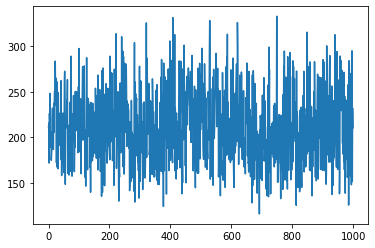

In [188]:
import matplotlib.pyplot as plt
x_axis = np.arange(0,total_episodes)
plt.plot(x_axis,total_reward_perc)